In [221]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.neighbors import KNeighborsRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score, cross_val_predict, KFold
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from sklearn.pipeline import Pipeline
from sklearn import linear_model
from sklearn.svm import SVR 

import seaborn as sns

In [12]:
df = pd.read_csv('house_data_set_cleaned_2.csv')

In [13]:
df = df.drop(df[df[['Location', 'Price', 'Beds', 'Baths', 'House Size', 'Land Size']].duplicated() == True].index, axis=0)

In [14]:
labelencoder = LabelEncoder()
labelencoder.fit(df['Location'])
df['Location'] = labelencoder.transform(df['Location'])

In [15]:
# df_1_h_corr['h_l_ratio'] = df_1_h_corr['House Size'] /df_1_h_corr['Land Size']
df['h_l_ratio'] = df['House Size'].apply(lambda x: x * 0.0036730945821854912)/ df['Land Size']
df['Bed Size'] = df['House Size'] / df['Beds']

In [16]:
km = KMeans(
    n_clusters=3,
    init= 'random',
    n_init=10,
    max_iter=300,
    tol=1e-04,
    random_state=0
)
df_h_l_beds = pd.concat([df['h_l_ratio'], df['Bed Size']], axis=1)
km.fit(df_h_l_beds)
y_km = km.predict(df_h_l_beds)

Text(0.5, 1.0, 'Clustering of Data set based on h_l_ration and Beds Size')

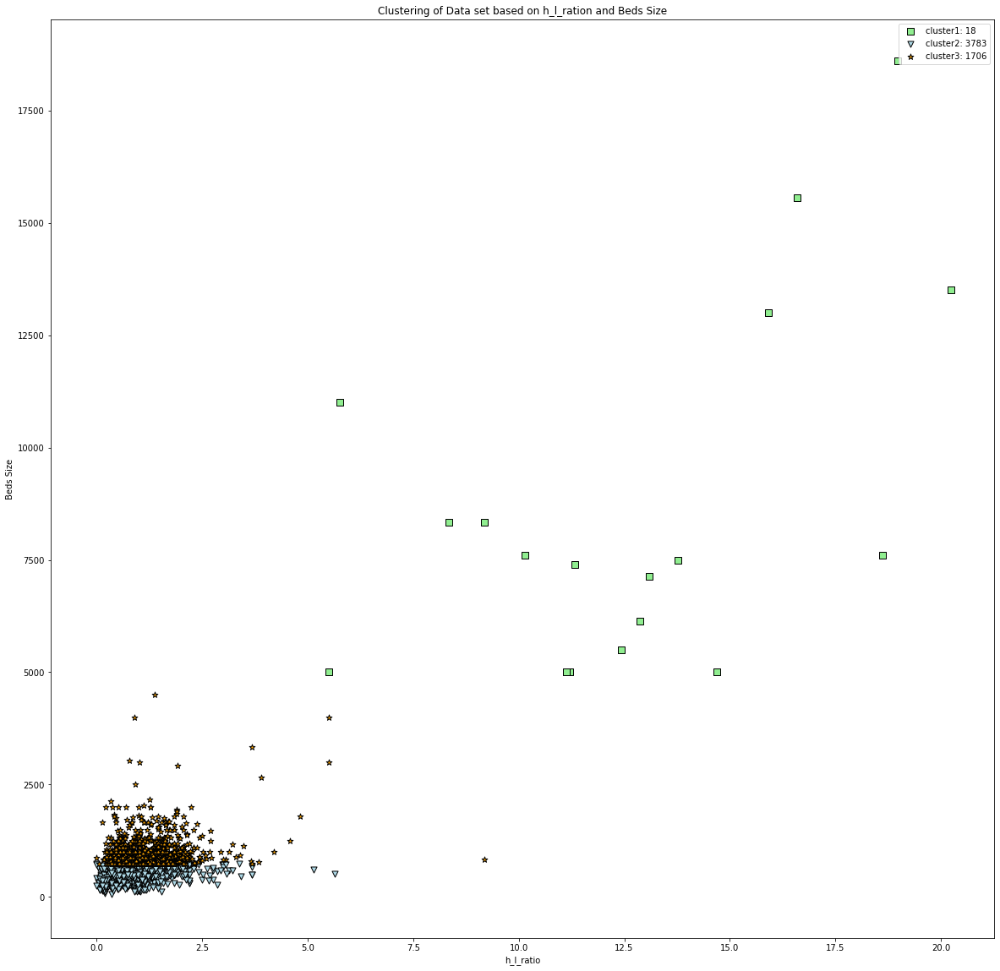

In [17]:
fig, ax = plt.subplots(figsize=(20, 20))

ax.scatter(
    df_h_l_beds[y_km == 0]['h_l_ratio'],
    df_h_l_beds[y_km == 0]['Bed Size'],
    s=50,
    c='lightgreen',
    marker='s',
    edgecolor='black',
    label='cluster 1'
)


ax.scatter(
    df_h_l_beds[y_km == 1]['h_l_ratio'],
    df_h_l_beds[y_km == 1]['Bed Size'],
    s=50,
    c='lightblue',
    marker='v',
    edgecolor='black',
    label='cluster 1'
)

ax.scatter(
    df_h_l_beds[y_km == 2]['h_l_ratio'],
    df_h_l_beds[y_km == 2]['Bed Size'],
    s=50,
    c='orange',
    marker='*',
    edgecolor='black',
    label='cluster 1'
)
ax.legend([
    'cluster1: ' + str(df_h_l_beds[y_km==0].shape[0]),
    'cluster2: ' + str(df_h_l_beds[y_km==1].shape[0]),
    'cluster3: ' + str(df_h_l_beds[y_km==2].shape[0])
          ])
ax.set_xlabel('h_l_ratio')
ax.set_ylabel('Beds Size')
ax.set_title('Clustering of Data set based on h_l_ration and Beds Size')

In [18]:
df['Bed Size'].describe()

count     5507.000000
mean       691.085713
std        576.200103
min         66.666667
25%        500.000000
50%        633.333333
75%        766.666667
max      18600.000000
Name: Bed Size, dtype: float64

In [19]:
df['h_l_ratio'].describe()

count    5507.000000
mean        1.040294
std         0.875743
min         0.000023
25%         0.627397
50%         0.972290
75%         1.285583
max        20.239501
Name: h_l_ratio, dtype: float64

Text(0.5, 1.0, 'Testing Model')

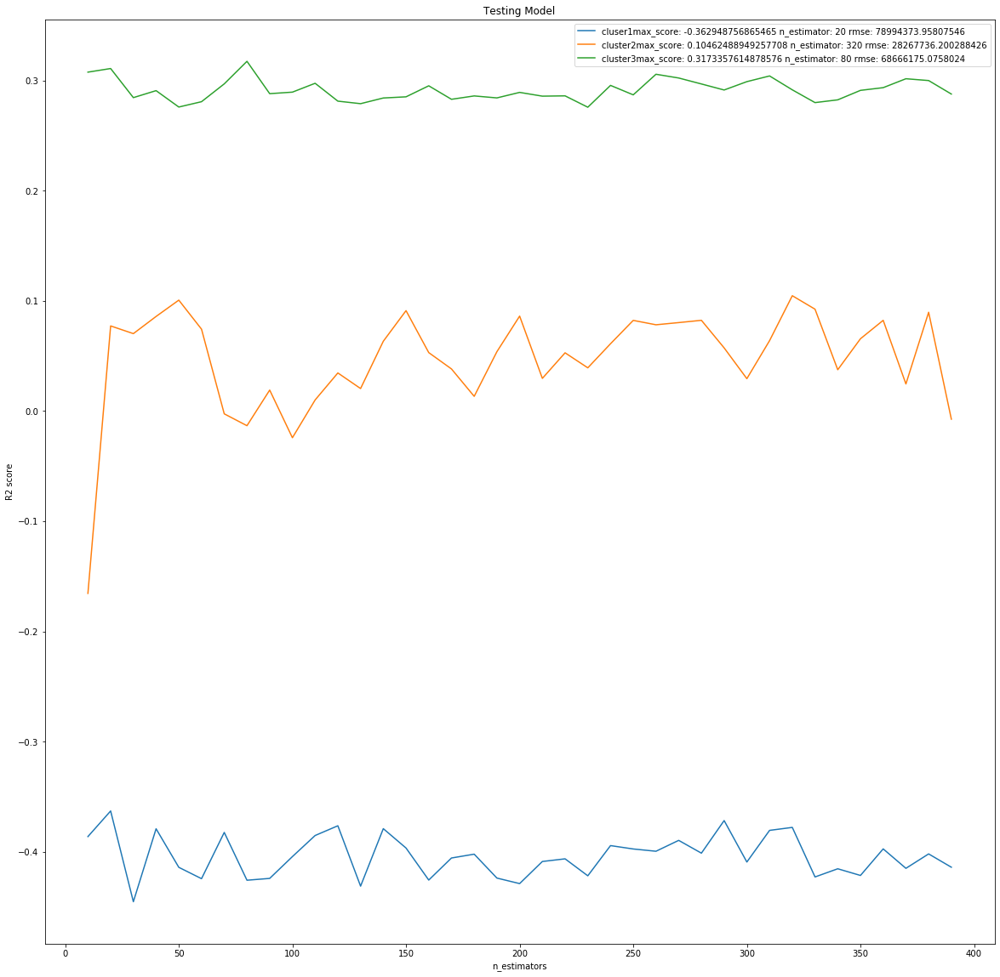

In [20]:
fig, ax = plt.subplots(figsize=(20, 20))
model = RandomForestRegressor(n_jobs=-1)
max_scores_param = []
for index in range(3):
    X_train, X_test, Y_train, Y_test = train_test_split(
    df.drop(columns=['Unnamed: 0', 'Price'],axis=1)[y_km == index],
    df['Price'][y_km == index],
    test_size=0.25,
    random_state=42
    )
    estimators = np.arange(10, 400, 10)
    scores = []
    rmse = 0.0
    for n in estimators:
        model.set_params(n_estimators=n)
        model.fit(X_train, Y_train)
        pred_y = model.predict(X_test)
        rmse = np.sqrt(((pred_y - Y_test) ** 2).mean())
        scores.append(model.score(X_test, Y_test))
    max_scores_param.append((max(scores), estimators[scores.index(max(scores))], rmse ))
    ax.plot(estimators, scores)
ax.legend([
    'cluser1' + 'max_score: '+ str(max_scores_param [0][0])  + ' n_estimator: ' + str(max_scores_param [0][1]) + ' rmse: ' + str(max_scores_param [0][2]),
    'cluster2' + 'max_score: '+ str(max_scores_param [1][0])  + ' n_estimator: ' + str(max_scores_param [1][1]) + ' rmse: ' + str(max_scores_param [1][2]),
    'cluster3' + 'max_score: '+ str(max_scores_param [2][0])  + ' n_estimator: ' + str(max_scores_param [2][1]) + ' rmse: ' + str(max_scores_param [2][2])
#     'cluster4' + 'max_score: '+ str(max_scores_param [3][0])  + ' n_estimator: ' + str(max_scores_param [3][1]) + ' rmse: ' + str(max_scores_param [3][2]),
])
ax.set_xlabel('n_estimators')
ax.set_ylabel('R2 score')
ax.set_title('Testing Model')

from above plot we can notice the RMSE drop to 2crore

In [21]:
km = KMeans(
    n_clusters=2,
    init= 'random',
    n_init=10,
    max_iter=300,
    tol=1e-04,
    random_state=0
)
df_h_l_beds = pd.concat([df['h_l_ratio'], df['Bed Size']], axis=1)
km.fit(df_h_l_beds)
y_km = km.predict(df_h_l_beds)

Text(0.5, 1.0, 'Clustering of Data set based on h_l_ration and Beds Size')

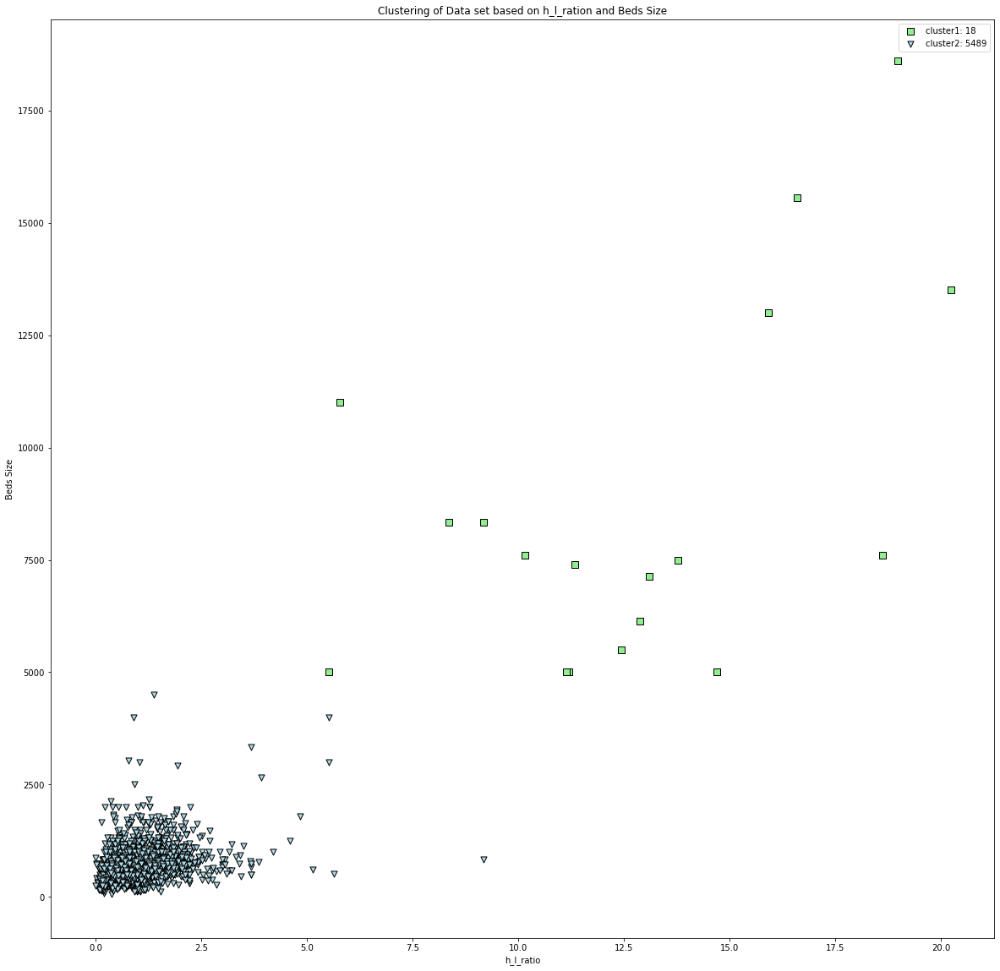

In [22]:
fig, ax = plt.subplots(figsize=(20, 20))

ax.scatter(
    df_h_l_beds[y_km == 0]['h_l_ratio'],
    df_h_l_beds[y_km == 0]['Bed Size'],
    s=50,
    c='lightgreen',
    marker='s',
    edgecolor='black',
    label='cluster 1'
)


ax.scatter(
    df_h_l_beds[y_km == 1]['h_l_ratio'],
    df_h_l_beds[y_km == 1]['Bed Size'],
    s=50,
    c='lightblue',
    marker='v',
    edgecolor='black',
    label='cluster 1'
)

# ax.scatter(
#     df_h_l_beds[y_km == 2]['h_l_ratio'],
#     df_h_l_beds[y_km == 2]['Bed Size'],
#     s=50,
#     c='orange',
#     marker='*',
#     edgecolor='black',
#     label='cluster 1'
# )
ax.legend([
    'cluster1: ' + str(df_h_l_beds[y_km==0].shape[0]),
    'cluster2: ' + str(df_h_l_beds[y_km==1].shape[0])
#     'cluster3: ' + str(df_h_l_beds[y_km==2].shape[0])
          ])
ax.set_xlabel('h_l_ratio')
ax.set_ylabel('Beds Size')
ax.set_title('Clustering of Data set based on h_l_ration and Beds Size')

Text(0.5, 1.0, 'Testing Model')

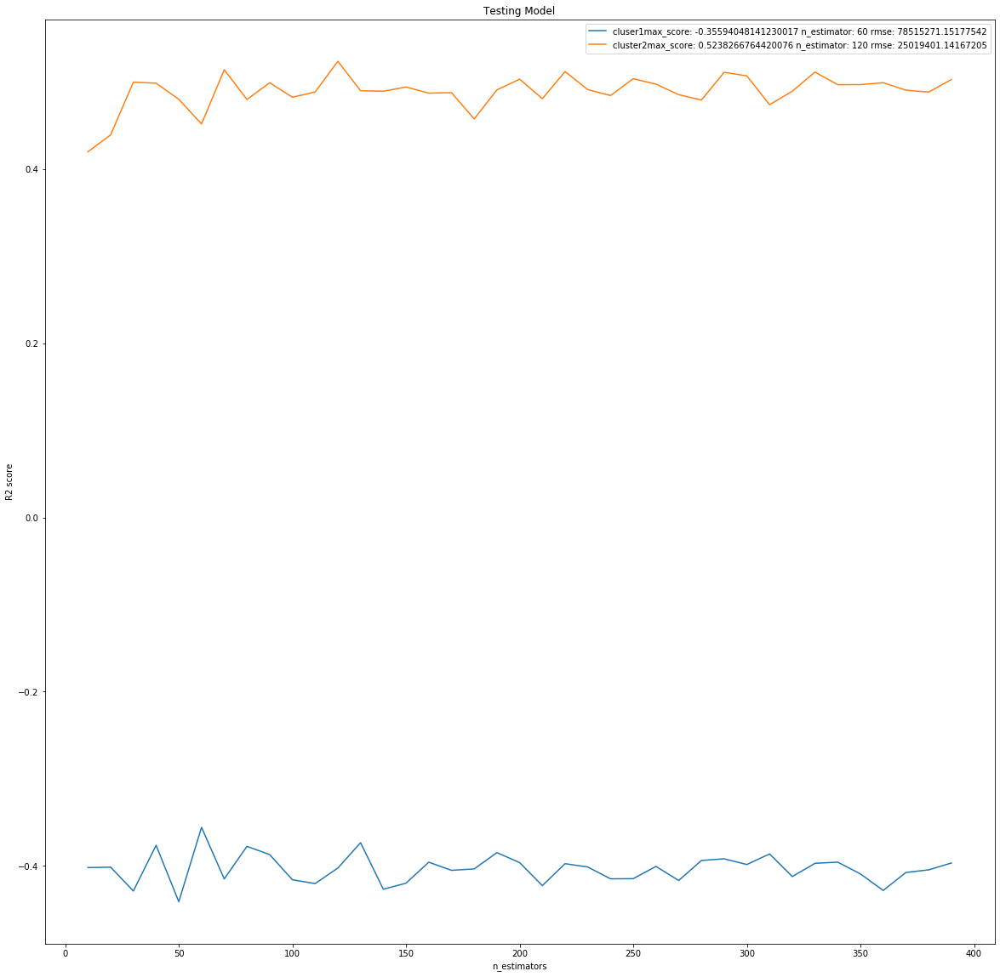

In [23]:
fig, ax = plt.subplots(figsize=(20, 20))
model = RandomForestRegressor(n_jobs=-1)
max_scores_param = []
for index in range(2):
    X_train, X_test, Y_train, Y_test = train_test_split(
    df.drop(columns=['Unnamed: 0', 'Price'],axis=1)[y_km == index],
    df['Price'][y_km == index],
    test_size=0.25,
    random_state=42
    )
    estimators = np.arange(10, 400, 10)
    scores = []
    rmse = 0.0
    for n in estimators:
        model.set_params(n_estimators=n)
        model.fit(X_train, Y_train)
        pred_y = model.predict(X_test)
        rmse = np.sqrt(((pred_y - Y_test) ** 2).mean())
        scores.append(model.score(X_test, Y_test))
    max_scores_param.append((max(scores), estimators[scores.index(max(scores))], rmse ))
    ax.plot(estimators, scores)
ax.legend([
    'cluser1' + 'max_score: '+ str(max_scores_param [0][0])  + ' n_estimator: ' + str(max_scores_param [0][1]) + ' rmse: ' + str(max_scores_param [0][2]),
    'cluster2' + 'max_score: '+ str(max_scores_param [1][0])  + ' n_estimator: ' + str(max_scores_param [1][1]) + ' rmse: ' + str(max_scores_param [1][2])
#     'cluster3' + 'max_score: '+ str(max_scores_param [2][0])  + ' n_estimator: ' + str(max_scores_param [2][1]) + ' rmse: ' + str(max_scores_param [2][2])
#     'cluster4' + 'max_score: '+ str(max_scores_param [3][0])  + ' n_estimator: ' + str(max_scores_param [3][1]) + ' rmse: ' + str(max_scores_param [3][2]),
])
ax.set_xlabel('n_estimators')
ax.set_ylabel('R2 score')
ax.set_title('Testing Model')

Now i can elimate the cluster 1 instances and cluster 2 RMSE about 2crore

In [24]:
df = df.drop(df[y_km ==0].index, axis=0)

In [25]:
df.shape

(5489, 9)

Trying clustering with h_l_ratio and land size

In [26]:
km = KMeans(
    n_clusters=3,
    init= 'random',
    n_init=10,
    max_iter=300,
    tol=1e-04,
    random_state=0
)
df_h_l_Land_size = pd.concat([df['h_l_ratio'], df['Land Size']], axis=1)
km.fit(df_h_l_Land_size)
y_km = km.predict(df_h_l_Land_size)

Text(0.5, 1.0, 'Clustering of Data set based on h_l_ration and Beds Size')

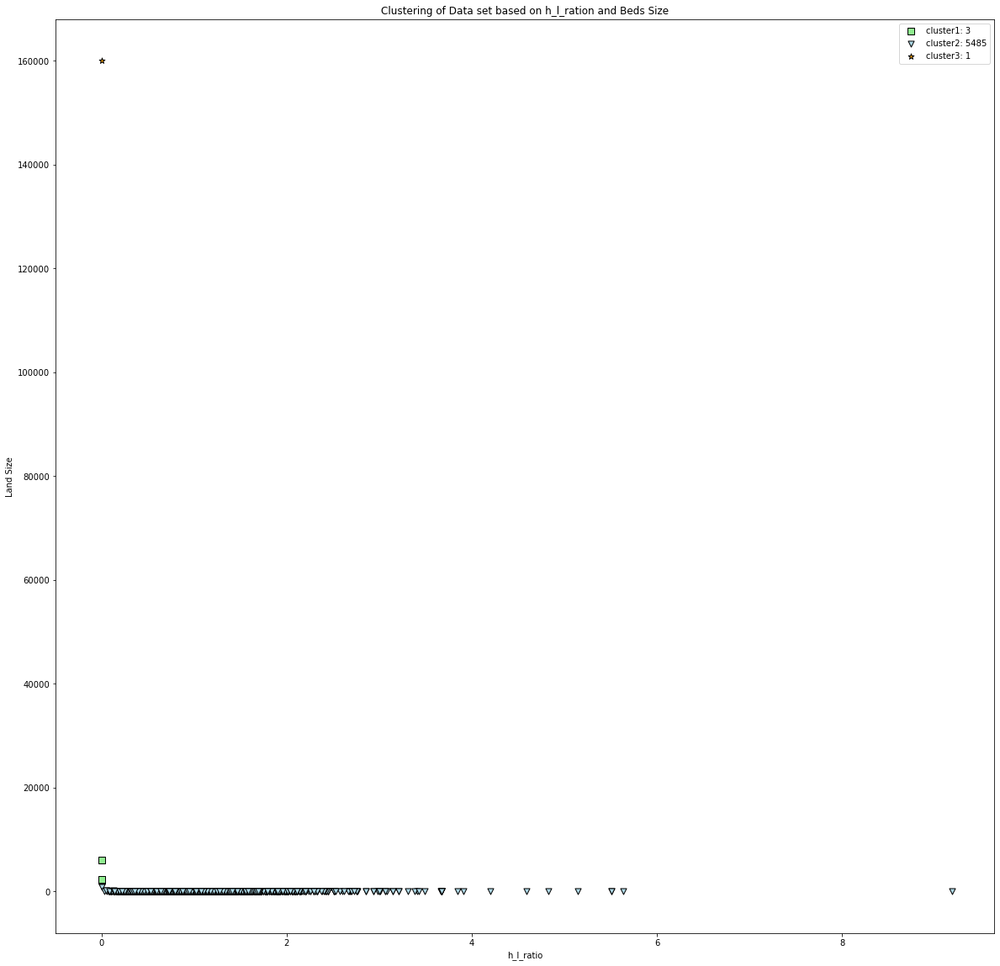

In [27]:
fig, ax = plt.subplots(figsize=(20, 20))

ax.scatter(
    df_h_l_Land_size[y_km == 0]['h_l_ratio'],
    df_h_l_Land_size[y_km == 0]['Land Size'],
    s=50,
    c='lightgreen',
    marker='s',
    edgecolor='black',
    label='cluster 1'
)


ax.scatter(
    df_h_l_Land_size[y_km == 1]['h_l_ratio'],
    df_h_l_Land_size[y_km == 1]['Land Size'],
    s=50,
    c='lightblue',
    marker='v',
    edgecolor='black',
    label='cluster 1'
)

ax.scatter(
    df_h_l_Land_size[y_km == 2]['h_l_ratio'],
    df_h_l_Land_size[y_km == 2]['Land Size'],
    s=50,
    c='orange',
    marker='*',
    edgecolor='black',
    label='cluster 1'
)
ax.legend([
    'cluster1: ' + str(df_h_l_Land_size[y_km==0].shape[0]),
    'cluster2: ' + str(df_h_l_Land_size[y_km==1].shape[0]),
    'cluster3: ' + str(df_h_l_Land_size[y_km==2].shape[0])
          ])
ax.set_xlabel('h_l_ratio')
ax.set_ylabel('Land Size')
ax.set_title('Clustering of Data set based on h_l_ration and Beds Size')

[(0.5587802245423998, 50, 21906020.589501962)]


Text(0.5, 1.0, 'Testing Model')

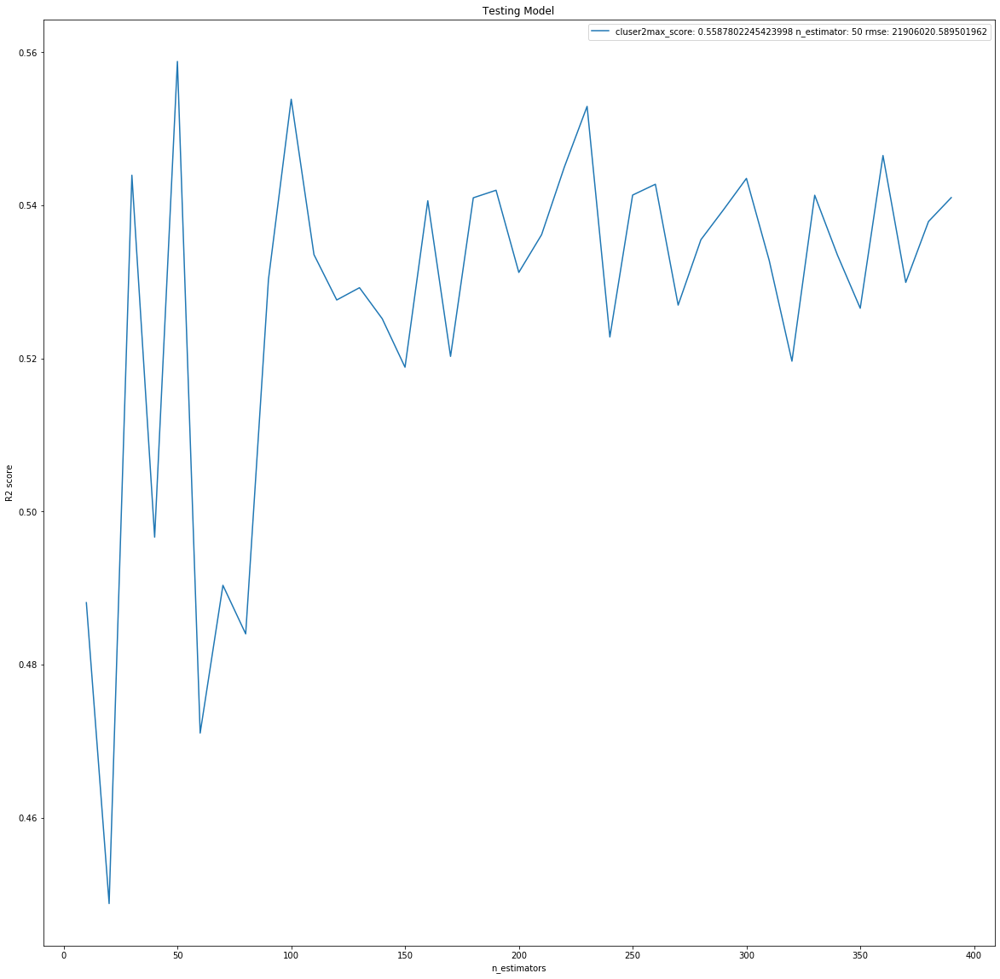

In [28]:
fig, ax = plt.subplots(figsize=(20, 20))
model = RandomForestRegressor(n_jobs=-1)
max_scores_param = []
for index in [1]:
    X_train, X_test, Y_train, Y_test = train_test_split(
    df.drop(columns=['Unnamed: 0', 'Price'],axis=1)[y_km == index],
    df['Price'][y_km == index],
    test_size=0.25,
    random_state=42
    )
    estimators = np.arange(10, 400, 10)
    scores = []
    rmse = 0.0
    for n in estimators:
        model.set_params(n_estimators=n)
        model.fit(X_train, Y_train)
        pred_y = model.predict(X_test)
        rmse = np.sqrt(((pred_y - Y_test) ** 2).mean())
        scores.append(model.score(X_test, Y_test))
    max_scores_param.append((max(scores), estimators[scores.index(max(scores))], rmse ))
    ax.plot(estimators, scores)
print(max_scores_param)
ax.legend([
    'cluser2' + 'max_score: '+ str(max_scores_param [0][0])  + ' n_estimator: ' + str(max_scores_param [0][1]) + ' rmse: ' + str(max_scores_param [0][2])
#     'cluster2' + 'max_score: '+ str(max_scores_param [1][0])  + ' n_estimator: ' + str(max_scores_param [1][1]) + ' rmse: ' + str(max_scores_param [1][2]),
#     'cluster3' + 'max_score: '+ str(max_scores_param [2][0])  + ' n_estimator: ' + str(max_scores_param [1][1]) + ' rmse: ' + str(max_scores_param [1][2])
#     'cluster4' + 'max_score: '+ str(max_scores_param [3][0])  + ' n_estimator: ' + str(max_scores_param [3][1]) + ' rmse: ' + str(max_scores_param [3][2]),
])
ax.set_xlabel('n_estimators')
ax.set_ylabel('R2 score')
ax.set_title('Testing Model')

Investigating the cluster1 and cluster2

We can notice all above instances have huge lands, so we can drop them

In [29]:
df[y_km == 0]

,Unnamed: 0,Location,Price,Beds,Baths,House Size,Land Size,h_l_ratio,Bed Size
2056,2056,18,38000000,4,4,3500.0,6000.0,0.002143,875.000000
3235,3236,27,42250000,3,3,2200.0,2200.0,0.003673,733.333333
7296,7299,16,140000000,4,2,2900.0,2387.0,0.004462,725.000000


In [30]:
df = df.drop(df[y_km == 0].index, axis=0)

In [31]:
df[df['Land Size'].max() == df['Land Size']]

,Unnamed: 0,Location,Price,Beds,Baths,House Size,Land Size,h_l_ratio,Bed Size
4516,4518,6,16000000,4,2,1000.0,160000.0,0.000023,250.0


The above instance also has huge land size , so we can drop 

In [32]:
df = df.drop(df[df['Land Size'].max() == df['Land Size']].index, axis=0)

try with 2 cluster

In [33]:
km = KMeans(
    n_clusters=2,
    init= 'random',
    n_init=10,
    max_iter=300,
    tol=1e-04,
    random_state=0
)
df_h_l_Land_size = pd.concat([df['h_l_ratio'], df['Land Size']], axis=1)
km.fit(df_h_l_Land_size)
y_km = km.predict(df_h_l_Land_size)

Text(0.5, 1.0, 'Clustering of Data set based on h_l_ration and Beds Size')

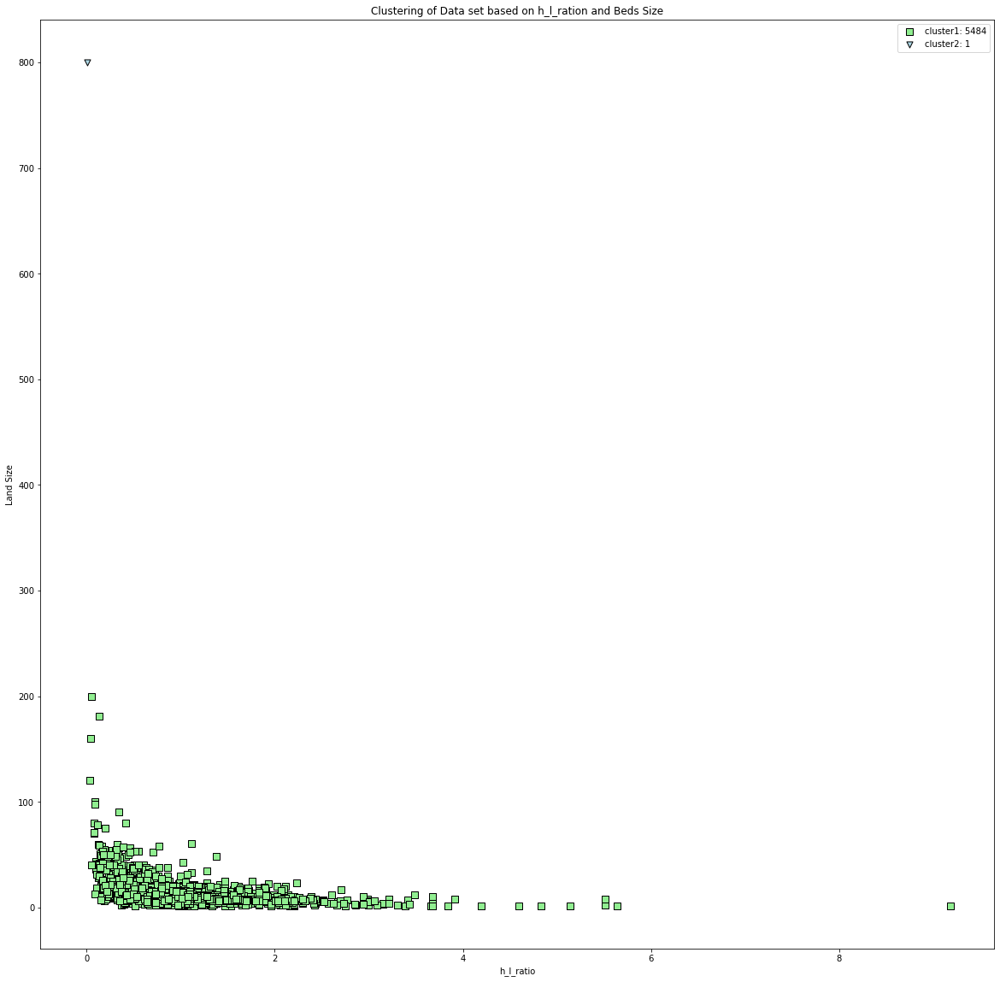

In [34]:
fig, ax = plt.subplots(figsize=(20, 20))

ax.scatter(
    df_h_l_Land_size[y_km == 0]['h_l_ratio'],
    df_h_l_Land_size[y_km == 0]['Land Size'],
    s=50,
    c='lightgreen',
    marker='s',
    edgecolor='black',
    label='cluster 1'
)


ax.scatter(
    df_h_l_Land_size[y_km == 1]['h_l_ratio'],
    df_h_l_Land_size[y_km == 1]['Land Size'],
    s=50,
    c='lightblue',
    marker='v',
    edgecolor='black',
    label='cluster 1'
)

# ax.scatter(
#     df_h_l_Land_size[y_km == 2]['h_l_ratio'],
#     df_h_l_Land_size[y_km == 2]['Land Size'],
#     s=50,
#     c='orange',
#     marker='*',
#     edgecolor='black',
#     label='cluster 1'
# )
ax.legend([
    'cluster1: ' + str(df_h_l_Land_size[y_km==0].shape[0]),
    'cluster2: ' + str(df_h_l_Land_size[y_km==1].shape[0])
#     'cluster3: ' + str(df_h_l_Land_size[y_km==2].shape[0])
          ])
ax.set_xlabel('h_l_ratio')
ax.set_ylabel('Land Size')
ax.set_title('Clustering of Data set based on h_l_ration and Beds Size')

Text(0.5, 1.0, 'Testing Model')

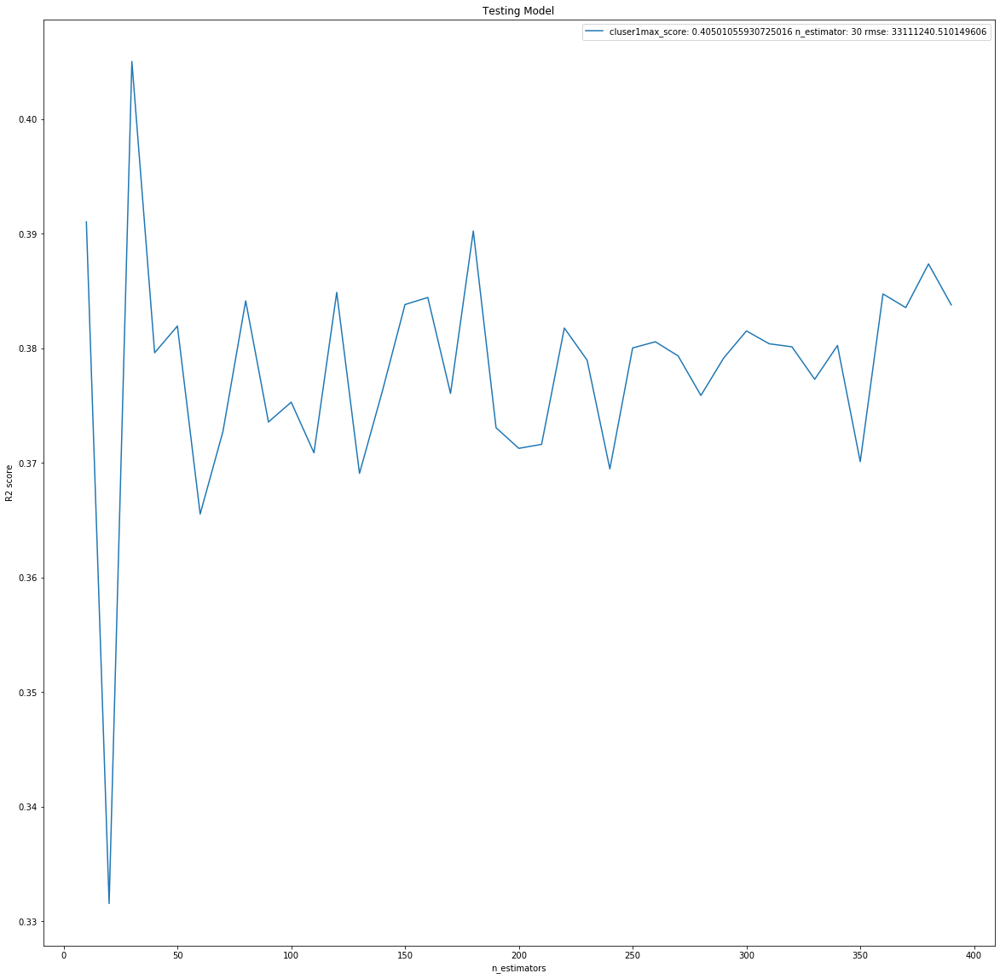

In [35]:
fig, ax = plt.subplots(figsize=(20, 20))
model = RandomForestRegressor(n_jobs=-1)
max_scores_param = []
for index in [0]:
    X_train, X_test, Y_train, Y_test = train_test_split(
    df.drop(columns=['Unnamed: 0', 'Price'],axis=1)[y_km == index],
    df['Price'][y_km == index],
    test_size=0.25,
    random_state=42
    )
    estimators = np.arange(10, 400, 10)
    scores = []
    rmse = 0.0
    for n in estimators:
        model.set_params(n_estimators=n)
        model.fit(X_train, Y_train)
        pred_y = model.predict(X_test)
        rmse = np.sqrt(((pred_y - Y_test) ** 2).mean())
        scores.append(model.score(X_test, Y_test))
    max_scores_param.append((max(scores), estimators[scores.index(max(scores))], rmse ))
    ax.plot(estimators, scores)
ax.legend([
    'cluser1' + 'max_score: '+ str(max_scores_param [0][0])  + ' n_estimator: ' + str(max_scores_param [0][1]) + ' rmse: ' + str(max_scores_param [0][2])
#     'cluster2' + 'max_score: '+ str(max_scores_param [1][0])  + ' n_estimator: ' + str(max_scores_param [1][1]) + ' rmse: ' + str(max_scores_param [1][2])
#     'cluster3' + 'max_score: '+ str(max_scores_param [2][0])  + ' n_estimator: ' + str(max_scores_param [2][1]) + ' rmse: ' + str(max_scores_param [2][2])
#     'cluster4' + 'max_score: '+ str(max_scores_param [3][0])  + ' n_estimator: ' + str(max_scores_param [3][1]) + ' rmse: ' + str(max_scores_param [3][2]),
])
ax.set_xlabel('n_estimators')
ax.set_ylabel('R2 score')
ax.set_title('Testing Model')

Filter only single story houses based on h_l_ratio

In [36]:
df_single_story = df[df['h_l_ratio'] < 1.0]

In [37]:
df_single_story.head()

,Unnamed: 0,Location,Price,Beds,Baths,House Size,Land Size,h_l_ratio,Bed Size
0,0,35,12500000,4,2,1750.0,6.5,0.988910,437.500000
3,3,25,35000000,7,4,1700.0,15.0,0.416284,242.857143
8,8,25,8900000,3,2,1380.0,6.0,0.844812,460.000000
11,11,20,23000000,5,3,3500.0,20.0,0.642792,700.000000
12,12,22,13000000,3,2,1800.0,10.0,0.661157,600.000000


see the correlation for the single story houses

Text(0.5, 1, 'Corretion of Single Story house')

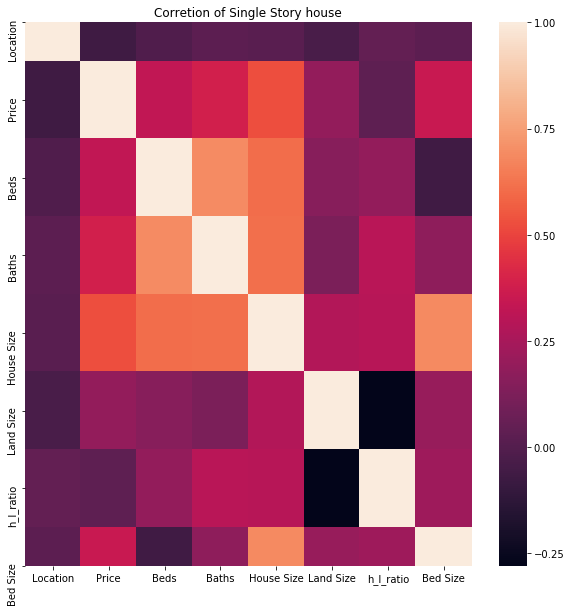

In [38]:
fig,axes = plt.subplots( figsize=(10,10))
sns.heatmap(df_single_story.drop(columns=['Unnamed: 0'],axis=1).corr())
axes.set_title('Corretion of Single Story house')

Text(0.5, 1.0, 'Testing Model')

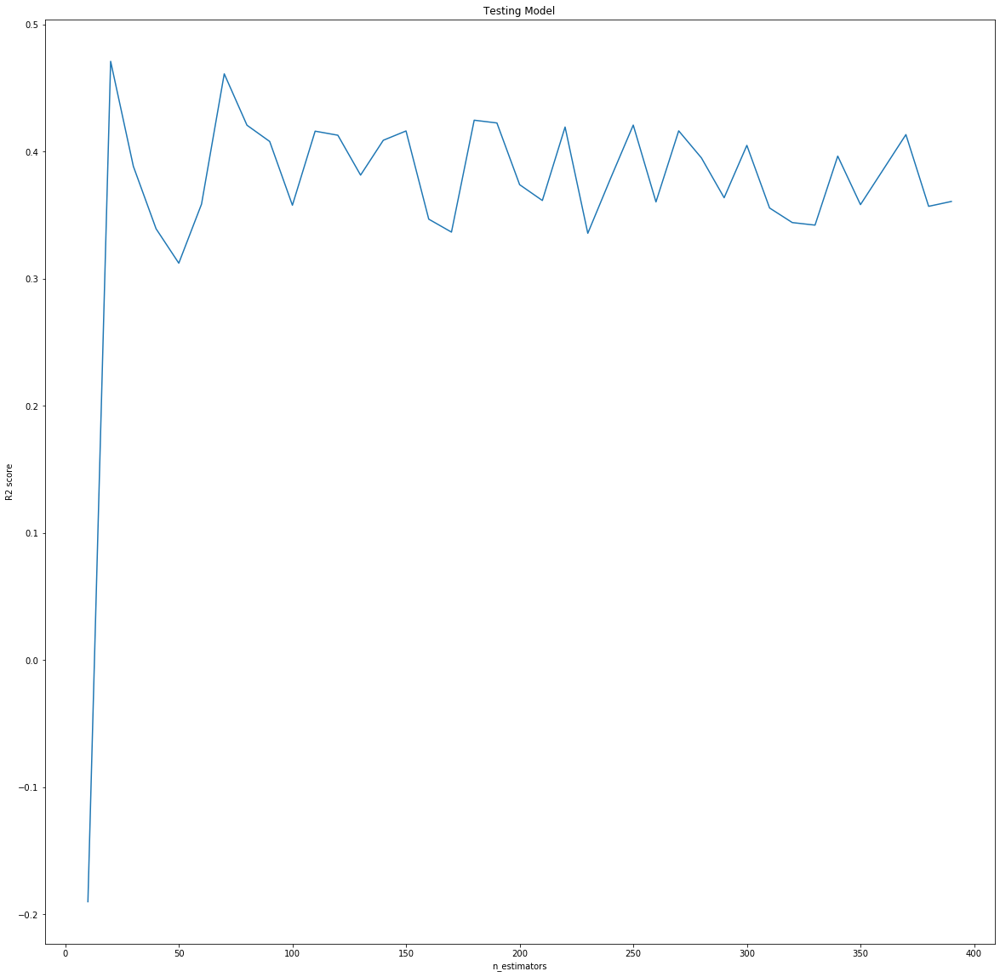

In [39]:
fig, ax = plt.subplots(figsize=(20, 20))
model = RandomForestRegressor(n_jobs=-1)
max_scores_param = []

X_train, X_test, Y_train, Y_test = train_test_split(
    df_single_story.drop(columns=['Unnamed: 0', 'Price'],axis=1),
    df_single_story['Price'],
    test_size=0.25,
    random_state=42
)
estimators = np.arange(10, 400, 10)
scores = []
rmse = 0.0
for n in estimators:
    model.set_params(n_estimators=n)
    model.fit(X_train, Y_train)
    pred_y = model.predict(X_test)
    rmse = np.sqrt(((pred_y - Y_test) ** 2).mean())
    scores.append(model.score(X_test, Y_test))
max_scores_param.append((max(scores), estimators[scores.index(max(scores))], rmse ))
ax.plot(estimators, scores)
ax.set_xlabel('n_estimators')
ax.set_ylabel('R2 score')
ax.set_title('Testing Model')

In [40]:
df_single_story.shape

(2869, 9)

In [41]:
df_single_story.describe()

,Unnamed: 0,Location,Price,Beds,Baths,House Size,Land Size,h_l_ratio,Bed Size
count,2869.000000,2869.000000,2.869000e+03,2869.000000,2869.000000,2869.000000,2869.000000,2869.000000,2869.000000
mean,3611.274312,23.609620,2.830004e+07,3.578599,2.478913,2088.866595,13.680488,0.639618,589.079596
std,2205.068062,11.683243,4.776265e+07,1.285517,1.206383,1099.898349,18.068178,0.213666,240.833019
min,0.000000,0.000000,8.500000e+04,1.000000,1.000000,174.240000,1.000000,0.003903,66.666667
25%,1707.000000,20.000000,1.000000e+07,3.000000,2.000000,1350.000000,8.300000,0.489746,448.750000
50%,3509.000000,26.000000,1.500000e+07,3.000000,2.000000,1800.000000,10.280000,0.642792,533.333333
75%,5486.000000,35.000000,2.900000e+07,4.000000,3.000000,2500.000000,15.000000,0.821045,675.000000
max,7609.000000,39.000000,1.300000e+09,10.000000,10.000000,12150.000000,800.000000,0.999998,4000.000000


In [42]:
from scipy.stats import norm
from scipy import stats

See the normality of single story houses

House Size

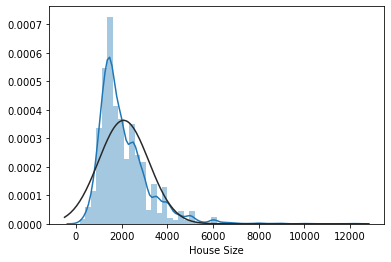

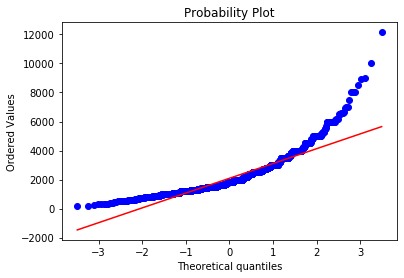

In [43]:

sns.distplot(df_single_story['House Size'] ,fit=norm)
fig = plt.figure()
res = stats.probplot(df_single_story['House Size'], plot =plt)

trying log transformation

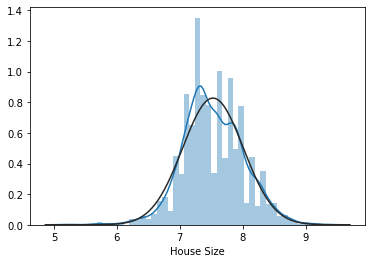

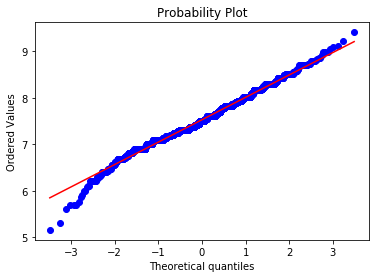

In [44]:

sns.distplot(np.log(df_single_story['House Size']) ,fit=norm)
fig = plt.figure()
res = stats.probplot(np.log(df_single_story['House Size']), plot =plt)

try RandomForest with log transformation

In [45]:
df_test_log_trans = df_single_story.copy()

In [46]:
df_test_log_trans['House Size'] = df_test_log_trans['House Size'].apply(lambda x: np.log(x))

Text(0.5, 1.0, 'Testing Model')

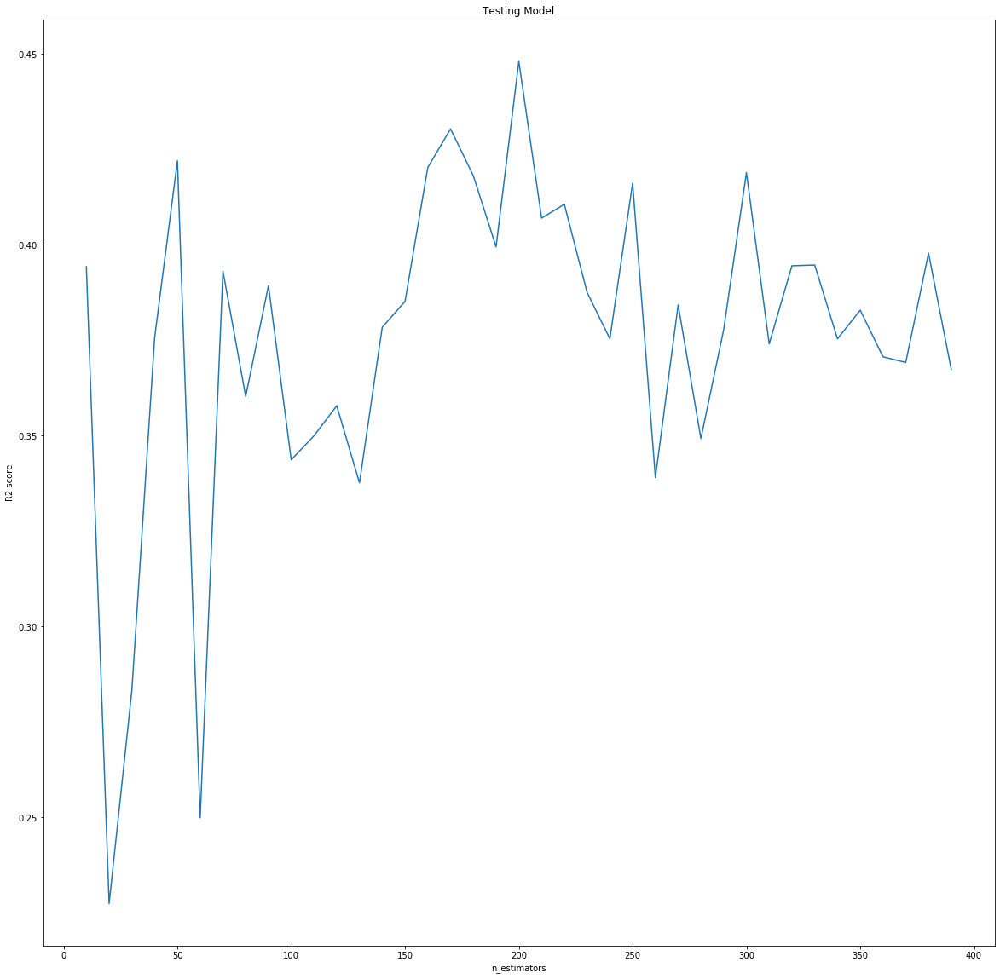

In [47]:
fig, ax = plt.subplots(figsize=(20, 20))
model = RandomForestRegressor(n_jobs=-1)
max_scores_param = []

X_train, X_test, Y_train, Y_test = train_test_split(
    df_test_log_trans.drop(columns=['Unnamed: 0', 'Price'],axis=1),
    df_test_log_trans['Price'],
    test_size=0.25,
    random_state=42
)
estimators = np.arange(10, 400, 10)
scores = []
rmse = 0.0
for n in estimators:
    model.set_params(n_estimators=n)
    model.fit(X_train, Y_train)
    pred_y = model.predict(X_test)
    rmse = np.sqrt(((pred_y - Y_test) ** 2).mean())
    scores.append(model.score(X_test, Y_test))
max_scores_param.append((max(scores), estimators[scores.index(max(scores))], rmse ))
ax.plot(estimators, scores)
ax.set_xlabel('n_estimators')
ax.set_ylabel('R2 score')
ax.set_title('Testing Model')

NO improvement in R2 score, 
try clustering here

In [ ]:
from sklearn.preprocessing import MinMaxScaler

In [ ]:
min_max_scaler = MinMaxScaler()
# min_max_scaler.fit_transform(df_single_story['Baths'].values)

In [ ]:
df_single_story = df_single_story.dropna()

In [ ]:
pd.DataFrame.from_records(min_max_scaler.fit_transform(df_single_story['Beds'].values.reshape(-1,1)))[0]

clustering wiht House size and Beds

In [52]:
km = KMeans(
    n_clusters=3,
    init= 'random',
    n_init=10,
    max_iter=300,
    tol=1e-04,
    random_state=0
)

df_house_size_baths = pd.concat([df_single_story['House Size'], df_single_story['Beds']/ df_single_story['Beds'].max()], axis=1)
km.fit(df_house_size_baths)
y_km = km.predict(df_house_size_baths)

Text(0.5, 1.0, 'Clustering of Data set based on House Size and Beds')

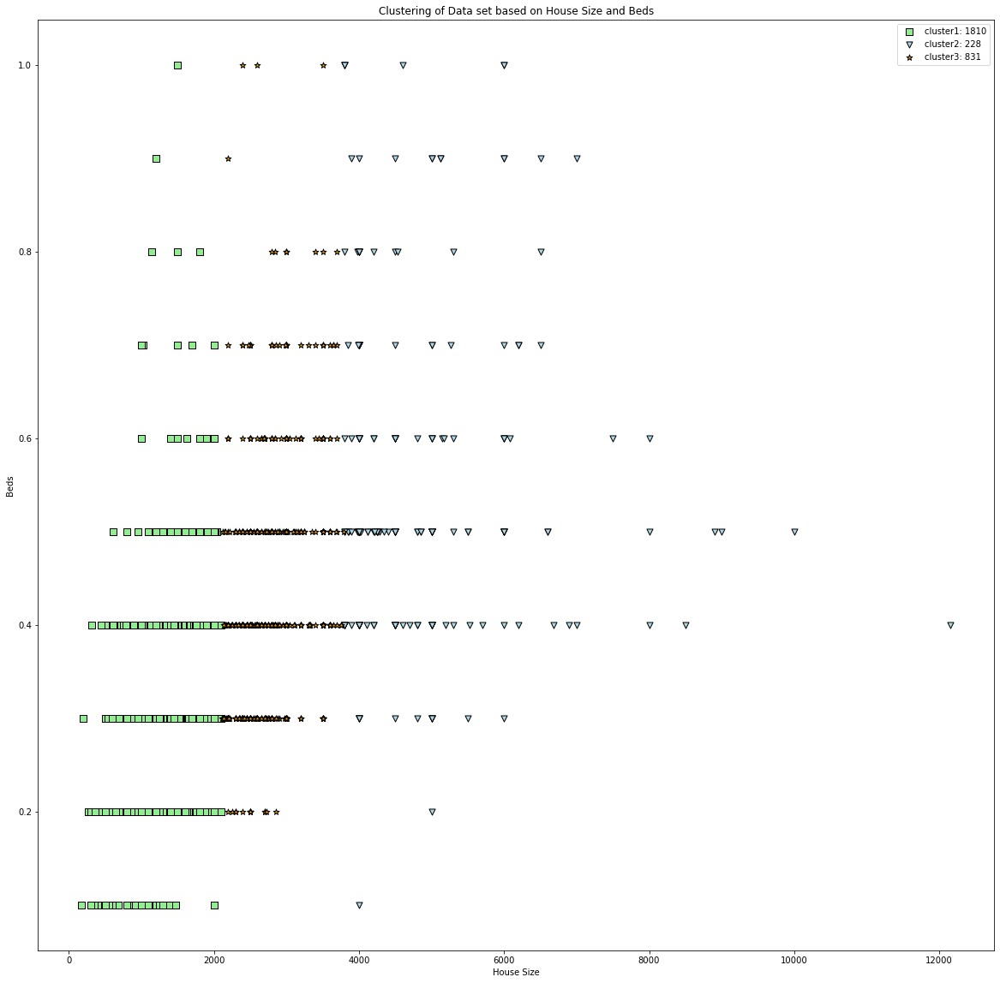

In [53]:


# km = KMeans(
#     n_clusters=3,
#     init= 'random',
#     n_init=10,
#     max_iter=300,
#     tol=1e-04,
#     random_state=0
# )
# df_h_l_Land_size = pd.concat([df['House Size'], df['Baths']], axis=1)
# km.fit(df_h_l_Land_size)
# y_km = km.predict(df_h_l_Land_size)


fig, ax = plt.subplots(figsize=(20, 20))

ax.scatter(
    df_house_size_baths[y_km == 0]['House Size'],
    df_house_size_baths[y_km == 0]['Beds'],
    s=50,
    c='lightgreen',
    marker='s',
    edgecolor='black',
    label='cluster 1'
)


ax.scatter(
   df_house_size_baths[y_km == 1]['House Size'],
    df_house_size_baths[y_km == 1]['Beds'],
    s=50,
    c='lightblue',
    marker='v',
    edgecolor='black',
    label='cluster 1'
)

ax.scatter(
   df_house_size_baths[y_km == 2]['House Size'],
    df_house_size_baths[y_km == 2]['Beds'],
    s=50,
    c='orange',
    marker='*',
    edgecolor='black',
    label='cluster 1'
)
ax.legend([
    'cluster1: ' + str(df_house_size_baths[y_km==0].shape[0]),
    'cluster2: ' + str(df_house_size_baths[y_km==1].shape[0]),
    'cluster3: ' + str(df_house_size_baths[y_km==2].shape[0])
          ])
ax.set_xlabel('House Size')
ax.set_ylabel('Beds')
ax.set_title('Clustering of Data set based on House Size and Beds')

[(0.24109294231120926, 60, 20039489.997750018), (0.22776448760603443, 40, 157194417.75316), (0.49549246799042607, 70, 28026406.911353625)]


Text(0.5, 1.0, 'Testing Model')

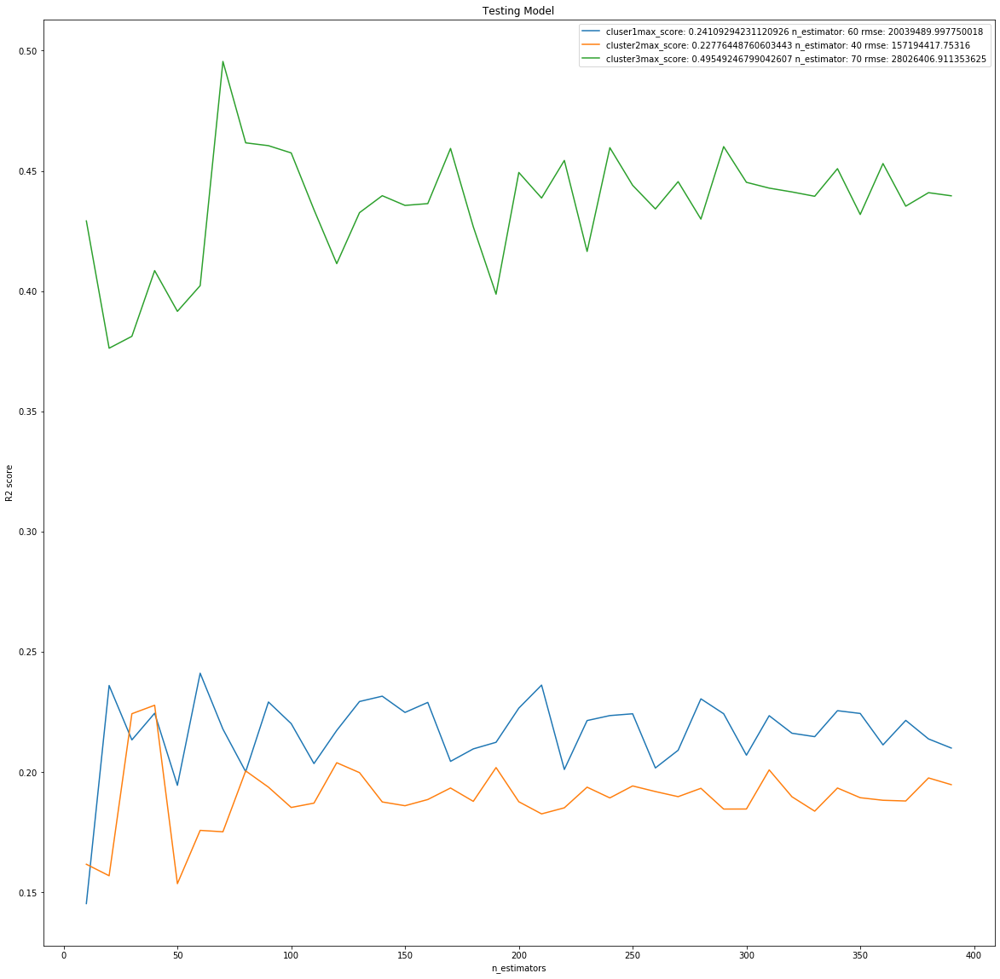

In [54]:
fig, ax = plt.subplots(figsize=(20, 20))
model = RandomForestRegressor(n_jobs=-1)
max_scores_param = []
for index in range(3):
    X_train, X_test, Y_train, Y_test = train_test_split(
    df_single_story.drop(columns=['Unnamed: 0', 'Price'],axis=1)[y_km == index],
    df_single_story['Price'][y_km == index],
    test_size=0.25,
    random_state=42
    )
    estimators = np.arange(10, 400, 10)
    scores = []
    rmse = 0.0
    for n in estimators:
        model.set_params(n_estimators=n)
        model.fit(X_train, Y_train)
        pred_y = model.predict(X_test)
        rmse = np.sqrt(((pred_y - Y_test) ** 2).mean())
        scores.append(model.score(X_test, Y_test))
    max_scores_param.append((max(scores), estimators[scores.index(max(scores))], rmse ))
    ax.plot(estimators, scores)
print(max_scores_param)
ax.legend([
    'cluser1' + 'max_score: '+ str(max_scores_param [0][0])  + ' n_estimator: ' + str(max_scores_param [0][1]) + ' rmse: ' + str(max_scores_param [0][2]),
    'cluster2' + 'max_score: '+ str(max_scores_param [1][0])  + ' n_estimator: ' + str(max_scores_param [1][1]) + ' rmse: ' + str(max_scores_param [1][2]),
    'cluster3' + 'max_score: '+ str(max_scores_param [2][0])  + ' n_estimator: ' + str(max_scores_param [2][1]) + ' rmse: ' + str(max_scores_param [2][2])
#     'cluster4' + 'max_score: '+ str(max_scores_param [3][0])  + ' n_estimator: ' + str(max_scores_param [3][1]) + ' rmse: ' + str(max_scores_param [3][2]),
])
ax.set_xlabel('n_estimators')
ax.set_ylabel('R2 score')
ax.set_title('Testing Model')

No clear results

try 2 clusters

In [56]:
km = KMeans(
    n_clusters=2,
    init= 'random',
    n_init=10,
    max_iter=300,
    tol=1e-04,
    random_state=0
)

df_house_size_baths = pd.concat([df_single_story['House Size'], df_single_story['Beds']/ df_single_story['Beds'].max()], axis=1)
km.fit(df_house_size_baths)
y_km = km.predict(df_house_size_baths)

Text(0.5, 1.0, 'Clustering of Data set based on House Size and Beds')

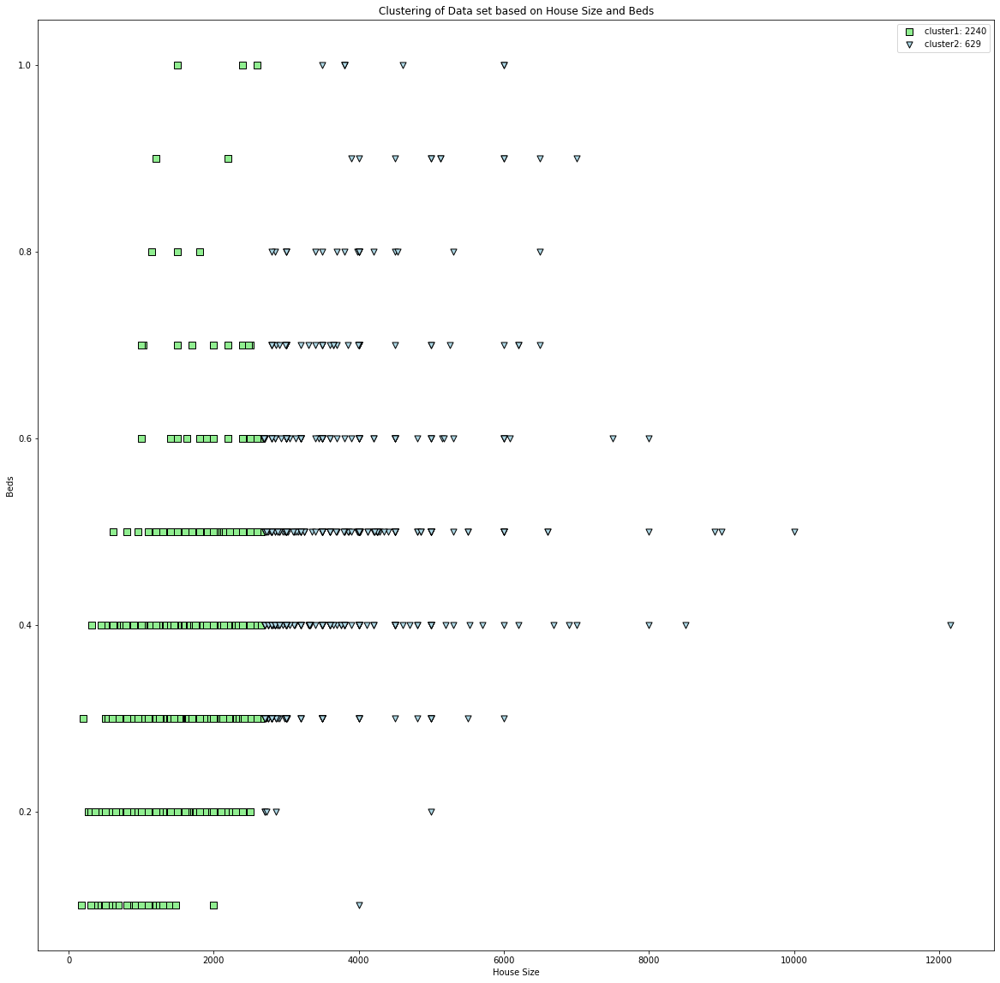

In [57]:
fig, ax = plt.subplots(figsize=(20, 20))

ax.scatter(
    df_house_size_baths[y_km == 0]['House Size'],
    df_house_size_baths[y_km == 0]['Beds'],
    s=50,
    c='lightgreen',
    marker='s',
    edgecolor='black',
    label='cluster 1'
)


ax.scatter(
   df_house_size_baths[y_km == 1]['House Size'],
    df_house_size_baths[y_km == 1]['Beds'],
    s=50,
    c='lightblue',
    marker='v',
    edgecolor='black',
    label='cluster 1'
)

# ax.scatter(
#    df_house_size_baths[y_km == 2]['House Size'],
#     df_house_size_baths[y_km == 2]['Beds'],
#     s=50,
#     c='orange',
#     marker='*',
#     edgecolor='black',
#     label='cluster 1'
# )
ax.legend([
    'cluster1: ' + str(df_house_size_baths[y_km==0].shape[0]),
    'cluster2: ' + str(df_house_size_baths[y_km==1].shape[0])
#     'cluster3: ' + str(df_house_size_baths[y_km==2].shape[0])
          ])
ax.set_xlabel('House Size')
ax.set_ylabel('Beds')
ax.set_title('Clustering of Data set based on House Size and Beds')

[(0.2736649878587383, 110, 22158937.21383578), (0.42380156688211323, 50, 49925833.71890758)]


Text(0.5, 1.0, 'Testing Model')

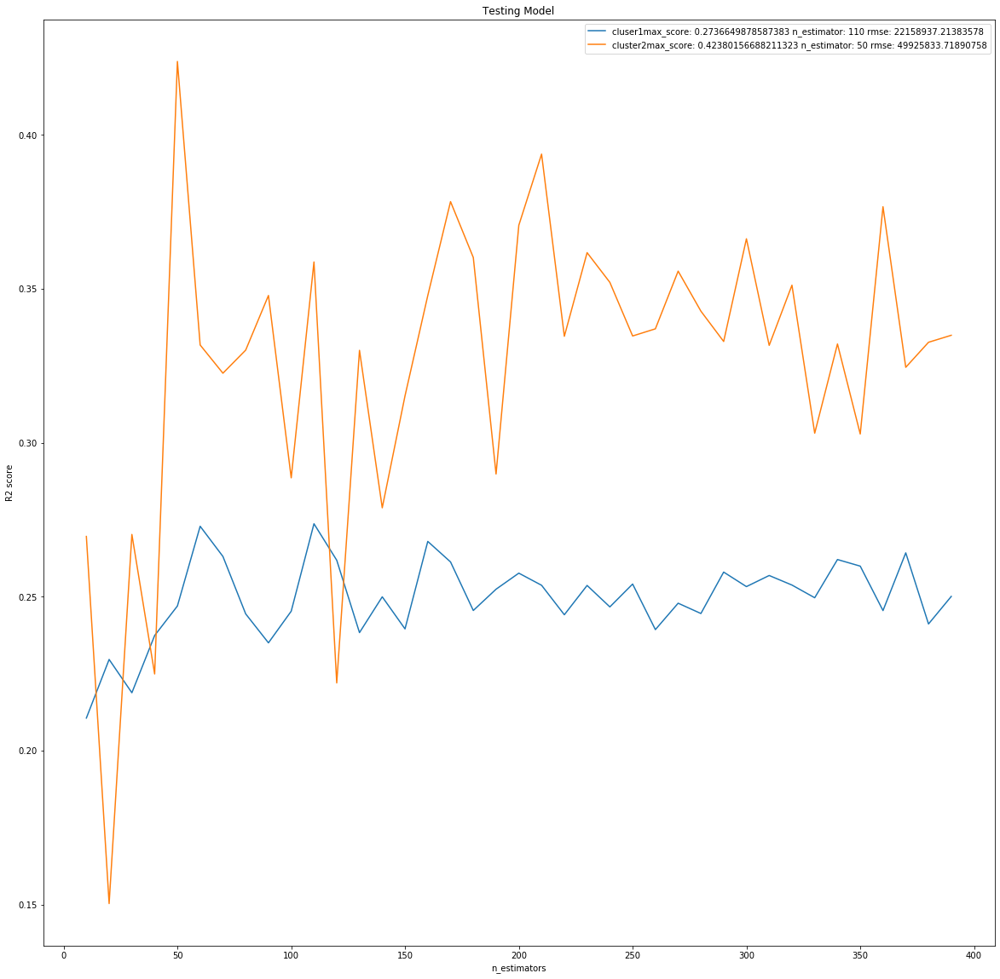

In [58]:
fig, ax = plt.subplots(figsize=(20, 20))
model = RandomForestRegressor(n_jobs=-1)
max_scores_param = []
for index in range(2):
    X_train, X_test, Y_train, Y_test = train_test_split(
    df_single_story.drop(columns=['Unnamed: 0', 'Price'],axis=1)[y_km == index],
    df_single_story['Price'][y_km == index],
    test_size=0.25,
    random_state=42
    )
    estimators = np.arange(10, 400, 10)
    scores = []
    rmse = 0.0
    for n in estimators:
        model.set_params(n_estimators=n)
        model.fit(X_train, Y_train)
        pred_y = model.predict(X_test)
        rmse = np.sqrt(((pred_y - Y_test) ** 2).mean())
        scores.append(model.score(X_test, Y_test))
    max_scores_param.append((max(scores), estimators[scores.index(max(scores))], rmse ))
    ax.plot(estimators, scores)
print(max_scores_param)
ax.legend([
    'cluser1' + 'max_score: '+ str(max_scores_param [0][0])  + ' n_estimator: ' + str(max_scores_param [0][1]) + ' rmse: ' + str(max_scores_param [0][2]),
    'cluster2' + 'max_score: '+ str(max_scores_param [1][0])  + ' n_estimator: ' + str(max_scores_param [1][1]) + ' rmse: ' + str(max_scores_param [1][2])
#     'cluster3' + 'max_score: '+ str(max_scores_param [2][0])  + ' n_estimator: ' + str(max_scores_param [2][1]) + ' rmse: ' + str(max_scores_param [2][2])
#     'cluster4' + 'max_score: '+ str(max_scores_param [3][0])  + ' n_estimator: ' + str(max_scores_param [3][1]) + ' rmse: ' + str(max_scores_param [3][2]),
])
ax.set_xlabel('n_estimators')
ax.set_ylabel('R2 score')
ax.set_title('Testing Model')

try clustering with House Size and Baths

In [61]:
km = KMeans(
    n_clusters=3,
    init= 'random',
    n_init=10,
    max_iter=300,
    tol=1e-04,
    random_state=0
)

df_house_size_baths = pd.concat([df_single_story['House Size'], df_single_story['Baths']/ df_single_story['Baths'].max()], axis=1)
km.fit(df_house_size_baths)
y_km = km.predict(df_house_size_baths)

Text(0.5, 1.0, 'Clustering of Data set based on House Size and Baths')

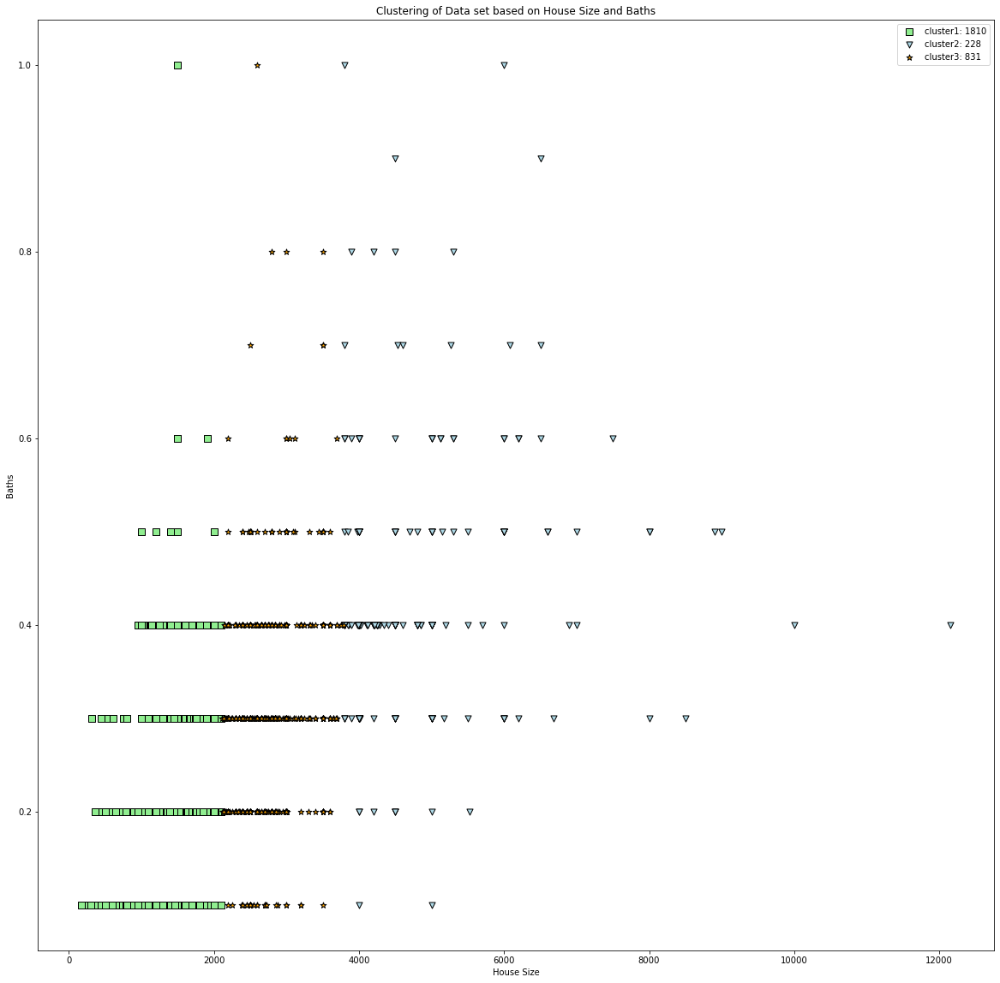

In [62]:
fig, ax = plt.subplots(figsize=(20, 20))

ax.scatter(
    df_house_size_baths[y_km == 0]['House Size'],
    df_house_size_baths[y_km == 0]['Baths'],
    s=50,
    c='lightgreen',
    marker='s',
    edgecolor='black',
    label='cluster 1'
)


ax.scatter(
   df_house_size_baths[y_km == 1]['House Size'],
    df_house_size_baths[y_km == 1]['Baths'],
    s=50,
    c='lightblue',
    marker='v',
    edgecolor='black',
    label='cluster 1'
)

ax.scatter(
   df_house_size_baths[y_km == 2]['House Size'],
    df_house_size_baths[y_km == 2]['Baths'],
    s=50,
    c='orange',
    marker='*',
    edgecolor='black',
    label='cluster 1'
)
ax.legend([
    'cluster1: ' + str(df_house_size_baths[y_km==0].shape[0]),
    'cluster2: ' + str(df_house_size_baths[y_km==1].shape[0]),
    'cluster3: ' + str(df_house_size_baths[y_km==2].shape[0])
          ])
ax.set_xlabel('House Size')
ax.set_ylabel('Baths')
ax.set_title('Clustering of Data set based on House Size and Baths')

try clustering with Beds/Baths ratio

In [63]:
df_single_story['beds_bath_ratio'] = df_single_story['Beds']/df_single_story['Baths']

In [64]:
km = KMeans(
    n_clusters=3,
    init= 'random',
    n_init=10,
    max_iter=300,
    tol=1e-04,
    random_state=0
)

df_house_size_bed_bath_ratio = pd.concat([df_single_story['House Size'],df_single_story['beds_bath_ratio']], axis=1)
km.fit(df_house_size_bed_bath_ratio)
y_km = km.predict(df_house_size_bed_bath_ratio)

Text(0.5, 1.0, 'Clustering of Data set based on House Size and beds_bath_ratio')

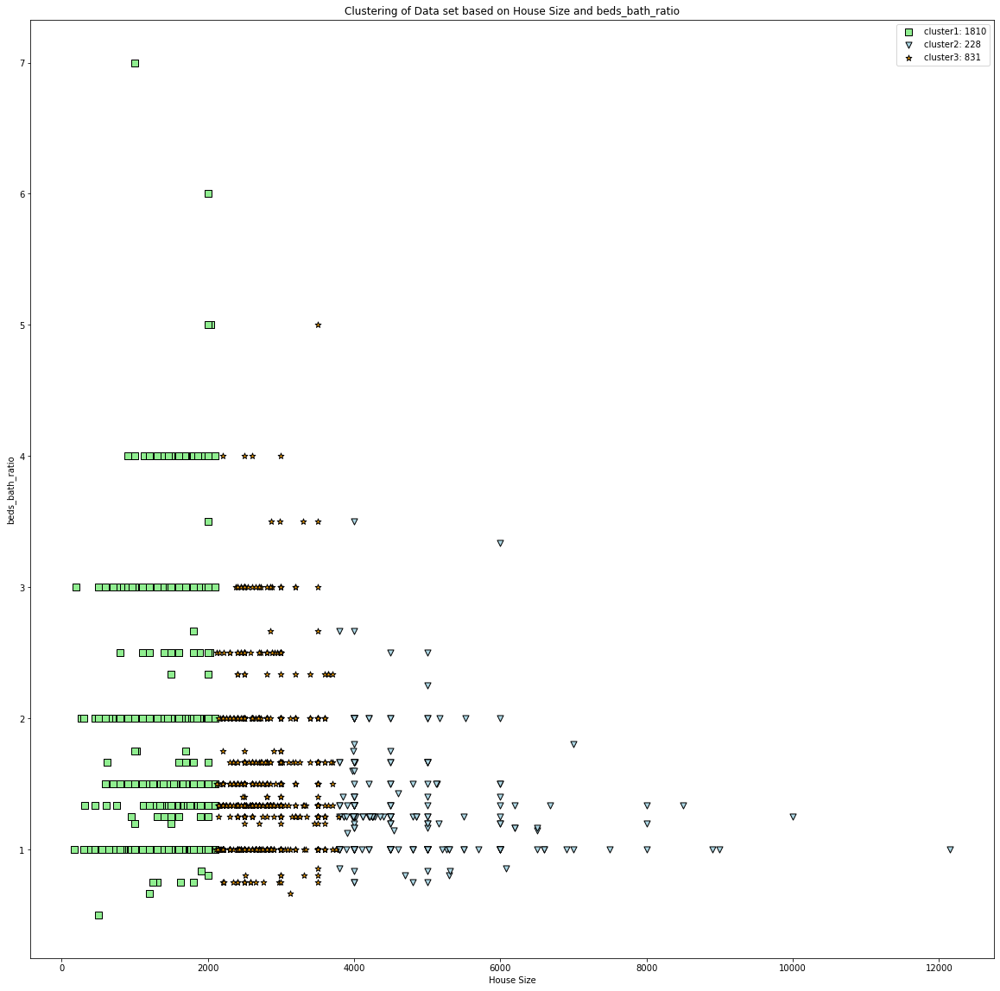

In [65]:
fig, ax = plt.subplots(figsize=(20, 20))

ax.scatter(
    df_house_size_bed_bath_ratio[y_km == 0]['House Size'],
    df_house_size_bed_bath_ratio[y_km == 0]['beds_bath_ratio'],
    s=50,
    c='lightgreen',
    marker='s',
    edgecolor='black',
    label='cluster 1'
)


ax.scatter(
    df_house_size_bed_bath_ratio[y_km == 1]['House Size'],
    df_house_size_bed_bath_ratio[y_km == 1]['beds_bath_ratio'],
    s=50,
    c='lightblue',
    marker='v',
    edgecolor='black',
    label='cluster 1'
)

ax.scatter(
    df_house_size_bed_bath_ratio[y_km == 2]['House Size'],
    df_house_size_bed_bath_ratio[y_km == 2]['beds_bath_ratio'],
    s=50,
    c='orange',
    marker='*',
    edgecolor='black',
    label='cluster 1'
)
ax.legend([
    'cluster1: ' + str(df_house_size_bed_bath_ratio[y_km==0].shape[0]),
    'cluster2: ' + str(df_house_size_bed_bath_ratio[y_km==1].shape[0]),
    'cluster3: ' + str(df_house_size_bed_bath_ratio[y_km==2].shape[0])
          ])
ax.set_xlabel('House Size')
ax.set_ylabel('beds_bath_ratio')
ax.set_title('Clustering of Data set based on House Size and beds_bath_ratio')

[(0.23716348066002768, 10, 19904871.33245358), (0.20120894133072398, 50, 159118299.37349588), (0.4557422661236483, 90, 28138667.599797685)]


Text(0.5, 1.0, 'Testing Model')

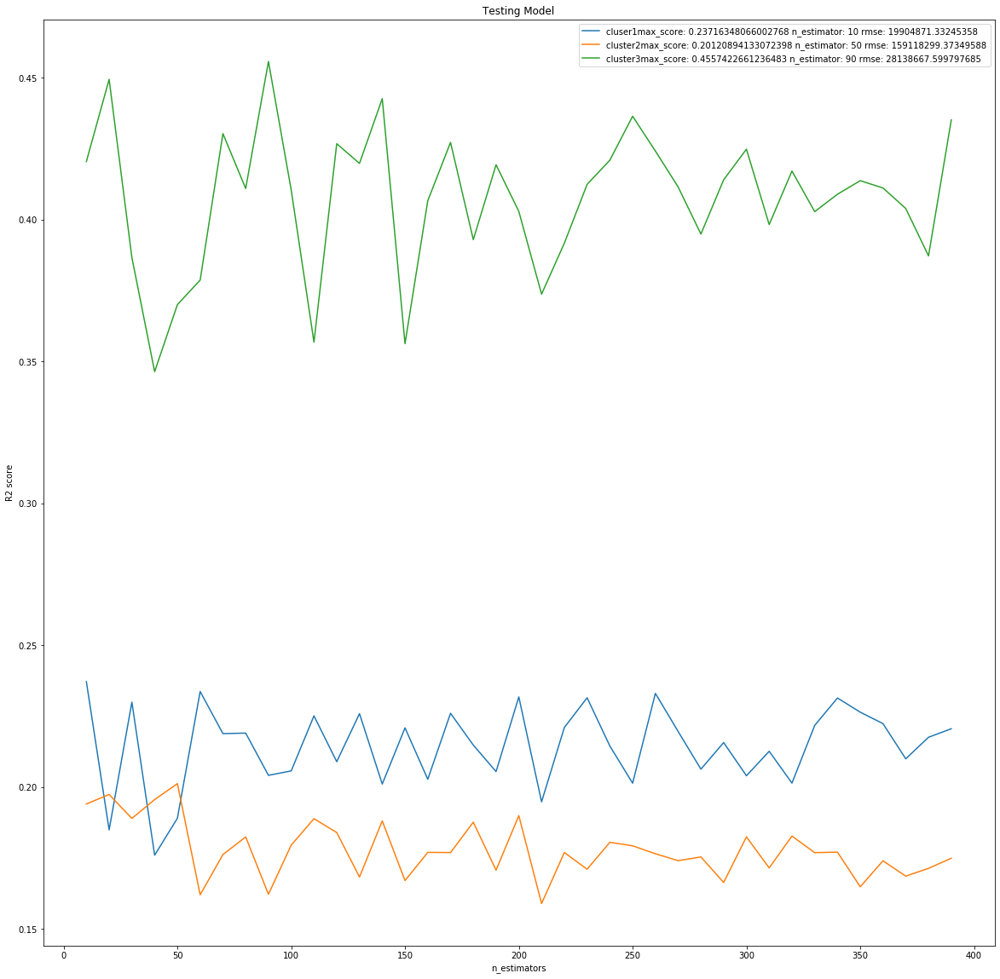

In [66]:
fig, ax = plt.subplots(figsize=(20, 20))
model = RandomForestRegressor(n_jobs=-1)
max_scores_param = []
for index in range(3):
    X_train, X_test, Y_train, Y_test = train_test_split(
    df_single_story.drop(columns=['Unnamed: 0', 'Price'],axis=1)[y_km == index],
    df_single_story['Price'][y_km == index],
    test_size=0.25,
    random_state=42
    )
    estimators = np.arange(10, 400, 10)
    scores = []
    rmse = 0.0
    for n in estimators:
        model.set_params(n_estimators=n)
        model.fit(X_train, Y_train)
        pred_y = model.predict(X_test)
        rmse = np.sqrt(((pred_y - Y_test) ** 2).mean())
        scores.append(model.score(X_test, Y_test))
    max_scores_param.append((max(scores), estimators[scores.index(max(scores))], rmse ))
    ax.plot(estimators, scores)
print(max_scores_param)
ax.legend([
    'cluser1' + 'max_score: '+ str(max_scores_param [0][0])  + ' n_estimator: ' + str(max_scores_param [0][1]) + ' rmse: ' + str(max_scores_param [0][2]),
    'cluster2' + 'max_score: '+ str(max_scores_param [1][0])  + ' n_estimator: ' + str(max_scores_param [1][1]) + ' rmse: ' + str(max_scores_param [1][2]),
    'cluster3' + 'max_score: '+ str(max_scores_param [2][0])  + ' n_estimator: ' + str(max_scores_param [2][1]) + ' rmse: ' + str(max_scores_param [2][2])
#     'cluster4' + 'max_score: '+ str(max_scores_param [3][0])  + ' n_estimator: ' + str(max_scores_param [3][1]) + ' rmse: ' + str(max_scores_param [3][2]),
])
ax.set_xlabel('n_estimators')
ax.set_ylabel('R2 score')
ax.set_title('Testing Model')

see the distribution of land size

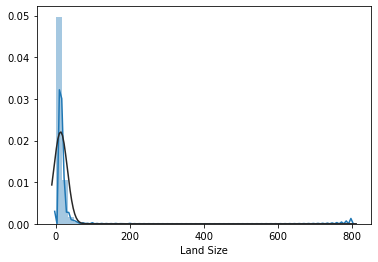

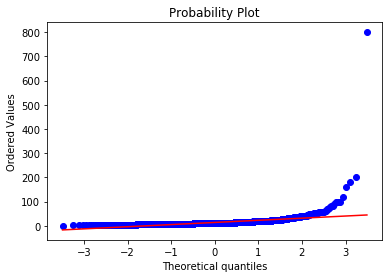

In [67]:
sns.distplot(df_single_story['Land Size'] ,fit=norm)
fig = plt.figure()
res = stats.probplot(df_single_story['Land Size'], plot =plt)

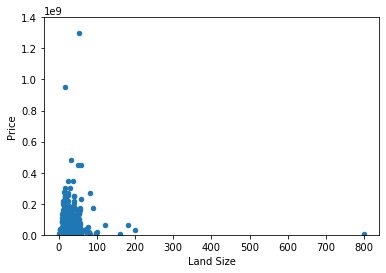

In [68]:
var = 'Land Size'
data = pd.concat([df_single_story['Price'], df_single_story[var]], axis=1)
data.plot.scatter(x=var, y='Price', ylim=(0,1.400000e+09))

drop 3 instance those  didn't follow crowds

In [69]:
df_single_story = df_single_story.drop(df_single_story[df_single_story['Price'] > 0.8e9].index, axis=0)
df_single_story = df_single_story.drop(df_single_story[df_single_story['Land Size'] > 300].index, axis=0)

try log transformation

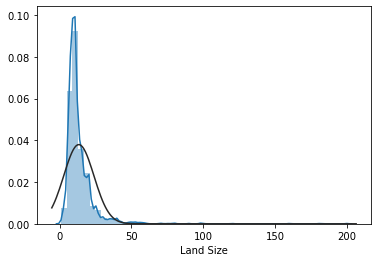

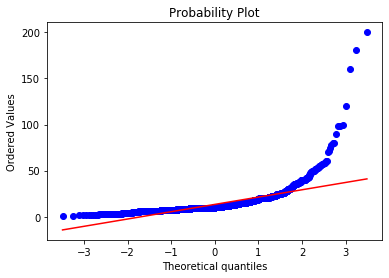

In [70]:
sns.distplot(df_single_story['Land Size'] ,fit=norm)
fig = plt.figure()
res = stats.probplot(df_single_story['Land Size'], plot =plt)

In [71]:
df_single_story[df_single_story['Land Size'] > 50.0].shape

(32, 10)

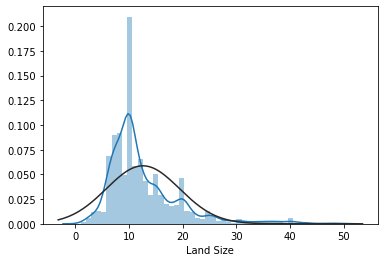

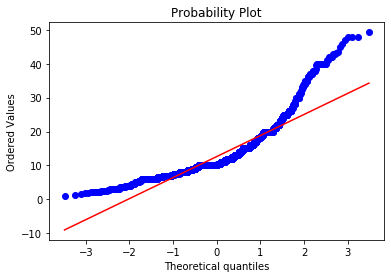

In [72]:
sns.distplot(df_single_story[df_single_story['Land Size'] < 50.0]['Land Size'] ,fit=norm)
fig = plt.figure()
res = stats.probplot(df_single_story[df_single_story['Land Size'] < 50.0]['Land Size'], plot =plt)

In [ ]:
df_single_story.columns

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/seaborn/axisgrid.py:2065: UserWarning: The `size` parameter has been renamed to `height`; pleaes update your code.
  warnings.warn(msg, UserWarning)


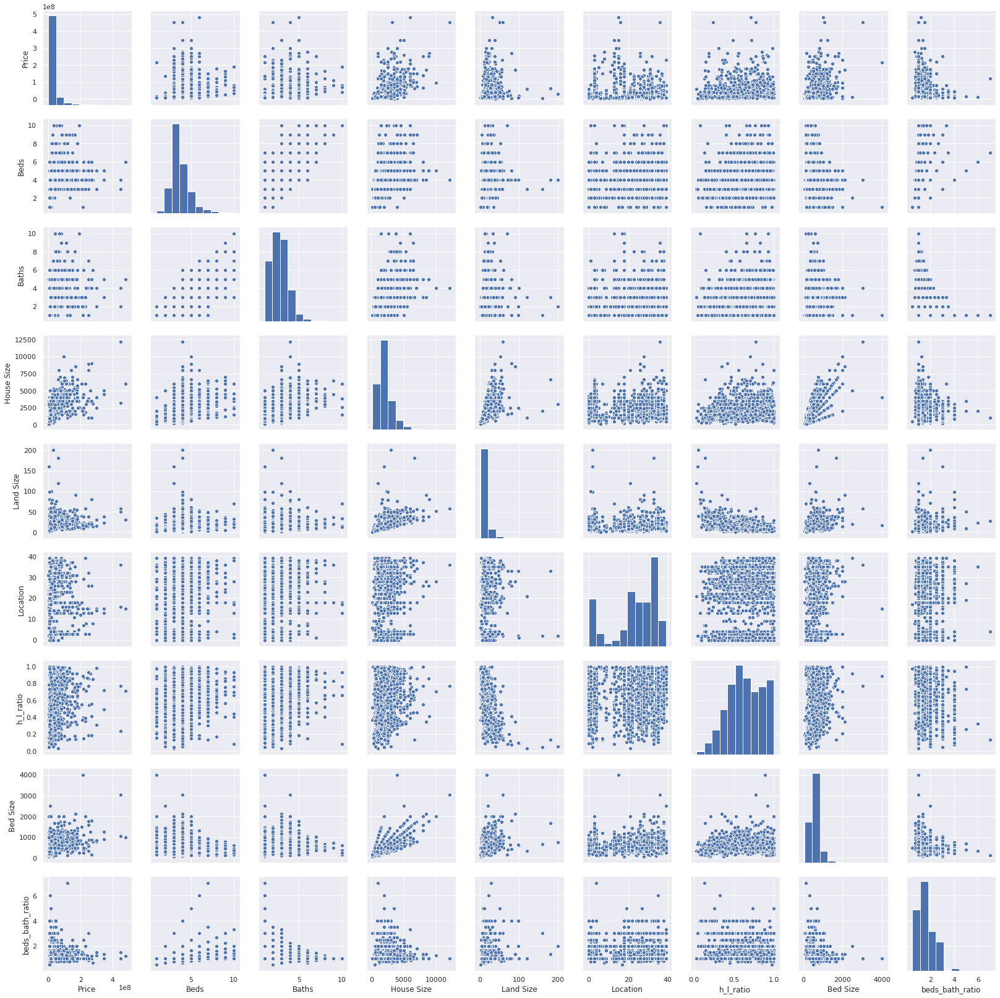

In [73]:
sns.set()

cols = ['Price', 'Beds', 'Baths', 'House Size', 'Land Size', 'Location', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio']
sns.pairplot(df_single_story[cols], size = 2.5)


Clustering single story houses with House size and price

In [74]:
km = KMeans(
    n_clusters=3,
    init= 'random',
    n_init=10,
    max_iter=300,
    tol=1e-04,
    random_state=0
)

df_house_size_price = pd.concat([df_single_story['House Size'],df_single_story['Price']], axis=1)
km.fit(df_house_size_price)
y_km = km.predict(df_house_size_price)

Text(0.5, 1.0, 'Clustering of Data set based on House Size and Price')

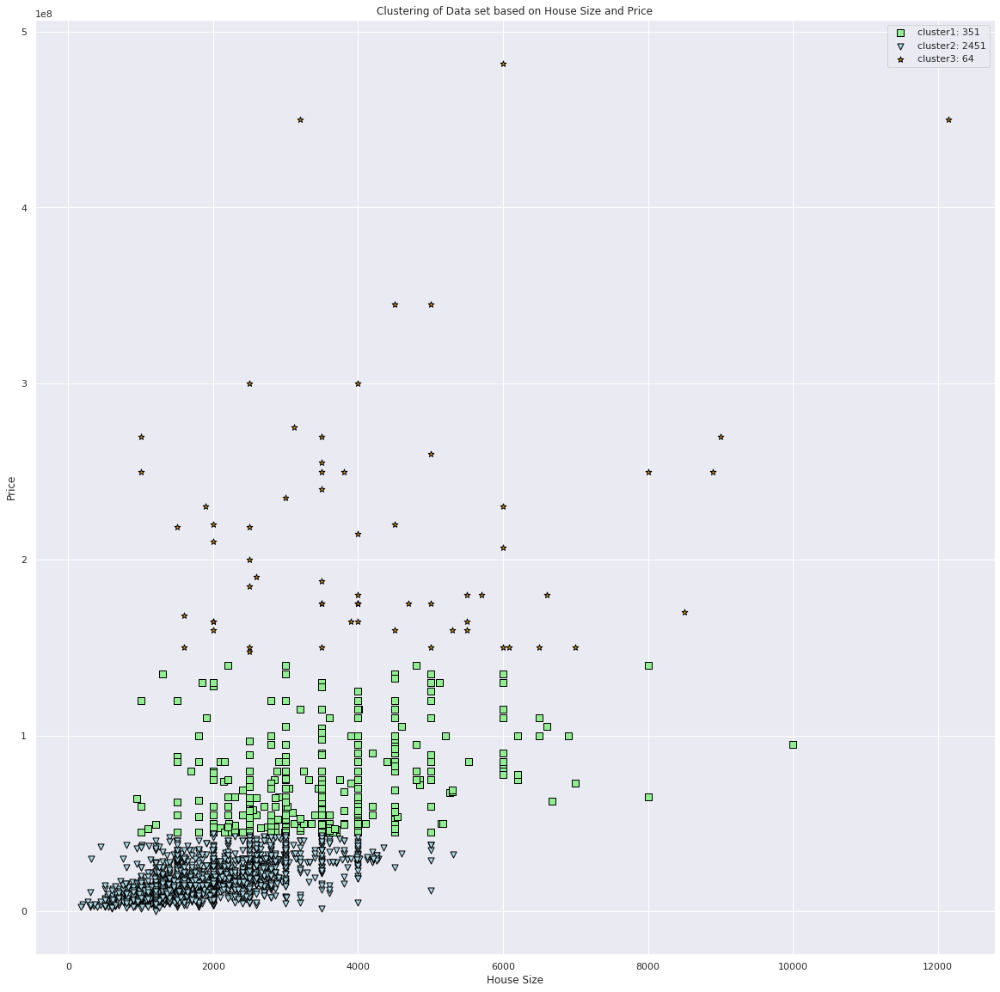

In [75]:
fig, ax = plt.subplots(figsize=(20, 20))

ax.scatter(
    df_house_size_price[y_km == 0]['House Size'],
    df_house_size_price[y_km == 0]['Price'],
    s=50,
    c='lightgreen',
    marker='s',
    edgecolor='black',
    label='cluster 1'
)


ax.scatter(
    df_house_size_price[y_km == 1]['House Size'],
    df_house_size_price[y_km == 1]['Price'],
    s=50,
    c='lightblue',
    marker='v',
    edgecolor='black',
    label='cluster 1'
)

ax.scatter(
    df_house_size_price[y_km == 2]['House Size'],
    df_house_size_price[y_km == 2]['Price'],
    s=50,
    c='orange',
    marker='*',
    edgecolor='black',
    label='cluster 1'
)
ax.legend([
    'cluster1: ' + str(df_house_size_price[y_km==0].shape[0]),
    'cluster2: ' + str(df_house_size_price[y_km==1].shape[0]),
    'cluster3: ' + str(df_house_size_price[y_km==2].shape[0])
          ])
ax.set_xlabel('House Size')
ax.set_ylabel('Price')
ax.set_title('Clustering of Data set based on House Size and Price')

In [77]:
df_single_story[y_km==1].to_csv('single_story_cleaned_1.csv')

[(0.18838553936327707, 60, 23669165.103632867), (0.5966232328699368, 330, 6029767.799960092), (0.07309547370011071, 80, 70477458.75989567)]


Text(0.5, 1.0, 'Testing Model')

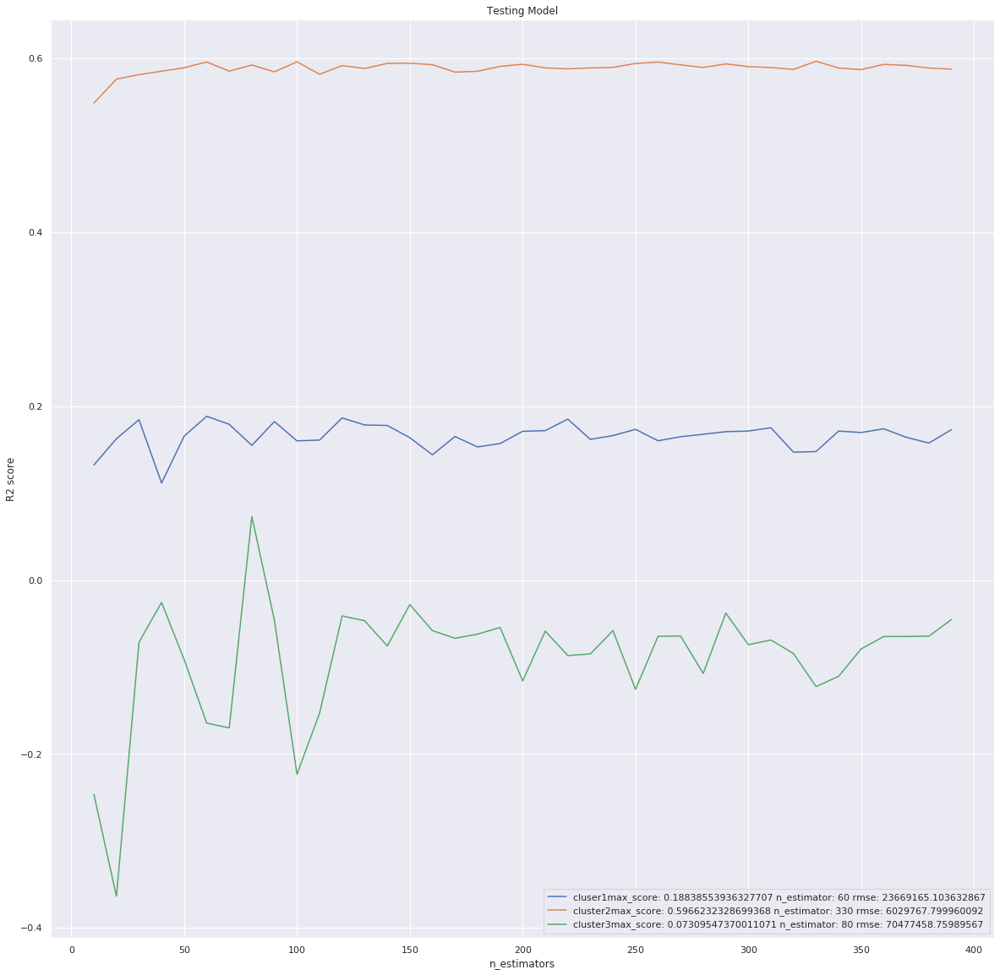

In [76]:
fig, ax = plt.subplots(figsize=(20, 20))
model = RandomForestRegressor(n_jobs=-1)
max_scores_param = []
for index in range(3):
    X_train, X_test, Y_train, Y_test = train_test_split(
    df_single_story.drop(columns=['Unnamed: 0', 'Price'],axis=1)[y_km == index],
    df_single_story['Price'][y_km == index],
    test_size=0.25,
    random_state=42
    )
    estimators = np.arange(10, 400, 10)
    scores = []
    rmse = 0.0
    for n in estimators:
        model.set_params(n_estimators=n)
        model.fit(X_train, Y_train)
        pred_y = model.predict(X_test)
        rmse = np.sqrt(((pred_y - Y_test) ** 2).mean())
        scores.append(model.score(X_test, Y_test))
    max_scores_param.append((max(scores), estimators[scores.index(max(scores))], rmse ))
    ax.plot(estimators, scores)
print(max_scores_param)
ax.legend([
    'cluser1' + 'max_score: '+ str(max_scores_param [0][0])  + ' n_estimator: ' + str(max_scores_param [0][1]) + ' rmse: ' + str(max_scores_param [0][2]),
    'cluster2' + 'max_score: '+ str(max_scores_param [1][0])  + ' n_estimator: ' + str(max_scores_param [1][1]) + ' rmse: ' + str(max_scores_param [1][2]),
    'cluster3' + 'max_score: '+ str(max_scores_param [2][0])  + ' n_estimator: ' + str(max_scores_param [2][1]) + ' rmse: ' + str(max_scores_param [2][2])
#     'cluster4' + 'max_score: '+ str(max_scores_param [3][0])  + ' n_estimator: ' + str(max_scores_param [3][1]) + ' rmse: ' + str(max_scores_param [3][2]),
])
ax.set_xlabel('n_estimators')
ax.set_ylabel('R2 score')
ax.set_title('Testing Model')

import thing to notice RMSE 59 lahs for cluter2


In [ ]:
fig, ax = plt.subplots(figsize=(20, 20))
model = RandomForestRegressor(n_jobs=-1)
max_scores_param = []
for index in range(3):
    X_train, X_test, Y_train, Y_test = train_test_split(
    df_single_story.drop(columns=['Unnamed: 0', 'Price'],axis=1)[y_km == index],
    df_single_story['Price'][y_km == index],
    test_size=0.25,
    random_state=42
    )
    estimators = np.arange(10, 400, 10)
    scores = []
    rmse = 0.0
    for n in estimators:
        model.set_params(n_estimators=n)
        model.fit(X_train, Y_train)
        pred_y = model.predict(X_test)
        rmse = np.sqrt(((pred_y - Y_test) ** 2).mean())
        scores.append(model.score(X_test, Y_test))
    max_scores_param.append((max(scores), estimators[scores.index(max(scores))], rmse ))
    ax.plot(estimators, scores)
print(max_scores_param)
ax.legend([
    'cluser1' + 'max_score: '+ str(max_scores_param [0][0])  + ' n_estimator: ' + str(max_scores_param [0][1]) + ' rmse: ' + str(max_scores_param [0][2]),
    'cluster2' + 'max_score: '+ str(max_scores_param [1][0])  + ' n_estimator: ' + str(max_scores_param [1][1]) + ' rmse: ' + str(max_scores_param [1][2]),
    'cluster3' + 'max_score: '+ str(max_scores_param [2][0])  + ' n_estimator: ' + str(max_scores_param [2][1]) + ' rmse: ' + str(max_scores_param [2][2])
#     'cluster4' + 'max_score: '+ str(max_scores_param [3][0])  + ' n_estimator: ' + str(max_scores_param [3][1]) + ' rmse: ' + str(max_scores_param [3][2]),
])
ax.set_xlabel('n_estimators')
ax.set_ylabel('R2 score')
ax.set_title('Testing Model')

try with 2 cluster

In [78]:
km = KMeans(
    n_clusters=2,
    init= 'random',
    n_init=10,
    max_iter=300,
    tol=1e-04,
    random_state=0
)

df_house_size_price = pd.concat([df_single_story['House Size'],df_single_story['Price']], axis=1)
km.fit(df_house_size_price)
y_km = km.predict(df_house_size_price)

In [81]:
df_single_story[y_km == 1].to_csv('single_story_cleaned_2.csv')

Text(0.5, 1.0, 'Clustering of Data set based on House Size and Price')

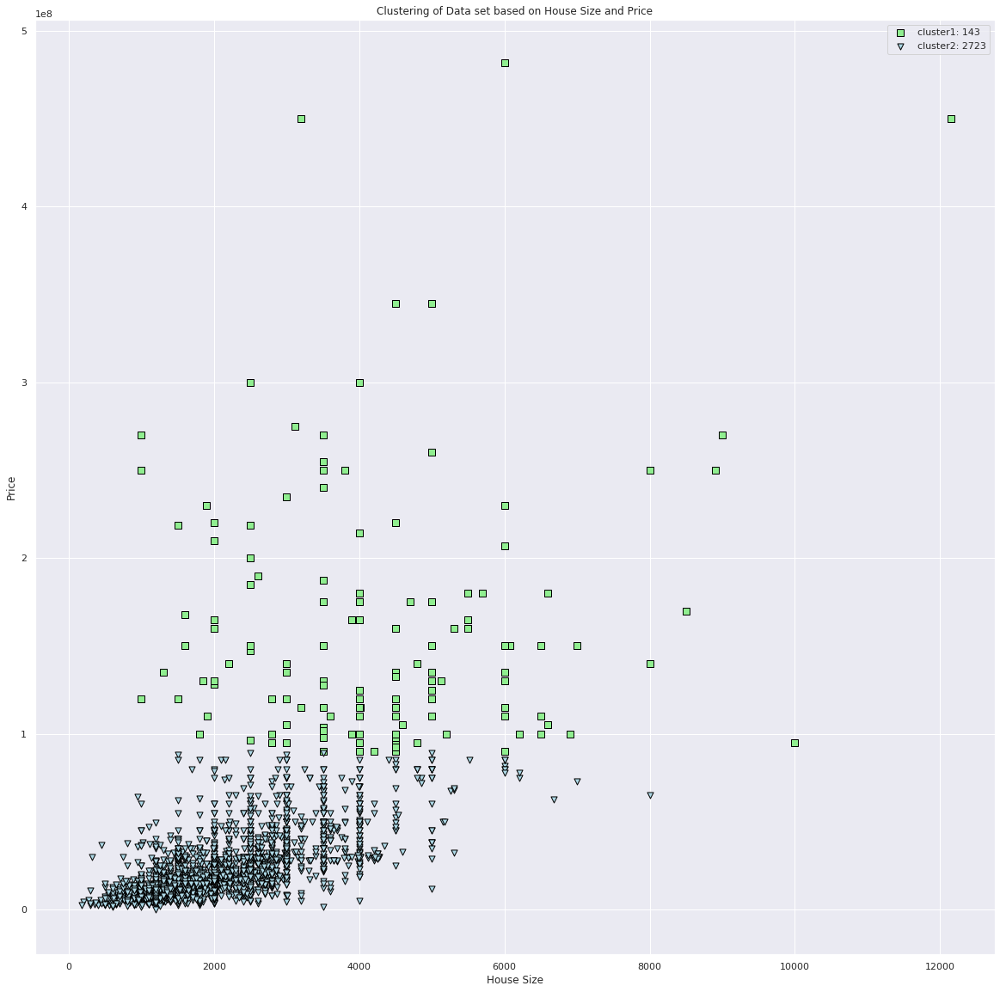

In [79]:
fig, ax = plt.subplots(figsize=(20, 20))

ax.scatter(
    df_house_size_price[y_km == 0]['House Size'],
    df_house_size_price[y_km == 0]['Price'],
    s=50,
    c='lightgreen',
    marker='s',
    edgecolor='black',
    label='cluster 1'
)


ax.scatter(
    df_house_size_price[y_km == 1]['House Size'],
    df_house_size_price[y_km == 1]['Price'],
    s=50,
    c='lightblue',
    marker='v',
    edgecolor='black',
    label='cluster 1'
)

# ax.scatter(
#     df_house_size_price[y_km == 2]['House Size'],
#     df_house_size_price[y_km == 2]['Price'],
#     s=50,
#     c='orange',
#     marker='*',
#     edgecolor='black',
#     label='cluster 1'
# )
ax.legend([
    'cluster1: ' + str(df_house_size_price[y_km==0].shape[0]),
    'cluster2: ' + str(df_house_size_price[y_km==1].shape[0])
#     'cluster3: ' + str(df_house_size_price[y_km==2].shape[0])
          ])
ax.set_xlabel('House Size')
ax.set_ylabel('Price')
ax.set_title('Clustering of Data set based on House Size and Price')

[(0.12561196203684, 20, 77619615.44239393), (0.6730806733301886, 380, 9370569.793182317)]


Text(0.5, 1.0, 'Testing Model')

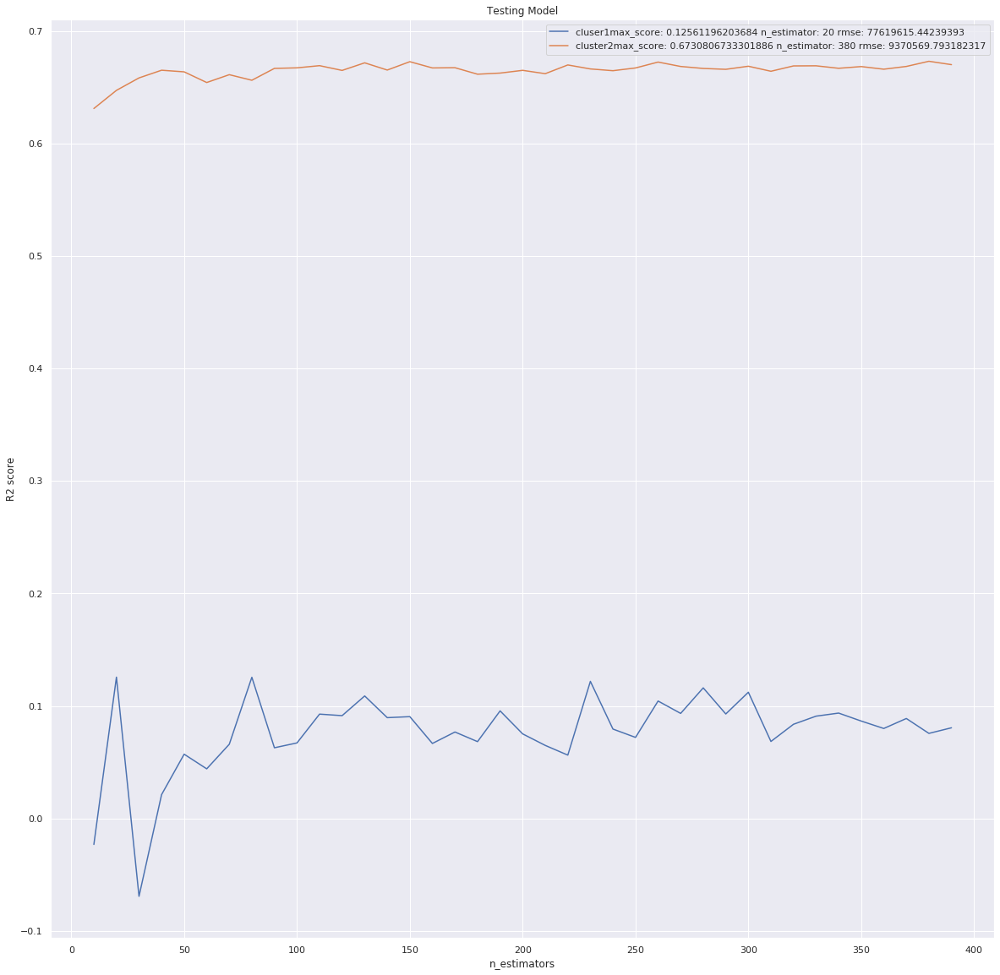

In [80]:
fig, ax = plt.subplots(figsize=(20, 20))
model = RandomForestRegressor(n_jobs=-1)
max_scores_param = []
for index in range(2):
    X_train, X_test, Y_train, Y_test = train_test_split(
    df_single_story.drop(columns=['Unnamed: 0', 'Price'],axis=1)[y_km == index],
    df_single_story['Price'][y_km == index],
    test_size=0.25,
    random_state=42
    )
    estimators = np.arange(10, 400, 10)
    scores = []
    rmse = 0.0
    for n in estimators:
        model.set_params(n_estimators=n)
        model.fit(X_train, Y_train)
        pred_y = model.predict(X_test)
        rmse = np.sqrt(((pred_y - Y_test) ** 2).mean())
        scores.append(model.score(X_test, Y_test))
    max_scores_param.append((max(scores), estimators[scores.index(max(scores))], rmse ))
    ax.plot(estimators, scores)
print(max_scores_param)
ax.legend([
    'cluser1' + 'max_score: '+ str(max_scores_param [0][0])  + ' n_estimator: ' + str(max_scores_param [0][1]) + ' rmse: ' + str(max_scores_param [0][2]),
    'cluster2' + 'max_score: '+ str(max_scores_param [1][0])  + ' n_estimator: ' + str(max_scores_param [1][1]) + ' rmse: ' + str(max_scores_param [1][2])
#     'cluster3' + 'max_score: '+ str(max_scores_param [2][0])  + ' n_estimator: ' + str(max_scores_param [2][1]) + ' rmse: ' + str(max_scores_param [2][2])
#     'cluster4' + 'max_score: '+ str(max_scores_param [3][0])  + ' n_estimator: ' + str(max_scores_param [3][1]) + ' rmse: ' + str(max_scores_param [3][2]),
])
ax.set_xlabel('n_estimators')
ax.set_ylabel('R2 score')
ax.set_title('Testing Model')

In [133]:
from sklearn.pipeline import Pipeline

In [134]:
df_single_story = pd.read_csv('single_story_cleaned_1.csv')

In [135]:
df_single_story = df_single_story.drop(['Unnamed: 0'], axis=1)
df_single_story.head()

,Unnamed: 0.1,Location,Price,Beds,Baths,House Size,Land Size,h_l_ratio,Bed Size,beds_bath_ratio
0,0,35,12500000,4,2,1750.0,6.5,0.988910,437.500000,2.000000
1,3,25,35000000,7,4,1700.0,15.0,0.416284,242.857143,1.750000
2,8,25,8900000,3,2,1380.0,6.0,0.844812,460.000000,1.500000
3,11,20,23000000,5,3,3500.0,20.0,0.642792,700.000000,1.666667
4,12,22,13000000,3,2,1800.0,10.0,0.661157,600.000000,1.500000


In [97]:
def search_best_model(pipe, params, X, Y):
    grid_obj = GridSearchCV(estimator= pipe,
                            param_grid = params,
                            cv =3,
                            verbose = 2,
                            n_jobs =1,
                            refit=True,
                            error_score='raise'
                            )
    X_train, X_test, Y_train, Y_test = train_test_split(
        X,
        Y,
        test_size=0.25,
        random_state=42
    )
    grid_obj.fit(X_train, Y_train)
    results = pd.DataFrame(pd.DataFrame(grid_obj.cv_results_))
    results_sorted = results.sort_values(by=['mean_test_score'], ascending=False)
    print("#### Results")
    print(results_sorted)
    print(grid_obj)
    print("best index", grid_obj.best_index_)
    print("best score", grid_obj.best_score_)
    print("best params", grid_obj.best_params_)
    estimator = grid_obj.best_estimator_
    cv_scores = cross_val_score(estimator, X, Y.values.ravel(), cv=shuffle, scoring='r2')
    print("#### CV Results")
    print("mean score", cv_scores.mean())
    estimator.fit(X_train,y_train)
    y_p = estimator.predict(X_test)
    rmse = np.sqrt(((y_p - Y_test) ** 2).mean()) 
    
    print(r2_score(y_p, y_test))
    plt.scatter(y_p, y_test)
    xmin, xmax = plt.xlim()
    ymin, ymax = plt.ylim()
    plt.plot([xmin, xmax], [ymin, ymax], "g--", lw=1, alpha=0.4)
    plt.xlabel("True prices")
    plt.ylabel("Predicted prices")
    plt.title('Predicted prices (LKR) vs. True prices (LKR) (Test-Train Split) cv_r2: ' + str(cv_scores.mean()) + " rmse: " + str(rmse))
    plt.show()

In [98]:
rf_params = [ {'clf__n_estimators': [10, 20, 50, 70, 100, 120, 130,140, 150, 200],
                'clf__max_features': [None, 1, 2,3, 4, 5, 6, 7, 8],
                'clf__max_depth': [1, 2, 5, 10, 15, 20, 25, 30, 35, 40, 45]}
            ]
pipe_rf = Pipeline([('clf', RandomForestRegressor())])



In [100]:
df_single_story.describe()


,Unnamed: 0.1,Location,Price,Beds,Baths,House Size,Land Size,h_l_ratio,Bed Size,beds_bath_ratio
count,2451.000000,2451.000000,2.451000e+03,2451.000000,2451.000000,2451.000000,2451.000000,2451.000000,2451.000000,2451.000000
mean,3644.897593,23.793554,1.618630e+07,3.367197,2.253774,1825.490865,11.755557,0.637313,553.712335,1.701718
std,2211.799735,11.692341,9.174206e+06,1.103893,0.993479,753.301405,8.601083,0.212290,189.412026,0.709987
min,0.000000,0.000000,8.500000e+04,1.000000,1.000000,174.240000,1.000000,0.045914,66.666667,0.500000
25%,1733.500000,20.000000,9.000000e+06,3.000000,1.000000,1300.000000,8.000000,0.489746,433.333333,1.000000
50%,3574.000000,27.000000,1.400000e+07,3.000000,2.000000,1633.000000,10.000000,0.636670,516.666667,1.500000
75%,5519.500000,35.000000,2.100000e+07,4.000000,3.000000,2300.000000,13.000000,0.816243,650.000000,2.000000
max,7609.000000,39.000000,4.420000e+07,10.000000,10.000000,5306.000000,200.000000,0.999998,2500.000000,6.000000


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


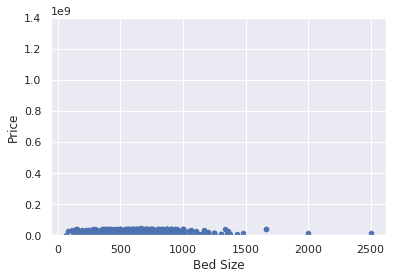

In [102]:
var = 'Bed Size'
data = pd.concat([df_single_story['Price'], df_single_story[var]], axis=1)
data.plot.scatter(x=var, y='Price', ylim=(0,1.400000e+09))

[(0.5768979408044279, 240, 6170565.958512391)]


Text(0.5, 1.0, 'Testing Modelmax_score: 0.5768979408044279 n_estimator: 240 rmse: 6170565.958512391')

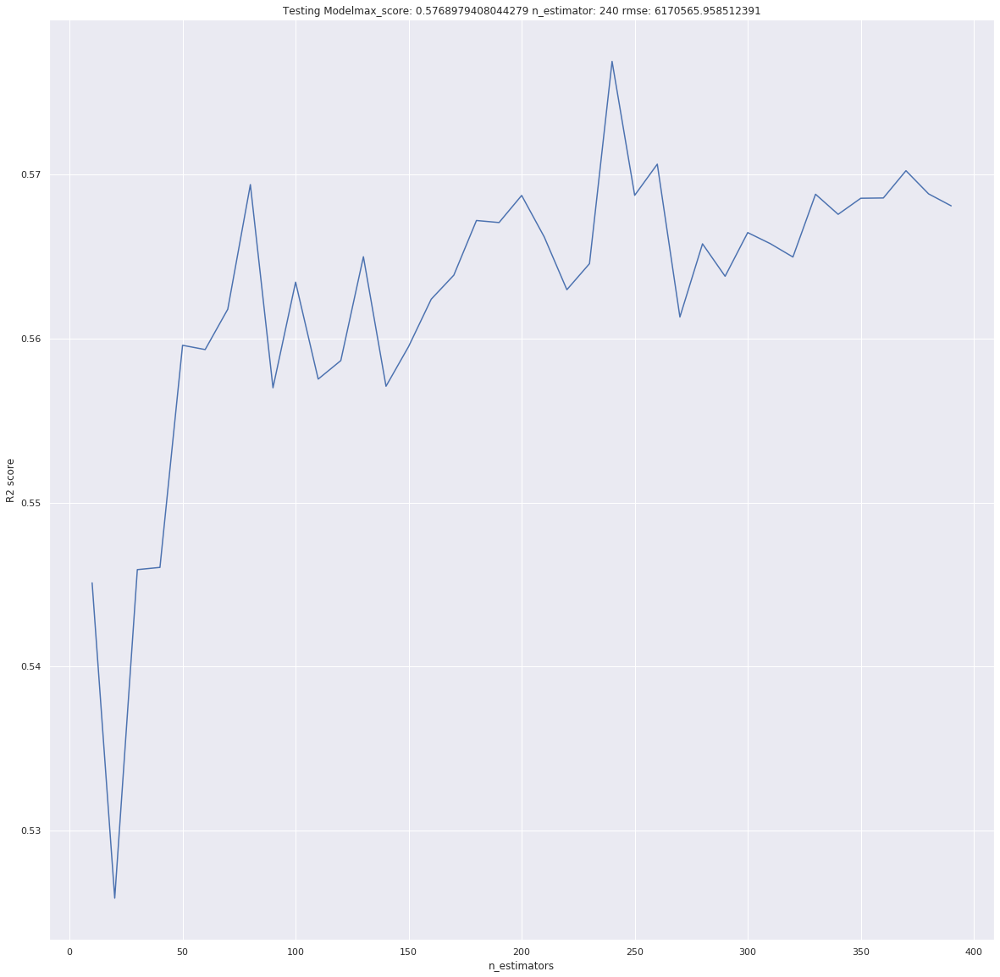

In [106]:
fig, ax = plt.subplots(figsize=(20, 20))
model = RandomForestRegressor(n_jobs=-1)
max_scores_param = []
X_train, X_test, Y_train, Y_test = train_test_split(
    df_single_story.drop(columns=[ 'Price', 'House Size', 'Beds'],axis=1),
    df_single_story['Price'],
    test_size=0.25,
    random_state=42
    )
estimators = np.arange(10, 400, 10)
scores = []
rmse = 0.0
for n in estimators:
    model.set_params(n_estimators=n)
    model.fit(X_train, Y_train)
    pred_y = model.predict(X_test)
    rmse = np.sqrt(((pred_y - Y_test) ** 2).mean())
    scores.append(model.score(X_test, Y_test))
max_scores_param.append((max(scores), estimators[scores.index(max(scores))], rmse ))
ax.plot(estimators, scores)
print(max_scores_param)
# ax.legend([
#     'cluser1' + 'max_score: '+ str(max_scores_param [0][0])  + ' n_estimator: ' + str(max_scores_param [0][1]) + ' rmse: ' + str(max_scores_param [0][2]),
#     'cluster2' + 'max_score: '+ str(max_scores_param [1][0])  + ' n_estimator: ' + str(max_scores_param [1][1]) + ' rmse: ' + str(max_scores_param [1][2])
# #     'cluster3' + 'max_score: '+ str(max_scores_param [2][0])  + ' n_estimator: ' + str(max_scores_param [2][1]) + ' rmse: ' + str(max_scores_param [2][2])
# #     'cluster4' + 'max_score: '+ str(max_scores_param [3][0])  + ' n_estimator: ' + str(max_scores_param [3][1]) + ' rmse: ' + str(max_scores_param [3][2]),
# ])
ax.set_xlabel('n_estimators')
ax.set_ylabel('R2 score')
ax.set_title('Testing Model' + 'max_score: '+ str(max_scores_param [0][0])  + ' n_estimator: ' + str(max_scores_param [0][1]) + ' rmse: ' + str(max_scores_param [0][2]))

In [107]:
import itertools



()
(1,)
(2,)
(3,)
(1, 2)
(1, 3)
(2, 3)
(1, 2, 3)


In [136]:
features = df_single_story.drop(['Price', 'Unnamed: 0.1'], axis=1).columns
features_combinations = []
for l in range(1, len(features)+1):
    for feat_comb in itertools.combinations(features, l):
        features_combinations.append(list(feat_comb))

#######################################################################################################################
['Location']
[(0.27455035793583416, 50, 8023474.300591752)]
#######################################################################################################################
#######################################################################################################################
['Beds']
[(0.3037908947675364, 20, 7847774.566267109)]
#######################################################################################################################
#######################################################################################################################
['Baths']
[(0.3006133390457205, 30, 7855122.824510645)]
#######################################################################################################################
#############################################################################################################

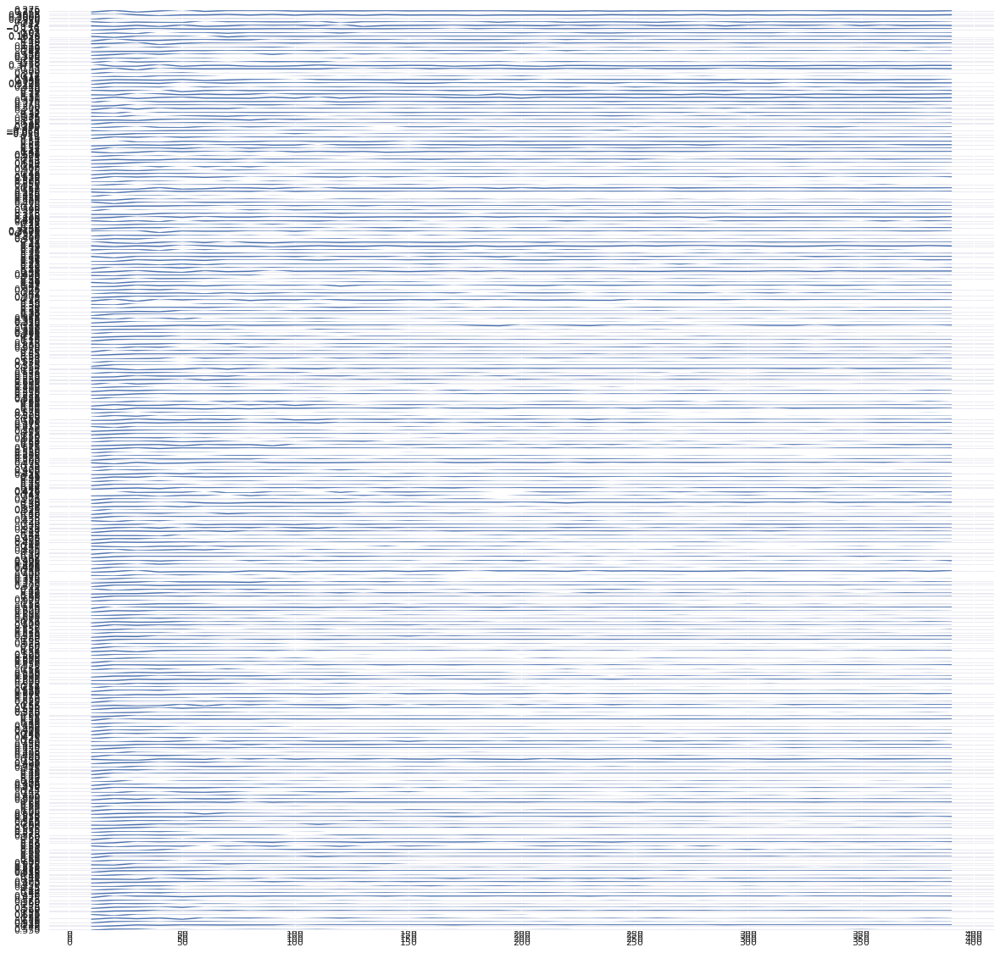

In [123]:
fig, axes = plt.subplots(len(features_combinations), figsize=(20, 20))
for index, features in enumerate(features_combinations):
    model = RandomForestRegressor(n_jobs=-1)
    max_scores_param = []
    X_train, X_test, Y_train, Y_test = train_test_split(
        df_single_story[features],
        df_single_story['Price'],
        test_size=0.25,
        random_state=42
    )
    estimators = np.arange(10, 400, 10)
    scores = []
    rmse = 0.0
    for n in estimators:
        model.set_params(n_estimators=n)
        model.fit(X_train, Y_train)
        pred_y = model.predict(X_test)
        rmse = np.sqrt(((pred_y - Y_test) ** 2).mean())
        scores.append(model.score(X_test, Y_test))
    max_scores_param.append((max(scores), estimators[scores.index(max(scores))], rmse ))
    axes[index].plot(estimators, scores)
#     print(max_scores_param)
# ax.legend([
#     'cluser1' + 'max_score: '+ str(max_scores_param [0][0])  + ' n_estimator: ' + str(max_scores_param [0][1]) + ' rmse: ' + str(max_scores_param [0][2]),
#     'cluster2' + 'max_score: '+ str(max_scores_param [1][0])  + ' n_estimator: ' + str(max_scores_param [1][1]) + ' rmse: ' + str(max_scores_param [1][2])
# #     'cluster3' + 'max_score: '+ str(max_scores_param [2][0])  + ' n_estimator: ' + str(max_scores_param [2][1]) + ' rmse: ' + str(max_scores_param [2][2])
# #     'cluster4' + 'max_score: '+ str(max_scores_param [3][0])  + ' n_estimator: ' + str(max_scores_param [3][1]) + ' rmse: ' + str(max_scores_param [3][2]),
# ])
    print('#######################################################################################################################')
    print(features)
    print(max_scores_param)
    print('#######################################################################################################################')
#     axes[index].set_xlabel('n_estimators')
#     axes[index].set_ylabel('R2 score')
#     axes[index].set_title('Testing Model' + 'max_score: '+ str(max_scores_param [0][0])  + ' n_estimator: ' + str(max_scores_param [0][1]) + ' rmse: ' + str(max_scores_param [0][2]))

In [137]:
df_single_story['Price'].describe()

count    2.451000e+03
mean     1.618630e+07
std      9.174206e+06
min      8.500000e+04
25%      9.000000e+06
50%      1.400000e+07
75%      2.100000e+07
max      4.420000e+07
Name: Price, dtype: float64

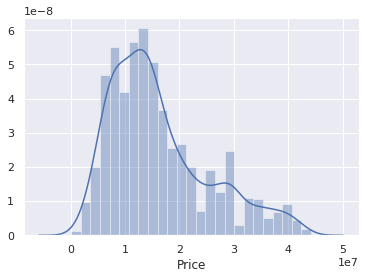

In [138]:
sns.distplot(df_single_story['Price'])

In [149]:
df_single_story[df_single_story['Price'] < 8.5e6][df_single_story['House Size'] < 300]

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


,Unnamed: 0.1,Location,Price,Beds,Baths,House Size,Land Size,h_l_ratio,Bed Size,beds_bath_ratio
261,745,18,4300000,3,1,200.00,2.00,0.367309,66.666667,3.0
888,2448,5,5500000,2,1,272.00,1.00,0.999082,136.000000,2.0
2267,7060,6,2500000,1,1,174.24,1.24,0.516129,174.240000,1.0


<h1>Drop the house which has price of 85000</h1>


In [140]:
df_single_story = df_single_story.drop(df_single_story[df_single_story['Price'] == 85000].index, axis=0)

In [141]:
df_single_story['Price'].describe()

count    2.450000e+03
mean     1.619287e+07
std      9.170306e+06
min      1.500000e+06
25%      9.050000e+06
50%      1.400000e+07
75%      2.100000e+07
max      4.420000e+07
Name: Price, dtype: float64

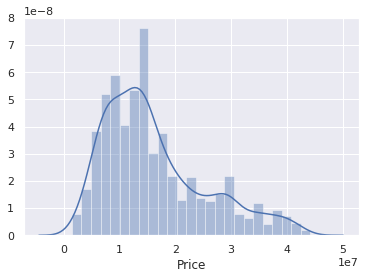

In [143]:
sns.distplot(df_single_story['Price'])

In [145]:
df_single_story.to_csv('single_story_cleaned_3.csv')

In [151]:
df_single_story[df_single_story['Price'] < 8.5e6][df_single_story['House Size'] < 500]

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


,Unnamed: 0.1,Location,Price,Beds,Baths,House Size,Land Size,h_l_ratio,Bed Size,beds_bath_ratio
261,745,18,4300000,3,1,200.00,2.00,0.367309,66.666667,3.0
714,2013,9,3500000,1,1,400.00,1.50,0.979492,400.000000,1.0
888,2448,5,5500000,2,1,272.00,1.00,0.999082,136.000000,2.0
1165,3349,39,2500000,1,1,400.00,2.00,0.734619,400.000000,1.0
1287,3774,28,3000000,1,1,350.00,2.50,0.514233,350.000000,1.0
1501,4418,9,2400000,2,1,300.00,2.75,0.400701,150.000000,2.0
1970,5991,36,3600000,2,1,450.00,4.00,0.413223,225.000000,2.0
1978,6014,25,5500000,2,2,442.00,10.00,0.162351,221.000000,1.0
2023,6161,17,4200000,2,2,366.00,2.00,0.672176,183.000000,1.0
2248,7001,21,3600000,1,1,300.00,7.10,0.155201,300.000000,1.0


<h1>Open newly created data set </h1>

In [152]:
df_single_story = pd.read_csv('./single_story_cleaned_3.csv')

In [153]:
df_single_story.head()

,Unnamed: 0,Unnamed: 0.1,Location,Price,Beds,Baths,House Size,Land Size,h_l_ratio,Bed Size,beds_bath_ratio
0,0,0,35,12500000,4,2,1750.0,6.5,0.988910,437.500000,2.000000
1,1,3,25,35000000,7,4,1700.0,15.0,0.416284,242.857143,1.750000
2,2,8,25,8900000,3,2,1380.0,6.0,0.844812,460.000000,1.500000
3,3,11,20,23000000,5,3,3500.0,20.0,0.642792,700.000000,1.666667
4,4,12,22,13000000,3,2,1800.0,10.0,0.661157,600.000000,1.500000


In [154]:
df_single_story = df_single_story.drop(['Unnamed: 0', 'Unnamed: 0.1'], axis=1)

In [155]:
df_single_story.describe()

,Location,Price,Beds,Baths,House Size,Land Size,h_l_ratio,Bed Size,beds_bath_ratio
count,2450.000000,2.450000e+03,2450.000000,2450.000000,2450.000000,2450.000000,2450.000000,2450.000000,2450.000000
mean,23.790612,1.619287e+07,3.367347,2.253878,1825.746167,11.756273,0.637394,553.775075,1.701801
std,11.693821,9.170306e+06,1.104094,0.993669,753.349122,8.602765,0.212296,189.425218,0.710120
min,0.000000,1.500000e+06,1.000000,1.000000,174.240000,1.000000,0.045914,66.666667,0.500000
25%,20.000000,9.050000e+06,3.000000,1.000000,1300.000000,8.000000,0.489746,433.333333,1.000000
50%,27.000000,1.400000e+07,3.000000,2.000000,1633.000000,10.000000,0.636670,516.666667,1.500000
75%,35.000000,2.100000e+07,4.000000,3.000000,2300.000000,13.000000,0.816243,650.000000,2.000000
max,39.000000,4.420000e+07,10.000000,10.000000,5306.000000,200.000000,0.999998,2500.000000,6.000000


In [228]:
features_important =[
    ['Location', 'Beds', 'Baths', 'Land Size'],
    ['Location', 'Beds', 'Baths','House Size', 'h_l_ratio'],
    ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'],
    ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'],
    ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'],
    ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'],
    ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'],
    ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'],
    ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'],
    ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio']  
]

<h1>Try MLP with important features </h1>

In [241]:
def search_best_MLP_model(df):
    results = []
#     X_train, X_test, Y_train, Y_test = train_test_split(
#         X,
#         Y,
#         test_size=0.25,
#         random_state=42
#     )
    hidden_layers = [
        (100, 10,),
        (100, 10, 100,),
        (100, 200, 100,),
        (100,),
        (200, 100,),
        (7,),
        (7, 7,),
        (7, 7, 7),
        (20, 20, 20,),
        (20, 50,),
        (50,),
        (50, 50,),
        (50, 20, 50,),
        (50, 50, 50,),
        (400, 50, 10),
        (400, 200, 100),
        (350, 50, 200)
    ]
    activations = ['identity', 'logistic', 'tanh', 'relu']
    solvers = ['lbfgs', 'sgd', 'adam']
    learning_rates = ['constant', 'invscaling', 'adaptive']
    #iterate over layers
    for layers in hidden_layers:
        for act in activations:
            for solver in solvers:
                for lr in learning_rates:
                    for features in features_important:
                        X_train, X_test, Y_train, Y_test = train_test_split(
                            df[features],
                            df['Price'],
                            test_size=0.25,
                            random_state=42)
                        model = MLPRegressor(
                        hidden_layer_sizes= layers, 
                        activation=act, 
                        solver=solver, 
                        alpha=0.0001, 
                        batch_size=32, 
                        learning_rate=lr, 
                        learning_rate_init=0.001, 
                        power_t=0.5, 
                        momentum=0.9, 
                        verbose=1, 
                        early_stopping=True)
                        model.fit(X_train, Y_train)
                        score = model.score(X_train, Y_train)
                        #X_train[features], Y_test
                        y_p = model.predict(X_test)
                        rmse = np.sqrt(((y_p - Y_test) ** 2).mean())
                        result = [score, rmse, layers, act, solver, lr, features]
                        results.append(result)
                        print('#############################################################################')
                        print(result)
                        print('#############################################################################')
    return results                    
    

In [242]:
df_single_story.columns

Index(['Location', 'Price', 'Beds', 'Baths', 'House Size', 'Land Size',
       'h_l_ratio', 'Bed Size', 'beds_bath_ratio'],
      dtype='object')

In [243]:
df_single_story_scaled = df_single_story.copy()
min_max_scaler = MinMaxScaler()
df_single_story_scaled[df_single_story.columns] =  min_max_scaler.fit_transform(df_single_story[df_single_story.columns])

In [244]:
df_single_story_scaled.head()

,Location,Price,Beds,Baths,House Size,Land Size,h_l_ratio,Bed Size,beds_bath_ratio
0,0.897436,0.257611,0.333333,0.111111,0.307060,0.027638,0.988378,0.152397,0.272727
1,0.641026,0.784543,0.666667,0.333333,0.297317,0.070352,0.388194,0.072407,0.227273
2,0.641026,0.173302,0.222222,0.111111,0.234960,0.025126,0.837345,0.161644,0.181818
3,0.512821,0.503513,0.444444,0.222222,0.648074,0.095477,0.625603,0.260274,0.212121
4,0.564103,0.269321,0.222222,0.111111,0.316804,0.045226,0.644852,0.219178,0.181818


In [245]:
df_single_story_scaled['Price'].values

array([0.25761124, 0.78454333, 0.17330211, ..., 0.14051522, 0.09601874,
       0.28571429])

In [246]:
results = search_best_MLP_model(df_single_story_scaled)

#############################################################################
[0.34359194069661414, 0.17545694248173077, (100, 10), 'identity', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#############################################################################
[0.4326149900272706, 0.15745512085589278, (100, 10), 'identity', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.3611721302600558, 0.17425799171273726, (100, 10), 'identity', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.413662902848

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.01627703
Validation score: 0.214269
Iteration 6, loss = 0.01595050
Validation score: 0.227724
Iteration 7, loss = 0.01568565
Validation score: 0.238400
Iteration 8, loss = 0.01546776
Validation score: 0.248095
Iteration 9, loss = 0.01528132
Validation score: 0.256811
Iteration 10, loss = 0.01512846
Validation score: 0.263835
Iteration 11, loss = 0.01495474
Validation score: 0.271593
Iteration 12, loss = 0.01480371
Validation score: 0.273850
Iteration 13, loss = 0.01472672
Validation score: 0.280376
Iteration 14, loss = 0.01455486
Validation score: 0.287996
Iteration 15, loss = 0.01443356
Validation score: 0.291175
Iteration 16, loss = 0.01437274
Validation score: 0.296217
Iteration 17, loss = 0.01426038
Validation score: 0.300903
Iteration 18, loss = 0.01423825
Validation score: 0.304587
Iteration 19, loss = 0.01412139
Validation score: 0.308000
Iteration 20, loss = 0.01406617
Validation score: 0.310698
Iteration 21, loss = 0.01400608
Validation score: 0.313489
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 12, loss = 0.01941319
Validation score: 0.113004
Iteration 13, loss = 0.01878122
Validation score: 0.142546
Iteration 14, loss = 0.01828456
Validation score: 0.158361
Iteration 15, loss = 0.01782747
Validation score: 0.176905
Iteration 16, loss = 0.01747279
Validation score: 0.182498
Iteration 17, loss = 0.01718081
Validation score: 0.196831
Iteration 18, loss = 0.01690427
Validation score: 0.204156
Iteration 19, loss = 0.01670305
Validation score: 0.221371
Iteration 20, loss = 0.01648759
Validation score: 0.227446
Iteration 21, loss = 0.01632728
Validation score: 0.232666
Iteration 22, loss = 0.01620736
Validation score: 0.233533
Iteration 23, loss = 0.01604778
Validation score: 0.239534
Iteration 24, loss = 0.01591546
Validation score: 0.241271
Iteration 25, loss = 0.01581919
Validation score: 0.245873
Iteration 26, loss = 0.01573023
Validation score: 0.248668
Iteration 27, loss = 0.01567152
Validation score: 0.250146
Iteration 28, loss = 0.01559376
Validation score: 0.2512

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02737052
Validation score: -0.183764
Iteration 3, loss = 0.02539481
Validation score: -0.104551
Iteration 4, loss = 0.02415736
Validation score: -0.034855
Iteration 5, loss = 0.02301514
Validation score: 0.012302
Iteration 6, loss = 0.02203138
Validation score: 0.048011
Iteration 7, loss = 0.02124266
Validation score: 0.075143
Iteration 8, loss = 0.02048336
Validation score: 0.109989
Iteration 9, loss = 0.01984331
Validation score: 0.130158
Iteration 10, loss = 0.01927743
Validation score: 0.146976
Iteration 11, loss = 0.01875824
Validation score: 0.178770
Iteration 12, loss = 0.01832599
Validation score: 0.195245
Iteration 13, loss = 0.01799115
Validation score: 0.209700
Iteration 14, loss = 0.01753390
Validation score: 0.222835
Iteration 15, loss = 0.01719458
Validation score: 0.233084
Iteration 16, loss = 0.01688463
Validation score: 0.241344
Iteration 17, loss = 0.01659076
Validation score: 0.247769
Iteration 18, loss = 0.01641490
Validation score: 0.256997
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: -0.708980
Iteration 3, loss = 0.03613153
Validation score: -0.686946
Iteration 4, loss = 0.03575558
Validation score: -0.672402
Iteration 5, loss = 0.03548578
Validation score: -0.661491
Iteration 6, loss = 0.03528002
Validation score: -0.652153
Iteration 7, loss = 0.03511058
Validation score: -0.644597
Iteration 8, loss = 0.03496857
Validation score: -0.637956
Iteration 9, loss = 0.03484450
Validation score: -0.632414
Iteration 10, loss = 0.03473622
Validation score: -0.627369
Iteration 11, loss = 0.03463974
Validation score: -0.622682
Iteration 12, loss = 0.03455073
Validation score: -0.618322
Iteration 13, loss = 0.03446918
Validation score: -0.614558
Iteration 14, loss = 0.03439391
Validation score: -0.610901
Iteration 15, loss = 0.03432527
Validation score: -0.607412
Iteration 16, loss = 0.03426149
Validation score: -0.604248
Iteration 17, loss = 0.03420136
Validation score: -0.601438
Iteration 18, loss = 0.03414439
Validation score: -0.598610
Iteration 19, loss 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02412202
Validation score: -0.076643
Iteration 4, loss = 0.02408220
Validation score: -0.075684
Iteration 5, loss = 0.02404923
Validation score: -0.074960
Iteration 6, loss = 0.02402279
Validation score: -0.074285
Iteration 7, loss = 0.02399976
Validation score: -0.073606
Iteration 8, loss = 0.02397955
Validation score: -0.073040
Iteration 9, loss = 0.02395892
Validation score: -0.072441
Iteration 10, loss = 0.02394149
Validation score: -0.071938
Iteration 11, loss = 0.02392443
Validation score: -0.071311
Iteration 12, loss = 0.02390886
Validation score: -0.070721
Iteration 13, loss = 0.02389451
Validation score: -0.070370
Iteration 14, loss = 0.02387984
Validation score: -0.069699
Iteration 15, loss = 0.02386636
Validation score: -0.069324
Iteration 16, loss = 0.02385305
Validation score: -0.068727
Iteration 17, loss = 0.02384011
Validation score: -0.068309
Iteration 18, loss = 0.02382883
Validation score: -0.067824
Iteration 19, loss = 0.02381634
Validation scor

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.01745043
Validation score: 0.145262
Iteration 11, loss = 0.01744356
Validation score: 0.145729
Iteration 12, loss = 0.01743761
Validation score: 0.146232
Iteration 13, loss = 0.01743054
Validation score: 0.146367
Iteration 14, loss = 0.01742486
Validation score: 0.146690
Iteration 15, loss = 0.01741943
Validation score: 0.146860
Iteration 16, loss = 0.01741376
Validation score: 0.147280
Iteration 17, loss = 0.01740855
Validation score: 0.147614
Iteration 18, loss = 0.01740345
Validation score: 0.147918
Iteration 19, loss = 0.01739863
Validation score: 0.148176
Iteration 20, loss = 0.01739392
Validation score: 0.148392
Iteration 21, loss = 0.01738921
Validation score: 0.148646
Iteration 22, loss = 0.01738505
Validation score: 0.148866
Iteration 23, loss = 0.01738038
Validation score: 0.149244
Iteration 24, loss = 0.01737609
Validation score: 0.149465
Iteration 25, loss = 0.01737206
Validation score: 0.149770
Iteration 26, loss = 0.01736782
Validation score: 0.1499

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02442070
Validation score: -0.110563
Iteration 4, loss = 0.02436757
Validation score: -0.107578
Iteration 5, loss = 0.02432652
Validation score: -0.105200
Iteration 6, loss = 0.02429420
Validation score: -0.103075
Iteration 7, loss = 0.02426556
Validation score: -0.101314
Iteration 8, loss = 0.02424195
Validation score: -0.099860
Iteration 9, loss = 0.02422100
Validation score: -0.098527
Iteration 10, loss = 0.02420250
Validation score: -0.097321
Iteration 11, loss = 0.02418547
Validation score: -0.096214
Iteration 12, loss = 0.02417047
Validation score: -0.095298
Iteration 13, loss = 0.02415615
Validation score: -0.094324
Iteration 14, loss = 0.02414337
Validation score: -0.093376
Iteration 15, loss = 0.02413053
Validation score: -0.092562
Iteration 16, loss = 0.02411945
Validation score: -0.091840
Iteration 17, loss = 0.02410884
Validation score: -0.091097
Iteration 18, loss = 0.02409861
Validation score: -0.090465
Iteration 19, loss = 0.02408927
Validation scor

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02494760
Validation score: -0.108364
Iteration 3, loss = 0.02489032
Validation score: -0.102039
Iteration 4, loss = 0.02480964
Validation score: -0.097559
Iteration 5, loss = 0.02475277
Validation score: -0.094225
Iteration 6, loss = 0.02471050
Validation score: -0.092201
Iteration 7, loss = 0.02467736
Validation score: -0.090291
Iteration 8, loss = 0.02464649
Validation score: -0.088650
Iteration 9, loss = 0.02461999
Validation score: -0.087235
Iteration 10, loss = 0.02459504
Validation score: -0.086161
Iteration 11, loss = 0.02457378
Validation score: -0.084980
Iteration 12, loss = 0.02455302
Validation score: -0.083949
Iteration 13, loss = 0.02453479
Validation score: -0.083033
Iteration 14, loss = 0.02451660
Validation score: -0.082224
Iteration 15, loss = 0.02449997
Validation score: -0.081403
Iteration 16, loss = 0.02448418
Validation score: -0.080625
Iteration 17, loss = 0.02446917
Validation score: -0.079972
Iteration 18, loss = 0.02445528
Validation score

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02081608
Validation score: 0.059564
Iteration 4, loss = 0.02057004
Validation score: 0.065273
Iteration 5, loss = 0.02042638
Validation score: 0.069073
Iteration 6, loss = 0.02032743
Validation score: 0.071970
Iteration 7, loss = 0.02025502
Validation score: 0.074131
Iteration 8, loss = 0.02019613
Validation score: 0.075771
Iteration 9, loss = 0.02015004
Validation score: 0.077116
Iteration 10, loss = 0.02011217
Validation score: 0.078263
Iteration 11, loss = 0.02008198
Validation score: 0.079236
Iteration 12, loss = 0.02005321
Validation score: 0.080038
Iteration 13, loss = 0.02003019
Validation score: 0.080776
Iteration 14, loss = 0.02000881
Validation score: 0.081445
Iteration 15, loss = 0.01999001
Validation score: 0.082031
Iteration 16, loss = 0.01997279
Validation score: 0.082598
Iteration 17, loss = 0.01995777
Validation score: 0.083112
Iteration 18, loss = 0.01994310
Validation score: 0.083586
Iteration 19, loss = 0.01992977
Validation score: 0.084036
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02822251
Validation score: -0.228485
Iteration 3, loss = 0.02466868
Validation score: -0.089236
Iteration 4, loss = 0.02235291
Validation score: -0.009575
Iteration 5, loss = 0.02087642
Validation score: 0.052371
Iteration 6, loss = 0.01985183
Validation score: 0.095293
Iteration 7, loss = 0.01890462
Validation score: 0.129782
Iteration 8, loss = 0.01825245
Validation score: 0.156139
Iteration 9, loss = 0.01775069
Validation score: 0.176744
Iteration 10, loss = 0.01732459
Validation score: 0.193064
Iteration 11, loss = 0.01696186
Validation score: 0.205025
Iteration 12, loss = 0.01667579
Validation score: 0.217361
Iteration 13, loss = 0.01640299
Validation score: 0.226364
Iteration 14, loss = 0.01619527
Validation score: 0.232956
Iteration 15, loss = 0.01601779
Validation score: 0.236852
Iteration 16, loss = 0.01586028
Validation score: 0.246820
Iteration 17, loss = 0.01574392
Validation score: 0.251002
Iteration 18, loss = 0.01562795
Validation score: 0.253563
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.14451827
Validation score: 0.104280
Iteration 2, loss = 0.01836741
Validation score: 0.178017
Iteration 3, loss = 0.01711956
Validation score: 0.217679
Iteration 4, loss = 0.01637164
Validation score: 0.252843
Iteration 5, loss = 0.01575424
Validation score: 0.276411
Iteration 6, loss = 0.01523798
Validation score: 0.301445
Iteration 7, loss = 0.01487025
Validation score: 0.322191
Iteration 8, loss = 0.01454896
Validation score: 0.338680
Iteration 9, loss = 0.01424126
Validation score: 0.353320
Iteration 10, loss = 0.01402776
Validation score: 0.364090
Iteration 11, loss = 0.01384947
Validation score: 0.374975
Iteration 12, loss = 0.01369489
Validation score: 0.383866
Iteration 13, loss = 0.01355657
Validation score: 0.389286
Iteration 14, loss = 0.01348996
Validation score: 0.396577
Iteration 15, loss = 0.01336704
Validation score: 0.398546
Iteration 16, loss = 0.01331710
Validation score: 0.407928
Iteration 17, loss = 0.01324673
Validation score: 0.410827
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02565243
Validation score: -0.094927
Iteration 3, loss = 0.02339472
Validation score: -0.004744
Iteration 4, loss = 0.02153327
Validation score: 0.062391
Iteration 5, loss = 0.02000314
Validation score: 0.129388
Iteration 6, loss = 0.01881358
Validation score: 0.178304
Iteration 7, loss = 0.01781642
Validation score: 0.217378
Iteration 8, loss = 0.01700248
Validation score: 0.251869
Iteration 9, loss = 0.01640522
Validation score: 0.274135
Iteration 10, loss = 0.01581067
Validation score: 0.298214
Iteration 11, loss = 0.01536977
Validation score: 0.310997
Iteration 12, loss = 0.01497533
Validation score: 0.333412
Iteration 13, loss = 0.01469291
Validation score: 0.346207
Iteration 14, loss = 0.01444418
Validation score: 0.358093
Iteration 15, loss = 0.01421033
Validation score: 0.370095
Iteration 16, loss = 0.01402507
Validation score: 0.377694
Iteration 17, loss = 0.01391394
Validation score: 0.384780
Iteration 18, loss = 0.01374967
Validation score: 0.390029
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.01816600
Validation score: 0.037194
Iteration 8, loss = 0.01760444
Validation score: 0.060403
Iteration 9, loss = 0.01707741
Validation score: 0.097477
Iteration 10, loss = 0.01666922
Validation score: 0.084237
Iteration 11, loss = 0.01631895
Validation score: 0.137756
Iteration 12, loss = 0.01590049
Validation score: 0.146874
Iteration 13, loss = 0.01555843
Validation score: 0.174455
Iteration 14, loss = 0.01535693
Validation score: 0.176037
Iteration 15, loss = 0.01502544
Validation score: 0.183573
Iteration 16, loss = 0.01483504
Validation score: 0.202664
Iteration 17, loss = 0.01463328
Validation score: 0.214984
Iteration 18, loss = 0.01437381
Validation score: 0.222618
Iteration 19, loss = 0.01419989
Validation score: 0.234967
Iteration 20, loss = 0.01407230
Validation score: 0.245809
Iteration 21, loss = 0.01394969
Validation score: 0.251419
Iteration 22, loss = 0.01377470
Validation score: 0.257659
Iteration 23, loss = 0.01365015
Validation score: 0.251387


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.01695111
Validation score: 0.266855
Iteration 8, loss = 0.01613335
Validation score: 0.295364
Iteration 9, loss = 0.01554314
Validation score: 0.333324
Iteration 10, loss = 0.01501005
Validation score: 0.343993
Iteration 11, loss = 0.01459932
Validation score: 0.378056
Iteration 12, loss = 0.01425710
Validation score: 0.397093
Iteration 13, loss = 0.01398195
Validation score: 0.414427
Iteration 14, loss = 0.01376513
Validation score: 0.426019
Iteration 15, loss = 0.01356853
Validation score: 0.429009
Iteration 16, loss = 0.01342163
Validation score: 0.436885
Iteration 17, loss = 0.01332815
Validation score: 0.440266
Iteration 18, loss = 0.01320535
Validation score: 0.449367
Iteration 19, loss = 0.01313765
Validation score: 0.450912
Iteration 20, loss = 0.01303322
Validation score: 0.458905
Iteration 21, loss = 0.01301219
Validation score: 0.461836
Iteration 22, loss = 0.01294565
Validation score: 0.464988
Iteration 23, loss = 0.01291971
Validation score: 0.467186


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4391080248688374, 0.15628341424793518, (100, 10), 'logistic', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.4185171845739543, 0.1609622398319457, (100, 10), 'logistic', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.4319757907578404, 0.15668307464382566, (100, 10), 'logistic', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#########################################################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44004269498946924, 0.1550296613322259, (100, 10), 'logistic', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4330470759213126, 0.15788351115433624, (100, 10), 'logistic', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.43933486768751384, 0.15645200332968007, (100, 10), 'logistic', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4125361818147792, 0.16055113769401463, (100, 10), 'logistic', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.3558648729923334, 0.17438892952010385, (100, 10), 'logistic', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#####################################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4187584882804214, 0.15938087148232113, (100, 10), 'logistic', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.416083920759108, 0.16078144530948643, (100, 10), 'logistic', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.43303858061038036, 0.15629068598479154, (100, 10), 'logistic', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
########################################################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02253304
Validation score: -0.002445
Iteration 7, loss = 0.02253850
Validation score: -0.003665
Iteration 8, loss = 0.02253968
Validation score: -0.003257
Iteration 9, loss = 0.02253528
Validation score: -0.003310
Iteration 10, loss = 0.02253952
Validation score: -0.002849
Iteration 11, loss = 0.02253018
Validation score: -0.002782
Iteration 12, loss = 0.02253123
Validation score: -0.003139
Iteration 13, loss = 0.02254036
Validation score: -0.003193
Iteration 14, loss = 0.02253975
Validation score: -0.001966
Iteration 15, loss = 0.02253253
Validation score: -0.003706
Iteration 16, loss = 0.02252925
Validation score: -0.003386
Iteration 17, loss = 0.02253236
Validation score: -0.001836
Iteration 18, loss = 0.02252913
Validation score: -0.002979
Iteration 19, loss = 0.02253345
Validation score: -0.002905
Iteration 20, loss = 0.02252828
Validation score: -0.003777
Iteration 21, loss = 0.02253662
Validation score: -0.003456
Iteration 22, loss = 0.02253267
Validation s

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02210245
Validation score: -0.002083
Iteration 4, loss = 0.02211626
Validation score: -0.002196
Iteration 5, loss = 0.02209424
Validation score: -0.002917
Iteration 6, loss = 0.02210561
Validation score: -0.002185
Iteration 7, loss = 0.02210207
Validation score: -0.002839
Iteration 8, loss = 0.02210383
Validation score: -0.003546
Iteration 9, loss = 0.02210205
Validation score: -0.001937
Iteration 10, loss = 0.02210899
Validation score: -0.003896
Iteration 11, loss = 0.02212073
Validation score: -0.003431
Iteration 12, loss = 0.02210754
Validation score: -0.002916
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000200
Iteration 13, loss = 0.02209343
Validation score: -0.002436
Iteration 14, loss = 0.02208718
Validation score: -0.002885
Iteration 15, loss = 0.02208863
Validation score: -0.002196
Iteration 16, loss = 0.02208833
Validation score: -0.002498
Iteration 17, loss = 0.02208757
Validation score: 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02214208
Validation score: 0.000637
Iteration 6, loss = 0.02212926
Validation score: 0.001069
Iteration 7, loss = 0.02211057
Validation score: 0.003680
Iteration 8, loss = 0.02207340
Validation score: 0.004891
Iteration 9, loss = 0.02203345
Validation score: 0.007240
Iteration 10, loss = 0.02200244
Validation score: 0.008510
Iteration 11, loss = 0.02195670
Validation score: 0.007377
Iteration 12, loss = 0.02193408
Validation score: 0.007454
Iteration 13, loss = 0.02189137
Validation score: 0.011763
Iteration 14, loss = 0.02183595
Validation score: 0.023213
Iteration 15, loss = 0.02181929
Validation score: 0.014348
Iteration 16, loss = 0.02177191
Validation score: 0.021237
Iteration 17, loss = 0.02170109
Validation score: 0.026264
Iteration 18, loss = 0.02165412
Validation score: 0.024912
Iteration 19, loss = 0.02160028
Validation score: 0.021356
Iteration 20, loss = 0.02156334
Validation score: 0.035167
Iteration 21, loss = 0.02149313
Validation score: 0.037593
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02100281
Validation score: 0.090089
Iteration 5, loss = 0.02040842
Validation score: 0.102877
Iteration 6, loss = 0.01986659
Validation score: 0.147496
Iteration 7, loss = 0.01874744
Validation score: 0.180800
Iteration 8, loss = 0.01814942
Validation score: 0.205723
Iteration 9, loss = 0.01753307
Validation score: 0.269028
Iteration 10, loss = 0.01666769
Validation score: 0.307996
Iteration 11, loss = 0.01630784
Validation score: 0.334973
Iteration 12, loss = 0.01579005
Validation score: 0.362011
Iteration 13, loss = 0.01554615
Validation score: 0.380500
Iteration 14, loss = 0.01541825
Validation score: 0.394992
Iteration 15, loss = 0.01523623
Validation score: 0.395937
Iteration 16, loss = 0.01501090
Validation score: 0.404838
Iteration 17, loss = 0.01490930
Validation score: 0.424375
Iteration 18, loss = 0.01490573
Validation score: 0.422521
Iteration 19, loss = 0.01482879
Validation score: 0.416908
Iteration 20, loss = 0.01456890
Validation score: 0.442291
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.39441178408352273, 0.16736193459745105, (100, 10), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#############################################################################
[0.43414539191086243, 0.15654403214678028, (100, 10), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.44396102139121635, 0.15634906506980115, (100, 10), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.4169372193328868

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02873642
Validation score: -0.219448
Iteration 2, loss = 0.02752763
Validation score: -0.206795
Iteration 3, loss = 0.02745274
Validation score: -0.205994
Iteration 4, loss = 0.02743089
Validation score: -0.205298
Iteration 5, loss = 0.02741298
Validation score: -0.204763
Iteration 6, loss = 0.02739691
Validation score: -0.204297
Iteration 7, loss = 0.02738350
Validation score: -0.203829
Iteration 8, loss = 0.02737134
Validation score: -0.203418
Iteration 9, loss = 0.02735961
Validation score: -0.203043
Iteration 10, loss = 0.02734916
Validation score: -0.202714
Iteration 11, loss = 0.02733916
Validation score: -0.202363
Iteration 12, loss = 0.02732921
Validation score: -0.202008
Iteration 13, loss = 0.02732022
Validation score: -0.201709
Iteration 14, loss = 0.02731136
Validation score: -0.201404
Iteration 15, loss = 0.02730352
Validation score: -0.201090
Iteration 16, loss = 0.02729539
Validation score: -0.200816
Iteration 17, loss = 0.02728762
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.01905442
Validation score: 0.146955
Iteration 4, loss = 0.01904198
Validation score: 0.147313
Iteration 5, loss = 0.01903312
Validation score: 0.147612
Iteration 6, loss = 0.01902496
Validation score: 0.147868
Iteration 7, loss = 0.01901782
Validation score: 0.148095
Iteration 8, loss = 0.01901164
Validation score: 0.148300
Iteration 9, loss = 0.01900620
Validation score: 0.148488
Iteration 10, loss = 0.01900115
Validation score: 0.148664
Iteration 11, loss = 0.01899631
Validation score: 0.148829
Iteration 12, loss = 0.01899202
Validation score: 0.148983
Iteration 13, loss = 0.01898777
Validation score: 0.149127
Iteration 14, loss = 0.01898427
Validation score: 0.149264
Iteration 15, loss = 0.01898016
Validation score: 0.149400
Iteration 16, loss = 0.01897670
Validation score: 0.149532
Iteration 17, loss = 0.01897340
Validation score: 0.149651
Iteration 18, loss = 0.01897005
Validation score: 0.149771
Iteration 19, loss = 0.01896714
Validation score: 0.149884
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.02443274
Validation score: -0.241079
Iteration 9, loss = 0.02435842
Validation score: -0.236519
Iteration 10, loss = 0.02429279
Validation score: -0.232586
Iteration 11, loss = 0.02423797
Validation score: -0.229240
Iteration 12, loss = 0.02418885
Validation score: -0.226282
Iteration 13, loss = 0.02414550
Validation score: -0.223651
Iteration 14, loss = 0.02410586
Validation score: -0.221008
Iteration 15, loss = 0.02407099
Validation score: -0.218531
Iteration 16, loss = 0.02403759
Validation score: -0.216670
Iteration 17, loss = 0.02400900
Validation score: -0.214508
Iteration 18, loss = 0.02398099
Validation score: -0.212647
Iteration 19, loss = 0.02395515
Validation score: -0.211126
Iteration 20, loss = 0.02393198
Validation score: -0.209494
Iteration 21, loss = 0.02390991
Validation score: -0.207968
Iteration 22, loss = 0.02388930
Validation score: -0.206597
Iteration 23, loss = 0.02386943
Validation score: -0.205273
Iteration 24, loss = 0.02385077
Validation

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.02372504
Validation score: -0.047105
Iteration 8, loss = 0.02369523
Validation score: -0.045464
Iteration 9, loss = 0.02366901
Validation score: -0.044077
Iteration 10, loss = 0.02364564
Validation score: -0.042710
Iteration 11, loss = 0.02362439
Validation score: -0.041433
Iteration 12, loss = 0.02360494
Validation score: -0.040334
Iteration 13, loss = 0.02358815
Validation score: -0.039305
Iteration 14, loss = 0.02357167
Validation score: -0.038482
Iteration 15, loss = 0.02355657
Validation score: -0.037685
Iteration 16, loss = 0.02354277
Validation score: -0.036808
Iteration 17, loss = 0.02352927
Validation score: -0.036095
Iteration 18, loss = 0.02351711
Validation score: -0.035353
Iteration 19, loss = 0.02350533
Validation score: -0.034816
Iteration 20, loss = 0.02349395
Validation score: -0.034125
Iteration 21, loss = 0.02348325
Validation score: -0.033557
Iteration 22, loss = 0.02347341
Validation score: -0.032925
Iteration 23, loss = 0.02346320
Validation 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.01902680
Validation score: 0.113178
Iteration 8, loss = 0.01864559
Validation score: 0.131329
Iteration 9, loss = 0.01833273
Validation score: 0.139425
Iteration 10, loss = 0.01801489
Validation score: 0.150721
Iteration 11, loss = 0.01772283
Validation score: 0.161727
Iteration 12, loss = 0.01748642
Validation score: 0.169872
Iteration 13, loss = 0.01724832
Validation score: 0.176515
Iteration 14, loss = 0.01703555
Validation score: 0.183768
Iteration 15, loss = 0.01684414
Validation score: 0.193732
Iteration 16, loss = 0.01671231
Validation score: 0.196745
Iteration 17, loss = 0.01649528
Validation score: 0.205421
Iteration 18, loss = 0.01635617
Validation score: 0.204176
Iteration 19, loss = 0.01623354
Validation score: 0.215046
Iteration 20, loss = 0.01611357
Validation score: 0.216835
Iteration 21, loss = 0.01601027
Validation score: 0.219594
Iteration 22, loss = 0.01587972
Validation score: 0.226395
Iteration 23, loss = 0.01579365
Validation score: 0.230040


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


#############################################################################
[0.34009183082182504, 0.17477052354720535, (100, 10), 'tanh', 'sgd', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
Iteration 1, loss = 0.02405146
Validation score: 0.082045
Iteration 2, loss = 0.02050591
Validation score: 0.137418
Iteration 3, loss = 0.01940738
Validation score: 0.178477
Iteration 4, loss = 0.01852329
Validation score: 0.223481
Iteration 5, loss = 0.01780604
Validation score: 0.259458
Iteration 6, loss = 0.01713741
Validation score: 0.270766
Iteration 7, loss = 0.01676057
Validation score: 0.300462
Iteration 8, loss = 0.01627921
Validation score: 0.327937
Iteration 9, loss = 0.01592835
Validation score: 0.345130
Iteration 10, loss = 0.01564416
Validation score: 0.357756
Iteration 11, loss = 0.01536104
Validation score: 0.370472
Iteration 12, loss = 0.01511074
Validation score: 0.371517
Iteration 13,

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.01623836
Validation score: 0.237947
Iteration 8, loss = 0.01588090
Validation score: 0.250953
Iteration 9, loss = 0.01560960
Validation score: 0.262948
Iteration 10, loss = 0.01533382
Validation score: 0.271295
Iteration 11, loss = 0.01511250
Validation score: 0.281912
Iteration 12, loss = 0.01490285
Validation score: 0.285560
Iteration 13, loss = 0.01473211
Validation score: 0.295902
Iteration 14, loss = 0.01458401
Validation score: 0.301354
Iteration 15, loss = 0.01445619
Validation score: 0.305256
Iteration 16, loss = 0.01437961
Validation score: 0.312048
Iteration 17, loss = 0.01424259
Validation score: 0.318069
Iteration 18, loss = 0.01416191
Validation score: 0.322327
Iteration 19, loss = 0.01406786
Validation score: 0.324882
Iteration 20, loss = 0.01399719
Validation score: 0.327923
Iteration 21, loss = 0.01395590
Validation score: 0.330736
Iteration 22, loss = 0.01389284
Validation score: 0.333089
Iteration 23, loss = 0.01387802
Validation score: 0.335736


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.01479274
Validation score: 0.389558
Iteration 7, loss = 0.01487402
Validation score: 0.400980
Iteration 8, loss = 0.01478551
Validation score: 0.333832
Iteration 9, loss = 0.01515727
Validation score: 0.340978
Iteration 10, loss = 0.01481963
Validation score: 0.345455
Iteration 11, loss = 0.01483398
Validation score: 0.401487
Iteration 12, loss = 0.01479893
Validation score: 0.405580
Iteration 13, loss = 0.01496947
Validation score: 0.408971
Iteration 14, loss = 0.01461313
Validation score: 0.405810
Iteration 15, loss = 0.01474969
Validation score: 0.382979
Iteration 16, loss = 0.01508663
Validation score: 0.305206
Iteration 17, loss = 0.01482184
Validation score: 0.409336
Iteration 18, loss = 0.01452406
Validation score: 0.403203
Iteration 19, loss = 0.01469200
Validation score: 0.400618
Iteration 20, loss = 0.01487191
Validation score: 0.397583
Iteration 21, loss = 0.01452763
Validation score: 0.405366
Iteration 22, loss = 0.01493173
Validation score: 0.361538
I

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.48451628311307904, 0.15980608699463644, (100, 10), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5327567810478444, 0.14674398513226072, (100, 10), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5137493776403346, 0.14671898491537927, (100, 10), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5561451506077304, 0.14706472242285026, (100, 10), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5371915424033082, 0.14836595397263297, (100, 10), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5515794484962027, 0.14830015107619693, (100, 10), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5019633209056378, 0.14954369331779754, (100, 10), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5556873281761874, 0.1462412090440014, (100, 10), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.532269830641721, 0.14847679840388514, (100, 10), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5267716106072335, 0.14624557329576812, (100, 10), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.49461483661211486, 0.16114156259097429, (100, 10), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5604047459584189, 0.14850959505915956, (100, 10), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.487930344930015, 0.15697666105966224, (100, 10), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5248896832871939, 0.14913077226121849, (100, 10), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5414653070003449, 0.14366394208750213, (100, 10), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5543609779093834, 0.1437869255653004, (100, 10), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4784018378158884, 0.15292934392859273, (100, 10), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5309655751340543, 0.14705297861560768, (100, 10), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.522794158584396, 0.14730559003486174, (100, 10), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5129035621146001, 0.15263197872906237, (100, 10), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4529115219844093, 0.15901064424509964, (100, 10), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5362771938617786, 0.14671735473512493, (100, 10), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5223494047625358, 0.1482637975354194, (100, 10), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5373537618049706, 0.14782174403792725, (100, 10), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.571722948775947, 0.1428254638440308, (100, 10), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5489153588172532, 0.14848798699673144, (100, 10), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5054233466168361, 0.1498873787064685, (100, 10), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5524268960284162, 0.1497127335494213, (100, 10), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5239680073894623, 0.1489065695898524, (100, 10), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5470893093556872, 0.1472825201006734, (100, 10), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.15556480
Validation score: -0.100363
Iteration 2, loss = 0.02458448
Validation score: 0.017272
Iteration 3, loss = 0.02263951
Validation score: 0.068911
Iteration 4, loss = 0.02133763
Validation score: 0.108082
Iteration 5, loss = 0.02033298
Validation score: 0.136012
Iteration 6, loss = 0.01955321
Validation score: 0.160849
Iteration 7, loss = 0.01889222
Validation score: 0.182383
Iteration 8, loss = 0.01838574
Validation score: 0.194630
Iteration 9, loss = 0.01796416
Validation score: 0.209532
Iteration 10, loss = 0.01760217
Validation score: 0.223028
Iteration 11, loss = 0.01732439
Validation score: 0.230710
Iteration 12, loss = 0.01708183
Validati

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02261062
Validation score: -0.030276
Iteration 4, loss = 0.02190996
Validation score: -0.000307
Iteration 5, loss = 0.02143598
Validation score: 0.022407
Iteration 6, loss = 0.02105755
Validation score: 0.044489
Iteration 7, loss = 0.02072868
Validation score: 0.063661
Iteration 8, loss = 0.02042545
Validation score: 0.080856
Iteration 9, loss = 0.02016978
Validation score: 0.094280
Iteration 10, loss = 0.01993612
Validation score: 0.108797
Iteration 11, loss = 0.01972880
Validation score: 0.120617
Iteration 12, loss = 0.01953515
Validation score: 0.131289
Iteration 13, loss = 0.01936585
Validation score: 0.142703
Iteration 14, loss = 0.01919982
Validation score: 0.151590
Iteration 15, loss = 0.01905801
Validation score: 0.161250
Iteration 16, loss = 0.01890637
Validation score: 0.168302
Iteration 17, loss = 0.01883247
Validation score: 0.173356
Iteration 18, loss = 0.01866982
Validation score: 0.184395
Iteration 19, loss = 0.01854133
Validation score: 0.191024
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.03525582
Validation score: 0.005522
Iteration 2, loss = 0.02297550
Validation score: 0.021806
Iteration 3, loss = 0.02288312
Validation score: 0.022326
Iteration 4, loss = 0.02286565
Validation score: 0.022700
Iteration 5, loss = 0.02285197
Validation score: 0.023029
Iteration 6, loss = 0.02284005
Validation score: 0.023312
Iteration 7, loss = 0.02282955
Validation score: 0.023573
Iteration 8, loss = 0.02282002
Validation score: 0.023806
Iteration 9, loss = 0.02281151
Validation score: 0.024001
Iteration 10, loss = 0.02280353
Validation score: 0.024179
Iteration 11, loss = 0.02279603
Validation score: 0.024345
Iteration 12, loss = 0.02278924
Validation score: 0.024516
Iteration 13, loss = 0.02278268
Validation score: 0.024651
Iteration 14, loss = 0.02277649
Validation score: 0.024786
Iteration 15, loss = 0.02277055
Validation score: 0.024904
Iteration 16, loss = 0.02276523
Validation score: 0.025015
Iteration 17, loss = 0.02275954
Validation score: 0.025110
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02324491
Validation score: -0.076628
Iteration 4, loss = 0.02320843
Validation score: -0.074503
Iteration 5, loss = 0.02318036
Validation score: -0.072957
Iteration 6, loss = 0.02315774
Validation score: -0.071334
Iteration 7, loss = 0.02313678
Validation score: -0.070145
Iteration 8, loss = 0.02311939
Validation score: -0.068859
Iteration 9, loss = 0.02310264
Validation score: -0.067874
Iteration 10, loss = 0.02308794
Validation score: -0.066884
Iteration 11, loss = 0.02307412
Validation score: -0.066046
Iteration 12, loss = 0.02306158
Validation score: -0.065166
Iteration 13, loss = 0.02304949
Validation score: -0.064504
Iteration 14, loss = 0.02303834
Validation score: -0.063798
Iteration 15, loss = 0.02302781
Validation score: -0.063057
Iteration 16, loss = 0.02301744
Validation score: -0.062455
Iteration 17, loss = 0.02300789
Validation score: -0.061839
Iteration 18, loss = 0.02299880
Validation score: -0.061296
Iteration 19, loss = 0.02299007
Validation scor

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02077007
Validation score: 0.096395
Iteration 6, loss = 0.02071362
Validation score: 0.098342
Iteration 7, loss = 0.02066597
Validation score: 0.100004
Iteration 8, loss = 0.02062533
Validation score: 0.101383
Iteration 9, loss = 0.02059032
Validation score: 0.102619
Iteration 10, loss = 0.02055979
Validation score: 0.103769
Iteration 11, loss = 0.02053084
Validation score: 0.104701
Iteration 12, loss = 0.02050560
Validation score: 0.105593
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
#############################################################################
[0.10120908271107408, 0.21122230881265996, (100, 10), 'relu', 'sgd', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.02660680
Validation score: -0.115957
Iteration 2, loss = 0.02440605
Validation score: -0.106332
Iteration

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.02208110
Validation score: -0.003404
Iteration 8, loss = 0.02202152
Validation score: -0.000785
Iteration 9, loss = 0.02199940
Validation score: 0.001015
Iteration 10, loss = 0.02197837
Validation score: 0.003538
Iteration 11, loss = 0.02196770
Validation score: 0.004571
Iteration 12, loss = 0.02194822
Validation score: 0.004768
Iteration 13, loss = 0.02193413
Validation score: 0.005685
Iteration 14, loss = 0.02188898
Validation score: 0.007735
Iteration 15, loss = 0.02180479
Validation score: 0.011072
Iteration 16, loss = 0.02171169
Validation score: 0.014793
Iteration 17, loss = 0.02160282
Validation score: 0.017789
Iteration 18, loss = 0.02147771
Validation score: 0.023836
Iteration 19, loss = 0.02131069
Validation score: 0.031629
Iteration 20, loss = 0.02116110
Validation score: 0.037892
Iteration 21, loss = 0.02104394
Validation score: 0.043709
Iteration 22, loss = 0.02093938
Validation score: 0.048123
Iteration 23, loss = 0.02084323
Validation score: 0.05286

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.20808057
Validation score: -0.373577
Iteration 2, loss = 0.02218643
Validation score: 0.052719
Iteration 3, loss = 0.02099492
Validation score: 0.065895
Iteration 4, loss = 0.02065876
Validation score: 0.077282
Iteration 5, loss = 0.02036410
Validation score: 0.089931
Iteration 6, loss = 0.02007293
Validation score: 0.101122
Iteration 7, loss = 0.01980100
Validation score: 0.113681
Iteration 8, loss = 0.01954863
Validation score: 0.122911
Iteration 9, loss = 0.01929565
Validation score: 0.132734
Iteration 10, loss = 0.01906585
Validation score: 0.142620
Iteration 11, loss = 0.01885430
Validation score: 0.151010
Iteration 12, loss = 0.01865312
Validation score: 0.158041
Iteration 13, loss = 0.01844915
Validation score: 0.166813
Iteration 14, loss = 0.01827061
Validation score: 0.173858
Iteration 15, loss = 0.01809719
Validation score: 0.181885
Iteration 16, loss = 0.01793754
Validation score: 0.188817
Iteration 17, loss = 0.01777239
Validation score: 0.195313
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02099519
Validation score: 0.107083
Iteration 7, loss = 0.02071814
Validation score: 0.119869
Iteration 8, loss = 0.02050087
Validation score: 0.129579
Iteration 9, loss = 0.02030605
Validation score: 0.133422
Iteration 10, loss = 0.02012908
Validation score: 0.140080
Iteration 11, loss = 0.01995842
Validation score: 0.143098
Iteration 12, loss = 0.01981476
Validation score: 0.149656
Iteration 13, loss = 0.01967352
Validation score: 0.158388
Iteration 14, loss = 0.01954497
Validation score: 0.154783
Iteration 15, loss = 0.01940758
Validation score: 0.164676
Iteration 16, loss = 0.01928634
Validation score: 0.170584
Iteration 17, loss = 0.01917873
Validation score: 0.175294
Iteration 18, loss = 0.01904441
Validation score: 0.175797
Iteration 19, loss = 0.01893163
Validation score: 0.183981
Iteration 20, loss = 0.01882736
Validation score: 0.183859
Iteration 21, loss = 0.01871691
Validation score: 0.191726
Iteration 22, loss = 0.01862803
Validation score: 0.197290
I

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.11984716
Validation score: 0.167515
Iteration 2, loss = 0.01762617
Validation score: 0.306923
Iteration 3, loss = 0.01707272
Validation score: 0.312262
Iteration 4, loss = 0.01692688
Validation score: 0.317371
Iteration 5, loss = 0.01678717
Validation score: 0.322050
Iteration 6, loss = 0.01664521
Validation score: 0.327001
Iteration 7, loss = 0.01651162
Validation score: 0.331519
Iteration 8, loss = 0.01638485
Validation score: 0.336325
Iteration 9, loss = 0.01624421
Validation score: 0.340479
Iteration 10, loss = 0.01610553
Validation score: 0.344380
Iteration 11, loss = 0.01597756
Validation score: 0.348373
Iteration 12, loss = 0.01585025
Validation score: 0.352648
Iteration 13, loss = 0.01571909
Validation score: 0.357075
Iteration 14, loss = 0.01557706
Validation score: 0.361761
Iteration 15, loss = 0.01540098
Validation score: 0.367061
Iteration 16, loss = 0.01513945
Validation score: 0.378103
Iteration 17, loss = 0.01478963
Validation score: 0.392008
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.01850585
Validation score: 0.165526
Iteration 6, loss = 0.01835805
Validation score: 0.175206
Iteration 7, loss = 0.01821775
Validation score: 0.179765
Iteration 8, loss = 0.01805273
Validation score: 0.184788
Iteration 9, loss = 0.01793788
Validation score: 0.193213
Iteration 10, loss = 0.01777491
Validation score: 0.204356
Iteration 11, loss = 0.01765614
Validation score: 0.213992
Iteration 12, loss = 0.01743990
Validation score: 0.227049
Iteration 13, loss = 0.01726319
Validation score: 0.236007
Iteration 14, loss = 0.01709909
Validation score: 0.240191
Iteration 15, loss = 0.01695619
Validation score: 0.251389
Iteration 16, loss = 0.01682790
Validation score: 0.255860
Iteration 17, loss = 0.01672146
Validation score: 0.257615
Iteration 18, loss = 0.01663177
Validation score: 0.261851
Iteration 19, loss = 0.01654299
Validation score: 0.272110
Iteration 20, loss = 0.01645188
Validation score: 0.274561
Iteration 21, loss = 0.01634233
Validation score: 0.274362
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


#############################################################################
[0.42177105237614965, 0.1620900718113853, (100, 10), 'relu', 'sgd', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.13842544
Validation score: 0.020663
Iteration 2, loss = 0.01689657
Validation score: 0.255053
Iteration 3, loss = 0.01532409
Validation score: 0.280847
Iteration 4, loss = 0.01488064
Validation score: 0.288552
Iteration 5, loss = 0.01472312
Validation score: 0.284392
Iteration 6, loss = 0.01466418
Validation score: 0.295031
Iteration 7, loss = 0.01449317
Validation score: 0.287836
Iteration 8, loss = 0.01457943
Validation score: 0.300990
Iteration 9, loss = 0.01443236
Validation score: 0.302887
Iteration 10, loss = 0.01435632
Validation score: 0.302048
Iteration 11, loss = 0.01437883
Validation score: 0.304192
Iteration 12, loss = 0.01422372
Validation

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02615893
Validation score: 0.124079
Iteration 2, loss = 0.01906798
Validation score: 0.124021
Iteration 3, loss = 0.01903667
Validation score: 0.124192
Iteration 4, loss = 0.01903118
Validation score: 0.124341
Iteration 5, loss = 0.01902692
Validation score: 0.124503
Iteration 6, loss = 0.01902264
Validation score: 0.124634
Iteration 7, loss = 0.01901949
Validation score: 0.124783
Iteration 8, loss = 0.01901569
Validation score: 0.124857
Iteration 9, loss = 0.01901275
Validation score: 0.124969
Iteration 10, loss = 0.01900996
Validation score: 0.125101
Iteration 11, loss = 0.01900714
Validation score: 0.125176
Iteration 12, loss = 0.01900468
Validation score: 0.125272
Iteration 13, loss = 0.01900226
Validation score: 0.125374
Iteration 14, loss = 0.01900002
Validation score: 0.125465
Iteration 15, loss = 0.01899789
Validation score: 0.125534
Iteration 16, loss = 0.01899547
Validation score: 0.125623
Iteration 17, loss = 0.01899358
Validation score: 0.125723
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.01854939
Validation score: 0.161253
Iteration 5, loss = 0.01807463
Validation score: 0.180289
Iteration 6, loss = 0.01767127
Validation score: 0.197148
Iteration 7, loss = 0.01726381
Validation score: 0.212019
Iteration 8, loss = 0.01690758
Validation score: 0.226452
Iteration 9, loss = 0.01656261
Validation score: 0.239533
Iteration 10, loss = 0.01623518
Validation score: 0.251334
Iteration 11, loss = 0.01592423
Validation score: 0.263014
Iteration 12, loss = 0.01564080
Validation score: 0.273453
Iteration 13, loss = 0.01541125
Validation score: 0.280194
Iteration 14, loss = 0.01515584
Validation score: 0.292322
Iteration 15, loss = 0.01494802
Validation score: 0.300037
Iteration 16, loss = 0.01473001
Validation score: 0.308191
Iteration 17, loss = 0.01455172
Validation score: 0.315045
Iteration 18, loss = 0.01439644
Validation score: 0.321288
Iteration 19, loss = 0.01424852
Validation score: 0.326698
Iteration 20, loss = 0.01412106
Validation score: 0.332523
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.04992923
Validation score: 0.008729
Iteration 2, loss = 0.02142708
Validation score: 0.023464
Iteration 3, loss = 0.02090174
Validation score: 0.038801
Iteration 4, loss = 0.02048695
Validation score: 0.050704
Iteration 5, loss = 0.02014006
Validation score: 0.070384
Iteration 6, loss = 0.01975359
Validation score: 0.081908
Iteration 7, loss = 0.01944991
Validation score: 0.105646
Iteration 8, loss = 0.01914047
Validation score: 0.112006
Iteration 9, loss = 0.01886931
Validation score: 0.124554
Iteration 10, loss = 0.01860040
Validation score: 0.134448
Iteration 11, loss = 0.01834610
Validation score: 0.146045
Iteration 12, loss = 0.01811846
Validation score: 0.150506
Iteration 13, loss = 0.01787664
Validation score: 0.166017
Iteration 14, loss = 0.01769248
Validation score: 0.170037
Iteration 15, loss = 0.01750003
Validation score: 0.174066
Iteration 16, loss = 0.01730752
Validation score: 0.185221
Iteration 17, loss = 0.01712263
Validation score: 0.190408
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.03104920
Validation score: 0.063059
Iteration 2, loss = 0.02042584
Validation score: 0.074940
Iteration 3, loss = 0.02003172
Validation score: 0.092970
Iteration 4, loss = 0.01971872
Validation score: 0.106495
Iteration 5, loss = 0.01940620
Validation score: 0.119466
Iteration 6, loss = 0.01913311
Validation score: 0.132198
Iteration 7, loss = 0.01886492
Validation score: 0.143566
Iteration 8, loss = 0.01860186
Validation score: 0.161474
Iteration 9, loss = 0.01834179
Validation score: 0.162976
Iteration 10, loss = 0.01813023
Validation score: 0.184445
Iteration 11, loss = 0.01791607
Validation score: 0.194146
Iteration 12, loss = 0.01772388
Validation score: 0.203163
Iteration 13, loss = 0.01751696
Validation score: 0.214921
Iteration 14, loss = 0.01731065
Validation score: 0.219592
Iteration 15, loss = 0.01715023
Validation score: 0.233436
Iteration 16, loss = 0.01694677
Validation score: 0.234483
Iteration 17, loss = 0.01679581
Validation score: 0.250698
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.01560283
Validation score: 0.279217
Iteration 6, loss = 0.01539871
Validation score: 0.222914
Iteration 7, loss = 0.01534358
Validation score: 0.265163
Iteration 8, loss = 0.01493601
Validation score: 0.218688
Iteration 9, loss = 0.01535114
Validation score: 0.275801
Iteration 10, loss = 0.01562703
Validation score: 0.276838
Iteration 11, loss = 0.01501768
Validation score: 0.275334
Iteration 12, loss = 0.01516928
Validation score: 0.228681
Iteration 13, loss = 0.01555196
Validation score: 0.260137
Iteration 14, loss = 0.01490954
Validation score: 0.275175
Iteration 15, loss = 0.01543526
Validation score: 0.244869
Iteration 16, loss = 0.01508227
Validation score: 0.278283
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
#############################################################################
[0.32691026971826287, 0.17677376883172866, (100, 10, 100), 'identity', 'adam', 'constant', ['Location', 'Beds', 'Baths', 'Land

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.445585501122904, 0.15562016548199079, (100, 10, 100), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.416780429180197, 0.16152203256276682, (100, 10, 100), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.43389663437970155, 0.15740498062519706, (100, 10, 100), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
################################################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: 0.060509
Iteration 5, loss = 0.02087740
Validation score: 0.067178
Iteration 6, loss = 0.02063181
Validation score: 0.082256
Iteration 7, loss = 0.02037885
Validation score: 0.099103
Iteration 8, loss = 0.02023424
Validation score: 0.107662
Iteration 9, loss = 0.01998556
Validation score: 0.108326
Iteration 10, loss = 0.01975377
Validation score: 0.123586
Iteration 11, loss = 0.01953381
Validation score: 0.133241
Iteration 12, loss = 0.01927019
Validation score: 0.123589
Iteration 13, loss = 0.01913024
Validation score: 0.150057
Iteration 14, loss = 0.01894627
Validation score: 0.158644
Iteration 15, loss = 0.01870528
Validation score: 0.155764
Iteration 16, loss = 0.01855042
Validation score: 0.176317
Iteration 17, loss = 0.01838550
Validation score: 0.180898
Iteration 18, loss = 0.01817154
Validation score: 0.191505
Iteration 19, loss = 0.01801156
Validation score: 0.196958
Iteration 20, loss = 0.01788712
Validation score: 0.214168
Iteration 21, loss = 0.01770967
Va

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.01711587
Validation score: 0.237755
Iteration 7, loss = 0.01674541
Validation score: 0.253175
Iteration 8, loss = 0.01644328
Validation score: 0.269244
Iteration 9, loss = 0.01612917
Validation score: 0.283445
Iteration 10, loss = 0.01584136
Validation score: 0.295688
Iteration 11, loss = 0.01558366
Validation score: 0.308093
Iteration 12, loss = 0.01536887
Validation score: 0.319476
Iteration 13, loss = 0.01513798
Validation score: 0.329271
Iteration 14, loss = 0.01493259
Validation score: 0.339521
Iteration 15, loss = 0.01475876
Validation score: 0.348429
Iteration 16, loss = 0.01460385
Validation score: 0.356766
Iteration 17, loss = 0.01443359
Validation score: 0.364030
Iteration 18, loss = 0.01428924
Validation score: 0.371420
Iteration 19, loss = 0.01418852
Validation score: 0.378100
Iteration 20, loss = 0.01404973
Validation score: 0.383804
Iteration 21, loss = 0.01394781
Validation score: 0.387875
Iteration 22, loss = 0.01384595
Validation score: 0.395591
I

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.01765203
Validation score: 0.205306
Iteration 4, loss = 0.01731231
Validation score: 0.218572
Iteration 5, loss = 0.01700830
Validation score: 0.231654
Iteration 6, loss = 0.01672074
Validation score: 0.241578
Iteration 7, loss = 0.01646309
Validation score: 0.247202
Iteration 8, loss = 0.01622255
Validation score: 0.269173
Iteration 9, loss = 0.01594697
Validation score: 0.277201
Iteration 10, loss = 0.01572958
Validation score: 0.292015
Iteration 11, loss = 0.01553052
Validation score: 0.303473
Iteration 12, loss = 0.01535391
Validation score: 0.312358
Iteration 13, loss = 0.01514891
Validation score: 0.318528
Iteration 14, loss = 0.01496819
Validation score: 0.330053
Iteration 15, loss = 0.01481221
Validation score: 0.336571
Iteration 16, loss = 0.01465307
Validation score: 0.345281
Iteration 17, loss = 0.01452437
Validation score: 0.350074
Iteration 18, loss = 0.01438506
Validation score: 0.358915
Iteration 19, loss = 0.01427645
Validation score: 0.364642
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4693633724054694, 0.1647270220577637, (100, 10, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5402700908998211, 0.15213230014528695, (100, 10, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.47241885075473516, 0.15421078445872935, (100, 10, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5153136840041885, 0.14879315418955674, (100, 10, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5319540902850548, 0.14765467395901047, (100, 10, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5417728740047096, 0.14700827500012473, (100, 10, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.45875879502240463, 0.153597329887564, (100, 10, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5594028652540108, 0.1435064494636783, (100, 10, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4852375120896825, 0.14971330389226767, (100, 10, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5311726229329305, 0.14518315722523584, (100, 10, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4366685401897316, 0.16256497272400133, (100, 10, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5222876738746333, 0.15196337364413953, (100, 10, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5275308942472511, 0.1540691376556528, (100, 10, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.52334711744399, 0.15003340993844008, (100, 10, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5206817565906424, 0.14935955896973385, (100, 10, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5393136908943267, 0.15022842207016238, (100, 10, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.48817270819436787, 0.1533946489993907, (100, 10, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5468588956478801, 0.15353448009595375, (100, 10, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4837274830999781, 0.1509303801883662, (100, 10, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5312706040731738, 0.14421215412067162, (100, 10, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4870809304251108, 0.16232774085817986, (100, 10, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5581438539680743, 0.1486341266939514, (100, 10, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5206932677275595, 0.15046646332816543, (100, 10, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5221057089816468, 0.144808908385931, (100, 10, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5338460562444667, 0.14740606326998928, (100, 10, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5237474753043773, 0.14583073643619923, (100, 10, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4957070642650787, 0.14919884989471516, (100, 10, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5403476723587721, 0.14741847126433597, (100, 10, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4841307777464791, 0.15133972845091176, (100, 10, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.46622341173689574, 0.15459333262951144, (100, 10, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.07391452
Validation score: -0.033376
Iteration 2, loss = 0.02257058
Validation score: 0.001883
Iteration 3, loss = 0.02200794
Validation score: 0.008233
Iteration 4, loss = 0.02187106
Validation score: 0.017319
Iteration 5, loss = 0.02174106
Validation score: 0.022532
Iteration 6, loss = 0.02166504
Validation score: 0.026223
Iteration 7, loss = 0.02156989
Validation score: 0.031859
Iteration 8, loss = 0.02150293
Validation score: 0.032866
Iteration 9, loss = 0.02142917
Validation score: 0.033807
Iteration 10, loss = 0.02138074
Validation score: 0.037918
Iteration 11, loss = 0.02131142
Validation score: 0.041411
Iteration 12, loss = 0.02125600
V

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.04028812
Validation score: -0.029386
Iteration 2, loss = 0.02170247
Validation score: 0.029916
Iteration 3, loss = 0.02141735
Validation score: 0.034302
Iteration 4, loss = 0.02131377
Validation score: 0.037876
Iteration 5, loss = 0.02121470
Validation score: 0.041388
Iteration 6, loss = 0.02112625
Validation score: 0.044665
Iteration 7, loss = 0.02104550
Validation score: 0.047886
Iteration 8, loss = 0.02094835
Validation score: 0.051187
Iteration 9, loss = 0.02085284
Validation score: 0.055070
Iteration 10, loss = 0.02076458
Validation score: 0.058518
Iteration 11, loss = 0.02067030
Validation score: 0.061854
Iteration 12, loss = 0.02058098
Validation score: 0.064183
Iteration 13, loss = 0.02050437
Validation score: 0.066806
Iteration 14, loss = 0.02042917
Validation score: 0.069227
Iteration 15, loss = 0.02035893
Validation score: 0.072560
Iteration 16, loss = 0.02028017
Validation score: 0.074545
Iteration 17, loss = 0.02020519
Validation score: 0.077663
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02159889
Validation score: 0.045796
Iteration 5, loss = 0.02155342
Validation score: 0.049242
Iteration 6, loss = 0.02151556
Validation score: 0.051778
Iteration 7, loss = 0.02147036
Validation score: 0.053631
Iteration 8, loss = 0.02141438
Validation score: 0.057638
Iteration 9, loss = 0.02137309
Validation score: 0.059921
Iteration 10, loss = 0.02131786
Validation score: 0.064221
Iteration 11, loss = 0.02125932
Validation score: 0.066522
Iteration 12, loss = 0.02119536
Validation score: 0.070271
Iteration 13, loss = 0.02111893
Validation score: 0.073192
Iteration 14, loss = 0.02103915
Validation score: 0.076530
Iteration 15, loss = 0.02099448
Validation score: 0.078785
Iteration 16, loss = 0.02092220
Validation score: 0.084973
Iteration 17, loss = 0.02086224
Validation score: 0.087057
Iteration 18, loss = 0.02079677
Validation score: 0.089337
Iteration 19, loss = 0.02073476
Validation score: 0.094050
Iteration 20, loss = 0.02067428
Validation score: 0.096920
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.04956917
Validation score: -0.040981
Iteration 2, loss = 0.02304298
Validation score: -0.023974
Iteration 3, loss = 0.02292363
Validation score: -0.023489
Iteration 4, loss = 0.02286142
Validation score: -0.019722
Iteration 5, loss = 0.02281738
Validation score: -0.021001
Iteration 6, loss = 0.02275599
Validation score: -0.015406
Iteration 7, loss = 0.02270101
Validation score: -0.013936
Iteration 8, loss = 0.02266228
Validation score: -0.013082
Iteration 9, loss = 0.02260739
Validation score: -0.008635
Iteration 10, loss = 0.02256217
Validation score: -0.008516
Iteration 11, loss = 0.02252001
Validation score: -0.008119
Iteration 12, loss = 0.02247780
Validation score: -0.006722
Iteration 13, loss = 0.02244762
Validation score: -0.003021
Iteration 14, loss = 0.02241661
Validation score: -0.001791
Iteration 15, loss = 0.02236191
Validation score: -0.002898
Iteration 16, loss = 0.02233914
Validation score: -0.002821
Iteration 17, loss = 0.02232316
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02121882
Validation score: 0.068627
Iteration 5, loss = 0.02109074
Validation score: 0.076722
Iteration 6, loss = 0.02095905
Validation score: 0.085962
Iteration 7, loss = 0.02082848
Validation score: 0.089543
Iteration 8, loss = 0.02069754
Validation score: 0.098470
Iteration 9, loss = 0.02058007
Validation score: 0.105112
Iteration 10, loss = 0.02043078
Validation score: 0.108637
Iteration 11, loss = 0.02031224
Validation score: 0.117267
Iteration 12, loss = 0.02018389
Validation score: 0.121305
Iteration 13, loss = 0.02005681
Validation score: 0.128214
Iteration 14, loss = 0.01996463
Validation score: 0.138969
Iteration 15, loss = 0.01983034
Validation score: 0.141368
Iteration 16, loss = 0.01969987
Validation score: 0.146388
Iteration 17, loss = 0.01959597
Validation score: 0.152164
Iteration 18, loss = 0.01946826
Validation score: 0.158052
Iteration 19, loss = 0.01933952
Validation score: 0.167141
Iteration 20, loss = 0.01922249
Validation score: 0.173688
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02182880
Validation score: 0.035103
Iteration 4, loss = 0.02175084
Validation score: 0.038561
Iteration 5, loss = 0.02167861
Validation score: 0.041756
Iteration 6, loss = 0.02160947
Validation score: 0.044390
Iteration 7, loss = 0.02155040
Validation score: 0.046350
Iteration 8, loss = 0.02149885
Validation score: 0.048494
Iteration 9, loss = 0.02144396
Validation score: 0.051463
Iteration 10, loss = 0.02139856
Validation score: 0.053185
Iteration 11, loss = 0.02134078
Validation score: 0.055407
Iteration 12, loss = 0.02127159
Validation score: 0.058075
Iteration 13, loss = 0.02121467
Validation score: 0.060052
Iteration 14, loss = 0.02115672
Validation score: 0.062392
Iteration 15, loss = 0.02110740
Validation score: 0.064534
Iteration 16, loss = 0.02104462
Validation score: 0.066972
Iteration 17, loss = 0.02096998
Validation score: 0.069341
Iteration 18, loss = 0.02090872
Validation score: 0.072074
Iteration 19, loss = 0.02083489
Validation score: 0.074852
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02189561
Validation score: 0.013027
Iteration 4, loss = 0.02168889
Validation score: 0.021115
Iteration 5, loss = 0.02148722
Validation score: 0.030481
Iteration 6, loss = 0.02131518
Validation score: 0.037752
Iteration 7, loss = 0.02119120
Validation score: 0.044017
Iteration 8, loss = 0.02105812
Validation score: 0.049078
Iteration 9, loss = 0.02093364
Validation score: 0.055307
Iteration 10, loss = 0.02081695
Validation score: 0.060956
Iteration 11, loss = 0.02069735
Validation score: 0.065960
Iteration 12, loss = 0.02059304
Validation score: 0.071355
Iteration 13, loss = 0.02048789
Validation score: 0.076803
Iteration 14, loss = 0.02037716
Validation score: 0.081519
Iteration 15, loss = 0.02026974
Validation score: 0.086064
Iteration 16, loss = 0.02015836
Validation score: 0.091171
Iteration 17, loss = 0.02004359
Validation score: 0.096383
Iteration 18, loss = 0.01993201
Validation score: 0.101504
Iteration 19, loss = 0.01981211
Validation score: 0.107145
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02287152
Validation score: 0.001092
Iteration 3, loss = 0.02265082
Validation score: 0.004476
Iteration 4, loss = 0.02259300
Validation score: 0.006865
Iteration 5, loss = 0.02253485
Validation score: 0.008468
Iteration 6, loss = 0.02247183
Validation score: 0.010924
Iteration 7, loss = 0.02242024
Validation score: 0.013545
Iteration 8, loss = 0.02235613
Validation score: 0.015320
Iteration 9, loss = 0.02227833
Validation score: 0.018311
Iteration 10, loss = 0.02224107
Validation score: 0.019456
Iteration 11, loss = 0.02213774
Validation score: 0.023986
Iteration 12, loss = 0.02208339
Validation score: 0.025359
Iteration 13, loss = 0.02204492
Validation score: 0.026108
Iteration 14, loss = 0.02199952
Validation score: 0.028912
Iteration 15, loss = 0.02194401
Validation score: 0.031051
Iteration 16, loss = 0.02190259
Validation score: 0.032992
Iteration 17, loss = 0.02186611
Validation score: 0.034204
Iteration 18, loss = 0.02182153
Validation score: 0.036120
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02355862
Validation score: 0.006796
Iteration 3, loss = 0.02267700
Validation score: 0.012740
Iteration 4, loss = 0.02249360
Validation score: 0.015986
Iteration 5, loss = 0.02233079
Validation score: 0.021222
Iteration 6, loss = 0.02218056
Validation score: 0.027313
Iteration 7, loss = 0.02205297
Validation score: 0.031372
Iteration 8, loss = 0.02193196
Validation score: 0.035358
Iteration 9, loss = 0.02182660
Validation score: 0.038427
Iteration 10, loss = 0.02170877
Validation score: 0.042113
Iteration 11, loss = 0.02159618
Validation score: 0.046051
Iteration 12, loss = 0.02147357
Validation score: 0.049015
Iteration 13, loss = 0.02136630
Validation score: 0.052704
Iteration 14, loss = 0.02125405
Validation score: 0.056580
Iteration 15, loss = 0.02115188
Validation score: 0.060246
Iteration 16, loss = 0.02103141
Validation score: 0.064628
Iteration 17, loss = 0.02091629
Validation score: 0.068987
Iteration 18, loss = 0.02080927
Validation score: 0.073055
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02227243
Validation score: -0.044128
Iteration 3, loss = 0.02179989
Validation score: -0.021357
Iteration 4, loss = 0.02152269
Validation score: -0.012943
Iteration 5, loss = 0.02126999
Validation score: -0.004614
Iteration 6, loss = 0.02106597
Validation score: 0.002059
Iteration 7, loss = 0.02092568
Validation score: 0.007641
Iteration 8, loss = 0.02079313
Validation score: 0.018002
Iteration 9, loss = 0.02066640
Validation score: 0.021320
Iteration 10, loss = 0.02055378
Validation score: 0.019964
Iteration 11, loss = 0.02044666
Validation score: 0.019768
Iteration 12, loss = 0.02033083
Validation score: 0.018176
Iteration 13, loss = 0.02018049
Validation score: 0.040630
Iteration 14, loss = 0.02001358
Validation score: 0.043298
Iteration 15, loss = 0.01987123
Validation score: 0.039701
Iteration 16, loss = 0.01975219
Validation score: 0.054723
Iteration 17, loss = 0.01959766
Validation score: 0.063996
Iteration 18, loss = 0.01947227
Validation score: 0.063418
I

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02082076
Validation score: 0.119550
Iteration 5, loss = 0.02076674
Validation score: 0.123294
Iteration 6, loss = 0.02072706
Validation score: 0.126099
Iteration 7, loss = 0.02069742
Validation score: 0.129201
Iteration 8, loss = 0.02067063
Validation score: 0.130701
Iteration 9, loss = 0.02064740
Validation score: 0.133121
Iteration 10, loss = 0.02062509
Validation score: 0.134071
Iteration 11, loss = 0.02060623
Validation score: 0.135559
Iteration 12, loss = 0.02058871
Validation score: 0.137232
Iteration 13, loss = 0.02057093
Validation score: 0.138162
Iteration 14, loss = 0.02055570
Validation score: 0.139339
Iteration 15, loss = 0.02054040
Validation score: 0.140141
Iteration 16, loss = 0.02052629
Validation score: 0.141079
Iteration 17, loss = 0.02051261
Validation score: 0.141637
Iteration 18, loss = 0.02049927
Validation score: 0.142699
Iteration 19, loss = 0.02048561
Validation score: 0.143587
Iteration 20, loss = 0.02047317
Validation score: 0.144327
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02025406
Validation score: 0.131019
Iteration 3, loss = 0.02015431
Validation score: 0.135083
Iteration 4, loss = 0.02007880
Validation score: 0.137323
Iteration 5, loss = 0.02003470
Validation score: 0.138703
Iteration 6, loss = 0.02000241
Validation score: 0.139504
Iteration 7, loss = 0.01997996
Validation score: 0.140199
Iteration 8, loss = 0.01996136
Validation score: 0.140789
Iteration 9, loss = 0.01994464
Validation score: 0.141310
Iteration 10, loss = 0.01992972
Validation score: 0.141779
Iteration 11, loss = 0.01991647
Validation score: 0.142228
Iteration 12, loss = 0.01990463
Validation score: 0.142650
Iteration 13, loss = 0.01989226
Validation score: 0.143010
Iteration 14, loss = 0.01988129
Validation score: 0.143400
Iteration 15, loss = 0.01987056
Validation score: 0.143745
Iteration 16, loss = 0.01986111
Validation score: 0.144094
Iteration 17, loss = 0.01985112
Validation score: 0.144418
Iteration 18, loss = 0.01984269
Validation score: 0.144754
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02556804
Validation score: -0.055845
Iteration 3, loss = 0.02530688
Validation score: -0.052188
Iteration 4, loss = 0.02523067
Validation score: -0.049447
Iteration 5, loss = 0.02516935
Validation score: -0.047357
Iteration 6, loss = 0.02511580
Validation score: -0.045670
Iteration 7, loss = 0.02507446
Validation score: -0.043924
Iteration 8, loss = 0.02502846
Validation score: -0.042566
Iteration 9, loss = 0.02499096
Validation score: -0.041133
Iteration 10, loss = 0.02495470
Validation score: -0.039793
Iteration 11, loss = 0.02492075
Validation score: -0.038575
Iteration 12, loss = 0.02488978
Validation score: -0.037464
Iteration 13, loss = 0.02485926
Validation score: -0.036392
Iteration 14, loss = 0.02482972
Validation score: -0.035357
Iteration 15, loss = 0.02480259
Validation score: -0.034365
Iteration 16, loss = 0.02477600
Validation score: -0.033397
Iteration 17, loss = 0.02475058
Validation score: -0.032491
Iteration 18, loss = 0.02472656
Validation score

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.05152305
Validation score: 0.136009
Iteration 2, loss = 0.01870694
Validation score: 0.143358
Iteration 3, loss = 0.01846604
Validation score: 0.154815
Iteration 4, loss = 0.01836402
Validation score: 0.160580
Iteration 5, loss = 0.01830601
Validation score: 0.164060
Iteration 6, loss = 0.01826787
Validation score: 0.166605
Iteration 7, loss = 0.01823785
Validation score: 0.168332
Iteration 8, loss = 0.01821356
Validation score: 0.169774
Iteration 9, loss = 0.01819231
Validation score: 0.171234
Iteration 10, loss = 0.01817323
Validation score: 0.172426
Iteration 11, loss = 0.01815573
Validation score: 0.173408
Iteration 12, loss = 0.01813978
Validation score: 0.174314
Iteration 13, loss = 0.01812506
Validation score: 0.175334
Iteration 14, loss = 0.01810995
Validation score: 0.176107
Iteration 15, loss = 0.01809658
Validation score: 0.176931
Iteration 16, loss = 0.01808348
Validation score: 0.177670
Iteration 17, loss = 0.01807107
Validation score: 0.178269
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02634689
Validation score: -0.145755
Iteration 6, loss = 0.02621383
Validation score: -0.138794
Iteration 7, loss = 0.02612784
Validation score: -0.133416
Iteration 8, loss = 0.02606562
Validation score: -0.129562
Iteration 9, loss = 0.02601787
Validation score: -0.126385
Iteration 10, loss = 0.02597935
Validation score: -0.124012
Iteration 11, loss = 0.02594556
Validation score: -0.122233
Iteration 12, loss = 0.02591712
Validation score: -0.120553
Iteration 13, loss = 0.02589173
Validation score: -0.118741
Iteration 14, loss = 0.02586970
Validation score: -0.117210
Iteration 15, loss = 0.02584916
Validation score: -0.116346
Iteration 16, loss = 0.02583095
Validation score: -0.114810
Iteration 17, loss = 0.02581143
Validation score: -0.114065
Iteration 18, loss = 0.02579526
Validation score: -0.112996
Iteration 19, loss = 0.02577927
Validation score: -0.112167
Iteration 20, loss = 0.02576319
Validation score: -0.111095
Iteration 21, loss = 0.02574692
Validation sc

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02115911
Validation score: 0.065314
Iteration 6, loss = 0.02111346
Validation score: 0.065962
Iteration 7, loss = 0.02107492
Validation score: 0.066893
Iteration 8, loss = 0.02104204
Validation score: 0.067571
Iteration 9, loss = 0.02101272
Validation score: 0.068407
Iteration 10, loss = 0.02098585
Validation score: 0.068973
Iteration 11, loss = 0.02096020
Validation score: 0.069807
Iteration 12, loss = 0.02093634
Validation score: 0.070613
Iteration 13, loss = 0.02091382
Validation score: 0.071306
Iteration 14, loss = 0.02089316
Validation score: 0.071827
Iteration 15, loss = 0.02087230
Validation score: 0.072503
Iteration 16, loss = 0.02085291
Validation score: 0.073246
Iteration 17, loss = 0.02083360
Validation score: 0.073896
Iteration 18, loss = 0.02081535
Validation score: 0.074524
Iteration 19, loss = 0.02079799
Validation score: 0.075073
Iteration 20, loss = 0.02078301
Validation score: 0.075751
Iteration 21, loss = 0.02076426
Validation score: 0.076108
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02237885
Validation score: 0.072390
Iteration 5, loss = 0.02234000
Validation score: 0.074150
Iteration 6, loss = 0.02230161
Validation score: 0.075711
Iteration 7, loss = 0.02226771
Validation score: 0.077238
Iteration 8, loss = 0.02224178
Validation score: 0.078433
Iteration 9, loss = 0.02221223
Validation score: 0.079706
Iteration 10, loss = 0.02218787
Validation score: 0.080785
Iteration 11, loss = 0.02216488
Validation score: 0.081779
Iteration 12, loss = 0.02214330
Validation score: 0.082776
Iteration 13, loss = 0.02212283
Validation score: 0.083626
Iteration 14, loss = 0.02210230
Validation score: 0.084463
Iteration 15, loss = 0.02208362
Validation score: 0.085353
Iteration 16, loss = 0.02206565
Validation score: 0.086080
Iteration 17, loss = 0.02204803
Validation score: 0.086850
Iteration 18, loss = 0.02203092
Validation score: 0.087596
Iteration 19, loss = 0.02201543
Validation score: 0.088359
Iteration 20, loss = 0.02199909
Validation score: 0.089005
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02015390
Validation score: 0.092698
Iteration 5, loss = 0.02010747
Validation score: 0.094706
Iteration 6, loss = 0.02007438
Validation score: 0.096413
Iteration 7, loss = 0.02005016
Validation score: 0.098039
Iteration 8, loss = 0.02002379
Validation score: 0.098948
Iteration 9, loss = 0.02000391
Validation score: 0.099938
Iteration 10, loss = 0.01998482
Validation score: 0.100633
Iteration 11, loss = 0.01996779
Validation score: 0.101426
Iteration 12, loss = 0.01995195
Validation score: 0.102078
Iteration 13, loss = 0.01993748
Validation score: 0.102647
Iteration 14, loss = 0.01992461
Validation score: 0.103337
Iteration 15, loss = 0.01991057
Validation score: 0.103763
Iteration 16, loss = 0.01989820
Validation score: 0.104188
Iteration 17, loss = 0.01988623
Validation score: 0.104757
Iteration 18, loss = 0.01987480
Validation score: 0.105094
Iteration 19, loss = 0.01986381
Validation score: 0.105652
Iteration 20, loss = 0.01985259
Validation score: 0.105952
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02186722
Validation score: 0.092644
Iteration 3, loss = 0.02046582
Validation score: 0.150022
Iteration 4, loss = 0.01936887
Validation score: 0.191154
Iteration 5, loss = 0.01855434
Validation score: 0.224108
Iteration 6, loss = 0.01793166
Validation score: 0.250555
Iteration 7, loss = 0.01751132
Validation score: 0.268450
Iteration 8, loss = 0.01700902
Validation score: 0.292877
Iteration 9, loss = 0.01667481
Validation score: 0.304729
Iteration 10, loss = 0.01634293
Validation score: 0.321993
Iteration 11, loss = 0.01617350
Validation score: 0.328536
Iteration 12, loss = 0.01588582
Validation score: 0.345260
Iteration 13, loss = 0.01569673
Validation score: 0.350215
Iteration 14, loss = 0.01551123
Validation score: 0.359333
Iteration 15, loss = 0.01542591
Validation score: 0.365498
Iteration 16, loss = 0.01525215
Validation score: 0.367139
Iteration 17, loss = 0.01517651
Validation score: 0.380012
Iteration 18, loss = 0.01506343
Validation score: 0.385973
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02339698
Validation score: 0.070457
Iteration 3, loss = 0.01989620
Validation score: 0.174021
Iteration 4, loss = 0.01754502
Validation score: 0.240416
Iteration 5, loss = 0.01609099
Validation score: 0.274780
Iteration 6, loss = 0.01515234
Validation score: 0.303804
Iteration 7, loss = 0.01446330
Validation score: 0.330208
Iteration 8, loss = 0.01398751
Validation score: 0.345315
Iteration 9, loss = 0.01367786
Validation score: 0.352432
Iteration 10, loss = 0.01342866
Validation score: 0.357943
Iteration 11, loss = 0.01328252
Validation score: 0.364393
Iteration 12, loss = 0.01314552
Validation score: 0.331606
Iteration 13, loss = 0.01309268
Validation score: 0.360159
Iteration 14, loss = 0.01299463
Validation score: 0.355913
Iteration 15, loss = 0.01296375
Validation score: 0.364558
Iteration 16, loss = 0.01296370
Validation score: 0.367984
Iteration 17, loss = 0.01290246
Validation score: 0.362984
Iteration 18, loss = 0.01287014
Validation score: 0.324876
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


#############################################################################
[0.07289308778975212, 0.2152435924933964, (100, 200, 100), 'tanh', 'sgd', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
Iteration 1, loss = 0.05071661
Validation score: 0.300504
Iteration 2, loss = 0.01555271
Validation score: 0.316303
Iteration 3, loss = 0.01547618
Validation score: 0.317762
Iteration 4, loss = 0.01537418
Validation score: 0.318087
Iteration 5, loss = 0.01531678
Validation score: 0.318018
Iteration 6, loss = 0.01527887
Validation score: 0.317821
Iteration 7, loss = 0.01525053
Validation score: 0.317728
Iteration 8, loss = 0.01523079
Validation score: 0.317541
Iteration 9, loss = 0.01521458
Validation score: 0.317388
Iteration 10, loss = 0.01520074
Validation score: 0.317265
Iteration 11, loss = 0.01518906
Validation score: 0.317134
Iteration 12, loss = 0.01518050
Validation score: 0.316942
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02317836
Validation score: 0.039797
Iteration 2, loss = 0.02154045
Validation score: 0.058767
Iteration 3, loss = 0.02141093
Validation score: 0.060098
Iteration 4, loss = 0.02137032
Validation score: 0.061319
Iteration 5, loss = 0.02133708
Validation score: 0.062057
Iteration 6, loss = 0.02131017
Validation score: 0.063027
Iteration 7, loss = 0.02128901
Validation score: 0.063868
Iteration 8, loss = 0.02126540
Validation score: 0.064522
Iteration 9, loss = 0.02124721
Validation score: 0.065404
Iteration 10, loss = 0.02122772
Validation score: 0.066250
Iteration 11, loss = 0.02121169
Validation score: 0.067001
Iteration 12, loss = 0.02119583
Validation score: 0.067560
Iteration 13, loss = 0.02117988
Validation score: 0.068261
Iteration 14, loss = 0.02116575
Validation score: 0.069161
Iteration 15, loss = 0.02115227
Validation score: 0.069697
Iteration 16, loss = 0.02113858
Validation score: 0.070346
Iteration 17, loss = 0.02112527
Validation score: 0.071039
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02014056
Validation score: 0.154789
Iteration 3, loss = 0.01994956
Validation score: 0.164767
Iteration 4, loss = 0.01986863
Validation score: 0.169901
Iteration 5, loss = 0.01982343
Validation score: 0.173687
Iteration 6, loss = 0.01979184
Validation score: 0.176051
Iteration 7, loss = 0.01976983
Validation score: 0.177969
Iteration 8, loss = 0.01975073
Validation score: 0.179077
Iteration 9, loss = 0.01973246
Validation score: 0.180972
Iteration 10, loss = 0.01971550
Validation score: 0.181738
Iteration 11, loss = 0.01970266
Validation score: 0.182842
Iteration 12, loss = 0.01969347
Validation score: 0.183617
Iteration 13, loss = 0.01967865
Validation score: 0.184491
Iteration 14, loss = 0.01966793
Validation score: 0.185195
Iteration 15, loss = 0.01965897
Validation score: 0.185928
Iteration 16, loss = 0.01964816
Validation score: 0.186530
Iteration 17, loss = 0.01963813
Validation score: 0.187157
Iteration 18, loss = 0.01962899
Validation score: 0.187576
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.05413151
Validation score: -0.051420
Iteration 2, loss = 0.02363769
Validation score: -0.050160
Iteration 3, loss = 0.02354607
Validation score: -0.043873
Iteration 4, loss = 0.02342571
Validation score: -0.040713
Iteration 5, loss = 0.02335536
Validation score: -0.038120
Iteration 6, loss = 0.02330504
Validation score: -0.036494
Iteration 7, loss = 0.02326954
Validation score: -0.035327
Iteration 8, loss = 0.02324092
Validation score: -0.034312
Iteration 9, loss = 0.02321668
Validation score: -0.033482
Iteration 10, loss = 0.02319696
Validation score: -0.032756
Iteration 11, loss = 0.02317929
Validation score: -0.032114
Iteration 12, loss = 0.02316369
Validation score: -0.031552
Iteration 13, loss = 0.02314965
Validation score: -0.031040
Iteration 14, loss = 0.02313699
Validation score: -0.030566
Iteration 15, loss = 0.02312480
Validation score: -0.030116
Iteration 16, loss = 0.02311393
Validation score: -0.029694
Iteration 17, loss = 0.02310396
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02499973
Validation score: -0.046062
Iteration 3, loss = 0.02278840
Validation score: 0.048503
Iteration 4, loss = 0.02124295
Validation score: 0.056915
Iteration 5, loss = 0.02022731
Validation score: 0.159645
Iteration 6, loss = 0.01920996
Validation score: 0.220640
Iteration 7, loss = 0.01851549
Validation score: 0.247961
Iteration 8, loss = 0.01795899
Validation score: 0.268571
Iteration 9, loss = 0.01762238
Validation score: 0.282566
Iteration 10, loss = 0.01719638
Validation score: 0.310921
Iteration 11, loss = 0.01693177
Validation score: 0.326826
Iteration 12, loss = 0.01669096
Validation score: 0.339668
Iteration 13, loss = 0.01654031
Validation score: 0.351059
Iteration 14, loss = 0.01640232
Validation score: 0.327506
Iteration 15, loss = 0.01627693
Validation score: 0.331808
Iteration 16, loss = 0.01626401
Validation score: 0.366848
Iteration 17, loss = 0.01615358
Validation score: 0.366160
Iteration 18, loss = 0.01608071
Validation score: 0.353860
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.04464067
Validation score: 0.080994
Iteration 2, loss = 0.02051478
Validation score: 0.139545
Iteration 3, loss = 0.01931803
Validation score: 0.181087
Iteration 4, loss = 0.01842932
Validation score: 0.229914
Iteration 5, loss = 0.01764963
Validation score: 0.264957
Iteration 6, loss = 0.01706399
Validation score: 0.294869
Iteration 7, loss = 0.01647439
Validation score: 0.316191
Iteration 8, loss = 0.01609709
Validation score: 0.339413
Iteration 9, loss = 0.01574442
Validation score: 0.349616
Iteration 10, loss = 0.01545866
Validation score: 0.368202
Iteration 11, loss = 0.01517701
Validation score: 0.359720
Iteration 12, loss = 0.01499986
Validation score: 0.387943
Iteration 13, loss = 0.01476074
Validation score: 0.393654
Iteration 14, loss = 0.01462072
Validation score: 0.403267
Iteration 15, loss = 0.01446798
Validation score: 0.408355
Iteration 16, loss = 0.01441124
Validation score: 0.408959
Iteration 17, loss = 0.01436817
Validation score: 0.414775
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


#############################################################################
[0.3600015604822443, 0.17303242574324715, (100, 200, 100), 'tanh', 'sgd', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.01945750
Validation score: 0.243215
Iteration 2, loss = 0.01547400
Validation score: 0.294139
Iteration 3, loss = 0.01460804
Validation score: 0.328270
Iteration 4, loss = 0.01405759
Validation score: 0.345034
Iteration 5, loss = 0.01371404
Validation score: 0.355185
Iteration 6, loss = 0.01361061
Validation score: 0.362660
Iteration 7, loss = 0.01343673
Validation score: 0.366901
Iteration 8, loss = 0.01337926
Validation score: 0.367690
Iteration 9, loss = 0.01328017
Validation score: 0.368911
Iteration 10, loss = 0.01326175
Validation score: 0.363842
Iteration 11, loss = 0.01327152
Validation score: 0.367720
Iteration 12, loss = 0.01329908
Validation s

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.03089002
Validation score: 0.249317
Iteration 2, loss = 0.01749066
Validation score: 0.314067
Iteration 3, loss = 0.01607274
Validation score: -0.002322
Iteration 4, loss = 0.01715123
Validation score: 0.147834
Iteration 5, loss = 0.01646553
Validation score: 0.340507
Iteration 6, loss = 0.01607737
Validation score: 0.323156
Iteration 7, loss = 0.01570224
Validation score: 0.233324
Iteration 8, loss = 0.01596397
Validation score: 0.302622
Iteration 9, loss = 0.01615465
Validation score: 0.311101
Iteration 10, loss = 0.01561312
Validation score: 0.310863
Iteration 11, loss = 0.01594937
Validation score: 0.283224
Iteration 12, loss = 0.01610985
Validation score: 0.315595
Iteration 13, loss = 0.01575360
Validation score: 0.325485
Iteration 14, loss = 0.01620596
Validation score: 0.317523
Iteration 15, loss = 0.01623462
Validation score: 0.256622
Iteration 16, loss = 0.01624746
Validation score: 0.331272
Validation score did not improve more than tol=0.000100 for 10 c

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5226318184289609, 0.1619305533361711, (100, 200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5775376337271145, 0.1460690481612399, (100, 200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5254354597709919, 0.1499773009374528, (100, 200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.558698099738557, 0.1466394278882086, (100, 200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5504572761026105, 0.14753588420400096, (100, 200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.581540076120296, 0.14698334444291475, (100, 200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5262126622082934, 0.14661512305868346, (100, 200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.6093137200405582, 0.1425463900411585, (100, 200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4984575479902243, 0.1518564674887032, (100, 200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.561627551364767, 0.14648115050375182, (100, 200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.48030086310986086, 0.16492155748517842, (100, 200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5769558187135536, 0.145596676543595, (100, 200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5492088638355734, 0.14889655794001153, (100, 200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5600584151951529, 0.1486970124974845, (100, 200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5632408342557835, 0.1480762479992071, (100, 200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5692983825533009, 0.14836571196712883, (100, 200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.49819547610968784, 0.15131044582390799, (100, 200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5870666463686858, 0.14346002301453503, (100, 200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5172368803178504, 0.14884405428734476, (100, 200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5583540118892465, 0.14882759336566354, (100, 200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5207027433069482, 0.1613172996351938, (100, 200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.56371737964869, 0.14864065913456798, (100, 200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5192948977670246, 0.14636318411181987, (100, 200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5669650091543488, 0.1488503763096082, (100, 200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5728988437366942, 0.14347484208755237, (100, 200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5754577952542219, 0.14662881345395992, (100, 200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5196952733308221, 0.14854250872873132, (100, 200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.6019215461493175, 0.14487771726083795, (100, 200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5262211786631156, 0.15082114881565817, (100, 200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5550965458541129, 0.14860730930291333, (100, 200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.02265976
Validation score: 0.078017
Iteration 2, loss = 0.02033610
Validation score: 0.101485
Iteration 3, loss = 0.01987141
Validation score: 0.115886
Iteration 4, loss = 0.01947282
Validation score: 0.129863
Iteration 5, loss = 0.01914342
Validation score: 0.140229
Iteration 6, loss = 0.01880628
Validation score: 0.153195
Iteration 7, loss = 0.01854509
Validation score: 0.160624
Iteration 8, loss = 0.01826308
Validation score: 0.170974
Iteration 9, loss = 0.01804970
Validation score: 0.173875
Iteration 10, loss = 0.01784042
Validation score: 0.180589
Iteration 11, loss = 0.01762178
Validation score: 0.190652
Iteration 12, loss = 0.01751474
Va

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02005161
Validation score: 0.133512
Iteration 4, loss = 0.01970533
Validation score: 0.148398
Iteration 5, loss = 0.01941134
Validation score: 0.162572
Iteration 6, loss = 0.01914066
Validation score: 0.178247
Iteration 7, loss = 0.01884095
Validation score: 0.194531
Iteration 8, loss = 0.01851488
Validation score: 0.209716
Iteration 9, loss = 0.01826342
Validation score: 0.220345
Iteration 10, loss = 0.01804777
Validation score: 0.231119
Iteration 11, loss = 0.01786569
Validation score: 0.240909
Iteration 12, loss = 0.01769684
Validation score: 0.248324
Iteration 13, loss = 0.01756195
Validation score: 0.257644
Iteration 14, loss = 0.01740209
Validation score: 0.264911
Iteration 15, loss = 0.01724907
Validation score: 0.274801
Iteration 16, loss = 0.01713156
Validation score: 0.282695
Iteration 17, loss = 0.01696438
Validation score: 0.289373
Iteration 18, loss = 0.01683583
Validation score: 0.295567
Iteration 19, loss = 0.01672437
Validation score: 0.304395
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02072725
Validation score: 0.090825
Iteration 4, loss = 0.02004877
Validation score: 0.108051
Iteration 5, loss = 0.01943647
Validation score: 0.122144
Iteration 6, loss = 0.01893694
Validation score: 0.146822
Iteration 7, loss = 0.01843994
Validation score: 0.163032
Iteration 8, loss = 0.01798350
Validation score: 0.186553
Iteration 9, loss = 0.01759850
Validation score: 0.195611
Iteration 10, loss = 0.01722556
Validation score: 0.210432
Iteration 11, loss = 0.01692023
Validation score: 0.224414
Iteration 12, loss = 0.01664613
Validation score: 0.235487
Iteration 13, loss = 0.01633781
Validation score: 0.230524
Iteration 14, loss = 0.01608292
Validation score: 0.247638
Iteration 15, loss = 0.01584488
Validation score: 0.246044
Iteration 16, loss = 0.01563073
Validation score: 0.266203
Iteration 17, loss = 0.01544651
Validation score: 0.266835
Iteration 18, loss = 0.01523803
Validation score: 0.273145
Iteration 19, loss = 0.01506621
Validation score: 0.275343
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02866347
Validation score: -0.021972
Iteration 2, loss = 0.02259218
Validation score: -0.020007
Iteration 3, loss = 0.02256691
Validation score: -0.019534
Iteration 4, loss = 0.02255529
Validation score: -0.019080
Iteration 5, loss = 0.02254581
Validation score: -0.018756
Iteration 6, loss = 0.02253820
Validation score: -0.018481
Iteration 7, loss = 0.02253139
Validation score: -0.018202
Iteration 8, loss = 0.02252515
Validation score: -0.017974
Iteration 9, loss = 0.02251964
Validation score: -0.017760
Iteration 10, loss = 0.02251447
Validation score: -0.017546
Iteration 11, loss = 0.02250964
Validation score: -0.017370
Iteration 12, loss = 0.02250511
Validation score: -0.017188
Iteration 13, loss = 0.02250086
Validation score: -0.017020
Iteration 14, loss = 0.02249677
Validation score: -0.016861
Iteration 15, loss = 0.02249292
Validation score: -0.016710
Iteration 16, loss = 0.02248929
Validation score: -0.016564
Iteration 17, loss = 0.02248574
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.01973918
Validation score: 0.094586
Iteration 4, loss = 0.01915971
Validation score: 0.123878
Iteration 5, loss = 0.01865909
Validation score: 0.147486
Iteration 6, loss = 0.01820177
Validation score: 0.169697
Iteration 7, loss = 0.01778886
Validation score: 0.187559
Iteration 8, loss = 0.01743082
Validation score: 0.205402
Iteration 9, loss = 0.01711801
Validation score: 0.220856
Iteration 10, loss = 0.01679611
Validation score: 0.236903
Iteration 11, loss = 0.01651784
Validation score: 0.249353
Iteration 12, loss = 0.01628469
Validation score: 0.259449
Iteration 13, loss = 0.01609058
Validation score: 0.273896
Iteration 14, loss = 0.01584991
Validation score: 0.279664
Iteration 15, loss = 0.01565469
Validation score: 0.288238
Iteration 16, loss = 0.01548178
Validation score: 0.290874
Iteration 17, loss = 0.01530645
Validation score: 0.306011
Iteration 18, loss = 0.01515681
Validation score: 0.313803
Iteration 19, loss = 0.01498703
Validation score: 0.323923
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02307347
Validation score: -0.008560
Iteration 5, loss = 0.02263508
Validation score: 0.012429
Iteration 6, loss = 0.02222601
Validation score: 0.033434
Iteration 7, loss = 0.02184800
Validation score: 0.052798
Iteration 8, loss = 0.02147265
Validation score: 0.073122
Iteration 9, loss = 0.02105756
Validation score: 0.094097
Iteration 10, loss = 0.02067362
Validation score: 0.114233
Iteration 11, loss = 0.02029025
Validation score: 0.135461
Iteration 12, loss = 0.01993079
Validation score: 0.152071
Iteration 13, loss = 0.01959535
Validation score: 0.172348
Iteration 14, loss = 0.01927304
Validation score: 0.189079
Iteration 15, loss = 0.01894865
Validation score: 0.203892
Iteration 16, loss = 0.01866908
Validation score: 0.218328
Iteration 17, loss = 0.01842270
Validation score: 0.231340
Iteration 18, loss = 0.01816583
Validation score: 0.244306
Iteration 19, loss = 0.01796300
Validation score: 0.255907
Iteration 20, loss = 0.01775788
Validation score: 0.265942
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02007301
Validation score: 0.066343
Iteration 5, loss = 0.01978755
Validation score: 0.078794
Iteration 6, loss = 0.01957449
Validation score: 0.085359
Iteration 7, loss = 0.01938952
Validation score: 0.096924
Iteration 8, loss = 0.01926899
Validation score: 0.103132
Iteration 9, loss = 0.01911144
Validation score: 0.106395
Iteration 10, loss = 0.01897850
Validation score: 0.121333
Iteration 11, loss = 0.01882040
Validation score: 0.124962
Iteration 12, loss = 0.01869303
Validation score: 0.138008
Iteration 13, loss = 0.01854963
Validation score: 0.142169
Iteration 14, loss = 0.01841224
Validation score: 0.152646
Iteration 15, loss = 0.01828233
Validation score: 0.157800
Iteration 16, loss = 0.01813251
Validation score: 0.163477
Iteration 17, loss = 0.01803804
Validation score: 0.167924
Iteration 18, loss = 0.01790303
Validation score: 0.173247
Iteration 19, loss = 0.01778058
Validation score: 0.185163
Iteration 20, loss = 0.01766500
Validation score: 0.189920
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02680666
Validation score: 0.336867
Iteration 2, loss = 0.01573073
Validation score: 0.369448
Iteration 3, loss = 0.01533289
Validation score: 0.383661
Iteration 4, loss = 0.01497097
Validation score: 0.300348
Iteration 5, loss = 0.01449115
Validation score: 0.368088
Iteration 6, loss = 0.01445713
Validation score: 0.374078
Iteration 7, loss = 0.01421946
Validation score: 0.382368
Iteration 8, loss = 0.01411481
Validation score: 0.371308
Iteration 9, loss = 0.01397882
Validation score: 0.328313
Iteration 10, loss = 0.01473611
Validation score: 0.321391
Iteration 11, loss = 0.01400518
Validation score: 0.154273
Iteration 12, loss = 0.01443564
Validation score: 0.370778
Iteration 13, loss = 0.01383186
Validation score: 0.379684
Iteration 14, loss = 0.01362093
Validation score: 0.389870
Iteration 15, loss = 0.01341826
Validation score: 0.294453
Iteration 16, loss = 0.01326586
Validation score: 0.400294
Iteration 17, loss = 0.01358624
Validation score: 0.353830
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02237418
Validation score: 0.182874
Iteration 2, loss = 0.01916912
Validation score: 0.207900
Iteration 3, loss = 0.01882574
Validation score: 0.225058
Iteration 4, loss = 0.01853725
Validation score: 0.237506
Iteration 5, loss = 0.01828324
Validation score: 0.251611
Iteration 6, loss = 0.01803475
Validation score: 0.267871
Iteration 7, loss = 0.01780461
Validation score: 0.281623
Iteration 8, loss = 0.01761388
Validation score: 0.289226
Iteration 9, loss = 0.01740388
Validation score: 0.303547
Iteration 10, loss = 0.01721363
Validation score: 0.315287
Iteration 11, loss = 0.01704644
Validation score: 0.324744
Iteration 12, loss = 0.01688281
Validation score: 0.332341
Iteration 13, loss = 0.01673705
Validation score: 0.340262
Iteration 14, loss = 0.01661037
Validation score: 0.350514
Iteration 15, loss = 0.01646454
Validation score: 0.354757
Iteration 16, loss = 0.01636283
Validation score: 0.363637
Iteration 17, loss = 0.01623446
Validation score: 0.372144
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 15, loss = 0.01508207
Validation score: 0.389008
Iteration 16, loss = 0.01484102
Validation score: 0.401653
Iteration 17, loss = 0.01465488
Validation score: 0.415632
Iteration 18, loss = 0.01445914
Validation score: 0.426009
Iteration 19, loss = 0.01430615
Validation score: 0.436247
Iteration 20, loss = 0.01417181
Validation score: 0.445921
Iteration 21, loss = 0.01405189
Validation score: 0.452702
Iteration 22, loss = 0.01394111
Validation score: 0.460437
Iteration 23, loss = 0.01384976
Validation score: 0.465944
Iteration 24, loss = 0.01376182
Validation score: 0.472242
Iteration 25, loss = 0.01368034
Validation score: 0.476976
Iteration 26, loss = 0.01361115
Validation score: 0.481712
Iteration 27, loss = 0.01354900
Validation score: 0.484920
Iteration 28, loss = 0.01349851
Validation score: 0.489435
Iteration 29, loss = 0.01345937
Validation score: 0.492616
Iteration 30, loss = 0.01340555
Validation score: 0.495619
Iteration 31, loss = 0.01336456
Validation score: 0.4983

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.01542330
Validation score: 0.286494
Iteration 8, loss = 0.01489797
Validation score: 0.309414
Iteration 9, loss = 0.01449351
Validation score: 0.320022
Iteration 10, loss = 0.01420185
Validation score: 0.340122
Iteration 11, loss = 0.01395558
Validation score: 0.350492
Iteration 12, loss = 0.01377670
Validation score: 0.360158
Iteration 13, loss = 0.01360711
Validation score: 0.368050
Iteration 14, loss = 0.01345481
Validation score: 0.374913
Iteration 15, loss = 0.01334718
Validation score: 0.380822
Iteration 16, loss = 0.01329706
Validation score: 0.383519
Iteration 17, loss = 0.01317198
Validation score: 0.386503
Iteration 18, loss = 0.01310861
Validation score: 0.384786
Iteration 19, loss = 0.01305520
Validation score: 0.391487
Iteration 20, loss = 0.01300404
Validation score: 0.390676
Iteration 21, loss = 0.01296610
Validation score: 0.395379
Iteration 22, loss = 0.01292132
Validation score: 0.393637
Iteration 23, loss = 0.01288683
Validation score: 0.395598


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.04026658
Validation score: -0.009894
Iteration 2, loss = 0.02252881
Validation score: 0.011048
Iteration 3, loss = 0.02237025
Validation score: 0.012658
Iteration 4, loss = 0.02232354
Validation score: 0.013839
Iteration 5, loss = 0.02228513
Validation score: 0.014775
Iteration 6, loss = 0.02225524
Validation score: 0.015585
Iteration 7, loss = 0.02222877
Validation score: 0.016317
Iteration 8, loss = 0.02220514
Validation score: 0.016972
Iteration 9, loss = 0.02218419
Validation score: 0.017579
Iteration 10, loss = 0.02216446
Validation score: 0.018137
Iteration 11, loss = 0.02214643
Validation score: 0.018640
Iteration 12, loss = 0.02213021
Validation score: 0.019158
Iteration 13, loss = 0.02211452
Validation score: 0.019617
Iteration 14, loss = 0.02210011
Validation score: 0.020034
Iteration 15, loss = 0.02208608
Validation score: 0.020483
Iteration 16, loss = 0.02207298
Validation score: 0.020879
Iteration 17, loss = 0.02206078
Validation score: 0.021260
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: -0.225060
Iteration 17, loss = 0.02850314
Validation score: -0.224746
Iteration 18, loss = 0.02849516
Validation score: -0.224446
Iteration 19, loss = 0.02848738
Validation score: -0.224135
Iteration 20, loss = 0.02847993
Validation score: -0.223835
Iteration 21, loss = 0.02847276
Validation score: -0.223540
Iteration 22, loss = 0.02846544
Validation score: -0.223279
Iteration 23, loss = 0.02845873
Validation score: -0.222988
Iteration 24, loss = 0.02845176
Validation score: -0.222744
Iteration 25, loss = 0.02844500
Validation score: -0.222491
Iteration 26, loss = 0.02843823
Validation score: -0.222233
Iteration 27, loss = 0.02843201
Validation score: -0.221974
Iteration 28, loss = 0.02842572
Validation score: -0.221737
Iteration 29, loss = 0.02841971
Validation score: -0.221502
Iteration 30, loss = 0.02841354
Validation score: -0.221267
Iteration 31, loss = 0.02840749
Validation score: -0.221022
Iteration 32, loss = 0.02840177
Validation score: -0.220801
Iteration 33

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 17, loss = 0.02001787
Validation score: 0.138761
Iteration 18, loss = 0.02001250
Validation score: 0.138943
Iteration 19, loss = 0.02000740
Validation score: 0.139117
Iteration 20, loss = 0.02000202
Validation score: 0.139291
Iteration 21, loss = 0.01999711
Validation score: 0.139463
Iteration 22, loss = 0.01999221
Validation score: 0.139626
Iteration 23, loss = 0.01998752
Validation score: 0.139781
Iteration 24, loss = 0.01998299
Validation score: 0.139938
Iteration 25, loss = 0.01997849
Validation score: 0.140094
Iteration 26, loss = 0.01997428
Validation score: 0.140243
Iteration 27, loss = 0.01996988
Validation score: 0.140391
Iteration 28, loss = 0.01996575
Validation score: 0.140534
Iteration 29, loss = 0.01996163
Validation score: 0.140679
Iteration 30, loss = 0.01995771
Validation score: 0.140812
Iteration 31, loss = 0.01995379
Validation score: 0.140948
Iteration 32, loss = 0.01994986
Validation score: 0.141083
Iteration 33, loss = 0.01994633
Validation score: 0.1412

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.01568321
Validation score: 0.422394
Iteration 5, loss = 0.01533281
Validation score: 0.434333
Iteration 6, loss = 0.01504574
Validation score: 0.445192
Iteration 7, loss = 0.01479134
Validation score: 0.455812
Iteration 8, loss = 0.01458650
Validation score: 0.462289
Iteration 9, loss = 0.01442883
Validation score: 0.469683
Iteration 10, loss = 0.01426689
Validation score: 0.471142
Iteration 11, loss = 0.01415258
Validation score: 0.477939
Iteration 12, loss = 0.01403261
Validation score: 0.482880
Iteration 13, loss = 0.01395234
Validation score: 0.485879
Iteration 14, loss = 0.01386902
Validation score: 0.488554
Iteration 15, loss = 0.01377997
Validation score: 0.491186
Iteration 16, loss = 0.01372946
Validation score: 0.494483
Iteration 17, loss = 0.01366721
Validation score: 0.497163
Iteration 18, loss = 0.01361892
Validation score: 0.496638
Iteration 19, loss = 0.01355355
Validation score: 0.500568
Iteration 20, loss = 0.01355760
Validation score: 0.502686
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.01862656
Validation score: 0.134698
Iteration 7, loss = 0.01836793
Validation score: 0.150444
Iteration 8, loss = 0.01814318
Validation score: 0.166009
Iteration 9, loss = 0.01792034
Validation score: 0.176629
Iteration 10, loss = 0.01773019
Validation score: 0.183273
Iteration 11, loss = 0.01753186
Validation score: 0.192242
Iteration 12, loss = 0.01737605
Validation score: 0.186830
Iteration 13, loss = 0.01722365
Validation score: 0.203614
Iteration 14, loss = 0.01706052
Validation score: 0.217225
Iteration 15, loss = 0.01691430
Validation score: 0.221495
Iteration 16, loss = 0.01678656
Validation score: 0.226367
Iteration 17, loss = 0.01664560
Validation score: 0.225357
Iteration 18, loss = 0.01653297
Validation score: 0.237731
Iteration 19, loss = 0.01640343
Validation score: 0.241367
Iteration 20, loss = 0.01629520
Validation score: 0.241714
Iteration 21, loss = 0.01620632
Validation score: 0.249742
Iteration 22, loss = 0.01610121
Validation score: 0.261746
I

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.01933470
Validation score: 0.236787
Iteration 5, loss = 0.01880934
Validation score: 0.266114
Iteration 6, loss = 0.01826265
Validation score: 0.289923
Iteration 7, loss = 0.01782627
Validation score: 0.313869
Iteration 8, loss = 0.01738833
Validation score: 0.334658
Iteration 9, loss = 0.01701476
Validation score: 0.352903
Iteration 10, loss = 0.01666907
Validation score: 0.368701
Iteration 11, loss = 0.01638793
Validation score: 0.385668
Iteration 12, loss = 0.01611784
Validation score: 0.399929
Iteration 13, loss = 0.01584149
Validation score: 0.412460
Iteration 14, loss = 0.01562721
Validation score: 0.423395
Iteration 15, loss = 0.01541084
Validation score: 0.435627
Iteration 16, loss = 0.01522720
Validation score: 0.445089
Iteration 17, loss = 0.01504962
Validation score: 0.454043
Iteration 18, loss = 0.01490577
Validation score: 0.462238
Iteration 19, loss = 0.01474943
Validation score: 0.469944
Iteration 20, loss = 0.01460717
Validation score: 0.475095
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 15, loss = 0.01474924
Validation score: 0.311131
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
#############################################################################
[0.32718051314499597, 0.17645325917353002, (100,), 'identity', 'adam', 'constant', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
Iteration 1, loss = 0.01762533
Validation score: 0.400968
Iteration 2, loss = 0.01321017
Validation score: 0.424392
Iteration 3, loss = 0.01293039
Validation score: 0.428662
Iteration 4, loss = 0.01276880
Validation score: 0.432550
Iteration 5, loss = 0.01284196
Validation score: 0.438589
Iteration 6, loss = 0.01283696
Validation score: 0.424259
Iteration 7, loss = 0.01285436
Validation score: 0.423306
Iteration 8, loss = 0.01302937
Validation score: 0.440836
Iteration 9, loss = 0.01291713
Validation score: 0.426795
Iteration 10, loss = 0.01286220
Vali

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02310572
Validation score: -0.024343
Iteration 2, loss = 0.02304954
Validation score: -0.023505
Iteration 3, loss = 0.02312773
Validation score: -0.018390
Iteration 4, loss = 0.02301576
Validation score: -0.018937
Iteration 5, loss = 0.02301654
Validation score: -0.015225
Iteration 6, loss = 0.02294229
Validation score: -0.021728
Iteration 7, loss = 0.02291420
Validation score: -0.014261
Iteration 8, loss = 0.02294528
Validation score: -0.018485
Iteration 9, loss = 0.02300137
Validation score: -0.012492
Iteration 10, loss = 0.02287019
Validation score: -0.017192
Iteration 11, loss = 0.02283643
Validation score: -0.007293
Iteration 12, loss = 0.02276443
Validation score: -0.017363
Iteration 13, loss = 0.02278885
Validation score: -0.015790
Iteration 14, loss = 0.02278242
Validation score: -0.008645
Iteration 15, loss = 0.02271235
Validation score: -0.007345
Iteration 16, loss = 0.02264110
Validation score: 0.000265
Iteration 17, loss = 0.02264735
Validation score: 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 12, loss = 0.02283575
Validation score: -0.017979
Iteration 13, loss = 0.02275443
Validation score: -0.018223
Iteration 14, loss = 0.02270408
Validation score: -0.017280
Iteration 15, loss = 0.02273593
Validation score: -0.017803
Iteration 16, loss = 0.02265819
Validation score: -0.036747
Iteration 17, loss = 0.02282562
Validation score: -0.013468
Iteration 18, loss = 0.02268673
Validation score: -0.017083
Iteration 19, loss = 0.02268620
Validation score: -0.012193
Iteration 20, loss = 0.02272611
Validation score: -0.016157
Iteration 21, loss = 0.02267132
Validation score: -0.010832
Iteration 22, loss = 0.02262227
Validation score: -0.009167
Iteration 23, loss = 0.02264175
Validation score: -0.008156
Iteration 24, loss = 0.02253175
Validation score: -0.015553
Iteration 25, loss = 0.02257961
Validation score: -0.013282
Iteration 26, loss = 0.02268154
Validation score: -0.005566
Iteration 27, loss = 0.02252417
Validation score: -0.005137
Iteration 28, loss = 0.02249219
Validati

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: -0.050299
Iteration 4, loss = 0.02170159
Validation score: -0.017645
Iteration 5, loss = 0.02167364
Validation score: -0.041218
Iteration 6, loss = 0.02166463
Validation score: -0.025535
Iteration 7, loss = 0.02162775
Validation score: -0.025309
Iteration 8, loss = 0.02161037
Validation score: -0.076955
Iteration 9, loss = 0.02159135
Validation score: -0.020841
Iteration 10, loss = 0.02163429
Validation score: -0.008580
Iteration 11, loss = 0.02162686
Validation score: -0.006632
Iteration 12, loss = 0.02158026
Validation score: 0.002760
Iteration 13, loss = 0.02157805
Validation score: -0.018244
Iteration 14, loss = 0.02153715
Validation score: 0.001939
Iteration 15, loss = 0.02157754
Validation score: -0.007201
Iteration 16, loss = 0.02152989
Validation score: 0.004006
Iteration 17, loss = 0.02152779
Validation score: 0.005809
Iteration 18, loss = 0.02157281
Validation score: -0.018050
Iteration 19, loss = 0.02147563
Validation score: 0.008978
Iteration 20, loss = 0.

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.02192458
Validation score: 0.006674
Iteration 10, loss = 0.02194551
Validation score: 0.007554
Iteration 11, loss = 0.02189493
Validation score: 0.009395
Iteration 12, loss = 0.02180621
Validation score: -0.001456
Iteration 13, loss = 0.02188718
Validation score: 0.012244
Iteration 14, loss = 0.02181893
Validation score: 0.012908
Iteration 15, loss = 0.02178197
Validation score: 0.008867
Iteration 16, loss = 0.02173811
Validation score: 0.012050
Iteration 17, loss = 0.02170838
Validation score: 0.003391
Iteration 18, loss = 0.02174168
Validation score: 0.014254
Iteration 19, loss = 0.02174182
Validation score: 0.016342
Iteration 20, loss = 0.02167479
Validation score: 0.014593
Iteration 21, loss = 0.02166836
Validation score: 0.019204
Iteration 22, loss = 0.02170966
Validation score: 0.019126
Iteration 23, loss = 0.02161670
Validation score: 0.020874
Iteration 24, loss = 0.02164629
Validation score: 0.017728
Iteration 25, loss = 0.02163832
Validation score: 0.0225

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: -0.004296
Iteration 2, loss = 0.02231936
Validation score: -0.000705
Iteration 3, loss = 0.02231989
Validation score: 0.000288
Iteration 4, loss = 0.02227118
Validation score: 0.001571
Iteration 5, loss = 0.02226930
Validation score: 0.001749
Iteration 6, loss = 0.02229368
Validation score: -0.000301
Iteration 7, loss = 0.02234020
Validation score: 0.002449
Iteration 8, loss = 0.02220154
Validation score: 0.002245
Iteration 9, loss = 0.02226172
Validation score: -0.003260
Iteration 10, loss = 0.02223823
Validation score: 0.004985
Iteration 11, loss = 0.02222903
Validation score: 0.005106
Iteration 12, loss = 0.02228846
Validation score: 0.001611
Iteration 13, loss = 0.02219207
Validation score: 0.006554
Iteration 14, loss = 0.02213137
Validation score: -0.001628
Iteration 15, loss = 0.02213572
Validation score: 0.006152
Iteration 16, loss = 0.02222908
Validation score: 0.002352
Iteration 17, loss = 0.02223380
Validation score: 0.008977
Iteration 18, loss = 0.02205412


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: 0.012495
Iteration 9, loss = 0.02230485
Validation score: 0.016296
Iteration 10, loss = 0.02224606
Validation score: 0.016767
Iteration 11, loss = 0.02224771
Validation score: 0.018334
Iteration 12, loss = 0.02221071
Validation score: 0.024176
Iteration 13, loss = 0.02213541
Validation score: 0.022835
Iteration 14, loss = 0.02200220
Validation score: -0.004852
Iteration 15, loss = 0.02216024
Validation score: 0.025369
Iteration 16, loss = 0.02208030
Validation score: 0.027301
Iteration 17, loss = 0.02209909
Validation score: 0.030889
Iteration 18, loss = 0.02198662
Validation score: 0.029625
Iteration 19, loss = 0.02195171
Validation score: 0.033589
Iteration 20, loss = 0.02190220
Validation score: 0.032225
Iteration 21, loss = 0.02188065
Validation score: 0.036377
Iteration 22, loss = 0.02184562
Validation score: 0.037287
Iteration 23, loss = 0.02188276
Validation score: 0.037770
Iteration 24, loss = 0.02180934
Validation score: 0.036354
Iteration 25, loss = 0.021744

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


#############################################################################
[0.23806723173849176, 0.1928663258861548, (100,), 'logistic', 'sgd', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.03763850
Validation score: -0.034878
Iteration 2, loss = 0.02313724
Validation score: -0.045149
Iteration 3, loss = 0.02318496
Validation score: -0.026526
Iteration 4, loss = 0.02310087
Validation score: 0.004678
Iteration 5, loss = 0.02321403
Validation score: -0.022222
Iteration 6, loss = 0.02300431
Validation score: -0.033783
Iteration 7, loss = 0.02305006
Validation score: -0.059816
Iteration 8, loss = 0.02298342
Validation score: 0.007954
Iteration 9, loss = 0.02303476
Validation score: 0.013668
Iteration 10, loss = 0.02300309
Validation score: 0.004550
Iteration 11, loss = 0.02298726
Validation score: -0.013279
Iteration 12, loss = 0.02296088


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.02257515
Validation score: -0.007277
Iteration 9, loss = 0.02257372
Validation score: -0.007191
Iteration 10, loss = 0.02257257
Validation score: -0.007165
Iteration 11, loss = 0.02257250
Validation score: -0.007081
Iteration 12, loss = 0.02257155
Validation score: -0.007081
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
#############################################################################
[-0.007926180035261687, 0.22492125680857925, (100,), 'logistic', 'sgd', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
Iteration 1, loss = 0.02350941
Validation score: -0.012147
Iteration 2, loss = 0.02225847
Validation score: -0.005195
Iteration 3, loss = 0.02226156
Validation score: -0.005099
Iteration 4, loss = 0.02226111
Validation score: -0.005353
Iteration 5, loss = 0.02225890
Validation score: -0.005308
Iteration 6, loss = 0

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02941931
Validation score: -0.000341
Iteration 2, loss = 0.02225541
Validation score: -0.011707
Iteration 3, loss = 0.02225398
Validation score: -0.005074
Iteration 4, loss = 0.02222497
Validation score: -0.011538
Iteration 5, loss = 0.02221917
Validation score: 0.003105
Iteration 6, loss = 0.02212389
Validation score: -0.006850
Iteration 7, loss = 0.02214933
Validation score: 0.003695
Iteration 8, loss = 0.02230986
Validation score: 0.006017
Iteration 9, loss = 0.02224320
Validation score: 0.005343
Iteration 10, loss = 0.02215997
Validation score: 0.006139
Iteration 11, loss = 0.02206298
Validation score: 0.007296
Iteration 12, loss = 0.02207466
Validation score: 0.009798
Iteration 13, loss = 0.02203255
Validation score: 0.003496
Iteration 14, loss = 0.02206502
Validation score: 0.008426
Iteration 15, loss = 0.02205070
Validation score: -0.000566
Iteration 16, loss = 0.02204494
Validation score: 0.010764
Iteration 17, loss = 0.02195297
Validation score: 0.013581


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02223544
Validation score: -0.002601
Iteration 5, loss = 0.02221628
Validation score: -0.000326
Iteration 6, loss = 0.02218195
Validation score: -0.001111
Iteration 7, loss = 0.02216991
Validation score: -0.002014
Iteration 8, loss = 0.02221750
Validation score: -0.008310
Iteration 9, loss = 0.02217337
Validation score: -0.007938
Iteration 10, loss = 0.02211278
Validation score: -0.034210
Iteration 11, loss = 0.02219769
Validation score: -0.000526
Iteration 12, loss = 0.02207502
Validation score: -0.012727
Iteration 13, loss = 0.02208196
Validation score: 0.002967
Iteration 14, loss = 0.02212288
Validation score: 0.000960
Iteration 15, loss = 0.02207882
Validation score: -0.000327
Iteration 16, loss = 0.02207202
Validation score: 0.002904
Iteration 17, loss = 0.02211837
Validation score: 0.005512
Iteration 18, loss = 0.02204260
Validation score: 0.005082
Iteration 19, loss = 0.02209829
Validation score: 0.007369
Iteration 20, loss = 0.02202831
Validation score: 0.

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02273675
Validation score: -0.012941
Iteration 7, loss = 0.02265204
Validation score: -0.033066
Iteration 8, loss = 0.02267708
Validation score: -0.011450
Iteration 9, loss = 0.02263898
Validation score: -0.009498
Iteration 10, loss = 0.02256738
Validation score: -0.008124
Iteration 11, loss = 0.02261941
Validation score: -0.009636
Iteration 12, loss = 0.02253012
Validation score: -0.011535
Iteration 13, loss = 0.02249256
Validation score: -0.009284
Iteration 14, loss = 0.02255035
Validation score: -0.002866
Iteration 15, loss = 0.02247762
Validation score: -0.001664
Iteration 16, loss = 0.02242031
Validation score: -0.000677
Iteration 17, loss = 0.02238967
Validation score: 0.000409
Iteration 18, loss = 0.02235888
Validation score: 0.001286
Iteration 19, loss = 0.02232034
Validation score: 0.003744
Iteration 20, loss = 0.02235340
Validation score: 0.002587
Iteration 21, loss = 0.02228838
Validation score: -0.000593
Iteration 22, loss = 0.02226890
Validation score

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02312722
Validation score: -0.056206
Iteration 4, loss = 0.02315440
Validation score: -0.029846
Iteration 5, loss = 0.02314232
Validation score: -0.034333
Iteration 6, loss = 0.02312293
Validation score: -0.030484
Iteration 7, loss = 0.02313100
Validation score: -0.043746
Iteration 8, loss = 0.02310143
Validation score: -0.037835
Iteration 9, loss = 0.02314128
Validation score: -0.017725
Iteration 10, loss = 0.02306630
Validation score: -0.059447
Iteration 11, loss = 0.02301252
Validation score: -0.027983
Iteration 12, loss = 0.02304953
Validation score: -0.021695
Iteration 13, loss = 0.02302645
Validation score: -0.033275
Iteration 14, loss = 0.02295204
Validation score: -0.045348
Iteration 15, loss = 0.02296383
Validation score: -0.018900
Iteration 16, loss = 0.02293423
Validation score: -0.029819
Iteration 17, loss = 0.02299159
Validation score: -0.014368
Iteration 18, loss = 0.02291407
Validation score: -0.013024
Iteration 19, loss = 0.02281073
Validation scor

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02244296
Validation score: -0.008553
Iteration 3, loss = 0.02237896
Validation score: -0.000616
Iteration 4, loss = 0.02245275
Validation score: 0.000633
Iteration 5, loss = 0.02240976
Validation score: 0.001158
Iteration 6, loss = 0.02229200
Validation score: 0.003025
Iteration 7, loss = 0.02232230
Validation score: 0.003622
Iteration 8, loss = 0.02232230
Validation score: 0.000199
Iteration 9, loss = 0.02233069
Validation score: -0.003053
Iteration 10, loss = 0.02226465
Validation score: 0.006119
Iteration 11, loss = 0.02224614
Validation score: 0.005471
Iteration 12, loss = 0.02220012
Validation score: 0.002177
Iteration 13, loss = 0.02218724
Validation score: 0.005626
Iteration 14, loss = 0.02219887
Validation score: 0.007157
Iteration 15, loss = 0.02218328
Validation score: 0.005751
Iteration 16, loss = 0.02217818
Validation score: 0.005266
Iteration 17, loss = 0.02227238
Validation score: 0.011509
Iteration 18, loss = 0.02208578
Validation score: 0.004708
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: 0.013609
Iteration 5, loss = 0.02227825
Validation score: 0.013149
Iteration 6, loss = 0.02228528
Validation score: 0.015098
Iteration 7, loss = 0.02223933
Validation score: 0.014811
Iteration 8, loss = 0.02222898
Validation score: 0.015294
Iteration 9, loss = 0.02218555
Validation score: 0.017272
Iteration 10, loss = 0.02224636
Validation score: 0.017403
Iteration 11, loss = 0.02218252
Validation score: 0.017017
Iteration 12, loss = 0.02217015
Validation score: 0.017314
Iteration 13, loss = 0.02217038
Validation score: 0.020358
Iteration 14, loss = 0.02220017
Validation score: 0.012733
Iteration 15, loss = 0.02215341
Validation score: 0.018285
Iteration 16, loss = 0.02214407
Validation score: 0.022491
Iteration 17, loss = 0.02212407
Validation score: 0.021696
Iteration 18, loss = 0.02207573
Validation score: 0.024124
Iteration 19, loss = 0.02203989
Validation score: 0.021406
Iteration 20, loss = 0.02208295
Validation score: 0.015259
Iteration 21, loss = 0.02208912
Va

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.01586091
Validation score: 0.320582
Iteration 9, loss = 0.01562497
Validation score: 0.301331
Iteration 10, loss = 0.01557967
Validation score: 0.308475
Iteration 11, loss = 0.01541560
Validation score: 0.371251
Iteration 12, loss = 0.01560279
Validation score: 0.349167
Iteration 13, loss = 0.01498318
Validation score: 0.378610
Iteration 14, loss = 0.01502765
Validation score: 0.382935
Iteration 15, loss = 0.01528828
Validation score: 0.317308
Iteration 16, loss = 0.01535842
Validation score: 0.380290
Iteration 17, loss = 0.01508942
Validation score: 0.347512
Iteration 18, loss = 0.01566289
Validation score: 0.320320
Iteration 19, loss = 0.01555244
Validation score: 0.322395
Iteration 20, loss = 0.01507061
Validation score: 0.391398
Iteration 21, loss = 0.01499711
Validation score: 0.391900
Iteration 22, loss = 0.01492772
Validation score: 0.364422
Iteration 23, loss = 0.01526114
Validation score: 0.373819
Iteration 24, loss = 0.01526956
Validation score: 0.392444

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02632153
Validation score: -0.053999
Iteration 7, loss = 0.02625614
Validation score: -0.051465
Iteration 8, loss = 0.02619964
Validation score: -0.049224
Iteration 9, loss = 0.02614981
Validation score: -0.047074
Iteration 10, loss = 0.02610411
Validation score: -0.045361
Iteration 11, loss = 0.02606406
Validation score: -0.043657
Iteration 12, loss = 0.02602710
Validation score: -0.042127
Iteration 13, loss = 0.02599378
Validation score: -0.040849
Iteration 14, loss = 0.02596232
Validation score: -0.039405
Iteration 15, loss = 0.02593185
Validation score: -0.038190
Iteration 16, loss = 0.02590433
Validation score: -0.037028
Iteration 17, loss = 0.02587859
Validation score: -0.035955
Iteration 18, loss = 0.02585418
Validation score: -0.034959
Iteration 19, loss = 0.02583117
Validation score: -0.033994
Iteration 20, loss = 0.02580944
Validation score: -0.033111
Iteration 21, loss = 0.02578879
Validation score: -0.032183
Iteration 22, loss = 0.02576920
Validation s

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.03472640
Validation score: -0.427897
Iteration 2, loss = 0.03224871
Validation score: -0.397727
Iteration 3, loss = 0.03209598
Validation score: -0.395711
Iteration 4, loss = 0.03205741
Validation score: -0.394239
Iteration 5, loss = 0.03202571
Validation score: -0.392914
Iteration 6, loss = 0.03199750
Validation score: -0.391731
Iteration 7, loss = 0.03197297
Validation score: -0.390768
Iteration 8, loss = 0.03195011
Validation score: -0.389832
Iteration 9, loss = 0.03192905
Validation score: -0.388931
Iteration 10, loss = 0.03190909
Validation score: -0.388060
Iteration 11, loss = 0.03189070
Validation score: -0.387352
Iteration 12, loss = 0.03187323
Validation score: -0.386491
Iteration 13, loss = 0.03185602
Validation score: -0.385727
Iteration 14, loss = 0.03183999
Validation score: -0.385174
Iteration 15, loss = 0.03182526
Validation score: -0.384613
Iteration 16, loss = 0.03180955
Validation score: -0.383838
Iteration 17, loss = 0.03179540
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.02650890
Validation score: -0.202425
Iteration 8, loss = 0.02648856
Validation score: -0.201190
Iteration 9, loss = 0.02646968
Validation score: -0.200194
Iteration 10, loss = 0.02645344
Validation score: -0.198984
Iteration 11, loss = 0.02643560
Validation score: -0.198302
Iteration 12, loss = 0.02641947
Validation score: -0.197316
Iteration 13, loss = 0.02640454
Validation score: -0.196430
Iteration 14, loss = 0.02639052
Validation score: -0.195575
Iteration 15, loss = 0.02637693
Validation score: -0.194703
Iteration 16, loss = 0.02636351
Validation score: -0.194056
Iteration 17, loss = 0.02635082
Validation score: -0.193358
Iteration 18, loss = 0.02633861
Validation score: -0.192671
Iteration 19, loss = 0.02632692
Validation score: -0.192027
Iteration 20, loss = 0.02631544
Validation score: -0.191301
Iteration 21, loss = 0.02630406
Validation score: -0.190668
Iteration 22, loss = 0.02629327
Validation score: -0.190132
Iteration 23, loss = 0.02628247
Validation 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02203168
Validation score: 0.018454
Iteration 3, loss = 0.02183629
Validation score: 0.025040
Iteration 4, loss = 0.02175306
Validation score: 0.029553
Iteration 5, loss = 0.02169064
Validation score: 0.033319
Iteration 6, loss = 0.02164109
Validation score: 0.036347
Iteration 7, loss = 0.02159917
Validation score: 0.038801
Iteration 8, loss = 0.02156400
Validation score: 0.041209
Iteration 9, loss = 0.02153288
Validation score: 0.043254
Iteration 10, loss = 0.02150524
Validation score: 0.044979
Iteration 11, loss = 0.02148105
Validation score: 0.046700
Iteration 12, loss = 0.02145862
Validation score: 0.048158
Iteration 13, loss = 0.02143858
Validation score: 0.049563
Iteration 14, loss = 0.02141995
Validation score: 0.050860
Iteration 15, loss = 0.02140264
Validation score: 0.052029
Iteration 16, loss = 0.02138709
Validation score: 0.053235
Iteration 17, loss = 0.02137178
Validation score: 0.054264
Iteration 18, loss = 0.02135772
Validation score: 0.055245
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 13, loss = 0.01440242
Validation score: 0.347587
Iteration 14, loss = 0.01424576
Validation score: 0.358264
Iteration 15, loss = 0.01411214
Validation score: 0.366093
Iteration 16, loss = 0.01401236
Validation score: 0.372791
Iteration 17, loss = 0.01390386
Validation score: 0.374094
Iteration 18, loss = 0.01381173
Validation score: 0.382111
Iteration 19, loss = 0.01372191
Validation score: 0.389930
Iteration 20, loss = 0.01364281
Validation score: 0.393760
Iteration 21, loss = 0.01357925
Validation score: 0.396891
Iteration 22, loss = 0.01352268
Validation score: 0.405149
Iteration 23, loss = 0.01348471
Validation score: 0.408149
Iteration 24, loss = 0.01344030
Validation score: 0.409243
Iteration 25, loss = 0.01334970
Validation score: 0.412899
Iteration 26, loss = 0.01333668
Validation score: 0.418132
Iteration 27, loss = 0.01327096
Validation score: 0.417823
Iteration 28, loss = 0.01321457
Validation score: 0.424995
Iteration 29, loss = 0.01319279
Validation score: 0.4261

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 13, loss = 0.01822060
Validation score: 0.130163
Iteration 14, loss = 0.01795259
Validation score: 0.132745
Iteration 15, loss = 0.01769356
Validation score: 0.145360
Iteration 16, loss = 0.01745084
Validation score: 0.156252
Iteration 17, loss = 0.01724083
Validation score: 0.160507
Iteration 18, loss = 0.01703081
Validation score: 0.166550
Iteration 19, loss = 0.01683259
Validation score: 0.175821
Iteration 20, loss = 0.01664390
Validation score: 0.178406
Iteration 21, loss = 0.01648853
Validation score: 0.180832
Iteration 22, loss = 0.01630904
Validation score: 0.186030
Iteration 23, loss = 0.01616995
Validation score: 0.190612
Iteration 24, loss = 0.01600877
Validation score: 0.189931
Iteration 25, loss = 0.01590130
Validation score: 0.197163
Iteration 26, loss = 0.01575680
Validation score: 0.202403
Iteration 27, loss = 0.01563829
Validation score: 0.202029
Iteration 28, loss = 0.01552619
Validation score: 0.210001
Iteration 29, loss = 0.01543612
Validation score: 0.2072

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02291019
Validation score: -0.048666
Iteration 3, loss = 0.02056986
Validation score: 0.057871
Iteration 4, loss = 0.01885640
Validation score: 0.141256
Iteration 5, loss = 0.01756364
Validation score: 0.208112
Iteration 6, loss = 0.01657546
Validation score: 0.248854
Iteration 7, loss = 0.01583836
Validation score: 0.293230
Iteration 8, loss = 0.01526327
Validation score: 0.320826
Iteration 9, loss = 0.01482201
Validation score: 0.347729
Iteration 10, loss = 0.01448463
Validation score: 0.366560
Iteration 11, loss = 0.01422279
Validation score: 0.381514
Iteration 12, loss = 0.01400224
Validation score: 0.393210
Iteration 13, loss = 0.01383251
Validation score: 0.403612
Iteration 14, loss = 0.01369473
Validation score: 0.408068
Iteration 15, loss = 0.01360387
Validation score: 0.419801
Iteration 16, loss = 0.01349795
Validation score: 0.426747
Iteration 17, loss = 0.01342128
Validation score: 0.430229
Iteration 18, loss = 0.01335964
Validation score: 0.435188
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.01476258
Validation score: 0.259457
Iteration 10, loss = 0.01471417
Validation score: 0.244682
Iteration 11, loss = 0.01469214
Validation score: 0.260727
Iteration 12, loss = 0.01463534
Validation score: 0.261008
Iteration 13, loss = 0.01465751
Validation score: 0.258529
Iteration 14, loss = 0.01462670
Validation score: 0.262327
Iteration 15, loss = 0.01481783
Validation score: 0.263630
Iteration 16, loss = 0.01477021
Validation score: 0.261532
Iteration 17, loss = 0.01476744
Validation score: 0.250649
Iteration 18, loss = 0.01482348
Validation score: 0.207486
Iteration 19, loss = 0.01516081
Validation score: 0.259023
Iteration 20, loss = 0.01481350
Validation score: 0.252055
Iteration 21, loss = 0.01474224
Validation score: 0.262660
Iteration 22, loss = 0.01483623
Validation score: 0.264192
Iteration 23, loss = 0.01477247
Validation score: 0.263092
Iteration 24, loss = 0.01464842
Validation score: 0.260267
Iteration 25, loss = 0.01473822
Validation score: 0.25519

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5029536534155836, 0.158362757462182, (100,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5564896434475547, 0.14722038722402658, (100,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5120263794176199, 0.14386385495296475, (100,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5420718415985173, 0.14930985824239834, (100,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5547576056883593, 0.1444959181533206, (100,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5557392697897634, 0.14812664794991814, (100,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5108491249243328, 0.14965437919910932, (100,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5619033173471302, 0.14464404359773503, (100,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5317749652541944, 0.15097576659171194, (100,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5634817133429397, 0.14793529977267067, (100,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5021624325833457, 0.1608664890071261, (100,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5675796471329586, 0.1465436036351611, (100,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5270213594304658, 0.14861221475717168, (100,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5326883939572269, 0.14939566326406736, (100,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5402421695799968, 0.14683577367795145, (100,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5447587060729726, 0.14328495446377357, (100,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.49224806513780706, 0.15038054957623223, (100,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5669167014751983, 0.1450025324625234, (100,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5165619113149639, 0.14626244867497423, (100,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5500080923072952, 0.14642436822717383, (100,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4891242475245193, 0.16450828574789203, (100,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5368672585668409, 0.14976896739001716, (100,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.51890362861491, 0.15124956824948368, (100,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5293300470954352, 0.14944245743108908, (100,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5362772024262026, 0.15042732830742464, (100,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5596103518348013, 0.14437235544574425, (100,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5089260717163913, 0.14730279713162414, (100,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5651008677773912, 0.14258770640176316, (100,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5282147207929768, 0.1491238937082814, (100,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5401590198973011, 0.14576148436633074, (100,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.04208231
Validation score: -0.081830
Iteration 2, loss = 0.02323924
Validation score: -0.067396
Iteration 3, loss = 0.02250535
Validation score: -0.030128
Iteration 4, loss = 0.02184105
Validation score: 0.001628
Iteration 5, loss = 0.02125736
Validation score: 0.029291
Iteration 6, loss = 0.02072472
Validation score: 0.052474
Iteration 7, loss = 0.02026110
Validation score: 0.071149
Iteration 8, loss = 0.01985961
Validation score: 0.090038
Iteration 9, loss = 0.01949656
Validation score: 0.108699
Iteration 10, loss = 0.01918725
Validation score: 0.123553
Iteration 11, loss = 0.01891448
Validation score: 0.134778
Iteration 12, loss = 0.01865802
Validati

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.01984936
Validation score: 0.118368
Iteration 7, loss = 0.01937777
Validation score: 0.143247
Iteration 8, loss = 0.01895291
Validation score: 0.164749
Iteration 9, loss = 0.01854548
Validation score: 0.185054
Iteration 10, loss = 0.01818663
Validation score: 0.203379
Iteration 11, loss = 0.01788438
Validation score: 0.219818
Iteration 12, loss = 0.01757587
Validation score: 0.236080
Iteration 13, loss = 0.01730744
Validation score: 0.250244
Iteration 14, loss = 0.01705705
Validation score: 0.264534
Iteration 15, loss = 0.01683046
Validation score: 0.276343
Iteration 16, loss = 0.01660974
Validation score: 0.288096
Iteration 17, loss = 0.01642574
Validation score: 0.297097
Iteration 18, loss = 0.01622401
Validation score: 0.307492
Iteration 19, loss = 0.01603482
Validation score: 0.318056
Iteration 20, loss = 0.01589788
Validation score: 0.326981
Iteration 21, loss = 0.01571737
Validation score: 0.335748
Iteration 22, loss = 0.01557906
Validation score: 0.342627
I

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02119748
Validation score: 0.091721
Iteration 4, loss = 0.02069729
Validation score: 0.110275
Iteration 5, loss = 0.02023436
Validation score: 0.128398
Iteration 6, loss = 0.01978649
Validation score: 0.143902
Iteration 7, loss = 0.01937344
Validation score: 0.159986
Iteration 8, loss = 0.01897441
Validation score: 0.174671
Iteration 9, loss = 0.01860706
Validation score: 0.188278
Iteration 10, loss = 0.01823259
Validation score: 0.201842
Iteration 11, loss = 0.01788581
Validation score: 0.214479
Iteration 12, loss = 0.01756157
Validation score: 0.226129
Iteration 13, loss = 0.01726436
Validation score: 0.237233
Iteration 14, loss = 0.01697879
Validation score: 0.247681
Iteration 15, loss = 0.01672383
Validation score: 0.256965
Iteration 16, loss = 0.01647259
Validation score: 0.266119
Iteration 17, loss = 0.01624562
Validation score: 0.274027
Iteration 18, loss = 0.01603706
Validation score: 0.280944
Iteration 19, loss = 0.01585439
Validation score: 0.287585
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: 0.349753
Iteration 10, loss = 0.01707119
Validation score: 0.361868
Iteration 11, loss = 0.01679054
Validation score: 0.372984
Iteration 12, loss = 0.01651732
Validation score: 0.381081
Iteration 13, loss = 0.01628836
Validation score: 0.391238
Iteration 14, loss = 0.01604518
Validation score: 0.399768
Iteration 15, loss = 0.01584851
Validation score: 0.407487
Iteration 16, loss = 0.01567713
Validation score: 0.413757
Iteration 17, loss = 0.01548813
Validation score: 0.421918
Iteration 18, loss = 0.01534257
Validation score: 0.427585
Iteration 19, loss = 0.01521362
Validation score: 0.430800
Iteration 20, loss = 0.01508396
Validation score: 0.438862
Iteration 21, loss = 0.01494506
Validation score: 0.443067
Iteration 22, loss = 0.01482367
Validation score: 0.446401
Iteration 23, loss = 0.01471169
Validation score: 0.452048
Iteration 24, loss = 0.01464011
Validation score: 0.456499
Iteration 25, loss = 0.01452120
Validation score: 0.460108
Iteration 26, loss = 0.014433

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.03283634
Validation score: -0.117881
Iteration 2, loss = 0.02490601
Validation score: -0.089266
Iteration 3, loss = 0.02417210
Validation score: -0.065546
Iteration 4, loss = 0.02353936
Validation score: -0.043963
Iteration 5, loss = 0.02298654
Validation score: -0.024692
Iteration 6, loss = 0.02250531
Validation score: -0.006177
Iteration 7, loss = 0.02202192
Validation score: 0.010938
Iteration 8, loss = 0.02160335
Validation score: 0.025838
Iteration 9, loss = 0.02122309
Validation score: 0.039548
Iteration 10, loss = 0.02086651
Validation score: 0.052421
Iteration 11, loss = 0.02053506
Validation score: 0.064493
Iteration 12, loss = 0.02022899
Validation score: 0.075808
Iteration 13, loss = 0.01995437
Validation score: 0.085847
Iteration 14, loss = 0.01969842
Validation score: 0.096444
Iteration 15, loss = 0.01944022
Validation score: 0.104548
Iteration 16, loss = 0.01921552
Validation score: 0.113472
Iteration 17, loss = 0.01900776
Validation score: 0.121226


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02129016
Validation score: 0.065755
Iteration 6, loss = 0.02098336
Validation score: 0.081312
Iteration 7, loss = 0.02070974
Validation score: 0.095217
Iteration 8, loss = 0.02042530
Validation score: 0.109301
Iteration 9, loss = 0.02014604
Validation score: 0.121856
Iteration 10, loss = 0.01989253
Validation score: 0.133821
Iteration 11, loss = 0.01965477
Validation score: 0.145723
Iteration 12, loss = 0.01942639
Validation score: 0.156082
Iteration 13, loss = 0.01921377
Validation score: 0.166661
Iteration 14, loss = 0.01901315
Validation score: 0.176237
Iteration 15, loss = 0.01880360
Validation score: 0.186054
Iteration 16, loss = 0.01861094
Validation score: 0.195020
Iteration 17, loss = 0.01844134
Validation score: 0.203617
Iteration 18, loss = 0.01826239
Validation score: 0.211563
Iteration 19, loss = 0.01812806
Validation score: 0.218964
Iteration 20, loss = 0.01793325
Validation score: 0.225694
Iteration 21, loss = 0.01779678
Validation score: 0.231803
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02689092
Validation score: -0.216878
Iteration 3, loss = 0.02627214
Validation score: -0.213742
Iteration 4, loss = 0.02620876
Validation score: -0.211632
Iteration 5, loss = 0.02616002
Validation score: -0.209904
Iteration 6, loss = 0.02611972
Validation score: -0.208423
Iteration 7, loss = 0.02608376
Validation score: -0.207056
Iteration 8, loss = 0.02605212
Validation score: -0.205843
Iteration 9, loss = 0.02602361
Validation score: -0.204735
Iteration 10, loss = 0.02599758
Validation score: -0.203721
Iteration 11, loss = 0.02597315
Validation score: -0.202811
Iteration 12, loss = 0.02595093
Validation score: -0.201927
Iteration 13, loss = 0.02592978
Validation score: -0.201146
Iteration 14, loss = 0.02591003
Validation score: -0.200387
Iteration 15, loss = 0.02589157
Validation score: -0.199629
Iteration 16, loss = 0.02587359
Validation score: -0.198955
Iteration 17, loss = 0.02585669
Validation score: -0.198334
Iteration 18, loss = 0.02584068
Validation score

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 13, loss = 0.02245503
Validation score: 0.020308
Iteration 14, loss = 0.02244973
Validation score: 0.020515
Iteration 15, loss = 0.02244472
Validation score: 0.020750
Iteration 16, loss = 0.02243964
Validation score: 0.020950
Iteration 17, loss = 0.02243497
Validation score: 0.021137
Iteration 18, loss = 0.02243058
Validation score: 0.021345
Iteration 19, loss = 0.02242594
Validation score: 0.021522
Iteration 20, loss = 0.02242161
Validation score: 0.021701
Iteration 21, loss = 0.02241756
Validation score: 0.021888
Iteration 22, loss = 0.02241336
Validation score: 0.022042
Iteration 23, loss = 0.02240938
Validation score: 0.022207
Iteration 24, loss = 0.02240554
Validation score: 0.022373
Iteration 25, loss = 0.02240171
Validation score: 0.022533
Iteration 26, loss = 0.02239807
Validation score: 0.022682
Iteration 27, loss = 0.02239434
Validation score: 0.022828
Iteration 28, loss = 0.02239083
Validation score: 0.022983
Iteration 29, loss = 0.02238742
Validation score: 0.0231

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02130143
Validation score: -0.059684
Iteration 4, loss = 0.02071069
Validation score: -0.028652
Iteration 5, loss = 0.02017861
Validation score: -0.003846
Iteration 6, loss = 0.01970506
Validation score: 0.021481
Iteration 7, loss = 0.01925836
Validation score: 0.043276
Iteration 8, loss = 0.01884720
Validation score: 0.061750
Iteration 9, loss = 0.01847533
Validation score: 0.080893
Iteration 10, loss = 0.01809768
Validation score: 0.100827
Iteration 11, loss = 0.01777674
Validation score: 0.113827
Iteration 12, loss = 0.01749462
Validation score: 0.126270
Iteration 13, loss = 0.01725082
Validation score: 0.137697
Iteration 14, loss = 0.01701125
Validation score: 0.149369
Iteration 15, loss = 0.01681748
Validation score: 0.157684
Iteration 16, loss = 0.01663050
Validation score: 0.167512
Iteration 17, loss = 0.01644545
Validation score: 0.177311
Iteration 18, loss = 0.01629192
Validation score: 0.181210
Iteration 19, loss = 0.01615332
Validation score: 0.187652
I

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.01824508
Validation score: 0.191893
Iteration 3, loss = 0.01790140
Validation score: 0.204103
Iteration 4, loss = 0.01761645
Validation score: 0.217371
Iteration 5, loss = 0.01734233
Validation score: 0.228586
Iteration 6, loss = 0.01709233
Validation score: 0.237769
Iteration 7, loss = 0.01687449
Validation score: 0.243047
Iteration 8, loss = 0.01665615
Validation score: 0.253001
Iteration 9, loss = 0.01644779
Validation score: 0.263205
Iteration 10, loss = 0.01627572
Validation score: 0.271269
Iteration 11, loss = 0.01610466
Validation score: 0.275310
Iteration 12, loss = 0.01594576
Validation score: 0.280308
Iteration 13, loss = 0.01580994
Validation score: 0.284110
Iteration 14, loss = 0.01567995
Validation score: 0.289222
Iteration 15, loss = 0.01554643
Validation score: 0.295180
Iteration 16, loss = 0.01543537
Validation score: 0.297921
Iteration 17, loss = 0.01532679
Validation score: 0.302675
Iteration 18, loss = 0.01524268
Validation score: 0.305583
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.02398527
Validation score: -0.002402
Iteration 8, loss = 0.02396579
Validation score: -0.001584
Iteration 9, loss = 0.02394645
Validation score: -0.000940
Iteration 10, loss = 0.02392972
Validation score: -0.000300
Iteration 11, loss = 0.02391368
Validation score: 0.000291
Iteration 12, loss = 0.02389996
Validation score: 0.000926
Iteration 13, loss = 0.02388386
Validation score: 0.001457
Iteration 14, loss = 0.02386997
Validation score: 0.001952
Iteration 15, loss = 0.02385683
Validation score: 0.002458
Iteration 16, loss = 0.02384454
Validation score: 0.002902
Iteration 17, loss = 0.02383290
Validation score: 0.003370
Iteration 18, loss = 0.02382012
Validation score: 0.003819
Iteration 19, loss = 0.02380870
Validation score: 0.004265
Iteration 20, loss = 0.02379799
Validation score: 0.004649
Iteration 21, loss = 0.02378707
Validation score: 0.005085
Iteration 22, loss = 0.02377707
Validation score: 0.005472
Iteration 23, loss = 0.02376691
Validation score: 0.005

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02141932
Validation score: 0.077548
Iteration 2, loss = 0.01976185
Validation score: 0.084178
Iteration 3, loss = 0.01965902
Validation score: 0.086102
Iteration 4, loss = 0.01962863
Validation score: 0.087030
Iteration 5, loss = 0.01960485
Validation score: 0.088139
Iteration 6, loss = 0.01958389
Validation score: 0.088990
Iteration 7, loss = 0.01956454
Validation score: 0.090110
Iteration 8, loss = 0.01954780
Validation score: 0.090944
Iteration 9, loss = 0.01953176
Validation score: 0.091921
Iteration 10, loss = 0.01951653
Validation score: 0.092362
Iteration 11, loss = 0.01950283
Validation score: 0.093272
Iteration 12, loss = 0.01948982
Validation score: 0.093612
Iteration 13, loss = 0.01947749
Validation score: 0.094520
Iteration 14, loss = 0.01946472
Validation score: 0.094953
Iteration 15, loss = 0.01945299
Validation score: 0.095655
Iteration 16, loss = 0.01944192
Validation score: 0.096361
Iteration 17, loss = 0.01943109
Validation score: 0.096792
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.01859954
Validation score: 0.078804
Iteration 5, loss = 0.01858299
Validation score: 0.079293
Iteration 6, loss = 0.01856648
Validation score: 0.079908
Iteration 7, loss = 0.01855308
Validation score: 0.080361
Iteration 8, loss = 0.01854158
Validation score: 0.080753
Iteration 9, loss = 0.01853087
Validation score: 0.081163
Iteration 10, loss = 0.01852037
Validation score: 0.081621
Iteration 11, loss = 0.01851113
Validation score: 0.081959
Iteration 12, loss = 0.01850199
Validation score: 0.082317
Iteration 13, loss = 0.01849352
Validation score: 0.082741
Iteration 14, loss = 0.01848578
Validation score: 0.083058
Iteration 15, loss = 0.01847775
Validation score: 0.083392
Iteration 16, loss = 0.01847067
Validation score: 0.083730
Iteration 17, loss = 0.01846372
Validation score: 0.084103
Iteration 18, loss = 0.01845683
Validation score: 0.084418
Iteration 19, loss = 0.01845006
Validation score: 0.084687
Iteration 20, loss = 0.01844379
Validation score: 0.084991
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02611793
Validation score: 0.152020
Iteration 2, loss = 0.01832777
Validation score: 0.167776
Iteration 3, loss = 0.01824867
Validation score: 0.170607
Iteration 4, loss = 0.01822047
Validation score: 0.172376
Iteration 5, loss = 0.01820291
Validation score: 0.173670
Iteration 6, loss = 0.01818796
Validation score: 0.174674
Iteration 7, loss = 0.01817655
Validation score: 0.175588
Iteration 8, loss = 0.01816774
Validation score: 0.176248
Iteration 9, loss = 0.01815887
Validation score: 0.176872
Iteration 10, loss = 0.01815130
Validation score: 0.177454
Iteration 11, loss = 0.01814490
Validation score: 0.178044
Iteration 12, loss = 0.01813927
Validation score: 0.178435
Iteration 13, loss = 0.01813353
Validation score: 0.178976
Iteration 14, loss = 0.01812863
Validation score: 0.179272
Iteration 15, loss = 0.01812434
Validation score: 0.179676
Iteration 16, loss = 0.01811995
Validation score: 0.179961
Iteration 17, loss = 0.01811557
Validation score: 0.180206
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02549874
Validation score: -0.114845
Iteration 2, loss = 0.02287689
Validation score: 0.007307
Iteration 3, loss = 0.02065861
Validation score: 0.096125
Iteration 4, loss = 0.01899389
Validation score: 0.158898
Iteration 5, loss = 0.01769866
Validation score: 0.223727
Iteration 6, loss = 0.01672924
Validation score: 0.260167
Iteration 7, loss = 0.01602201
Validation score: 0.292577
Iteration 8, loss = 0.01529980
Validation score: 0.316602
Iteration 9, loss = 0.01483782
Validation score: 0.334216
Iteration 10, loss = 0.01445792
Validation score: 0.361254
Iteration 11, loss = 0.01418709
Validation score: 0.370311
Iteration 12, loss = 0.01390705
Validation score: 0.363276
Iteration 13, loss = 0.01377714
Validation score: 0.384325
Iteration 14, loss = 0.01362803
Validation score: 0.395526
Iteration 15, loss = 0.01348802
Validation score: 0.403902
Iteration 16, loss = 0.01340515
Validation score: 0.400763
Iteration 17, loss = 0.01335246
Validation score: 0.404231
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02031893
Validation score: 0.145577
Iteration 4, loss = 0.01947932
Validation score: 0.183762
Iteration 5, loss = 0.01880747
Validation score: 0.215124
Iteration 6, loss = 0.01814948
Validation score: 0.242325
Iteration 7, loss = 0.01762997
Validation score: 0.268174
Iteration 8, loss = 0.01717307
Validation score: 0.289424
Iteration 9, loss = 0.01675427
Validation score: 0.307003
Iteration 10, loss = 0.01641085
Validation score: 0.324146
Iteration 11, loss = 0.01613420
Validation score: 0.337758
Iteration 12, loss = 0.01592161
Validation score: 0.349047
Iteration 13, loss = 0.01566393
Validation score: 0.357926
Iteration 14, loss = 0.01545962
Validation score: 0.369964
Iteration 15, loss = 0.01530374
Validation score: 0.374777
Iteration 16, loss = 0.01512110
Validation score: 0.386898
Iteration 17, loss = 0.01498584
Validation score: 0.392996
Iteration 18, loss = 0.01486369
Validation score: 0.400212
Iteration 19, loss = 0.01474850
Validation score: 0.403426
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02048791
Validation score: 0.181385
Iteration 5, loss = 0.01953729
Validation score: 0.200874
Iteration 6, loss = 0.01884352
Validation score: 0.222485
Iteration 7, loss = 0.01821819
Validation score: 0.238727
Iteration 8, loss = 0.01775710
Validation score: 0.244924
Iteration 9, loss = 0.01733176
Validation score: 0.253113
Iteration 10, loss = 0.01700998
Validation score: 0.264496
Iteration 11, loss = 0.01665954
Validation score: 0.264261
Iteration 12, loss = 0.01643709
Validation score: 0.265421
Iteration 13, loss = 0.01614928
Validation score: 0.283051
Iteration 14, loss = 0.01594292
Validation score: 0.275224
Iteration 15, loss = 0.01581504
Validation score: 0.290690
Iteration 16, loss = 0.01562717
Validation score: 0.293829
Iteration 17, loss = 0.01546398
Validation score: 0.288648
Iteration 18, loss = 0.01539449
Validation score: 0.298455
Iteration 19, loss = 0.01525863
Validation score: 0.298545
Iteration 20, loss = 0.01513887
Validation score: 0.298803
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4174946652422864, 0.1583575778700063, (200, 100), 'logistic', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.43297224972755594, 0.15717665067096767, (200, 100), 'logistic', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.3338985239964154, 0.17533777142308368, (200, 100), 'logistic', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
##############################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.01836486
Validation score: 0.068431
Iteration 6, loss = 0.01834709
Validation score: 0.069243
Iteration 7, loss = 0.01833222
Validation score: 0.070296
Iteration 8, loss = 0.01831751
Validation score: 0.071096
Iteration 9, loss = 0.01830478
Validation score: 0.071820
Iteration 10, loss = 0.01829263
Validation score: 0.072408
Iteration 11, loss = 0.01828120
Validation score: 0.073186
Iteration 12, loss = 0.01827050
Validation score: 0.073855
Iteration 13, loss = 0.01825997
Validation score: 0.074503
Iteration 14, loss = 0.01825013
Validation score: 0.075024
Iteration 15, loss = 0.01824075
Validation score: 0.075639
Iteration 16, loss = 0.01823205
Validation score: 0.076163
Iteration 17, loss = 0.01822305
Validation score: 0.076702
Iteration 18, loss = 0.01821451
Validation score: 0.077200
Iteration 19, loss = 0.01820647
Validation score: 0.077643
Iteration 20, loss = 0.01819894
Validation score: 0.078166
Iteration 21, loss = 0.01819100
Validation score: 0.078527
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02274078
Validation score: 0.019239
Iteration 4, loss = 0.02258248
Validation score: 0.023084
Iteration 5, loss = 0.02247296
Validation score: 0.025886
Iteration 6, loss = 0.02238977
Validation score: 0.028184
Iteration 7, loss = 0.02232201
Validation score: 0.029711
Iteration 8, loss = 0.02226976
Validation score: 0.031125
Iteration 9, loss = 0.02222220
Validation score: 0.032210
Iteration 10, loss = 0.02218356
Validation score: 0.033208
Iteration 11, loss = 0.02214861
Validation score: 0.034054
Iteration 12, loss = 0.02211744
Validation score: 0.034771
Iteration 13, loss = 0.02208992
Validation score: 0.035425
Iteration 14, loss = 0.02206491
Validation score: 0.036043
Iteration 15, loss = 0.02204129
Validation score: 0.036582
Iteration 16, loss = 0.02202018
Validation score: 0.037077
Iteration 17, loss = 0.02200093
Validation score: 0.037537
Iteration 18, loss = 0.02198325
Validation score: 0.037961
Iteration 19, loss = 0.02196635
Validation score: 0.038357
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: 0.038711
Iteration 4, loss = 0.02120235
Validation score: 0.041627
Iteration 5, loss = 0.02117042
Validation score: 0.044163
Iteration 6, loss = 0.02114212
Validation score: 0.045943
Iteration 7, loss = 0.02111966
Validation score: 0.047571
Iteration 8, loss = 0.02110009
Validation score: 0.049070
Iteration 9, loss = 0.02108184
Validation score: 0.050322
Iteration 10, loss = 0.02106575
Validation score: 0.051587
Iteration 11, loss = 0.02104986
Validation score: 0.052536
Iteration 12, loss = 0.02103708
Validation score: 0.053489
Iteration 13, loss = 0.02102329
Validation score: 0.054449
Iteration 14, loss = 0.02101065
Validation score: 0.055095
Iteration 15, loss = 0.02099914
Validation score: 0.056120
Iteration 16, loss = 0.02098757
Validation score: 0.056826
Iteration 17, loss = 0.02097630
Validation score: 0.057404
Iteration 18, loss = 0.02096637
Validation score: 0.058330
Iteration 19, loss = 0.02095609
Validation score: 0.058913
Iteration 20, loss = 0.02094568
Val

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02044842
Validation score: 0.058608
Iteration 4, loss = 0.02042587
Validation score: 0.059671
Iteration 5, loss = 0.02041096
Validation score: 0.060614
Iteration 6, loss = 0.02039915
Validation score: 0.061379
Iteration 7, loss = 0.02038918
Validation score: 0.061969
Iteration 8, loss = 0.02038191
Validation score: 0.062707
Iteration 9, loss = 0.02037386
Validation score: 0.062984
Iteration 10, loss = 0.02036697
Validation score: 0.063406
Iteration 11, loss = 0.02036098
Validation score: 0.063814
Iteration 12, loss = 0.02035571
Validation score: 0.064183
Iteration 13, loss = 0.02035072
Validation score: 0.064476
Iteration 14, loss = 0.02034638
Validation score: 0.064702
Iteration 15, loss = 0.02034162
Validation score: 0.064953
Iteration 16, loss = 0.02033818
Validation score: 0.065240
Iteration 17, loss = 0.02033364
Validation score: 0.065469
Iteration 18, loss = 0.02033000
Validation score: 0.065655
Iteration 19, loss = 0.02032642
Validation score: 0.065893
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02265024
Validation score: -0.141355
Iteration 5, loss = 0.02255122
Validation score: -0.137726
Iteration 6, loss = 0.02247863
Validation score: -0.135305
Iteration 7, loss = 0.02242439
Validation score: -0.133299
Iteration 8, loss = 0.02237986
Validation score: -0.131738
Iteration 9, loss = 0.02234548
Validation score: -0.130414
Iteration 10, loss = 0.02231463
Validation score: -0.129405
Iteration 11, loss = 0.02229015
Validation score: -0.128438
Iteration 12, loss = 0.02226795
Validation score: -0.127635
Iteration 13, loss = 0.02224878
Validation score: -0.126881
Iteration 14, loss = 0.02223062
Validation score: -0.126208
Iteration 15, loss = 0.02221509
Validation score: -0.125623
Iteration 16, loss = 0.02220082
Validation score: -0.125036
Iteration 17, loss = 0.02218713
Validation score: -0.124521
Iteration 18, loss = 0.02217566
Validation score: -0.124027
Iteration 19, loss = 0.02216411
Validation score: -0.123576
Iteration 20, loss = 0.02215355
Validation sco

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02427274
Validation score: 0.007348
Iteration 4, loss = 0.02406877
Validation score: 0.013460
Iteration 5, loss = 0.02392987
Validation score: 0.017811
Iteration 6, loss = 0.02382549
Validation score: 0.020891
Iteration 7, loss = 0.02374464
Validation score: 0.023487
Iteration 8, loss = 0.02367942
Validation score: 0.025520
Iteration 9, loss = 0.02362411
Validation score: 0.027178
Iteration 10, loss = 0.02357941
Validation score: 0.028666
Iteration 11, loss = 0.02353750
Validation score: 0.029833
Iteration 12, loss = 0.02350307
Validation score: 0.030989
Iteration 13, loss = 0.02347007
Validation score: 0.031929
Iteration 14, loss = 0.02344135
Validation score: 0.032803
Iteration 15, loss = 0.02341460
Validation score: 0.033536
Iteration 16, loss = 0.02339061
Validation score: 0.034300
Iteration 17, loss = 0.02336924
Validation score: 0.034972
Iteration 18, loss = 0.02334782
Validation score: 0.035558
Iteration 19, loss = 0.02332912
Validation score: 0.036140
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02205211
Validation score: 0.167593
Iteration 2, loss = 0.02023319
Validation score: 0.202825
Iteration 3, loss = 0.01936288
Validation score: 0.229146
Iteration 4, loss = 0.01876340
Validation score: 0.249969
Iteration 5, loss = 0.01824136
Validation score: 0.266690
Iteration 6, loss = 0.01786602
Validation score: 0.280399
Iteration 7, loss = 0.01754296
Validation score: 0.293715
Iteration 8, loss = 0.01729987
Validation score: 0.305624
Iteration 9, loss = 0.01704141
Validation score: 0.315007
Iteration 10, loss = 0.01683684
Validation score: 0.323541
Iteration 11, loss = 0.01667899
Validation score: 0.330057
Iteration 12, loss = 0.01657137
Validation score: 0.341219
Iteration 13, loss = 0.01640396
Validation score: 0.347791
Iteration 14, loss = 0.01625606
Validation score: 0.354163
Iteration 15, loss = 0.01617408
Validation score: 0.358238
Iteration 16, loss = 0.01606908
Validation score: 0.367202
Iteration 17, loss = 0.01599697
Validation score: 0.370500
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


#############################################################################
[0.35328875542014515, 0.1731271017304117, (200, 100), 'tanh', 'sgd', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.02753932
Validation score: -0.169142
Iteration 2, loss = 0.02353079
Validation score: -0.008575
Iteration 3, loss = 0.02080337
Validation score: 0.113886
Iteration 4, loss = 0.01873152
Validation score: 0.186892
Iteration 5, loss = 0.01730375
Validation score: 0.249073
Iteration 6, loss = 0.01623432
Validation score: 0.281015
Iteration 7, loss = 0.01545643
Validation score: 0.312180
Iteration 8, loss = 0.01490215
Validation score: 0.322328
Iteration 9, loss = 0.01437335
Validation score: 0.348873
Iteration 10, loss = 0.01405857
Validation score: 0.354604
Iteration 11, loss = 0.01377472
Validation score: 0.366973
Iteration 12, loss = 0.01356207
Validation scor

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.497336359396986, 0.1628652000668764, (200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5877930678233723, 0.14763214201940636, (200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5383956535663235, 0.14746324989266715, (200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5525551541728279, 0.14837860082834695, (200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.565541561171649, 0.1459980581337402, (200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.572607927433269, 0.14361954566586402, (200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5325829486544225, 0.14682238453870175, (200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5939970395186998, 0.1463127685220582, (200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5352331036006629, 0.14843452243982397, (200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5628010137137784, 0.14578249540637173, (200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5207981177471296, 0.16085452092533797, (200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5826372079163786, 0.14773247816646057, (200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5340516971871028, 0.1499493374534261, (200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5617260028053421, 0.14623090862192703, (200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5750261072661752, 0.14574827004970167, (200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5792599749292088, 0.1467276500686844, (200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5270099171046558, 0.1459575549061864, (200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.592553388552165, 0.14667872978341143, (200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5232101776596128, 0.14834822247269908, (200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.560127256956122, 0.14913719591683514, (200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4968198514616867, 0.15993239586683175, (200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5811757771355311, 0.14708524673740273, (200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5218092982462125, 0.14782965244820173, (200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5648328754109126, 0.14843014125499585, (200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.589813345952362, 0.14387264474553244, (200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5807709681434643, 0.14927891619432712, (200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.49725166279378913, 0.1497309156856101, (200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5728916885859869, 0.1477146929448, (200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5104381072235267, 0.14630164873753684, (200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5503042611533089, 0.14718829268216607, (200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.04863348
Validation score: -0.013563
Iteration 2, loss = 0.02323178
Validation score: 0.016046
Iteration 3, loss = 0.02253617
Validation score: 0.038775
Iteration 4, loss = 0.02198742
Validation score: 0.059031
Iteration 5, loss = 0.02151497
Validation score: 0.074799
Iteration 6, loss = 0.02115729
Validation score: 0.087292
Iteration 7, loss = 0.02087454
Validation score: 0.096849
Iteration 8, loss = 0.02059319
Validation score: 0.106685
Iteration 9, loss = 0.02037155
Validation score: 0.114668
Iteration 10, loss = 0.02013972
Validation score: 0.122587
Iteration 11, loss = 0.01991275
Validation score: 0.129679
Iteration 12, loss = 0.01970848
Valida

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.04453337
Validation score: 0.008091
Iteration 2, loss = 0.02220147
Validation score: 0.052043
Iteration 3, loss = 0.02096227
Validation score: 0.086937
Iteration 4, loss = 0.01996949
Validation score: 0.112884
Iteration 5, loss = 0.01918287
Validation score: 0.137724
Iteration 6, loss = 0.01854428
Validation score: 0.157120
Iteration 7, loss = 0.01799824
Validation score: 0.170891
Iteration 8, loss = 0.01753542
Validation score: 0.184383
Iteration 9, loss = 0.01712373
Validation score: 0.195535
Iteration 10, loss = 0.01678262
Validation score: 0.201450
Iteration 11, loss = 0.01645459
Validation score: 0.213917
Iteration 12, loss = 0.01615424
Validation score: 0.226648
Iteration 13, loss = 0.01588098
Validation score: 0.227452
Iteration 14, loss = 0.01565418
Validation score: 0.237378
Iteration 15, loss = 0.01541654
Validation score: 0.242305
Iteration 16, loss = 0.01518919
Validation score: 0.251372
Iteration 17, loss = 0.01500783
Validation score: 0.256048
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02076080
Validation score: 0.090678
Iteration 5, loss = 0.02075486
Validation score: 0.090916
Iteration 6, loss = 0.02074994
Validation score: 0.091182
Iteration 7, loss = 0.02074530
Validation score: 0.091400
Iteration 8, loss = 0.02074108
Validation score: 0.091591
Iteration 9, loss = 0.02073724
Validation score: 0.091781
Iteration 10, loss = 0.02073343
Validation score: 0.091980
Iteration 11, loss = 0.02073005
Validation score: 0.092122
Iteration 12, loss = 0.02072663
Validation score: 0.092302
Iteration 13, loss = 0.02072356
Validation score: 0.092448
Iteration 14, loss = 0.02072051
Validation score: 0.092621
Iteration 15, loss = 0.02071758
Validation score: 0.092778
Iteration 16, loss = 0.02071463
Validation score: 0.092926
Iteration 17, loss = 0.02071179
Validation score: 0.093073
Iteration 18, loss = 0.02070911
Validation score: 0.093215
Iteration 19, loss = 0.02070629
Validation score: 0.093347
Iteration 20, loss = 0.02070362
Validation score: 0.093477
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.01967824
Validation score: 0.141856
Iteration 2, loss = 0.01894063
Validation score: 0.155858
Iteration 3, loss = 0.01870930
Validation score: 0.164803
Iteration 4, loss = 0.01850522
Validation score: 0.177889
Iteration 5, loss = 0.01830157
Validation score: 0.188283
Iteration 6, loss = 0.01811843
Validation score: 0.195284
Iteration 7, loss = 0.01793462
Validation score: 0.203818
Iteration 8, loss = 0.01777536
Validation score: 0.213628
Iteration 9, loss = 0.01760304
Validation score: 0.221636
Iteration 10, loss = 0.01744967
Validation score: 0.230466
Iteration 11, loss = 0.01730800
Validation score: 0.235679
Iteration 12, loss = 0.01718281
Validation score: 0.245773
Iteration 13, loss = 0.01702762
Validation score: 0.251072
Iteration 14, loss = 0.01691477
Validation score: 0.258765
Iteration 15, loss = 0.01678714
Validation score: 0.261630
Iteration 16, loss = 0.01666583
Validation score: 0.269696
Iteration 17, loss = 0.01654396
Validation score: 0.274822
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.01710286
Validation score: 0.211135
Iteration 6, loss = 0.01661995
Validation score: 0.229618
Iteration 7, loss = 0.01624480
Validation score: 0.247269
Iteration 8, loss = 0.01589411
Validation score: 0.259350
Iteration 9, loss = 0.01561125
Validation score: 0.270130
Iteration 10, loss = 0.01534830
Validation score: 0.281319
Iteration 11, loss = 0.01511087
Validation score: 0.284490
Iteration 12, loss = 0.01491529
Validation score: 0.292664
Iteration 13, loss = 0.01474284
Validation score: 0.307147
Iteration 14, loss = 0.01455178
Validation score: 0.311196
Iteration 15, loss = 0.01439732
Validation score: 0.320921
Iteration 16, loss = 0.01423090
Validation score: 0.320674
Iteration 17, loss = 0.01412470
Validation score: 0.326948
Iteration 18, loss = 0.01402187
Validation score: 0.333900
Iteration 19, loss = 0.01390352
Validation score: 0.338537
Iteration 20, loss = 0.01379022
Validation score: 0.344944
Iteration 21, loss = 0.01369444
Validation score: 0.347406
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02033112
Validation score: 0.115855
Iteration 4, loss = 0.01961510
Validation score: 0.144311
Iteration 5, loss = 0.01898230
Validation score: 0.169545
Iteration 6, loss = 0.01840030
Validation score: 0.190272
Iteration 7, loss = 0.01789276
Validation score: 0.210933
Iteration 8, loss = 0.01745430
Validation score: 0.228955
Iteration 9, loss = 0.01702333
Validation score: 0.242505
Iteration 10, loss = 0.01667547
Validation score: 0.256862
Iteration 11, loss = 0.01632845
Validation score: 0.273101
Iteration 12, loss = 0.01602935
Validation score: 0.285202
Iteration 13, loss = 0.01571828
Validation score: 0.297663
Iteration 14, loss = 0.01542688
Validation score: 0.309452
Iteration 15, loss = 0.01521201
Validation score: 0.318149
Iteration 16, loss = 0.01499464
Validation score: 0.325819
Iteration 17, loss = 0.01480798
Validation score: 0.333941
Iteration 18, loss = 0.01465137
Validation score: 0.341636
Iteration 19, loss = 0.01448894
Validation score: 0.347266
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02142578
Validation score: 0.076369
Iteration 4, loss = 0.02087071
Validation score: 0.098020
Iteration 5, loss = 0.02038399
Validation score: 0.115782
Iteration 6, loss = 0.01997862
Validation score: 0.131984
Iteration 7, loss = 0.01954900
Validation score: 0.148882
Iteration 8, loss = 0.01923414
Validation score: 0.162382
Iteration 9, loss = 0.01896137
Validation score: 0.171975
Iteration 10, loss = 0.01872342
Validation score: 0.184038
Iteration 11, loss = 0.01850757
Validation score: 0.193734
Iteration 12, loss = 0.01829723
Validation score: 0.203130
Iteration 13, loss = 0.01812387
Validation score: 0.212397
Iteration 14, loss = 0.01793073
Validation score: 0.221632
Iteration 15, loss = 0.01777487
Validation score: 0.227506
Iteration 16, loss = 0.01762500
Validation score: 0.234464
Iteration 17, loss = 0.01748220
Validation score: 0.239760
Iteration 18, loss = 0.01736920
Validation score: 0.248184
Iteration 19, loss = 0.01724297
Validation score: 0.252739
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.01458788
Validation score: 0.419107
Iteration 6, loss = 0.01442903
Validation score: 0.424676
Iteration 7, loss = 0.01431151
Validation score: 0.426078
Iteration 8, loss = 0.01482813
Validation score: 0.423909
Iteration 9, loss = 0.01433625
Validation score: 0.419015
Iteration 10, loss = 0.01411641
Validation score: 0.353510
Iteration 11, loss = 0.01411825
Validation score: 0.446037
Iteration 12, loss = 0.01369927
Validation score: 0.458058
Iteration 13, loss = 0.01343225
Validation score: 0.436103
Iteration 14, loss = 0.01363187
Validation score: 0.462257
Iteration 15, loss = 0.01349057
Validation score: 0.469667
Iteration 16, loss = 0.01361404
Validation score: 0.437304
Iteration 17, loss = 0.01333728
Validation score: 0.463981
Iteration 18, loss = 0.01316190
Validation score: 0.458163
Iteration 19, loss = 0.01306508
Validation score: 0.475107
Iteration 20, loss = 0.01279657
Validation score: 0.425288
Iteration 21, loss = 0.01306958
Validation score: 0.473029
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 15, loss = 0.01926343
Validation score: 0.126745
Iteration 16, loss = 0.01881982
Validation score: 0.151358
Iteration 17, loss = 0.01844396
Validation score: 0.165223
Iteration 18, loss = 0.01808468
Validation score: 0.185486
Iteration 19, loss = 0.01777012
Validation score: 0.197250
Iteration 20, loss = 0.01747120
Validation score: 0.209985
Iteration 21, loss = 0.01720007
Validation score: 0.217488
Iteration 22, loss = 0.01697924
Validation score: 0.231639
Iteration 23, loss = 0.01674441
Validation score: 0.239207
Iteration 24, loss = 0.01652169
Validation score: 0.250608
Iteration 25, loss = 0.01633728
Validation score: 0.249072
Iteration 26, loss = 0.01616770
Validation score: 0.260892
Iteration 27, loss = 0.01601100
Validation score: 0.272299
Iteration 28, loss = 0.01588240
Validation score: 0.278149
Iteration 29, loss = 0.01572676
Validation score: 0.281704
Iteration 30, loss = 0.01557531
Validation score: 0.284556
Iteration 31, loss = 0.01545225
Validation score: 0.2884

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02464057
Validation score: 0.076087
Iteration 2, loss = 0.02126120
Validation score: 0.098775
Iteration 3, loss = 0.02065164
Validation score: 0.119786
Iteration 4, loss = 0.02014886
Validation score: 0.136228
Iteration 5, loss = 0.01965384
Validation score: 0.154407
Iteration 6, loss = 0.01926296
Validation score: 0.163392
Iteration 7, loss = 0.01887869
Validation score: 0.178289
Iteration 8, loss = 0.01851030
Validation score: 0.189179
Iteration 9, loss = 0.01817867
Validation score: 0.202262
Iteration 10, loss = 0.01787139
Validation score: 0.215063
Iteration 11, loss = 0.01761751
Validation score: 0.224039
Iteration 12, loss = 0.01735986
Validation score: 0.230932
Iteration 13, loss = 0.01711527
Validation score: 0.241307
Iteration 14, loss = 0.01689893
Validation score: 0.250432
Iteration 15, loss = 0.01669951
Validation score: 0.255623
Iteration 16, loss = 0.01652824
Validation score: 0.262076
Iteration 17, loss = 0.01633420
Validation score: 0.270376
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 11, loss = 0.02391803
Validation score: -0.109583
Iteration 12, loss = 0.02343518
Validation score: -0.090517
Iteration 13, loss = 0.02299133
Validation score: -0.072801
Iteration 14, loss = 0.02257463
Validation score: -0.054520
Iteration 15, loss = 0.02216762
Validation score: -0.037891
Iteration 16, loss = 0.02177306
Validation score: -0.022122
Iteration 17, loss = 0.02141444
Validation score: -0.007440
Iteration 18, loss = 0.02106900
Validation score: 0.006311
Iteration 19, loss = 0.02072402
Validation score: 0.019728
Iteration 20, loss = 0.02040965
Validation score: 0.033006
Iteration 21, loss = 0.02010323
Validation score: 0.045180
Iteration 22, loss = 0.01981594
Validation score: 0.056676
Iteration 23, loss = 0.01953572
Validation score: 0.067615
Iteration 24, loss = 0.01927473
Validation score: 0.078467
Iteration 25, loss = 0.01902709
Validation score: 0.088673
Iteration 26, loss = 0.01878171
Validation score: 0.097982
Iteration 27, loss = 0.01854392
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 15, loss = 0.01879241
Validation score: 0.212317
Iteration 16, loss = 0.01857757
Validation score: 0.221963
Iteration 17, loss = 0.01835025
Validation score: 0.228555
Iteration 18, loss = 0.01812921
Validation score: 0.235490
Iteration 19, loss = 0.01793098
Validation score: 0.240452
Iteration 20, loss = 0.01775501
Validation score: 0.245612
Iteration 21, loss = 0.01759724
Validation score: 0.251592
Iteration 22, loss = 0.01744211
Validation score: 0.257089
Iteration 23, loss = 0.01730508
Validation score: 0.260249
Iteration 24, loss = 0.01717217
Validation score: 0.262885
Iteration 25, loss = 0.01705703
Validation score: 0.265779
Iteration 26, loss = 0.01694221
Validation score: 0.271650
Iteration 27, loss = 0.01684343
Validation score: 0.270739
Iteration 28, loss = 0.01673953
Validation score: 0.276937
Iteration 29, loss = 0.01665207
Validation score: 0.277541
Iteration 30, loss = 0.01656535
Validation score: 0.280974
Iteration 31, loss = 0.01649172
Validation score: 0.2808

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.03386727
Validation score: -0.430242
Iteration 8, loss = 0.03384661
Validation score: -0.429391
Iteration 9, loss = 0.03382783
Validation score: -0.428563
Iteration 10, loss = 0.03381013
Validation score: -0.427851
Iteration 11, loss = 0.03379416
Validation score: -0.427117
Iteration 12, loss = 0.03377766
Validation score: -0.426467
Iteration 13, loss = 0.03376278
Validation score: -0.425832
Iteration 14, loss = 0.03374841
Validation score: -0.425228
Iteration 15, loss = 0.03373483
Validation score: -0.424617
Iteration 16, loss = 0.03372156
Validation score: -0.424079
Iteration 17, loss = 0.03370843
Validation score: -0.423538
Iteration 18, loss = 0.03369601
Validation score: -0.422987
Iteration 19, loss = 0.03368404
Validation score: -0.422501
Iteration 20, loss = 0.03367245
Validation score: -0.422015
Iteration 21, loss = 0.03366088
Validation score: -0.421502
Iteration 22, loss = 0.03364986
Validation score: -0.421051
Iteration 23, loss = 0.03363924
Validation 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.03406887
Validation score: -0.398936
Iteration 9, loss = 0.03398199
Validation score: -0.396455
Iteration 10, loss = 0.03390579
Validation score: -0.394062
Iteration 11, loss = 0.03383587
Validation score: -0.392081
Iteration 12, loss = 0.03377319
Validation score: -0.390304
Iteration 13, loss = 0.03371579
Validation score: -0.388711
Iteration 14, loss = 0.03366269
Validation score: -0.387048
Iteration 15, loss = 0.03361340
Validation score: -0.385581
Iteration 16, loss = 0.03356695
Validation score: -0.384331
Iteration 17, loss = 0.03352463
Validation score: -0.383152
Iteration 18, loss = 0.03348480
Validation score: -0.382016
Iteration 19, loss = 0.03344723
Validation score: -0.380977
Iteration 20, loss = 0.03341212
Validation score: -0.380027
Iteration 21, loss = 0.03337889
Validation score: -0.379070
Iteration 22, loss = 0.03334705
Validation score: -0.378203
Iteration 23, loss = 0.03331693
Validation score: -0.377371
Iteration 24, loss = 0.03328855
Validation

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 20, loss = 0.01883979
Validation score: 0.195509
Iteration 21, loss = 0.01880064
Validation score: 0.196650
Iteration 22, loss = 0.01876460
Validation score: 0.197763
Iteration 23, loss = 0.01873037
Validation score: 0.198850
Iteration 24, loss = 0.01869759
Validation score: 0.199821
Iteration 25, loss = 0.01866696
Validation score: 0.200761
Iteration 26, loss = 0.01863790
Validation score: 0.201667
Iteration 27, loss = 0.01860993
Validation score: 0.202510
Iteration 28, loss = 0.01858324
Validation score: 0.203307
Iteration 29, loss = 0.01855802
Validation score: 0.204063
Iteration 30, loss = 0.01853390
Validation score: 0.204786
Iteration 31, loss = 0.01851086
Validation score: 0.205502
Iteration 32, loss = 0.01848836
Validation score: 0.206136
Iteration 33, loss = 0.01846728
Validation score: 0.206796
Iteration 34, loss = 0.01844651
Validation score: 0.207387
Iteration 35, loss = 0.01842704
Validation score: 0.207993
Iteration 36, loss = 0.01840790
Validation score: 0.2085

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 21, loss = 0.02770890
Validation score: -0.082277
Iteration 22, loss = 0.02767616
Validation score: -0.081336
Iteration 23, loss = 0.02764532
Validation score: -0.080509
Iteration 24, loss = 0.02761690
Validation score: -0.079662
Iteration 25, loss = 0.02758908
Validation score: -0.078932
Iteration 26, loss = 0.02756302
Validation score: -0.078185
Iteration 27, loss = 0.02753817
Validation score: -0.077469
Iteration 28, loss = 0.02751417
Validation score: -0.076812
Iteration 29, loss = 0.02749144
Validation score: -0.076174
Iteration 30, loss = 0.02746963
Validation score: -0.075581
Iteration 31, loss = 0.02744881
Validation score: -0.075016
Iteration 32, loss = 0.02742864
Validation score: -0.074482
Iteration 33, loss = 0.02740961
Validation score: -0.073938
Iteration 34, loss = 0.02739069
Validation score: -0.073414
Iteration 35, loss = 0.02737266
Validation score: -0.072919
Iteration 36, loss = 0.02735539
Validation score: -0.072443
Iteration 37, loss = 0.02733872
Validati

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.05844134
Validation score: -1.771507
Iteration 2, loss = 0.05117935
Validation score: -1.720413
Iteration 3, loss = 0.05092178
Validation score: -1.714768
Iteration 4, loss = 0.05083360
Validation score: -1.710317
Iteration 5, loss = 0.05076261
Validation score: -1.706653
Iteration 6, loss = 0.05070079
Validation score: -1.703353
Iteration 7, loss = 0.05064619
Validation score: -1.700466
Iteration 8, loss = 0.05059454
Validation score: -1.697649
Iteration 9, loss = 0.05054959
Validation score: -1.695095
Iteration 10, loss = 0.05050345
Validation score: -1.692678
Iteration 11, loss = 0.05046235
Validation score: -1.690375
Iteration 12, loss = 0.05042426
Validation score: -1.688169
Iteration 13, loss = 0.05038615
Validation score: -1.686084
Iteration 14, loss = 0.05035128
Validation score: -1.684044
Iteration 15, loss = 0.05031599
Validation score: -1.682125
Iteration 16, loss = 0.05028359
Validation score: -1.680289
Iteration 17, loss = 0.05025116
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.02808782
Validation score: -0.411761
Iteration 8, loss = 0.02799447
Validation score: -0.408998
Iteration 9, loss = 0.02791225
Validation score: -0.406501
Iteration 10, loss = 0.02783862
Validation score: -0.404248
Iteration 11, loss = 0.02777224
Validation score: -0.402137
Iteration 12, loss = 0.02770981
Validation score: -0.400277
Iteration 13, loss = 0.02765288
Validation score: -0.398555
Iteration 14, loss = 0.02760038
Validation score: -0.396938
Iteration 15, loss = 0.02755133
Validation score: -0.395447
Iteration 16, loss = 0.02750480
Validation score: -0.394042
Iteration 17, loss = 0.02746167
Validation score: -0.392699
Iteration 18, loss = 0.02742081
Validation score: -0.391485
Iteration 19, loss = 0.02738322
Validation score: -0.390254
Iteration 20, loss = 0.02734599
Validation score: -0.389185
Iteration 21, loss = 0.02731166
Validation score: -0.388103
Iteration 22, loss = 0.02727800
Validation score: -0.387121
Iteration 23, loss = 0.02724662
Validation 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 12, loss = 0.02607353
Validation score: -0.197247
Iteration 13, loss = 0.02606905
Validation score: -0.196912
Iteration 14, loss = 0.02606479
Validation score: -0.196492
Iteration 15, loss = 0.02606066
Validation score: -0.196173
Iteration 16, loss = 0.02605679
Validation score: -0.195862
Iteration 17, loss = 0.02605295
Validation score: -0.195507
Iteration 18, loss = 0.02604934
Validation score: -0.195164
Iteration 19, loss = 0.02604577
Validation score: -0.194855
Iteration 20, loss = 0.02604240
Validation score: -0.194644
Iteration 21, loss = 0.02603906
Validation score: -0.194322
Iteration 22, loss = 0.02603589
Validation score: -0.194041
Iteration 23, loss = 0.02603277
Validation score: -0.193790
Iteration 24, loss = 0.02602969
Validation score: -0.193511
Iteration 25, loss = 0.02602671
Validation score: -0.193252
Iteration 26, loss = 0.02602383
Validation score: -0.193038
Iteration 27, loss = 0.02602103
Validation score: -0.192815
Iteration 28, loss = 0.02601827
Validati

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 15, loss = 0.01702005
Validation score: 0.221645
Iteration 16, loss = 0.01656414
Validation score: 0.244486
Iteration 17, loss = 0.01617795
Validation score: 0.264194
Iteration 18, loss = 0.01581454
Validation score: 0.282131
Iteration 19, loss = 0.01551638
Validation score: 0.297003
Iteration 20, loss = 0.01525395
Validation score: 0.309033
Iteration 21, loss = 0.01503104
Validation score: 0.322445
Iteration 22, loss = 0.01482525
Validation score: 0.332875
Iteration 23, loss = 0.01465832
Validation score: 0.337295
Iteration 24, loss = 0.01449658
Validation score: 0.348765
Iteration 25, loss = 0.01434906
Validation score: 0.356113
Iteration 26, loss = 0.01425196
Validation score: 0.365606
Iteration 27, loss = 0.01411298
Validation score: 0.369618
Iteration 28, loss = 0.01400876
Validation score: 0.374553
Iteration 29, loss = 0.01392116
Validation score: 0.378495
Iteration 30, loss = 0.01383389
Validation score: 0.385554
Iteration 31, loss = 0.01374143
Validation score: 0.3877

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 200, loss = 0.01522707
Validation score: 0.302561
#############################################################################
[0.3255706158051893, 0.17704394390500355, (7,), 'identity', 'sgd', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.03486626
Validation score: -0.647833
Iteration 2, loss = 0.03039350
Validation score: -0.491577
Iteration 3, loss = 0.02741656
Validation score: -0.361542
Iteration 4, loss = 0.02512247
Validation score: -0.269691
Iteration 5, loss = 0.02330669
Validation score: -0.186417
Iteration 6, loss = 0.02187620
Validation score: -0.121225
Iteration 7, loss = 0.02073907
Validation score: -0.074894
Iteration 8, loss = 0.01979848
Validation score: -0.037320
Iteration 9, loss = 0.01906115
Validation score: 0.002160
Iteration 10, loss = 0.01845320
Validation score: 0.025521
Iteration 11, loss = 0.01795117
Validation score: 0.

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02593806
Validation score: 0.038997
Iteration 6, loss = 0.02415553
Validation score: 0.094905
Iteration 7, loss = 0.02265854
Validation score: 0.141119
Iteration 8, loss = 0.02134825
Validation score: 0.180972
Iteration 9, loss = 0.02024719
Validation score: 0.214050
Iteration 10, loss = 0.01929497
Validation score: 0.244424
Iteration 11, loss = 0.01848365
Validation score: 0.269615
Iteration 12, loss = 0.01780039
Validation score: 0.293428
Iteration 13, loss = 0.01719660
Validation score: 0.307716
Iteration 14, loss = 0.01665281
Validation score: 0.328236
Iteration 15, loss = 0.01620855
Validation score: 0.341966
Iteration 16, loss = 0.01582311
Validation score: 0.353261
Iteration 17, loss = 0.01548368
Validation score: 0.363938
Iteration 18, loss = 0.01519689
Validation score: 0.374855
Iteration 19, loss = 0.01495369
Validation score: 0.382842
Iteration 20, loss = 0.01472727
Validation score: 0.390065
Iteration 21, loss = 0.01452327
Validation score: 0.395467
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 17, loss = 0.02022799
Validation score: 0.128645
Iteration 18, loss = 0.01996889
Validation score: 0.163800
Iteration 19, loss = 0.01970740
Validation score: 0.157434
Iteration 20, loss = 0.01952380
Validation score: 0.176475
Iteration 21, loss = 0.01926819
Validation score: 0.199360
Iteration 22, loss = 0.01906740
Validation score: 0.209090
Iteration 23, loss = 0.01888393
Validation score: 0.219823
Iteration 24, loss = 0.01868615
Validation score: 0.228411
Iteration 25, loss = 0.01854266
Validation score: 0.241720
Iteration 26, loss = 0.01829607
Validation score: 0.217195
Iteration 27, loss = 0.01821483
Validation score: 0.253395
Iteration 28, loss = 0.01805235
Validation score: 0.246643
Iteration 29, loss = 0.01789602
Validation score: 0.266002
Iteration 30, loss = 0.01775966
Validation score: 0.265797
Iteration 31, loss = 0.01760812
Validation score: 0.283302
Iteration 32, loss = 0.01752348
Validation score: 0.272517
Iteration 33, loss = 0.01738109
Validation score: 0.2949

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: 0.301353
Iteration 9, loss = 0.01664761
Validation score: 0.305174
Iteration 10, loss = 0.01655641
Validation score: 0.308852
Iteration 11, loss = 0.01646362
Validation score: 0.312000
Iteration 12, loss = 0.01639333
Validation score: 0.314978
Iteration 13, loss = 0.01630158
Validation score: 0.317827
Iteration 14, loss = 0.01623071
Validation score: 0.320473
Iteration 15, loss = 0.01616125
Validation score: 0.323079
Iteration 16, loss = 0.01610959
Validation score: 0.325212
Iteration 17, loss = 0.01604524
Validation score: 0.327664
Iteration 18, loss = 0.01600114
Validation score: 0.329789
Iteration 19, loss = 0.01594594
Validation score: 0.331657
Iteration 20, loss = 0.01590098
Validation score: 0.333447
Iteration 21, loss = 0.01585804
Validation score: 0.335419
Iteration 22, loss = 0.01581076
Validation score: 0.337233
Iteration 23, loss = 0.01577224
Validation score: 0.338847
Iteration 24, loss = 0.01573003
Validation score: 0.340221
Iteration 25, loss = 0.0157126

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.01675110
Validation score: 0.221618
Iteration 8, loss = 0.01630874
Validation score: 0.244395
Iteration 9, loss = 0.01595181
Validation score: 0.262173
Iteration 10, loss = 0.01568907
Validation score: 0.277282
Iteration 11, loss = 0.01548117
Validation score: 0.287143
Iteration 12, loss = 0.01533422
Validation score: 0.297362
Iteration 13, loss = 0.01521348
Validation score: 0.304034
Iteration 14, loss = 0.01512989
Validation score: 0.310231
Iteration 15, loss = 0.01506987
Validation score: 0.314854
Iteration 16, loss = 0.01499654
Validation score: 0.317287
Iteration 17, loss = 0.01494975
Validation score: 0.320633
Iteration 18, loss = 0.01491616
Validation score: 0.322881
Iteration 19, loss = 0.01491764
Validation score: 0.322947
Iteration 20, loss = 0.01488733
Validation score: 0.326058
Iteration 21, loss = 0.01486191
Validation score: 0.327529
Iteration 22, loss = 0.01485286
Validation score: 0.328357
Iteration 23, loss = 0.01484125
Validation score: 0.328593


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4366338464181422, 0.15746108688534527, (7,), 'logistic', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.41599425735209183, 0.16128564924042024, (7,), 'logistic', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.4344386337125874, 0.15694248088385432, (7,), 'logistic', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.43422

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4495156202935827, 0.15424138942835278, (7,), 'logistic', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.43593425083734694, 0.15606998425145152, (7,), 'logistic', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.44437800564120883, 0.15540837527148332, (7,), 'logistic', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
########################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.02022460
Validation score: 0.087291
Iteration 8, loss = 0.02021096
Validation score: 0.087917
Iteration 9, loss = 0.02019608
Validation score: 0.088684
Iteration 10, loss = 0.02017864
Validation score: 0.089305
Iteration 11, loss = 0.02016148
Validation score: 0.090044
Iteration 12, loss = 0.02014772
Validation score: 0.090655
Iteration 13, loss = 0.02014114
Validation score: 0.091338
Iteration 14, loss = 0.02011296
Validation score: 0.092022
Iteration 15, loss = 0.02009727
Validation score: 0.092620
Iteration 16, loss = 0.02008045
Validation score: 0.093350
Iteration 17, loss = 0.02006587
Validation score: 0.094079
Iteration 18, loss = 0.02005196
Validation score: 0.094728
Iteration 19, loss = 0.02004096
Validation score: 0.095425
Iteration 20, loss = 0.02002412
Validation score: 0.096115
Iteration 21, loss = 0.02000201
Validation score: 0.096758
Iteration 22, loss = 0.01998559
Validation score: 0.097366
Iteration 23, loss = 0.01997229
Validation score: 0.098063


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: -0.048363
Iteration 16, loss = 0.02368263
Validation score: -0.050689
Iteration 17, loss = 0.02368020
Validation score: -0.046580
Iteration 18, loss = 0.02366770
Validation score: -0.047179
Iteration 19, loss = 0.02365070
Validation score: -0.045835
Iteration 20, loss = 0.02364963
Validation score: -0.047702
Iteration 21, loss = 0.02362786
Validation score: -0.045495
Iteration 22, loss = 0.02362157
Validation score: -0.044623
Iteration 23, loss = 0.02359692
Validation score: -0.043911
Iteration 24, loss = 0.02358810
Validation score: -0.043096
Iteration 25, loss = 0.02357342
Validation score: -0.043063
Iteration 26, loss = 0.02356937
Validation score: -0.043970
Iteration 27, loss = 0.02356685
Validation score: -0.041967
Iteration 28, loss = 0.02353972
Validation score: -0.041248
Iteration 29, loss = 0.02353831
Validation score: -0.038685
Iteration 30, loss = 0.02352026
Validation score: -0.041335
Iteration 31, loss = 0.02353524
Validation score: -0.038720
Iteration 32

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.13022561
Validation score: -0.484785
Iteration 2, loss = 0.02522588
Validation score: -0.017112
Iteration 3, loss = 0.02270157
Validation score: -0.012045
Iteration 4, loss = 0.02267449
Validation score: -0.011401
Iteration 5, loss = 0.02266787
Validation score: -0.011024
Iteration 6, loss = 0.02265898
Validation score: -0.010508
Iteration 7, loss = 0.02264461
Validation score: -0.010213
Iteration 8, loss = 0.02263157
Validation score: -0.009608
Iteration 9, loss = 0.02261492
Validation score: -0.009056
Iteration 10, loss = 0.02260982
Validation score: -0.008558
Iteration 11, loss = 0.02259107
Validation score: -0.008091
Iteration 12, loss = 0.02258292
Validation score: -0.007824
Iteration 13, loss = 0.02257584
Validation score: -0.007233
Iteration 14, loss = 0.02255821
Validation score: -0.006766
Iteration 15, loss = 0.02256093
Validation score: -0.006344
Iteration 16, loss = 0.02253930
Validation score: -0.005827
Iteration 17, loss = 0.02253513
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 11, loss = 0.02184536
Validation score: -0.004473
Iteration 12, loss = 0.02184097
Validation score: -0.003996
Iteration 13, loss = 0.02181118
Validation score: -0.003272
Iteration 14, loss = 0.02180522
Validation score: -0.001704
Iteration 15, loss = 0.02176976
Validation score: -0.001814
Iteration 16, loss = 0.02176152
Validation score: 0.000555
Iteration 17, loss = 0.02173856
Validation score: -0.000543
Iteration 18, loss = 0.02172834
Validation score: 0.000246
Iteration 19, loss = 0.02172733
Validation score: 0.002616
Iteration 20, loss = 0.02168899
Validation score: 0.001777
Iteration 21, loss = 0.02167155
Validation score: 0.003252
Iteration 22, loss = 0.02165410
Validation score: 0.002935
Iteration 23, loss = 0.02164554
Validation score: 0.003884
Iteration 24, loss = 0.02163015
Validation score: 0.005172
Iteration 25, loss = 0.02160322
Validation score: 0.006647
Iteration 26, loss = 0.02159183
Validation score: 0.005539
Iteration 27, loss = 0.02156900
Validation score: 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: 0.040023
Iteration 19, loss = 0.02174940
Validation score: 0.040758
Iteration 20, loss = 0.02170640
Validation score: 0.041720
Iteration 21, loss = 0.02169798
Validation score: 0.041908
Iteration 22, loss = 0.02167476
Validation score: 0.043557
Iteration 23, loss = 0.02165529
Validation score: 0.044145
Iteration 24, loss = 0.02163937
Validation score: 0.044737
Iteration 25, loss = 0.02162381
Validation score: 0.045449
Iteration 26, loss = 0.02163324
Validation score: 0.047277
Iteration 27, loss = 0.02158822
Validation score: 0.047987
Iteration 28, loss = 0.02157019
Validation score: 0.048770
Iteration 29, loss = 0.02155575
Validation score: 0.049335
Iteration 30, loss = 0.02153332
Validation score: 0.050414
Iteration 31, loss = 0.02151608
Validation score: 0.051373
Iteration 32, loss = 0.02151269
Validation score: 0.051160
Iteration 33, loss = 0.02149037
Validation score: 0.052190
Iteration 34, loss = 0.02146413
Validation score: 0.053999
Iteration 35, loss = 0.021453

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02239313
Validation score: -0.046018
Iteration 7, loss = 0.02238682
Validation score: -0.045404
Iteration 8, loss = 0.02238045
Validation score: -0.044820
Iteration 9, loss = 0.02237697
Validation score: -0.044156
Iteration 10, loss = 0.02236987
Validation score: -0.044555
Iteration 11, loss = 0.02236908
Validation score: -0.043898
Iteration 12, loss = 0.02236736
Validation score: -0.044387
Iteration 13, loss = 0.02234587
Validation score: -0.043632
Iteration 14, loss = 0.02234209
Validation score: -0.042891
Iteration 15, loss = 0.02235031
Validation score: -0.042217
Iteration 16, loss = 0.02234250
Validation score: -0.042088
Iteration 17, loss = 0.02232911
Validation score: -0.041536
Iteration 18, loss = 0.02232759
Validation score: -0.042185
Iteration 19, loss = 0.02231528
Validation score: -0.041918
Iteration 20, loss = 0.02231977
Validation score: -0.041623
Iteration 21, loss = 0.02231550
Validation score: -0.041292
Iteration 22, loss = 0.02230134
Validation s

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 11, loss = 0.02132600
Validation score: 0.023801
Iteration 12, loss = 0.02130465
Validation score: 0.026281
Iteration 13, loss = 0.02129004
Validation score: 0.024049
Iteration 14, loss = 0.02126921
Validation score: 0.025676
Iteration 15, loss = 0.02124599
Validation score: 0.027387
Iteration 16, loss = 0.02123094
Validation score: 0.027388
Iteration 17, loss = 0.02121130
Validation score: 0.029960
Iteration 18, loss = 0.02119551
Validation score: 0.031963
Iteration 19, loss = 0.02117524
Validation score: 0.032575
Iteration 20, loss = 0.02116122
Validation score: 0.033796
Iteration 21, loss = 0.02114151
Validation score: 0.031689
Iteration 22, loss = 0.02114246
Validation score: 0.034293
Iteration 23, loss = 0.02110289
Validation score: 0.032368
Iteration 24, loss = 0.02108136
Validation score: 0.035785
Iteration 25, loss = 0.02107624
Validation score: 0.034944
Iteration 26, loss = 0.02105788
Validation score: 0.038754
Iteration 27, loss = 0.02102728
Validation score: 0.0375

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 14, loss = 0.02351152
Validation score: -0.036187
Iteration 15, loss = 0.02351454
Validation score: -0.035781
Iteration 16, loss = 0.02348454
Validation score: -0.035601
Iteration 17, loss = 0.02347705
Validation score: -0.034869
Iteration 18, loss = 0.02346070
Validation score: -0.033421
Iteration 19, loss = 0.02344178
Validation score: -0.032814
Iteration 20, loss = 0.02342837
Validation score: -0.032281
Iteration 21, loss = 0.02341409
Validation score: -0.031970
Iteration 22, loss = 0.02340118
Validation score: -0.031144
Iteration 23, loss = 0.02339116
Validation score: -0.030238
Iteration 24, loss = 0.02337460
Validation score: -0.029819
Iteration 25, loss = 0.02336437
Validation score: -0.029605
Iteration 26, loss = 0.02335814
Validation score: -0.028380
Iteration 27, loss = 0.02333673
Validation score: -0.028558
Iteration 28, loss = 0.02331961
Validation score: -0.027804
Iteration 29, loss = 0.02330799
Validation score: -0.026668
Iteration 30, loss = 0.02330701
Validati

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02461385
Validation score: -0.102247
Iteration 4, loss = 0.02459052
Validation score: -0.100866
Iteration 5, loss = 0.02458240
Validation score: -0.100435
Iteration 6, loss = 0.02455609
Validation score: -0.097524
Iteration 7, loss = 0.02453982
Validation score: -0.098221
Iteration 8, loss = 0.02451895
Validation score: -0.095161
Iteration 9, loss = 0.02449058
Validation score: -0.094608
Iteration 10, loss = 0.02446453
Validation score: -0.092813
Iteration 11, loss = 0.02443792
Validation score: -0.091560
Iteration 12, loss = 0.02442071
Validation score: -0.089560
Iteration 13, loss = 0.02442369
Validation score: -0.089872
Iteration 14, loss = 0.02437522
Validation score: -0.086779
Iteration 15, loss = 0.02435725
Validation score: -0.087067
Iteration 16, loss = 0.02433750
Validation score: -0.084118
Iteration 17, loss = 0.02431705
Validation score: -0.084146
Iteration 18, loss = 0.02429269
Validation score: -0.083210
Iteration 19, loss = 0.02428474
Validation scor

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.02280789
Validation score: -0.031324
Iteration 10, loss = 0.02280452
Validation score: -0.031100
Iteration 11, loss = 0.02280093
Validation score: -0.030954
Iteration 12, loss = 0.02279796
Validation score: -0.030783
Iteration 13, loss = 0.02279494
Validation score: -0.030620
Iteration 14, loss = 0.02279223
Validation score: -0.030463
Iteration 15, loss = 0.02278971
Validation score: -0.030335
Iteration 16, loss = 0.02278733
Validation score: -0.030196
Iteration 17, loss = 0.02278514
Validation score: -0.030057
Iteration 18, loss = 0.02278281
Validation score: -0.029949
Iteration 19, loss = 0.02278100
Validation score: -0.029811
Iteration 20, loss = 0.02277873
Validation score: -0.029705
Iteration 21, loss = 0.02277680
Validation score: -0.029609
Iteration 22, loss = 0.02277504
Validation score: -0.029492
Iteration 23, loss = 0.02277323
Validation score: -0.029389
Iteration 24, loss = 0.02277153
Validation score: -0.029301
Iteration 25, loss = 0.02277001
Validatio

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.07456768
Validation score: -0.206735
Iteration 2, loss = 0.02518238
Validation score: -0.098114
Iteration 3, loss = 0.02465441
Validation score: -0.094614
Iteration 4, loss = 0.02457555
Validation score: -0.092266
Iteration 5, loss = 0.02451470
Validation score: -0.090396
Iteration 6, loss = 0.02446337
Validation score: -0.088824
Iteration 7, loss = 0.02441906
Validation score: -0.087471
Iteration 8, loss = 0.02437972
Validation score: -0.086233
Iteration 9, loss = 0.02434424
Validation score: -0.085048
Iteration 10, loss = 0.02431122
Validation score: -0.084039
Iteration 11, loss = 0.02428163
Validation score: -0.083075
Iteration 12, loss = 0.02425400
Validation score: -0.082200
Iteration 13, loss = 0.02422829
Validation score: -0.081362
Iteration 14, loss = 0.02420398
Validation score: -0.080586
Iteration 15, loss = 0.02418095
Validation score: -0.079892
Iteration 16, loss = 0.02415953
Validation score: -0.079190
Iteration 17, loss = 0.02413877
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02347373
Validation score: -0.052581
Iteration 6, loss = 0.02346748
Validation score: -0.052398
Iteration 7, loss = 0.02346226
Validation score: -0.052210
Iteration 8, loss = 0.02345711
Validation score: -0.052087
Iteration 9, loss = 0.02345282
Validation score: -0.051974
Iteration 10, loss = 0.02344904
Validation score: -0.051861
Iteration 11, loss = 0.02344558
Validation score: -0.051738
Iteration 12, loss = 0.02344187
Validation score: -0.051654
Iteration 13, loss = 0.02343878
Validation score: -0.051549
Iteration 14, loss = 0.02343562
Validation score: -0.051469
Iteration 15, loss = 0.02343282
Validation score: -0.051395
Iteration 16, loss = 0.02343010
Validation score: -0.051305
Iteration 17, loss = 0.02342757
Validation score: -0.051231
Iteration 18, loss = 0.02342512
Validation score: -0.051163
Iteration 19, loss = 0.02342284
Validation score: -0.051094
Iteration 20, loss = 0.02342070
Validation score: -0.051037
Iteration 21, loss = 0.02341860
Validation sc

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.02204064
Validation score: 0.005947
Iteration 9, loss = 0.02202950
Validation score: 0.006126
Iteration 10, loss = 0.02201308
Validation score: 0.006988
Iteration 11, loss = 0.02198932
Validation score: 0.009008
Iteration 12, loss = 0.02197197
Validation score: 0.008643
Iteration 13, loss = 0.02195680
Validation score: 0.008243
Iteration 14, loss = 0.02194060
Validation score: 0.009763
Iteration 15, loss = 0.02191986
Validation score: 0.010167
Iteration 16, loss = 0.02191625
Validation score: 0.010916
Iteration 17, loss = 0.02189436
Validation score: 0.011660
Iteration 18, loss = 0.02187189
Validation score: 0.012811
Iteration 19, loss = 0.02185089
Validation score: 0.012625
Iteration 20, loss = 0.02184159
Validation score: 0.012201
Iteration 21, loss = 0.02182022
Validation score: 0.011634
Iteration 22, loss = 0.02180229
Validation score: 0.013463
Iteration 23, loss = 0.02178985
Validation score: 0.014748
Iteration 24, loss = 0.02176683
Validation score: 0.015925

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: 0.012188
Iteration 19, loss = 0.02167106
Validation score: 0.012033
Iteration 20, loss = 0.02166201
Validation score: 0.012207
Iteration 21, loss = 0.02165546
Validation score: 0.014303
Iteration 22, loss = 0.02166381
Validation score: 0.014068
Iteration 23, loss = 0.02163707
Validation score: 0.014615
Iteration 24, loss = 0.02162285
Validation score: 0.015174
Iteration 25, loss = 0.02160634
Validation score: 0.016258
Iteration 26, loss = 0.02159977
Validation score: 0.015496
Iteration 27, loss = 0.02158584
Validation score: 0.016827
Iteration 28, loss = 0.02158518
Validation score: 0.016755
Iteration 29, loss = 0.02156388
Validation score: 0.017368
Iteration 30, loss = 0.02155032
Validation score: 0.018271
Iteration 31, loss = 0.02154976
Validation score: 0.019388
Iteration 32, loss = 0.02154235
Validation score: 0.019429
Iteration 33, loss = 0.02152416
Validation score: 0.020237
Iteration 34, loss = 0.02151223
Validation score: 0.020263
Iteration 35, loss = 0.021509

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02243274
Validation score: -0.035014
Iteration 5, loss = 0.02243140
Validation score: -0.032829
Iteration 6, loss = 0.02242837
Validation score: -0.036467
Iteration 7, loss = 0.02243263
Validation score: -0.036785
Iteration 8, loss = 0.02240916
Validation score: -0.033374
Iteration 9, loss = 0.02240655
Validation score: -0.034473
Iteration 10, loss = 0.02239501
Validation score: -0.031616
Iteration 11, loss = 0.02239415
Validation score: -0.034473
Iteration 12, loss = 0.02239213
Validation score: -0.034338
Iteration 13, loss = 0.02238868
Validation score: -0.032168
Iteration 14, loss = 0.02237152
Validation score: -0.032331
Iteration 15, loss = 0.02236504
Validation score: -0.033264
Iteration 16, loss = 0.02236283
Validation score: -0.030203
Iteration 17, loss = 0.02235441
Validation score: -0.033610
Iteration 18, loss = 0.02235695
Validation score: -0.029369
Iteration 19, loss = 0.02234091
Validation score: -0.033672
Iteration 20, loss = 0.02233476
Validation sco

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 17, loss = 0.02169724
Validation score: 0.083294
Iteration 18, loss = 0.02168842
Validation score: 0.085149
Iteration 19, loss = 0.02169993
Validation score: 0.086279
Iteration 20, loss = 0.02166378
Validation score: 0.087813
Iteration 21, loss = 0.02165767
Validation score: 0.088446
Iteration 22, loss = 0.02164020
Validation score: 0.087940
Iteration 23, loss = 0.02163570
Validation score: 0.088096
Iteration 24, loss = 0.02161899
Validation score: 0.089433
Iteration 25, loss = 0.02160344
Validation score: 0.089640
Iteration 26, loss = 0.02159842
Validation score: 0.091655
Iteration 27, loss = 0.02158002
Validation score: 0.090880
Iteration 28, loss = 0.02157814
Validation score: 0.092270
Iteration 29, loss = 0.02156247
Validation score: 0.092884
Iteration 30, loss = 0.02155598
Validation score: 0.094077
Iteration 31, loss = 0.02154715
Validation score: 0.093074
Iteration 32, loss = 0.02153553
Validation score: 0.093908
Iteration 33, loss = 0.02152039
Validation score: 0.0954

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02288391
Validation score: -0.027023
Iteration 7, loss = 0.02287426
Validation score: -0.026425
Iteration 8, loss = 0.02287000
Validation score: -0.025937
Iteration 9, loss = 0.02285800
Validation score: -0.025997
Iteration 10, loss = 0.02285194
Validation score: -0.025709
Iteration 11, loss = 0.02282679
Validation score: -0.024566
Iteration 12, loss = 0.02282242
Validation score: -0.024043
Iteration 13, loss = 0.02283486
Validation score: -0.023536
Iteration 14, loss = 0.02280819
Validation score: -0.023544
Iteration 15, loss = 0.02279682
Validation score: -0.022980
Iteration 16, loss = 0.02278707
Validation score: -0.022360
Iteration 17, loss = 0.02277809
Validation score: -0.022079
Iteration 18, loss = 0.02276458
Validation score: -0.021442
Iteration 19, loss = 0.02275882
Validation score: -0.021033
Iteration 20, loss = 0.02275347
Validation score: -0.020734
Iteration 21, loss = 0.02275355
Validation score: -0.020649
Iteration 22, loss = 0.02273038
Validation s

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 12, loss = 0.02280381
Validation score: -0.050950
Iteration 13, loss = 0.02277999
Validation score: -0.048900
Iteration 14, loss = 0.02276744
Validation score: -0.048073
Iteration 15, loss = 0.02274850
Validation score: -0.046110
Iteration 16, loss = 0.02274520
Validation score: -0.044343
Iteration 17, loss = 0.02271971
Validation score: -0.046943
Iteration 18, loss = 0.02270073
Validation score: -0.046107
Iteration 19, loss = 0.02267087
Validation score: -0.043422
Iteration 20, loss = 0.02265510
Validation score: -0.042170
Iteration 21, loss = 0.02264447
Validation score: -0.040267
Iteration 22, loss = 0.02264968
Validation score: -0.039406
Iteration 23, loss = 0.02260557
Validation score: -0.040588
Iteration 24, loss = 0.02258685
Validation score: -0.039684
Iteration 25, loss = 0.02256345
Validation score: -0.039818
Iteration 26, loss = 0.02253884
Validation score: -0.036893
Iteration 27, loss = 0.02252696
Validation score: -0.036096
Iteration 28, loss = 0.02252228
Validati

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 18, loss = 0.02346707
Validation score: -0.017530
Iteration 19, loss = 0.02344530
Validation score: -0.017485
Iteration 20, loss = 0.02341517
Validation score: -0.015922
Iteration 21, loss = 0.02340512
Validation score: -0.015490
Iteration 22, loss = 0.02336375
Validation score: -0.014520
Iteration 23, loss = 0.02334680
Validation score: -0.013848
Iteration 24, loss = 0.02334458
Validation score: -0.013280
Iteration 25, loss = 0.02330460
Validation score: -0.011772
Iteration 26, loss = 0.02331358
Validation score: -0.011701
Iteration 27, loss = 0.02328098
Validation score: -0.010222
Iteration 28, loss = 0.02324741
Validation score: -0.009294
Iteration 29, loss = 0.02322652
Validation score: -0.008569
Iteration 30, loss = 0.02320675
Validation score: -0.007532
Iteration 31, loss = 0.02318553
Validation score: -0.006750
Iteration 32, loss = 0.02317815
Validation score: -0.006333
Iteration 33, loss = 0.02314541
Validation score: -0.005224
Iteration 34, loss = 0.02313014
Validati

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02260598
Validation score: 0.002302
Iteration 6, loss = 0.02260269
Validation score: 0.002466
Iteration 7, loss = 0.02255811
Validation score: 0.004226
Iteration 8, loss = 0.02254684
Validation score: 0.005130
Iteration 9, loss = 0.02253795
Validation score: 0.005650
Iteration 10, loss = 0.02253375
Validation score: 0.006068
Iteration 11, loss = 0.02250787
Validation score: 0.007135
Iteration 12, loss = 0.02248362
Validation score: 0.007941
Iteration 13, loss = 0.02247545
Validation score: 0.008887
Iteration 14, loss = 0.02245242
Validation score: 0.009390
Iteration 15, loss = 0.02244213
Validation score: 0.009886
Iteration 16, loss = 0.02242103
Validation score: 0.011040
Iteration 17, loss = 0.02241138
Validation score: 0.011658
Iteration 18, loss = 0.02239006
Validation score: 0.012253
Iteration 19, loss = 0.02238431
Validation score: 0.013426
Iteration 20, loss = 0.02235910
Validation score: 0.014001
Iteration 21, loss = 0.02235091
Validation score: 0.014275
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 11, loss = 0.02061297
Validation score: 0.111445
Iteration 12, loss = 0.02028436
Validation score: 0.123404
Iteration 13, loss = 0.01996553
Validation score: 0.142500
Iteration 14, loss = 0.01966757
Validation score: 0.150577
Iteration 15, loss = 0.01939688
Validation score: 0.164511
Iteration 16, loss = 0.01909215
Validation score: 0.177278
Iteration 17, loss = 0.01883522
Validation score: 0.195029
Iteration 18, loss = 0.01857908
Validation score: 0.210596
Iteration 19, loss = 0.01831132
Validation score: 0.210845
Iteration 20, loss = 0.01806926
Validation score: 0.235663
Iteration 21, loss = 0.01778854
Validation score: 0.243065
Iteration 22, loss = 0.01757835
Validation score: 0.254286
Iteration 23, loss = 0.01735046
Validation score: 0.265795
Iteration 24, loss = 0.01713138
Validation score: 0.278903
Iteration 25, loss = 0.01691501
Validation score: 0.291894
Iteration 26, loss = 0.01672848
Validation score: 0.301749
Iteration 27, loss = 0.01662262
Validation score: 0.3104

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 12, loss = 0.01926164
Validation score: 0.159429
Iteration 13, loss = 0.01919577
Validation score: 0.163263
Iteration 14, loss = 0.01912796
Validation score: 0.167913
Iteration 15, loss = 0.01906459
Validation score: 0.171494
Iteration 16, loss = 0.01899229
Validation score: 0.176055
Iteration 17, loss = 0.01893237
Validation score: 0.179463
Iteration 18, loss = 0.01884590
Validation score: 0.184514
Iteration 19, loss = 0.01876767
Validation score: 0.188109
Iteration 20, loss = 0.01868278
Validation score: 0.193354
Iteration 21, loss = 0.01861070
Validation score: 0.198917
Iteration 22, loss = 0.01851958
Validation score: 0.202152
Iteration 23, loss = 0.01843515
Validation score: 0.208610
Iteration 24, loss = 0.01835933
Validation score: 0.212658
Iteration 25, loss = 0.01825700
Validation score: 0.219234
Iteration 26, loss = 0.01817071
Validation score: 0.224865
Iteration 27, loss = 0.01809121
Validation score: 0.228753
Iteration 28, loss = 0.01800613
Validation score: 0.2335

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02089852
Validation score: 0.062096
Iteration 7, loss = 0.02047644
Validation score: 0.084344
Iteration 8, loss = 0.02005830
Validation score: 0.097525
Iteration 9, loss = 0.01960896
Validation score: 0.110542
Iteration 10, loss = 0.01918495
Validation score: 0.128846
Iteration 11, loss = 0.01864498
Validation score: 0.143023
Iteration 12, loss = 0.01817025
Validation score: 0.159997
Iteration 13, loss = 0.01761130
Validation score: 0.165186
Iteration 14, loss = 0.01719345
Validation score: 0.194093
Iteration 15, loss = 0.01660935
Validation score: 0.209708
Iteration 16, loss = 0.01613695
Validation score: 0.224526
Iteration 17, loss = 0.01565458
Validation score: 0.236763
Iteration 18, loss = 0.01521647
Validation score: 0.247439
Iteration 19, loss = 0.01487581
Validation score: 0.261717
Iteration 20, loss = 0.01443195
Validation score: 0.266482
Iteration 21, loss = 0.01413715
Validation score: 0.278322
Iteration 22, loss = 0.01383606
Validation score: 0.284183
I

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44410515470586887, 0.1557484513608844, (7,), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.440113713926948, 0.15769450177889097, (7,), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.4449019573112831, 0.15538079566568316, (7,), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.45269552124230966, 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44449130796288233, 0.1562253961568773, (7,), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4380166459842692, 0.15612327567128215, (7,), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.451184124947707, 0.1556714622274427, (7,), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.46101551305543215, 0.1548461999267574, (7,), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4099493770905426, 0.16623092649039814, (7,), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#############################################################################
[0.4422312108318862, 0.15602784673148196, (7,), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.4466013531695815, 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.440610495760092, 0.1582720248367832, (7,), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.43727028247924915, 0.1563297600864354, (7,), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.459374113724628, 0.1533720320115775, (7,), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.44464

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4474744212491646, 0.1550900146354584, (7,), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4576058957195899, 0.15565769512338837, (7,), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.39653717342619127, 0.16514501182609065, (7,), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#############################################################################
[0.4344860597221492, 0.15659945290085966, (7,), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44354767221133595, 0.15824872420212296, (7,), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.44883634269391787, 0.15561101633191027, (7,), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.43639079379216283, 0.15680904457633676, (7,), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.457312391434075

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44540387190042613, 0.15524168082007211, (7,), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.45635288195564533, 0.15415201378605978, (7,), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.06360217
Validation score: -0.131148
Iteration 2, loss = 0.02539984
Validation score: -0.116643
Iteration 3, loss = 0.02500981
Validation score: -0.097687
Iteration 4, loss = 0.02468294
Validation score: -0.088366
Iteration 5, loss = 0.02436383
Validation score: -0.075170
Iteration 6, loss = 0.02408666
Validation score: -0.064440
Iteration 7, 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 14, loss = 0.02082612
Validation score: 0.004290
Iteration 15, loss = 0.02059224
Validation score: 0.017034
Iteration 16, loss = 0.02039000
Validation score: 0.027224
Iteration 17, loss = 0.02019668
Validation score: 0.038739
Iteration 18, loss = 0.02000677
Validation score: 0.050114
Iteration 19, loss = 0.01982496
Validation score: 0.061257
Iteration 20, loss = 0.01966027
Validation score: 0.070393
Iteration 21, loss = 0.01950285
Validation score: 0.080699
Iteration 22, loss = 0.01936536
Validation score: 0.088510
Iteration 23, loss = 0.01922139
Validation score: 0.095322
Iteration 24, loss = 0.01910520
Validation score: 0.105862
Iteration 25, loss = 0.01897177
Validation score: 0.110631
Iteration 26, loss = 0.01885929
Validation score: 0.118804
Iteration 27, loss = 0.01875084
Validation score: 0.125704
Iteration 28, loss = 0.01864414
Validation score: 0.131379
Iteration 29, loss = 0.01854858
Validation score: 0.136917
Iteration 30, loss = 0.01845823
Validation score: 0.1438

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 20, loss = 0.03113101
Validation score: -0.468687
Iteration 21, loss = 0.03073387
Validation score: -0.450892
Iteration 22, loss = 0.03037551
Validation score: -0.433752
Iteration 23, loss = 0.03007700
Validation score: -0.417955
Iteration 24, loss = 0.02972807
Validation score: -0.402176
Iteration 25, loss = 0.02942836
Validation score: -0.386709
Iteration 26, loss = 0.02912485
Validation score: -0.372307
Iteration 27, loss = 0.02882953
Validation score: -0.358339
Iteration 28, loss = 0.02856330
Validation score: -0.345074
Iteration 29, loss = 0.02833236
Validation score: -0.332275
Iteration 30, loss = 0.02805956
Validation score: -0.320025
Iteration 31, loss = 0.02783691
Validation score: -0.308188
Iteration 32, loss = 0.02758730
Validation score: -0.296525
Iteration 33, loss = 0.02736459
Validation score: -0.285024
Iteration 34, loss = 0.02714467
Validation score: -0.274472
Iteration 35, loss = 0.02693413
Validation score: -0.264417
Iteration 36, loss = 0.02673842
Validati

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02374851
Validation score: -0.004288
Iteration 3, loss = 0.02276894
Validation score: 0.037881
Iteration 4, loss = 0.02193007
Validation score: 0.069461
Iteration 5, loss = 0.02119876
Validation score: 0.102558
Iteration 6, loss = 0.02055291
Validation score: 0.129092
Iteration 7, loss = 0.02001444
Validation score: 0.153730
Iteration 8, loss = 0.01949055
Validation score: 0.172937
Iteration 9, loss = 0.01905327
Validation score: 0.190835
Iteration 10, loss = 0.01865154
Validation score: 0.208573
Iteration 11, loss = 0.01830436
Validation score: 0.222739
Iteration 12, loss = 0.01796924
Validation score: 0.235026
Iteration 13, loss = 0.01768754
Validation score: 0.246234
Iteration 14, loss = 0.01741472
Validation score: 0.257246
Iteration 15, loss = 0.01716855
Validation score: 0.268551
Iteration 16, loss = 0.01694794
Validation score: 0.275890
Iteration 17, loss = 0.01673403
Validation score: 0.285678
Iteration 18, loss = 0.01654595
Validation score: 0.293714
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.02733728
Validation score: -0.091019
Iteration 8, loss = 0.02674952
Validation score: -0.071171
Iteration 9, loss = 0.02619715
Validation score: -0.053229
Iteration 10, loss = 0.02569554
Validation score: -0.036183
Iteration 11, loss = 0.02522345
Validation score: -0.020220
Iteration 12, loss = 0.02478700
Validation score: -0.005351
Iteration 13, loss = 0.02436864
Validation score: 0.008776
Iteration 14, loss = 0.02396374
Validation score: 0.022654
Iteration 15, loss = 0.02362053
Validation score: 0.034625
Iteration 16, loss = 0.02324705
Validation score: 0.047322
Iteration 17, loss = 0.02291233
Validation score: 0.060223
Iteration 18, loss = 0.02259327
Validation score: 0.070441
Iteration 19, loss = 0.02229152
Validation score: 0.082071
Iteration 20, loss = 0.02200931
Validation score: 0.093429
Iteration 21, loss = 0.02173011
Validation score: 0.102529
Iteration 22, loss = 0.02146156
Validation score: 0.112616
Iteration 23, loss = 0.02119893
Validation score: 0.1

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 14, loss = 0.02126402
Validation score: -0.008391
Iteration 15, loss = 0.02111896
Validation score: -0.000585
Iteration 16, loss = 0.02100886
Validation score: 0.007301
Iteration 17, loss = 0.02084571
Validation score: 0.013295
Iteration 18, loss = 0.02071021
Validation score: 0.019681
Iteration 19, loss = 0.02058743
Validation score: 0.024785
Iteration 20, loss = 0.02046281
Validation score: 0.029367
Iteration 21, loss = 0.02034938
Validation score: 0.035383
Iteration 22, loss = 0.02024837
Validation score: 0.039924
Iteration 23, loss = 0.02015528
Validation score: 0.044912
Iteration 24, loss = 0.02005598
Validation score: 0.050070
Iteration 25, loss = 0.01996424
Validation score: 0.054187
Iteration 26, loss = 0.01987937
Validation score: 0.058686
Iteration 27, loss = 0.01979480
Validation score: 0.062304
Iteration 28, loss = 0.01971531
Validation score: 0.066347
Iteration 29, loss = 0.01965546
Validation score: 0.070922
Iteration 30, loss = 0.01957524
Validation score: 0.07

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 20, loss = 0.01878617
Validation score: 0.227650
Iteration 21, loss = 0.01853866
Validation score: 0.235391
Iteration 22, loss = 0.01831958
Validation score: 0.243300
Iteration 23, loss = 0.01809628
Validation score: 0.250707
Iteration 24, loss = 0.01790179
Validation score: 0.256179
Iteration 25, loss = 0.01772168
Validation score: 0.262635
Iteration 26, loss = 0.01753129
Validation score: 0.266445
Iteration 27, loss = 0.01737606
Validation score: 0.269253
Iteration 28, loss = 0.01721542
Validation score: 0.274019
Iteration 29, loss = 0.01706441
Validation score: 0.279055
Iteration 30, loss = 0.01691424
Validation score: 0.284446
Iteration 31, loss = 0.01677949
Validation score: 0.288812
Iteration 32, loss = 0.01665619
Validation score: 0.293172
Iteration 33, loss = 0.01652943
Validation score: 0.294650
Iteration 34, loss = 0.01642454
Validation score: 0.299166
Iteration 35, loss = 0.01631017
Validation score: 0.303430
Iteration 36, loss = 0.01621416
Validation score: 0.3069

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 13, loss = 0.01978798
Validation score: 0.159768
Iteration 14, loss = 0.01963963
Validation score: 0.164714
Iteration 15, loss = 0.01952414
Validation score: 0.169984
Iteration 16, loss = 0.01940147
Validation score: 0.174317
Iteration 17, loss = 0.01927124
Validation score: 0.177620
Iteration 18, loss = 0.01916581
Validation score: 0.184230
Iteration 19, loss = 0.01905209
Validation score: 0.190299
Iteration 20, loss = 0.01894952
Validation score: 0.194087
Iteration 21, loss = 0.01884436
Validation score: 0.198051
Iteration 22, loss = 0.01874091
Validation score: 0.202822
Iteration 23, loss = 0.01864540
Validation score: 0.206164
Iteration 24, loss = 0.01854713
Validation score: 0.210401
Iteration 25, loss = 0.01846392
Validation score: 0.215066
Iteration 26, loss = 0.01837869
Validation score: 0.217722
Iteration 27, loss = 0.01830163
Validation score: 0.221570
Iteration 28, loss = 0.01820791
Validation score: 0.225636
Iteration 29, loss = 0.01813075
Validation score: 0.2288

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 18, loss = 0.03975111
Validation score: -0.954481
Iteration 19, loss = 0.03972070
Validation score: -0.953347
Iteration 20, loss = 0.03969175
Validation score: -0.952241
Iteration 21, loss = 0.03966375
Validation score: -0.951211
Iteration 22, loss = 0.03963660
Validation score: -0.950195
Iteration 23, loss = 0.03961060
Validation score: -0.949197
Iteration 24, loss = 0.03958551
Validation score: -0.948244
Iteration 25, loss = 0.03956074
Validation score: -0.947325
Iteration 26, loss = 0.03953736
Validation score: -0.946422
Iteration 27, loss = 0.03951426
Validation score: -0.945547
Iteration 28, loss = 0.03949262
Validation score: -0.944679
Iteration 29, loss = 0.03947023
Validation score: -0.943848
Iteration 30, loss = 0.03944973
Validation score: -0.943037
Iteration 31, loss = 0.03942880
Validation score: -0.942250
Iteration 32, loss = 0.03940888
Validation score: -0.941477
Iteration 33, loss = 0.03938932
Validation score: -0.940717
Iteration 34, loss = 0.03937016
Validati

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.01750220
Validation score: 0.102469
Iteration 4, loss = 0.01747872
Validation score: 0.102315
Iteration 5, loss = 0.01746025
Validation score: 0.102196
Iteration 6, loss = 0.01744440
Validation score: 0.102101
Iteration 7, loss = 0.01743139
Validation score: 0.101970
Iteration 8, loss = 0.01741939
Validation score: 0.101915
Iteration 9, loss = 0.01740893
Validation score: 0.101814
Iteration 10, loss = 0.01739925
Validation score: 0.101702
Iteration 11, loss = 0.01739025
Validation score: 0.101650
Iteration 12, loss = 0.01738229
Validation score: 0.101530
Iteration 13, loss = 0.01737447
Validation score: 0.101456
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
#############################################################################
[0.18826419950919093, 0.19918810199159914, (7,), 'tanh', 'sgd', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
############################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.03003657
Validation score: -0.450341
Iteration 3, loss = 0.02957010
Validation score: -0.446735
Iteration 4, loss = 0.02953000
Validation score: -0.444491
Iteration 5, loss = 0.02949886
Validation score: -0.442571
Iteration 6, loss = 0.02947302
Validation score: -0.441044
Iteration 7, loss = 0.02945080
Validation score: -0.439632
Iteration 8, loss = 0.02943124
Validation score: -0.438347
Iteration 9, loss = 0.02941319
Validation score: -0.437106
Iteration 10, loss = 0.02939688
Validation score: -0.436032
Iteration 11, loss = 0.02938167
Validation score: -0.435014
Iteration 12, loss = 0.02936751
Validation score: -0.434206
Iteration 13, loss = 0.02935457
Validation score: -0.433259
Iteration 14, loss = 0.02934208
Validation score: -0.432401
Iteration 15, loss = 0.02933062
Validation score: -0.431625
Iteration 16, loss = 0.02931997
Validation score: -0.430872
Iteration 17, loss = 0.02930944
Validation score: -0.430210
Iteration 18, loss = 0.02929997
Validation score

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.01898102
Validation score: 0.211533
Iteration 5, loss = 0.01896725
Validation score: 0.211810
Iteration 6, loss = 0.01895619
Validation score: 0.212043
Iteration 7, loss = 0.01894672
Validation score: 0.212263
Iteration 8, loss = 0.01893785
Validation score: 0.212446
Iteration 9, loss = 0.01893022
Validation score: 0.212620
Iteration 10, loss = 0.01892314
Validation score: 0.212766
Iteration 11, loss = 0.01891650
Validation score: 0.212908
Iteration 12, loss = 0.01891037
Validation score: 0.213043
Iteration 13, loss = 0.01890472
Validation score: 0.213168
Iteration 14, loss = 0.01889957
Validation score: 0.213287
Iteration 15, loss = 0.01889427
Validation score: 0.213393
Iteration 16, loss = 0.01889002
Validation score: 0.213503
Iteration 17, loss = 0.01888486
Validation score: 0.213598
Iteration 18, loss = 0.01888066
Validation score: 0.213693
Iteration 19, loss = 0.01887645
Validation score: 0.213785
Iteration 20, loss = 0.01887275
Validation score: 0.213870
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.03529363
Validation score: -0.600002
Iteration 3, loss = 0.03357688
Validation score: -0.514859
Iteration 4, loss = 0.03205850
Validation score: -0.439005
Iteration 5, loss = 0.03068904
Validation score: -0.372751
Iteration 6, loss = 0.02948319
Validation score: -0.311598
Iteration 7, loss = 0.02836454
Validation score: -0.256239
Iteration 8, loss = 0.02736323
Validation score: -0.206817
Iteration 9, loss = 0.02646452
Validation score: -0.160998
Iteration 10, loss = 0.02562530
Validation score: -0.119764
Iteration 11, loss = 0.02486904
Validation score: -0.081769
Iteration 12, loss = 0.02418399
Validation score: -0.046621
Iteration 13, loss = 0.02356597
Validation score: -0.013102
Iteration 14, loss = 0.02296148
Validation score: 0.015909
Iteration 15, loss = 0.02242705
Validation score: 0.043487
Iteration 16, loss = 0.02192474
Validation score: 0.068883
Iteration 17, loss = 0.02146273
Validation score: 0.091571
Iteration 18, loss = 0.02105104
Validation score: 0.

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.02575773
Validation score: -0.010855
Iteration 10, loss = 0.02490010
Validation score: 0.023906
Iteration 11, loss = 0.02415358
Validation score: 0.048912
Iteration 12, loss = 0.02348473
Validation score: 0.072924
Iteration 13, loss = 0.02290226
Validation score: 0.091976
Iteration 14, loss = 0.02236494
Validation score: 0.115536
Iteration 15, loss = 0.02188083
Validation score: 0.131144
Iteration 16, loss = 0.02145996
Validation score: 0.145519
Iteration 17, loss = 0.02105943
Validation score: 0.163057
Iteration 18, loss = 0.02070446
Validation score: 0.178930
Iteration 19, loss = 0.02034801
Validation score: 0.188416
Iteration 20, loss = 0.02004980
Validation score: 0.201524
Iteration 21, loss = 0.01975075
Validation score: 0.213978
Iteration 22, loss = 0.01948670
Validation score: 0.224462
Iteration 23, loss = 0.01923818
Validation score: 0.235159
Iteration 24, loss = 0.01899093
Validation score: 0.242048
Iteration 25, loss = 0.01877413
Validation score: 0.2531

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 17, loss = 0.02333728
Validation score: 0.085293
Iteration 18, loss = 0.02303906
Validation score: 0.095734
Iteration 19, loss = 0.02276851
Validation score: 0.102144
Iteration 20, loss = 0.02249903
Validation score: 0.107554
Iteration 21, loss = 0.02225318
Validation score: 0.115652
Iteration 22, loss = 0.02200575
Validation score: 0.117338
Iteration 23, loss = 0.02177645
Validation score: 0.127935
Iteration 24, loss = 0.02155480
Validation score: 0.132638
Iteration 25, loss = 0.02134289
Validation score: 0.139549
Iteration 26, loss = 0.02115000
Validation score: 0.147528
Iteration 27, loss = 0.02095045
Validation score: 0.150240
Iteration 28, loss = 0.02076548
Validation score: 0.156827
Iteration 29, loss = 0.02058117
Validation score: 0.158715
Iteration 30, loss = 0.02041425
Validation score: 0.160769
Iteration 31, loss = 0.02025324
Validation score: 0.170088
Iteration 32, loss = 0.02008871
Validation score: 0.171512
Iteration 33, loss = 0.01992472
Validation score: 0.1759

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.01695660
Validation score: 0.226193
Iteration 4, loss = 0.01677373
Validation score: 0.231603
Iteration 5, loss = 0.01662179
Validation score: 0.236446
Iteration 6, loss = 0.01649250
Validation score: 0.240630
Iteration 7, loss = 0.01635520
Validation score: 0.244491
Iteration 8, loss = 0.01624960
Validation score: 0.247716
Iteration 9, loss = 0.01614259
Validation score: 0.251020
Iteration 10, loss = 0.01604785
Validation score: 0.253766
Iteration 11, loss = 0.01596269
Validation score: 0.256199
Iteration 12, loss = 0.01588575
Validation score: 0.258587
Iteration 13, loss = 0.01581416
Validation score: 0.260848
Iteration 14, loss = 0.01575113
Validation score: 0.262859
Iteration 15, loss = 0.01569955
Validation score: 0.264744
Iteration 16, loss = 0.01562424
Validation score: 0.266535
Iteration 17, loss = 0.01557825
Validation score: 0.268305
Iteration 18, loss = 0.01552512
Validation score: 0.269929
Iteration 19, loss = 0.01546786
Validation score: 0.271335
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.02090656
Validation score: 0.103465
Iteration 11, loss = 0.02052158
Validation score: 0.122469
Iteration 12, loss = 0.02016369
Validation score: 0.132388
Iteration 13, loss = 0.01983142
Validation score: 0.146942
Iteration 14, loss = 0.01953880
Validation score: 0.157703
Iteration 15, loss = 0.01922910
Validation score: 0.165587
Iteration 16, loss = 0.01895962
Validation score: 0.176043
Iteration 17, loss = 0.01869669
Validation score: 0.186926
Iteration 18, loss = 0.01843920
Validation score: 0.194106
Iteration 19, loss = 0.01821085
Validation score: 0.206421
Iteration 20, loss = 0.01798584
Validation score: 0.209316
Iteration 21, loss = 0.01779525
Validation score: 0.218298
Iteration 22, loss = 0.01758095
Validation score: 0.224086
Iteration 23, loss = 0.01738940
Validation score: 0.230307
Iteration 24, loss = 0.01720233
Validation score: 0.238618
Iteration 25, loss = 0.01702589
Validation score: 0.244120
Iteration 26, loss = 0.01685868
Validation score: 0.2484

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 12, loss = 0.02984856
Validation score: -0.293388
Iteration 13, loss = 0.02873615
Validation score: -0.252239
Iteration 14, loss = 0.02772048
Validation score: -0.214369
Iteration 15, loss = 0.02677635
Validation score: -0.180673
Iteration 16, loss = 0.02595049
Validation score: -0.151850
Iteration 17, loss = 0.02513991
Validation score: -0.120564
Iteration 18, loss = 0.02443150
Validation score: -0.092330
Iteration 19, loss = 0.02375554
Validation score: -0.072627
Iteration 20, loss = 0.02312575
Validation score: -0.048349
Iteration 21, loss = 0.02257611
Validation score: -0.025434
Iteration 22, loss = 0.02203432
Validation score: -0.006890
Iteration 23, loss = 0.02154384
Validation score: 0.009425
Iteration 24, loss = 0.02110358
Validation score: 0.028323
Iteration 25, loss = 0.02065601
Validation score: 0.042303
Iteration 26, loss = 0.02026209
Validation score: 0.056904
Iteration 27, loss = 0.01989041
Validation score: 0.068734
Iteration 28, loss = 0.01953771
Validation sc

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 18, loss = 0.01785162
Validation score: 0.164485
Iteration 19, loss = 0.01765473
Validation score: 0.173602
Iteration 20, loss = 0.01748405
Validation score: 0.182916
Iteration 21, loss = 0.01732934
Validation score: 0.192842
Iteration 22, loss = 0.01718580
Validation score: 0.201702
Iteration 23, loss = 0.01705117
Validation score: 0.208077
Iteration 24, loss = 0.01693394
Validation score: 0.213617
Iteration 25, loss = 0.01683110
Validation score: 0.219873
Iteration 26, loss = 0.01673032
Validation score: 0.225633
Iteration 27, loss = 0.01665060
Validation score: 0.231687
Iteration 28, loss = 0.01654238
Validation score: 0.235812
Iteration 29, loss = 0.01646661
Validation score: 0.241019
Iteration 30, loss = 0.01639452
Validation score: 0.244582
Iteration 31, loss = 0.01632932
Validation score: 0.248111
Iteration 32, loss = 0.01626813
Validation score: 0.253147
Iteration 33, loss = 0.01621868
Validation score: 0.256386
Iteration 34, loss = 0.01616589
Validation score: 0.2585

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.05504850
Validation score: -1.535720
Iteration 5, loss = 0.05042149
Validation score: -1.316828
Iteration 6, loss = 0.04662678
Validation score: -1.147998
Iteration 7, loss = 0.04341331
Validation score: -0.987605
Iteration 8, loss = 0.04065004
Validation score: -0.862028
Iteration 9, loss = 0.03832952
Validation score: -0.749979
Iteration 10, loss = 0.03625044
Validation score: -0.661815
Iteration 11, loss = 0.03446654
Validation score: -0.569267
Iteration 12, loss = 0.03287846
Validation score: -0.498479
Iteration 13, loss = 0.03146468
Validation score: -0.420843
Iteration 14, loss = 0.03018504
Validation score: -0.367390
Iteration 15, loss = 0.02906247
Validation score: -0.308997
Iteration 16, loss = 0.02804424
Validation score: -0.255181
Iteration 17, loss = 0.02711585
Validation score: -0.214482
Iteration 18, loss = 0.02627085
Validation score: -0.167744
Iteration 19, loss = 0.02551793
Validation score: -0.129337
Iteration 20, loss = 0.02483262
Validation sco

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.01544276
Validation score: 0.389779
Iteration 10, loss = 0.01521354
Validation score: 0.388718
Iteration 11, loss = 0.01511476
Validation score: 0.397846
Iteration 12, loss = 0.01508473
Validation score: 0.405952
Iteration 13, loss = 0.01515529
Validation score: 0.425583
Iteration 14, loss = 0.01510487
Validation score: 0.417823
Iteration 15, loss = 0.01505124
Validation score: 0.391493
Iteration 16, loss = 0.01503664
Validation score: 0.410845
Iteration 17, loss = 0.01505108
Validation score: 0.385876
Iteration 18, loss = 0.01500285
Validation score: 0.384016
Iteration 19, loss = 0.01500615
Validation score: 0.405151
Iteration 20, loss = 0.01500885
Validation score: 0.386999
Iteration 21, loss = 0.01494663
Validation score: 0.422390
Iteration 22, loss = 0.01497982
Validation score: 0.392246
Iteration 23, loss = 0.01497007
Validation score: 0.416530
Iteration 24, loss = 0.01497500
Validation score: 0.393964
Validation score did not improve more than tol=0.000100 f

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 11, loss = 0.01793488
Validation score: 0.039441
Iteration 12, loss = 0.01760051
Validation score: 0.066252
Iteration 13, loss = 0.01727845
Validation score: 0.078135
Iteration 14, loss = 0.01700296
Validation score: 0.101203
Iteration 15, loss = 0.01676121
Validation score: 0.111340
Iteration 16, loss = 0.01652071
Validation score: 0.124804
Iteration 17, loss = 0.01630716
Validation score: 0.130856
Iteration 18, loss = 0.01610702
Validation score: 0.139845
Iteration 19, loss = 0.01593626
Validation score: 0.155879
Iteration 20, loss = 0.01576495
Validation score: 0.170295
Iteration 21, loss = 0.01558625
Validation score: 0.166370
Iteration 22, loss = 0.01545261
Validation score: 0.188563
Iteration 23, loss = 0.01529815
Validation score: 0.186696
Iteration 24, loss = 0.01515597
Validation score: 0.202676
Iteration 25, loss = 0.01504515
Validation score: 0.200326
Iteration 26, loss = 0.01488929
Validation score: 0.203632
Iteration 27, loss = 0.01478382
Validation score: 0.2311

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.02268432
Validation score: 0.091659
Iteration 9, loss = 0.02201378
Validation score: 0.117331
Iteration 10, loss = 0.02137513
Validation score: 0.142450
Iteration 11, loss = 0.02076687
Validation score: 0.164537
Iteration 12, loss = 0.02019280
Validation score: 0.185357
Iteration 13, loss = 0.01966803
Validation score: 0.205684
Iteration 14, loss = 0.01915561
Validation score: 0.223521
Iteration 15, loss = 0.01870374
Validation score: 0.241612
Iteration 16, loss = 0.01831932
Validation score: 0.255863
Iteration 17, loss = 0.01790539
Validation score: 0.272417
Iteration 18, loss = 0.01754041
Validation score: 0.285890
Iteration 19, loss = 0.01720846
Validation score: 0.297064
Iteration 20, loss = 0.01692906
Validation score: 0.309431
Iteration 21, loss = 0.01664804
Validation score: 0.318858
Iteration 22, loss = 0.01640311
Validation score: 0.330024
Iteration 23, loss = 0.01619740
Validation score: 0.338613
Iteration 24, loss = 0.01597354
Validation score: 0.347411

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: 0.166085
Iteration 8, loss = 0.01959618
Validation score: 0.200558
Iteration 9, loss = 0.01874163
Validation score: 0.229416
Iteration 10, loss = 0.01800389
Validation score: 0.255745
Iteration 11, loss = 0.01734176
Validation score: 0.279662
Iteration 12, loss = 0.01677058
Validation score: 0.300382
Iteration 13, loss = 0.01629032
Validation score: 0.316059
Iteration 14, loss = 0.01585577
Validation score: 0.333236
Iteration 15, loss = 0.01549005
Validation score: 0.346058
Iteration 16, loss = 0.01518206
Validation score: 0.357607
Iteration 17, loss = 0.01492471
Validation score: 0.366822
Iteration 18, loss = 0.01470310
Validation score: 0.374638
Iteration 19, loss = 0.01453106
Validation score: 0.381142
Iteration 20, loss = 0.01436380
Validation score: 0.386418
Iteration 21, loss = 0.01423329
Validation score: 0.391447
Iteration 22, loss = 0.01412653
Validation score: 0.394198
Iteration 23, loss = 0.01403963
Validation score: 0.398707
Iteration 24, loss = 0.01398784

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.45466262827330717, 0.15369906722393956, (7,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.4358509489856866, 0.15704845033223067, (7,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.44400856179917997, 0.15812060785649165, (7,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.44256148471630036, 0.15640

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.45470517128665294, 0.15241911190598745, (7,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.43711767569441046, 0.1567642052457329, (7,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4380720683283692, 0.15672557969593445, (7,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
###########################################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4136828113362483, 0.16207524080638444, (7,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.4584581217965549, 0.15531553690626845, (7,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4640507969385244, 0.15623051446216668, (7,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.45046761891126563, 0.15577132107248928, (7,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.41988422488712024, 0.1602102605210028, (7,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.3802021064023886, 0.1695270140371921, (7,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#############################################################################
[0.

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.45721136034700727, 0.15399525825057206, (7,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.45103712855831046, 0.15601572596223748, (7,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44278078329194975, 0.15463206346446387, (7,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4633002503083514, 0.15250034739111673, (7,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44392561010793363, 0.15710387299596842, (7,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.42662488721454106, 0.1591315638886186, (7,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.32747673
Validation score: -2.096398
Iteration 2, loss = 0.03896857
Validation score: -0.447698
Iteration 3, loss = 0.02929941
Validation score: -0.389163
Iteration 4, loss = 0.02835609
Validation score: -0.347756
Iteration 5, loss = 0.02756261
Validation score: -0.311067
Iteration 6, loss = 0.02686979
Validation score: -0.276353
Iteration 7, l

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02048434
Validation score: 0.085526
Iteration 7, loss = 0.02040140
Validation score: 0.088861
Iteration 8, loss = 0.02032461
Validation score: 0.092212
Iteration 9, loss = 0.02025897
Validation score: 0.094671
Iteration 10, loss = 0.02018170
Validation score: 0.098101
Iteration 11, loss = 0.02011836
Validation score: 0.100197
Iteration 12, loss = 0.02004454
Validation score: 0.102780
Iteration 13, loss = 0.01997362
Validation score: 0.104917
Iteration 14, loss = 0.01991622
Validation score: 0.107273
Iteration 15, loss = 0.01984386
Validation score: 0.109622
Iteration 16, loss = 0.01977992
Validation score: 0.112736
Iteration 17, loss = 0.01971428
Validation score: 0.114176
Iteration 18, loss = 0.01964527
Validation score: 0.117798
Iteration 19, loss = 0.01959054
Validation score: 0.119822
Iteration 20, loss = 0.01953251
Validation score: 0.122682
Iteration 21, loss = 0.01947548
Validation score: 0.124538
Iteration 22, loss = 0.01941021
Validation score: 0.127295
I

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.05583132
Validation score: -1.366403
Iteration 2, loss = 0.04950472
Validation score: -1.213679
Iteration 3, loss = 0.04650019
Validation score: -1.089269
Iteration 4, loss = 0.04405793
Validation score: -0.985353
Iteration 5, loss = 0.04203993
Validation score: -0.898213
Iteration 6, loss = 0.04034378
Validation score: -0.822594
Iteration 7, loss = 0.03888578
Validation score: -0.760570
Iteration 8, loss = 0.03760206
Validation score: -0.706229
Iteration 9, loss = 0.03650804
Validation score: -0.657361
Iteration 10, loss = 0.03558028
Validation score: -0.613693
Iteration 11, loss = 0.03468086
Validation score: -0.575550
Iteration 12, loss = 0.03390352
Validation score: -0.542116
Iteration 13, loss = 0.03320798
Validation score: -0.509486
Iteration 14, loss = 0.03257685
Validation score: -0.481268
Iteration 15, loss = 0.03200982
Validation score: -0.455353
Iteration 16, loss = 0.03148462
Validation score: -0.432301
Iteration 17, loss = 0.03100975
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 12, loss = 0.01967695
Validation score: 0.216726
Iteration 13, loss = 0.01917870
Validation score: 0.236565
Iteration 14, loss = 0.01875719
Validation score: 0.253271
Iteration 15, loss = 0.01839861
Validation score: 0.267791
Iteration 16, loss = 0.01810974
Validation score: 0.281637
Iteration 17, loss = 0.01782416
Validation score: 0.289794
Iteration 18, loss = 0.01760432
Validation score: 0.299206
Iteration 19, loss = 0.01743955
Validation score: 0.305779
Iteration 20, loss = 0.01730138
Validation score: 0.310385
Iteration 21, loss = 0.01717598
Validation score: 0.316741
Iteration 22, loss = 0.01706960
Validation score: 0.320191
Iteration 23, loss = 0.01697608
Validation score: 0.323164
Iteration 24, loss = 0.01688376
Validation score: 0.326289
Iteration 25, loss = 0.01680777
Validation score: 0.329642
Iteration 26, loss = 0.01674123
Validation score: 0.332001
Iteration 27, loss = 0.01666130
Validation score: 0.336087
Iteration 28, loss = 0.01659783
Validation score: 0.3390

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02393722
Validation score: -0.063649
Iteration 7, loss = 0.02383028
Validation score: -0.059961
Iteration 8, loss = 0.02374614
Validation score: -0.056763
Iteration 9, loss = 0.02366395
Validation score: -0.053486
Iteration 10, loss = 0.02359163
Validation score: -0.050568
Iteration 11, loss = 0.02352644
Validation score: -0.047741
Iteration 12, loss = 0.02346048
Validation score: -0.044819
Iteration 13, loss = 0.02339538
Validation score: -0.042124
Iteration 14, loss = 0.02333868
Validation score: -0.039380
Iteration 15, loss = 0.02328194
Validation score: -0.036908
Iteration 16, loss = 0.02322942
Validation score: -0.034413
Iteration 17, loss = 0.02318283
Validation score: -0.032216
Iteration 18, loss = 0.02312768
Validation score: -0.029809
Iteration 19, loss = 0.02308573
Validation score: -0.027460
Iteration 20, loss = 0.02304335
Validation score: -0.025569
Iteration 21, loss = 0.02300087
Validation score: -0.023439
Iteration 22, loss = 0.02296677
Validation s

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02443030
Validation score: -0.003545
Iteration 3, loss = 0.02243488
Validation score: 0.014056
Iteration 4, loss = 0.02213648
Validation score: 0.031854
Iteration 5, loss = 0.02183465
Validation score: 0.047160
Iteration 6, loss = 0.02156577
Validation score: 0.061494
Iteration 7, loss = 0.02131407
Validation score: 0.075149
Iteration 8, loss = 0.02107761
Validation score: 0.088054
Iteration 9, loss = 0.02085856
Validation score: 0.100097
Iteration 10, loss = 0.02064286
Validation score: 0.111915
Iteration 11, loss = 0.02043228
Validation score: 0.122637
Iteration 12, loss = 0.02023986
Validation score: 0.132154
Iteration 13, loss = 0.02005361
Validation score: 0.141849
Iteration 14, loss = 0.01987666
Validation score: 0.150934
Iteration 15, loss = 0.01969182
Validation score: 0.160061
Iteration 16, loss = 0.01952435
Validation score: 0.168561
Iteration 17, loss = 0.01937641
Validation score: 0.177017
Iteration 18, loss = 0.01922043
Validation score: 0.183908
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.03466294
Validation score: -0.431742
Iteration 9, loss = 0.03395153
Validation score: -0.395461
Iteration 10, loss = 0.03332678
Validation score: -0.363315
Iteration 11, loss = 0.03273435
Validation score: -0.334247
Iteration 12, loss = 0.03215685
Validation score: -0.311161
Iteration 13, loss = 0.03161626
Validation score: -0.281365
Iteration 14, loss = 0.03111861
Validation score: -0.257026
Iteration 15, loss = 0.03066811
Validation score: -0.233252
Iteration 16, loss = 0.03020599
Validation score: -0.216485
Iteration 17, loss = 0.02981970
Validation score: -0.197444
Iteration 18, loss = 0.02939358
Validation score: -0.174621
Iteration 19, loss = 0.02906045
Validation score: -0.157696
Iteration 20, loss = 0.02867908
Validation score: -0.138663
Iteration 21, loss = 0.02835473
Validation score: -0.123204
Iteration 22, loss = 0.02801420
Validation score: -0.110950
Iteration 23, loss = 0.02770616
Validation score: -0.094998
Iteration 24, loss = 0.02742613
Validation

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 16, loss = 0.02139887
Validation score: 0.021520
Iteration 17, loss = 0.02109504
Validation score: 0.035859
Iteration 18, loss = 0.02080220
Validation score: 0.050779
Iteration 19, loss = 0.02053112
Validation score: 0.062741
Iteration 20, loss = 0.02025939
Validation score: 0.076191
Iteration 21, loss = 0.02000672
Validation score: 0.089683
Iteration 22, loss = 0.01976478
Validation score: 0.099540
Iteration 23, loss = 0.01953961
Validation score: 0.109276
Iteration 24, loss = 0.01932576
Validation score: 0.119325
Iteration 25, loss = 0.01910266
Validation score: 0.128749
Iteration 26, loss = 0.01889803
Validation score: 0.138889
Iteration 27, loss = 0.01870607
Validation score: 0.149370
Iteration 28, loss = 0.01851802
Validation score: 0.156408
Iteration 29, loss = 0.01834206
Validation score: 0.164743
Iteration 30, loss = 0.01816632
Validation score: 0.174663
Iteration 31, loss = 0.01799924
Validation score: 0.181441
Iteration 32, loss = 0.01783996
Validation score: 0.1879

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.02618303
Validation score: -0.104372
Iteration 10, loss = 0.02530340
Validation score: -0.073781
Iteration 11, loss = 0.02450751
Validation score: -0.045573
Iteration 12, loss = 0.02380535
Validation score: -0.018898
Iteration 13, loss = 0.02318761
Validation score: -0.000515
Iteration 14, loss = 0.02263901
Validation score: 0.020754
Iteration 15, loss = 0.02214377
Validation score: 0.039393
Iteration 16, loss = 0.02170383
Validation score: 0.053140
Iteration 17, loss = 0.02129441
Validation score: 0.071910
Iteration 18, loss = 0.02095804
Validation score: 0.084160
Iteration 19, loss = 0.02061710
Validation score: 0.097788
Iteration 20, loss = 0.02030055
Validation score: 0.105960
Iteration 21, loss = 0.02004185
Validation score: 0.117464
Iteration 22, loss = 0.01977278
Validation score: 0.123549
Iteration 23, loss = 0.01954518
Validation score: 0.137316
Iteration 24, loss = 0.01933174
Validation score: 0.144581
Iteration 25, loss = 0.01913374
Validation score: 0.

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.03796124
Validation score: -0.388948
Iteration 4, loss = 0.03628210
Validation score: -0.331947
Iteration 5, loss = 0.03476995
Validation score: -0.291388
Iteration 6, loss = 0.03345467
Validation score: -0.251754
Iteration 7, loss = 0.03226204
Validation score: -0.212684
Iteration 8, loss = 0.03120747
Validation score: -0.183261
Iteration 9, loss = 0.03025914
Validation score: -0.153507
Iteration 10, loss = 0.02940241
Validation score: -0.125582
Iteration 11, loss = 0.02862095
Validation score: -0.103344
Iteration 12, loss = 0.02792141
Validation score: -0.086340
Iteration 13, loss = 0.02726048
Validation score: -0.060531
Iteration 14, loss = 0.02665157
Validation score: -0.041785
Iteration 15, loss = 0.02609411
Validation score: -0.026597
Iteration 16, loss = 0.02558640
Validation score: -0.014790
Iteration 17, loss = 0.02511306
Validation score: 0.003851
Iteration 18, loss = 0.02466055
Validation score: 0.013867
Iteration 19, loss = 0.02426406
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 11, loss = 0.03164570
Validation score: -0.445010
Iteration 12, loss = 0.03158724
Validation score: -0.442662
Iteration 13, loss = 0.03153226
Validation score: -0.440423
Iteration 14, loss = 0.03148030
Validation score: -0.438268
Iteration 15, loss = 0.03143023
Validation score: -0.436287
Iteration 16, loss = 0.03138291
Validation score: -0.434304
Iteration 17, loss = 0.03133697
Validation score: -0.432458
Iteration 18, loss = 0.03129350
Validation score: -0.430641
Iteration 19, loss = 0.03125116
Validation score: -0.428929
Iteration 20, loss = 0.03121032
Validation score: -0.427276
Iteration 21, loss = 0.03117097
Validation score: -0.425606
Iteration 22, loss = 0.03113263
Validation score: -0.424039
Iteration 23, loss = 0.03109575
Validation score: -0.422524
Iteration 24, loss = 0.03106008
Validation score: -0.421015
Iteration 25, loss = 0.03102483
Validation score: -0.419597
Iteration 26, loss = 0.03099087
Validation score: -0.418216
Iteration 27, loss = 0.03095783
Validati

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02611083
Validation score: -0.079703
Iteration 4, loss = 0.02603182
Validation score: -0.076249
Iteration 5, loss = 0.02596784
Validation score: -0.073652
Iteration 6, loss = 0.02591576
Validation score: -0.071254
Iteration 7, loss = 0.02586998
Validation score: -0.069182
Iteration 8, loss = 0.02582903
Validation score: -0.067322
Iteration 9, loss = 0.02579201
Validation score: -0.065676
Iteration 10, loss = 0.02575858
Validation score: -0.064042
Iteration 11, loss = 0.02572685
Validation score: -0.062650
Iteration 12, loss = 0.02569832
Validation score: -0.061256
Iteration 13, loss = 0.02567113
Validation score: -0.060012
Iteration 14, loss = 0.02564552
Validation score: -0.058855
Iteration 15, loss = 0.02562181
Validation score: -0.057636
Iteration 16, loss = 0.02559889
Validation score: -0.056605
Iteration 17, loss = 0.02557780
Validation score: -0.055572
Iteration 18, loss = 0.02555701
Validation score: -0.054603
Iteration 19, loss = 0.02553750
Validation scor

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.04036605
Validation score: -0.955380
Iteration 6, loss = 0.04003860
Validation score: -0.941452
Iteration 7, loss = 0.03975105
Validation score: -0.929180
Iteration 8, loss = 0.03949479
Validation score: -0.918219
Iteration 9, loss = 0.03926381
Validation score: -0.908069
Iteration 10, loss = 0.03904998
Validation score: -0.898741
Iteration 11, loss = 0.03885440
Validation score: -0.889918
Iteration 12, loss = 0.03866999
Validation score: -0.881920
Iteration 13, loss = 0.03849851
Validation score: -0.874267
Iteration 14, loss = 0.03833591
Validation score: -0.867051
Iteration 15, loss = 0.03818198
Validation score: -0.860333
Iteration 16, loss = 0.03803788
Validation score: -0.853750
Iteration 17, loss = 0.03789921
Validation score: -0.847604
Iteration 18, loss = 0.03776804
Validation score: -0.841655
Iteration 19, loss = 0.03764178
Validation score: -0.836038
Iteration 20, loss = 0.03752136
Validation score: -0.830571
Iteration 21, loss = 0.03740482
Validation sc

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.02616338
Validation score: -0.037916
Iteration 11, loss = 0.02604478
Validation score: -0.033858
Iteration 12, loss = 0.02593499
Validation score: -0.029958
Iteration 13, loss = 0.02583169
Validation score: -0.026361
Iteration 14, loss = 0.02573408
Validation score: -0.023014
Iteration 15, loss = 0.02564297
Validation score: -0.019759
Iteration 16, loss = 0.02555581
Validation score: -0.016754
Iteration 17, loss = 0.02547289
Validation score: -0.013915
Iteration 18, loss = 0.02539423
Validation score: -0.011097
Iteration 19, loss = 0.02531881
Validation score: -0.008438
Iteration 20, loss = 0.02524603
Validation score: -0.005986
Iteration 21, loss = 0.02517724
Validation score: -0.003551
Iteration 22, loss = 0.02511093
Validation score: -0.001180
Iteration 23, loss = 0.02504683
Validation score: 0.001054
Iteration 24, loss = 0.02498487
Validation score: 0.003115
Iteration 25, loss = 0.02492626
Validation score: 0.005267
Iteration 26, loss = 0.02486807
Validation 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.03191953
Validation score: -0.404430
Iteration 5, loss = 0.03186621
Validation score: -0.401648
Iteration 6, loss = 0.03181905
Validation score: -0.399513
Iteration 7, loss = 0.03177993
Validation score: -0.397579
Iteration 8, loss = 0.03174443
Validation score: -0.395830
Iteration 9, loss = 0.03171256
Validation score: -0.394174
Iteration 10, loss = 0.03168269
Validation score: -0.392577
Iteration 11, loss = 0.03165496
Validation score: -0.391193
Iteration 12, loss = 0.03162928
Validation score: -0.389934
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
#############################################################################
[-0.41201561636684647, 0.26138476839340574, (7,), 'relu', 'sgd', 'invscaling', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.04868937
Validation score: -1.105597
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02567469
Validation score: -0.231295
Iteration 4, loss = 0.02566300
Validation score: -0.230575
Iteration 5, loss = 0.02565369
Validation score: -0.230201
Iteration 6, loss = 0.02564457
Validation score: -0.229559
Iteration 7, loss = 0.02563689
Validation score: -0.229180
Iteration 8, loss = 0.02563003
Validation score: -0.228809
Iteration 9, loss = 0.02562419
Validation score: -0.228423
Iteration 10, loss = 0.02561803
Validation score: -0.227975
Iteration 11, loss = 0.02561204
Validation score: -0.227743
Iteration 12, loss = 0.02560643
Validation score: -0.227436
Iteration 13, loss = 0.02560133
Validation score: -0.227078
Iteration 14, loss = 0.02559642
Validation score: -0.226850
Iteration 15, loss = 0.02559164
Validation score: -0.226519
Iteration 16, loss = 0.02558721
Validation score: -0.226215
Iteration 17, loss = 0.02558268
Validation score: -0.225986
Iteration 18, loss = 0.02557838
Validation score: -0.225757
Iteration 19, loss = 0.02557432
Validation scor

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 11, loss = 0.05938562
Validation score: -2.161806
Iteration 12, loss = 0.05900008
Validation score: -2.140768
Iteration 13, loss = 0.05863434
Validation score: -2.121401
Iteration 14, loss = 0.05829022
Validation score: -2.102593
Iteration 15, loss = 0.05796217
Validation score: -2.084623
Iteration 16, loss = 0.05764786
Validation score: -2.067775
Iteration 17, loss = 0.05734935
Validation score: -2.051480
Iteration 18, loss = 0.05706224
Validation score: -2.035914
Iteration 19, loss = 0.05678562
Validation score: -2.020817
Iteration 20, loss = 0.05651906
Validation score: -2.006213
Iteration 21, loss = 0.05626183
Validation score: -1.992077
Iteration 22, loss = 0.05601307
Validation score: -1.978571
Iteration 23, loss = 0.05577264
Validation score: -1.965463
Iteration 24, loss = 0.05554039
Validation score: -1.952514
Iteration 25, loss = 0.05531377
Validation score: -1.940127
Iteration 26, loss = 0.05509396
Validation score: -1.927973
Iteration 27, loss = 0.05487978
Validati

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.03162759
Validation score: -0.185417
Iteration 3, loss = 0.03007332
Validation score: -0.141187
Iteration 4, loss = 0.02877000
Validation score: -0.099966
Iteration 5, loss = 0.02765870
Validation score: -0.066647
Iteration 6, loss = 0.02667095
Validation score: -0.039016
Iteration 7, loss = 0.02581731
Validation score: -0.013086
Iteration 8, loss = 0.02504519
Validation score: 0.010257
Iteration 9, loss = 0.02435933
Validation score: 0.029726
Iteration 10, loss = 0.02375357
Validation score: 0.045149
Iteration 11, loss = 0.02321488
Validation score: 0.060649
Iteration 12, loss = 0.02272827
Validation score: 0.074806
Iteration 13, loss = 0.02228634
Validation score: 0.086935
Iteration 14, loss = 0.02189490
Validation score: 0.097133
Iteration 15, loss = 0.02153528
Validation score: 0.105908
Iteration 16, loss = 0.02121648
Validation score: 0.115450
Iteration 17, loss = 0.02092842
Validation score: 0.124699
Iteration 18, loss = 0.02062606
Validation score: 0.131050

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.02207252
Validation score: 0.017826
Iteration 9, loss = 0.02189692
Validation score: 0.024194
Iteration 10, loss = 0.02174219
Validation score: 0.030738
Iteration 11, loss = 0.02157805
Validation score: 0.036667
Iteration 12, loss = 0.02142954
Validation score: 0.042259
Iteration 13, loss = 0.02129301
Validation score: 0.047368
Iteration 14, loss = 0.02116462
Validation score: 0.052479
Iteration 15, loss = 0.02103463
Validation score: 0.057054
Iteration 16, loss = 0.02092738
Validation score: 0.061127
Iteration 17, loss = 0.02081087
Validation score: 0.065194
Iteration 18, loss = 0.02070835
Validation score: 0.069377
Iteration 19, loss = 0.02060466
Validation score: 0.073378
Iteration 20, loss = 0.02050759
Validation score: 0.077086
Iteration 21, loss = 0.02041619
Validation score: 0.080477
Iteration 22, loss = 0.02033181
Validation score: 0.083614
Iteration 23, loss = 0.02025427
Validation score: 0.086839
Iteration 24, loss = 0.02017911
Validation score: 0.089737

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02876736
Validation score: -0.249637
Iteration 3, loss = 0.02655062
Validation score: -0.213418
Iteration 4, loss = 0.02600015
Validation score: -0.186724
Iteration 5, loss = 0.02561291
Validation score: -0.162105
Iteration 6, loss = 0.02527620
Validation score: -0.138449
Iteration 7, loss = 0.02497006
Validation score: -0.120082
Iteration 8, loss = 0.02468208
Validation score: -0.101243
Iteration 9, loss = 0.02442998
Validation score: -0.084910
Iteration 10, loss = 0.02418629
Validation score: -0.070350
Iteration 11, loss = 0.02395466
Validation score: -0.056752
Iteration 12, loss = 0.02373958
Validation score: -0.042824
Iteration 13, loss = 0.02351300
Validation score: -0.030662
Iteration 14, loss = 0.02332484
Validation score: -0.019196
Iteration 15, loss = 0.02311637
Validation score: -0.008628
Iteration 16, loss = 0.02292200
Validation score: 0.002634
Iteration 17, loss = 0.02272705
Validation score: 0.012807
Iteration 18, loss = 0.02253913
Validation score: 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.02600257
Validation score: -0.256262
Iteration 11, loss = 0.02556711
Validation score: -0.234814
Iteration 12, loss = 0.02515096
Validation score: -0.211257
Iteration 13, loss = 0.02473791
Validation score: -0.188319
Iteration 14, loss = 0.02436233
Validation score: -0.168669
Iteration 15, loss = 0.02400641
Validation score: -0.148954
Iteration 16, loss = 0.02367324
Validation score: -0.131235
Iteration 17, loss = 0.02335660
Validation score: -0.112948
Iteration 18, loss = 0.02305003
Validation score: -0.095758
Iteration 19, loss = 0.02275590
Validation score: -0.080256
Iteration 20, loss = 0.02251750
Validation score: -0.063699
Iteration 21, loss = 0.02220796
Validation score: -0.050732
Iteration 22, loss = 0.02196347
Validation score: -0.035906
Iteration 23, loss = 0.02170919
Validation score: -0.021857
Iteration 24, loss = 0.02146500
Validation score: -0.008192
Iteration 25, loss = 0.02123413
Validation score: 0.004485
Iteration 26, loss = 0.02101744
Validatio

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.04393673
Validation score: -0.753712
Iteration 6, loss = 0.04250226
Validation score: -0.699765
Iteration 7, loss = 0.04121982
Validation score: -0.648558
Iteration 8, loss = 0.04001270
Validation score: -0.606340
Iteration 9, loss = 0.03892083
Validation score: -0.563715
Iteration 10, loss = 0.03789811
Validation score: -0.525606
Iteration 11, loss = 0.03695059
Validation score: -0.488384
Iteration 12, loss = 0.03608315
Validation score: -0.454240
Iteration 13, loss = 0.03526466
Validation score: -0.424266
Iteration 14, loss = 0.03449479
Validation score: -0.393862
Iteration 15, loss = 0.03376247
Validation score: -0.366593
Iteration 16, loss = 0.03308361
Validation score: -0.340749
Iteration 17, loss = 0.03241015
Validation score: -0.315099
Iteration 18, loss = 0.03178586
Validation score: -0.291834
Iteration 19, loss = 0.03117274
Validation score: -0.270853
Iteration 20, loss = 0.03059596
Validation score: -0.251454
Iteration 21, loss = 0.03004051
Validation sc

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 16, loss = 0.02672302
Validation score: -0.173982
Iteration 17, loss = 0.02630819
Validation score: -0.162505
Iteration 18, loss = 0.02594534
Validation score: -0.149441
Iteration 19, loss = 0.02560454
Validation score: -0.139363
Iteration 20, loss = 0.02528857
Validation score: -0.128980
Iteration 21, loss = 0.02498561
Validation score: -0.114727
Iteration 22, loss = 0.02470847
Validation score: -0.110337
Iteration 23, loss = 0.02445217
Validation score: -0.101380
Iteration 24, loss = 0.02420526
Validation score: -0.093894
Iteration 25, loss = 0.02398025
Validation score: -0.091625
Iteration 26, loss = 0.02377924
Validation score: -0.082336
Iteration 27, loss = 0.02355272
Validation score: -0.076034
Iteration 28, loss = 0.02336916
Validation score: -0.067121
Iteration 29, loss = 0.02317917
Validation score: -0.062907
Iteration 30, loss = 0.02303743
Validation score: -0.055834
Iteration 31, loss = 0.02286559
Validation score: -0.053834
Iteration 32, loss = 0.02269264
Validati

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 13, loss = 0.01546380
Validation score: 0.253144
Iteration 14, loss = 0.01528405
Validation score: 0.256472
Iteration 15, loss = 0.01513366
Validation score: 0.265789
Iteration 16, loss = 0.01500022
Validation score: 0.269098
Iteration 17, loss = 0.01489406
Validation score: 0.274801
Iteration 18, loss = 0.01480206
Validation score: 0.274758
Iteration 19, loss = 0.01470804
Validation score: 0.281604
Iteration 20, loss = 0.01463448
Validation score: 0.281444
Iteration 21, loss = 0.01455961
Validation score: 0.286350
Iteration 22, loss = 0.01447998
Validation score: 0.289934
Iteration 23, loss = 0.01441542
Validation score: 0.293553
Iteration 24, loss = 0.01436155
Validation score: 0.295557
Iteration 25, loss = 0.01429682
Validation score: 0.296804
Iteration 26, loss = 0.01424433
Validation score: 0.302274
Iteration 27, loss = 0.01418772
Validation score: 0.304471
Iteration 28, loss = 0.01413905
Validation score: 0.304957
Iteration 29, loss = 0.01408361
Validation score: 0.3048

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.01487714
Validation score: 0.354924
Iteration 10, loss = 0.01476106
Validation score: 0.359017
Iteration 11, loss = 0.01467331
Validation score: 0.362131
Iteration 12, loss = 0.01463414
Validation score: 0.363764
Iteration 13, loss = 0.01457243
Validation score: 0.365722
Iteration 14, loss = 0.01454561
Validation score: 0.366713
Iteration 15, loss = 0.01450697
Validation score: 0.368011
Iteration 16, loss = 0.01447811
Validation score: 0.369048
Iteration 17, loss = 0.01446279
Validation score: 0.369723
Iteration 18, loss = 0.01445969
Validation score: 0.370511
Iteration 19, loss = 0.01442181
Validation score: 0.369646
Iteration 20, loss = 0.01443600
Validation score: 0.371870
Iteration 21, loss = 0.01440582
Validation score: 0.371539
Iteration 22, loss = 0.01438623
Validation score: 0.372099
Iteration 23, loss = 0.01438390
Validation score: 0.373025
Iteration 24, loss = 0.01435358
Validation score: 0.373199
Iteration 25, loss = 0.01434566
Validation score: 0.37264

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.01690171
Validation score: 0.101987
Iteration 5, loss = 0.01634109
Validation score: 0.114007
Iteration 6, loss = 0.01590704
Validation score: 0.125798
Iteration 7, loss = 0.01555510
Validation score: 0.137203
Iteration 8, loss = 0.01526649
Validation score: 0.143119
Iteration 9, loss = 0.01502017
Validation score: 0.149734
Iteration 10, loss = 0.01480635
Validation score: 0.160467
Iteration 11, loss = 0.01458863
Validation score: 0.162500
Iteration 12, loss = 0.01440708
Validation score: 0.174342
Iteration 13, loss = 0.01423867
Validation score: 0.178890
Iteration 14, loss = 0.01407196
Validation score: 0.183316
Iteration 15, loss = 0.01393387
Validation score: 0.178675
Iteration 16, loss = 0.01383133
Validation score: 0.194226
Iteration 17, loss = 0.01370430
Validation score: 0.197640
Iteration 18, loss = 0.01360052
Validation score: 0.196140
Iteration 19, loss = 0.01350572
Validation score: 0.207143
Iteration 20, loss = 0.01341909
Validation score: 0.207562
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.02255173
Validation score: 0.084571
Iteration 9, loss = 0.02197448
Validation score: 0.104531
Iteration 10, loss = 0.02142424
Validation score: 0.124128
Iteration 11, loss = 0.02086952
Validation score: 0.144346
Iteration 12, loss = 0.02031617
Validation score: 0.162346
Iteration 13, loss = 0.01982708
Validation score: 0.180859
Iteration 14, loss = 0.01931145
Validation score: 0.198478
Iteration 15, loss = 0.01884799
Validation score: 0.214732
Iteration 16, loss = 0.01840884
Validation score: 0.229366
Iteration 17, loss = 0.01796961
Validation score: 0.240839
Iteration 18, loss = 0.01759085
Validation score: 0.255486
Iteration 19, loss = 0.01720215
Validation score: 0.268105
Iteration 20, loss = 0.01687490
Validation score: 0.278724
Iteration 21, loss = 0.01655970
Validation score: 0.289253
Iteration 22, loss = 0.01621797
Validation score: 0.298848
Iteration 23, loss = 0.01594456
Validation score: 0.305108
Iteration 24, loss = 0.01565808
Validation score: 0.315960

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.22541361
Validation score: -0.046295
Iteration 2, loss = 0.02217908
Validation score: 0.022231
Iteration 3, loss = 0.02089855
Validation score: 0.063356
Iteration 4, loss = 0.01993768
Validation score: 0.099635
Iteration 5, loss = 0.01909657
Validation score: 0.126523
Iteration 6, loss = 0.01839043
Validation score: 0.148738
Iteration 7, loss = 0.01782330
Validation score: 0.171015
Iteration 8, loss = 0.01727057
Validation score: 0.192731
Iteration 9, loss = 0.01690852
Validation score: 0.206155
Iteration 10, loss = 0.01647909
Validation score: 0.220484
Iteration 11, loss = 0.01614268
Validation score: 0.228984
Iteration 12, loss = 0.01587755
Validation score: 0.241231
Iteration 13, loss = 0.01561801
Validation score: 0.249318
Iteration 14, loss = 0.01538197
Validation score: 0.259538
Iteration 15, loss = 0.01523463
Validation score: 0.266568
Iteration 16, loss = 0.01503375
Validation score: 0.272956
Iteration 17, loss = 0.01486274
Validation score: 0.280649
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.08225568
Validation score: -1.775296
Iteration 3, loss = 0.08058460
Validation score: -1.757190
Iteration 4, loss = 0.08012049
Validation score: -1.742941
Iteration 5, loss = 0.07974615
Validation score: -1.733208
Iteration 6, loss = 0.07942202
Validation score: -1.723099
Iteration 7, loss = 0.07913335
Validation score: -1.713777
Iteration 8, loss = 0.07887024
Validation score: -1.705221
Iteration 9, loss = 0.07862996
Validation score: -1.697523
Iteration 10, loss = 0.07839940
Validation score: -1.690409
Iteration 11, loss = 0.07818659
Validation score: -1.683303
Iteration 12, loss = 0.07798798
Validation score: -1.677337
Iteration 13, loss = 0.07779572
Validation score: -1.671150
Iteration 14, loss = 0.07761171
Validation score: -1.664939
Iteration 15, loss = 0.07743717
Validation score: -1.659281
Iteration 16, loss = 0.07727013
Validation score: -1.653737
Iteration 17, loss = 0.07710809
Validation score: -1.648433
Iteration 18, loss = 0.07695197
Validation score

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.03555225
Validation score: -0.746731
Iteration 10, loss = 0.03548345
Validation score: -0.743307
Iteration 11, loss = 0.03542662
Validation score: -0.740316
Iteration 12, loss = 0.03537319
Validation score: -0.737612
Iteration 13, loss = 0.03532803
Validation score: -0.735323
Iteration 14, loss = 0.03528750
Validation score: -0.732965
Iteration 15, loss = 0.03524735
Validation score: -0.731044
Iteration 16, loss = 0.03521317
Validation score: -0.729212
Iteration 17, loss = 0.03518055
Validation score: -0.727540
Iteration 18, loss = 0.03514936
Validation score: -0.725867
Iteration 19, loss = 0.03512139
Validation score: -0.724360
Iteration 20, loss = 0.03509490
Validation score: -0.722961
Iteration 21, loss = 0.03507026
Validation score: -0.721721
Iteration 22, loss = 0.03504540
Validation score: -0.720413
Iteration 23, loss = 0.03502254
Validation score: -0.719077
Iteration 24, loss = 0.03500068
Validation score: -0.718008
Iteration 25, loss = 0.03498038
Validatio

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.07067512
Validation score: -0.607779
Iteration 2, loss = 0.02779596
Validation score: -0.504680
Iteration 3, loss = 0.02761688
Validation score: -0.497150
Iteration 4, loss = 0.02757250
Validation score: -0.491545
Iteration 5, loss = 0.02753842
Validation score: -0.487205
Iteration 6, loss = 0.02751104
Validation score: -0.483475
Iteration 7, loss = 0.02748685
Validation score: -0.480316
Iteration 8, loss = 0.02746601
Validation score: -0.477398
Iteration 9, loss = 0.02744764
Validation score: -0.474578
Iteration 10, loss = 0.02743049
Validation score: -0.472106
Iteration 11, loss = 0.02741433
Validation score: -0.470345
Iteration 12, loss = 0.02739965
Validation score: -0.468369
Iteration 13, loss = 0.02738608
Validation score: -0.466888
Iteration 14, loss = 0.02737376
Validation score: -0.464876
Iteration 15, loss = 0.02736146
Validation score: -0.463578
Iteration 16, loss = 0.02734989
Validation score: -0.461824
Iteration 17, loss = 0.02733928
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 14, loss = 0.06648324
Validation score: -1.327299
Iteration 15, loss = 0.06640922
Validation score: -1.325047
Iteration 16, loss = 0.06633746
Validation score: -1.322573
Iteration 17, loss = 0.06626967
Validation score: -1.320415
Iteration 18, loss = 0.06620500
Validation score: -1.318429
Iteration 19, loss = 0.06613907
Validation score: -1.316066
Iteration 20, loss = 0.06607728
Validation score: -1.314278
Iteration 21, loss = 0.06601715
Validation score: -1.312263
Iteration 22, loss = 0.06595880
Validation score: -1.310543
Iteration 23, loss = 0.06590290
Validation score: -1.308754
Iteration 24, loss = 0.06584730
Validation score: -1.306897
Iteration 25, loss = 0.06579294
Validation score: -1.305106
Iteration 26, loss = 0.06574094
Validation score: -1.303475
Iteration 27, loss = 0.06568786
Validation score: -1.301912
Iteration 28, loss = 0.06563872
Validation score: -1.300576
Iteration 29, loss = 0.06558925
Validation score: -1.298961
Iteration 30, loss = 0.06554176
Validati

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.03029466
Validation score: -0.188326
Iteration 8, loss = 0.03015981
Validation score: -0.184392
Iteration 9, loss = 0.03004087
Validation score: -0.180947
Iteration 10, loss = 0.02993528
Validation score: -0.177837
Iteration 11, loss = 0.02983976
Validation score: -0.175168
Iteration 12, loss = 0.02975282
Validation score: -0.172746
Iteration 13, loss = 0.02967432
Validation score: -0.170413
Iteration 14, loss = 0.02960094
Validation score: -0.168339
Iteration 15, loss = 0.02953361
Validation score: -0.166411
Iteration 16, loss = 0.02947215
Validation score: -0.164638
Iteration 17, loss = 0.02941408
Validation score: -0.163055
Iteration 18, loss = 0.02936010
Validation score: -0.161514
Iteration 19, loss = 0.02930938
Validation score: -0.160042
Iteration 20, loss = 0.02926167
Validation score: -0.158694
Iteration 21, loss = 0.02921651
Validation score: -0.157428
Iteration 22, loss = 0.02917412
Validation score: -0.156215
Iteration 23, loss = 0.02913312
Validation 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.03502837
Validation score: -0.455619
Iteration 6, loss = 0.03493347
Validation score: -0.450753
Iteration 7, loss = 0.03485647
Validation score: -0.446039
Iteration 8, loss = 0.03478591
Validation score: -0.442435
Iteration 9, loss = 0.03472651
Validation score: -0.438704
Iteration 10, loss = 0.03466938
Validation score: -0.435635
Iteration 11, loss = 0.03461835
Validation score: -0.432712
Iteration 12, loss = 0.03457127
Validation score: -0.430206
Iteration 13, loss = 0.03452755
Validation score: -0.427606
Iteration 14, loss = 0.03448678
Validation score: -0.425359
Iteration 15, loss = 0.03444871
Validation score: -0.423137
Iteration 16, loss = 0.03441201
Validation score: -0.421416
Iteration 17, loss = 0.03437745
Validation score: -0.419351
Iteration 18, loss = 0.03434397
Validation score: -0.417461
Iteration 19, loss = 0.03431254
Validation score: -0.415704
Iteration 20, loss = 0.03428305
Validation score: -0.414241
Iteration 21, loss = 0.03425266
Validation sc

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.55139912
Validation score: -0.708203
Iteration 2, loss = 0.03223999
Validation score: -0.377199
Iteration 3, loss = 0.03074797
Validation score: -0.354305
Iteration 4, loss = 0.03039371
Validation score: -0.339530
Iteration 5, loss = 0.03013359
Validation score: -0.327249
Iteration 6, loss = 0.02992169
Validation score: -0.316944
Iteration 7, loss = 0.02974146
Validation score: -0.308119
Iteration 8, loss = 0.02958644
Validation score: -0.300478
Iteration 9, loss = 0.02945033
Validation score: -0.293745
Iteration 10, loss = 0.02932891
Validation score: -0.287671
Iteration 11, loss = 0.02921972
Validation score: -0.282135
Iteration 12, loss = 0.02912029
Validation score: -0.277116
Iteration 13, loss = 0.02902927
Validation score: -0.272412
Iteration 14, loss = 0.02894569
Validation score: -0.268051
Iteration 15, loss = 0.02886749
Validation score: -0.264142
Iteration 16, loss = 0.02879543
Validation score: -0.260492
Iteration 17, loss = 0.02872802
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.05762242
Validation score: -1.470752
Iteration 11, loss = 0.05752228
Validation score: -1.466461
Iteration 12, loss = 0.05742681
Validation score: -1.462323
Iteration 13, loss = 0.05733680
Validation score: -1.458308
Iteration 14, loss = 0.05724972
Validation score: -1.454707
Iteration 15, loss = 0.05716738
Validation score: -1.451025
Iteration 16, loss = 0.05708813
Validation score: -1.447415
Iteration 17, loss = 0.05701098
Validation score: -1.444174
Iteration 18, loss = 0.05693722
Validation score: -1.440980
Iteration 19, loss = 0.05686527
Validation score: -1.437820
Iteration 20, loss = 0.05679618
Validation score: -1.434707
Iteration 21, loss = 0.05672871
Validation score: -1.431712
Iteration 22, loss = 0.05666337
Validation score: -1.428735
Iteration 23, loss = 0.05660274
Validation score: -1.426093
Iteration 24, loss = 0.05653590
Validation score: -1.423223
Iteration 25, loss = 0.05647589
Validation score: -1.420574
Iteration 26, loss = 0.05641630
Validati

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02093649
Validation score: 0.089807
Iteration 6, loss = 0.02092028
Validation score: 0.090466
Iteration 7, loss = 0.02090783
Validation score: 0.091097
Iteration 8, loss = 0.02089662
Validation score: 0.091625
Iteration 9, loss = 0.02088607
Validation score: 0.092127
Iteration 10, loss = 0.02087711
Validation score: 0.092605
Iteration 11, loss = 0.02086891
Validation score: 0.092998
Iteration 12, loss = 0.02086188
Validation score: 0.093392
Iteration 13, loss = 0.02085472
Validation score: 0.093667
Iteration 14, loss = 0.02084863
Validation score: 0.094003
Iteration 15, loss = 0.02084256
Validation score: 0.094296
Iteration 16, loss = 0.02083703
Validation score: 0.094601
Iteration 17, loss = 0.02083153
Validation score: 0.094852
Iteration 18, loss = 0.02082661
Validation score: 0.095105
Iteration 19, loss = 0.02082226
Validation score: 0.095308
Iteration 20, loss = 0.02081764
Validation score: 0.095565
Iteration 21, loss = 0.02081317
Validation score: 0.095758
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 17, loss = 0.01706827
Validation score: 0.282763
Iteration 18, loss = 0.01682896
Validation score: 0.286406
Iteration 19, loss = 0.01662448
Validation score: 0.287317
Iteration 20, loss = 0.01647671
Validation score: 0.305961
Iteration 21, loss = 0.01625725
Validation score: 0.305419
Iteration 22, loss = 0.01609735
Validation score: 0.312072
Iteration 23, loss = 0.01593719
Validation score: 0.304924
Iteration 24, loss = 0.01580183
Validation score: 0.326298
Iteration 25, loss = 0.01566548
Validation score: 0.318274
Iteration 26, loss = 0.01554524
Validation score: 0.333804
Iteration 27, loss = 0.01542285
Validation score: 0.338032
Iteration 28, loss = 0.01532262
Validation score: 0.330378
Iteration 29, loss = 0.01528577
Validation score: 0.339133
Iteration 30, loss = 0.01511195
Validation score: 0.338213
Iteration 31, loss = 0.01502096
Validation score: 0.350196
Iteration 32, loss = 0.01492889
Validation score: 0.349015
Iteration 33, loss = 0.01484056
Validation score: 0.3609

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 14, loss = 0.01638279
Validation score: 0.221340
Iteration 15, loss = 0.01609621
Validation score: 0.234768
Iteration 16, loss = 0.01587824
Validation score: 0.247476
Iteration 17, loss = 0.01561024
Validation score: 0.258622
Iteration 18, loss = 0.01540652
Validation score: 0.269418
Iteration 19, loss = 0.01515508
Validation score: 0.279653
Iteration 20, loss = 0.01505016
Validation score: 0.286771
Iteration 21, loss = 0.01486149
Validation score: 0.295176
Iteration 22, loss = 0.01464902
Validation score: 0.304543
Iteration 23, loss = 0.01452354
Validation score: 0.311371
Iteration 24, loss = 0.01439692
Validation score: 0.317710
Iteration 25, loss = 0.01428252
Validation score: 0.323315
Iteration 26, loss = 0.01417869
Validation score: 0.328789
Iteration 27, loss = 0.01407006
Validation score: 0.331694
Iteration 28, loss = 0.01398025
Validation score: 0.337135
Iteration 29, loss = 0.01388528
Validation score: 0.342390
Iteration 30, loss = 0.01382844
Validation score: 0.3462

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.02991419
Validation score: -0.346115
Iteration 8, loss = 0.02677836
Validation score: -0.232119
Iteration 9, loss = 0.02437412
Validation score: -0.138039
Iteration 10, loss = 0.02252563
Validation score: -0.065398
Iteration 11, loss = 0.02118751
Validation score: -0.013397
Iteration 12, loss = 0.01986665
Validation score: 0.036177
Iteration 13, loss = 0.01890791
Validation score: 0.073263
Iteration 14, loss = 0.01811022
Validation score: 0.106643
Iteration 15, loss = 0.01739539
Validation score: 0.129615
Iteration 16, loss = 0.01681590
Validation score: 0.153492
Iteration 17, loss = 0.01637301
Validation score: 0.170379
Iteration 18, loss = 0.01592840
Validation score: 0.185906
Iteration 19, loss = 0.01561585
Validation score: 0.199724
Iteration 20, loss = 0.01526878
Validation score: 0.208598
Iteration 21, loss = 0.01501675
Validation score: 0.209399
Iteration 22, loss = 0.01478247
Validation score: 0.227911
Iteration 23, loss = 0.01457212
Validation score: 0.22

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.01518517
Validation score: 0.384798
Iteration 9, loss = 0.01506980
Validation score: 0.383431
Iteration 10, loss = 0.01506498
Validation score: 0.382544
Iteration 11, loss = 0.01505504
Validation score: 0.375916
Iteration 12, loss = 0.01509608
Validation score: 0.381753
Iteration 13, loss = 0.01507153
Validation score: 0.378361
Iteration 14, loss = 0.01512282
Validation score: 0.385963
Iteration 15, loss = 0.01508157
Validation score: 0.378049
Iteration 16, loss = 0.01517401
Validation score: 0.384790
Iteration 17, loss = 0.01505557
Validation score: 0.387926
Iteration 18, loss = 0.01514093
Validation score: 0.358238
Iteration 19, loss = 0.01517932
Validation score: 0.388076
Iteration 20, loss = 0.01523619
Validation score: 0.388945
Iteration 21, loss = 0.01520396
Validation score: 0.367351
Iteration 22, loss = 0.01514342
Validation score: 0.388004
Iteration 23, loss = 0.01509848
Validation score: 0.379474
Iteration 24, loss = 0.01519354
Validation score: 0.364556

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.39535846319547363, 0.16896053572076816, (7, 7), 'logistic', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#############################################################################
[0.43418219063111596, 0.15633805875465484, (7, 7), 'logistic', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4348633313426493, 0.1579574956719703, (7, 7), 'logistic', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.4382462305118029, 0.1592079092642047, (7, 7), 'logistic', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.43736011308139566, 0.1562442067181825, (7, 7), 'logistic', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.43

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.43389345964812215, 0.15708060602826024, (7, 7), 'logistic', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.43673769800186674, 0.1558712892158777, (7, 7), 'logistic', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.44500783085039464, 0.15502994528106478, (7, 7), 'logistic', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
##################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.43781370761876925, 0.15612162202105095, (7, 7), 'logistic', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.4389879762329094, 0.15807314749248155, (7, 7), 'logistic', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.4368603319751782, 0.1563667061706763, (7, 7), 'logistic', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.02197607
Validation score: -0.007629
Iteration 8, loss = 0.02197614
Validation score: -0.007580
Iteration 9, loss = 0.02197599
Validation score: -0.007566
Iteration 10, loss = 0.02197580
Validation score: -0.007532
Iteration 11, loss = 0.02197577
Validation score: -0.007506
Iteration 12, loss = 0.02197571
Validation score: -0.007500
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
#############################################################################
[0.007374308308065514, 0.22320741926369841, (7, 7), 'logistic', 'sgd', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.03331848
Validation score: -0.040697
Iteration 2, loss = 0.02370589
Validation score: -0.015736
Iteration 3, loss = 0.02351141
Validation score: -0.014476
Iteration 4, loss = 0.02347316
Validation score: -0.013632
Iteratio

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


#############################################################################
[-0.06949979981126342, 0.23306316950322387, (7, 7), 'logistic', 'sgd', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.02277679
Validation score: -0.009649
Iteration 2, loss = 0.02274563
Validation score: -0.009039
Iteration 3, loss = 0.02274589
Validation score: -0.009056
Iteration 4, loss = 0.02274589
Validation score: -0.009063
Iteration 5, loss = 0.02274583
Validation score: -0.009079
Iteration 6, loss = 0.02274578
Validation score: -0.009079
Iteration 7, loss = 0.02274602
Validation score: -0.009088
Iteration 8, loss = 0.02274576
Validation score: -0.009102
Iteration 9, loss = 0.02274563
Validation score: -0.009100
Iteration 10, loss = 0.02274573
Validation score: -0.009102
Iteration 11, loss = 0.02274555
Validation score: -0.009111
Iteration 12, loss = 0.02274561
Va

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 11, loss = 0.02145412
Validation score: 0.021484
Iteration 12, loss = 0.02132130
Validation score: 0.027971
Iteration 13, loss = 0.02122127
Validation score: 0.028203
Iteration 14, loss = 0.02106431
Validation score: 0.048725
Iteration 15, loss = 0.02089631
Validation score: 0.054647
Iteration 16, loss = 0.02075559
Validation score: 0.058553
Iteration 17, loss = 0.02050702
Validation score: 0.081433
Iteration 18, loss = 0.02026233
Validation score: 0.098619
Iteration 19, loss = 0.01999926
Validation score: 0.119193
Iteration 20, loss = 0.01966032
Validation score: 0.137927
Iteration 21, loss = 0.01929363
Validation score: 0.165094
Iteration 22, loss = 0.01893281
Validation score: 0.195545
Iteration 23, loss = 0.01858332
Validation score: 0.201804
Iteration 24, loss = 0.01805518
Validation score: 0.238066
Iteration 25, loss = 0.01768782
Validation score: 0.265649
Iteration 26, loss = 0.01711690
Validation score: 0.290742
Iteration 27, loss = 0.01659611
Validation score: 0.3167

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.56127277
Validation score: -15.992604
Iteration 2, loss = 0.28041628
Validation score: -7.293398
Iteration 3, loss = 0.13486263
Validation score: -2.978445
Iteration 4, loss = 0.06553940
Validation score: -1.049708
Iteration 5, loss = 0.03644030
Validation score: -0.303138
Iteration 6, loss = 0.02606813
Validation score: -0.061484
Iteration 7, loss = 0.02287314
Validation score: 0.006512
Iteration 8, loss = 0.02204781
Validation score: 0.021232
Iteration 9, loss = 0.02187944
Validation score: 0.025940
Iteration 10, loss = 0.02181490
Validation score: 0.027747
Iteration 11, loss = 0.02177793
Validation score: 0.029079
Iteration 12, loss = 0.02174832
Validation score: 0.030553
Iteration 13, loss = 0.02171392
Validation score: 0.032053
Iteration 14, loss = 0.02168936
Validation score: 0.033530
Iteration 15, loss = 0.02166800
Validation score: 0.035059
Iteration 16, loss = 0.02162098
Validation score: 0.036692
Iteration 17, loss = 0.02158546
Validation score: 0.038378

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 12, loss = 0.02225849
Validation score: -0.017319
Iteration 13, loss = 0.02225893
Validation score: -0.005720
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
#############################################################################
[-0.011588967358129088, 0.2260246522888814, (7, 7), 'logistic', 'adam', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
Iteration 1, loss = 0.19083052
Validation score: -4.276221
Iteration 2, loss = 0.08014214
Validation score: -1.289306
Iteration 3, loss = 0.03610833
Validation score: -0.255166
Iteration 4, loss = 0.02415051
Validation score: -0.035053
Iteration 5, loss = 0.02224631
Validation score: -0.002599
Iteration 6, loss = 0.02208325
Validation score: 0.003640
Iteration 7, loss = 0.02203140
Validation score: 0.006699
Iteration 8, loss = 0.02199443
Validation score: 0.009838
Iteration 9, 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.05463498
Validation score: -0.882220
Iteration 6, loss = 0.03356636
Validation score: -0.245748
Iteration 7, loss = 0.02559807
Validation score: -0.038684
Iteration 8, loss = 0.02301358
Validation score: 0.011661
Iteration 9, loss = 0.02231029
Validation score: 0.021618
Iteration 10, loss = 0.02213300
Validation score: 0.022325
Iteration 11, loss = 0.02207958
Validation score: 0.022838
Iteration 12, loss = 0.02206125
Validation score: 0.023032
Iteration 13, loss = 0.02202613
Validation score: 0.024789
Iteration 14, loss = 0.02200101
Validation score: 0.026150
Iteration 15, loss = 0.02197191
Validation score: 0.026840
Iteration 16, loss = 0.02194632
Validation score: 0.027987
Iteration 17, loss = 0.02191608
Validation score: 0.030186
Iteration 18, loss = 0.02188846
Validation score: 0.030864
Iteration 19, loss = 0.02185594
Validation score: 0.034119
Iteration 20, loss = 0.02183003
Validation score: 0.034278
Iteration 21, loss = 0.02179320
Validation score: 0.035477

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 12, loss = 0.02179443
Validation score: 0.048872
Iteration 13, loss = 0.02170372
Validation score: 0.051634
Iteration 14, loss = 0.02157893
Validation score: 0.050250
Iteration 15, loss = 0.02148526
Validation score: 0.059700
Iteration 16, loss = 0.02138932
Validation score: 0.056402
Iteration 17, loss = 0.02127432
Validation score: 0.071684
Iteration 18, loss = 0.02112626
Validation score: 0.077387
Iteration 19, loss = 0.02098192
Validation score: 0.090704
Iteration 20, loss = 0.02084208
Validation score: 0.084002
Iteration 21, loss = 0.02069947
Validation score: 0.102747
Iteration 22, loss = 0.02055354
Validation score: 0.112631
Iteration 23, loss = 0.02040774
Validation score: 0.119138
Iteration 24, loss = 0.02021622
Validation score: 0.122973
Iteration 25, loss = 0.02001987
Validation score: 0.138255
Iteration 26, loss = 0.01982703
Validation score: 0.137153
Iteration 27, loss = 0.01963018
Validation score: 0.153603
Iteration 28, loss = 0.01940175
Validation score: 0.1622

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)
/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.41130757027967346, 0.16550680539912468, (7, 7), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4598097923337548, 0.15396059485799976, (7, 7), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4479300161042919, 0.15479795803785526, (7, 7), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4486241661858457, 0.15675156178269206, (7, 7), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4550990561986902, 0.15403281957072248, (7, 7), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.44861845202244643, 0.15370895288840672, (7, 7), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4565555954742297, 0.15387402458119098, (7, 7), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4680504917184028, 0.15414700042108206, (7, 7), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.45048654757430395, 0.154924034825816, (7, 7), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4644157995501971, 0.1535666846744919, (7, 7), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.40304241006364055, 0.16555148830023325, (7, 7), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#############################################################################
[0.43451285479977464, 0.15662245240302136, (7, 7), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44895668891015383, 0.15554087651211146, (7, 7), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4611343945332108, 0.15374467791627028, (7, 7), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.4434458947869493, 0.1556999012101914, (7, 7), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4671919372824731, 0.15185959832372706, (7, 7), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.45298512047032424, 0.15496227249599862, (7, 7), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.46312506526131453, 0.1535496967272304, (7, 7), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.45747980489214124, 0.15746015344379166, (7, 7), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.46367628270716255, 0.1538312506364018, (7, 7), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.41203448044815466, 0.1707468945886021, (7, 7), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#############################################################################
[0.44603181918707907, 0.15457245202652356, (7, 7), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4496183522940738, 0.15563113615529114, (7, 7), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4500074282094175, 0.15733718221552975, (7, 7), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.4551299489831955, 0.15298314353712794, (7, 7), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.44992983793782915, 0.15344128653748335, (7, 7), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.45010342415993154, 0.15459008981263753, (7, 7), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.462173919650443, 0.15322902388594242, (7, 7), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4548868979878106, 0.15523178590487463, (7, 7), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.46626227292622685, 0.15385974435713043, (7, 7), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.04094998
Validation score: -0.310951
Iteration 2, loss = 0.02679737
Validation score: -0.279676
Iteration 3, loss = 0.02647100
Validation score: -0.261264
Iteration 4, loss = 0.02617443
Validation score: -0.251872
Iteration 5, loss = 0.02597786
Validation score: -0.234318
Iteration 6, loss = 0.02572090
Validation score: -0.224156
Iteration 7, loss = 0.02548119
Validation score: -0.208730
Iteration 8, loss = 0.02523538
Validation score: -0.196188
Iteration 9, loss = 0.02505117
Validation score: -0.184173
Iteration 10, loss = 0.02483488
Validation score: -0.171439
Iteration 11, loss = 0.02467116
Validation score: -0.158798
Iteration 12, loss = 0.02444143

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


#############################################################################
[0.32033607022114285, 0.17796235438518734, (7, 7), 'tanh', 'sgd', 'constant', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
Iteration 1, loss = 0.08163760
Validation score: -0.364054
Iteration 2, loss = 0.02974574
Validation score: -0.274088
Iteration 3, loss = 0.02886635
Validation score: -0.249291
Iteration 4, loss = 0.02829911
Validation score: -0.227291
Iteration 5, loss = 0.02780392
Validation score: -0.207324
Iteration 6, loss = 0.02736062
Validation score: -0.189090
Iteration 7, loss = 0.02694493
Validation score: -0.172540
Iteration 8, loss = 0.02655127
Validation score: -0.157708
Iteration 9, loss = 0.02621597
Validation score: -0.142857
Iteration 10, loss = 0.02588533
Validation score: -0.129943
Iteration 11, loss = 0.02559895
Validation score: -0.117636
Iteration 12, loss = 0.02528506
Validation score: -0.106357
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 12, loss = 0.02225090
Validation score: -0.007488
Iteration 13, loss = 0.02206029
Validation score: 0.008696
Iteration 14, loss = 0.02191607
Validation score: 0.017870
Iteration 15, loss = 0.02172510
Validation score: 0.014918
Iteration 16, loss = 0.02156016
Validation score: 0.027091
Iteration 17, loss = 0.02141044
Validation score: 0.040864
Iteration 18, loss = 0.02130823
Validation score: 0.044030
Iteration 19, loss = 0.02118162
Validation score: 0.052202
Iteration 20, loss = 0.02103753
Validation score: 0.056048
Iteration 21, loss = 0.02090535
Validation score: 0.058992
Iteration 22, loss = 0.02086034
Validation score: 0.062997
Iteration 23, loss = 0.02068585
Validation score: 0.066521
Iteration 24, loss = 0.02057496
Validation score: 0.073742
Iteration 25, loss = 0.02050703
Validation score: 0.064126
Iteration 26, loss = 0.02040082
Validation score: 0.080459
Iteration 27, loss = 0.02032104
Validation score: 0.083257
Iteration 28, loss = 0.02023152
Validation score: 0.085

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.02189646
Validation score: -0.009694
Iteration 10, loss = 0.02149234
Validation score: -0.000978
Iteration 11, loss = 0.02110307
Validation score: 0.019115
Iteration 12, loss = 0.02075463
Validation score: 0.028895
Iteration 13, loss = 0.02036714
Validation score: 0.058030
Iteration 14, loss = 0.02003972
Validation score: 0.077538
Iteration 15, loss = 0.01971816
Validation score: 0.091845
Iteration 16, loss = 0.01940247
Validation score: 0.102203
Iteration 17, loss = 0.01909767
Validation score: 0.118979
Iteration 18, loss = 0.01881799
Validation score: 0.131769
Iteration 19, loss = 0.01853412
Validation score: 0.153507
Iteration 20, loss = 0.01828912
Validation score: 0.158542
Iteration 21, loss = 0.01803492
Validation score: 0.176406
Iteration 22, loss = 0.01779143
Validation score: 0.182877
Iteration 23, loss = 0.01757597
Validation score: 0.196445
Iteration 24, loss = 0.01735022
Validation score: 0.200545
Iteration 25, loss = 0.01714118
Validation score: 0.220

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 11, loss = 0.02214191
Validation score: -0.027215
Iteration 12, loss = 0.02187122
Validation score: -0.019563
Iteration 13, loss = 0.02159279
Validation score: -0.011719
Iteration 14, loss = 0.02138287
Validation score: -0.004611
Iteration 15, loss = 0.02113280
Validation score: 0.001661
Iteration 16, loss = 0.02092767
Validation score: 0.007473
Iteration 17, loss = 0.02078023
Validation score: 0.013824
Iteration 18, loss = 0.02055682
Validation score: 0.019171
Iteration 19, loss = 0.02039038
Validation score: 0.024595
Iteration 20, loss = 0.02023480
Validation score: 0.029711
Iteration 21, loss = 0.02010050
Validation score: 0.034586
Iteration 22, loss = 0.01990608
Validation score: 0.040124
Iteration 23, loss = 0.01976566
Validation score: 0.045057
Iteration 24, loss = 0.01962909
Validation score: 0.049984
Iteration 25, loss = 0.01948458
Validation score: 0.054542
Iteration 26, loss = 0.01934442
Validation score: 0.057840
Iteration 27, loss = 0.01923571
Validation score: 0.

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02120077
Validation score: 0.040103
Iteration 6, loss = 0.02093833
Validation score: 0.047322
Iteration 7, loss = 0.02071382
Validation score: 0.050254
Iteration 8, loss = 0.02049378
Validation score: 0.054577
Iteration 9, loss = 0.02027777
Validation score: 0.064772
Iteration 10, loss = 0.02012842
Validation score: 0.068861
Iteration 11, loss = 0.01993757
Validation score: 0.071118
Iteration 12, loss = 0.01976964
Validation score: 0.075246
Iteration 13, loss = 0.01963358
Validation score: 0.078685
Iteration 14, loss = 0.01948647
Validation score: 0.082152
Iteration 15, loss = 0.01935888
Validation score: 0.085723
Iteration 16, loss = 0.01922454
Validation score: 0.088946
Iteration 17, loss = 0.01911430
Validation score: 0.091541
Iteration 18, loss = 0.01899291
Validation score: 0.094336
Iteration 19, loss = 0.01887738
Validation score: 0.095962
Iteration 20, loss = 0.01877322
Validation score: 0.097910
Iteration 21, loss = 0.01867184
Validation score: 0.098031
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 13, loss = 0.03193670
Validation score: -0.384897
Iteration 14, loss = 0.03096246
Validation score: -0.336454
Iteration 15, loss = 0.03011938
Validation score: -0.301858
Iteration 16, loss = 0.02938045
Validation score: -0.273621
Iteration 17, loss = 0.02872671
Validation score: -0.243492
Iteration 18, loss = 0.02814683
Validation score: -0.223931
Iteration 19, loss = 0.02757158
Validation score: -0.197339
Iteration 20, loss = 0.02708800
Validation score: -0.177309
Iteration 21, loss = 0.02662216
Validation score: -0.158344
Iteration 22, loss = 0.02620882
Validation score: -0.137187
Iteration 23, loss = 0.02582298
Validation score: -0.122094
Iteration 24, loss = 0.02546075
Validation score: -0.110583
Iteration 25, loss = 0.02513028
Validation score: -0.090109
Iteration 26, loss = 0.02481544
Validation score: -0.079162
Iteration 27, loss = 0.02452090
Validation score: -0.067256
Iteration 28, loss = 0.02424310
Validation score: -0.053593
Iteration 29, loss = 0.02399932
Validati

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.02300707
Validation score: 0.013310
Iteration 10, loss = 0.02286570
Validation score: 0.020516
Iteration 11, loss = 0.02273011
Validation score: 0.026345
Iteration 12, loss = 0.02259557
Validation score: 0.031065
Iteration 13, loss = 0.02247757
Validation score: 0.034993
Iteration 14, loss = 0.02236642
Validation score: 0.039408
Iteration 15, loss = 0.02224342
Validation score: 0.043771
Iteration 16, loss = 0.02215154
Validation score: 0.047189
Iteration 17, loss = 0.02205738
Validation score: 0.051818
Iteration 18, loss = 0.02195255
Validation score: 0.056234
Iteration 19, loss = 0.02185130
Validation score: 0.059302
Iteration 20, loss = 0.02176081
Validation score: 0.062543
Iteration 21, loss = 0.02168071
Validation score: 0.067353
Iteration 22, loss = 0.02158426
Validation score: 0.069120
Iteration 23, loss = 0.02148690
Validation score: 0.074162
Iteration 24, loss = 0.02139404
Validation score: 0.077828
Iteration 25, loss = 0.02130983
Validation score: 0.08056

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.01645062
Validation score: 0.248395
Iteration 9, loss = 0.01644641
Validation score: 0.248520
Iteration 10, loss = 0.01644271
Validation score: 0.248620
Iteration 11, loss = 0.01643957
Validation score: 0.248716
Iteration 12, loss = 0.01643616
Validation score: 0.248803
Iteration 13, loss = 0.01643354
Validation score: 0.248880
Iteration 14, loss = 0.01643106
Validation score: 0.248953
Iteration 15, loss = 0.01642873
Validation score: 0.249022
Iteration 16, loss = 0.01642662
Validation score: 0.249087
Iteration 17, loss = 0.01642467
Validation score: 0.249149
Iteration 18, loss = 0.01642259
Validation score: 0.249202
Iteration 19, loss = 0.01642071
Validation score: 0.249258
Iteration 20, loss = 0.01641911
Validation score: 0.249308
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
#############################################################################
[0.2666635485978247, 0.18373490696966144, (7, 7), 'tanh', 'sgd',

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02321608
Validation score: 0.056453
Iteration 5, loss = 0.02316749
Validation score: 0.056840
Iteration 6, loss = 0.02312853
Validation score: 0.057141
Iteration 7, loss = 0.02309447
Validation score: 0.057371
Iteration 8, loss = 0.02306500
Validation score: 0.057556
Iteration 9, loss = 0.02303865
Validation score: 0.057708
Iteration 10, loss = 0.02301553
Validation score: 0.057828
Iteration 11, loss = 0.02299388
Validation score: 0.057921
Iteration 12, loss = 0.02297422
Validation score: 0.058013
Iteration 13, loss = 0.02295620
Validation score: 0.058080
Iteration 14, loss = 0.02293907
Validation score: 0.058137
Iteration 15, loss = 0.02292327
Validation score: 0.058174
Iteration 16, loss = 0.02290828
Validation score: 0.058215
Iteration 17, loss = 0.02289446
Validation score: 0.058240
Iteration 18, loss = 0.02288122
Validation score: 0.058260
Iteration 19, loss = 0.02286887
Validation score: 0.058277
Iteration 20, loss = 0.02285746
Validation score: 0.058272
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02407235
Validation score: -0.050627
Iteration 7, loss = 0.02351323
Validation score: -0.031641
Iteration 8, loss = 0.02305045
Validation score: -0.020372
Iteration 9, loss = 0.02267748
Validation score: -0.009867
Iteration 10, loss = 0.02231454
Validation score: 0.001911
Iteration 11, loss = 0.02199187
Validation score: 0.013458
Iteration 12, loss = 0.02169012
Validation score: 0.021717
Iteration 13, loss = 0.02143231
Validation score: 0.025663
Iteration 14, loss = 0.02114662
Validation score: 0.035905
Iteration 15, loss = 0.02091577
Validation score: 0.046597
Iteration 16, loss = 0.02070888
Validation score: 0.052439
Iteration 17, loss = 0.02046473
Validation score: 0.055775
Iteration 18, loss = 0.02025662
Validation score: 0.061266
Iteration 19, loss = 0.02004563
Validation score: 0.070912
Iteration 20, loss = 0.01986100
Validation score: 0.075510
Iteration 21, loss = 0.01966463
Validation score: 0.079214
Iteration 22, loss = 0.01949241
Validation score: 0.0820

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.02006293
Validation score: 0.074187
Iteration 11, loss = 0.01994857
Validation score: 0.074640
Iteration 12, loss = 0.01980945
Validation score: 0.088615
Iteration 13, loss = 0.01968000
Validation score: 0.090719
Iteration 14, loss = 0.01955147
Validation score: 0.097628
Iteration 15, loss = 0.01944512
Validation score: 0.107130
Iteration 16, loss = 0.01931359
Validation score: 0.108997
Iteration 17, loss = 0.01917647
Validation score: 0.112046
Iteration 18, loss = 0.01907987
Validation score: 0.123958
Iteration 19, loss = 0.01895747
Validation score: 0.128678
Iteration 20, loss = 0.01883082
Validation score: 0.131075
Iteration 21, loss = 0.01871175
Validation score: 0.135826
Iteration 22, loss = 0.01859635
Validation score: 0.141562
Iteration 23, loss = 0.01849760
Validation score: 0.152716
Iteration 24, loss = 0.01838391
Validation score: 0.156953
Iteration 25, loss = 0.01825135
Validation score: 0.152927
Iteration 26, loss = 0.01816515
Validation score: 0.1628

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.02095554
Validation score: 0.038759
Iteration 10, loss = 0.02070525
Validation score: 0.055832
Iteration 11, loss = 0.02042441
Validation score: 0.063114
Iteration 12, loss = 0.02018754
Validation score: 0.073970
Iteration 13, loss = 0.01993341
Validation score: 0.088447
Iteration 14, loss = 0.01971115
Validation score: 0.098233
Iteration 15, loss = 0.01947536
Validation score: 0.101582
Iteration 16, loss = 0.01927007
Validation score: 0.115997
Iteration 17, loss = 0.01905505
Validation score: 0.129178
Iteration 18, loss = 0.01883058
Validation score: 0.133636
Iteration 19, loss = 0.01864123
Validation score: 0.144989
Iteration 20, loss = 0.01845025
Validation score: 0.150897
Iteration 21, loss = 0.01825200
Validation score: 0.164180
Iteration 22, loss = 0.01808304
Validation score: 0.172981
Iteration 23, loss = 0.01788452
Validation score: 0.183419
Iteration 24, loss = 0.01771573
Validation score: 0.190274
Iteration 25, loss = 0.01755071
Validation score: 0.19348

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.02264591
Validation score: -0.023677
Iteration 11, loss = 0.02240478
Validation score: -0.009112
Iteration 12, loss = 0.02217108
Validation score: 0.003798
Iteration 13, loss = 0.02196760
Validation score: 0.015134
Iteration 14, loss = 0.02178665
Validation score: 0.026169
Iteration 15, loss = 0.02159913
Validation score: 0.036217
Iteration 16, loss = 0.02144065
Validation score: 0.044803
Iteration 17, loss = 0.02127941
Validation score: 0.053629
Iteration 18, loss = 0.02113018
Validation score: 0.061578
Iteration 19, loss = 0.02102461
Validation score: 0.069294
Iteration 20, loss = 0.02085584
Validation score: 0.077057
Iteration 21, loss = 0.02071151
Validation score: 0.083984
Iteration 22, loss = 0.02059716
Validation score: 0.090690
Iteration 23, loss = 0.02047626
Validation score: 0.096858
Iteration 24, loss = 0.02036170
Validation score: 0.102715
Iteration 25, loss = 0.02024382
Validation score: 0.108532
Iteration 26, loss = 0.02014869
Validation score: 0.11

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02261789
Validation score: 0.024872
Iteration 6, loss = 0.02155139
Validation score: 0.062458
Iteration 7, loss = 0.02076339
Validation score: 0.092468
Iteration 8, loss = 0.02006001
Validation score: 0.113457
Iteration 9, loss = 0.01949603
Validation score: 0.136472
Iteration 10, loss = 0.01905045
Validation score: 0.153487
Iteration 11, loss = 0.01865902
Validation score: 0.166089
Iteration 12, loss = 0.01835496
Validation score: 0.180130
Iteration 13, loss = 0.01806091
Validation score: 0.190433
Iteration 14, loss = 0.01782655
Validation score: 0.198994
Iteration 15, loss = 0.01761287
Validation score: 0.207856
Iteration 16, loss = 0.01744825
Validation score: 0.215059
Iteration 17, loss = 0.01726055
Validation score: 0.221525
Iteration 18, loss = 0.01713136
Validation score: 0.227306
Iteration 19, loss = 0.01697890
Validation score: 0.232071
Iteration 20, loss = 0.01684903
Validation score: 0.237302
Iteration 21, loss = 0.01672892
Validation score: 0.242341
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02144912
Validation score: 0.058846
Iteration 4, loss = 0.02039703
Validation score: 0.130307
Iteration 5, loss = 0.01943476
Validation score: 0.191359
Iteration 6, loss = 0.01875872
Validation score: 0.228467
Iteration 7, loss = 0.01807552
Validation score: 0.241577
Iteration 8, loss = 0.01766192
Validation score: 0.285303
Iteration 9, loss = 0.01733029
Validation score: 0.302308
Iteration 10, loss = 0.01704817
Validation score: 0.311094
Iteration 11, loss = 0.01676702
Validation score: 0.307777
Iteration 12, loss = 0.01657696
Validation score: 0.330876
Iteration 13, loss = 0.01646633
Validation score: 0.346668
Iteration 14, loss = 0.01622783
Validation score: 0.315909
Iteration 15, loss = 0.01618163
Validation score: 0.359439
Iteration 16, loss = 0.01597438
Validation score: 0.354728
Iteration 17, loss = 0.01589159
Validation score: 0.362068
Iteration 18, loss = 0.01574509
Validation score: 0.368179
Iteration 19, loss = 0.01571510
Validation score: 0.369630
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.01986917
Validation score: 0.177025
Iteration 8, loss = 0.01818422
Validation score: 0.225557
Iteration 9, loss = 0.01694516
Validation score: 0.270128
Iteration 10, loss = 0.01587762
Validation score: 0.303751
Iteration 11, loss = 0.01532244
Validation score: 0.327685
Iteration 12, loss = 0.01467880
Validation score: 0.342122
Iteration 13, loss = 0.01429777
Validation score: 0.360966
Iteration 14, loss = 0.01410957
Validation score: 0.369301
Iteration 15, loss = 0.01390053
Validation score: 0.377702
Iteration 16, loss = 0.01371259
Validation score: 0.384455
Iteration 17, loss = 0.01360291
Validation score: 0.384971
Iteration 18, loss = 0.01356761
Validation score: 0.393388
Iteration 19, loss = 0.01346975
Validation score: 0.374004
Iteration 20, loss = 0.01343102
Validation score: 0.392397
Iteration 21, loss = 0.01337127
Validation score: 0.384271
Iteration 22, loss = 0.01333521
Validation score: 0.385560
Iteration 23, loss = 0.01338083
Validation score: 0.393123


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: -0.213704
Iteration 4, loss = 0.02803468
Validation score: -0.086663
Iteration 5, loss = 0.02611955
Validation score: -0.022734
Iteration 6, loss = 0.02437084
Validation score: 0.035499
Iteration 7, loss = 0.02269550
Validation score: 0.090609
Iteration 8, loss = 0.02114983
Validation score: 0.139497
Iteration 9, loss = 0.01971275
Validation score: 0.180644
Iteration 10, loss = 0.01836379
Validation score: 0.217426
Iteration 11, loss = 0.01720818
Validation score: 0.241713
Iteration 12, loss = 0.01622589
Validation score: 0.267388
Iteration 13, loss = 0.01539643
Validation score: 0.284559
Iteration 14, loss = 0.01471002
Validation score: 0.295046
Iteration 15, loss = 0.01424880
Validation score: 0.301267
Iteration 16, loss = 0.01388568
Validation score: 0.304237
Iteration 17, loss = 0.01363590
Validation score: 0.305158
Iteration 18, loss = 0.01345508
Validation score: 0.302622
Iteration 19, loss = 0.01335332
Validation score: 0.299901
Iteration 20, loss = 0.01328036


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


#############################################################################
[0.4313104387540521, 0.15817272291631038, (7, 7), 'tanh', 'adam', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.45757207528391275, 0.16600471829199395, (7, 7), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#############################################################################
[0.43486399194133596, 0.15592614705599633, (7, 7), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.43917348932615774, 0.15772615109262259, (7, 7), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.44664094878014127, 0.15839340375217284, (7, 7), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.4733744587795578, 0.15540689449977677, (7, 7), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4512468462

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4435268961844743, 0.15784800332011933, (7, 7), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4640278309695068, 0.15350191202190688, (7, 7), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4614113340176288, 0.1553877550369511, (7, 7), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44742313087277397, 0.1549769759403464, (7, 7), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.38221287581888863, 0.16828605527069634, (7, 7), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44793787409313773, 0.15392004997290537, (7, 7), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4402759804188357, 0.15732170751116029, (7, 7), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.49428981393883203, 0.15225451566512133, (7, 7), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.46890790731791426, 0.15118005415768526, (7, 7), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.46599033806732304, 0.15114693582751393, (7, 7), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44530643952318544, 0.15585367885147894, (7, 7), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4471670808415646, 0.15794454611255532, (7, 7), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.45563784361274734, 0.1558595539727475, (7, 7), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4560019952507405, 0.15416905288664706, (7, 7), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.38490686579835454, 0.1685050327884885, (7, 7), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#############################################################################
[0.43389763013547406, 0.15715946637171282, (7, 7), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4465069570724652, 0.15918179624771003, (7, 7), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.45373158077901304, 0.1565572516466484, (7, 7), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4516867488428553, 0.155417321375303, (7, 7), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.46893833161228415, 0.1499592674837679, (7, 7), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44081363621518266, 0.15645476041140255, (7, 7), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4402794456160502, 0.15462059545100687, (7, 7), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4427897520251676, 0.15624028858920286, (7, 7), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4607872392493459, 0.15737010118506226, (7, 7), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.07995287
Validation score: -0.507138
Iteration 2, loss = 0.02941621
Validation score: -0.195758
Iteration 3, loss = 0.02635670
Validation score: -0.190495
Iteration 4, loss = 0.02590867
Validation score: -0.174439
Iteration 5, loss = 0.02554489
Validation score: -0.155194
Iteration 6, loss = 0.02518020
Validation score: -0.141399
Iteration 7, loss = 0.02484600
Validation score: -0.123644
Iteration 8, loss = 0.02453015
Validation score: -0.107102
Iteration 9, loss = 0.02423344
Validation score: -0.093411
Iteration 10, loss = 0.02394430
Validation score: -0.080061
Iteration 11, loss = 0.02364118
Validation score: -0.065416
Iteration 12, loss = 0.02331813


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02226575
Validation score: 0.010326
Iteration 6, loss = 0.02203031
Validation score: 0.020633
Iteration 7, loss = 0.02176296
Validation score: 0.035172
Iteration 8, loss = 0.02152908
Validation score: 0.044637
Iteration 9, loss = 0.02132082
Validation score: 0.053237
Iteration 10, loss = 0.02114580
Validation score: 0.062022
Iteration 11, loss = 0.02095202
Validation score: 0.070827
Iteration 12, loss = 0.02077262
Validation score: 0.078939
Iteration 13, loss = 0.02063482
Validation score: 0.086485
Iteration 14, loss = 0.02048573
Validation score: 0.093302
Iteration 15, loss = 0.02035441
Validation score: 0.099038
Iteration 16, loss = 0.02021157
Validation score: 0.105082
Iteration 17, loss = 0.02005534
Validation score: 0.111616
Iteration 18, loss = 0.01995706
Validation score: 0.117345
Iteration 19, loss = 0.01983054
Validation score: 0.121967
Iteration 20, loss = 0.01972340
Validation score: 0.126898
Iteration 21, loss = 0.01963575
Validation score: 0.131068
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.01849594
Validation score: 0.173317
Iteration 4, loss = 0.01835981
Validation score: 0.177922
Iteration 5, loss = 0.01823321
Validation score: 0.183386
Iteration 6, loss = 0.01809538
Validation score: 0.191410
Iteration 7, loss = 0.01796826
Validation score: 0.196922
Iteration 8, loss = 0.01785175
Validation score: 0.202486
Iteration 9, loss = 0.01774932
Validation score: 0.212611
Iteration 10, loss = 0.01761548
Validation score: 0.212203
Iteration 11, loss = 0.01750595
Validation score: 0.222365
Iteration 12, loss = 0.01740469
Validation score: 0.226437
Iteration 13, loss = 0.01729752
Validation score: 0.232057
Iteration 14, loss = 0.01718974
Validation score: 0.237330
Iteration 15, loss = 0.01710956
Validation score: 0.239479
Iteration 16, loss = 0.01700488
Validation score: 0.249614
Iteration 17, loss = 0.01689923
Validation score: 0.252173
Iteration 18, loss = 0.01681251
Validation score: 0.257090
Iteration 19, loss = 0.01671790
Validation score: 0.262730
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.06905829
Validation score: -0.086308
Iteration 2, loss = 0.02491680
Validation score: -0.049236
Iteration 3, loss = 0.02405509
Validation score: -0.024157
Iteration 4, loss = 0.02343133
Validation score: -0.003716
Iteration 5, loss = 0.02291993
Validation score: 0.014825
Iteration 6, loss = 0.02252634
Validation score: 0.030888
Iteration 7, loss = 0.02220809
Validation score: 0.039557
Iteration 8, loss = 0.02193902
Validation score: 0.050390
Iteration 9, loss = 0.02172272
Validation score: 0.058429
Iteration 10, loss = 0.02154306
Validation score: 0.062910
Iteration 11, loss = 0.02136466
Validation score: 0.071003
Iteration 12, loss = 0.02123405
Validation score: 0.077237
Iteration 13, loss = 0.02109004
Validation score: 0.082357
Iteration 14, loss = 0.02095209
Validation score: 0.085587
Iteration 15, loss = 0.02083450
Validation score: 0.089714
Iteration 16, loss = 0.02073335
Validation score: 0.094524
Iteration 17, loss = 0.02063469
Validation score: 0.098658
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.01511662
Validation score: 0.320949
Iteration 3, loss = 0.01506461
Validation score: 0.323154
Iteration 4, loss = 0.01502187
Validation score: 0.325371
Iteration 5, loss = 0.01496787
Validation score: 0.327584
Iteration 6, loss = 0.01491589
Validation score: 0.329605
Iteration 7, loss = 0.01486391
Validation score: 0.331673
Iteration 8, loss = 0.01483330
Validation score: 0.333574
Iteration 9, loss = 0.01477018
Validation score: 0.335551
Iteration 10, loss = 0.01473565
Validation score: 0.337279
Iteration 11, loss = 0.01468489
Validation score: 0.339319
Iteration 12, loss = 0.01464935
Validation score: 0.341036
Iteration 13, loss = 0.01459860
Validation score: 0.342799
Iteration 14, loss = 0.01456346
Validation score: 0.344441
Iteration 15, loss = 0.01453822
Validation score: 0.345864
Iteration 16, loss = 0.01450419
Validation score: 0.347354
Iteration 17, loss = 0.01444411
Validation score: 0.349416
Iteration 18, loss = 0.01440756
Validation score: 0.350941
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 12, loss = 0.01801452
Validation score: 0.145826
Iteration 13, loss = 0.01791968
Validation score: 0.148964
Iteration 14, loss = 0.01784908
Validation score: 0.151852
Iteration 15, loss = 0.01775351
Validation score: 0.154780
Iteration 16, loss = 0.01767676
Validation score: 0.157509
Iteration 17, loss = 0.01760825
Validation score: 0.160067
Iteration 18, loss = 0.01753111
Validation score: 0.162563
Iteration 19, loss = 0.01746145
Validation score: 0.165018
Iteration 20, loss = 0.01740851
Validation score: 0.167206
Iteration 21, loss = 0.01732164
Validation score: 0.169466
Iteration 22, loss = 0.01726835
Validation score: 0.171428
Iteration 23, loss = 0.01719999
Validation score: 0.173536
Iteration 24, loss = 0.01714163
Validation score: 0.175547
Iteration 25, loss = 0.01709076
Validation score: 0.177329
Iteration 26, loss = 0.01703882
Validation score: 0.178906
Iteration 27, loss = 0.01698240
Validation score: 0.180739
Iteration 28, loss = 0.01692725
Validation score: 0.1823

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


#############################################################################
[0.4071234745408754, 0.16138409589937278, (7, 7), 'relu', 'sgd', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.03198092
Validation score: -0.324303
Iteration 2, loss = 0.02663402
Validation score: -0.228835
Iteration 3, loss = 0.02571858
Validation score: -0.192700
Iteration 4, loss = 0.02520841
Validation score: -0.170552
Iteration 5, loss = 0.02486648
Validation score: -0.155824
Iteration 6, loss = 0.02460053
Validation score: -0.141690
Iteration 7, loss = 0.02436265
Validation score: -0.128056
Iteration 8, loss = 0.02413055
Validation score: -0.113592
Iteration 9, loss = 0.02391076
Validation score: -0.097844
Iteration 10, loss = 0.02369956
Validation score: -0.085911
Iteration 11, loss = 0.02349235
Validation score: -0.074041
Iteration 12, loss = 0.02329392


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: -0.571123
Iteration 2, loss = 0.03157890
Validation score: -0.390096
Iteration 3, loss = 0.03019455
Validation score: -0.348164
Iteration 4, loss = 0.02932355
Validation score: -0.315910
Iteration 5, loss = 0.02858679
Validation score: -0.287558
Iteration 6, loss = 0.02795111
Validation score: -0.263357
Iteration 7, loss = 0.02738485
Validation score: -0.241204
Iteration 8, loss = 0.02687569
Validation score: -0.220574
Iteration 9, loss = 0.02642650
Validation score: -0.202701
Iteration 10, loss = 0.02602130
Validation score: -0.188725
Iteration 11, loss = 0.02564188
Validation score: -0.174864
Iteration 12, loss = 0.02531794
Validation score: -0.159956
Iteration 13, loss = 0.02500395
Validation score: -0.148831
Iteration 14, loss = 0.02473716
Validation score: -0.137938
Iteration 15, loss = 0.02446807
Validation score: -0.128322
Iteration 16, loss = 0.02423331
Validation score: -0.118069
Iteration 17, loss = 0.02400795
Validation score: -0.109614
Iteration 18, loss =

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.05082770
Validation score: -1.201383
Iteration 10, loss = 0.05036106
Validation score: -1.180679
Iteration 11, loss = 0.04992884
Validation score: -1.161109
Iteration 12, loss = 0.04952377
Validation score: -1.142658
Iteration 13, loss = 0.04914060
Validation score: -1.125517
Iteration 14, loss = 0.04878019
Validation score: -1.109123
Iteration 15, loss = 0.04843696
Validation score: -1.093639
Iteration 16, loss = 0.04811031
Validation score: -1.078903
Iteration 17, loss = 0.04779784
Validation score: -1.064700
Iteration 18, loss = 0.04749876
Validation score: -1.051090
Iteration 19, loss = 0.04721048
Validation score: -1.038241
Iteration 20, loss = 0.04693501
Validation score: -1.025521
Iteration 21, loss = 0.04666824
Validation score: -1.013402
Iteration 22, loss = 0.04641087
Validation score: -1.001846
Iteration 23, loss = 0.04616350
Validation score: -0.990444
Iteration 24, loss = 0.04592224
Validation score: -0.979561
Iteration 25, loss = 0.04568924
Validatio

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 11, loss = 0.02541048
Validation score: -0.184893
Iteration 12, loss = 0.02538685
Validation score: -0.185315
Iteration 13, loss = 0.02536501
Validation score: -0.185574
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
#############################################################################
[-0.17145195379649736, 0.23384251671711195, (7, 7), 'relu', 'sgd', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.05564454
Validation score: -0.079935
Iteration 2, loss = 0.02304389
Validation score: -0.077710
Iteration 3, loss = 0.02300559
Validation score: -0.076749
Iteration 4, loss = 0.02298511
Validation score: -0.075998
Iteration 5, loss = 0.02296902
Validation score: -0.075373
Iteration 6, loss = 0.02295546
Validation score: -0.074866
Iteration 7, loss = 0.02294373
Validation score: -0.074403
Iteration 8,

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.05471869
Validation score: 0.023223
Iteration 2, loss = 0.01950265
Validation score: 0.022309
Iteration 3, loss = 0.01938257
Validation score: 0.023193
Iteration 4, loss = 0.01937163
Validation score: 0.023789
Iteration 5, loss = 0.01936313
Validation score: 0.024390
Iteration 6, loss = 0.01935554
Validation score: 0.024844
Iteration 7, loss = 0.01934858
Validation score: 0.025279
Iteration 8, loss = 0.01934244
Validation score: 0.025676
Iteration 9, loss = 0.01933676
Validation score: 0.025949
Iteration 10, loss = 0.01933141
Validation score: 0.026334
Iteration 11, loss = 0.01932656
Validation score: 0.026662
Iteration 12, loss = 0.01932211
Validation score: 0.026960
Iteration 13, loss = 0.01931762
Validation score: 0.027261
Iteration 14, loss = 0.01931315
Validation score: 0.027504
Iteration 15, loss = 0.01930931
Validation score: 0.027741
Iteration 16, loss = 0.01930550
Validation score: 0.028044
Iteration 17, loss = 0.01930167
Validation score: 0.028251
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.02093112
Validation score: 0.036480
Iteration 11, loss = 0.02091721
Validation score: 0.036986
Iteration 12, loss = 0.02090518
Validation score: 0.037493
Iteration 13, loss = 0.02089348
Validation score: 0.037946
Iteration 14, loss = 0.02088274
Validation score: 0.038407
Iteration 15, loss = 0.02087222
Validation score: 0.038807
Iteration 16, loss = 0.02086245
Validation score: 0.039221
Iteration 17, loss = 0.02085291
Validation score: 0.039622
Iteration 18, loss = 0.02084383
Validation score: 0.039959
Iteration 19, loss = 0.02083527
Validation score: 0.040318
Iteration 20, loss = 0.02082692
Validation score: 0.040665
Iteration 21, loss = 0.02081896
Validation score: 0.041007
Iteration 22, loss = 0.02081129
Validation score: 0.041320
Iteration 23, loss = 0.02080390
Validation score: 0.041624
Iteration 24, loss = 0.02079688
Validation score: 0.041931
Iteration 25, loss = 0.02079013
Validation score: 0.042239
Iteration 26, loss = 0.02078319
Validation score: 0.0425

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02758242
Validation score: -0.290197
Iteration 5, loss = 0.02644568
Validation score: -0.237032
Iteration 6, loss = 0.02550289
Validation score: -0.197476
Iteration 7, loss = 0.02456183
Validation score: -0.145844
Iteration 8, loss = 0.02375794
Validation score: -0.109446
Iteration 9, loss = 0.02306273
Validation score: -0.073537
Iteration 10, loss = 0.02243377
Validation score: -0.042245
Iteration 11, loss = 0.02185575
Validation score: -0.016470
Iteration 12, loss = 0.02133731
Validation score: 0.012228
Iteration 13, loss = 0.02087728
Validation score: 0.033896
Iteration 14, loss = 0.02043208
Validation score: 0.051187
Iteration 15, loss = 0.02004340
Validation score: 0.072835
Iteration 16, loss = 0.01971632
Validation score: 0.089804
Iteration 17, loss = 0.01936374
Validation score: 0.107302
Iteration 18, loss = 0.01906632
Validation score: 0.121798
Iteration 19, loss = 0.01879337
Validation score: 0.136161
Iteration 20, loss = 0.01853419
Validation score: 0.15

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 11, loss = 0.02055878
Validation score: 0.065176
Iteration 12, loss = 0.02049621
Validation score: 0.067132
Iteration 13, loss = 0.02043219
Validation score: 0.067789
Iteration 14, loss = 0.02037347
Validation score: 0.069670
Iteration 15, loss = 0.02032105
Validation score: 0.071167
Iteration 16, loss = 0.02025449
Validation score: 0.071735
Iteration 17, loss = 0.02020154
Validation score: 0.073564
Iteration 18, loss = 0.02015069
Validation score: 0.074658
Iteration 19, loss = 0.02008838
Validation score: 0.075954
Iteration 20, loss = 0.02003968
Validation score: 0.076990
Iteration 21, loss = 0.01998030
Validation score: 0.078462
Iteration 22, loss = 0.01992728
Validation score: 0.079768
Iteration 23, loss = 0.01987783
Validation score: 0.080561
Iteration 24, loss = 0.01982219
Validation score: 0.082485
Iteration 25, loss = 0.01976823
Validation score: 0.083275
Iteration 26, loss = 0.01971637
Validation score: 0.084276
Iteration 27, loss = 0.01966845
Validation score: 0.0849

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.03207770
Validation score: -0.096401
Iteration 3, loss = 0.02293449
Validation score: -0.016144
Iteration 4, loss = 0.02206186
Validation score: -0.005509
Iteration 5, loss = 0.02196721
Validation score: -0.002997
Iteration 6, loss = 0.02194339
Validation score: -0.002663
Iteration 7, loss = 0.02193631
Validation score: -0.002121
Iteration 8, loss = 0.02192663
Validation score: -0.001921
Iteration 9, loss = 0.02192739
Validation score: -0.001399
Iteration 10, loss = 0.02191573
Validation score: -0.000855
Iteration 11, loss = 0.02190335
Validation score: -0.000340
Iteration 12, loss = 0.02189576
Validation score: -0.000282
Iteration 13, loss = 0.02188447
Validation score: 0.000017
Iteration 14, loss = 0.02187394
Validation score: 0.000607
Iteration 15, loss = 0.02186899
Validation score: 0.001081
Iteration 16, loss = 0.02186087
Validation score: 0.001304
Iteration 17, loss = 0.02185459
Validation score: 0.001696
Iteration 18, loss = 0.02185464
Validation score: 0.0

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02635110
Validation score: 0.033191
Iteration 3, loss = 0.02166703
Validation score: 0.062960
Iteration 4, loss = 0.02094326
Validation score: 0.069829
Iteration 5, loss = 0.02069895
Validation score: 0.076810
Iteration 6, loss = 0.02052882
Validation score: 0.085868
Iteration 7, loss = 0.02038331
Validation score: 0.095166
Iteration 8, loss = 0.02026534
Validation score: 0.098156
Iteration 9, loss = 0.02016314
Validation score: 0.104969
Iteration 10, loss = 0.02006781
Validation score: 0.108101
Iteration 11, loss = 0.01996258
Validation score: 0.113736
Iteration 12, loss = 0.01986234
Validation score: 0.119081
Iteration 13, loss = 0.01976673
Validation score: 0.123584
Iteration 14, loss = 0.01967050
Validation score: 0.130319
Iteration 15, loss = 0.01957388
Validation score: 0.134071
Iteration 16, loss = 0.01946241
Validation score: 0.139452
Iteration 17, loss = 0.01934845
Validation score: 0.144132
Iteration 18, loss = 0.01923535
Validation score: 0.150152
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02225313
Validation score: 0.051750
Iteration 4, loss = 0.02194867
Validation score: 0.067542
Iteration 5, loss = 0.02168436
Validation score: 0.075708
Iteration 6, loss = 0.02144786
Validation score: 0.083959
Iteration 7, loss = 0.02122952
Validation score: 0.097851
Iteration 8, loss = 0.02100045
Validation score: 0.103268
Iteration 9, loss = 0.02079105
Validation score: 0.113429
Iteration 10, loss = 0.02060843
Validation score: 0.124379
Iteration 11, loss = 0.02044112
Validation score: 0.130489
Iteration 12, loss = 0.02027133
Validation score: 0.132968
Iteration 13, loss = 0.02014439
Validation score: 0.140327
Iteration 14, loss = 0.01999683
Validation score: 0.144701
Iteration 15, loss = 0.01987695
Validation score: 0.151036
Iteration 16, loss = 0.01974974
Validation score: 0.151248
Iteration 17, loss = 0.01964511
Validation score: 0.155914
Iteration 18, loss = 0.01954336
Validation score: 0.160636
Iteration 19, loss = 0.01944088
Validation score: 0.165198
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02121570
Validation score: 0.023964
Iteration 6, loss = 0.02072676
Validation score: 0.046930
Iteration 7, loss = 0.02018712
Validation score: 0.071895
Iteration 8, loss = 0.01966894
Validation score: 0.097666
Iteration 9, loss = 0.01917449
Validation score: 0.116945
Iteration 10, loss = 0.01880416
Validation score: 0.131891
Iteration 11, loss = 0.01853412
Validation score: 0.141485
Iteration 12, loss = 0.01833368
Validation score: 0.149624
Iteration 13, loss = 0.01816464
Validation score: 0.155645
Iteration 14, loss = 0.01804244
Validation score: 0.161372
Iteration 15, loss = 0.01793243
Validation score: 0.168988
Iteration 16, loss = 0.01783559
Validation score: 0.175252
Iteration 17, loss = 0.01774046
Validation score: 0.183268
Iteration 18, loss = 0.01765500
Validation score: 0.188693
Iteration 19, loss = 0.01758646
Validation score: 0.192024
Iteration 20, loss = 0.01753133
Validation score: 0.197519
Iteration 21, loss = 0.01746628
Validation score: 0.199017
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.03107022
Validation score: -0.230781
Iteration 8, loss = 0.03049489
Validation score: -0.208804
Iteration 9, loss = 0.02995267
Validation score: -0.190751
Iteration 10, loss = 0.02945805
Validation score: -0.170971
Iteration 11, loss = 0.02901092
Validation score: -0.155072
Iteration 12, loss = 0.02859327
Validation score: -0.140991
Iteration 13, loss = 0.02819383
Validation score: -0.128788
Iteration 14, loss = 0.02784850
Validation score: -0.116419
Iteration 15, loss = 0.02751250
Validation score: -0.102383
Iteration 16, loss = 0.02721658
Validation score: -0.089515
Iteration 17, loss = 0.02692612
Validation score: -0.079057
Iteration 18, loss = 0.02664646
Validation score: -0.071066
Iteration 19, loss = 0.02639850
Validation score: -0.062167
Iteration 20, loss = 0.02615803
Validation score: -0.052649
Iteration 21, loss = 0.02593302
Validation score: -0.046498
Iteration 22, loss = 0.02572687
Validation score: -0.037379
Iteration 23, loss = 0.02553291
Validation 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02275587
Validation score: -0.047982
Iteration 7, loss = 0.02268456
Validation score: -0.043079
Iteration 8, loss = 0.02261184
Validation score: -0.042102
Iteration 9, loss = 0.02255834
Validation score: -0.039882
Iteration 10, loss = 0.02250074
Validation score: -0.037115
Iteration 11, loss = 0.02245110
Validation score: -0.036453
Iteration 12, loss = 0.02240086
Validation score: -0.033531
Iteration 13, loss = 0.02236486
Validation score: -0.032059
Iteration 14, loss = 0.02232784
Validation score: -0.031853
Iteration 15, loss = 0.02229423
Validation score: -0.028850
Iteration 16, loss = 0.02226188
Validation score: -0.028185
Iteration 17, loss = 0.02224050
Validation score: -0.026950
Iteration 18, loss = 0.02221284
Validation score: -0.025527
Iteration 19, loss = 0.02218385
Validation score: -0.024136
Iteration 20, loss = 0.02216657
Validation score: -0.022323
Iteration 21, loss = 0.02214602
Validation score: -0.022519
Iteration 22, loss = 0.02213338
Validation s

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.02370965
Validation score: -0.075783
Iteration 8, loss = 0.02362291
Validation score: -0.072162
Iteration 9, loss = 0.02353956
Validation score: -0.067019
Iteration 10, loss = 0.02345625
Validation score: -0.065957
Iteration 11, loss = 0.02338884
Validation score: -0.062890
Iteration 12, loss = 0.02331987
Validation score: -0.058724
Iteration 13, loss = 0.02325472
Validation score: -0.056115
Iteration 14, loss = 0.02320667
Validation score: -0.053763
Iteration 15, loss = 0.02314476
Validation score: -0.051556
Iteration 16, loss = 0.02308105
Validation score: -0.047210
Iteration 17, loss = 0.02303726
Validation score: -0.046118
Iteration 18, loss = 0.02297703
Validation score: -0.041308
Iteration 19, loss = 0.02292925
Validation score: -0.041664
Iteration 20, loss = 0.02289890
Validation score: -0.039964
Iteration 21, loss = 0.02284570
Validation score: -0.038416
Iteration 22, loss = 0.02280269
Validation score: -0.034405
Iteration 23, loss = 0.02276207
Validation 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.01573248
Validation score: 0.235763
Iteration 8, loss = 0.01543522
Validation score: 0.250471
Iteration 9, loss = 0.01527058
Validation score: 0.257149
Iteration 10, loss = 0.01513838
Validation score: 0.261625
Iteration 11, loss = 0.01500666
Validation score: 0.265689
Iteration 12, loss = 0.01499007
Validation score: 0.271463
Iteration 13, loss = 0.01490111
Validation score: 0.271523
Iteration 14, loss = 0.01486964
Validation score: 0.273904
Iteration 15, loss = 0.01485038
Validation score: 0.277571
Iteration 16, loss = 0.01481662
Validation score: 0.277106
Iteration 17, loss = 0.01481750
Validation score: 0.278832
Iteration 18, loss = 0.01479349
Validation score: 0.278838
Iteration 19, loss = 0.01477107
Validation score: 0.280491
Iteration 20, loss = 0.01474119
Validation score: 0.282503
Iteration 21, loss = 0.01471888
Validation score: 0.282903
Iteration 22, loss = 0.01471479
Validation score: 0.281739
Iteration 23, loss = 0.01468316
Validation score: 0.282047


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.01282990
Validation score: 0.386575
Iteration 11, loss = 0.01279091
Validation score: 0.397640
Iteration 12, loss = 0.01275532
Validation score: 0.376557
Iteration 13, loss = 0.01268448
Validation score: 0.388730
Iteration 14, loss = 0.01265268
Validation score: 0.398711
Iteration 15, loss = 0.01270354
Validation score: 0.371989
Iteration 16, loss = 0.01261526
Validation score: 0.388737
Iteration 17, loss = 0.01266417
Validation score: 0.392309
Iteration 18, loss = 0.01269964
Validation score: 0.397626
Iteration 19, loss = 0.01264894
Validation score: 0.395209
Iteration 20, loss = 0.01260440
Validation score: 0.395441
Iteration 21, loss = 0.01257309
Validation score: 0.397170
Iteration 22, loss = 0.01251933
Validation score: 0.404058
Iteration 23, loss = 0.01271846
Validation score: 0.405362
Iteration 24, loss = 0.01263993
Validation score: 0.397232
Iteration 25, loss = 0.01260168
Validation score: 0.404766
Iteration 26, loss = 0.01266415
Validation score: 0.3707

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02372296
Validation score: -0.009125
Iteration 7, loss = 0.02193508
Validation score: 0.050445
Iteration 8, loss = 0.02045489
Validation score: 0.103710
Iteration 9, loss = 0.01931363
Validation score: 0.142949
Iteration 10, loss = 0.01849684
Validation score: 0.169409
Iteration 11, loss = 0.01787374
Validation score: 0.192245
Iteration 12, loss = 0.01739570
Validation score: 0.207065
Iteration 13, loss = 0.01701005
Validation score: 0.224333
Iteration 14, loss = 0.01667099
Validation score: 0.237253
Iteration 15, loss = 0.01637533
Validation score: 0.246286
Iteration 16, loss = 0.01609766
Validation score: 0.263418
Iteration 17, loss = 0.01584466
Validation score: 0.271035
Iteration 18, loss = 0.01556414
Validation score: 0.284388
Iteration 19, loss = 0.01535283
Validation score: 0.291106
Iteration 20, loss = 0.01506127
Validation score: 0.309176
Iteration 21, loss = 0.01482077
Validation score: 0.312718
Iteration 22, loss = 0.01459925
Validation score: 0.328787


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.01843613
Validation score: 0.220743
Iteration 10, loss = 0.01775905
Validation score: 0.237257
Iteration 11, loss = 0.01728525
Validation score: 0.254265
Iteration 12, loss = 0.01690368
Validation score: 0.267815
Iteration 13, loss = 0.01650344
Validation score: 0.279623
Iteration 14, loss = 0.01617961
Validation score: 0.290269
Iteration 15, loss = 0.01585614
Validation score: 0.296267
Iteration 16, loss = 0.01560159
Validation score: 0.305094
Iteration 17, loss = 0.01537719
Validation score: 0.314160
Iteration 18, loss = 0.01516014
Validation score: 0.321467
Iteration 19, loss = 0.01495243
Validation score: 0.327822
Iteration 20, loss = 0.01473651
Validation score: 0.327755
Iteration 21, loss = 0.01459038
Validation score: 0.338198
Iteration 22, loss = 0.01441355
Validation score: 0.339164
Iteration 23, loss = 0.01431463
Validation score: 0.343408
Iteration 24, loss = 0.01415497
Validation score: 0.350144
Iteration 25, loss = 0.01402234
Validation score: 0.35142

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.02672676
Validation score: -0.013767
Iteration 8, loss = 0.02572423
Validation score: -0.009674
Iteration 9, loss = 0.02492264
Validation score: 0.027538
Iteration 10, loss = 0.02430990
Validation score: 0.039132
Iteration 11, loss = 0.02356509
Validation score: 0.052637
Iteration 12, loss = 0.02297121
Validation score: 0.047354
Iteration 13, loss = 0.02259049
Validation score: 0.077094
Iteration 14, loss = 0.02207190
Validation score: 0.086473
Iteration 15, loss = 0.02168943
Validation score: 0.092800
Iteration 16, loss = 0.02140691
Validation score: 0.104076
Iteration 17, loss = 0.02111699
Validation score: 0.108298
Iteration 18, loss = 0.02073830
Validation score: 0.104671
Iteration 19, loss = 0.02054604
Validation score: 0.115944
Iteration 20, loss = 0.02021168
Validation score: 0.129480
Iteration 21, loss = 0.02000217
Validation score: 0.133090
Iteration 22, loss = 0.01977370
Validation score: 0.125117
Iteration 23, loss = 0.01960758
Validation score: 0.14224

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.05270345
Validation score: -0.934770
Iteration 3, loss = 0.04599598
Validation score: -0.729612
Iteration 4, loss = 0.04126771
Validation score: -0.576230
Iteration 5, loss = 0.03794998
Validation score: -0.472761
Iteration 6, loss = 0.03524978
Validation score: -0.389788
Iteration 7, loss = 0.03309564
Validation score: -0.347119
Iteration 8, loss = 0.03134068
Validation score: -0.272144
Iteration 9, loss = 0.02981193
Validation score: -0.234881
Iteration 10, loss = 0.02845383
Validation score: -0.176610
Iteration 11, loss = 0.02734042
Validation score: -0.152554
Iteration 12, loss = 0.02641685
Validation score: -0.111902
Iteration 13, loss = 0.02551885
Validation score: -0.087062
Iteration 14, loss = 0.02477791
Validation score: -0.057798
Iteration 15, loss = 0.02400296
Validation score: -0.033896
Iteration 16, loss = 0.02329659
Validation score: -0.019354
Iteration 17, loss = 0.02277851
Validation score: 0.007592
Iteration 18, loss = 0.02215142
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02338824
Validation score: -0.031659
Iteration 3, loss = 0.02309150
Validation score: -0.028184
Iteration 4, loss = 0.02270800
Validation score: -0.023824
Iteration 5, loss = 0.02237876
Validation score: 0.008465
Iteration 6, loss = 0.02206159
Validation score: 0.003470
Iteration 7, loss = 0.02175113
Validation score: 0.048399
Iteration 8, loss = 0.02159294
Validation score: 0.042448
Iteration 9, loss = 0.02129941
Validation score: 0.068801
Iteration 10, loss = 0.02103969
Validation score: 0.054251
Iteration 11, loss = 0.02084582
Validation score: 0.078755
Iteration 12, loss = 0.02057593
Validation score: 0.089324
Iteration 13, loss = 0.02027542
Validation score: 0.061985
Iteration 14, loss = 0.02018573
Validation score: 0.099668
Iteration 15, loss = 0.01990538
Validation score: 0.113525
Iteration 16, loss = 0.01969395
Validation score: 0.132055
Iteration 17, loss = 0.01949642
Validation score: 0.133783
Iteration 18, loss = 0.01933688
Validation score: 0.146997
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.03193517
Validation score: -0.392280
Iteration 8, loss = 0.03181313
Validation score: -0.388493
Iteration 9, loss = 0.03170389
Validation score: -0.385220
Iteration 10, loss = 0.03160687
Validation score: -0.382083
Iteration 11, loss = 0.03151809
Validation score: -0.379338
Iteration 12, loss = 0.03143650
Validation score: -0.376785
Iteration 13, loss = 0.03136132
Validation score: -0.374419
Iteration 14, loss = 0.03129071
Validation score: -0.372248
Iteration 15, loss = 0.03122555
Validation score: -0.370171
Iteration 16, loss = 0.03116410
Validation score: -0.368215
Iteration 17, loss = 0.03110629
Validation score: -0.366364
Iteration 18, loss = 0.03105114
Validation score: -0.364608
Iteration 19, loss = 0.03099935
Validation score: -0.362925
Iteration 20, loss = 0.03094957
Validation score: -0.361278
Iteration 21, loss = 0.03090203
Validation score: -0.359718
Iteration 22, loss = 0.03085578
Validation score: -0.358221
Iteration 23, loss = 0.03081181
Validation 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 12, loss = 0.04101443
Validation score: -0.607865
Iteration 13, loss = 0.04097530
Validation score: -0.605367
Iteration 14, loss = 0.04093619
Validation score: -0.603346
Iteration 15, loss = 0.04090112
Validation score: -0.601411
Iteration 16, loss = 0.04086842
Validation score: -0.600011
Iteration 17, loss = 0.04083687
Validation score: -0.598127
Iteration 18, loss = 0.04080818
Validation score: -0.596825
Iteration 19, loss = 0.04077703
Validation score: -0.595228
Iteration 20, loss = 0.04075031
Validation score: -0.593686
Iteration 21, loss = 0.04072310
Validation score: -0.592587
Iteration 22, loss = 0.04070036
Validation score: -0.591644
Iteration 23, loss = 0.04067258
Validation score: -0.590055
Iteration 24, loss = 0.04064950
Validation score: -0.588751
Iteration 25, loss = 0.04062559
Validation score: -0.587757
Iteration 26, loss = 0.04060293
Validation score: -0.586899
Iteration 27, loss = 0.04058122
Validation score: -0.585852
Iteration 28, loss = 0.04055979
Validati

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.04166783
Validation score: -0.439120
Iteration 2, loss = 0.03328138
Validation score: -0.425452
Iteration 3, loss = 0.03319122
Validation score: -0.424434
Iteration 4, loss = 0.03315112
Validation score: -0.423802
Iteration 5, loss = 0.03312138
Validation score: -0.423280
Iteration 6, loss = 0.03309609
Validation score: -0.422770
Iteration 7, loss = 0.03307648
Validation score: -0.422174
Iteration 8, loss = 0.03305581
Validation score: -0.421790
Iteration 9, loss = 0.03303834
Validation score: -0.421383
Iteration 10, loss = 0.03302372
Validation score: -0.421009
Iteration 11, loss = 0.03300745
Validation score: -0.420629
Iteration 12, loss = 0.03299316
Validation score: -0.420154
Iteration 13, loss = 0.03298052
Validation score: -0.419782
Iteration 14, loss = 0.03296886
Validation score: -0.419506
Iteration 15, loss = 0.03295548
Validation score: -0.419159
Iteration 16, loss = 0.03294398
Validation score: -0.418859
Iteration 17, loss = 0.03293300
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 12, loss = 0.03131586
Validation score: -0.534582
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
#############################################################################
[-0.42626982607537167, 0.2605016677326571, (7, 7, 7), 'identity', 'sgd', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.11098761
Validation score: -0.243054
Iteration 2, loss = 0.02882288
Validation score: -0.289173
Iteration 3, loss = 0.02841742
Validation score: -0.273635
Iteration 4, loss = 0.02827887
Validation score: -0.263873
Iteration 5, loss = 0.02818228
Validation score: -0.256790
Iteration 6, loss = 0.02810978
Validation score: -0.251385
Iteration 7, loss = 0.02804945
Validation score: -0.246082
Iteration 8, loss = 0.02799868
Validation score: -0.242366
Iteration 9, loss = 0.02795591
Validation score: -0.23897

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.01887824
Validation score: 0.136357
Iteration 4, loss = 0.01886713
Validation score: 0.136961
Iteration 5, loss = 0.01885652
Validation score: 0.137368
Iteration 6, loss = 0.01884936
Validation score: 0.137683
Iteration 7, loss = 0.01884354
Validation score: 0.137979
Iteration 8, loss = 0.01883858
Validation score: 0.138272
Iteration 9, loss = 0.01883356
Validation score: 0.138482
Iteration 10, loss = 0.01882967
Validation score: 0.138662
Iteration 11, loss = 0.01882689
Validation score: 0.138878
Iteration 12, loss = 0.01882309
Validation score: 0.139043
Iteration 13, loss = 0.01881944
Validation score: 0.139224
Iteration 14, loss = 0.01881695
Validation score: 0.139378
Iteration 15, loss = 0.01881403
Validation score: 0.139530
Iteration 16, loss = 0.01881097
Validation score: 0.139692
Iteration 17, loss = 0.01880850
Validation score: 0.139830
Iteration 18, loss = 0.01880625
Validation score: 0.139955
Iteration 19, loss = 0.01880400
Validation score: 0.140093
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 13, loss = 0.01777804
Validation score: 0.207708
Iteration 14, loss = 0.01730439
Validation score: 0.207946
Iteration 15, loss = 0.01693696
Validation score: 0.231479
Iteration 16, loss = 0.01661653
Validation score: 0.245515
Iteration 17, loss = 0.01636145
Validation score: 0.252499
Iteration 18, loss = 0.01613352
Validation score: 0.253932
Iteration 19, loss = 0.01598035
Validation score: 0.275086
Iteration 20, loss = 0.01581175
Validation score: 0.259099
Iteration 21, loss = 0.01567404
Validation score: 0.277180
Iteration 22, loss = 0.01556764
Validation score: 0.285160
Iteration 23, loss = 0.01548750
Validation score: 0.277495
Iteration 24, loss = 0.01542133
Validation score: 0.288663
Iteration 25, loss = 0.01536180
Validation score: 0.289050
Iteration 26, loss = 0.01527746
Validation score: 0.293056
Iteration 27, loss = 0.01529337
Validation score: 0.297282
Iteration 28, loss = 0.01522950
Validation score: 0.291598
Iteration 29, loss = 0.01515549
Validation score: 0.2851

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.05159177
Validation score: -0.873700
Iteration 2, loss = 0.03982898
Validation score: -0.688256
Iteration 3, loss = 0.03548366
Validation score: -0.480845
Iteration 4, loss = 0.03247605
Validation score: -0.363631
Iteration 5, loss = 0.03030378
Validation score: -0.308132
Iteration 6, loss = 0.02838289
Validation score: -0.247468
Iteration 7, loss = 0.02682458
Validation score: -0.199301
Iteration 8, loss = 0.02550586
Validation score: -0.133389
Iteration 9, loss = 0.02436688
Validation score: -0.110095
Iteration 10, loss = 0.02332308
Validation score: -0.039650
Iteration 11, loss = 0.02259829
Validation score: -0.004773
Iteration 12, loss = 0.02180667
Validation score: -0.029691
Iteration 13, loss = 0.02114787
Validation score: 0.043357
Iteration 14, loss = 0.02071248
Validation score: 0.042226
Iteration 15, loss = 0.02014801
Validation score: 0.049629
Iteration 16, loss = 0.01957632
Validation score: 0.099239
Iteration 17, loss = 0.01929408
Validation score: 0.0

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.01891663
Validation score: 0.159796
Iteration 3, loss = 0.01828787
Validation score: 0.181220
Iteration 4, loss = 0.01789533
Validation score: 0.194366
Iteration 5, loss = 0.01762481
Validation score: 0.204821
Iteration 6, loss = 0.01741959
Validation score: 0.212652
Iteration 7, loss = 0.01728911
Validation score: 0.220514
Iteration 8, loss = 0.01704349
Validation score: 0.225406
Iteration 9, loss = 0.01689185
Validation score: 0.233624
Iteration 10, loss = 0.01674378
Validation score: 0.240015
Iteration 11, loss = 0.01659700
Validation score: 0.245558
Iteration 12, loss = 0.01642800
Validation score: 0.251287
Iteration 13, loss = 0.01624697
Validation score: 0.252022
Iteration 14, loss = 0.01614627
Validation score: 0.261665
Iteration 15, loss = 0.01600248
Validation score: 0.266795
Iteration 16, loss = 0.01585793
Validation score: 0.271280
Iteration 17, loss = 0.01573487
Validation score: 0.274974
Iteration 18, loss = 0.01560365
Validation score: 0.276696
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02547010
Validation score: -0.250754
Iteration 5, loss = 0.02396377
Validation score: -0.174799
Iteration 6, loss = 0.02275352
Validation score: -0.110719
Iteration 7, loss = 0.02185270
Validation score: -0.065194
Iteration 8, loss = 0.02097450
Validation score: -0.025445
Iteration 9, loss = 0.02039937
Validation score: 0.034059
Iteration 10, loss = 0.01967975
Validation score: 0.066390
Iteration 11, loss = 0.01918931
Validation score: 0.082535
Iteration 12, loss = 0.01874584
Validation score: 0.119505
Iteration 13, loss = 0.01832783
Validation score: 0.137122
Iteration 14, loss = 0.01794282
Validation score: 0.155674
Iteration 15, loss = 0.01760297
Validation score: 0.180667
Iteration 16, loss = 0.01731717
Validation score: 0.193998
Iteration 17, loss = 0.01709481
Validation score: 0.207570
Iteration 18, loss = 0.01673147
Validation score: 0.211397
Iteration 19, loss = 0.01651374
Validation score: 0.234355
Iteration 20, loss = 0.01626573
Validation score: 0.24795

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.02151027
Validation score: 0.136216
Iteration 11, loss = 0.02124312
Validation score: 0.149300
Iteration 12, loss = 0.02101079
Validation score: 0.157887
Iteration 13, loss = 0.02078641
Validation score: 0.167529
Iteration 14, loss = 0.02064429
Validation score: 0.173723
Iteration 15, loss = 0.02038216
Validation score: 0.184373
Iteration 16, loss = 0.02017907
Validation score: 0.192382
Iteration 17, loss = 0.02003334
Validation score: 0.196527
Iteration 18, loss = 0.01988968
Validation score: 0.207403
Iteration 19, loss = 0.01968334
Validation score: 0.214609
Iteration 20, loss = 0.01950572
Validation score: 0.221757
Iteration 21, loss = 0.01934532
Validation score: 0.228276
Iteration 22, loss = 0.01919945
Validation score: 0.233463
Iteration 23, loss = 0.01904568
Validation score: 0.241057
Iteration 24, loss = 0.01890668
Validation score: 0.247689
Iteration 25, loss = 0.01874864
Validation score: 0.253451
Iteration 26, loss = 0.01861623
Validation score: 0.2597

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 11, loss = 0.02105083
Validation score: 0.080451
Iteration 12, loss = 0.02075806
Validation score: 0.084349
Iteration 13, loss = 0.02049143
Validation score: 0.093202
Iteration 14, loss = 0.02020670
Validation score: 0.095745
Iteration 15, loss = 0.01997934
Validation score: 0.104259
Iteration 16, loss = 0.01974288
Validation score: 0.107970
Iteration 17, loss = 0.01950169
Validation score: 0.113850
Iteration 18, loss = 0.01928256
Validation score: 0.117709
Iteration 19, loss = 0.01908818
Validation score: 0.118128
Iteration 20, loss = 0.01888720
Validation score: 0.125640
Iteration 21, loss = 0.01867029
Validation score: 0.127682
Iteration 22, loss = 0.01859538
Validation score: 0.131371
Iteration 23, loss = 0.01835324
Validation score: 0.134414
Iteration 24, loss = 0.01818049
Validation score: 0.135068
Iteration 25, loss = 0.01801276
Validation score: 0.126167
Iteration 26, loss = 0.01786861
Validation score: 0.131855
Iteration 27, loss = 0.01774928
Validation score: 0.1398

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02024545
Validation score: 0.070160
Iteration 4, loss = 0.01908774
Validation score: 0.120144
Iteration 5, loss = 0.01818211
Validation score: 0.157551
Iteration 6, loss = 0.01752096
Validation score: 0.185558
Iteration 7, loss = 0.01704958
Validation score: 0.205828
Iteration 8, loss = 0.01662641
Validation score: 0.210508
Iteration 9, loss = 0.01644948
Validation score: 0.225726
Iteration 10, loss = 0.01612108
Validation score: 0.238261
Iteration 11, loss = 0.01598265
Validation score: 0.244865
Iteration 12, loss = 0.01583921
Validation score: 0.249021
Iteration 13, loss = 0.01573914
Validation score: 0.248484
Iteration 14, loss = 0.01559418
Validation score: 0.256386
Iteration 15, loss = 0.01553156
Validation score: 0.254407
Iteration 16, loss = 0.01546373
Validation score: 0.257397
Iteration 17, loss = 0.01545616
Validation score: 0.262227
Iteration 18, loss = 0.01536049
Validation score: 0.266606
Iteration 19, loss = 0.01523723
Validation score: 0.267831
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02275946
Validation score: -0.005012
Iteration 7, loss = 0.02275957
Validation score: -0.005028
Iteration 8, loss = 0.02275968
Validation score: -0.005021
Iteration 9, loss = 0.02275952
Validation score: -0.005013
Iteration 10, loss = 0.02275963
Validation score: -0.005049
Iteration 11, loss = 0.02275952
Validation score: -0.005021
Iteration 12, loss = 0.02275951
Validation score: -0.005014
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
#############################################################################
[0.0007233437673483945, 0.22374150117166314, (7, 7, 7), 'logistic', 'sgd', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.22888325
Validation score: -1.849177
Iteration 2, loss = 0.04284079
Validation score: -0.957002
Iteration 3, loss = 0.03896421
Validation score: -0.914095
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.03945954
Validation score: -0.862603
Iteration 10, loss = 0.03904520
Validation score: -0.843926
Iteration 11, loss = 0.03866276
Validation score: -0.826963
Iteration 12, loss = 0.03830996
Validation score: -0.810801
Iteration 13, loss = 0.03797702
Validation score: -0.795897
Iteration 14, loss = 0.03766612
Validation score: -0.781891
Iteration 15, loss = 0.03737298
Validation score: -0.768574
Iteration 16, loss = 0.03709504
Validation score: -0.755855
Iteration 17, loss = 0.03683135
Validation score: -0.743796
Iteration 18, loss = 0.03658024
Validation score: -0.732255
Iteration 19, loss = 0.03634034
Validation score: -0.721350
Iteration 20, loss = 0.03611175
Validation score: -0.710785
Iteration 21, loss = 0.03589164
Validation score: -0.700686
Iteration 22, loss = 0.03568025
Validation score: -0.690946
Iteration 23, loss = 0.03547757
Validation score: -0.681518
Iteration 24, loss = 0.03528229
Validation score: -0.672589
Iteration 25, loss = 0.03509486
Validatio

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 11, loss = 0.02309321
Validation score: -0.038225
Iteration 12, loss = 0.02307311
Validation score: -0.037422
Iteration 13, loss = 0.02305438
Validation score: -0.036634
Iteration 14, loss = 0.02303640
Validation score: -0.035943
Iteration 15, loss = 0.02301993
Validation score: -0.035248
Iteration 16, loss = 0.02300393
Validation score: -0.034643
Iteration 17, loss = 0.02298885
Validation score: -0.034065
Iteration 18, loss = 0.02297484
Validation score: -0.033438
Iteration 19, loss = 0.02296083
Validation score: -0.032915
Iteration 20, loss = 0.02294781
Validation score: -0.032364
Iteration 21, loss = 0.02293524
Validation score: -0.031843
Iteration 22, loss = 0.02292314
Validation score: -0.031383
Iteration 23, loss = 0.02291168
Validation score: -0.030892
Iteration 24, loss = 0.02290036
Validation score: -0.030447
Iteration 25, loss = 0.02288974
Validation score: -0.030002
Iteration 26, loss = 0.02287926
Validation score: -0.029589
Iteration 27, loss = 0.02286928
Validati

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.02365958
Validation score: -0.251221
Iteration 10, loss = 0.02362218
Validation score: -0.248200
Iteration 11, loss = 0.02358800
Validation score: -0.245281
Iteration 12, loss = 0.02355542
Validation score: -0.242835
Iteration 13, loss = 0.02352606
Validation score: -0.240265
Iteration 14, loss = 0.02349804
Validation score: -0.237960
Iteration 15, loss = 0.02347170
Validation score: -0.235697
Iteration 16, loss = 0.02344668
Validation score: -0.233633
Iteration 17, loss = 0.02342321
Validation score: -0.231615
Iteration 18, loss = 0.02340086
Validation score: -0.229591
Iteration 19, loss = 0.02337886
Validation score: -0.227825
Iteration 20, loss = 0.02335863
Validation score: -0.225968
Iteration 21, loss = 0.02333882
Validation score: -0.224302
Iteration 22, loss = 0.02332005
Validation score: -0.222622
Iteration 23, loss = 0.02330178
Validation score: -0.221041
Iteration 24, loss = 0.02328441
Validation score: -0.219529
Iteration 25, loss = 0.02326789
Validatio

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02440185
Validation score: -0.055855
Iteration 6, loss = 0.02433727
Validation score: -0.053457
Iteration 7, loss = 0.02428064
Validation score: -0.051436
Iteration 8, loss = 0.02423109
Validation score: -0.049624
Iteration 9, loss = 0.02418635
Validation score: -0.048053
Iteration 10, loss = 0.02414578
Validation score: -0.046477
Iteration 11, loss = 0.02410757
Validation score: -0.045094
Iteration 12, loss = 0.02407276
Validation score: -0.043820
Iteration 13, loss = 0.02404016
Validation score: -0.042620
Iteration 14, loss = 0.02400931
Validation score: -0.041481
Iteration 15, loss = 0.02398061
Validation score: -0.040368
Iteration 16, loss = 0.02395329
Validation score: -0.039370
Iteration 17, loss = 0.02392730
Validation score: -0.038417
Iteration 18, loss = 0.02390244
Validation score: -0.037530
Iteration 19, loss = 0.02387896
Validation score: -0.036699
Iteration 20, loss = 0.02385684
Validation score: -0.035841
Iteration 21, loss = 0.02383528
Validation sc

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02284733
Validation score: -0.000088
Iteration 3, loss = 0.02270190
Validation score: 0.000691
Iteration 4, loss = 0.02273110
Validation score: -0.002749
Iteration 5, loss = 0.02269631
Validation score: 0.000248
Iteration 6, loss = 0.02265543
Validation score: 0.003368
Iteration 7, loss = 0.02261934
Validation score: 0.004463
Iteration 8, loss = 0.02260279
Validation score: 0.003547
Iteration 9, loss = 0.02256445
Validation score: 0.004269
Iteration 10, loss = 0.02255200
Validation score: 0.008603
Iteration 11, loss = 0.02249977
Validation score: 0.006332
Iteration 12, loss = 0.02246415
Validation score: 0.013482
Iteration 13, loss = 0.02237689
Validation score: 0.012719
Iteration 14, loss = 0.02231553
Validation score: 0.020074
Iteration 15, loss = 0.02223214
Validation score: 0.024323
Iteration 16, loss = 0.02214500
Validation score: 0.025858
Iteration 17, loss = 0.02200857
Validation score: 0.034520
Iteration 18, loss = 0.02185743
Validation score: 0.045306
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.02224010
Validation score: 0.007733
Iteration 10, loss = 0.02221856
Validation score: 0.008359
Iteration 11, loss = 0.02220006
Validation score: 0.008998
Iteration 12, loss = 0.02218800
Validation score: 0.009569
Iteration 13, loss = 0.02217035
Validation score: 0.010288
Iteration 14, loss = 0.02214954
Validation score: 0.010984
Iteration 15, loss = 0.02214219
Validation score: 0.011881
Iteration 16, loss = 0.02211780
Validation score: 0.012567
Iteration 17, loss = 0.02209641
Validation score: 0.013381
Iteration 18, loss = 0.02209021
Validation score: 0.014034
Iteration 19, loss = 0.02205919
Validation score: 0.015213
Iteration 20, loss = 0.02203771
Validation score: 0.016067
Iteration 21, loss = 0.02203545
Validation score: 0.017192
Iteration 22, loss = 0.02199981
Validation score: 0.018175
Iteration 23, loss = 0.02195456
Validation score: 0.019422
Iteration 24, loss = 0.02193930
Validation score: 0.020546
Iteration 25, loss = 0.02191586
Validation score: 0.02163

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.02224346
Validation score: 0.000841
Iteration 9, loss = 0.02225559
Validation score: 0.000895
Iteration 10, loss = 0.02224951
Validation score: 0.001140
Iteration 11, loss = 0.02223125
Validation score: 0.000277
Iteration 12, loss = 0.02224657
Validation score: 0.000334
Iteration 13, loss = 0.02223142
Validation score: 0.002132
Iteration 14, loss = 0.02221276
Validation score: 0.002321
Iteration 15, loss = 0.02222347
Validation score: 0.001626
Iteration 16, loss = 0.02221724
Validation score: 0.002205
Iteration 17, loss = 0.02221082
Validation score: 0.002573
Iteration 18, loss = 0.02221315
Validation score: 0.001412
Iteration 19, loss = 0.02221023
Validation score: 0.003864
Iteration 20, loss = 0.02220483
Validation score: 0.004024
Iteration 21, loss = 0.02217662
Validation score: 0.004117
Iteration 22, loss = 0.02216277
Validation score: 0.005008
Iteration 23, loss = 0.02216638
Validation score: 0.005220
Iteration 24, loss = 0.02216647
Validation score: 0.004885

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02262289
Validation score: 0.001917
Iteration 3, loss = 0.02263115
Validation score: -0.001405
Iteration 4, loss = 0.02256779
Validation score: 0.003645
Iteration 5, loss = 0.02263570
Validation score: 0.003595
Iteration 6, loss = 0.02256307
Validation score: 0.005198
Iteration 7, loss = 0.02259462
Validation score: 0.002222
Iteration 8, loss = 0.02252440
Validation score: 0.006256
Iteration 9, loss = 0.02247922
Validation score: 0.007957
Iteration 10, loss = 0.02244339
Validation score: 0.010132
Iteration 11, loss = 0.02242019
Validation score: 0.006819
Iteration 12, loss = 0.02239307
Validation score: 0.014206
Iteration 13, loss = 0.02237389
Validation score: 0.009905
Iteration 14, loss = 0.02243979
Validation score: 0.020159
Iteration 15, loss = 0.02222051
Validation score: 0.016804
Iteration 16, loss = 0.02220348
Validation score: 0.027105
Iteration 17, loss = 0.02208907
Validation score: 0.031444
Iteration 18, loss = 0.02206822
Validation score: 0.034298
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02245429
Validation score: 0.001303
Iteration 4, loss = 0.02241505
Validation score: -0.004277
Iteration 5, loss = 0.02244067
Validation score: 0.001919
Iteration 6, loss = 0.02242076
Validation score: 0.002157
Iteration 7, loss = 0.02240502
Validation score: 0.002705
Iteration 8, loss = 0.02233707
Validation score: -0.000714
Iteration 9, loss = 0.02238523
Validation score: 0.000280
Iteration 10, loss = 0.02245310
Validation score: 0.004269
Iteration 11, loss = 0.02242411
Validation score: 0.003525
Iteration 12, loss = 0.02233217
Validation score: 0.001360
Iteration 13, loss = 0.02236867
Validation score: 0.000640
Iteration 14, loss = 0.02226767
Validation score: 0.008632
Iteration 15, loss = 0.02227220
Validation score: 0.009464
Iteration 16, loss = 0.02219280
Validation score: 0.012234
Iteration 17, loss = 0.02226876
Validation score: 0.011339
Iteration 18, loss = 0.02210318
Validation score: 0.014671
Iteration 19, loss = 0.02204305
Validation score: 0.020779
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.408355671801957, 0.16481305798009932, (7, 7, 7), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#############################################################################
[0.450507362439752, 0.15453706797083416, (7, 7, 7), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.4570562211593297, 0.1559294895937377, (7, 7, 7), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.44395551200638084, 0.1589335

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.45504878423664313, 0.15275109073593632, (7, 7, 7), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.464715870034059, 0.15251995039151894, (7, 7, 7), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.45167328754706765, 0.15562876511387988, (7, 7, 7), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.46530906118450566, 0.1527723116737651, (7, 7, 7), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.3950433589790752, 0.1706842952729044, (7, 7, 7), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#############################################################################
[0.4468700701107512, 0.15364629722853906, (7, 7, 7), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.45396047942240303, 0.1541139385510259, (7, 7, 7), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.4630113860252327, 0.1544109679004509, (7, 7, 7), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.4491456089713492, 0.15441502340107147, (7, 7, 7), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4580266699879484, 0.1551279632356174, (7, 7, 7), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4590768116559946, 0.15261076255544945, (7, 7, 7), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4528798530730559, 0.15475294726558841, (7, 7, 7), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4586917818901822, 0.15361764315483548, (7, 7, 7), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.40190891436657106, 0.16747872191820382, (7, 7, 7), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#############################################################################
[0.4458913084424625, 0.15501465189406602, (7, 7, 7), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.444109972588993, 0.1561654198384111, (7, 7, 7), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.4449959873688142, 0.15692901181468064, (7, 7, 7), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.451127480908224, 0.15481605594373965, (7, 7, 7), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.46638770445071714, 0.1530831365649435, (7, 7, 7), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.45261710818251355, 0.15428176442544084, (7, 7, 7), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4678089566962548, 0.15311523801935048, (7, 7, 7), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4636625952325716, 0.15630334811418595, (7, 7, 7), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.471228689691144, 0.1541099423098912, (7, 7, 7), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.15923204
Validation score: -0.472535
Iteration 2, loss = 0.03109456
Validation score: -0.432126
Iteration 3, loss = 0.02978430
Validation score: -0.391468
Iteration 4, loss = 0.02903023
Validation score: -0.370884
Iteration 5, loss = 0.02839258
Validation score: -0.330596
Iteration 6, loss = 0.02778029
Validation score: -0.295975
Iteration 7, loss = 0.02726149
Validation score: -0.271397
Iteration 8, loss = 0.02677239
Validation score: -0.245463
Iteration 9, loss = 0.02634394
Validation score: -0.224512
Iteration 10, loss = 0.02589538
Validation score: -0.204061
Iteration 11, loss = 0.02555578
Validation score: -0.192719
Iteration 12, loss = 0.02515599

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.03529335
Validation score: -0.399315
Iteration 5, loss = 0.03352174
Validation score: -0.345968
Iteration 6, loss = 0.03210801
Validation score: -0.290648
Iteration 7, loss = 0.03096334
Validation score: -0.275351
Iteration 8, loss = 0.03008063
Validation score: -0.230189
Iteration 9, loss = 0.02928795
Validation score: -0.205623
Iteration 10, loss = 0.02862744
Validation score: -0.171806
Iteration 11, loss = 0.02805939
Validation score: -0.152562
Iteration 12, loss = 0.02757322
Validation score: -0.136718
Iteration 13, loss = 0.02717268
Validation score: -0.117370
Iteration 14, loss = 0.02673744
Validation score: -0.108157
Iteration 15, loss = 0.02643184
Validation score: -0.096734
Iteration 16, loss = 0.02609951
Validation score: -0.089279
Iteration 17, loss = 0.02584920
Validation score: -0.072795
Iteration 18, loss = 0.02557878
Validation score: -0.066962
Iteration 19, loss = 0.02533027
Validation score: -0.056636
Iteration 20, loss = 0.02511233
Validation sco

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02250424
Validation score: -0.012737
Iteration 7, loss = 0.02240790
Validation score: -0.007920
Iteration 8, loss = 0.02232394
Validation score: -0.003901
Iteration 9, loss = 0.02221863
Validation score: -0.000100
Iteration 10, loss = 0.02212858
Validation score: 0.004783
Iteration 11, loss = 0.02205782
Validation score: 0.008591
Iteration 12, loss = 0.02196220
Validation score: 0.011442
Iteration 13, loss = 0.02188791
Validation score: 0.013383
Iteration 14, loss = 0.02181484
Validation score: 0.018166
Iteration 15, loss = 0.02174031
Validation score: 0.022205
Iteration 16, loss = 0.02166791
Validation score: 0.025417
Iteration 17, loss = 0.02159847
Validation score: 0.027820
Iteration 18, loss = 0.02152492
Validation score: 0.032846
Iteration 19, loss = 0.02146309
Validation score: 0.036259
Iteration 20, loss = 0.02138972
Validation score: 0.038104
Iteration 21, loss = 0.02132945
Validation score: 0.040701
Iteration 22, loss = 0.02125801
Validation score: 0.0449

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.01908655
Validation score: 0.151462
Iteration 3, loss = 0.01886238
Validation score: 0.159415
Iteration 4, loss = 0.01871201
Validation score: 0.165858
Iteration 5, loss = 0.01858778
Validation score: 0.174148
Iteration 6, loss = 0.01844709
Validation score: 0.182367
Iteration 7, loss = 0.01832671
Validation score: 0.189196
Iteration 8, loss = 0.01819874
Validation score: 0.197889
Iteration 9, loss = 0.01806503
Validation score: 0.203112
Iteration 10, loss = 0.01794784
Validation score: 0.210086
Iteration 11, loss = 0.01784152
Validation score: 0.215549
Iteration 12, loss = 0.01769858
Validation score: 0.224054
Iteration 13, loss = 0.01759294
Validation score: 0.229794
Iteration 14, loss = 0.01747032
Validation score: 0.237180
Iteration 15, loss = 0.01735273
Validation score: 0.242629
Iteration 16, loss = 0.01722719
Validation score: 0.249881
Iteration 17, loss = 0.01712156
Validation score: 0.255350
Iteration 18, loss = 0.01701100
Validation score: 0.259263
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.02334759
Validation score: 0.033385
Iteration 10, loss = 0.02308417
Validation score: 0.040676
Iteration 11, loss = 0.02282624
Validation score: 0.052682
Iteration 12, loss = 0.02266340
Validation score: 0.059954
Iteration 13, loss = 0.02245263
Validation score: 0.064410
Iteration 14, loss = 0.02225793
Validation score: 0.073163
Iteration 15, loss = 0.02210135
Validation score: 0.078180
Iteration 16, loss = 0.02194083
Validation score: 0.085650
Iteration 17, loss = 0.02179349
Validation score: 0.089642
Iteration 18, loss = 0.02165445
Validation score: 0.094422
Iteration 19, loss = 0.02151941
Validation score: 0.104722
Iteration 20, loss = 0.02142659
Validation score: 0.107759
Iteration 21, loss = 0.02126173
Validation score: 0.114612
Iteration 22, loss = 0.02114917
Validation score: 0.119854
Iteration 23, loss = 0.02103705
Validation score: 0.124120
Iteration 24, loss = 0.02091253
Validation score: 0.130196
Iteration 25, loss = 0.02079348
Validation score: 0.13367

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.01857298
Validation score: 0.160968
Iteration 3, loss = 0.01813837
Validation score: 0.161085
Iteration 4, loss = 0.01810718
Validation score: 0.167074
Iteration 5, loss = 0.01809770
Validation score: 0.162755
Iteration 6, loss = 0.01806291
Validation score: 0.165527
Iteration 7, loss = 0.01800578
Validation score: 0.170374
Iteration 8, loss = 0.01799847
Validation score: 0.171479
Iteration 9, loss = 0.01796946
Validation score: 0.168801
Iteration 10, loss = 0.01793578
Validation score: 0.171082
Iteration 11, loss = 0.01792208
Validation score: 0.173813
Iteration 12, loss = 0.01789517
Validation score: 0.173785
Iteration 13, loss = 0.01787952
Validation score: 0.173536
Iteration 14, loss = 0.01785294
Validation score: 0.167993
Iteration 15, loss = 0.01783655
Validation score: 0.181624
Iteration 16, loss = 0.01780735
Validation score: 0.183232
Iteration 17, loss = 0.01776492
Validation score: 0.184707
Iteration 18, loss = 0.01775621
Validation score: 0.180120
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: 0.207022
Iteration 8, loss = 0.01845581
Validation score: 0.207380
Iteration 9, loss = 0.01843341
Validation score: 0.207681
Iteration 10, loss = 0.01841481
Validation score: 0.207945
Iteration 11, loss = 0.01839658
Validation score: 0.208183
Iteration 12, loss = 0.01838004
Validation score: 0.208395
Iteration 13, loss = 0.01836589
Validation score: 0.208585
Iteration 14, loss = 0.01835178
Validation score: 0.208761
Iteration 15, loss = 0.01833936
Validation score: 0.208920
Iteration 16, loss = 0.01832765
Validation score: 0.209068
Iteration 17, loss = 0.01831648
Validation score: 0.209203
Iteration 18, loss = 0.01830604
Validation score: 0.209333
Iteration 19, loss = 0.01829675
Validation score: 0.209446
Iteration 20, loss = 0.01828694
Validation score: 0.209564
Iteration 21, loss = 0.01827844
Validation score: 0.209670
Iteration 22, loss = 0.01827037
Validation score: 0.209764
Iteration 23, loss = 0.01826223
Validation score: 0.209863
Iteration 24, loss = 0.01825475

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02097167
Validation score: 0.073983
Iteration 5, loss = 0.02094309
Validation score: 0.074537
Iteration 6, loss = 0.02091960
Validation score: 0.075024
Iteration 7, loss = 0.02089896
Validation score: 0.075420
Iteration 8, loss = 0.02088126
Validation score: 0.075767
Iteration 9, loss = 0.02086554
Validation score: 0.076068
Iteration 10, loss = 0.02085110
Validation score: 0.076359
Iteration 11, loss = 0.02083769
Validation score: 0.076623
Iteration 12, loss = 0.02082536
Validation score: 0.076854
Iteration 13, loss = 0.02081386
Validation score: 0.077062
Iteration 14, loss = 0.02080330
Validation score: 0.077275
Iteration 15, loss = 0.02079312
Validation score: 0.077464
Iteration 16, loss = 0.02078355
Validation score: 0.077636
Iteration 17, loss = 0.02077464
Validation score: 0.077800
Iteration 18, loss = 0.02076611
Validation score: 0.077957
Iteration 19, loss = 0.02075824
Validation score: 0.078105
Iteration 20, loss = 0.02075057
Validation score: 0.078244
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02589359
Validation score: -0.080114
Iteration 3, loss = 0.02582408
Validation score: -0.079178
Iteration 4, loss = 0.02580404
Validation score: -0.078432
Iteration 5, loss = 0.02578718
Validation score: -0.077853
Iteration 6, loss = 0.02577251
Validation score: -0.077344
Iteration 7, loss = 0.02575941
Validation score: -0.076809
Iteration 8, loss = 0.02574723
Validation score: -0.076364
Iteration 9, loss = 0.02573621
Validation score: -0.075935
Iteration 10, loss = 0.02572570
Validation score: -0.075543
Iteration 11, loss = 0.02571587
Validation score: -0.075152
Iteration 12, loss = 0.02570663
Validation score: -0.074808
Iteration 13, loss = 0.02569797
Validation score: -0.074477
Iteration 14, loss = 0.02568954
Validation score: -0.074139
Iteration 15, loss = 0.02568124
Validation score: -0.073828
Iteration 16, loss = 0.02567333
Validation score: -0.073530
Iteration 17, loss = 0.02566577
Validation score: -0.073212
Iteration 18, loss = 0.02565869
Validation score

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.02166630
Validation score: 0.021037
Iteration 9, loss = 0.02156603
Validation score: 0.023902
Iteration 10, loss = 0.02147132
Validation score: 0.032782
Iteration 11, loss = 0.02138398
Validation score: 0.032061
Iteration 12, loss = 0.02129843
Validation score: 0.045018
Iteration 13, loss = 0.02126412
Validation score: 0.044425
Iteration 14, loss = 0.02116662
Validation score: 0.043184
Iteration 15, loss = 0.02108057
Validation score: 0.053965
Iteration 16, loss = 0.02100232
Validation score: 0.050818
Iteration 17, loss = 0.02095959
Validation score: 0.048956
Iteration 18, loss = 0.02086629
Validation score: 0.064126
Iteration 19, loss = 0.02085627
Validation score: 0.051423
Iteration 20, loss = 0.02074453
Validation score: 0.070269
Iteration 21, loss = 0.02071411
Validation score: 0.064446
Iteration 22, loss = 0.02062647
Validation score: 0.068831
Iteration 23, loss = 0.02055852
Validation score: 0.078952
Iteration 24, loss = 0.02049551
Validation score: 0.074126

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


#############################################################################
[0.3007368580689127, 0.18042779285350516, (7, 7, 7), 'tanh', 'sgd', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
Iteration 1, loss = 0.19422153
Validation score: 0.235632
Iteration 2, loss = 0.01619353
Validation score: 0.271286
Iteration 3, loss = 0.01571069
Validation score: 0.276576
Iteration 4, loss = 0.01563800
Validation score: 0.280693
Iteration 5, loss = 0.01556278
Validation score: 0.283937
Iteration 6, loss = 0.01546330
Validation score: 0.286803
Iteration 7, loss = 0.01538556
Validation score: 0.288788
Iteration 8, loss = 0.01528914
Validation score: 0.293001
Iteration 9, loss = 0.01522466
Validation score: 0.294941
Iteration 10, loss = 0.01515070
Validation score: 0.297594
Iteration 11, loss = 0.01506552
Validation score: 0.299944
Iteration 12, loss = 0.01501350
Validation score: 0.303512
Iteration 13, 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: -0.012757
Iteration 9, loss = 0.02231941
Validation score: -0.010188
Iteration 10, loss = 0.02226659
Validation score: -0.008877
Iteration 11, loss = 0.02222108
Validation score: -0.005387
Iteration 12, loss = 0.02216080
Validation score: -0.002799
Iteration 13, loss = 0.02212227
Validation score: -0.000600
Iteration 14, loss = 0.02204254
Validation score: 0.001618
Iteration 15, loss = 0.02198111
Validation score: 0.004040
Iteration 16, loss = 0.02196013
Validation score: 0.005656
Iteration 17, loss = 0.02189055
Validation score: 0.007906
Iteration 18, loss = 0.02184973
Validation score: 0.009611
Iteration 19, loss = 0.02179532
Validation score: 0.011375
Iteration 20, loss = 0.02176052
Validation score: 0.014476
Iteration 21, loss = 0.02171475
Validation score: 0.016200
Iteration 22, loss = 0.02165744
Validation score: 0.017922
Iteration 23, loss = 0.02162916
Validation score: 0.019972
Iteration 24, loss = 0.02156627
Validation score: 0.021846
Iteration 25, loss = 0.0

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 11, loss = 0.02000378
Validation score: 0.146836
Iteration 12, loss = 0.01979912
Validation score: 0.158126
Iteration 13, loss = 0.01962508
Validation score: 0.165141
Iteration 14, loss = 0.01948906
Validation score: 0.169234
Iteration 15, loss = 0.01930384
Validation score: 0.179571
Iteration 16, loss = 0.01915557
Validation score: 0.190488
Iteration 17, loss = 0.01897667
Validation score: 0.200048
Iteration 18, loss = 0.01882437
Validation score: 0.207476
Iteration 19, loss = 0.01870406
Validation score: 0.215643
Iteration 20, loss = 0.01852244
Validation score: 0.220291
Iteration 21, loss = 0.01839442
Validation score: 0.228694
Iteration 22, loss = 0.01826312
Validation score: 0.236564
Iteration 23, loss = 0.01811380
Validation score: 0.240056
Iteration 24, loss = 0.01800533
Validation score: 0.251459
Iteration 25, loss = 0.01785255
Validation score: 0.254745
Iteration 26, loss = 0.01772248
Validation score: 0.261235
Iteration 27, loss = 0.01759565
Validation score: 0.2677

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02463118
Validation score: -0.023539
Iteration 6, loss = 0.02354576
Validation score: 0.016411
Iteration 7, loss = 0.02264031
Validation score: 0.047727
Iteration 8, loss = 0.02184593
Validation score: 0.083040
Iteration 9, loss = 0.02113147
Validation score: 0.107634
Iteration 10, loss = 0.02049566
Validation score: 0.138928
Iteration 11, loss = 0.01995385
Validation score: 0.162404
Iteration 12, loss = 0.01940745
Validation score: 0.184256
Iteration 13, loss = 0.01889937
Validation score: 0.203674
Iteration 14, loss = 0.01845385
Validation score: 0.221992
Iteration 15, loss = 0.01806025
Validation score: 0.240672
Iteration 16, loss = 0.01770068
Validation score: 0.257121
Iteration 17, loss = 0.01735119
Validation score: 0.271632
Iteration 18, loss = 0.01702300
Validation score: 0.283716
Iteration 19, loss = 0.01671084
Validation score: 0.299967
Iteration 20, loss = 0.01644488
Validation score: 0.308458
Iteration 21, loss = 0.01618849
Validation score: 0.323161
I

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02453490
Validation score: -0.078703
Iteration 2, loss = 0.02382248
Validation score: -0.063829
Iteration 3, loss = 0.02362778
Validation score: -0.057243
Iteration 4, loss = 0.02344900
Validation score: -0.049642
Iteration 5, loss = 0.02331234
Validation score: -0.043504
Iteration 6, loss = 0.02313462
Validation score: -0.037496
Iteration 7, loss = 0.02300696
Validation score: -0.032285
Iteration 8, loss = 0.02284630
Validation score: -0.027188
Iteration 9, loss = 0.02273801
Validation score: -0.024011
Iteration 10, loss = 0.02262374
Validation score: -0.017096
Iteration 11, loss = 0.02247029
Validation score: -0.012653
Iteration 12, loss = 0.02238359
Validation score: -0.007978
Iteration 13, loss = 0.02226031
Validation score: -0.003750
Iteration 14, loss = 0.02216148
Validation score: 0.000174
Iteration 15, loss = 0.02205291
Validation score: 0.003322
Iteration 16, loss = 0.02197893
Validation score: 0.007961
Iteration 17, loss = 0.02184747
Validation score: 0.

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02343069
Validation score: -0.013826
Iteration 6, loss = 0.02264096
Validation score: 0.020975
Iteration 7, loss = 0.02186440
Validation score: 0.053374
Iteration 8, loss = 0.02107732
Validation score: 0.085629
Iteration 9, loss = 0.02028658
Validation score: 0.116556
Iteration 10, loss = 0.01948262
Validation score: 0.160690
Iteration 11, loss = 0.01867973
Validation score: 0.198012
Iteration 12, loss = 0.01784987
Validation score: 0.231149
Iteration 13, loss = 0.01713337
Validation score: 0.262079
Iteration 14, loss = 0.01648943
Validation score: 0.282134
Iteration 15, loss = 0.01597592
Validation score: 0.284044
Iteration 16, loss = 0.01569173
Validation score: 0.304409
Iteration 17, loss = 0.01547586
Validation score: 0.321356
Iteration 18, loss = 0.01537681
Validation score: 0.320152
Iteration 19, loss = 0.01535463
Validation score: 0.312644
Iteration 20, loss = 0.01524596
Validation score: 0.282550
Iteration 21, loss = 0.01533165
Validation score: 0.310992
I

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.05366068
Validation score: 0.078662
Iteration 2, loss = 0.02043716
Validation score: 0.161329
Iteration 3, loss = 0.01868634
Validation score: 0.242440
Iteration 4, loss = 0.01730582
Validation score: 0.305007
Iteration 5, loss = 0.01605745
Validation score: 0.358649
Iteration 6, loss = 0.01507243
Validation score: 0.401124
Iteration 7, loss = 0.01432836
Validation score: 0.412050
Iteration 8, loss = 0.01391124
Validation score: 0.439727
Iteration 9, loss = 0.01354894
Validation score: 0.432985
Iteration 10, loss = 0.01346373
Validation score: 0.458722
Iteration 11, loss = 0.01331676
Validation score: 0.437918
Iteration 12, loss = 0.01333627
Validation score: 0.455113
Iteration 13, loss = 0.01326433
Validation score: 0.457459
Iteration 14, loss = 0.01320426
Validation score: 0.439616
Iteration 15, loss = 0.01324227
Validation score: 0.464290
Iteration 16, loss = 0.01321931
Validation score: 0.462106
Iteration 17, loss = 0.01315078
Validation score: 0.469127
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02002529
Validation score: 0.113377
Iteration 4, loss = 0.01876113
Validation score: 0.200542
Iteration 5, loss = 0.01745646
Validation score: 0.283122
Iteration 6, loss = 0.01657326
Validation score: 0.342394
Iteration 7, loss = 0.01567413
Validation score: 0.385397
Iteration 8, loss = 0.01500983
Validation score: 0.408110
Iteration 9, loss = 0.01481717
Validation score: 0.428963
Iteration 10, loss = 0.01455972
Validation score: 0.440754
Iteration 11, loss = 0.01436438
Validation score: 0.445693
Iteration 12, loss = 0.01412151
Validation score: 0.448333
Iteration 13, loss = 0.01408232
Validation score: 0.460273
Iteration 14, loss = 0.01398677
Validation score: 0.461415
Iteration 15, loss = 0.01397904
Validation score: 0.435235
Iteration 16, loss = 0.01382844
Validation score: 0.450598
Iteration 17, loss = 0.01378770
Validation score: 0.430114
Iteration 18, loss = 0.01379275
Validation score: 0.464961
Iteration 19, loss = 0.01396271
Validation score: 0.453235
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4552307265491993, 0.15580454125867385, (7, 7, 7), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4186630356950524, 0.1668776661736652, (7, 7, 7), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.456802410328489, 0.1542790979301266, (7, 7, 7), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.45662777139678506, 0.1563469741534102, (7, 7, 7), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.46178043165449734, 0.1524417609094546, (7, 7, 7), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.43847337931781044, 0.15545349618547782, (7, 7, 7), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4412625566077488, 0.15594036072394946, (7, 7, 7), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4434016181791991, 0.15768918469821688, (7, 7, 7), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.45527534891753124, 0.15355897388788178, (7, 7, 7), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.38928952796055244, 0.16978228852455263, (7, 7, 7), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#############################################################################
[0.4326375414757073, 0.15748643572277315, (7, 7, 7), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44813153030029645, 0.15646770709238936, (7, 7, 7), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.4492454192244713, 0.15730627206290607, (7, 7, 7), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.45470445126346104, 0.15347007769735344, (7, 7, 7), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4618061217744834, 0.15131406678767273, (7, 7, 7), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.41779928499862296, 0.16101480081222183, (7, 7, 7), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.472035188434421, 0.15454899677846637, (7, 7, 7), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44844834170057124, 0.1568156773525633, (7, 7, 7), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4675127656980594, 0.15579304763246976, (7, 7, 7), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.40322234767179205, 0.1658315892225478, (7, 7, 7), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#############################################################################
[0.4500044685333788, 0.1551205871360288, (7, 7, 7), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.45361114144950926, 0.15631848281184893, (7, 7, 7), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.417925860427723, 0.16097973735169918, (7, 7, 7), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.44524361018412995, 0.1564362526533302, (7, 7, 7), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4834896758943276, 0.1472905001227265, (7, 7, 7), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4388849510635324, 0.15711353988687765, (7, 7, 7), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.44386507592379326, 0.15379764291787734, (7, 7, 7), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4531006370542586, 0.15534288120657372, (7, 7, 7), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4272167034332373, 0.1581959423602518, (7, 7, 7), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.03203484
Validation score: -0.136374
Iteration 2, loss = 0.02607143
Validation score: -0.121348
Iteration 3, loss = 0.02567654
Validation score: -0.106905
Iteration 4, loss = 0.02533114
Validation score: -0.095122
Iteration 5, loss = 0.02496662
Validation score: -0.081910
Iteration 6, loss = 0.02465525
Validation score: -0.069916
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: 0.008547
Iteration 9, loss = 0.02215858
Validation score: 0.007904
Iteration 10, loss = 0.02215012
Validation score: 0.008933
Iteration 11, loss = 0.02214685
Validation score: 0.009518
Iteration 12, loss = 0.02214812
Validation score: 0.009610
Iteration 13, loss = 0.02214230
Validation score: 0.009487
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
#############################################################################
[-0.0013675387683140805, 0.22412362674786382, (7, 7, 7), 'relu', 'sgd', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
Iteration 1, loss = 0.12817206
Validation score: -0.140298
Iteration 2, loss = 0.02231357
Validation score: 0.038122
Iteration 3, loss = 0.02175875
Validation score: 0.038709
Iteration 4, loss = 0.02170522
Validation score: 0.041028
Iteration 5, loss = 0.02166642
Validation score: 0

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02524201
Validation score: -0.112372
Iteration 4, loss = 0.02487652
Validation score: -0.100268
Iteration 5, loss = 0.02455963
Validation score: -0.089193
Iteration 6, loss = 0.02430766
Validation score: -0.080582
Iteration 7, loss = 0.02409132
Validation score: -0.073006
Iteration 8, loss = 0.02389295
Validation score: -0.066406
Iteration 9, loss = 0.02375946
Validation score: -0.060565
Iteration 10, loss = 0.02359320
Validation score: -0.055761
Iteration 11, loss = 0.02345536
Validation score: -0.050919
Iteration 12, loss = 0.02334240
Validation score: -0.046980
Iteration 13, loss = 0.02324264
Validation score: -0.042870
Iteration 14, loss = 0.02313532
Validation score: -0.038808
Iteration 15, loss = 0.02304240
Validation score: -0.035491
Iteration 16, loss = 0.02295765
Validation score: -0.032273
Iteration 17, loss = 0.02288527
Validation score: -0.029456
Iteration 18, loss = 0.02280575
Validation score: -0.026498
Iteration 19, loss = 0.02274607
Validation scor

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.02168353
Validation score: 0.032294
Iteration 10, loss = 0.02163301
Validation score: 0.034765
Iteration 11, loss = 0.02157678
Validation score: 0.036631
Iteration 12, loss = 0.02152241
Validation score: 0.038463
Iteration 13, loss = 0.02147022
Validation score: 0.040384
Iteration 14, loss = 0.02142493
Validation score: 0.042416
Iteration 15, loss = 0.02137267
Validation score: 0.044169
Iteration 16, loss = 0.02131147
Validation score: 0.045844
Iteration 17, loss = 0.02126601
Validation score: 0.048355
Iteration 18, loss = 0.02121050
Validation score: 0.050641
Iteration 19, loss = 0.02114978
Validation score: 0.052527
Iteration 20, loss = 0.02109887
Validation score: 0.055073
Iteration 21, loss = 0.02103150
Validation score: 0.056803
Iteration 22, loss = 0.02098338
Validation score: 0.058913
Iteration 23, loss = 0.02094483
Validation score: 0.061338
Iteration 24, loss = 0.02086681
Validation score: 0.063534
Iteration 25, loss = 0.02080166
Validation score: 0.06604

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02267530
Validation score: -0.026954
Iteration 7, loss = 0.02260598
Validation score: -0.016903
Iteration 8, loss = 0.02250506
Validation score: -0.014436
Iteration 9, loss = 0.02244925
Validation score: -0.011650
Iteration 10, loss = 0.02237228
Validation score: -0.008849
Iteration 11, loss = 0.02229599
Validation score: -0.001140
Iteration 12, loss = 0.02222666
Validation score: 0.002782
Iteration 13, loss = 0.02216366
Validation score: 0.007088
Iteration 14, loss = 0.02209957
Validation score: 0.009013
Iteration 15, loss = 0.02205662
Validation score: 0.013280
Iteration 16, loss = 0.02201002
Validation score: 0.014385
Iteration 17, loss = 0.02194616
Validation score: 0.018838
Iteration 18, loss = 0.02192389
Validation score: 0.021368
Iteration 19, loss = 0.02187741
Validation score: 0.021794
Iteration 20, loss = 0.02183340
Validation score: 0.027014
Iteration 21, loss = 0.02176792
Validation score: 0.027329
Iteration 22, loss = 0.02174136
Validation score: 0.02

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02220815
Validation score: -0.015040
Iteration 4, loss = 0.02216964
Validation score: -0.014486
Iteration 5, loss = 0.02215112
Validation score: -0.013816
Iteration 6, loss = 0.02211503
Validation score: -0.013403
Iteration 7, loss = 0.02208699
Validation score: -0.012524
Iteration 8, loss = 0.02206088
Validation score: -0.011417
Iteration 9, loss = 0.02203691
Validation score: -0.010645
Iteration 10, loss = 0.02200634
Validation score: -0.010258
Iteration 11, loss = 0.02200189
Validation score: -0.009454
Iteration 12, loss = 0.02196405
Validation score: -0.008953
Iteration 13, loss = 0.02193804
Validation score: -0.008869
Iteration 14, loss = 0.02192041
Validation score: -0.007545
Iteration 15, loss = 0.02188772
Validation score: -0.007269
Iteration 16, loss = 0.02186558
Validation score: -0.006744
Iteration 17, loss = 0.02184235
Validation score: -0.006259
Iteration 18, loss = 0.02181530
Validation score: -0.005588
Iteration 19, loss = 0.02179481
Validation scor

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.02235217
Validation score: -0.000314
Iteration 11, loss = 0.02233971
Validation score: 0.000131
Iteration 12, loss = 0.02232812
Validation score: 0.000556
Iteration 13, loss = 0.02231713
Validation score: 0.000953
Iteration 14, loss = 0.02230661
Validation score: 0.001326
Iteration 15, loss = 0.02229680
Validation score: 0.001672
Iteration 16, loss = 0.02228763
Validation score: 0.002023
Iteration 17, loss = 0.02227863
Validation score: 0.002337
Iteration 18, loss = 0.02227024
Validation score: 0.002642
Iteration 19, loss = 0.02226220
Validation score: 0.002942
Iteration 20, loss = 0.02225440
Validation score: 0.003225
Iteration 21, loss = 0.02224683
Validation score: 0.003490
Iteration 22, loss = 0.02223956
Validation score: 0.003750
Iteration 23, loss = 0.02223259
Validation score: 0.003989
Iteration 24, loss = 0.02222597
Validation score: 0.004236
Iteration 25, loss = 0.02221952
Validation score: 0.004470
Iteration 26, loss = 0.02221323
Validation score: 0.004

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02473951
Validation score: -0.101832
Iteration 3, loss = 0.02452438
Validation score: -0.101211
Iteration 4, loss = 0.02450772
Validation score: -0.100765
Iteration 5, loss = 0.02449470
Validation score: -0.100388
Iteration 6, loss = 0.02448303
Validation score: -0.100091
Iteration 7, loss = 0.02447325
Validation score: -0.099835
Iteration 8, loss = 0.02446451
Validation score: -0.099600
Iteration 9, loss = 0.02445658
Validation score: -0.099385
Iteration 10, loss = 0.02444887
Validation score: -0.099181
Iteration 11, loss = 0.02444191
Validation score: -0.098990
Iteration 12, loss = 0.02443527
Validation score: -0.098816
Iteration 13, loss = 0.02442918
Validation score: -0.098655
Iteration 14, loss = 0.02442345
Validation score: -0.098502
Iteration 15, loss = 0.02441821
Validation score: -0.098358
Iteration 16, loss = 0.02441280
Validation score: -0.098223
Iteration 17, loss = 0.02440781
Validation score: -0.098098
Iteration 18, loss = 0.02440332
Validation score

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.03130761
Validation score: -0.215454
Iteration 3, loss = 0.02968378
Validation score: -0.199947
Iteration 4, loss = 0.02939677
Validation score: -0.188777
Iteration 5, loss = 0.02917285
Validation score: -0.179606
Iteration 6, loss = 0.02898197
Validation score: -0.171875
Iteration 7, loss = 0.02881601
Validation score: -0.164966
Iteration 8, loss = 0.02866702
Validation score: -0.158786
Iteration 9, loss = 0.02853233
Validation score: -0.153007
Iteration 10, loss = 0.02840850
Validation score: -0.147764
Iteration 11, loss = 0.02829477
Validation score: -0.142968
Iteration 12, loss = 0.02818846
Validation score: -0.138493
Iteration 13, loss = 0.02808897
Validation score: -0.134311
Iteration 14, loss = 0.02799480
Validation score: -0.130352
Iteration 15, loss = 0.02790603
Validation score: -0.126576
Iteration 16, loss = 0.02782182
Validation score: -0.123016
Iteration 17, loss = 0.02774164
Validation score: -0.119698
Iteration 18, loss = 0.02766538
Validation score

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.02106363
Validation score: 0.017236
Iteration 8, loss = 0.02106217
Validation score: 0.017272
Iteration 9, loss = 0.02106105
Validation score: 0.017299
Iteration 10, loss = 0.02106000
Validation score: 0.017277
Iteration 11, loss = 0.02105879
Validation score: 0.017323
Iteration 12, loss = 0.02105791
Validation score: 0.017353
Iteration 13, loss = 0.02105688
Validation score: 0.017355
Iteration 14, loss = 0.02105601
Validation score: 0.017371
Iteration 15, loss = 0.02105508
Validation score: 0.017385
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
#############################################################################
[0.07676388735033923, 0.212151514104602, (7, 7, 7), 'relu', 'sgd', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.05313989
Validation score: -0.580752
Iteration

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.03317246
Validation score: -0.333551
Iteration 7, loss = 0.03308882
Validation score: -0.332199
Iteration 8, loss = 0.03301780
Validation score: -0.331023
Iteration 9, loss = 0.03295522
Validation score: -0.329937
Iteration 10, loss = 0.03290008
Validation score: -0.328968
Iteration 11, loss = 0.03284898
Validation score: -0.328063
Iteration 12, loss = 0.03280288
Validation score: -0.327217
Iteration 13, loss = 0.03276120
Validation score: -0.326436
Iteration 14, loss = 0.03271984
Validation score: -0.325690
Iteration 15, loss = 0.03268250
Validation score: -0.324955
Iteration 16, loss = 0.03264751
Validation score: -0.324318
Iteration 17, loss = 0.03261377
Validation score: -0.323660
Iteration 18, loss = 0.03258206
Validation score: -0.323023
Iteration 19, loss = 0.03255213
Validation score: -0.322450
Iteration 20, loss = 0.03252294
Validation score: -0.321804
Iteration 21, loss = 0.03249543
Validation score: -0.321203
Iteration 22, loss = 0.03246865
Validation s

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02380149
Validation score: -0.113754
Iteration 3, loss = 0.02354285
Validation score: -0.109956
Iteration 4, loss = 0.02349811
Validation score: -0.107550
Iteration 5, loss = 0.02346439
Validation score: -0.105459
Iteration 6, loss = 0.02343584
Validation score: -0.103591
Iteration 7, loss = 0.02341038
Validation score: -0.101973
Iteration 8, loss = 0.02338787
Validation score: -0.100518
Iteration 9, loss = 0.02336777
Validation score: -0.099213
Iteration 10, loss = 0.02334918
Validation score: -0.097908
Iteration 11, loss = 0.02333164
Validation score: -0.096714
Iteration 12, loss = 0.02331562
Validation score: -0.095657
Iteration 13, loss = 0.02330038
Validation score: -0.094614
Iteration 14, loss = 0.02328608
Validation score: -0.093650
Iteration 15, loss = 0.02327280
Validation score: -0.092690
Iteration 16, loss = 0.02325996
Validation score: -0.091818
Iteration 17, loss = 0.02324776
Validation score: -0.091024
Iteration 18, loss = 0.02323650
Validation score

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.02234223
Validation score: 0.009471
Iteration 10, loss = 0.02230502
Validation score: 0.010235
Iteration 11, loss = 0.02227290
Validation score: 0.011736
Iteration 12, loss = 0.02223126
Validation score: 0.013083
Iteration 13, loss = 0.02212047
Validation score: 0.016372
Iteration 14, loss = 0.02198524
Validation score: 0.019659
Iteration 15, loss = 0.02188188
Validation score: 0.024358
Iteration 16, loss = 0.02176510
Validation score: 0.028075
Iteration 17, loss = 0.02168563
Validation score: 0.030795
Iteration 18, loss = 0.02159848
Validation score: 0.034290
Iteration 19, loss = 0.02153123
Validation score: 0.036122
Iteration 20, loss = 0.02147897
Validation score: 0.038997
Iteration 21, loss = 0.02142119
Validation score: 0.041050
Iteration 22, loss = 0.02137268
Validation score: 0.043221
Iteration 23, loss = 0.02132478
Validation score: 0.045042
Iteration 24, loss = 0.02128112
Validation score: 0.046972
Iteration 25, loss = 0.02125845
Validation score: 0.04849

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: 0.175988
Iteration 6, loss = 0.01823915
Validation score: 0.180328
Iteration 7, loss = 0.01815448
Validation score: 0.185047
Iteration 8, loss = 0.01809816
Validation score: 0.188009
Iteration 9, loss = 0.01803006
Validation score: 0.191384
Iteration 10, loss = 0.01797676
Validation score: 0.193577
Iteration 11, loss = 0.01792497
Validation score: 0.197582
Iteration 12, loss = 0.01788607
Validation score: 0.200017
Iteration 13, loss = 0.01783580
Validation score: 0.203233
Iteration 14, loss = 0.01776636
Validation score: 0.207612
Iteration 15, loss = 0.01773796
Validation score: 0.210225
Iteration 16, loss = 0.01768416
Validation score: 0.211505
Iteration 17, loss = 0.01762966
Validation score: 0.214580
Iteration 18, loss = 0.01759339
Validation score: 0.217718
Iteration 19, loss = 0.01755405
Validation score: 0.219082
Iteration 20, loss = 0.01750981
Validation score: 0.222661
Iteration 21, loss = 0.01748182
Validation score: 0.225143
Iteration 22, loss = 0.01742365
V

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.12401093
Validation score: -2.292058
Iteration 3, loss = 0.05202770
Validation score: -0.650919
Iteration 4, loss = 0.03165356
Validation score: -0.175775
Iteration 5, loss = 0.02546469
Validation score: -0.040767
Iteration 6, loss = 0.02356087
Validation score: -0.005992
Iteration 7, loss = 0.02293510
Validation score: 0.001787
Iteration 8, loss = 0.02273465
Validation score: 0.002382
Iteration 9, loss = 0.02265580
Validation score: 0.002108
Iteration 10, loss = 0.02260831
Validation score: 0.002299
Iteration 11, loss = 0.02257337
Validation score: 0.002415
Iteration 12, loss = 0.02255600
Validation score: 0.002971
Iteration 13, loss = 0.02253578
Validation score: 0.002962
Iteration 14, loss = 0.02251127
Validation score: 0.003445
Iteration 15, loss = 0.02249498
Validation score: 0.004051
Iteration 16, loss = 0.02248296
Validation score: 0.005239
Iteration 17, loss = 0.02246686
Validation score: 0.005122
Iteration 18, loss = 0.02245667
Validation score: 0.005657


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.02305656
Validation score: -0.039150
Iteration 8, loss = 0.02300461
Validation score: -0.036388
Iteration 9, loss = 0.02293601
Validation score: -0.029972
Iteration 10, loss = 0.02286471
Validation score: -0.025238
Iteration 11, loss = 0.02280541
Validation score: -0.022726
Iteration 12, loss = 0.02276926
Validation score: -0.020489
Iteration 13, loss = 0.02273198
Validation score: -0.019301
Iteration 14, loss = 0.02271259
Validation score: -0.016952
Iteration 15, loss = 0.02270394
Validation score: -0.015730
Iteration 16, loss = 0.02268961
Validation score: -0.016503
Iteration 17, loss = 0.02263719
Validation score: -0.012787
Iteration 18, loss = 0.02261960
Validation score: -0.013057
Iteration 19, loss = 0.02259828
Validation score: -0.011849
Iteration 20, loss = 0.02256975
Validation score: -0.010597
Iteration 21, loss = 0.02256415
Validation score: -0.009979
Iteration 22, loss = 0.02254414
Validation score: -0.008462
Iteration 23, loss = 0.02251937
Validation 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02310518
Validation score: -0.017383
Iteration 5, loss = 0.02292282
Validation score: -0.010793
Iteration 6, loss = 0.02278446
Validation score: -0.005435
Iteration 7, loss = 0.02263431
Validation score: 0.000082
Iteration 8, loss = 0.02251329
Validation score: 0.005082
Iteration 9, loss = 0.02237932
Validation score: 0.010700
Iteration 10, loss = 0.02228064
Validation score: 0.015267
Iteration 11, loss = 0.02215849
Validation score: 0.019643
Iteration 12, loss = 0.02206392
Validation score: 0.024037
Iteration 13, loss = 0.02196259
Validation score: 0.028328
Iteration 14, loss = 0.02186843
Validation score: 0.032250
Iteration 15, loss = 0.02176475
Validation score: 0.035979
Iteration 16, loss = 0.02167286
Validation score: 0.039257
Iteration 17, loss = 0.02160565
Validation score: 0.042088
Iteration 18, loss = 0.02150806
Validation score: 0.046122
Iteration 19, loss = 0.02143413
Validation score: 0.049131
Iteration 20, loss = 0.02134204
Validation score: 0.051775


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02161649
Validation score: 0.000264
Iteration 6, loss = 0.02151072
Validation score: 0.003780
Iteration 7, loss = 0.02142593
Validation score: 0.006016
Iteration 8, loss = 0.02136046
Validation score: 0.007818
Iteration 9, loss = 0.02127998
Validation score: 0.012129
Iteration 10, loss = 0.02122040
Validation score: 0.014850
Iteration 11, loss = 0.02116307
Validation score: 0.018362
Iteration 12, loss = 0.02109801
Validation score: 0.021562
Iteration 13, loss = 0.02105770
Validation score: 0.020526
Iteration 14, loss = 0.02103097
Validation score: 0.021889
Iteration 15, loss = 0.02094826
Validation score: 0.027635
Iteration 16, loss = 0.02089449
Validation score: 0.029392
Iteration 17, loss = 0.02087125
Validation score: 0.028731
Iteration 18, loss = 0.02081300
Validation score: 0.032501
Iteration 19, loss = 0.02077482
Validation score: 0.035568
Iteration 20, loss = 0.02073321
Validation score: 0.037518
Iteration 21, loss = 0.02068849
Validation score: 0.039537
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02166290
Validation score: 0.038240
Iteration 7, loss = 0.02147409
Validation score: 0.046504
Iteration 8, loss = 0.02128125
Validation score: 0.051719
Iteration 9, loss = 0.02111679
Validation score: 0.060643
Iteration 10, loss = 0.02094453
Validation score: 0.066881
Iteration 11, loss = 0.02078336
Validation score: 0.076458
Iteration 12, loss = 0.02063469
Validation score: 0.078804
Iteration 13, loss = 0.02050246
Validation score: 0.087090
Iteration 14, loss = 0.02037597
Validation score: 0.087964
Iteration 15, loss = 0.02023378
Validation score: 0.096904
Iteration 16, loss = 0.02008869
Validation score: 0.100525
Iteration 17, loss = 0.01997248
Validation score: 0.105480
Iteration 18, loss = 0.01985552
Validation score: 0.111128
Iteration 19, loss = 0.01975520
Validation score: 0.115343
Iteration 20, loss = 0.01965903
Validation score: 0.118004
Iteration 21, loss = 0.01957153
Validation score: 0.122457
Iteration 22, loss = 0.01948389
Validation score: 0.126865
I

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


#############################################################################
[0.3442181399542813, 0.17432338931031954, (7, 7, 7), 'relu', 'sgd', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.15472416
Validation score: 0.007550
Iteration 2, loss = 0.02042364
Validation score: 0.185622
Iteration 3, loss = 0.01979262
Validation score: 0.194090
Iteration 4, loss = 0.01967211
Validation score: 0.200784
Iteration 5, loss = 0.01951756
Validation score: 0.207259
Iteration 6, loss = 0.01936900
Validation score: 0.213166
Iteration 7, loss = 0.01924154
Validation score: 0.218509
Iteration 8, loss = 0.01912538
Validation score: 0.224848
Iteration 9, loss = 0.01896793
Validation score: 0.231575
Iteration 10, loss = 0.01884501
Validation score: 0.237667
Iteration 11, loss = 0.01869344
Validation score: 0.244025
Iteration 12, loss = 0.01854590
Validation score: 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.01748367
Validation score: 0.031784
Iteration 8, loss = 0.01729932
Validation score: 0.051366
Iteration 9, loss = 0.01701790
Validation score: 0.068635
Iteration 10, loss = 0.01675824
Validation score: 0.077362
Iteration 11, loss = 0.01648780
Validation score: 0.080318
Iteration 12, loss = 0.01621360
Validation score: 0.100628
Iteration 13, loss = 0.01582822
Validation score: 0.126246
Iteration 14, loss = 0.01557385
Validation score: 0.145549
Iteration 15, loss = 0.01540760
Validation score: 0.145226
Iteration 16, loss = 0.01529907
Validation score: 0.126803
Iteration 17, loss = 0.01521550
Validation score: 0.146842
Iteration 18, loss = 0.01500913
Validation score: 0.163310
Iteration 19, loss = 0.01501006
Validation score: 0.156558
Iteration 20, loss = 0.01488196
Validation score: 0.178398
Iteration 21, loss = 0.01474215
Validation score: 0.163475
Iteration 22, loss = 0.01468308
Validation score: 0.180837
Iteration 23, loss = 0.01465759
Validation score: 0.178241


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.01914704
Validation score: 0.241759
Iteration 5, loss = 0.01839405
Validation score: 0.264336
Iteration 6, loss = 0.01774817
Validation score: 0.283750
Iteration 7, loss = 0.01720748
Validation score: 0.293031
Iteration 8, loss = 0.01680876
Validation score: 0.319472
Iteration 9, loss = 0.01632776
Validation score: 0.326220
Iteration 10, loss = 0.01598038
Validation score: 0.339854
Iteration 11, loss = 0.01567059
Validation score: 0.356176
Iteration 12, loss = 0.01539751
Validation score: 0.364123
Iteration 13, loss = 0.01510485
Validation score: 0.360939
Iteration 14, loss = 0.01489364
Validation score: 0.378363
Iteration 15, loss = 0.01464049
Validation score: 0.372037
Iteration 16, loss = 0.01451279
Validation score: 0.383884
Iteration 17, loss = 0.01436866
Validation score: 0.393665
Iteration 18, loss = 0.01420771
Validation score: 0.397897
Iteration 19, loss = 0.01403243
Validation score: 0.402536
Iteration 20, loss = 0.01390463
Validation score: 0.398927
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.01763531
Validation score: 0.289344
Iteration 10, loss = 0.01725315
Validation score: 0.311163
Iteration 11, loss = 0.01690142
Validation score: 0.327932
Iteration 12, loss = 0.01661681
Validation score: 0.341465
Iteration 13, loss = 0.01640479
Validation score: 0.356146
Iteration 14, loss = 0.01617806
Validation score: 0.364255
Iteration 15, loss = 0.01597408
Validation score: 0.376031
Iteration 16, loss = 0.01580084
Validation score: 0.386803
Iteration 17, loss = 0.01568386
Validation score: 0.394666
Iteration 18, loss = 0.01549173
Validation score: 0.401271
Iteration 19, loss = 0.01534267
Validation score: 0.405614
Iteration 20, loss = 0.01520145
Validation score: 0.409751
Iteration 21, loss = 0.01508252
Validation score: 0.416855
Iteration 22, loss = 0.01502791
Validation score: 0.418442
Iteration 23, loss = 0.01493060
Validation score: 0.424515
Iteration 24, loss = 0.01486969
Validation score: 0.428213
Iteration 25, loss = 0.01478598
Validation score: 0.43137

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 12, loss = 0.01268360
Validation score: 0.292929
Iteration 13, loss = 0.01269336
Validation score: 0.297249
Iteration 14, loss = 0.01260777
Validation score: 0.290869
Iteration 15, loss = 0.01256996
Validation score: 0.294713
Iteration 16, loss = 0.01253606
Validation score: 0.298731
Iteration 17, loss = 0.01256248
Validation score: 0.288987
Iteration 18, loss = 0.01253231
Validation score: 0.299153
Iteration 19, loss = 0.01254220
Validation score: 0.302098
Iteration 20, loss = 0.01250575
Validation score: 0.297194
Iteration 21, loss = 0.01249789
Validation score: 0.298099
Iteration 22, loss = 0.01255416
Validation score: 0.301503
Iteration 23, loss = 0.01249827
Validation score: 0.301705
Iteration 24, loss = 0.01248090
Validation score: 0.302254
Iteration 25, loss = 0.01251962
Validation score: 0.289764
Iteration 26, loss = 0.01253415
Validation score: 0.289663
Iteration 27, loss = 0.01248806
Validation score: 0.302204
Iteration 28, loss = 0.01256289
Validation score: 0.2952

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.06155848
Validation score: 0.047783
Iteration 2, loss = 0.02117028
Validation score: 0.060244
Iteration 3, loss = 0.02111494
Validation score: 0.062742
Iteration 4, loss = 0.02107372
Validation score: 0.064485
Iteration 5, loss = 0.02104428
Validation score: 0.065807
Iteration 6, loss = 0.02102064
Validation score: 0.066853
Iteration 7, loss = 0.02100013
Validation score: 0.067801
Iteration 8, loss = 0.02098330
Validation score: 0.068580
Iteration 9, loss = 0.02096927
Validation score: 0.069306
Iteration 10, loss = 0.02095498
Validation score: 0.069848
Iteration 11, loss = 0.02094265
Validation score: 0.070420
Iteration 12, loss = 0.02093074
Validation score: 0.070975
Iteration 13, loss = 0.02092066
Validation score: 0.071451
Iteration 14, loss = 0.02090982
Validation score: 0.071971
Iteration 15, loss = 0.02089984
Validation score: 0.072413
Iteration 16, loss = 0.02089109
Validation score: 0.072812
Iteration 17, loss = 0.02088346
Validation score: 0.073210
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.02072165
Validation score: 0.128985
Iteration 11, loss = 0.02070313
Validation score: 0.129819
Iteration 12, loss = 0.02068616
Validation score: 0.130411
Iteration 13, loss = 0.02066824
Validation score: 0.131291
Iteration 14, loss = 0.02065228
Validation score: 0.132122
Iteration 15, loss = 0.02063612
Validation score: 0.132838
Iteration 16, loss = 0.02062212
Validation score: 0.133470
Iteration 17, loss = 0.02060785
Validation score: 0.134108
Iteration 18, loss = 0.02059478
Validation score: 0.134558
Iteration 19, loss = 0.02058194
Validation score: 0.135176
Iteration 20, loss = 0.02056918
Validation score: 0.135822
Iteration 21, loss = 0.02055753
Validation score: 0.136229
Iteration 22, loss = 0.02054556
Validation score: 0.136695
Iteration 23, loss = 0.02053364
Validation score: 0.137186
Iteration 24, loss = 0.02052294
Validation score: 0.137657
Iteration 25, loss = 0.02051210
Validation score: 0.138064
Iteration 26, loss = 0.02050185
Validation score: 0.1384

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 12, loss = 0.02114924
Validation score: 0.091808
Iteration 13, loss = 0.02112599
Validation score: 0.092157
Iteration 14, loss = 0.02110795
Validation score: 0.092466
Iteration 15, loss = 0.02108895
Validation score: 0.092698
Iteration 16, loss = 0.02107477
Validation score: 0.092893
Iteration 17, loss = 0.02106073
Validation score: 0.093051
Iteration 18, loss = 0.02104927
Validation score: 0.093185
Iteration 19, loss = 0.02103813
Validation score: 0.093299
Iteration 20, loss = 0.02102816
Validation score: 0.093375
Iteration 21, loss = 0.02101937
Validation score: 0.093460
Iteration 22, loss = 0.02101078
Validation score: 0.093528
Iteration 23, loss = 0.02100355
Validation score: 0.093598
Iteration 24, loss = 0.02099631
Validation score: 0.093657
Iteration 25, loss = 0.02099036
Validation score: 0.093687
Iteration 26, loss = 0.02098407
Validation score: 0.093732
Iteration 27, loss = 0.02097797
Validation score: 0.093823
Iteration 28, loss = 0.02097295
Validation score: 0.0938

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.02470675
Validation score: -0.108391
Iteration 11, loss = 0.02467264
Validation score: -0.107585
Iteration 12, loss = 0.02464356
Validation score: -0.106909
Iteration 13, loss = 0.02461989
Validation score: -0.106318
Iteration 14, loss = 0.02460015
Validation score: -0.105800
Iteration 15, loss = 0.02458205
Validation score: -0.105315
Iteration 16, loss = 0.02456513
Validation score: -0.104881
Iteration 17, loss = 0.02455132
Validation score: -0.104505
Iteration 18, loss = 0.02453736
Validation score: -0.104064
Iteration 19, loss = 0.02452431
Validation score: -0.103693
Iteration 20, loss = 0.02451244
Validation score: -0.103303
Iteration 21, loss = 0.02450105
Validation score: -0.102945
Iteration 22, loss = 0.02449014
Validation score: -0.102608
Iteration 23, loss = 0.02447978
Validation score: -0.102259
Iteration 24, loss = 0.02446971
Validation score: -0.101928
Iteration 25, loss = 0.02446046
Validation score: -0.101618
Iteration 26, loss = 0.02445120
Validati

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.02012894
Validation score: 0.190698
Iteration 11, loss = 0.02010991
Validation score: 0.191799
Iteration 12, loss = 0.02009341
Validation score: 0.192929
Iteration 13, loss = 0.02007750
Validation score: 0.193715
Iteration 14, loss = 0.02006301
Validation score: 0.194595
Iteration 15, loss = 0.02004959
Validation score: 0.195305
Iteration 16, loss = 0.02003678
Validation score: 0.196076
Iteration 17, loss = 0.02002502
Validation score: 0.196698
Iteration 18, loss = 0.02001374
Validation score: 0.197385
Iteration 19, loss = 0.02000318
Validation score: 0.197922
Iteration 20, loss = 0.01999331
Validation score: 0.198658
Iteration 21, loss = 0.01998361
Validation score: 0.199034
Iteration 22, loss = 0.01997315
Validation score: 0.199600
Iteration 23, loss = 0.01996402
Validation score: 0.200065
Iteration 24, loss = 0.01995535
Validation score: 0.200561
Iteration 25, loss = 0.01994674
Validation score: 0.200974
Iteration 26, loss = 0.01993858
Validation score: 0.2014

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.01878202
Validation score: 0.207198
Iteration 8, loss = 0.01802453
Validation score: 0.235798
Iteration 9, loss = 0.01749844
Validation score: 0.260988
Iteration 10, loss = 0.01707588
Validation score: 0.280300
Iteration 11, loss = 0.01669425
Validation score: 0.296834
Iteration 12, loss = 0.01645381
Validation score: 0.308889
Iteration 13, loss = 0.01625722
Validation score: 0.318991
Iteration 14, loss = 0.01605283
Validation score: 0.323894
Iteration 15, loss = 0.01589182
Validation score: 0.325743
Iteration 16, loss = 0.01583593
Validation score: 0.335495
Iteration 17, loss = 0.01572242
Validation score: 0.343109
Iteration 18, loss = 0.01565855
Validation score: 0.346834
Iteration 19, loss = 0.01558347
Validation score: 0.349978
Iteration 20, loss = 0.01550811
Validation score: 0.346234
Iteration 21, loss = 0.01553567
Validation score: 0.354201
Iteration 22, loss = 0.01545160
Validation score: 0.355950
Iteration 23, loss = 0.01542818
Validation score: 0.357036


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 12, loss = 0.01890349
Validation score: 0.190182
Iteration 13, loss = 0.01846858
Validation score: 0.206624
Iteration 14, loss = 0.01807093
Validation score: 0.221568
Iteration 15, loss = 0.01770598
Validation score: 0.231723
Iteration 16, loss = 0.01738666
Validation score: 0.248746
Iteration 17, loss = 0.01701591
Validation score: 0.260318
Iteration 18, loss = 0.01675011
Validation score: 0.271939
Iteration 19, loss = 0.01640614
Validation score: 0.281976
Iteration 20, loss = 0.01618469
Validation score: 0.290773
Iteration 21, loss = 0.01590830
Validation score: 0.299543
Iteration 22, loss = 0.01567202
Validation score: 0.307595
Iteration 23, loss = 0.01546166
Validation score: 0.312437
Iteration 24, loss = 0.01529747
Validation score: 0.311166
Iteration 25, loss = 0.01516816
Validation score: 0.326304
Iteration 26, loss = 0.01490859
Validation score: 0.327552
Iteration 27, loss = 0.01484751
Validation score: 0.336129
Iteration 28, loss = 0.01462763
Validation score: 0.3368

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.01579628
Validation score: 0.400742
Iteration 11, loss = 0.01549990
Validation score: 0.356021
Iteration 12, loss = 0.01528102
Validation score: 0.356696
Iteration 13, loss = 0.01559741
Validation score: 0.372641
Iteration 14, loss = 0.01548794
Validation score: 0.383964
Iteration 15, loss = 0.01548852
Validation score: 0.327667
Iteration 16, loss = 0.01555927
Validation score: 0.387113
Iteration 17, loss = 0.01559611
Validation score: 0.387702
Iteration 18, loss = 0.01536577
Validation score: 0.380380
Iteration 19, loss = 0.01548264
Validation score: 0.391424
Iteration 20, loss = 0.01558088
Validation score: 0.379517
Iteration 21, loss = 0.01543297
Validation score: 0.371533
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
#############################################################################
[0.3413131352296207, 0.17575458780601208, (20, 20, 20), 'identity', 'adam', 'constant', ['Location', 'Beds', 'Baths', 'La

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02251699
Validation score: 0.000270
Iteration 5, loss = 0.02249329
Validation score: 0.000341
Iteration 6, loss = 0.02245070
Validation score: 0.005905
Iteration 7, loss = 0.02242880
Validation score: 0.003144
Iteration 8, loss = 0.02241198
Validation score: 0.009219
Iteration 9, loss = 0.02243198
Validation score: -0.001701
Iteration 10, loss = 0.02235062
Validation score: 0.003031
Iteration 11, loss = 0.02233961
Validation score: -0.007894
Iteration 12, loss = 0.02230931
Validation score: 0.012519
Iteration 13, loss = 0.02221768
Validation score: 0.016398
Iteration 14, loss = 0.02214949
Validation score: 0.016253
Iteration 15, loss = 0.02207772
Validation score: 0.024771
Iteration 16, loss = 0.02206299
Validation score: 0.027558
Iteration 17, loss = 0.02199857
Validation score: 0.030654
Iteration 18, loss = 0.02196422
Validation score: 0.033112
Iteration 19, loss = 0.02182796
Validation score: 0.020599
Iteration 20, loss = 0.02175163
Validation score: 0.031169
I

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02219125
Validation score: 0.001068
Iteration 5, loss = 0.02217363
Validation score: -0.004343
Iteration 6, loss = 0.02216072
Validation score: -0.013953
Iteration 7, loss = 0.02215704
Validation score: -0.010253
Iteration 8, loss = 0.02218982
Validation score: -0.008397
Iteration 9, loss = 0.02206864
Validation score: -0.002574
Iteration 10, loss = 0.02202614
Validation score: 0.006195
Iteration 11, loss = 0.02201826
Validation score: 0.007300
Iteration 12, loss = 0.02197419
Validation score: -0.005186
Iteration 13, loss = 0.02201063
Validation score: 0.006713
Iteration 14, loss = 0.02193245
Validation score: 0.014509
Iteration 15, loss = 0.02183934
Validation score: 0.013389
Iteration 16, loss = 0.02178072
Validation score: 0.013198
Iteration 17, loss = 0.02181511
Validation score: 0.019503
Iteration 18, loss = 0.02162839
Validation score: 0.026187
Iteration 19, loss = 0.02185330
Validation score: 0.030590
Iteration 20, loss = 0.02157173
Validation score: 0.0182

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.02194333
Validation score: 0.006629
Iteration 8, loss = 0.02183605
Validation score: 0.032374
Iteration 9, loss = 0.02158836
Validation score: 0.049735
Iteration 10, loss = 0.02104138
Validation score: 0.070470
Iteration 11, loss = 0.02053409
Validation score: 0.094371
Iteration 12, loss = 0.01996899
Validation score: 0.139506
Iteration 13, loss = 0.01886059
Validation score: 0.194772
Iteration 14, loss = 0.01793409
Validation score: 0.249717
Iteration 15, loss = 0.01668068
Validation score: 0.323514
Iteration 16, loss = 0.01549674
Validation score: 0.375957
Iteration 17, loss = 0.01473069
Validation score: 0.418531
Iteration 18, loss = 0.01443386
Validation score: 0.445487
Iteration 19, loss = 0.01398616
Validation score: 0.464644
Iteration 20, loss = 0.01404367
Validation score: 0.476373
Iteration 21, loss = 0.01369028
Validation score: 0.478197
Iteration 22, loss = 0.01365884
Validation score: 0.459318
Iteration 23, loss = 0.01349105
Validation score: 0.492210


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02277778
Validation score: -0.002161
Iteration 4, loss = 0.02274643
Validation score: -0.003023
Iteration 5, loss = 0.02272853
Validation score: -0.016390
Iteration 6, loss = 0.02271650
Validation score: -0.003746
Iteration 7, loss = 0.02268442
Validation score: -0.003221
Iteration 8, loss = 0.02266569
Validation score: -0.003572
Iteration 9, loss = 0.02268419
Validation score: -0.009175
Iteration 10, loss = 0.02263027
Validation score: 0.002561
Iteration 11, loss = 0.02258336
Validation score: 0.012445
Iteration 12, loss = 0.02249277
Validation score: -0.004512
Iteration 13, loss = 0.02250426
Validation score: 0.015930
Iteration 14, loss = 0.02242843
Validation score: 0.011587
Iteration 15, loss = 0.02240003
Validation score: -0.005535
Iteration 16, loss = 0.02239477
Validation score: 0.013249
Iteration 17, loss = 0.02235753
Validation score: 0.024148
Iteration 18, loss = 0.02227444
Validation score: 0.018641
Iteration 19, loss = 0.02223549
Validation score: 0.02

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4470505809686523, 0.1567035677717774, (20, 20, 20), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.4376481569051202, 0.15544864412507822, (20, 20, 20), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.45949889393611554, 0.15245242808363876, (20, 20, 20), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
################################################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.45835942979735367, 0.15361215013962773, (20, 20, 20), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.35716413230380517, 0.17340671422350773, (20, 20, 20), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#############################################################################
[0.4373226740745297, 0.15639529953809897, (20, 20, 20), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4474877478474111, 0.15582323615941016, (20, 20, 20), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.44750632701104565, 0.15571019347166537, (20, 20, 20), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.4438453009371276, 0.15577681268088664, (20, 20, 20), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.463948192633181, 0.15284844720334126, (20, 20, 20), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4568935016250909, 0.15299776615905017, (20, 20, 20), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.45249976720510915, 0.15327712653760986, (20, 20, 20), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4607419715870244, 0.1575696165888002, (20, 20, 20), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4540127563139163, 0.15497711084854054, (20, 20, 20), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.3567802705186788, 0.1733189896644684, (20, 20, 20), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
###########################################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44672935879223935, 0.1559263026158835, (20, 20, 20), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.4194588753509881, 0.16090062255908869, (20, 20, 20), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.4428043997968824, 0.1557034591061172, (20, 20, 20), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
############################################################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4521290888221915, 0.15624704065987471, (20, 20, 20), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4675811122368742, 0.15322616453926058, (20, 20, 20), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4529133670157061, 0.15508596867412477, (20, 20, 20), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.46720495722099065, 0.15500357602698484, (20, 20, 20), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.05088168
Validation score: -0.303748
Iteration 2, loss = 0.02373191
Validation score: -0.192231
Iteration 3, loss = 0.02271786
Validation score: -0.143265
Iteration 4, loss = 0.02199599
Validation score: -0.082074
Iteration 5, loss = 0.02134737
Validation score: -0.041901
Iteration 6, loss = 0.02082682
Validation score: -0.009661
Iteration 7, loss = 0.02038359
Validation score: 0.020530
Iteration 8, loss = 0.02000772
Validation score: 0.040431
Iteration 9, loss = 0.01967196
Validation score: 0.069595
Iteration 10, loss = 0.01939099
Validation score: 0.088341
Iteration 11, loss = 0.01915381
Validation score: 0.099192
Iteration 12, loss = 0.0188889

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.05194899
Validation score: 0.096715
Iteration 2, loss = 0.02042131
Validation score: 0.132724
Iteration 3, loss = 0.01982961
Validation score: 0.163904
Iteration 4, loss = 0.01927182
Validation score: 0.191011
Iteration 5, loss = 0.01872911
Validation score: 0.217531
Iteration 6, loss = 0.01831493
Validation score: 0.233764
Iteration 7, loss = 0.01792985
Validation score: 0.258678
Iteration 8, loss = 0.01760787
Validation score: 0.276509
Iteration 9, loss = 0.01722430
Validation score: 0.290568
Iteration 10, loss = 0.01693210
Validation score: 0.302455
Iteration 11, loss = 0.01664273
Validation score: 0.320200
Iteration 12, loss = 0.01638456
Validation score: 0.331978
Iteration 13, loss = 0.01617481
Validation score: 0.343897
Iteration 14, loss = 0.01598897
Validation score: 0.354297
Iteration 15, loss = 0.01575373
Validation score: 0.363683
Iteration 16, loss = 0.01555414
Validation score: 0.370379
Iteration 17, loss = 0.01542755
Validation score: 0.379738
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.34683448
Validation score: 0.140547
Iteration 2, loss = 0.02110315
Validation score: -0.020031
Iteration 3, loss = 0.02127219
Validation score: 0.016368
Iteration 4, loss = 0.02053459
Validation score: 0.040161
Iteration 5, loss = 0.02002552
Validation score: 0.056885
Iteration 6, loss = 0.01964513
Validation score: 0.069652
Iteration 7, loss = 0.01935221
Validation score: 0.079897
Iteration 8, loss = 0.01911242
Validation score: 0.087852
Iteration 9, loss = 0.01891517
Validation score: 0.094475
Iteration 10, loss = 0.01875103
Validation score: 0.100321
Iteration 11, loss = 0.01860773
Validation score: 0.104876
Iteration 12, loss = 0.01848728
Validation score: 0.109187
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
#############################################################################
[0.21539350860739515, 0.19623158710737082, (20, 20, 20), 'tanh', 'sgd', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.01978452
Validation score: 0.116184
Iteration 4, loss = 0.01974617
Validation score: 0.117184
Iteration 5, loss = 0.01971717
Validation score: 0.117910
Iteration 6, loss = 0.01969567
Validation score: 0.118570
Iteration 7, loss = 0.01967666
Validation score: 0.119091
Iteration 8, loss = 0.01966199
Validation score: 0.119550
Iteration 9, loss = 0.01964821
Validation score: 0.119979
Iteration 10, loss = 0.01963549
Validation score: 0.120376
Iteration 11, loss = 0.01962485
Validation score: 0.120741
Iteration 12, loss = 0.01961503
Validation score: 0.121058
Iteration 13, loss = 0.01960511
Validation score: 0.121401
Iteration 14, loss = 0.01959764
Validation score: 0.121680
Iteration 15, loss = 0.01958834
Validation score: 0.122003
Iteration 16, loss = 0.01958079
Validation score: 0.122286
Iteration 17, loss = 0.01957305
Validation score: 0.122551
Iteration 18, loss = 0.01956633
Validation score: 0.122820
Iteration 19, loss = 0.01955948
Validation score: 0.123093
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02593734
Validation score: -0.189200
Iteration 4, loss = 0.02524309
Validation score: -0.166980
Iteration 5, loss = 0.02476760
Validation score: -0.150637
Iteration 6, loss = 0.02441461
Validation score: -0.138438
Iteration 7, loss = 0.02414549
Validation score: -0.128087
Iteration 8, loss = 0.02392348
Validation score: -0.120139
Iteration 9, loss = 0.02374339
Validation score: -0.112918
Iteration 10, loss = 0.02359081
Validation score: -0.106766
Iteration 11, loss = 0.02345936
Validation score: -0.101606
Iteration 12, loss = 0.02334635
Validation score: -0.096947
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
#############################################################################
[-0.07428632759735532, 0.22628630670203842, (20, 20, 20), 'tanh', 'sgd', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
###########################################################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02794367
Validation score: -0.282278
Iteration 5, loss = 0.02781459
Validation score: -0.277699
Iteration 6, loss = 0.02772134
Validation score: -0.273890
Iteration 7, loss = 0.02764218
Validation score: -0.271284
Iteration 8, loss = 0.02757971
Validation score: -0.268926
Iteration 9, loss = 0.02752804
Validation score: -0.266674
Iteration 10, loss = 0.02748107
Validation score: -0.264990
Iteration 11, loss = 0.02744257
Validation score: -0.263471
Iteration 12, loss = 0.02740726
Validation score: -0.262257
Iteration 13, loss = 0.02737715
Validation score: -0.260987
Iteration 14, loss = 0.02734895
Validation score: -0.259993
Iteration 15, loss = 0.02732441
Validation score: -0.259011
Iteration 16, loss = 0.02730183
Validation score: -0.258204
Iteration 17, loss = 0.02728191
Validation score: -0.257385
Iteration 18, loss = 0.02726195
Validation score: -0.256610
Iteration 19, loss = 0.02724461
Validation score: -0.255884
Iteration 20, loss = 0.02722802
Validation sco

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02352007
Validation score: 0.005625
Iteration 6, loss = 0.02301530
Validation score: 0.020099
Iteration 7, loss = 0.02259749
Validation score: 0.032940
Iteration 8, loss = 0.02228520
Validation score: 0.046000
Iteration 9, loss = 0.02201567
Validation score: 0.056445
Iteration 10, loss = 0.02172536
Validation score: 0.065652
Iteration 11, loss = 0.02148316
Validation score: 0.073199
Iteration 12, loss = 0.02128790
Validation score: 0.082265
Iteration 13, loss = 0.02108419
Validation score: 0.090324
Iteration 14, loss = 0.02089658
Validation score: 0.097054
Iteration 15, loss = 0.02075102
Validation score: 0.104117
Iteration 16, loss = 0.02055079
Validation score: 0.110783
Iteration 17, loss = 0.02039533
Validation score: 0.117252
Iteration 18, loss = 0.02024440
Validation score: 0.123330
Iteration 19, loss = 0.02010545
Validation score: 0.131409
Iteration 20, loss = 0.01996936
Validation score: 0.138000
Iteration 21, loss = 0.01980733
Validation score: 0.144184
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.01972993
Validation score: 0.093229
Iteration 5, loss = 0.01894890
Validation score: 0.127292
Iteration 6, loss = 0.01827030
Validation score: 0.162157
Iteration 7, loss = 0.01772873
Validation score: 0.189632
Iteration 8, loss = 0.01720575
Validation score: 0.213671
Iteration 9, loss = 0.01673190
Validation score: 0.239200
Iteration 10, loss = 0.01631395
Validation score: 0.254787
Iteration 11, loss = 0.01596463
Validation score: 0.277081
Iteration 12, loss = 0.01564369
Validation score: 0.293726
Iteration 13, loss = 0.01536636
Validation score: 0.305996
Iteration 14, loss = 0.01512561
Validation score: 0.314026
Iteration 15, loss = 0.01485729
Validation score: 0.334726
Iteration 16, loss = 0.01466748
Validation score: 0.343374
Iteration 17, loss = 0.01448140
Validation score: 0.342757
Iteration 18, loss = 0.01435641
Validation score: 0.363272
Iteration 19, loss = 0.01422325
Validation score: 0.369952
Iteration 20, loss = 0.01408522
Validation score: 0.373223
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.01839450
Validation score: 0.110757
Iteration 11, loss = 0.01801842
Validation score: 0.118910
Iteration 12, loss = 0.01759057
Validation score: 0.124335
Iteration 13, loss = 0.01724560
Validation score: 0.122647
Iteration 14, loss = 0.01698873
Validation score: 0.136992
Iteration 15, loss = 0.01669924
Validation score: 0.150900
Iteration 16, loss = 0.01645834
Validation score: 0.152506
Iteration 17, loss = 0.01625567
Validation score: 0.151507
Iteration 18, loss = 0.01604283
Validation score: 0.172464
Iteration 19, loss = 0.01595180
Validation score: 0.169155
Iteration 20, loss = 0.01575350
Validation score: 0.179497
Iteration 21, loss = 0.01564366
Validation score: 0.184602
Iteration 22, loss = 0.01552199
Validation score: 0.177499
Iteration 23, loss = 0.01539841
Validation score: 0.175201
Iteration 24, loss = 0.01533852
Validation score: 0.189156
Iteration 25, loss = 0.01522972
Validation score: 0.184794
Iteration 26, loss = 0.01514320
Validation score: 0.1981

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.02164999
Validation score: 0.035696
Iteration 9, loss = 0.02103535
Validation score: 0.066578
Iteration 10, loss = 0.02050882
Validation score: 0.097925
Iteration 11, loss = 0.02001699
Validation score: 0.119131
Iteration 12, loss = 0.01950702
Validation score: 0.159186
Iteration 13, loss = 0.01910194
Validation score: 0.177976
Iteration 14, loss = 0.01870790
Validation score: 0.201958
Iteration 15, loss = 0.01834840
Validation score: 0.200872
Iteration 16, loss = 0.01801431
Validation score: 0.233252
Iteration 17, loss = 0.01771827
Validation score: 0.248067
Iteration 18, loss = 0.01737911
Validation score: 0.264545
Iteration 19, loss = 0.01723215
Validation score: 0.277253
Iteration 20, loss = 0.01692380
Validation score: 0.280271
Iteration 21, loss = 0.01666576
Validation score: 0.290373
Iteration 22, loss = 0.01645666
Validation score: 0.299298
Iteration 23, loss = 0.01625712
Validation score: 0.315813
Iteration 24, loss = 0.01605489
Validation score: 0.324997

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.01595954
Validation score: 0.317532
Iteration 8, loss = 0.01580108
Validation score: 0.320711
Iteration 9, loss = 0.01568632
Validation score: 0.328226
Iteration 10, loss = 0.01558683
Validation score: 0.332899
Iteration 11, loss = 0.01547926
Validation score: 0.334970
Iteration 12, loss = 0.01541847
Validation score: 0.336035
Iteration 13, loss = 0.01539121
Validation score: 0.337517
Iteration 14, loss = 0.01531350
Validation score: 0.342863
Iteration 15, loss = 0.01524463
Validation score: 0.334475
Iteration 16, loss = 0.01523943
Validation score: 0.345468
Iteration 17, loss = 0.01517966
Validation score: 0.345603
Iteration 18, loss = 0.01527134
Validation score: 0.340573
Iteration 19, loss = 0.01514844
Validation score: 0.345760
Iteration 20, loss = 0.01509852
Validation score: 0.346575
Iteration 21, loss = 0.01508402
Validation score: 0.351487
Iteration 22, loss = 0.01504721
Validation score: 0.351136
Iteration 23, loss = 0.01504042
Validation score: 0.354468


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.30723048
Validation score: -0.029699
Iteration 2, loss = 0.02159865
Validation score: 0.048706
Iteration 3, loss = 0.02045243
Validation score: 0.087640
Iteration 4, loss = 0.01978362
Validation score: 0.119795
Iteration 5, loss = 0.01929164
Validation score: 0.153905
Iteration 6, loss = 0.01871449
Validation score: 0.180916
Iteration 7, loss = 0.01822274
Validation score: 0.207473
Iteration 8, loss = 0.01775771
Validation score: 0.231062
Iteration 9, loss = 0.01736958
Validation score: 0.252595
Iteration 10, loss = 0.01696403
Validation score: 0.273174
Iteration 11, loss = 0.01662878
Validation score: 0.290882
Iteration 12, loss = 0.01630619
Validation score: 0.309079
Iteration 13, loss = 0.01599161
Validation score: 0.323450
Iteration 14, loss = 0.01572615
Validation score: 0.337235
Iteration 15, loss = 0.01550489
Validation score: 0.350900
Iteration 16, loss = 0.01524778
Validation score: 0.364045
Iteration 17, loss = 0.01501417
Validation score: 0.375052
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.07398742
Validation score: -0.106954
Iteration 2, loss = 0.02033044
Validation score: 0.133351
Iteration 3, loss = 0.01679528
Validation score: 0.243116
Iteration 4, loss = 0.01528530
Validation score: 0.257109
Iteration 5, loss = 0.01481410
Validation score: 0.287134
Iteration 6, loss = 0.01489324
Validation score: 0.284090
Iteration 7, loss = 0.01474671
Validation score: 0.290916
Iteration 8, loss = 0.01477778
Validation score: 0.288549
Iteration 9, loss = 0.01500978
Validation score: 0.276426
Iteration 10, loss = 0.01463352
Validation score: 0.289499
Iteration 11, loss = 0.01463219
Validation score: 0.293023
Iteration 12, loss = 0.01474297
Validation score: 0.294789
Iteration 13, loss = 0.01463870
Validation score: 0.263396
Iteration 14, loss = 0.01477294
Validation score: 0.295414
Iteration 15, loss = 0.01468222
Validation score: 0.290027
Iteration 16, loss = 0.01476805
Validation score: 0.287091
Iteration 17, loss = 0.01473585
Validation score: 0.294620
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.49055157360581136, 0.16253137367872808, (20, 20, 20), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4825103410365132, 0.15366398496654762, (20, 20, 20), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4852744865321635, 0.15111951725803008, (20, 20, 20), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5287226537518026, 0.14704759142306573, (20, 20, 20), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5166063854122687, 0.15100378087120828, (20, 20, 20), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5224860370288393, 0.1434670373368065, (20, 20, 20), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4635377991307284, 0.15811630196877216, (20, 20, 20), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5000849186551625, 0.14902108416484403, (20, 20, 20), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4873565717984216, 0.15632846977003295, (20, 20, 20), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.48271425370979676, 0.15225116892440022, (20, 20, 20), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.39938403725858274, 0.168626039070102, (20, 20, 20), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.497451103376984, 0.15458609007577698, (20, 20, 20), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4966449621102578, 0.15588931783922935, (20, 20, 20), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5258383797347748, 0.14376343580903186, (20, 20, 20), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5238585792601376, 0.14963431498110177, (20, 20, 20), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4893431671006522, 0.14945321407178921, (20, 20, 20), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4887219960638875, 0.15236541316659752, (20, 20, 20), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5032577666102943, 0.15113030878194944, (20, 20, 20), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4982935498961567, 0.14979814292579283, (20, 20, 20), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.48063400759354136, 0.1522968532522093, (20, 20, 20), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.43020514493577533, 0.16649864700454664, (20, 20, 20), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4964922818952927, 0.15268493380009784, (20, 20, 20), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.45693670720882595, 0.15774500778655082, (20, 20, 20), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.49151532351587274, 0.15096444101205267, (20, 20, 20), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5364916790908472, 0.14964569457168883, (20, 20, 20), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5342369165334218, 0.14615972874794123, (20, 20, 20), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4807123358377365, 0.15507273470732133, (20, 20, 20), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5083630060574706, 0.1523777922328407, (20, 20, 20), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.48490788368190907, 0.15220713325361399, (20, 20, 20), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4955373051247442, 0.15190005190311318, (20, 20, 20), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.07237616
Validation score: -0.260822
Iteration 2, loss = 0.02519611
Validation score: -0.000060
Iteration 3, loss = 0.02266108
Validation score: 0.014754
Iteration 4, loss = 0.02236132
Validation score: 0.020242
Iteration 5, loss = 0.02215762
Validation score: 0.030216
Iteration 6, loss = 0.02188044
Validation score: 0.043513
Iteration 7, loss = 0.02149852
Validation score: 0.062496
Iteration 8, loss = 0.02113673
Validation score: 0.077651
Iteration 9, loss = 0.02086611
Validation score: 0.089775
Iteration 10, loss = 0.02067181
Validation score: 0.097558
Iteration 11, loss = 0.02053879
Validation score: 0.104926
Iteration 12, loss = 0.02039749
Val

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02362613
Validation score: -0.058813
Iteration 6, loss = 0.02340256
Validation score: -0.052849
Iteration 7, loss = 0.02319999
Validation score: -0.041490
Iteration 8, loss = 0.02300753
Validation score: -0.035906
Iteration 9, loss = 0.02281978
Validation score: -0.027824
Iteration 10, loss = 0.02263750
Validation score: -0.020790
Iteration 11, loss = 0.02244622
Validation score: -0.011284
Iteration 12, loss = 0.02227939
Validation score: -0.005291
Iteration 13, loss = 0.02211533
Validation score: 0.002589
Iteration 14, loss = 0.02194218
Validation score: 0.011625
Iteration 15, loss = 0.02177375
Validation score: 0.012699
Iteration 16, loss = 0.02159202
Validation score: 0.023468
Iteration 17, loss = 0.02143689
Validation score: 0.030549
Iteration 18, loss = 0.02126389
Validation score: 0.034653
Iteration 19, loss = 0.02108873
Validation score: 0.045241
Iteration 20, loss = 0.02086486
Validation score: 0.053980
Iteration 21, loss = 0.02065536
Validation score: 0.0

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.09797256
Validation score: -0.049397
Iteration 2, loss = 0.02252067
Validation score: -0.027314
Iteration 3, loss = 0.02226713
Validation score: -0.013745
Iteration 4, loss = 0.02206065
Validation score: -0.008879
Iteration 5, loss = 0.02186376
Validation score: 0.004311
Iteration 6, loss = 0.02169698
Validation score: 0.014244
Iteration 7, loss = 0.02153885
Validation score: 0.023525
Iteration 8, loss = 0.02140298
Validation score: 0.029550
Iteration 9, loss = 0.02126390
Validation score: 0.033757
Iteration 10, loss = 0.02111751
Validation score: 0.044602
Iteration 11, loss = 0.02099518
Validation score: 0.050370
Iteration 12, loss = 0.02086909
Validation score: 0.055993
Iteration 13, loss = 0.02077059
Validation score: 0.060132
Iteration 14, loss = 0.02063416
Validation score: 0.065894
Iteration 15, loss = 0.02051698
Validation score: 0.074237
Iteration 16, loss = 0.02041615
Validation score: 0.081920
Iteration 17, loss = 0.02031009
Validation score: 0.085651
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02178242
Validation score: 0.051798
Iteration 3, loss = 0.02162889
Validation score: 0.060412
Iteration 4, loss = 0.02142327
Validation score: 0.079670
Iteration 5, loss = 0.02097966
Validation score: 0.118306
Iteration 6, loss = 0.02035148
Validation score: 0.145408
Iteration 7, loss = 0.02006517
Validation score: 0.157703
Iteration 8, loss = 0.01991417
Validation score: 0.167463
Iteration 9, loss = 0.01980560
Validation score: 0.173154
Iteration 10, loss = 0.01970047
Validation score: 0.179892
Iteration 11, loss = 0.01959236
Validation score: 0.186795
Iteration 12, loss = 0.01949840
Validation score: 0.192748
Iteration 13, loss = 0.01940278
Validation score: 0.198043
Iteration 14, loss = 0.01931026
Validation score: 0.204023
Iteration 15, loss = 0.01922042
Validation score: 0.211180
Iteration 16, loss = 0.01912122
Validation score: 0.215086
Iteration 17, loss = 0.01902595
Validation score: 0.219134
Iteration 18, loss = 0.01894719
Validation score: 0.223908
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.02398077
Validation score: -0.096188
Iteration 8, loss = 0.02392199
Validation score: -0.093068
Iteration 9, loss = 0.02386850
Validation score: -0.090288
Iteration 10, loss = 0.02381982
Validation score: -0.087661
Iteration 11, loss = 0.02377481
Validation score: -0.085197
Iteration 12, loss = 0.02373284
Validation score: -0.082919
Iteration 13, loss = 0.02369327
Validation score: -0.080787
Iteration 14, loss = 0.02365609
Validation score: -0.078780
Iteration 15, loss = 0.02362094
Validation score: -0.076877
Iteration 16, loss = 0.02358789
Validation score: -0.075060
Iteration 17, loss = 0.02355639
Validation score: -0.073304
Iteration 18, loss = 0.02352633
Validation score: -0.071636
Iteration 19, loss = 0.02349807
Validation score: -0.070000
Iteration 20, loss = 0.02347046
Validation score: -0.068563
Iteration 21, loss = 0.02344475
Validation score: -0.067143
Iteration 22, loss = 0.02341957
Validation score: -0.065739
Iteration 23, loss = 0.02339534
Validation 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02211249
Validation score: -0.002869
Iteration 7, loss = 0.02210459
Validation score: -0.002334
Iteration 8, loss = 0.02209718
Validation score: -0.001948
Iteration 9, loss = 0.02209054
Validation score: -0.001596
Iteration 10, loss = 0.02208445
Validation score: -0.001179
Iteration 11, loss = 0.02207825
Validation score: -0.000913
Iteration 12, loss = 0.02207271
Validation score: -0.000557
Iteration 13, loss = 0.02206719
Validation score: -0.000288
Iteration 14, loss = 0.02206220
Validation score: 0.000011
Iteration 15, loss = 0.02205757
Validation score: 0.000340
Iteration 16, loss = 0.02205249
Validation score: 0.000583
Iteration 17, loss = 0.02204809
Validation score: 0.000780
Iteration 18, loss = 0.02204384
Validation score: 0.001073
Iteration 19, loss = 0.02203944
Validation score: 0.001299
Iteration 20, loss = 0.02203537
Validation score: 0.001533
Iteration 21, loss = 0.02203132
Validation score: 0.001775
Iteration 22, loss = 0.02202749
Validation score: 0.

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.01845608
Validation score: 0.106491
Iteration 7, loss = 0.01782585
Validation score: 0.129371
Iteration 8, loss = 0.01738907
Validation score: 0.151439
Iteration 9, loss = 0.01702690
Validation score: 0.164766
Iteration 10, loss = 0.01675452
Validation score: 0.175951
Iteration 11, loss = 0.01649633
Validation score: 0.189545
Iteration 12, loss = 0.01626673
Validation score: 0.199242
Iteration 13, loss = 0.01604146
Validation score: 0.209536
Iteration 14, loss = 0.01582204
Validation score: 0.216219
Iteration 15, loss = 0.01562358
Validation score: 0.227855
Iteration 16, loss = 0.01543446
Validation score: 0.236768
Iteration 17, loss = 0.01526253
Validation score: 0.237951
Iteration 18, loss = 0.01509145
Validation score: 0.251100
Iteration 19, loss = 0.01495165
Validation score: 0.255371
Iteration 20, loss = 0.01478819
Validation score: 0.259055
Iteration 21, loss = 0.01465168
Validation score: 0.269939
Iteration 22, loss = 0.01450836
Validation score: 0.276268
I

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02161555
Validation score: 0.046280
Iteration 7, loss = 0.02140184
Validation score: 0.058460
Iteration 8, loss = 0.02119688
Validation score: 0.070002
Iteration 9, loss = 0.02098127
Validation score: 0.083739
Iteration 10, loss = 0.02074883
Validation score: 0.094070
Iteration 11, loss = 0.02050395
Validation score: 0.108683
Iteration 12, loss = 0.02027230
Validation score: 0.123006
Iteration 13, loss = 0.02006014
Validation score: 0.132548
Iteration 14, loss = 0.01980771
Validation score: 0.149849
Iteration 15, loss = 0.01956729
Validation score: 0.162787
Iteration 16, loss = 0.01930141
Validation score: 0.175382
Iteration 17, loss = 0.01903550
Validation score: 0.189596
Iteration 18, loss = 0.01883472
Validation score: 0.196215
Iteration 19, loss = 0.01864358
Validation score: 0.206065
Iteration 20, loss = 0.01847007
Validation score: 0.214198
Iteration 21, loss = 0.01831505
Validation score: 0.222470
Iteration 22, loss = 0.01815459
Validation score: 0.232084
I

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02323305
Validation score: -0.024171
Iteration 4, loss = 0.02306952
Validation score: -0.018963
Iteration 5, loss = 0.02296208
Validation score: -0.014037
Iteration 6, loss = 0.02282534
Validation score: -0.008740
Iteration 7, loss = 0.02271787
Validation score: -0.006986
Iteration 8, loss = 0.02261274
Validation score: -0.000812
Iteration 9, loss = 0.02253221
Validation score: 0.001083
Iteration 10, loss = 0.02243172
Validation score: 0.005532
Iteration 11, loss = 0.02235598
Validation score: 0.005475
Iteration 12, loss = 0.02226215
Validation score: 0.011585
Iteration 13, loss = 0.02217827
Validation score: 0.014258
Iteration 14, loss = 0.02210512
Validation score: 0.017938
Iteration 15, loss = 0.02204553
Validation score: 0.020899
Iteration 16, loss = 0.02196542
Validation score: 0.022513
Iteration 17, loss = 0.02188844
Validation score: 0.025040
Iteration 18, loss = 0.02180545
Validation score: 0.029233
Iteration 19, loss = 0.02173102
Validation score: 0.03160

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02418937
Validation score: -0.052310
Iteration 4, loss = 0.02379456
Validation score: -0.038136
Iteration 5, loss = 0.02348557
Validation score: -0.026074
Iteration 6, loss = 0.02316155
Validation score: -0.017476
Iteration 7, loss = 0.02290185
Validation score: -0.006382
Iteration 8, loss = 0.02265506
Validation score: 0.003164
Iteration 9, loss = 0.02245567
Validation score: 0.008955
Iteration 10, loss = 0.02221522
Validation score: 0.019060
Iteration 11, loss = 0.02199964
Validation score: 0.026659
Iteration 12, loss = 0.02181070
Validation score: 0.034118
Iteration 13, loss = 0.02165135
Validation score: 0.038539
Iteration 14, loss = 0.02147319
Validation score: 0.047608
Iteration 15, loss = 0.02131781
Validation score: 0.054246
Iteration 16, loss = 0.02115589
Validation score: 0.059432
Iteration 17, loss = 0.02100271
Validation score: 0.062396
Iteration 18, loss = 0.02087348
Validation score: 0.072091
Iteration 19, loss = 0.02073653
Validation score: 0.078251

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.01992413
Validation score: 0.126554
Iteration 4, loss = 0.01958720
Validation score: 0.162310
Iteration 5, loss = 0.01941084
Validation score: 0.162208
Iteration 6, loss = 0.01921054
Validation score: 0.170764
Iteration 7, loss = 0.01907306
Validation score: 0.186762
Iteration 8, loss = 0.01893238
Validation score: 0.182100
Iteration 9, loss = 0.01880940
Validation score: 0.191628
Iteration 10, loss = 0.01870257
Validation score: 0.196179
Iteration 11, loss = 0.01860338
Validation score: 0.200788
Iteration 12, loss = 0.01851557
Validation score: 0.201475
Iteration 13, loss = 0.01841927
Validation score: 0.205668
Iteration 14, loss = 0.01833729
Validation score: 0.217334
Iteration 15, loss = 0.01824777
Validation score: 0.215975
Iteration 16, loss = 0.01816093
Validation score: 0.217256
Iteration 17, loss = 0.01808761
Validation score: 0.225466
Iteration 18, loss = 0.01799999
Validation score: 0.227085
Iteration 19, loss = 0.01793369
Validation score: 0.236188
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02117921
Validation score: 0.013191
Iteration 3, loss = 0.01983130
Validation score: 0.094507
Iteration 4, loss = 0.01827192
Validation score: 0.168825
Iteration 5, loss = 0.01678959
Validation score: 0.206039
Iteration 6, loss = 0.01536599
Validation score: 0.284667
Iteration 7, loss = 0.01488680
Validation score: 0.306924
Iteration 8, loss = 0.01459354
Validation score: 0.320924
Iteration 9, loss = 0.01446591
Validation score: 0.331905
Iteration 10, loss = 0.01435627
Validation score: 0.335275
Iteration 11, loss = 0.01435888
Validation score: 0.340145
Iteration 12, loss = 0.01430296
Validation score: 0.317448
Iteration 13, loss = 0.01449461
Validation score: 0.303392
Iteration 14, loss = 0.01431609
Validation score: 0.344524
Iteration 15, loss = 0.01435886
Validation score: 0.341726
Iteration 16, loss = 0.01412176
Validation score: 0.337360
Iteration 17, loss = 0.01408932
Validation score: 0.352123
Iteration 18, loss = 0.01417332
Validation score: 0.356883
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02247802
Validation score: 0.087153
Iteration 2, loss = 0.02131080
Validation score: 0.099449
Iteration 3, loss = 0.02122622
Validation score: 0.100565
Iteration 4, loss = 0.02119949
Validation score: 0.101444
Iteration 5, loss = 0.02117780
Validation score: 0.102203
Iteration 6, loss = 0.02115839
Validation score: 0.102857
Iteration 7, loss = 0.02114158
Validation score: 0.103487
Iteration 8, loss = 0.02112617
Validation score: 0.104054
Iteration 9, loss = 0.02111209
Validation score: 0.104577
Iteration 10, loss = 0.02109882
Validation score: 0.105064
Iteration 11, loss = 0.02108621
Validation score: 0.105522
Iteration 12, loss = 0.02107423
Validation score: 0.105977
Iteration 13, loss = 0.02106285
Validation score: 0.106394
Iteration 14, loss = 0.02105211
Validation score: 0.106777
Iteration 15, loss = 0.02104199
Validation score: 0.107172
Iteration 16, loss = 0.02103153
Validation score: 0.107537
Iteration 17, loss = 0.02102245
Validation score: 0.107881
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 13, loss = 0.01577449
Validation score: 0.396775
Iteration 14, loss = 0.01575335
Validation score: 0.397193
Iteration 15, loss = 0.01573495
Validation score: 0.397558
Iteration 16, loss = 0.01571802
Validation score: 0.397847
Iteration 17, loss = 0.01570370
Validation score: 0.398096
Iteration 18, loss = 0.01569132
Validation score: 0.398336
Iteration 19, loss = 0.01567910
Validation score: 0.398519
Iteration 20, loss = 0.01566849
Validation score: 0.398665
Iteration 21, loss = 0.01565990
Validation score: 0.398826
Iteration 22, loss = 0.01565037
Validation score: 0.398924
Iteration 23, loss = 0.01564335
Validation score: 0.399036
Iteration 24, loss = 0.01563593
Validation score: 0.399127
Iteration 25, loss = 0.01562913
Validation score: 0.399201
Iteration 26, loss = 0.01562305
Validation score: 0.399265
Iteration 27, loss = 0.01561760
Validation score: 0.399325
Iteration 28, loss = 0.01561215
Validation score: 0.399373
Iteration 29, loss = 0.01560752
Validation score: 0.3994

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.01944855
Validation score: 0.170824
Iteration 10, loss = 0.01933474
Validation score: 0.173572
Iteration 11, loss = 0.01923869
Validation score: 0.175880
Iteration 12, loss = 0.01915344
Validation score: 0.177660
Iteration 13, loss = 0.01908009
Validation score: 0.179125
Iteration 14, loss = 0.01901623
Validation score: 0.180454
Iteration 15, loss = 0.01895862
Validation score: 0.181443
Iteration 16, loss = 0.01890802
Validation score: 0.182271
Iteration 17, loss = 0.01886308
Validation score: 0.183009
Iteration 18, loss = 0.01882157
Validation score: 0.183586
Iteration 19, loss = 0.01878470
Validation score: 0.184086
Iteration 20, loss = 0.01875014
Validation score: 0.184494
Iteration 21, loss = 0.01871946
Validation score: 0.184828
Iteration 22, loss = 0.01869143
Validation score: 0.185112
Iteration 23, loss = 0.01866528
Validation score: 0.185345
Iteration 24, loss = 0.01864149
Validation score: 0.185533
Iteration 25, loss = 0.01861930
Validation score: 0.18568

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.03588849
Validation score: -0.710595
Iteration 10, loss = 0.03577416
Validation score: -0.706259
Iteration 11, loss = 0.03566670
Validation score: -0.702260
Iteration 12, loss = 0.03556324
Validation score: -0.698380
Iteration 13, loss = 0.03546687
Validation score: -0.694713
Iteration 14, loss = 0.03537602
Validation score: -0.691248
Iteration 15, loss = 0.03528791
Validation score: -0.687889
Iteration 16, loss = 0.03520377
Validation score: -0.684245
Iteration 17, loss = 0.03512310
Validation score: -0.680908
Iteration 18, loss = 0.03504526
Validation score: -0.677777
Iteration 19, loss = 0.03497038
Validation score: -0.674939
Iteration 20, loss = 0.03489826
Validation score: -0.672020
Iteration 21, loss = 0.03482618
Validation score: -0.668830
Iteration 22, loss = 0.03475870
Validation score: -0.666155
Iteration 23, loss = 0.03469153
Validation score: -0.663453
Iteration 24, loss = 0.03462658
Validation score: -0.660842
Iteration 25, loss = 0.03456250
Validatio

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02267637
Validation score: -0.003819
Iteration 4, loss = 0.02264523
Validation score: -0.001982
Iteration 5, loss = 0.02262419
Validation score: 0.000329
Iteration 6, loss = 0.02260729
Validation score: 0.002107
Iteration 7, loss = 0.02259358
Validation score: 0.003114
Iteration 8, loss = 0.02258311
Validation score: 0.004355
Iteration 9, loss = 0.02257151
Validation score: 0.005123
Iteration 10, loss = 0.02256258
Validation score: 0.005940
Iteration 11, loss = 0.02255471
Validation score: 0.006583
Iteration 12, loss = 0.02254696
Validation score: 0.007156
Iteration 13, loss = 0.02253955
Validation score: 0.007878
Iteration 14, loss = 0.02253302
Validation score: 0.008406
Iteration 15, loss = 0.02252664
Validation score: 0.009127
Iteration 16, loss = 0.02252062
Validation score: 0.009635
Iteration 17, loss = 0.02251513
Validation score: 0.010059
Iteration 18, loss = 0.02250970
Validation score: 0.010506
Iteration 19, loss = 0.02250440
Validation score: 0.010789
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 11, loss = 0.01677405
Validation score: 0.257893
Iteration 12, loss = 0.01662489
Validation score: 0.265790
Iteration 13, loss = 0.01651799
Validation score: 0.270578
Iteration 14, loss = 0.01634395
Validation score: 0.272025
Iteration 15, loss = 0.01625899
Validation score: 0.282086
Iteration 16, loss = 0.01610187
Validation score: 0.287873
Iteration 17, loss = 0.01606300
Validation score: 0.281317
Iteration 18, loss = 0.01597925
Validation score: 0.290563
Iteration 19, loss = 0.01583527
Validation score: 0.292175
Iteration 20, loss = 0.01574926
Validation score: 0.291856
Iteration 21, loss = 0.01565193
Validation score: 0.299015
Iteration 22, loss = 0.01558765
Validation score: 0.280217
Iteration 23, loss = 0.01550954
Validation score: 0.299503
Iteration 24, loss = 0.01545646
Validation score: 0.300774
Iteration 25, loss = 0.01537289
Validation score: 0.305060
Iteration 26, loss = 0.01530283
Validation score: 0.301159
Iteration 27, loss = 0.01524078
Validation score: 0.2962

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.01576025
Validation score: 0.302080
Iteration 8, loss = 0.01505642
Validation score: 0.334657
Iteration 9, loss = 0.01450142
Validation score: 0.359142
Iteration 10, loss = 0.01412528
Validation score: 0.375270
Iteration 11, loss = 0.01388291
Validation score: 0.386645
Iteration 12, loss = 0.01366722
Validation score: 0.395018
Iteration 13, loss = 0.01354041
Validation score: 0.400185
Iteration 14, loss = 0.01342385
Validation score: 0.404719
Iteration 15, loss = 0.01333804
Validation score: 0.407858
Iteration 16, loss = 0.01325861
Validation score: 0.402581
Iteration 17, loss = 0.01322449
Validation score: 0.411589
Iteration 18, loss = 0.01318307
Validation score: 0.410893
Iteration 19, loss = 0.01313445
Validation score: 0.413303
Iteration 20, loss = 0.01313474
Validation score: 0.413977
Iteration 21, loss = 0.01309535
Validation score: 0.414257
Iteration 22, loss = 0.01312146
Validation score: 0.413651
Iteration 23, loss = 0.01306059
Validation score: 0.413149


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4374527231439261, 0.15805389306190112, (20, 50), 'logistic', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.411935677395523, 0.16075273799007608, (20, 50), 'logistic', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.34522323358958684, 0.17517345434568213, (20, 50), 'logistic', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
###########################################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02239585
Validation score: 0.001535
Iteration 7, loss = 0.02251447
Validation score: 0.002767
Iteration 8, loss = 0.02240945
Validation score: 0.002513
Iteration 9, loss = 0.02240805
Validation score: 0.000887
Iteration 10, loss = 0.02245039
Validation score: 0.001947
Iteration 11, loss = 0.02241665
Validation score: 0.002662
Iteration 12, loss = 0.02240845
Validation score: 0.002872
Iteration 13, loss = 0.02249093
Validation score: 0.002623
Iteration 14, loss = 0.02241528
Validation score: 0.002271
Iteration 15, loss = 0.02242873
Validation score: 0.002395
Iteration 16, loss = 0.02242372
Validation score: 0.002023
Iteration 17, loss = 0.02239572
Validation score: 0.002502
Iteration 18, loss = 0.02239376
Validation score: 0.002993
Iteration 19, loss = 0.02243534
Validation score: 0.003015
Iteration 20, loss = 0.02242904
Validation score: 0.002757
Iteration 21, loss = 0.02239819
Validation score: 0.002893
Iteration 22, loss = 0.02238051
Validation score: -0.001480


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44504486267754045, 0.1563715090049314, (20, 50), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.4336225904952337, 0.15804307309585325, (20, 50), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.43390067570856883, 0.15730723050446574, (20, 50), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.45052

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.45070126074830114, 0.15608461283084188, (20, 50), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4537718886479156, 0.15379818180723792, (20, 50), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4501248228280324, 0.1549521587566273, (20, 50), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4632031249916718, 0.15474749933643422, (20, 50), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.360515840774978, 0.17234232279089606, (20, 50), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#############################################################################
[0.43290864518342936, 0.15687991632279125, (20, 50), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44126138575130697, 0.1558263847337378, (20, 50), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.41593749306928235, 0.1613221976375935, (20, 50), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.43506316030443487, 0.15632404855069, (20, 50), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.44

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44996655229361837, 0.15532774080938433, (20, 50), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4559453202618172, 0.15397707735514665, (20, 50), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44921371766899515, 0.15549450820554533, (20, 50), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4570903440876069, 0.15457668500835725, (20, 50), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.3703024309641506, 0.16702945170429198, (20, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#############################################################################
[0.4322997156032906, 0.15691506067991529, (20, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4460514024541529, 0.15670043399079775, (20, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.43277597772716603, 0.1587617712322874, (20, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.43401816015467576, 0.15753911949860036, (20, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.45453

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44364925844507175, 0.15546871186420866, (20, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.45899274169230914, 0.15307554209371582, (20, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44937414107725243, 0.15415019029741892, (20, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4530099695481846, 0.15550449981987255, (20, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.03670194
Validation score: -0.298084
Iteration 2, loss = 0.02709169
Validation score: -0.126059
Iteration 3, loss = 0.02404934
Validation score: -0.009114
Iteration 4, loss = 0.02207289
Validation score: 0.060722
Iteration 5, loss = 0.02077143
Validation score: 0.109195
Iteration 6, loss = 0.01988512
Validation score: 0.142452
Iteration 7, loss = 0.01928071
Validation score: 0.167545
Iteration 8, loss = 0.01880638
Validation score: 0.187117
Iteration 9, loss = 0.01844933
Validation score: 0.203846
Iteration 10, loss = 0.01817208
Validation score: 0.214652
Iteration 11, loss = 0.01790369
Validation score: 0.227365
Iteration 12, loss = 0.01766195
Valida

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.01796467
Validation score: 0.210995
Iteration 9, loss = 0.01768850
Validation score: 0.225784
Iteration 10, loss = 0.01742041
Validation score: 0.230679
Iteration 11, loss = 0.01720083
Validation score: 0.246783
Iteration 12, loss = 0.01697228
Validation score: 0.249840
Iteration 13, loss = 0.01679455
Validation score: 0.262185
Iteration 14, loss = 0.01656185
Validation score: 0.265086
Iteration 15, loss = 0.01640863
Validation score: 0.273776
Iteration 16, loss = 0.01622444
Validation score: 0.286812
Iteration 17, loss = 0.01601460
Validation score: 0.285440
Iteration 18, loss = 0.01589279
Validation score: 0.298664
Iteration 19, loss = 0.01575162
Validation score: 0.304005
Iteration 20, loss = 0.01561090
Validation score: 0.312682
Iteration 21, loss = 0.01545984
Validation score: 0.309602
Iteration 22, loss = 0.01546053
Validation score: 0.322454
Iteration 23, loss = 0.01525516
Validation score: 0.327421
Iteration 24, loss = 0.01511551
Validation score: 0.333501

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02443148
Validation score: -0.030085
Iteration 5, loss = 0.02438732
Validation score: -0.028871
Iteration 6, loss = 0.02435173
Validation score: -0.027779
Iteration 7, loss = 0.02432073
Validation score: -0.026820
Iteration 8, loss = 0.02429266
Validation score: -0.025942
Iteration 9, loss = 0.02426787
Validation score: -0.025145
Iteration 10, loss = 0.02424513
Validation score: -0.024388
Iteration 11, loss = 0.02422333
Validation score: -0.023706
Iteration 12, loss = 0.02420330
Validation score: -0.023045
Iteration 13, loss = 0.02418487
Validation score: -0.022395
Iteration 14, loss = 0.02416681
Validation score: -0.021829
Iteration 15, loss = 0.02415071
Validation score: -0.021243
Iteration 16, loss = 0.02413402
Validation score: -0.020691
Iteration 17, loss = 0.02411882
Validation score: -0.020165
Iteration 18, loss = 0.02410414
Validation score: -0.019670
Iteration 19, loss = 0.02409008
Validation score: -0.019163
Iteration 20, loss = 0.02407639
Validation sco

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.02499108
Validation score: -0.198695
Iteration 8, loss = 0.02497466
Validation score: -0.197630
Iteration 9, loss = 0.02496080
Validation score: -0.196572
Iteration 10, loss = 0.02494656
Validation score: -0.195698
Iteration 11, loss = 0.02493485
Validation score: -0.194901
Iteration 12, loss = 0.02492377
Validation score: -0.194118
Iteration 13, loss = 0.02491321
Validation score: -0.193457
Iteration 14, loss = 0.02490338
Validation score: -0.192835
Iteration 15, loss = 0.02489410
Validation score: -0.192199
Iteration 16, loss = 0.02488529
Validation score: -0.191644
Iteration 17, loss = 0.02487731
Validation score: -0.191121
Iteration 18, loss = 0.02486912
Validation score: -0.190595
Iteration 19, loss = 0.02486180
Validation score: -0.190002
Iteration 20, loss = 0.02485401
Validation score: -0.189615
Iteration 21, loss = 0.02484702
Validation score: -0.189112
Iteration 22, loss = 0.02484061
Validation score: -0.188672
Iteration 23, loss = 0.02483369
Validation 

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02772043
Validation score: -0.164722
Iteration 6, loss = 0.02769963
Validation score: -0.164023
Iteration 7, loss = 0.02768175
Validation score: -0.163418
Iteration 8, loss = 0.02766496
Validation score: -0.162822
Iteration 9, loss = 0.02764979
Validation score: -0.162273
Iteration 10, loss = 0.02763536
Validation score: -0.161780
Iteration 11, loss = 0.02762212
Validation score: -0.161298
Iteration 12, loss = 0.02760972
Validation score: -0.160858
Iteration 13, loss = 0.02759755
Validation score: -0.160423
Iteration 14, loss = 0.02758589
Validation score: -0.160016
Iteration 15, loss = 0.02757492
Validation score: -0.159621
Iteration 16, loss = 0.02756433
Validation score: -0.159231
Iteration 17, loss = 0.02755432
Validation score: -0.158872
Iteration 18, loss = 0.02754438
Validation score: -0.158520
Iteration 19, loss = 0.02753495
Validation score: -0.158169
Iteration 20, loss = 0.02752532
Validation score: -0.157836
Iteration 21, loss = 0.02751651
Validation sc

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.01894823
Validation score: 0.141500
Iteration 7, loss = 0.01859101
Validation score: 0.146653
Iteration 8, loss = 0.01831138
Validation score: 0.154076
Iteration 9, loss = 0.01802676
Validation score: 0.158049
Iteration 10, loss = 0.01778013
Validation score: 0.164392
Iteration 11, loss = 0.01756340
Validation score: 0.169757
Iteration 12, loss = 0.01735032
Validation score: 0.173161
Iteration 13, loss = 0.01715375
Validation score: 0.176964
Iteration 14, loss = 0.01696631
Validation score: 0.174276
Iteration 15, loss = 0.01684406
Validation score: 0.183374
Iteration 16, loss = 0.01667589
Validation score: 0.185159
Iteration 17, loss = 0.01655556
Validation score: 0.189270
Iteration 18, loss = 0.01645399
Validation score: 0.190983
Iteration 19, loss = 0.01631158
Validation score: 0.193747
Iteration 20, loss = 0.01619438
Validation score: 0.195209
Iteration 21, loss = 0.01609068
Validation score: 0.195831
Iteration 22, loss = 0.01602655
Validation score: 0.198267
I

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.01533343
Validation score: 0.412057
Iteration 6, loss = 0.01544419
Validation score: 0.422318
Iteration 7, loss = 0.01528036
Validation score: 0.428219
Iteration 8, loss = 0.01566618
Validation score: 0.453303
Iteration 9, loss = 0.01573507
Validation score: 0.441490
Iteration 10, loss = 0.01535266
Validation score: 0.461482
Iteration 11, loss = 0.01521057
Validation score: 0.456349
Iteration 12, loss = 0.01531125
Validation score: 0.457952
Iteration 13, loss = 0.01540114
Validation score: 0.456860
Iteration 14, loss = 0.01528791
Validation score: 0.462648
Iteration 15, loss = 0.01519475
Validation score: 0.468093
Iteration 16, loss = 0.01525055
Validation score: 0.413123
Iteration 17, loss = 0.01521148
Validation score: 0.406290
Iteration 18, loss = 0.01517765
Validation score: 0.456555
Iteration 19, loss = 0.01508164
Validation score: 0.470839
Iteration 20, loss = 0.01510348
Validation score: 0.466654
Iteration 21, loss = 0.01518559
Validation score: 0.456752
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4899922972025873, 0.16751731948204854, (20, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5000433847431369, 0.1534383052719702, (20, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5341132704354796, 0.15039234940618365, (20, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.48907585664562153, 0.15724402537854665, (20, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5464148917910825, 0.14213843892977487, (20, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5212147202536783, 0.14666717188446898, (20, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.49170655968456267, 0.149441778298325, (20, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5187955647210512, 0.154093487650925, (20, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5209714986737342, 0.15049874963104373, (20, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.515372008295016, 0.14569034549019996, (20, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.492732706492632, 0.1575119583349641, (20, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.505714320007074, 0.14825093580020599, (20, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4636493903370794, 0.1555010377412674, (20, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5028613199543972, 0.14624968613852313, (20, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.49827319748245685, 0.15128992755493814, (20, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5340413937402401, 0.1507293283183178, (20, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4740717172757706, 0.15489915264224124, (20, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5033269162566284, 0.15305012208296792, (20, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4799083788373792, 0.15245918963500096, (20, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.49298261989237563, 0.14971003759358767, (20, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.48833814214249277, 0.16139037065306022, (20, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.49000789568357267, 0.157118569363563, (20, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5036373085633089, 0.14745307880526232, (20, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.47395079282503666, 0.15352298037719644, (20, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5391863235377388, 0.14536266050020746, (20, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5065575898527204, 0.1513350326224007, (20, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5015547582470707, 0.15427974953762216, (20, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5109020408265981, 0.1524881553177001, (20, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4639792104525457, 0.15525569751187993, (20, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4631697661870537, 0.1550192483512465, (20, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.02571389
Validation score: 0.081211
Iteration 2, loss = 0.02192230
Validation score: 0.094648
Iteration 3, loss = 0.02153160
Validation score: 0.105453
Iteration 4, loss = 0.02119489
Validation score: 0.116451
Iteration 5, loss = 0.02091397
Validation score: 0.125273
Iteration 6, loss = 0.02063854
Validation score: 0.134484
Iteration 7, loss = 0.02039667
Validation score: 0.141934
Iteration 8, loss = 0.02016189
Validation score: 0.153236
Iteration 9, loss = 0.01997026
Validation score: 0.160512
Iteration 10, loss = 0.01975105
Validation score: 0.165183
Iteration 11, loss = 0.01957379
Validation score: 0.169861
Iteration 12, loss = 0.01936712
Validation

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02681952
Validation score: -0.220683
Iteration 2, loss = 0.02536302
Validation score: -0.156044
Iteration 3, loss = 0.02402412
Validation score: -0.102111
Iteration 4, loss = 0.02282529
Validation score: -0.056871
Iteration 5, loss = 0.02181720
Validation score: -0.017166
Iteration 6, loss = 0.02095230
Validation score: 0.016787
Iteration 7, loss = 0.02024332
Validation score: 0.044971
Iteration 8, loss = 0.01959435
Validation score: 0.067828
Iteration 9, loss = 0.01911697
Validation score: 0.087701
Iteration 10, loss = 0.01859168
Validation score: 0.106249
Iteration 11, loss = 0.01818593
Validation score: 0.121637
Iteration 12, loss = 0.01781772
Validation score: 0.136161
Iteration 13, loss = 0.01748540
Validation score: 0.149419
Iteration 14, loss = 0.01719134
Validation score: 0.160852
Iteration 15, loss = 0.01690866
Validation score: 0.172150
Iteration 16, loss = 0.01665110
Validation score: 0.182372
Iteration 17, loss = 0.01640628
Validation score: 0.192039
I

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02178805
Validation score: 0.007312
Iteration 2, loss = 0.02099399
Validation score: 0.016658
Iteration 3, loss = 0.02063829
Validation score: 0.032600
Iteration 4, loss = 0.02030265
Validation score: 0.043235
Iteration 5, loss = 0.01998844
Validation score: 0.056522
Iteration 6, loss = 0.01973721
Validation score: 0.064040
Iteration 7, loss = 0.01945310
Validation score: 0.076574
Iteration 8, loss = 0.01921818
Validation score: 0.087980
Iteration 9, loss = 0.01896925
Validation score: 0.093658
Iteration 10, loss = 0.01873957
Validation score: 0.109595
Iteration 11, loss = 0.01854769
Validation score: 0.113828
Iteration 12, loss = 0.01834993
Validation score: 0.122148
Iteration 13, loss = 0.01815376
Validation score: 0.127837
Iteration 14, loss = 0.01797843
Validation score: 0.135345
Iteration 15, loss = 0.01780627
Validation score: 0.142374
Iteration 16, loss = 0.01764723
Validation score: 0.148378
Iteration 17, loss = 0.01748939
Validation score: 0.156764
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02529087
Validation score: -0.133696
Iteration 3, loss = 0.02483867
Validation score: -0.110481
Iteration 4, loss = 0.02446511
Validation score: -0.092675
Iteration 5, loss = 0.02411912
Validation score: -0.071800
Iteration 6, loss = 0.02381259
Validation score: -0.055016
Iteration 7, loss = 0.02353606
Validation score: -0.040625
Iteration 8, loss = 0.02322072
Validation score: -0.024495
Iteration 9, loss = 0.02297061
Validation score: -0.008989
Iteration 10, loss = 0.02270000
Validation score: 0.003944
Iteration 11, loss = 0.02246641
Validation score: 0.017256
Iteration 12, loss = 0.02223342
Validation score: 0.029961
Iteration 13, loss = 0.02201437
Validation score: 0.041768
Iteration 14, loss = 0.02179859
Validation score: 0.053235
Iteration 15, loss = 0.02160225
Validation score: 0.063854
Iteration 16, loss = 0.02141278
Validation score: 0.074878
Iteration 17, loss = 0.02120347
Validation score: 0.085718
Iteration 18, loss = 0.02102113
Validation score: 0.0955

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.03911616
Validation score: -0.274693
Iteration 2, loss = 0.02809769
Validation score: -0.267922
Iteration 3, loss = 0.02804981
Validation score: -0.266822
Iteration 4, loss = 0.02802722
Validation score: -0.266000
Iteration 5, loss = 0.02800939
Validation score: -0.265296
Iteration 6, loss = 0.02799431
Validation score: -0.264722
Iteration 7, loss = 0.02798105
Validation score: -0.264167
Iteration 8, loss = 0.02796862
Validation score: -0.263683
Iteration 9, loss = 0.02795726
Validation score: -0.263233
Iteration 10, loss = 0.02794705
Validation score: -0.262804
Iteration 11, loss = 0.02793747
Validation score: -0.262392
Iteration 12, loss = 0.02792837
Validation score: -0.262022
Iteration 13, loss = 0.02791983
Validation score: -0.261661
Iteration 14, loss = 0.02791195
Validation score: -0.261317
Iteration 15, loss = 0.02790400
Validation score: -0.261001
Iteration 16, loss = 0.02789670
Validation score: -0.260688
Iteration 17, loss = 0.02788972
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.01854757
Validation score: 0.189382
Iteration 9, loss = 0.01820511
Validation score: 0.207432
Iteration 10, loss = 0.01788535
Validation score: 0.224154
Iteration 11, loss = 0.01751111
Validation score: 0.236128
Iteration 12, loss = 0.01722179
Validation score: 0.253493
Iteration 13, loss = 0.01690634
Validation score: 0.269882
Iteration 14, loss = 0.01660824
Validation score: 0.284329
Iteration 15, loss = 0.01636210
Validation score: 0.297570
Iteration 16, loss = 0.01609759
Validation score: 0.307953
Iteration 17, loss = 0.01585842
Validation score: 0.320697
Iteration 18, loss = 0.01563180
Validation score: 0.332106
Iteration 19, loss = 0.01543569
Validation score: 0.342332
Iteration 20, loss = 0.01523774
Validation score: 0.351340
Iteration 21, loss = 0.01505650
Validation score: 0.360309
Iteration 22, loss = 0.01490027
Validation score: 0.366417
Iteration 23, loss = 0.01475192
Validation score: 0.376854
Iteration 24, loss = 0.01460734
Validation score: 0.382788

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02305597
Validation score: 0.004405
Iteration 3, loss = 0.02277306
Validation score: 0.015817
Iteration 4, loss = 0.02254265
Validation score: 0.026124
Iteration 5, loss = 0.02231722
Validation score: 0.034253
Iteration 6, loss = 0.02211865
Validation score: 0.042131
Iteration 7, loss = 0.02194792
Validation score: 0.048729
Iteration 8, loss = 0.02177984
Validation score: 0.055403
Iteration 9, loss = 0.02163291
Validation score: 0.061462
Iteration 10, loss = 0.02150527
Validation score: 0.067179
Iteration 11, loss = 0.02137103
Validation score: 0.071764
Iteration 12, loss = 0.02121548
Validation score: 0.077123
Iteration 13, loss = 0.02108883
Validation score: 0.081769
Iteration 14, loss = 0.02096816
Validation score: 0.086155
Iteration 15, loss = 0.02085971
Validation score: 0.091354
Iteration 16, loss = 0.02072706
Validation score: 0.095718
Iteration 17, loss = 0.02062170
Validation score: 0.099212
Iteration 18, loss = 0.02051854
Validation score: 0.104493
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02133209
Validation score: 0.057175
Iteration 5, loss = 0.02112844
Validation score: 0.063294
Iteration 6, loss = 0.02090439
Validation score: 0.071305
Iteration 7, loss = 0.02071196
Validation score: 0.079673
Iteration 8, loss = 0.02053981
Validation score: 0.087975
Iteration 9, loss = 0.02037163
Validation score: 0.097513
Iteration 10, loss = 0.02020894
Validation score: 0.105878
Iteration 11, loss = 0.02006135
Validation score: 0.110423
Iteration 12, loss = 0.01992586
Validation score: 0.113217
Iteration 13, loss = 0.01978795
Validation score: 0.128791
Iteration 14, loss = 0.01963856
Validation score: 0.137604
Iteration 15, loss = 0.01953846
Validation score: 0.143753
Iteration 16, loss = 0.01939648
Validation score: 0.147127
Iteration 17, loss = 0.01926240
Validation score: 0.150968
Iteration 18, loss = 0.01914622
Validation score: 0.158027
Iteration 19, loss = 0.01903229
Validation score: 0.165441
Iteration 20, loss = 0.01893478
Validation score: 0.164801
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: 0.108202
Iteration 7, loss = 0.02038273
Validation score: 0.126507
Iteration 8, loss = 0.02002633
Validation score: 0.141530
Iteration 9, loss = 0.01972203
Validation score: 0.152208
Iteration 10, loss = 0.01949112
Validation score: 0.162473
Iteration 11, loss = 0.01928344
Validation score: 0.167836
Iteration 12, loss = 0.01914328
Validation score: 0.175870
Iteration 13, loss = 0.01898010
Validation score: 0.182822
Iteration 14, loss = 0.01883981
Validation score: 0.188834
Iteration 15, loss = 0.01871397
Validation score: 0.194566
Iteration 16, loss = 0.01857817
Validation score: 0.197535
Iteration 17, loss = 0.01850160
Validation score: 0.203561
Iteration 18, loss = 0.01837195
Validation score: 0.206968
Iteration 19, loss = 0.01828879
Validation score: 0.209880
Iteration 20, loss = 0.01822791
Validation score: 0.212650
Iteration 21, loss = 0.01813786
Validation score: 0.218807
Iteration 22, loss = 0.01809143
Validation score: 0.223137
Iteration 23, loss = 0.01793649


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.01811106
Validation score: 0.244788
Iteration 9, loss = 0.01771288
Validation score: 0.261523
Iteration 10, loss = 0.01733807
Validation score: 0.274970
Iteration 11, loss = 0.01702429
Validation score: 0.287303
Iteration 12, loss = 0.01670752
Validation score: 0.297745
Iteration 13, loss = 0.01644863
Validation score: 0.309189
Iteration 14, loss = 0.01616716
Validation score: 0.320102
Iteration 15, loss = 0.01595983
Validation score: 0.329408
Iteration 16, loss = 0.01571384
Validation score: 0.336326
Iteration 17, loss = 0.01553810
Validation score: 0.345144
Iteration 18, loss = 0.01532925
Validation score: 0.352621
Iteration 19, loss = 0.01514414
Validation score: 0.359300
Iteration 20, loss = 0.01499881
Validation score: 0.364575
Iteration 21, loss = 0.01484228
Validation score: 0.371244
Iteration 22, loss = 0.01471110
Validation score: 0.373779
Iteration 23, loss = 0.01457602
Validation score: 0.380901
Iteration 24, loss = 0.01445288
Validation score: 0.380392

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02233973
Validation score: -0.038537
Iteration 7, loss = 0.02214316
Validation score: -0.035569
Iteration 8, loss = 0.02195929
Validation score: -0.022768
Iteration 9, loss = 0.02177501
Validation score: -0.015872
Iteration 10, loss = 0.02157812
Validation score: -0.008921
Iteration 11, loss = 0.02140762
Validation score: -0.005065
Iteration 12, loss = 0.02124727
Validation score: -0.001409
Iteration 13, loss = 0.02108923
Validation score: 0.007346
Iteration 14, loss = 0.02093985
Validation score: 0.015274
Iteration 15, loss = 0.02080199
Validation score: 0.017456
Iteration 16, loss = 0.02068678
Validation score: 0.023973
Iteration 17, loss = 0.02054577
Validation score: 0.027018
Iteration 18, loss = 0.02040958
Validation score: 0.026527
Iteration 19, loss = 0.02027777
Validation score: 0.034105
Iteration 20, loss = 0.02014332
Validation score: 0.043206
Iteration 21, loss = 0.02002123
Validation score: 0.050283
Iteration 22, loss = 0.01989913
Validation score: 0.0

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.01776299
Validation score: 0.306349
Iteration 3, loss = 0.01678499
Validation score: 0.383981
Iteration 4, loss = 0.01592153
Validation score: 0.440626
Iteration 5, loss = 0.01551557
Validation score: 0.458546
Iteration 6, loss = 0.01534537
Validation score: 0.476384
Iteration 7, loss = 0.01533287
Validation score: 0.479093
Iteration 8, loss = 0.01510770
Validation score: 0.488597
Iteration 9, loss = 0.01495986
Validation score: 0.486926
Iteration 10, loss = 0.01495742
Validation score: 0.495387
Iteration 11, loss = 0.01484048
Validation score: 0.475162
Iteration 12, loss = 0.01490116
Validation score: 0.496201
Iteration 13, loss = 0.01482694
Validation score: 0.496400
Iteration 14, loss = 0.01471766
Validation score: 0.500891
Iteration 15, loss = 0.01473676
Validation score: 0.490720
Iteration 16, loss = 0.01509510
Validation score: 0.471815
Iteration 17, loss = 0.01469522
Validation score: 0.505820
Iteration 18, loss = 0.01462903
Validation score: 0.499705
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 16, loss = 0.01539957
Validation score: 0.260074
Iteration 17, loss = 0.01522119
Validation score: 0.262782
Iteration 18, loss = 0.01504581
Validation score: 0.281124
Iteration 19, loss = 0.01491451
Validation score: 0.274915
Iteration 20, loss = 0.01480563
Validation score: 0.286625
Iteration 21, loss = 0.01466437
Validation score: 0.287103
Iteration 22, loss = 0.01454090
Validation score: 0.298330
Iteration 23, loss = 0.01442479
Validation score: 0.299333
Iteration 24, loss = 0.01432496
Validation score: 0.311779
Iteration 25, loss = 0.01423744
Validation score: 0.311256
Iteration 26, loss = 0.01414117
Validation score: 0.318032
Iteration 27, loss = 0.01407367
Validation score: 0.316775
Iteration 28, loss = 0.01399099
Validation score: 0.324798
Iteration 29, loss = 0.01391580
Validation score: 0.318337
Iteration 30, loss = 0.01387998
Validation score: 0.327374
Iteration 31, loss = 0.01378737
Validation score: 0.333928
Iteration 32, loss = 0.01373448
Validation score: 0.3385

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.11093554
Validation score: 0.190231
Iteration 2, loss = 0.01582081
Validation score: 0.294452
Iteration 3, loss = 0.01539759
Validation score: 0.308932
Iteration 4, loss = 0.01509884
Validation score: 0.321742
Iteration 5, loss = 0.01486348
Validation score: 0.332894
Iteration 6, loss = 0.01465527
Validation score: 0.341954
Iteration 7, loss = 0.01444823
Validation score: 0.351325
Iteration 8, loss = 0.01429322
Validation score: 0.358073
Iteration 9, loss = 0.01414984
Validation score: 0.366242
Iteration 10, loss = 0.01401653
Validation score: 0.372393
Iteration 11, loss = 0.01390026
Validation score: 0.377849
Iteration 12, loss = 0.01380081
Validation score: 0.380550
Iteration 13, loss = 0.01370947
Validation score: 0.385349
Iteration 14, loss = 0.01362079
Validation score: 0.390644
Iteration 15, loss = 0.01352711
Validation score: 0.394609
Iteration 16, loss = 0.01346442
Validation score: 0.396812
Iteration 17, loss = 0.01341039
Validation score: 0.400573
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 15, loss = 0.02122255
Validation score: 0.048974
Iteration 16, loss = 0.02120494
Validation score: 0.050485
Iteration 17, loss = 0.02118858
Validation score: 0.051783
Iteration 18, loss = 0.02117378
Validation score: 0.053214
Iteration 19, loss = 0.02115888
Validation score: 0.054464
Iteration 20, loss = 0.02114529
Validation score: 0.055570
Iteration 21, loss = 0.02113251
Validation score: 0.056718
Iteration 22, loss = 0.02112031
Validation score: 0.057828
Iteration 23, loss = 0.02110860
Validation score: 0.058742
Iteration 24, loss = 0.02109774
Validation score: 0.059742
Iteration 25, loss = 0.02108739
Validation score: 0.060735
Iteration 26, loss = 0.02107777
Validation score: 0.061696
Iteration 27, loss = 0.02106763
Validation score: 0.062471
Iteration 28, loss = 0.02105867
Validation score: 0.063210
Iteration 29, loss = 0.02105003
Validation score: 0.064074
Iteration 30, loss = 0.02104180
Validation score: 0.064838
Iteration 31, loss = 0.02103351
Validation score: 0.0655

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.01766521
Validation score: 0.225063
Iteration 3, loss = 0.01709313
Validation score: 0.242591
Iteration 4, loss = 0.01667762
Validation score: 0.263261
Iteration 5, loss = 0.01633034
Validation score: 0.293759
Iteration 6, loss = 0.01604318
Validation score: 0.298806
Iteration 7, loss = 0.01578492
Validation score: 0.310680
Iteration 8, loss = 0.01557371
Validation score: 0.325861
Iteration 9, loss = 0.01537142
Validation score: 0.339934
Iteration 10, loss = 0.01520171
Validation score: 0.335634
Iteration 11, loss = 0.01508809
Validation score: 0.341786
Iteration 12, loss = 0.01493660
Validation score: 0.358905
Iteration 13, loss = 0.01481079
Validation score: 0.370416
Iteration 14, loss = 0.01469342
Validation score: 0.372432
Iteration 15, loss = 0.01458499
Validation score: 0.367894
Iteration 16, loss = 0.01449405
Validation score: 0.387622
Iteration 17, loss = 0.01443654
Validation score: 0.387222
Iteration 18, loss = 0.01433359
Validation score: 0.375849
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 12, loss = 0.01844216
Validation score: 0.172109
Iteration 13, loss = 0.01816624
Validation score: 0.185471
Iteration 14, loss = 0.01796111
Validation score: 0.198382
Iteration 15, loss = 0.01773277
Validation score: 0.211422
Iteration 16, loss = 0.01752240
Validation score: 0.221528
Iteration 17, loss = 0.01734803
Validation score: 0.233225
Iteration 18, loss = 0.01716259
Validation score: 0.243570
Iteration 19, loss = 0.01698881
Validation score: 0.253171
Iteration 20, loss = 0.01683143
Validation score: 0.264139
Iteration 21, loss = 0.01667177
Validation score: 0.272639
Iteration 22, loss = 0.01654400
Validation score: 0.279425
Iteration 23, loss = 0.01639931
Validation score: 0.289601
Iteration 24, loss = 0.01626625
Validation score: 0.296322
Iteration 25, loss = 0.01614777
Validation score: 0.305081
Iteration 26, loss = 0.01602823
Validation score: 0.311212
Iteration 27, loss = 0.01592577
Validation score: 0.318533
Iteration 28, loss = 0.01582901
Validation score: 0.3245

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 19, loss = 0.01427754
Validation score: 0.318865
Iteration 20, loss = 0.01411242
Validation score: 0.326258
Iteration 21, loss = 0.01398837
Validation score: 0.333461
Iteration 22, loss = 0.01386393
Validation score: 0.337383
Iteration 23, loss = 0.01374001
Validation score: 0.341838
Iteration 24, loss = 0.01362008
Validation score: 0.347187
Iteration 25, loss = 0.01353691
Validation score: 0.349376
Iteration 26, loss = 0.01342915
Validation score: 0.350054
Iteration 27, loss = 0.01334643
Validation score: 0.358298
Iteration 28, loss = 0.01329140
Validation score: 0.359120
Iteration 29, loss = 0.01320603
Validation score: 0.362437
Iteration 30, loss = 0.01314306
Validation score: 0.363346
Iteration 31, loss = 0.01309560
Validation score: 0.364716
Iteration 32, loss = 0.01303545
Validation score: 0.368967
Iteration 33, loss = 0.01297974
Validation score: 0.369747
Iteration 34, loss = 0.01294246
Validation score: 0.373288
Iteration 35, loss = 0.01290235
Validation score: 0.3733

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.01545092
Validation score: 0.287843
Iteration 6, loss = 0.01513223
Validation score: 0.298138
Iteration 7, loss = 0.01487357
Validation score: 0.306202
Iteration 8, loss = 0.01465716
Validation score: 0.312853
Iteration 9, loss = 0.01445432
Validation score: 0.316540
Iteration 10, loss = 0.01429881
Validation score: 0.323832
Iteration 11, loss = 0.01413777
Validation score: 0.328051
Iteration 12, loss = 0.01401505
Validation score: 0.332349
Iteration 13, loss = 0.01390800
Validation score: 0.334357
Iteration 14, loss = 0.01378996
Validation score: 0.339272
Iteration 15, loss = 0.01369275
Validation score: 0.340857
Iteration 16, loss = 0.01359570
Validation score: 0.344316
Iteration 17, loss = 0.01353978
Validation score: 0.347060
Iteration 18, loss = 0.01344744
Validation score: 0.348661
Iteration 19, loss = 0.01338193
Validation score: 0.346377
Iteration 20, loss = 0.01334209
Validation score: 0.352412
Iteration 21, loss = 0.01326532
Validation score: 0.353571
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.01584499
Validation score: 0.371787
Iteration 3, loss = 0.01532432
Validation score: 0.387067
Iteration 4, loss = 0.01509321
Validation score: 0.396528
Iteration 5, loss = 0.01517542
Validation score: 0.366484
Iteration 6, loss = 0.01498483
Validation score: 0.401801
Iteration 7, loss = 0.01495147
Validation score: 0.397102
Iteration 8, loss = 0.01497849
Validation score: 0.389456
Iteration 9, loss = 0.01501464
Validation score: 0.405823
Iteration 10, loss = 0.01500084
Validation score: 0.407328
Iteration 11, loss = 0.01497170
Validation score: 0.383671
Iteration 12, loss = 0.01490098
Validation score: 0.399958
Iteration 13, loss = 0.01501804
Validation score: 0.406683
Iteration 14, loss = 0.01505088
Validation score: 0.399380
Iteration 15, loss = 0.01491885
Validation score: 0.403152
Iteration 16, loss = 0.01504367
Validation score: 0.392505
Iteration 17, loss = 0.01502586
Validation score: 0.400709
Iteration 18, loss = 0.01486220
Validation score: 0.407618
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4362487603522809, 0.15691175929530293, (50,), 'logistic', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.3489139355431342, 0.17476354706026176, (50,), 'logistic', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#############################################################################
[0.43268978589062185, 0.15705637415086837, (50,), 'logistic', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.36

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 12, loss = 0.02182840
Validation score: -0.008908
Iteration 13, loss = 0.02181576
Validation score: -0.023309
Iteration 14, loss = 0.02180807
Validation score: -0.012336
Iteration 15, loss = 0.02177834
Validation score: -0.025955
Iteration 16, loss = 0.02181064
Validation score: -0.031026
Iteration 17, loss = 0.02173548
Validation score: -0.002512
Iteration 18, loss = 0.02175507
Validation score: -0.013923
Iteration 19, loss = 0.02175960
Validation score: -0.023212
Iteration 20, loss = 0.02172996
Validation score: -0.019635
Iteration 21, loss = 0.02172845
Validation score: -0.025472
Iteration 22, loss = 0.02178691
Validation score: -0.010379
Iteration 23, loss = 0.02177982
Validation score: -0.026799
Iteration 24, loss = 0.02167172
Validation score: 0.003070
Iteration 25, loss = 0.02165095
Validation score: -0.008176
Iteration 26, loss = 0.02164385
Validation score: -0.017637
Iteration 27, loss = 0.02163911
Validation score: -0.002561
Iteration 28, loss = 0.02161825
Validatio

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.02170119
Validation score: 0.012630
Iteration 11, loss = 0.02170183
Validation score: 0.014795
Iteration 12, loss = 0.02166455
Validation score: 0.014723
Iteration 13, loss = 0.02161999
Validation score: 0.014243
Iteration 14, loss = 0.02164433
Validation score: 0.017408
Iteration 15, loss = 0.02156858
Validation score: 0.015685
Iteration 16, loss = 0.02156660
Validation score: 0.018628
Iteration 17, loss = 0.02149512
Validation score: 0.010908
Iteration 18, loss = 0.02146437
Validation score: 0.020943
Iteration 19, loss = 0.02149800
Validation score: 0.021253
Iteration 20, loss = 0.02145480
Validation score: 0.021958
Iteration 21, loss = 0.02141822
Validation score: 0.017303
Iteration 22, loss = 0.02140827
Validation score: 0.020024
Iteration 23, loss = 0.02137150
Validation score: 0.022153
Iteration 24, loss = 0.02135435
Validation score: 0.022519
Iteration 25, loss = 0.02132224
Validation score: 0.025949
Iteration 26, loss = 0.02129569
Validation score: 0.0124

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 12, loss = 0.02201813
Validation score: 0.032721
Iteration 13, loss = 0.02196805
Validation score: 0.031427
Iteration 14, loss = 0.02199996
Validation score: 0.033330
Iteration 15, loss = 0.02200932
Validation score: 0.034609
Iteration 16, loss = 0.02201679
Validation score: 0.034543
Iteration 17, loss = 0.02190329
Validation score: 0.033338
Iteration 18, loss = 0.02195085
Validation score: 0.035109
Iteration 19, loss = 0.02192053
Validation score: 0.036736
Iteration 20, loss = 0.02186990
Validation score: 0.037473
Iteration 21, loss = 0.02187734
Validation score: 0.037560
Iteration 22, loss = 0.02190401
Validation score: 0.038258
Iteration 23, loss = 0.02183485
Validation score: 0.038343
Iteration 24, loss = 0.02189316
Validation score: 0.038726
Iteration 25, loss = 0.02181339
Validation score: 0.039352
Iteration 26, loss = 0.02181044
Validation score: 0.040124
Iteration 27, loss = 0.02180280
Validation score: 0.041662
Iteration 28, loss = 0.02180081
Validation score: 0.0407

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02162275
Validation score: 0.031432
Iteration 6, loss = 0.02154711
Validation score: 0.031533
Iteration 7, loss = 0.02154043
Validation score: 0.032300
Iteration 8, loss = 0.02151026
Validation score: 0.033854
Iteration 9, loss = 0.02147370
Validation score: 0.035533
Iteration 10, loss = 0.02143548
Validation score: 0.033283
Iteration 11, loss = 0.02142378
Validation score: 0.035475
Iteration 12, loss = 0.02138962
Validation score: 0.036546
Iteration 13, loss = 0.02136458
Validation score: 0.038482
Iteration 14, loss = 0.02132994
Validation score: 0.039970
Iteration 15, loss = 0.02126448
Validation score: 0.038451
Iteration 16, loss = 0.02133038
Validation score: 0.041368
Iteration 17, loss = 0.02125104
Validation score: 0.042674
Iteration 18, loss = 0.02124320
Validation score: 0.044782
Iteration 19, loss = 0.02123124
Validation score: 0.037068
Iteration 20, loss = 0.02122722
Validation score: 0.045384
Iteration 21, loss = 0.02114690
Validation score: 0.046293
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02249309
Validation score: -0.004973
Iteration 6, loss = 0.02246895
Validation score: -0.004103
Iteration 7, loss = 0.02246442
Validation score: -0.004185
Iteration 8, loss = 0.02248460
Validation score: -0.006410
Iteration 9, loss = 0.02241558
Validation score: -0.010214
Iteration 10, loss = 0.02244154
Validation score: -0.001183
Iteration 11, loss = 0.02245693
Validation score: -0.001013
Iteration 12, loss = 0.02243925
Validation score: -0.002470
Iteration 13, loss = 0.02242477
Validation score: -0.000093
Iteration 14, loss = 0.02238001
Validation score: -0.004992
Iteration 15, loss = 0.02234558
Validation score: -0.000321
Iteration 16, loss = 0.02236503
Validation score: 0.001689
Iteration 17, loss = 0.02231957
Validation score: -0.000974
Iteration 18, loss = 0.02231576
Validation score: 0.001675
Iteration 19, loss = 0.02231221
Validation score: 0.000806
Iteration 20, loss = 0.02230639
Validation score: 0.005700
Iteration 21, loss = 0.02226629
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


#############################################################################
[0.09880278823839828, 0.21126124587489034, (50,), 'logistic', 'sgd', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.02858525
Validation score: -0.019987
Iteration 2, loss = 0.02259827
Validation score: -0.005918
Iteration 3, loss = 0.02248787
Validation score: -0.007628
Iteration 4, loss = 0.02247818
Validation score: -0.002506
Iteration 5, loss = 0.02244655
Validation score: -0.003570
Iteration 6, loss = 0.02246381
Validation score: 0.000286
Iteration 7, loss = 0.02240692
Validation score: 0.001248
Iteration 8, loss = 0.02240716
Validation score: 0.000098
Iteration 9, loss = 0.02243904
Validation score: -0.002623
Iteration 10, loss = 0.02233078
Validation score: 0.000662
Iteration 11, loss = 0.02230841
Validation score: 0.004781
Iteration 12, loss = 0.02235086
Va

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 12, loss = 0.02339775
Validation score: -0.013241
Iteration 13, loss = 0.02336027
Validation score: -0.013427
Iteration 14, loss = 0.02332757
Validation score: -0.013675
Iteration 15, loss = 0.02329950
Validation score: -0.013986
Iteration 16, loss = 0.02327462
Validation score: -0.014324
Iteration 17, loss = 0.02325291
Validation score: -0.014693
Iteration 18, loss = 0.02323400
Validation score: -0.015108
Iteration 19, loss = 0.02321596
Validation score: -0.015457
Iteration 20, loss = 0.02320110
Validation score: -0.015840
Iteration 21, loss = 0.02318749
Validation score: -0.016239
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
#############################################################################
[-0.024484566575347033, 0.22762826017293597, (50,), 'logistic', 'sgd', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
Iteration 1, lo

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: 0.013515
Iteration 14, loss = 0.02173607
Validation score: 0.039763
Iteration 15, loss = 0.02172198
Validation score: 0.040827
Iteration 16, loss = 0.02168620
Validation score: 0.049098
Iteration 17, loss = 0.02166338
Validation score: 0.038531
Iteration 18, loss = 0.02165446
Validation score: 0.047041
Iteration 19, loss = 0.02160397
Validation score: 0.038155
Iteration 20, loss = 0.02158226
Validation score: 0.031112
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000200
Iteration 21, loss = 0.02152154
Validation score: 0.045396
Iteration 22, loss = 0.02150612
Validation score: 0.047834
Iteration 23, loss = 0.02151415
Validation score: 0.048062
Iteration 24, loss = 0.02151193
Validation score: 0.048955
Iteration 25, loss = 0.02148826
Validation score: 0.053173
Iteration 26, loss = 0.02149673
Validation score: 0.050763
Iteration 27, loss = 0.02148133
Validation score: 0.052260
Iteration 28, loss = 0.0214740

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.02216979
Validation score: 0.008316
Iteration 8, loss = 0.02210068
Validation score: 0.001413
Iteration 9, loss = 0.02222298
Validation score: 0.005918
Iteration 10, loss = 0.02213001
Validation score: 0.009773
Iteration 11, loss = 0.02212966
Validation score: 0.007436
Iteration 12, loss = 0.02208565
Validation score: 0.008144
Iteration 13, loss = 0.02205614
Validation score: 0.010708
Iteration 14, loss = 0.02204697
Validation score: 0.011643
Iteration 15, loss = 0.02202449
Validation score: 0.009401
Iteration 16, loss = 0.02204018
Validation score: 0.011311
Iteration 17, loss = 0.02203547
Validation score: 0.010340
Iteration 18, loss = 0.02196054
Validation score: 0.009428
Iteration 19, loss = 0.02202021
Validation score: 0.014675
Iteration 20, loss = 0.02198581
Validation score: 0.015208
Iteration 21, loss = 0.02194695
Validation score: 0.013135
Iteration 22, loss = 0.02197983
Validation score: 0.016150
Iteration 23, loss = 0.02193537
Validation score: 0.015759


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02514940
Validation score: -0.006486
Iteration 2, loss = 0.02192868
Validation score: 0.005981
Iteration 3, loss = 0.02194019
Validation score: -0.003130
Iteration 4, loss = 0.02188622
Validation score: 0.008112
Iteration 5, loss = 0.02185445
Validation score: -0.003156
Iteration 6, loss = 0.02185976
Validation score: 0.005716
Iteration 7, loss = 0.02184367
Validation score: 0.009462
Iteration 8, loss = 0.02177575
Validation score: 0.012064
Iteration 9, loss = 0.02185394
Validation score: 0.002275
Iteration 10, loss = 0.02176196
Validation score: 0.011185
Iteration 11, loss = 0.02176496
Validation score: 0.010926
Iteration 12, loss = 0.02175087
Validation score: 0.012673
Iteration 13, loss = 0.02174684
Validation score: 0.013104
Iteration 14, loss = 0.02169774
Validation score: 0.016277
Iteration 15, loss = 0.02168012
Validation score: 0.018514
Iteration 16, loss = 0.02172837
Validation score: 0.014062
Iteration 17, loss = 0.02163236
Validation score: 0.020217
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02189162
Validation score: 0.021593
Iteration 2, loss = 0.02184462
Validation score: 0.031803
Iteration 3, loss = 0.02186507
Validation score: 0.032536
Iteration 4, loss = 0.02187522
Validation score: 0.031017
Iteration 5, loss = 0.02184071
Validation score: 0.031536
Iteration 6, loss = 0.02184310
Validation score: 0.028079
Iteration 7, loss = 0.02182440
Validation score: 0.029842
Iteration 8, loss = 0.02178434
Validation score: 0.033971
Iteration 9, loss = 0.02173273
Validation score: 0.036872
Iteration 10, loss = 0.02181583
Validation score: 0.035563
Iteration 11, loss = 0.02170903
Validation score: 0.038082
Iteration 12, loss = 0.02173598
Validation score: 0.038927
Iteration 13, loss = 0.02175207
Validation score: 0.031895
Iteration 14, loss = 0.02168671
Validation score: 0.040599
Iteration 15, loss = 0.02164395
Validation score: 0.037710
Iteration 16, loss = 0.02166615
Validation score: 0.040176
Iteration 17, loss = 0.02161593
Validation score: 0.034306
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.02246734
Validation score: -0.015329
Iteration 11, loss = 0.02233104
Validation score: -0.034444
Iteration 12, loss = 0.02252601
Validation score: -0.016681
Iteration 13, loss = 0.02241151
Validation score: -0.014408
Iteration 14, loss = 0.02243925
Validation score: -0.013413
Iteration 15, loss = 0.02236733
Validation score: -0.015619
Iteration 16, loss = 0.02237028
Validation score: -0.016636
Iteration 17, loss = 0.02238704
Validation score: -0.017933
Iteration 18, loss = 0.02238060
Validation score: -0.011761
Iteration 19, loss = 0.02235707
Validation score: -0.012571
Iteration 20, loss = 0.02233957
Validation score: -0.010976
Iteration 21, loss = 0.02233969
Validation score: -0.011252
Iteration 22, loss = 0.02228481
Validation score: -0.010962
Iteration 23, loss = 0.02229953
Validation score: -0.013467
Iteration 24, loss = 0.02226741
Validation score: -0.011890
Iteration 25, loss = 0.02230857
Validation score: -0.010975
Iteration 26, loss = 0.02232988
Validati

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02105477
Validation score: 0.040269
Iteration 4, loss = 0.02103599
Validation score: 0.042531
Iteration 5, loss = 0.02100603
Validation score: 0.044773
Iteration 6, loss = 0.02094454
Validation score: 0.038605
Iteration 7, loss = 0.02092650
Validation score: 0.044252
Iteration 8, loss = 0.02089899
Validation score: 0.039723
Iteration 9, loss = 0.02089883
Validation score: 0.048573
Iteration 10, loss = 0.02084778
Validation score: 0.045646
Iteration 11, loss = 0.02081486
Validation score: 0.050904
Iteration 12, loss = 0.02077468
Validation score: 0.053367
Iteration 13, loss = 0.02073791
Validation score: 0.051586
Iteration 14, loss = 0.02069332
Validation score: 0.035965
Iteration 15, loss = 0.02070519
Validation score: 0.052253
Iteration 16, loss = 0.02066039
Validation score: 0.040590
Iteration 17, loss = 0.02060706
Validation score: 0.060038
Iteration 18, loss = 0.02059973
Validation score: 0.060650
Iteration 19, loss = 0.02061552
Validation score: 0.059960
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 13, loss = 0.02229336
Validation score: -0.013005
Iteration 14, loss = 0.02235694
Validation score: -0.010056
Iteration 15, loss = 0.02225007
Validation score: -0.013037
Iteration 16, loss = 0.02225410
Validation score: -0.009723
Iteration 17, loss = 0.02223725
Validation score: -0.008863
Iteration 18, loss = 0.02220935
Validation score: -0.014413
Iteration 19, loss = 0.02225663
Validation score: -0.015504
Iteration 20, loss = 0.02221588
Validation score: -0.007807
Iteration 21, loss = 0.02218028
Validation score: -0.005642
Iteration 22, loss = 0.02216375
Validation score: -0.007059
Iteration 23, loss = 0.02218853
Validation score: -0.006567
Iteration 24, loss = 0.02214003
Validation score: -0.009478
Iteration 25, loss = 0.02212712
Validation score: -0.004958
Iteration 26, loss = 0.02211301
Validation score: -0.003183
Iteration 27, loss = 0.02208487
Validation score: -0.001701
Iteration 28, loss = 0.02212140
Validation score: -0.001057
Iteration 29, loss = 0.02206847
Validati

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.02204197
Validation score: 0.016375
Iteration 10, loss = 0.02203520
Validation score: 0.018187
Iteration 11, loss = 0.02200618
Validation score: 0.017806
Iteration 12, loss = 0.02197242
Validation score: 0.011489
Iteration 13, loss = 0.02195657
Validation score: 0.018889
Iteration 14, loss = 0.02193490
Validation score: 0.017183
Iteration 15, loss = 0.02191743
Validation score: 0.014632
Iteration 16, loss = 0.02188927
Validation score: 0.007588
Iteration 17, loss = 0.02190497
Validation score: 0.024051
Iteration 18, loss = 0.02186603
Validation score: 0.024782
Iteration 19, loss = 0.02190173
Validation score: 0.025044
Iteration 20, loss = 0.02183267
Validation score: 0.026393
Iteration 21, loss = 0.02182810
Validation score: 0.027192
Iteration 22, loss = 0.02180851
Validation score: 0.026402
Iteration 23, loss = 0.02176776
Validation score: 0.019822
Iteration 24, loss = 0.02177584
Validation score: 0.016641
Iteration 25, loss = 0.02172851
Validation score: 0.03078

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02065944
Validation score: 0.108030
Iteration 7, loss = 0.02040030
Validation score: 0.120621
Iteration 8, loss = 0.02018463
Validation score: 0.132936
Iteration 9, loss = 0.01995488
Validation score: 0.143855
Iteration 10, loss = 0.01975800
Validation score: 0.151497
Iteration 11, loss = 0.01950590
Validation score: 0.164745
Iteration 12, loss = 0.01927438
Validation score: 0.181916
Iteration 13, loss = 0.01898236
Validation score: 0.195513
Iteration 14, loss = 0.01877992
Validation score: 0.206711
Iteration 15, loss = 0.01854827
Validation score: 0.209034
Iteration 16, loss = 0.01830845
Validation score: 0.228100
Iteration 17, loss = 0.01808433
Validation score: 0.240141
Iteration 18, loss = 0.01783283
Validation score: 0.253602
Iteration 19, loss = 0.01761824
Validation score: 0.265680
Iteration 20, loss = 0.01742121
Validation score: 0.277680
Iteration 21, loss = 0.01733041
Validation score: 0.264433
Iteration 22, loss = 0.01701845
Validation score: 0.272965
I

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4454273696683679, 0.15677854539722297, (50,), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.4138907696048883, 0.16112017383094998, (50,), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.43371214412494297, 0.15739972393640622, (50,), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.43364999226544

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4499344563481856, 0.15359717176564974, (50,), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.44826802220063827, 0.15444136005080142, (50,), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.36713311618683453, 0.17294959553135972, (50,), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#######################################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44283529780676023, 0.15447617473140127, (50,), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.4144318432552537, 0.16184394223091447, (50,), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.43463986650848596, 0.15721699735556155, (50,), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4330927

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44223126738360796, 0.15464205213355806, (50,), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.41549458242640636, 0.16163776331585697, (50,), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.4343146111344961, 0.15716535230231216, (50,), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4343206914374

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44358093270781757, 0.15546248982944583, (50,), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.43507963521674664, 0.15644940570709964, (50,), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.36713015911564195, 0.1728194980566106, (50,), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#######################################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


#############################################################################
[0.43185185995408704, 0.15721491734136384, (50,), 'tanh', 'sgd', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.03264639
Validation score: -0.385014
Iteration 2, loss = 0.02985389
Validation score: -0.300668
Iteration 3, loss = 0.02810559
Validation score: -0.231615
Iteration 4, loss = 0.02663939
Validation score: -0.164592
Iteration 5, loss = 0.02545316
Validation score: -0.118318
Iteration 6, loss = 0.02439562
Validation score: -0.072458
Iteration 7, loss = 0.02354847
Validation score: -0.034970
Iteration 8, loss = 0.02277919
Validation score: -0.004747
Iteration 9, loss = 0.02215272
Validation score: 0.019106
Iteration 10, loss = 0.02153751
Validation score: 0.048776
Iteration 11, loss = 0.02106814
Validation score: 0.071890
Iteration 12, loss = 0.02058271
Validation score: 0.09

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 15, loss = 0.01912206
Validation score: 0.163210
Iteration 16, loss = 0.01884212
Validation score: 0.169561
Iteration 17, loss = 0.01853912
Validation score: 0.189741
Iteration 18, loss = 0.01828290
Validation score: 0.193830
Iteration 19, loss = 0.01804354
Validation score: 0.206370
Iteration 20, loss = 0.01781246
Validation score: 0.216416
Iteration 21, loss = 0.01759636
Validation score: 0.222771
Iteration 22, loss = 0.01739187
Validation score: 0.232242
Iteration 23, loss = 0.01721012
Validation score: 0.239483
Iteration 24, loss = 0.01701545
Validation score: 0.251475
Iteration 25, loss = 0.01687500
Validation score: 0.257284
Iteration 26, loss = 0.01669811
Validation score: 0.262875
Iteration 27, loss = 0.01652894
Validation score: 0.268189
Iteration 28, loss = 0.01639753
Validation score: 0.273646
Iteration 29, loss = 0.01625958
Validation score: 0.276900
Iteration 30, loss = 0.01613072
Validation score: 0.282906
Iteration 31, loss = 0.01602550
Validation score: 0.2922

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.04766076
Validation score: -0.059588
Iteration 2, loss = 0.02026445
Validation score: -0.011370
Iteration 3, loss = 0.01947594
Validation score: 0.026811
Iteration 4, loss = 0.01884109
Validation score: 0.059011
Iteration 5, loss = 0.01828500
Validation score: 0.088922
Iteration 6, loss = 0.01779577
Validation score: 0.113292
Iteration 7, loss = 0.01737607
Validation score: 0.130890
Iteration 8, loss = 0.01700570
Validation score: 0.149210
Iteration 9, loss = 0.01666898
Validation score: 0.170123
Iteration 10, loss = 0.01636429
Validation score: 0.181585
Iteration 11, loss = 0.01610552
Validation score: 0.198569
Iteration 12, loss = 0.01585856
Validation score: 0.208000
Iteration 13, loss = 0.01562820
Validation score: 0.221520
Iteration 14, loss = 0.01542889
Validation score: 0.230815
Iteration 15, loss = 0.01524686
Validation score: 0.237116
Iteration 16, loss = 0.01506694
Validation score: 0.249322
Iteration 17, loss = 0.01490313
Validation score: 0.253692
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 11, loss = 0.02370289
Validation score: -0.072579
Iteration 12, loss = 0.02368874
Validation score: -0.071994
Iteration 13, loss = 0.02367579
Validation score: -0.071432
Iteration 14, loss = 0.02366325
Validation score: -0.070910
Iteration 15, loss = 0.02365151
Validation score: -0.070409
Iteration 16, loss = 0.02364026
Validation score: -0.069934
Iteration 17, loss = 0.02362930
Validation score: -0.069479
Iteration 18, loss = 0.02361914
Validation score: -0.069022
Iteration 19, loss = 0.02360895
Validation score: -0.068599
Iteration 20, loss = 0.02359989
Validation score: -0.068176
Iteration 21, loss = 0.02359036
Validation score: -0.067793
Iteration 22, loss = 0.02358163
Validation score: -0.067413
Iteration 23, loss = 0.02357264
Validation score: -0.067034
Iteration 24, loss = 0.02356443
Validation score: -0.066672
Iteration 25, loss = 0.02355635
Validation score: -0.066309
Iteration 26, loss = 0.02354827
Validation score: -0.065973
Iteration 27, loss = 0.02354079
Validati

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 15, loss = 0.01841240
Validation score: 0.191338
Iteration 16, loss = 0.01839057
Validation score: 0.191669
Iteration 17, loss = 0.01837040
Validation score: 0.191983
Iteration 18, loss = 0.01835134
Validation score: 0.192277
Iteration 19, loss = 0.01833319
Validation score: 0.192525
Iteration 20, loss = 0.01831643
Validation score: 0.192764
Iteration 21, loss = 0.01830079
Validation score: 0.192988
Iteration 22, loss = 0.01828582
Validation score: 0.193199
Iteration 23, loss = 0.01827179
Validation score: 0.193391
Iteration 24, loss = 0.01825838
Validation score: 0.193568
Iteration 25, loss = 0.01824575
Validation score: 0.193737
Iteration 26, loss = 0.01823354
Validation score: 0.193891
Iteration 27, loss = 0.01822234
Validation score: 0.194038
Iteration 28, loss = 0.01821099
Validation score: 0.194175
Iteration 29, loss = 0.01820014
Validation score: 0.194304
Iteration 30, loss = 0.01818998
Validation score: 0.194426
Iteration 31, loss = 0.01818035
Validation score: 0.1945

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 12, loss = 0.02263508
Validation score: -0.128701
Iteration 13, loss = 0.02262586
Validation score: -0.128404
Iteration 14, loss = 0.02261688
Validation score: -0.128146
Iteration 15, loss = 0.02260850
Validation score: -0.127899
Iteration 16, loss = 0.02260027
Validation score: -0.127656
Iteration 17, loss = 0.02259250
Validation score: -0.127356
Iteration 18, loss = 0.02258504
Validation score: -0.127113
Iteration 19, loss = 0.02257751
Validation score: -0.126894
Iteration 20, loss = 0.02257059
Validation score: -0.126623
Iteration 21, loss = 0.02256382
Validation score: -0.126415
Iteration 22, loss = 0.02255698
Validation score: -0.126183
Iteration 23, loss = 0.02255040
Validation score: -0.125975
Iteration 24, loss = 0.02254418
Validation score: -0.125752
Iteration 25, loss = 0.02253800
Validation score: -0.125547
Iteration 26, loss = 0.02253200
Validation score: -0.125364
Iteration 27, loss = 0.02252596
Validation score: -0.125169
Iteration 28, loss = 0.02252026
Validati

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02590849
Validation score: -0.028863
Iteration 4, loss = 0.02335434
Validation score: 0.053634
Iteration 5, loss = 0.02144254
Validation score: 0.113013
Iteration 6, loss = 0.01992832
Validation score: 0.160778
Iteration 7, loss = 0.01875092
Validation score: 0.200720
Iteration 8, loss = 0.01778025
Validation score: 0.231853
Iteration 9, loss = 0.01702735
Validation score: 0.257098
Iteration 10, loss = 0.01641871
Validation score: 0.278274
Iteration 11, loss = 0.01591368
Validation score: 0.296251
Iteration 12, loss = 0.01551068
Validation score: 0.311631
Iteration 13, loss = 0.01515571
Validation score: 0.323581
Iteration 14, loss = 0.01486451
Validation score: 0.335306
Iteration 15, loss = 0.01462237
Validation score: 0.345102
Iteration 16, loss = 0.01441160
Validation score: 0.352749
Iteration 17, loss = 0.01420712
Validation score: 0.361293
Iteration 18, loss = 0.01404477
Validation score: 0.367304
Iteration 19, loss = 0.01390933
Validation score: 0.374405
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.01859711
Validation score: 0.164846
Iteration 8, loss = 0.01795788
Validation score: 0.185446
Iteration 9, loss = 0.01743342
Validation score: 0.200365
Iteration 10, loss = 0.01696611
Validation score: 0.218275
Iteration 11, loss = 0.01658023
Validation score: 0.229710
Iteration 12, loss = 0.01623219
Validation score: 0.244021
Iteration 13, loss = 0.01596000
Validation score: 0.255906
Iteration 14, loss = 0.01564479
Validation score: 0.259947
Iteration 15, loss = 0.01544216
Validation score: 0.270266
Iteration 16, loss = 0.01523709
Validation score: 0.279462
Iteration 17, loss = 0.01503699
Validation score: 0.285456
Iteration 18, loss = 0.01487015
Validation score: 0.289782
Iteration 19, loss = 0.01471994
Validation score: 0.298822
Iteration 20, loss = 0.01458669
Validation score: 0.299929
Iteration 21, loss = 0.01448174
Validation score: 0.304957
Iteration 22, loss = 0.01435562
Validation score: 0.309289
Iteration 23, loss = 0.01423896
Validation score: 0.312933


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.01826382
Validation score: 0.289167
Iteration 11, loss = 0.01738080
Validation score: 0.318960
Iteration 12, loss = 0.01667639
Validation score: 0.341990
Iteration 13, loss = 0.01610004
Validation score: 0.362787
Iteration 14, loss = 0.01563392
Validation score: 0.378236
Iteration 15, loss = 0.01524281
Validation score: 0.389692
Iteration 16, loss = 0.01493812
Validation score: 0.402218
Iteration 17, loss = 0.01466801
Validation score: 0.410471
Iteration 18, loss = 0.01445266
Validation score: 0.418562
Iteration 19, loss = 0.01424795
Validation score: 0.424888
Iteration 20, loss = 0.01410241
Validation score: 0.427965
Iteration 21, loss = 0.01395326
Validation score: 0.434630
Iteration 22, loss = 0.01383230
Validation score: 0.439193
Iteration 23, loss = 0.01373935
Validation score: 0.440823
Iteration 24, loss = 0.01364585
Validation score: 0.445536
Iteration 25, loss = 0.01355815
Validation score: 0.447790
Iteration 26, loss = 0.01349487
Validation score: 0.4504

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.01444620
Validation score: 0.229998
Iteration 8, loss = 0.01441086
Validation score: 0.236180
Iteration 9, loss = 0.01438172
Validation score: 0.234039
Iteration 10, loss = 0.01437338
Validation score: 0.237519
Iteration 11, loss = 0.01436507
Validation score: 0.230156
Iteration 12, loss = 0.01434363
Validation score: 0.242053
Iteration 13, loss = 0.01440820
Validation score: 0.241507
Iteration 14, loss = 0.01435580
Validation score: 0.243189
Iteration 15, loss = 0.01431886
Validation score: 0.241494
Iteration 16, loss = 0.01436045
Validation score: 0.238784
Iteration 17, loss = 0.01426957
Validation score: 0.244104
Iteration 18, loss = 0.01430599
Validation score: 0.241248
Iteration 19, loss = 0.01434979
Validation score: 0.244262
Iteration 20, loss = 0.01431510
Validation score: 0.230898
Iteration 21, loss = 0.01429198
Validation score: 0.235940
Iteration 22, loss = 0.01430401
Validation score: 0.241057
Iteration 23, loss = 0.01431000
Validation score: 0.245036


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4857729365308624, 0.16799115208053184, (50,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5154795219466433, 0.14823095361594205, (50,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.46930705021298763, 0.15055024058245906, (50,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5323533983374548, 0.14938320002802913, (50,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5396185621551237, 0.14524768968024462, (50,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5523085913692443, 0.1493258018562183, (50,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5061424113797861, 0.15082951484822246, (50,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5298094167994798, 0.15722371613487365, (50,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.45631092099618153, 0.15612477111569767, (50,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.49413877239744586, 0.14817119481864577, (50,), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4732188111368091, 0.16490649934127444, (50,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5097217640532268, 0.1540371817290954, (50,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5172847927032793, 0.14892833369089273, (50,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5214343190528848, 0.14972037192564072, (50,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5282420561204679, 0.14788425625402332, (50,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5017049596612647, 0.14625419446409885, (50,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.49825747084749084, 0.1522871505074223, (50,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5344459263834473, 0.1559816803169586, (50,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.49071531918292294, 0.14859577055017553, (50,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5176600124688333, 0.14695940610894073, (50,), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4734304027773055, 0.1636147960112537, (50,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5237842675061877, 0.14797304925155513, (50,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.467290203575803, 0.151770320036236, (50,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5200730403901476, 0.1511055109564025, (50,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5535287128002835, 0.14507175287085572, (50,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5140613385481716, 0.15246876339428228, (50,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.48323273820439283, 0.15233356139879722, (50,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.550369083493335, 0.14567119006357546, (50,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5106235681697793, 0.15113263868271265, (50,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5365071361478833, 0.14641496317802175, (50,), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.02351481
Validation score: -0.044741
Iteration 2, loss = 0.02154252
Validation score: -0.003724
Iteration 3, loss = 0.02101508
Validation score: 0.006853
Iteration 4, loss = 0.02056661
Validation score: 0.029494
Iteration 5, loss = 0.02013299
Validation score: 0.046267
Iteration 6, loss = 0.01973530
Validation score: 0.062513
Iteration 7, loss = 0.01937996
Validation score: 0.075959
Iteration 8, loss = 0.01905609
Validation score: 0.091522
Iteration 9, loss = 0.01872879
Validation score: 0.105526
Iteration 10, loss = 0.01843098
Validation score: 0.114821
Iteration 11, loss = 0.01817291
Validation score: 0.125515
Iteration 12, loss = 0.01792955
Validation

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.02227878
Validation score: -0.005589
Iteration 9, loss = 0.02181791
Validation score: 0.012407
Iteration 10, loss = 0.02139735
Validation score: 0.030074
Iteration 11, loss = 0.02101041
Validation score: 0.048849
Iteration 12, loss = 0.02065651
Validation score: 0.064163
Iteration 13, loss = 0.02031911
Validation score: 0.078765
Iteration 14, loss = 0.02000595
Validation score: 0.091937
Iteration 15, loss = 0.01972298
Validation score: 0.103807
Iteration 16, loss = 0.01945440
Validation score: 0.113293
Iteration 17, loss = 0.01921342
Validation score: 0.126905
Iteration 18, loss = 0.01896417
Validation score: 0.133460
Iteration 19, loss = 0.01874734
Validation score: 0.142026
Iteration 20, loss = 0.01853469
Validation score: 0.150205
Iteration 21, loss = 0.01833955
Validation score: 0.159449
Iteration 22, loss = 0.01814340
Validation score: 0.165299
Iteration 23, loss = 0.01796346
Validation score: 0.168398
Iteration 24, loss = 0.01779042
Validation score: 0.17541

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 12, loss = 0.02136344
Validation score: 0.070981
Iteration 13, loss = 0.02114297
Validation score: 0.087059
Iteration 14, loss = 0.02096478
Validation score: 0.090246
Iteration 15, loss = 0.02079714
Validation score: 0.089849
Iteration 16, loss = 0.02065224
Validation score: 0.099897
Iteration 17, loss = 0.02048425
Validation score: 0.112608
Iteration 18, loss = 0.02034091
Validation score: 0.114533
Iteration 19, loss = 0.02021517
Validation score: 0.120127
Iteration 20, loss = 0.02008679
Validation score: 0.126808
Iteration 21, loss = 0.01994462
Validation score: 0.131036
Iteration 22, loss = 0.01979218
Validation score: 0.132019
Iteration 23, loss = 0.01969527
Validation score: 0.138733
Iteration 24, loss = 0.01955152
Validation score: 0.140870
Iteration 25, loss = 0.01944017
Validation score: 0.143847
Iteration 26, loss = 0.01933785
Validation score: 0.148784
Iteration 27, loss = 0.01920973
Validation score: 0.156701
Iteration 28, loss = 0.01910618
Validation score: 0.1607

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.01994410
Validation score: 0.188910
Iteration 9, loss = 0.01943001
Validation score: 0.213192
Iteration 10, loss = 0.01896919
Validation score: 0.233869
Iteration 11, loss = 0.01857379
Validation score: 0.252312
Iteration 12, loss = 0.01820556
Validation score: 0.275307
Iteration 13, loss = 0.01787039
Validation score: 0.286192
Iteration 14, loss = 0.01757806
Validation score: 0.292887
Iteration 15, loss = 0.01728943
Validation score: 0.314288
Iteration 16, loss = 0.01701897
Validation score: 0.322996
Iteration 17, loss = 0.01678016
Validation score: 0.331307
Iteration 18, loss = 0.01656826
Validation score: 0.336877
Iteration 19, loss = 0.01636330
Validation score: 0.348091
Iteration 20, loss = 0.01615989
Validation score: 0.357222
Iteration 21, loss = 0.01597986
Validation score: 0.373836
Iteration 22, loss = 0.01580290
Validation score: 0.376663
Iteration 23, loss = 0.01564321
Validation score: 0.381909
Iteration 24, loss = 0.01551588
Validation score: 0.392039

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.01746578
Validation score: 0.208423
Iteration 6, loss = 0.01738070
Validation score: 0.212307
Iteration 7, loss = 0.01728187
Validation score: 0.215028
Iteration 8, loss = 0.01720114
Validation score: 0.219981
Iteration 9, loss = 0.01713218
Validation score: 0.223437
Iteration 10, loss = 0.01706242
Validation score: 0.226849
Iteration 11, loss = 0.01699502
Validation score: 0.230707
Iteration 12, loss = 0.01692641
Validation score: 0.233464
Iteration 13, loss = 0.01689137
Validation score: 0.237144
Iteration 14, loss = 0.01680283
Validation score: 0.240420
Iteration 15, loss = 0.01674338
Validation score: 0.242596
Iteration 16, loss = 0.01667688
Validation score: 0.245561
Iteration 17, loss = 0.01662897
Validation score: 0.248703
Iteration 18, loss = 0.01655676
Validation score: 0.252023
Iteration 19, loss = 0.01650029
Validation score: 0.255188
Iteration 20, loss = 0.01644104
Validation score: 0.257574
Iteration 21, loss = 0.01637916
Validation score: 0.259185
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02325042
Validation score: 0.024990
Iteration 4, loss = 0.02324320
Validation score: 0.025182
Iteration 5, loss = 0.02323770
Validation score: 0.025362
Iteration 6, loss = 0.02323307
Validation score: 0.025509
Iteration 7, loss = 0.02322868
Validation score: 0.025678
Iteration 8, loss = 0.02322466
Validation score: 0.025815
Iteration 9, loss = 0.02322110
Validation score: 0.025924
Iteration 10, loss = 0.02321763
Validation score: 0.026049
Iteration 11, loss = 0.02321436
Validation score: 0.026169
Iteration 12, loss = 0.02321124
Validation score: 0.026267
Iteration 13, loss = 0.02320864
Validation score: 0.026376
Iteration 14, loss = 0.02320558
Validation score: 0.026467
Iteration 15, loss = 0.02320292
Validation score: 0.026564
Iteration 16, loss = 0.02320024
Validation score: 0.026654
Iteration 17, loss = 0.02319770
Validation score: 0.026742
Iteration 18, loss = 0.02319531
Validation score: 0.026821
Iteration 19, loss = 0.02319303
Validation score: 0.026901
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02572681
Validation score: -0.216560
Iteration 6, loss = 0.02569609
Validation score: -0.215527
Iteration 7, loss = 0.02566888
Validation score: -0.214629
Iteration 8, loss = 0.02564544
Validation score: -0.213780
Iteration 9, loss = 0.02562335
Validation score: -0.213029
Iteration 10, loss = 0.02560355
Validation score: -0.212298
Iteration 11, loss = 0.02558512
Validation score: -0.211639
Iteration 12, loss = 0.02556746
Validation score: -0.211015
Iteration 13, loss = 0.02555119
Validation score: -0.210417
Iteration 14, loss = 0.02553567
Validation score: -0.209858
Iteration 15, loss = 0.02552098
Validation score: -0.209326
Iteration 16, loss = 0.02550697
Validation score: -0.208813
Iteration 17, loss = 0.02549398
Validation score: -0.208310
Iteration 18, loss = 0.02548087
Validation score: -0.207839
Iteration 19, loss = 0.02546883
Validation score: -0.207393
Iteration 20, loss = 0.02545731
Validation score: -0.206944
Iteration 21, loss = 0.02544586
Validation sc

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.02521633
Validation score: 0.008675
Iteration 11, loss = 0.02520422
Validation score: 0.009249
Iteration 12, loss = 0.02519242
Validation score: 0.009738
Iteration 13, loss = 0.02518129
Validation score: 0.010164
Iteration 14, loss = 0.02517119
Validation score: 0.010656
Iteration 15, loss = 0.02516091
Validation score: 0.011061
Iteration 16, loss = 0.02515141
Validation score: 0.011499
Iteration 17, loss = 0.02514246
Validation score: 0.011917
Iteration 18, loss = 0.02513324
Validation score: 0.012257
Iteration 19, loss = 0.02512509
Validation score: 0.012633
Iteration 20, loss = 0.02511684
Validation score: 0.012998
Iteration 21, loss = 0.02510869
Validation score: 0.013327
Iteration 22, loss = 0.02510086
Validation score: 0.013655
Iteration 23, loss = 0.02509345
Validation score: 0.013975
Iteration 24, loss = 0.02508620
Validation score: 0.014263
Iteration 25, loss = 0.02507918
Validation score: 0.014576
Iteration 26, loss = 0.02507211
Validation score: 0.0148

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 15, loss = 0.01522489
Validation score: 0.268563
Iteration 16, loss = 0.01506601
Validation score: 0.272899
Iteration 17, loss = 0.01492614
Validation score: 0.277923
Iteration 18, loss = 0.01480393
Validation score: 0.286426
Iteration 19, loss = 0.01466100
Validation score: 0.288212
Iteration 20, loss = 0.01454885
Validation score: 0.297824
Iteration 21, loss = 0.01444090
Validation score: 0.300144
Iteration 22, loss = 0.01434051
Validation score: 0.299771
Iteration 23, loss = 0.01424447
Validation score: 0.311630
Iteration 24, loss = 0.01416400
Validation score: 0.309017
Iteration 25, loss = 0.01408898
Validation score: 0.316346
Iteration 26, loss = 0.01399571
Validation score: 0.322001
Iteration 27, loss = 0.01392556
Validation score: 0.320987
Iteration 28, loss = 0.01385530
Validation score: 0.326371
Iteration 29, loss = 0.01379645
Validation score: 0.331725
Iteration 30, loss = 0.01373441
Validation score: 0.330949
Iteration 31, loss = 0.01367357
Validation score: 0.3356

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02522397
Validation score: -0.137302
Iteration 4, loss = 0.02478548
Validation score: -0.121288
Iteration 5, loss = 0.02433697
Validation score: -0.101198
Iteration 6, loss = 0.02392742
Validation score: -0.083170
Iteration 7, loss = 0.02353331
Validation score: -0.070624
Iteration 8, loss = 0.02317018
Validation score: -0.055354
Iteration 9, loss = 0.02281735
Validation score: -0.039889
Iteration 10, loss = 0.02249035
Validation score: -0.024455
Iteration 11, loss = 0.02215906
Validation score: -0.012324
Iteration 12, loss = 0.02185308
Validation score: -0.000178
Iteration 13, loss = 0.02159321
Validation score: 0.010983
Iteration 14, loss = 0.02129602
Validation score: 0.023222
Iteration 15, loss = 0.02105085
Validation score: 0.035094
Iteration 16, loss = 0.02080141
Validation score: 0.046132
Iteration 17, loss = 0.02055602
Validation score: 0.055680
Iteration 18, loss = 0.02033612
Validation score: 0.065760
Iteration 19, loss = 0.02013330
Validation score: 0.0

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 11, loss = 0.01819965
Validation score: 0.185294
Iteration 12, loss = 0.01791402
Validation score: 0.198013
Iteration 13, loss = 0.01765306
Validation score: 0.209936
Iteration 14, loss = 0.01738439
Validation score: 0.221388
Iteration 15, loss = 0.01715143
Validation score: 0.232852
Iteration 16, loss = 0.01689981
Validation score: 0.243307
Iteration 17, loss = 0.01667734
Validation score: 0.253220
Iteration 18, loss = 0.01646871
Validation score: 0.262484
Iteration 19, loss = 0.01627169
Validation score: 0.270924
Iteration 20, loss = 0.01609845
Validation score: 0.277914
Iteration 21, loss = 0.01592966
Validation score: 0.285107
Iteration 22, loss = 0.01576978
Validation score: 0.291420
Iteration 23, loss = 0.01561797
Validation score: 0.297217
Iteration 24, loss = 0.01547883
Validation score: 0.302938
Iteration 25, loss = 0.01535127
Validation score: 0.308059
Iteration 26, loss = 0.01522367
Validation score: 0.312947
Iteration 27, loss = 0.01511959
Validation score: 0.3175

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.01901206
Validation score: 0.179333
Iteration 6, loss = 0.01853830
Validation score: 0.197128
Iteration 7, loss = 0.01812100
Validation score: 0.210727
Iteration 8, loss = 0.01775511
Validation score: 0.222221
Iteration 9, loss = 0.01743380
Validation score: 0.233024
Iteration 10, loss = 0.01716495
Validation score: 0.242197
Iteration 11, loss = 0.01691221
Validation score: 0.252820
Iteration 12, loss = 0.01668361
Validation score: 0.262029
Iteration 13, loss = 0.01648303
Validation score: 0.269067
Iteration 14, loss = 0.01631874
Validation score: 0.275324
Iteration 15, loss = 0.01614398
Validation score: 0.280555
Iteration 16, loss = 0.01597793
Validation score: 0.288588
Iteration 17, loss = 0.01582329
Validation score: 0.291666
Iteration 18, loss = 0.01569786
Validation score: 0.297055
Iteration 19, loss = 0.01558113
Validation score: 0.301055
Iteration 20, loss = 0.01545448
Validation score: 0.306466
Iteration 21, loss = 0.01534152
Validation score: 0.309235
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.02128155
Validation score: 0.098118
Iteration 9, loss = 0.02100576
Validation score: 0.105338
Iteration 10, loss = 0.02076088
Validation score: 0.111354
Iteration 11, loss = 0.02054588
Validation score: 0.118061
Iteration 12, loss = 0.02034362
Validation score: 0.122903
Iteration 13, loss = 0.02016411
Validation score: 0.126836
Iteration 14, loss = 0.01998549
Validation score: 0.133119
Iteration 15, loss = 0.01982812
Validation score: 0.136911
Iteration 16, loss = 0.01967230
Validation score: 0.141621
Iteration 17, loss = 0.01953507
Validation score: 0.146199
Iteration 18, loss = 0.01940073
Validation score: 0.150702
Iteration 19, loss = 0.01928777
Validation score: 0.154808
Iteration 20, loss = 0.01916623
Validation score: 0.157477
Iteration 21, loss = 0.01903206
Validation score: 0.164161
Iteration 22, loss = 0.01891830
Validation score: 0.164759
Iteration 23, loss = 0.01880767
Validation score: 0.169776
Iteration 24, loss = 0.01870149
Validation score: 0.171878

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 12, loss = 0.01787177
Validation score: 0.267842
Iteration 13, loss = 0.01758946
Validation score: 0.277324
Iteration 14, loss = 0.01731285
Validation score: 0.289100
Iteration 15, loss = 0.01705475
Validation score: 0.306881
Iteration 16, loss = 0.01682425
Validation score: 0.310646
Iteration 17, loss = 0.01659784
Validation score: 0.324742
Iteration 18, loss = 0.01637590
Validation score: 0.331010
Iteration 19, loss = 0.01617648
Validation score: 0.342698
Iteration 20, loss = 0.01600067
Validation score: 0.348386
Iteration 21, loss = 0.01582815
Validation score: 0.352987
Iteration 22, loss = 0.01567644
Validation score: 0.362660
Iteration 23, loss = 0.01552923
Validation score: 0.365822
Iteration 24, loss = 0.01539565
Validation score: 0.372777
Iteration 25, loss = 0.01526033
Validation score: 0.372584
Iteration 26, loss = 0.01514004
Validation score: 0.377085
Iteration 27, loss = 0.01503008
Validation score: 0.379456
Iteration 28, loss = 0.01492642
Validation score: 0.3776

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.02494765
Validation score: -0.109382
Iteration 11, loss = 0.02442848
Validation score: -0.085548
Iteration 12, loss = 0.02396254
Validation score: -0.070315
Iteration 13, loss = 0.02356015
Validation score: -0.049963
Iteration 14, loss = 0.02317797
Validation score: -0.036505
Iteration 15, loss = 0.02284883
Validation score: -0.020618
Iteration 16, loss = 0.02251989
Validation score: -0.006499
Iteration 17, loss = 0.02222431
Validation score: 0.005838
Iteration 18, loss = 0.02194365
Validation score: 0.016291
Iteration 19, loss = 0.02169823
Validation score: 0.032044
Iteration 20, loss = 0.02145402
Validation score: 0.039159
Iteration 21, loss = 0.02121064
Validation score: 0.046113
Iteration 22, loss = 0.02100233
Validation score: 0.054678
Iteration 23, loss = 0.02078244
Validation score: 0.065421
Iteration 24, loss = 0.02058619
Validation score: 0.074487
Iteration 25, loss = 0.02040310
Validation score: 0.081281
Iteration 26, loss = 0.02021476
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.01599681
Validation score: 0.264999
Iteration 5, loss = 0.01521893
Validation score: 0.273039
Iteration 6, loss = 0.01491496
Validation score: 0.278020
Iteration 7, loss = 0.01467947
Validation score: 0.281537
Iteration 8, loss = 0.01460343
Validation score: 0.284008
Iteration 9, loss = 0.01450032
Validation score: 0.284018
Iteration 10, loss = 0.01436609
Validation score: 0.290310
Iteration 11, loss = 0.01432908
Validation score: 0.291286
Iteration 12, loss = 0.01431089
Validation score: 0.296860
Iteration 13, loss = 0.01424867
Validation score: 0.301808
Iteration 14, loss = 0.01421261
Validation score: 0.303395
Iteration 15, loss = 0.01437058
Validation score: 0.293385
Iteration 16, loss = 0.01415936
Validation score: 0.306609
Iteration 17, loss = 0.01415523
Validation score: 0.306388
Iteration 18, loss = 0.01414095
Validation score: 0.312061
Iteration 19, loss = 0.01406758
Validation score: 0.295095
Iteration 20, loss = 0.01408506
Validation score: 0.313750
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.01978154
Validation score: 0.152516
Iteration 4, loss = 0.01773514
Validation score: 0.227074
Iteration 5, loss = 0.01652157
Validation score: 0.273298
Iteration 6, loss = 0.01573625
Validation score: 0.301980
Iteration 7, loss = 0.01517083
Validation score: 0.324096
Iteration 8, loss = 0.01474992
Validation score: 0.339606
Iteration 9, loss = 0.01445258
Validation score: 0.350170
Iteration 10, loss = 0.01420068
Validation score: 0.359767
Iteration 11, loss = 0.01401113
Validation score: 0.366630
Iteration 12, loss = 0.01386350
Validation score: 0.372847
Iteration 13, loss = 0.01375190
Validation score: 0.376272
Iteration 14, loss = 0.01364180
Validation score: 0.381246
Iteration 15, loss = 0.01352988
Validation score: 0.379395
Iteration 16, loss = 0.01348547
Validation score: 0.384847
Iteration 17, loss = 0.01339772
Validation score: 0.389851
Iteration 18, loss = 0.01332581
Validation score: 0.389269
Iteration 19, loss = 0.01330094
Validation score: 0.393239
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.01939800
Validation score: 0.109796
Iteration 6, loss = 0.01938345
Validation score: 0.110571
Iteration 7, loss = 0.01937085
Validation score: 0.111246
Iteration 8, loss = 0.01935899
Validation score: 0.111857
Iteration 9, loss = 0.01934873
Validation score: 0.112459
Iteration 10, loss = 0.01933879
Validation score: 0.112988
Iteration 11, loss = 0.01932920
Validation score: 0.113453
Iteration 12, loss = 0.01932014
Validation score: 0.113965
Iteration 13, loss = 0.01931207
Validation score: 0.114437
Iteration 14, loss = 0.01930385
Validation score: 0.114848
Iteration 15, loss = 0.01929618
Validation score: 0.115248
Iteration 16, loss = 0.01928863
Validation score: 0.115649
Iteration 17, loss = 0.01928189
Validation score: 0.116093
Iteration 18, loss = 0.01927479
Validation score: 0.116402
Iteration 19, loss = 0.01926799
Validation score: 0.116802
Iteration 20, loss = 0.01926183
Validation score: 0.117159
Iteration 21, loss = 0.01925518
Validation score: 0.117464
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.02010869
Validation score: -0.097767
Iteration 9, loss = 0.02006610
Validation score: -0.094827
Iteration 10, loss = 0.02002961
Validation score: -0.092493
Iteration 11, loss = 0.01999700
Validation score: -0.090209
Iteration 12, loss = 0.01996864
Validation score: -0.088104
Iteration 13, loss = 0.01994113
Validation score: -0.086373
Iteration 14, loss = 0.01991647
Validation score: -0.084597
Iteration 15, loss = 0.01989309
Validation score: -0.083081
Iteration 16, loss = 0.01987112
Validation score: -0.081691
Iteration 17, loss = 0.01985229
Validation score: -0.080073
Iteration 18, loss = 0.01983054
Validation score: -0.079091
Iteration 19, loss = 0.01981170
Validation score: -0.077927
Iteration 20, loss = 0.01979422
Validation score: -0.076609
Iteration 21, loss = 0.01977596
Validation score: -0.075729
Iteration 22, loss = 0.01975944
Validation score: -0.074700
Iteration 23, loss = 0.01974359
Validation score: -0.073839
Iteration 24, loss = 0.01972746
Validation

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02369165
Validation score: -0.095121
Iteration 7, loss = 0.02363239
Validation score: -0.093058
Iteration 8, loss = 0.02358608
Validation score: -0.091106
Iteration 9, loss = 0.02354856
Validation score: -0.089489
Iteration 10, loss = 0.02351463
Validation score: -0.088268
Iteration 11, loss = 0.02348647
Validation score: -0.087058
Iteration 12, loss = 0.02346115
Validation score: -0.085987
Iteration 13, loss = 0.02343901
Validation score: -0.085100
Iteration 14, loss = 0.02341881
Validation score: -0.084197
Iteration 15, loss = 0.02340082
Validation score: -0.083405
Iteration 16, loss = 0.02338334
Validation score: -0.082697
Iteration 17, loss = 0.02336762
Validation score: -0.082038
Iteration 18, loss = 0.02335303
Validation score: -0.081415
Iteration 19, loss = 0.02333957
Validation score: -0.080795
Iteration 20, loss = 0.02332655
Validation score: -0.080229
Iteration 21, loss = 0.02331453
Validation score: -0.079706
Iteration 22, loss = 0.02330331
Validation s

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02343612
Validation score: -0.123394
Iteration 4, loss = 0.02338369
Validation score: -0.120920
Iteration 5, loss = 0.02334345
Validation score: -0.118868
Iteration 6, loss = 0.02330647
Validation score: -0.116999
Iteration 7, loss = 0.02327416
Validation score: -0.115329
Iteration 8, loss = 0.02324549
Validation score: -0.113806
Iteration 9, loss = 0.02321881
Validation score: -0.112402
Iteration 10, loss = 0.02319345
Validation score: -0.111079
Iteration 11, loss = 0.02317009
Validation score: -0.109834
Iteration 12, loss = 0.02314775
Validation score: -0.108663
Iteration 13, loss = 0.02312738
Validation score: -0.107538
Iteration 14, loss = 0.02310736
Validation score: -0.106458
Iteration 15, loss = 0.02308751
Validation score: -0.105418
Iteration 16, loss = 0.02306909
Validation score: -0.104407
Iteration 17, loss = 0.02305213
Validation score: -0.103427
Iteration 18, loss = 0.02303503
Validation score: -0.102523
Iteration 19, loss = 0.02301779
Validation scor

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02737044
Validation score: -0.083380
Iteration 7, loss = 0.02734710
Validation score: -0.082301
Iteration 8, loss = 0.02732683
Validation score: -0.081280
Iteration 9, loss = 0.02730889
Validation score: -0.080530
Iteration 10, loss = 0.02729398
Validation score: -0.079576
Iteration 11, loss = 0.02727775
Validation score: -0.079035
Iteration 12, loss = 0.02726375
Validation score: -0.078431
Iteration 13, loss = 0.02725093
Validation score: -0.077661
Iteration 14, loss = 0.02723761
Validation score: -0.077153
Iteration 15, loss = 0.02722619
Validation score: -0.076687
Iteration 16, loss = 0.02721472
Validation score: -0.076221
Iteration 17, loss = 0.02720438
Validation score: -0.075694
Iteration 18, loss = 0.02719375
Validation score: -0.075329
Iteration 19, loss = 0.02718390
Validation score: -0.074850
Iteration 20, loss = 0.02717409
Validation score: -0.074441
Iteration 21, loss = 0.02716436
Validation score: -0.074075
Iteration 22, loss = 0.02715543
Validation s

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


#############################################################################
[-0.15083648980170494, 0.2435080049348704, (50, 50), 'identity', 'sgd', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.02916505
Validation score: -0.237846
Iteration 2, loss = 0.02519874
Validation score: -0.204513
Iteration 3, loss = 0.02504687
Validation score: -0.201529
Iteration 4, loss = 0.02500007
Validation score: -0.199628
Iteration 5, loss = 0.02496633
Validation score: -0.197657
Iteration 6, loss = 0.02493235
Validation score: -0.196238
Iteration 7, loss = 0.02490689
Validation score: -0.194782
Iteration 8, loss = 0.02487984
Validation score: -0.193590
Iteration 9, loss = 0.02485638
Validation score: -0.192345
Iteration 10, loss = 0.02483411
Validation score: -0.191253
Iteration 11, loss = 0.02481397
Validation score: -0.190233
Iteration 12, loss = 0.0

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.01750804
Validation score: 0.237221
Iteration 11, loss = 0.01720738
Validation score: 0.245839
Iteration 12, loss = 0.01695965
Validation score: 0.259256
Iteration 13, loss = 0.01680538
Validation score: 0.266099
Iteration 14, loss = 0.01657733
Validation score: 0.262705
Iteration 15, loss = 0.01643027
Validation score: 0.282229
Iteration 16, loss = 0.01630283
Validation score: 0.287801
Iteration 17, loss = 0.01618566
Validation score: 0.292474
Iteration 18, loss = 0.01611455
Validation score: 0.296663
Iteration 19, loss = 0.01597487
Validation score: 0.300699
Iteration 20, loss = 0.01592000
Validation score: 0.303866
Iteration 21, loss = 0.01589456
Validation score: 0.306198
Iteration 22, loss = 0.01576859
Validation score: 0.309706
Iteration 23, loss = 0.01568676
Validation score: 0.310312
Iteration 24, loss = 0.01566947
Validation score: 0.313551
Iteration 25, loss = 0.01561802
Validation score: 0.315186
Iteration 26, loss = 0.01558917
Validation score: 0.3070

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.01659660
Validation score: 0.329044
Iteration 8, loss = 0.01594921
Validation score: 0.363147
Iteration 9, loss = 0.01536601
Validation score: 0.387965
Iteration 10, loss = 0.01494084
Validation score: 0.409296
Iteration 11, loss = 0.01457744
Validation score: 0.427673
Iteration 12, loss = 0.01433659
Validation score: 0.442655
Iteration 13, loss = 0.01409752
Validation score: 0.449700
Iteration 14, loss = 0.01393566
Validation score: 0.460156
Iteration 15, loss = 0.01381046
Validation score: 0.467935
Iteration 16, loss = 0.01369566
Validation score: 0.473155
Iteration 17, loss = 0.01361326
Validation score: 0.475148
Iteration 18, loss = 0.01355239
Validation score: 0.481544
Iteration 19, loss = 0.01347395
Validation score: 0.482218
Iteration 20, loss = 0.01343521
Validation score: 0.486716
Iteration 21, loss = 0.01340117
Validation score: 0.489247
Iteration 22, loss = 0.01336385
Validation score: 0.487149
Iteration 23, loss = 0.01335628
Validation score: 0.492010


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02053387
Validation score: 0.087948
Iteration 4, loss = 0.01900812
Validation score: 0.144615
Iteration 5, loss = 0.01793654
Validation score: 0.171973
Iteration 6, loss = 0.01693668
Validation score: 0.199233
Iteration 7, loss = 0.01624165
Validation score: 0.223314
Iteration 8, loss = 0.01568321
Validation score: 0.248719
Iteration 9, loss = 0.01519090
Validation score: 0.245257
Iteration 10, loss = 0.01480840
Validation score: 0.272279
Iteration 11, loss = 0.01450295
Validation score: 0.282395
Iteration 12, loss = 0.01426286
Validation score: 0.280046
Iteration 13, loss = 0.01404454
Validation score: 0.288884
Iteration 14, loss = 0.01388255
Validation score: 0.292645
Iteration 15, loss = 0.01375127
Validation score: 0.301193
Iteration 16, loss = 0.01362429
Validation score: 0.299792
Iteration 17, loss = 0.01353318
Validation score: 0.312421
Iteration 18, loss = 0.01344227
Validation score: 0.308243
Iteration 19, loss = 0.01334738
Validation score: 0.300228
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.3999832091583749, 0.16422293864115964, (50, 50), 'logistic', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.43569337993843754, 0.15567695643268675, (50, 50), 'logistic', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.36896412481397045, 0.17319540931419147, (50, 50), 'logistic', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
############################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02300547
Validation score: -0.016926
Iteration 5, loss = 0.02305333
Validation score: -0.003755
Iteration 6, loss = 0.02306368
Validation score: -0.001002
Iteration 7, loss = 0.02304085
Validation score: -0.006841
Iteration 8, loss = 0.02299649
Validation score: -0.000915
Iteration 9, loss = 0.02306120
Validation score: -0.006993
Iteration 10, loss = 0.02300276
Validation score: -0.004057
Iteration 11, loss = 0.02300823
Validation score: -0.001082
Iteration 12, loss = 0.02303402
Validation score: -0.018023
Iteration 13, loss = 0.02306990
Validation score: -0.007602
Iteration 14, loss = 0.02301343
Validation score: -0.008290
Iteration 15, loss = 0.02308072
Validation score: -0.006512
Iteration 16, loss = 0.02301091
Validation score: -0.005871
Iteration 17, loss = 0.02302215
Validation score: -0.008055
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Setting learning rate to 0.000200
Iteration 18, loss = 0.02297569
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02133141
Validation score: 0.061465
Iteration 5, loss = 0.02067999
Validation score: 0.087294
Iteration 6, loss = 0.01964667
Validation score: 0.088792
Iteration 7, loss = 0.01878171
Validation score: 0.152775
Iteration 8, loss = 0.01763785
Validation score: 0.215587
Iteration 9, loss = 0.01623814
Validation score: 0.244932
Iteration 10, loss = 0.01568040
Validation score: 0.290066
Iteration 11, loss = 0.01448659
Validation score: 0.307138
Iteration 12, loss = 0.01412419
Validation score: 0.327240
Iteration 13, loss = 0.01354035
Validation score: 0.338622
Iteration 14, loss = 0.01358965
Validation score: 0.327350
Iteration 15, loss = 0.01338170
Validation score: 0.323955
Iteration 16, loss = 0.01405854
Validation score: 0.352580
Iteration 17, loss = 0.01339039
Validation score: 0.356539
Iteration 18, loss = 0.01324403
Validation score: 0.335153
Iteration 19, loss = 0.01331478
Validation score: 0.360399
Iteration 20, loss = 0.01330167
Validation score: 0.337236
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44947376528379474, 0.15537677930754426, (50, 50), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4547377494547956, 0.15487724484501236, (50, 50), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.34814744241024964, 0.17442048271531432, (50, 50), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#####################################################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4434763264665392, 0.15537749243446966, (50, 50), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.42883066764973526, 0.15892956900945476, (50, 50), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.434522658960355, 0.15721917614983325, (50, 50), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4487880345995072, 0.1555343863610857, (50, 50), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.41125891800879133, 0.16062700708308686, (50, 50), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.3527811534027607, 0.17412467562654477, (50, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#####################################################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44577314119462713, 0.15563039504434706, (50, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.41627386188867793, 0.16157243726289175, (50, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.4352004956896579, 0.15737467991376436, (50, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4497

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: 0.146449
Iteration 5, loss = 0.01789266
Validation score: 0.173544
Iteration 6, loss = 0.01724664
Validation score: 0.186452
Iteration 7, loss = 0.01664465
Validation score: 0.226463
Iteration 8, loss = 0.01603769
Validation score: 0.238402
Iteration 9, loss = 0.01558388
Validation score: 0.263123
Iteration 10, loss = 0.01525535
Validation score: 0.273831
Iteration 11, loss = 0.01490513
Validation score: 0.278086
Iteration 12, loss = 0.01462875
Validation score: 0.287598
Iteration 13, loss = 0.01440160
Validation score: 0.289050
Iteration 14, loss = 0.01420916
Validation score: 0.294016
Iteration 15, loss = 0.01400375
Validation score: 0.296745
Iteration 16, loss = 0.01386930
Validation score: 0.297733
Iteration 17, loss = 0.01374255
Validation score: 0.299576
Iteration 18, loss = 0.01362167
Validation score: 0.300625
Iteration 19, loss = 0.01352139
Validation score: 0.299560
Iteration 20, loss = 0.01343188
Validation score: 0.298877
Iteration 21, loss = 0.01334656
Va

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.01609339
Validation score: 0.206286
Iteration 8, loss = 0.01592159
Validation score: 0.199387
Iteration 9, loss = 0.01574400
Validation score: 0.212064
Iteration 10, loss = 0.01561519
Validation score: 0.218281
Iteration 11, loss = 0.01545851
Validation score: 0.220583
Iteration 12, loss = 0.01533215
Validation score: 0.222090
Iteration 13, loss = 0.01520943
Validation score: 0.221160
Iteration 14, loss = 0.01510327
Validation score: 0.214287
Iteration 15, loss = 0.01500101
Validation score: 0.230202
Iteration 16, loss = 0.01491308
Validation score: 0.230762
Iteration 17, loss = 0.01482808
Validation score: 0.230830
Iteration 18, loss = 0.01474510
Validation score: 0.235747
Iteration 19, loss = 0.01468133
Validation score: 0.233009
Iteration 20, loss = 0.01460112
Validation score: 0.234091
Iteration 21, loss = 0.01453315
Validation score: 0.238261
Iteration 22, loss = 0.01446930
Validation score: 0.236159
Iteration 23, loss = 0.01440426
Validation score: 0.228772


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.01954892
Validation score: 0.211190
Iteration 6, loss = 0.01859514
Validation score: 0.263506
Iteration 7, loss = 0.01792388
Validation score: 0.285315
Iteration 8, loss = 0.01723798
Validation score: 0.297336
Iteration 9, loss = 0.01675082
Validation score: 0.314789
Iteration 10, loss = 0.01632705
Validation score: 0.324028
Iteration 11, loss = 0.01599758
Validation score: 0.339157
Iteration 12, loss = 0.01569083
Validation score: 0.348666
Iteration 13, loss = 0.01548730
Validation score: 0.354231
Iteration 14, loss = 0.01524739
Validation score: 0.355273
Iteration 15, loss = 0.01507254
Validation score: 0.366624
Iteration 16, loss = 0.01490421
Validation score: 0.371246
Iteration 17, loss = 0.01480110
Validation score: 0.375367
Iteration 18, loss = 0.01462733
Validation score: 0.379017
Iteration 19, loss = 0.01449220
Validation score: 0.373294
Iteration 20, loss = 0.01445856
Validation score: 0.385941
Iteration 21, loss = 0.01430168
Validation score: 0.385121
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.02884806
Validation score: -0.201329
Iteration 10, loss = 0.02880820
Validation score: -0.200034
Iteration 11, loss = 0.02877150
Validation score: -0.198865
Iteration 12, loss = 0.02873783
Validation score: -0.197821
Iteration 13, loss = 0.02870612
Validation score: -0.196782
Iteration 14, loss = 0.02867695
Validation score: -0.195778
Iteration 15, loss = 0.02864814
Validation score: -0.194881
Iteration 16, loss = 0.02862170
Validation score: -0.194025
Iteration 17, loss = 0.02859620
Validation score: -0.193175
Iteration 18, loss = 0.02857216
Validation score: -0.192364
Iteration 19, loss = 0.02854875
Validation score: -0.191622
Iteration 20, loss = 0.02852593
Validation score: -0.190878
Iteration 21, loss = 0.02850454
Validation score: -0.190151
Iteration 22, loss = 0.02848271
Validation score: -0.189461
Iteration 23, loss = 0.02846262
Validation score: -0.188793
Iteration 24, loss = 0.02844266
Validation score: -0.188146
Iteration 25, loss = 0.02842349
Validatio

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.01946696
Validation score: 0.146996
Iteration 10, loss = 0.01944896
Validation score: 0.147905
Iteration 11, loss = 0.01943358
Validation score: 0.148805
Iteration 12, loss = 0.01941965
Validation score: 0.149393
Iteration 13, loss = 0.01940754
Validation score: 0.150025
Iteration 14, loss = 0.01939651
Validation score: 0.150590
Iteration 15, loss = 0.01938695
Validation score: 0.151068
Iteration 16, loss = 0.01937781
Validation score: 0.151579
Iteration 17, loss = 0.01936917
Validation score: 0.151990
Iteration 18, loss = 0.01936144
Validation score: 0.152348
Iteration 19, loss = 0.01935453
Validation score: 0.152752
Iteration 20, loss = 0.01934801
Validation score: 0.153083
Iteration 21, loss = 0.01934146
Validation score: 0.153423
Iteration 22, loss = 0.01933539
Validation score: 0.153707
Iteration 23, loss = 0.01932995
Validation score: 0.154010
Iteration 24, loss = 0.01932468
Validation score: 0.154285
Iteration 25, loss = 0.01931981
Validation score: 0.15449

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02716802
Validation score: -0.236399
Iteration 4, loss = 0.02712602
Validation score: -0.234979
Iteration 5, loss = 0.02709371
Validation score: -0.233823
Iteration 6, loss = 0.02706625
Validation score: -0.232740
Iteration 7, loss = 0.02704127
Validation score: -0.231705
Iteration 8, loss = 0.02702005
Validation score: -0.230881
Iteration 9, loss = 0.02699946
Validation score: -0.230018
Iteration 10, loss = 0.02697989
Validation score: -0.229199
Iteration 11, loss = 0.02696249
Validation score: -0.228471
Iteration 12, loss = 0.02694522
Validation score: -0.227739
Iteration 13, loss = 0.02692951
Validation score: -0.227070
Iteration 14, loss = 0.02691470
Validation score: -0.226420
Iteration 15, loss = 0.02690017
Validation score: -0.225770
Iteration 16, loss = 0.02688607
Validation score: -0.225207
Iteration 17, loss = 0.02687233
Validation score: -0.224550
Iteration 18, loss = 0.02685938
Validation score: -0.224029
Iteration 19, loss = 0.02684699
Validation scor

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02904707
Validation score: -0.347443
Iteration 5, loss = 0.02900700
Validation score: -0.347015
Iteration 6, loss = 0.02897247
Validation score: -0.346379
Iteration 7, loss = 0.02894496
Validation score: -0.345877
Iteration 8, loss = 0.02891872
Validation score: -0.345061
Iteration 9, loss = 0.02889502
Validation score: -0.344736
Iteration 10, loss = 0.02887298
Validation score: -0.344135
Iteration 11, loss = 0.02885286
Validation score: -0.343672
Iteration 12, loss = 0.02883434
Validation score: -0.343131
Iteration 13, loss = 0.02881653
Validation score: -0.342631
Iteration 14, loss = 0.02880014
Validation score: -0.342101
Iteration 15, loss = 0.02878449
Validation score: -0.341610
Iteration 16, loss = 0.02876924
Validation score: -0.341100
Iteration 17, loss = 0.02875425
Validation score: -0.340706
Iteration 18, loss = 0.02873987
Validation score: -0.340265
Iteration 19, loss = 0.02872662
Validation score: -0.339812
Iteration 20, loss = 0.02871348
Validation sco

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.01751252
Validation score: 0.140082
Iteration 11, loss = 0.01749624
Validation score: 0.140698
Iteration 12, loss = 0.01748223
Validation score: 0.141319
Iteration 13, loss = 0.01746859
Validation score: 0.141891
Iteration 14, loss = 0.01745636
Validation score: 0.142403
Iteration 15, loss = 0.01744419
Validation score: 0.142906
Iteration 16, loss = 0.01743281
Validation score: 0.143387
Iteration 17, loss = 0.01742189
Validation score: 0.143823
Iteration 18, loss = 0.01741189
Validation score: 0.144216
Iteration 19, loss = 0.01740166
Validation score: 0.144674
Iteration 20, loss = 0.01739199
Validation score: 0.145076
Iteration 21, loss = 0.01738251
Validation score: 0.145444
Iteration 22, loss = 0.01737358
Validation score: 0.145833
Iteration 23, loss = 0.01736487
Validation score: 0.146188
Iteration 24, loss = 0.01735649
Validation score: 0.146508
Iteration 25, loss = 0.01734829
Validation score: 0.146844
Iteration 26, loss = 0.01734034
Validation score: 0.1471

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.07289019
Validation score: 0.124051
Iteration 2, loss = 0.02015989
Validation score: 0.138825
Iteration 3, loss = 0.02008661
Validation score: 0.138707
Iteration 4, loss = 0.01998333
Validation score: 0.138110
Iteration 5, loss = 0.01991393
Validation score: 0.137377
Iteration 6, loss = 0.01986442
Validation score: 0.136606
Iteration 7, loss = 0.01982504
Validation score: 0.135868
Iteration 8, loss = 0.01979533
Validation score: 0.135056
Iteration 9, loss = 0.01977003
Validation score: 0.134463
Iteration 10, loss = 0.01974780
Validation score: 0.133812
Iteration 11, loss = 0.01973052
Validation score: 0.133068
Iteration 12, loss = 0.01971435
Validation score: 0.132517
Iteration 13, loss = 0.01970041
Validation score: 0.132003
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
#############################################################################
[0.11748428892697217, 0.21044788190485103, (50, 50), 'tanh', 'sgd', 'in

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.48027556941816796, 0.1582691080561776, (50, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5539212720256026, 0.1460581224586933, (50, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5203131108084225, 0.14649055614592724, (50, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.52997553352151, 0.14879264578465679, (50, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5234854865992529, 0.14542909246722882, (50, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.584821069524484, 0.14668609854043405, (50, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.545718957116403, 0.14589787147391942, (50, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5569553876468828, 0.149187565744356, (50, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4744269647189972, 0.15291749941094054, (50, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5342541538842503, 0.15145318170060437, (50, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.50883672331618, 0.16151041840571467, (50, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5520360298498632, 0.14885627567561865, (50, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5127189192779007, 0.15500624278336692, (50, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5481692179410979, 0.14608374951528597, (50, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5541444637879314, 0.14300023385011154, (50, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5048324470878318, 0.1526914592507968, (50, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5036804128765231, 0.1484344383573829, (50, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5579735104616517, 0.1456085344576145, (50, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5286579619829128, 0.14779572778942607, (50, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5556238176110884, 0.15271332688852163, (50, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4884635129394596, 0.16369229522134454, (50, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.550421489922923, 0.14783855318310676, (50, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4507960180800457, 0.15741259716385284, (50, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5653937326735206, 0.14623097823445477, (50, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5571314697867679, 0.1428710204016017, (50, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5670176804930478, 0.14558520168941527, (50, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.47695307709999313, 0.15111122037840558, (50, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5736336063006446, 0.1464982685410015, (50, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5272758901178436, 0.15083465083733716, (50, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5264132308395076, 0.14808976280723837, (50, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.02909892
Validation score: -0.099801
Iteration 2, loss = 0.02330468
Validation score: -0.052981
Iteration 3, loss = 0.02259262
Validation score: -0.020430
Iteration 4, loss = 0.02203842
Validation score: 0.009110
Iteration 5, loss = 0.02159814
Validation score: 0.029196
Iteration 6, loss = 0.02119081
Validation score: 0.049202
Iteration 7, loss = 0.02083399
Validation score: 0.068651
Iteration 8, loss = 0.02052592
Validation score: 0.082297
Iteration 9, loss = 0.02021814
Validation score: 0.100542
Iteration 10, loss = 0.01995018
Validation score: 0.116022
Iteration 11, loss = 0.01970947
Validation score: 0.128577
Iteration 12, loss = 0.01949015
Valida

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.01777699
Validation score: 0.199703
Iteration 8, loss = 0.01760243
Validation score: 0.207373
Iteration 9, loss = 0.01743895
Validation score: 0.213318
Iteration 10, loss = 0.01728908
Validation score: 0.220288
Iteration 11, loss = 0.01714723
Validation score: 0.226258
Iteration 12, loss = 0.01701136
Validation score: 0.231687
Iteration 13, loss = 0.01688494
Validation score: 0.236965
Iteration 14, loss = 0.01676626
Validation score: 0.241585
Iteration 15, loss = 0.01664957
Validation score: 0.246615
Iteration 16, loss = 0.01653290
Validation score: 0.251162
Iteration 17, loss = 0.01642578
Validation score: 0.255243
Iteration 18, loss = 0.01632191
Validation score: 0.259942
Iteration 19, loss = 0.01622814
Validation score: 0.263942
Iteration 20, loss = 0.01613495
Validation score: 0.268016
Iteration 21, loss = 0.01603018
Validation score: 0.271918
Iteration 22, loss = 0.01593654
Validation score: 0.274989
Iteration 23, loss = 0.01586812
Validation score: 0.278731


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02188734
Validation score: 0.075609
Iteration 5, loss = 0.02134610
Validation score: 0.102616
Iteration 6, loss = 0.02084799
Validation score: 0.125315
Iteration 7, loss = 0.02040650
Validation score: 0.142706
Iteration 8, loss = 0.02002155
Validation score: 0.161620
Iteration 9, loss = 0.01964821
Validation score: 0.179564
Iteration 10, loss = 0.01931632
Validation score: 0.191663
Iteration 11, loss = 0.01901526
Validation score: 0.206062
Iteration 12, loss = 0.01873534
Validation score: 0.220016
Iteration 13, loss = 0.01845726
Validation score: 0.229513
Iteration 14, loss = 0.01819355
Validation score: 0.240608
Iteration 15, loss = 0.01795011
Validation score: 0.253462
Iteration 16, loss = 0.01773387
Validation score: 0.260400
Iteration 17, loss = 0.01753140
Validation score: 0.270669
Iteration 18, loss = 0.01731819
Validation score: 0.281911
Iteration 19, loss = 0.01712275
Validation score: 0.289130
Iteration 20, loss = 0.01692087
Validation score: 0.299118
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.01918132
Validation score: 0.153557
Iteration 8, loss = 0.01893811
Validation score: 0.165304
Iteration 9, loss = 0.01868314
Validation score: 0.175821
Iteration 10, loss = 0.01841722
Validation score: 0.187363
Iteration 11, loss = 0.01812977
Validation score: 0.200218
Iteration 12, loss = 0.01785118
Validation score: 0.210968
Iteration 13, loss = 0.01757785
Validation score: 0.224398
Iteration 14, loss = 0.01730954
Validation score: 0.232728
Iteration 15, loss = 0.01711938
Validation score: 0.242780
Iteration 16, loss = 0.01693864
Validation score: 0.250106
Iteration 17, loss = 0.01675834
Validation score: 0.256105
Iteration 18, loss = 0.01658330
Validation score: 0.263404
Iteration 19, loss = 0.01643269
Validation score: 0.268437
Iteration 20, loss = 0.01628534
Validation score: 0.274902
Iteration 21, loss = 0.01614644
Validation score: 0.279928
Iteration 22, loss = 0.01601897
Validation score: 0.285495
Iteration 23, loss = 0.01588696
Validation score: 0.290575


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.03720168
Validation score: 0.049023
Iteration 2, loss = 0.02105808
Validation score: 0.054051
Iteration 3, loss = 0.02104541
Validation score: 0.054214
Iteration 4, loss = 0.02104162
Validation score: 0.054349
Iteration 5, loss = 0.02103843
Validation score: 0.054473
Iteration 6, loss = 0.02103581
Validation score: 0.054570
Iteration 7, loss = 0.02103346
Validation score: 0.054670
Iteration 8, loss = 0.02103142
Validation score: 0.054765
Iteration 9, loss = 0.02102903
Validation score: 0.054846
Iteration 10, loss = 0.02102705
Validation score: 0.054918
Iteration 11, loss = 0.02102509
Validation score: 0.054990
Iteration 12, loss = 0.02102324
Validation score: 0.055064
Iteration 13, loss = 0.02102158
Validation score: 0.055130
Iteration 14, loss = 0.02101995
Validation score: 0.055194
Iteration 15, loss = 0.02101846
Validation score: 0.055260
Iteration 16, loss = 0.02101689
Validation score: 0.055317
Iteration 17, loss = 0.02101543
Validation score: 0.055374
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.02052897
Validation score: 0.103799
Iteration 10, loss = 0.02051962
Validation score: 0.104058
Iteration 11, loss = 0.02051108
Validation score: 0.104289
Iteration 12, loss = 0.02050249
Validation score: 0.104509
Iteration 13, loss = 0.02049472
Validation score: 0.104716
Iteration 14, loss = 0.02048741
Validation score: 0.104906
Iteration 15, loss = 0.02048075
Validation score: 0.105089
Iteration 16, loss = 0.02047424
Validation score: 0.105257
Iteration 17, loss = 0.02046815
Validation score: 0.105419
Iteration 18, loss = 0.02046239
Validation score: 0.105576
Iteration 19, loss = 0.02045682
Validation score: 0.105728
Iteration 20, loss = 0.02045136
Validation score: 0.105874
Iteration 21, loss = 0.02044629
Validation score: 0.106010
Iteration 22, loss = 0.02044130
Validation score: 0.106135
Iteration 23, loss = 0.02043681
Validation score: 0.106267
Iteration 24, loss = 0.02043206
Validation score: 0.106388
Iteration 25, loss = 0.02042760
Validation score: 0.10650

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.01839605
Validation score: 0.148964
Iteration 10, loss = 0.01799734
Validation score: 0.161543
Iteration 11, loss = 0.01763023
Validation score: 0.173042
Iteration 12, loss = 0.01732037
Validation score: 0.183386
Iteration 13, loss = 0.01704328
Validation score: 0.192179
Iteration 14, loss = 0.01681709
Validation score: 0.199180
Iteration 15, loss = 0.01662392
Validation score: 0.206253
Iteration 16, loss = 0.01645521
Validation score: 0.211535
Iteration 17, loss = 0.01629533
Validation score: 0.216690
Iteration 18, loss = 0.01615874
Validation score: 0.220780
Iteration 19, loss = 0.01601834
Validation score: 0.226464
Iteration 20, loss = 0.01590301
Validation score: 0.228589
Iteration 21, loss = 0.01581859
Validation score: 0.234819
Iteration 22, loss = 0.01568422
Validation score: 0.238418
Iteration 23, loss = 0.01557987
Validation score: 0.241436
Iteration 24, loss = 0.01551236
Validation score: 0.244813
Iteration 25, loss = 0.01540199
Validation score: 0.24736

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.06279409
Validation score: -0.001161
Iteration 2, loss = 0.02250911
Validation score: -0.000718
Iteration 3, loss = 0.02215318
Validation score: 0.021280
Iteration 4, loss = 0.02186960
Validation score: 0.032890
Iteration 5, loss = 0.02161049
Validation score: 0.047457
Iteration 6, loss = 0.02133129
Validation score: 0.063792
Iteration 7, loss = 0.02106892
Validation score: 0.079232
Iteration 8, loss = 0.02079730
Validation score: 0.094388
Iteration 9, loss = 0.02051788
Validation score: 0.110026
Iteration 10, loss = 0.02023842
Validation score: 0.127127
Iteration 11, loss = 0.01993936
Validation score: 0.147095
Iteration 12, loss = 0.01962691
Validation score: 0.159921
Iteration 13, loss = 0.01930257
Validation score: 0.179481
Iteration 14, loss = 0.01899291
Validation score: 0.197532
Iteration 15, loss = 0.01868939
Validation score: 0.215100
Iteration 16, loss = 0.01840538
Validation score: 0.220003
Iteration 17, loss = 0.01813209
Validation score: 0.243468
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.02107888
Validation score: 0.100530
Iteration 8, loss = 0.02096275
Validation score: 0.109200
Iteration 9, loss = 0.02079581
Validation score: 0.123018
Iteration 10, loss = 0.02068995
Validation score: 0.133933
Iteration 11, loss = 0.02058007
Validation score: 0.134874
Iteration 12, loss = 0.02039398
Validation score: 0.146218
Iteration 13, loss = 0.02027900
Validation score: 0.149379
Iteration 14, loss = 0.02015033
Validation score: 0.158096
Iteration 15, loss = 0.02002683
Validation score: 0.165185
Iteration 16, loss = 0.01989374
Validation score: 0.167776
Iteration 17, loss = 0.01977557
Validation score: 0.173407
Iteration 18, loss = 0.01966827
Validation score: 0.185629
Iteration 19, loss = 0.01957386
Validation score: 0.184968
Iteration 20, loss = 0.01949225
Validation score: 0.194201
Iteration 21, loss = 0.01938325
Validation score: 0.199339
Iteration 22, loss = 0.01931724
Validation score: 0.205034
Iteration 23, loss = 0.01921736
Validation score: 0.207152


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.01595591
Validation score: 0.312936
Iteration 9, loss = 0.01571673
Validation score: 0.326035
Iteration 10, loss = 0.01550056
Validation score: 0.336738
Iteration 11, loss = 0.01531001
Validation score: 0.348104
Iteration 12, loss = 0.01513633
Validation score: 0.356026
Iteration 13, loss = 0.01495367
Validation score: 0.365127
Iteration 14, loss = 0.01480931
Validation score: 0.371193
Iteration 15, loss = 0.01468224
Validation score: 0.379418
Iteration 16, loss = 0.01456657
Validation score: 0.385342
Iteration 17, loss = 0.01446080
Validation score: 0.387067
Iteration 18, loss = 0.01439285
Validation score: 0.396247
Iteration 19, loss = 0.01427620
Validation score: 0.400529
Iteration 20, loss = 0.01420955
Validation score: 0.405105
Iteration 21, loss = 0.01413414
Validation score: 0.408246
Iteration 22, loss = 0.01408384
Validation score: 0.412887
Iteration 23, loss = 0.01398437
Validation score: 0.415527
Iteration 24, loss = 0.01392256
Validation score: 0.419605

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02014219
Validation score: 0.128565
Iteration 7, loss = 0.01993622
Validation score: 0.140346
Iteration 8, loss = 0.01975360
Validation score: 0.147460
Iteration 9, loss = 0.01959576
Validation score: 0.158306
Iteration 10, loss = 0.01941983
Validation score: 0.167429
Iteration 11, loss = 0.01925533
Validation score: 0.173984
Iteration 12, loss = 0.01911906
Validation score: 0.180801
Iteration 13, loss = 0.01895681
Validation score: 0.191548
Iteration 14, loss = 0.01880395
Validation score: 0.196825
Iteration 15, loss = 0.01865646
Validation score: 0.208886
Iteration 16, loss = 0.01850936
Validation score: 0.215180
Iteration 17, loss = 0.01835811
Validation score: 0.223292
Iteration 18, loss = 0.01820936
Validation score: 0.229948
Iteration 19, loss = 0.01809293
Validation score: 0.236678
Iteration 20, loss = 0.01798512
Validation score: 0.243441
Iteration 21, loss = 0.01787660
Validation score: 0.247867
Iteration 22, loss = 0.01776192
Validation score: 0.254632
I

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02318235
Validation score: -0.035943
Iteration 3, loss = 0.02281210
Validation score: -0.019967
Iteration 4, loss = 0.02247556
Validation score: -0.006770
Iteration 5, loss = 0.02219003
Validation score: 0.005653
Iteration 6, loss = 0.02194286
Validation score: 0.017129
Iteration 7, loss = 0.02170080
Validation score: 0.027404
Iteration 8, loss = 0.02152322
Validation score: 0.037601
Iteration 9, loss = 0.02128032
Validation score: 0.047214
Iteration 10, loss = 0.02107278
Validation score: 0.056415
Iteration 11, loss = 0.02089020
Validation score: 0.065816
Iteration 12, loss = 0.02069725
Validation score: 0.074423
Iteration 13, loss = 0.02052143
Validation score: 0.082455
Iteration 14, loss = 0.02034552
Validation score: 0.090731
Iteration 15, loss = 0.02020507
Validation score: 0.099011
Iteration 16, loss = 0.02001958
Validation score: 0.106370
Iteration 17, loss = 0.01986200
Validation score: 0.112760
Iteration 18, loss = 0.01972240
Validation score: 0.120024
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.01622323
Validation score: 0.260539
Iteration 3, loss = 0.01474531
Validation score: 0.270684
Iteration 4, loss = 0.01464474
Validation score: 0.289700
Iteration 5, loss = 0.01437047
Validation score: 0.321413
Iteration 6, loss = 0.01418041
Validation score: 0.295040
Iteration 7, loss = 0.01408171
Validation score: 0.323552
Iteration 8, loss = 0.01408998
Validation score: 0.339547
Iteration 9, loss = 0.01402595
Validation score: 0.337453
Iteration 10, loss = 0.01364137
Validation score: 0.319573
Iteration 11, loss = 0.01390645
Validation score: 0.347007
Iteration 12, loss = 0.01365302
Validation score: 0.350810
Iteration 13, loss = 0.01392171
Validation score: 0.347796
Iteration 14, loss = 0.01372259
Validation score: 0.345088
Iteration 15, loss = 0.01330090
Validation score: 0.348044
Iteration 16, loss = 0.01329287
Validation score: 0.333102
Iteration 17, loss = 0.01325435
Validation score: 0.369761
Iteration 18, loss = 0.01325635
Validation score: 0.358126
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.01487380
Validation score: 0.314861
Iteration 10, loss = 0.01459961
Validation score: 0.338407
Iteration 11, loss = 0.01439998
Validation score: 0.348280
Iteration 12, loss = 0.01418680
Validation score: 0.352948
Iteration 13, loss = 0.01400034
Validation score: 0.353440
Iteration 14, loss = 0.01386224
Validation score: 0.368387
Iteration 15, loss = 0.01372419
Validation score: 0.372013
Iteration 16, loss = 0.01364962
Validation score: 0.380145
Iteration 17, loss = 0.01356003
Validation score: 0.369608
Iteration 18, loss = 0.01346102
Validation score: 0.387561
Iteration 19, loss = 0.01335447
Validation score: 0.395149
Iteration 20, loss = 0.01328599
Validation score: 0.388107
Iteration 21, loss = 0.01323068
Validation score: 0.398455
Iteration 22, loss = 0.01317196
Validation score: 0.404660
Iteration 23, loss = 0.01310016
Validation score: 0.387592
Iteration 24, loss = 0.01313472
Validation score: 0.407297
Iteration 25, loss = 0.01303878
Validation score: 0.40058

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02164160
Validation score: -0.075814
Iteration 5, loss = 0.02160232
Validation score: -0.074279
Iteration 6, loss = 0.02156859
Validation score: -0.072965
Iteration 7, loss = 0.02153829
Validation score: -0.071705
Iteration 8, loss = 0.02151183
Validation score: -0.070614
Iteration 9, loss = 0.02148670
Validation score: -0.069553
Iteration 10, loss = 0.02146404
Validation score: -0.068547
Iteration 11, loss = 0.02144129
Validation score: -0.067656
Iteration 12, loss = 0.02142069
Validation score: -0.066727
Iteration 13, loss = 0.02140124
Validation score: -0.065905
Iteration 14, loss = 0.02138249
Validation score: -0.065079
Iteration 15, loss = 0.02136433
Validation score: -0.064283
Iteration 16, loss = 0.02134753
Validation score: -0.063555
Iteration 17, loss = 0.02133139
Validation score: -0.062807
Iteration 18, loss = 0.02131526
Validation score: -0.062133
Iteration 19, loss = 0.02129927
Validation score: -0.061458
Iteration 20, loss = 0.02128500
Validation sco

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 9, loss = 0.02039697
Validation score: 0.015976
Iteration 10, loss = 0.02036001
Validation score: 0.016563
Iteration 11, loss = 0.02032723
Validation score: 0.017045
Iteration 12, loss = 0.02029813
Validation score: 0.017466
Iteration 13, loss = 0.02027268
Validation score: 0.017816
Iteration 14, loss = 0.02025075
Validation score: 0.018126
Iteration 15, loss = 0.02023032
Validation score: 0.018376
Iteration 16, loss = 0.02021183
Validation score: 0.018625
Iteration 17, loss = 0.02019531
Validation score: 0.018840
Iteration 18, loss = 0.02017987
Validation score: 0.019065
Iteration 19, loss = 0.02016615
Validation score: 0.019252
Iteration 20, loss = 0.02015326
Validation score: 0.019421
Iteration 21, loss = 0.02014137
Validation score: 0.019587
Iteration 22, loss = 0.02013063
Validation score: 0.019712
Iteration 23, loss = 0.02011938
Validation score: 0.019896
Iteration 24, loss = 0.02010963
Validation score: 0.020037
Iteration 25, loss = 0.02010013
Validation score: 0.02017

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: 0.120183
Iteration 6, loss = 0.01940130
Validation score: 0.121201
Iteration 7, loss = 0.01938197
Validation score: 0.122231
Iteration 8, loss = 0.01936716
Validation score: 0.122973
Iteration 9, loss = 0.01935246
Validation score: 0.123736
Iteration 10, loss = 0.01934029
Validation score: 0.124406
Iteration 11, loss = 0.01932925
Validation score: 0.124892
Iteration 12, loss = 0.01931878
Validation score: 0.125417
Iteration 13, loss = 0.01930903
Validation score: 0.125883
Iteration 14, loss = 0.01930038
Validation score: 0.126354
Iteration 15, loss = 0.01929174
Validation score: 0.126674
Iteration 16, loss = 0.01928497
Validation score: 0.127018
Iteration 17, loss = 0.01927569
Validation score: 0.127482
Iteration 18, loss = 0.01926841
Validation score: 0.127820
Iteration 19, loss = 0.01926119
Validation score: 0.128096
Iteration 20, loss = 0.01925381
Validation score: 0.128459
Iteration 21, loss = 0.01924724
Validation score: 0.128753
Iteration 22, loss = 0.01924101
V

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.04726430
Validation score: -0.074425
Iteration 2, loss = 0.02090476
Validation score: -0.019713
Iteration 3, loss = 0.02080680
Validation score: -0.018902
Iteration 4, loss = 0.02076101
Validation score: -0.018292
Iteration 5, loss = 0.02072664
Validation score: -0.017759
Iteration 6, loss = 0.02069750
Validation score: -0.017099
Iteration 7, loss = 0.02067240
Validation score: -0.016817
Iteration 8, loss = 0.02064888
Validation score: -0.016160
Iteration 9, loss = 0.02062880
Validation score: -0.015755
Iteration 10, loss = 0.02061004
Validation score: -0.015221
Iteration 11, loss = 0.02059273
Validation score: -0.014897
Iteration 12, loss = 0.02057636
Validation score: -0.014406
Iteration 13, loss = 0.02056135
Validation score: -0.014056
Iteration 14, loss = 0.02054717
Validation score: -0.013685
Iteration 15, loss = 0.02053292
Validation score: -0.013115
Iteration 16, loss = 0.02052010
Validation score: -0.012791
Iteration 17, loss = 0.02050756
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.03127593
Validation score: -0.351779
Iteration 9, loss = 0.03122008
Validation score: -0.350104
Iteration 10, loss = 0.03117273
Validation score: -0.348598
Iteration 11, loss = 0.03112694
Validation score: -0.347201
Iteration 12, loss = 0.03108682
Validation score: -0.345884
Iteration 13, loss = 0.03104903
Validation score: -0.344679
Iteration 14, loss = 0.03101371
Validation score: -0.343492
Iteration 15, loss = 0.03097924
Validation score: -0.342388
Iteration 16, loss = 0.03094778
Validation score: -0.341356
Iteration 17, loss = 0.03091736
Validation score: -0.340318
Iteration 18, loss = 0.03088833
Validation score: -0.339345
Iteration 19, loss = 0.03086018
Validation score: -0.338391
Iteration 20, loss = 0.03083349
Validation score: -0.337479
Iteration 21, loss = 0.03080714
Validation score: -0.336579
Iteration 22, loss = 0.03078257
Validation score: -0.335710
Iteration 23, loss = 0.03075779
Validation score: -0.334901
Iteration 24, loss = 0.03073407
Validation

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.04474517
Validation score: -0.274730
Iteration 2, loss = 0.02689092
Validation score: -0.248987
Iteration 3, loss = 0.02672874
Validation score: -0.245065
Iteration 4, loss = 0.02667201
Validation score: -0.242253
Iteration 5, loss = 0.02662678
Validation score: -0.240148
Iteration 6, loss = 0.02658963
Validation score: -0.238263
Iteration 7, loss = 0.02655752
Validation score: -0.236653
Iteration 8, loss = 0.02652849
Validation score: -0.234993
Iteration 9, loss = 0.02650232
Validation score: -0.233661
Iteration 10, loss = 0.02647842
Validation score: -0.232462
Iteration 11, loss = 0.02645549
Validation score: -0.231395
Iteration 12, loss = 0.02643459
Validation score: -0.230289
Iteration 13, loss = 0.02641462
Validation score: -0.229262
Iteration 14, loss = 0.02639595
Validation score: -0.228297
Iteration 15, loss = 0.02637743
Validation score: -0.227463
Iteration 16, loss = 0.02636019
Validation score: -0.226518
Iteration 17, loss = 0.02634398
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: 0.063519
Iteration 4, loss = 0.02082064
Validation score: 0.065838
Iteration 5, loss = 0.02079754
Validation score: 0.067435
Iteration 6, loss = 0.02077781
Validation score: 0.068599
Iteration 7, loss = 0.02076140
Validation score: 0.069561
Iteration 8, loss = 0.02074774
Validation score: 0.070518
Iteration 9, loss = 0.02073511
Validation score: 0.071511
Iteration 10, loss = 0.02072179
Validation score: 0.072084
Iteration 11, loss = 0.02071060
Validation score: 0.072805
Iteration 12, loss = 0.02070014
Validation score: 0.073488
Iteration 13, loss = 0.02069018
Validation score: 0.074267
Iteration 14, loss = 0.02068025
Validation score: 0.074799
Iteration 15, loss = 0.02067220
Validation score: 0.075112
Iteration 16, loss = 0.02066347
Validation score: 0.075840
Iteration 17, loss = 0.02065458
Validation score: 0.076177
Iteration 18, loss = 0.02064737
Validation score: 0.076532
Iteration 19, loss = 0.02063878
Validation score: 0.077027
Iteration 20, loss = 0.02063089
Val

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.02016853
Validation score: 0.110240
Iteration 8, loss = 0.01938488
Validation score: 0.122435
Iteration 9, loss = 0.01883397
Validation score: 0.148467
Iteration 10, loss = 0.01825593
Validation score: 0.181298
Iteration 11, loss = 0.01777431
Validation score: 0.191333
Iteration 12, loss = 0.01738470
Validation score: 0.204424
Iteration 13, loss = 0.01705888
Validation score: 0.219339
Iteration 14, loss = 0.01675270
Validation score: 0.230077
Iteration 15, loss = 0.01649530
Validation score: 0.246487
Iteration 16, loss = 0.01636509
Validation score: 0.254729
Iteration 17, loss = 0.01615930
Validation score: 0.237180
Iteration 18, loss = 0.01600849
Validation score: 0.262342
Iteration 19, loss = 0.01591679
Validation score: 0.263937
Iteration 20, loss = 0.01574202
Validation score: 0.250798
Iteration 21, loss = 0.01569369
Validation score: 0.265237
Iteration 22, loss = 0.01557388
Validation score: 0.257526
Iteration 23, loss = 0.01550682
Validation score: 0.264877


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.01894658
Validation score: 0.157127
Iteration 6, loss = 0.01788184
Validation score: 0.183011
Iteration 7, loss = 0.01709152
Validation score: 0.223435
Iteration 8, loss = 0.01637040
Validation score: 0.255755
Iteration 9, loss = 0.01587102
Validation score: 0.262027
Iteration 10, loss = 0.01527756
Validation score: 0.294069
Iteration 11, loss = 0.01485162
Validation score: 0.312914
Iteration 12, loss = 0.01450674
Validation score: 0.326523
Iteration 13, loss = 0.01419287
Validation score: 0.344256
Iteration 14, loss = 0.01395011
Validation score: 0.341550
Iteration 15, loss = 0.01373947
Validation score: 0.350478
Iteration 16, loss = 0.01357741
Validation score: 0.361676
Iteration 17, loss = 0.01339712
Validation score: 0.369972
Iteration 18, loss = 0.01333875
Validation score: 0.373998
Iteration 19, loss = 0.01318271
Validation score: 0.366746
Iteration 20, loss = 0.01311971
Validation score: 0.384733
Iteration 21, loss = 0.01308340
Validation score: 0.384079
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: 0.167196
Iteration 6, loss = 0.01849918
Validation score: 0.214395
Iteration 7, loss = 0.01766483
Validation score: 0.246167
Iteration 8, loss = 0.01699263
Validation score: 0.282162
Iteration 9, loss = 0.01640752
Validation score: 0.298737
Iteration 10, loss = 0.01603980
Validation score: 0.332124
Iteration 11, loss = 0.01552902
Validation score: 0.352203
Iteration 12, loss = 0.01520273
Validation score: 0.368740
Iteration 13, loss = 0.01489323
Validation score: 0.382410
Iteration 14, loss = 0.01461958
Validation score: 0.397343
Iteration 15, loss = 0.01439072
Validation score: 0.407895
Iteration 16, loss = 0.01420275
Validation score: 0.416958
Iteration 17, loss = 0.01407040
Validation score: 0.425825
Iteration 18, loss = 0.01391757
Validation score: 0.432516
Iteration 19, loss = 0.01376000
Validation score: 0.435156
Iteration 20, loss = 0.01367621
Validation score: 0.444112
Iteration 21, loss = 0.01357012
Validation score: 0.443106
Iteration 22, loss = 0.01348062
V

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02287690
Validation score: -0.003418
Iteration 4, loss = 0.02310067
Validation score: 0.000671
Iteration 5, loss = 0.02280097
Validation score: -0.000176
Iteration 6, loss = 0.02262936
Validation score: 0.005244
Iteration 7, loss = 0.02263231
Validation score: 0.007760
Iteration 8, loss = 0.02248763
Validation score: 0.016614
Iteration 9, loss = 0.02246362
Validation score: 0.022655
Iteration 10, loss = 0.02232880
Validation score: 0.031202
Iteration 11, loss = 0.02193425
Validation score: 0.053782
Iteration 12, loss = 0.02140470
Validation score: 0.078753
Iteration 13, loss = 0.02069226
Validation score: 0.126722
Iteration 14, loss = 0.01956347
Validation score: 0.177357
Iteration 15, loss = 0.01796749
Validation score: 0.270034
Iteration 16, loss = 0.01638744
Validation score: 0.332121
Iteration 17, loss = 0.01565386
Validation score: 0.372599
Iteration 18, loss = 0.01459858
Validation score: 0.308762
Iteration 19, loss = 0.01450318
Validation score: 0.388774
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02288939
Validation score: 0.000075
Iteration 3, loss = 0.02274573
Validation score: -0.037238
Iteration 4, loss = 0.02254888
Validation score: -0.072662
Iteration 5, loss = 0.02274965
Validation score: 0.004377
Iteration 6, loss = 0.02248883
Validation score: 0.007340
Iteration 7, loss = 0.02254411
Validation score: -0.018998
Iteration 8, loss = 0.02220179
Validation score: -0.020550
Iteration 9, loss = 0.02205436
Validation score: -0.055378
Iteration 10, loss = 0.02199569
Validation score: 0.046698
Iteration 11, loss = 0.02126992
Validation score: 0.081744
Iteration 12, loss = 0.02055755
Validation score: 0.129555
Iteration 13, loss = 0.01924494
Validation score: 0.199725
Iteration 14, loss = 0.01769337
Validation score: 0.285296
Iteration 15, loss = 0.01596844
Validation score: 0.355652
Iteration 16, loss = 0.01477763
Validation score: 0.347707
Iteration 17, loss = 0.01467896
Validation score: 0.296431
Iteration 18, loss = 0.01421845
Validation score: 0.418144


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.3945492704735217, 0.1672865722207223, (50, 20, 50), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#############################################################################
[0.4338258739183138, 0.15634210381096134, (50, 20, 50), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.4454369976935388, 0.15581212093128896, (50, 20, 50), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.4137723755700315,

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4488796736145922, 0.1550040206109577, (50, 20, 50), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4605378361004002, 0.1543393772792038, (50, 20, 50), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.35542522922686504, 0.17371762326799536, (50, 20, 50), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#############################################################################
[0.43416780129812715, 0.15667140526088394, (50, 20, 50), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################
##########################################################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4471601510193953, 0.155004179444086, (50, 20, 50), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4574356235403567, 0.15406455797495217, (50, 20, 50), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4045783986129221, 0.16839651686321808, (50, 20, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
#############################################################################
[0.44275093067759574, 0.1556690149767218, (50, 20, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44876729839428825, 0.15594937763489952, (50, 20, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.41753989002157066, 0.16070394090024395, (50, 20, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.43599227527205625, 0.1566031306696166, (50, 20, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#########################################################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02478251
Validation score: -0.065925
Iteration 3, loss = 0.02375080
Validation score: -0.028879
Iteration 4, loss = 0.02278788
Validation score: 0.013631
Iteration 5, loss = 0.02188582
Validation score: 0.047216
Iteration 6, loss = 0.02112285
Validation score: 0.070977
Iteration 7, loss = 0.02039715
Validation score: 0.105725
Iteration 8, loss = 0.01971202
Validation score: 0.132323
Iteration 9, loss = 0.01912318
Validation score: 0.150796
Iteration 10, loss = 0.01854016
Validation score: 0.178110
Iteration 11, loss = 0.01804261
Validation score: 0.196124
Iteration 12, loss = 0.01751161
Validation score: 0.196813
Iteration 13, loss = 0.01708310
Validation score: 0.233836
Iteration 14, loss = 0.01668592
Validation score: 0.248447
Iteration 15, loss = 0.01632329
Validation score: 0.260378
Iteration 16, loss = 0.01596733
Validation score: 0.273057
Iteration 17, loss = 0.01563977
Validation score: 0.285819
Iteration 18, loss = 0.01536114
Validation score: 0.285690
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02072413
Validation score: 0.074140
Iteration 6, loss = 0.01998221
Validation score: 0.100384
Iteration 7, loss = 0.01937410
Validation score: 0.119763
Iteration 8, loss = 0.01881319
Validation score: 0.135888
Iteration 9, loss = 0.01839725
Validation score: 0.158007
Iteration 10, loss = 0.01793669
Validation score: 0.171368
Iteration 11, loss = 0.01757400
Validation score: 0.186006
Iteration 12, loss = 0.01728333
Validation score: 0.185639
Iteration 13, loss = 0.01691048
Validation score: 0.212647
Iteration 14, loss = 0.01671411
Validation score: 0.220292
Iteration 15, loss = 0.01640591
Validation score: 0.219486
Iteration 16, loss = 0.01618993
Validation score: 0.226673
Iteration 17, loss = 0.01602415
Validation score: 0.234652
Iteration 18, loss = 0.01585020
Validation score: 0.244262
Iteration 19, loss = 0.01566603
Validation score: 0.248544
Iteration 20, loss = 0.01552969
Validation score: 0.254001
Iteration 21, loss = 0.01540250
Validation score: 0.258361
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02084558
Validation score: 0.083759
Iteration 5, loss = 0.02082958
Validation score: 0.084335
Iteration 6, loss = 0.02081528
Validation score: 0.084802
Iteration 7, loss = 0.02080325
Validation score: 0.085246
Iteration 8, loss = 0.02079190
Validation score: 0.085665
Iteration 9, loss = 0.02078142
Validation score: 0.086036
Iteration 10, loss = 0.02077251
Validation score: 0.086398
Iteration 11, loss = 0.02076301
Validation score: 0.086735
Iteration 12, loss = 0.02075443
Validation score: 0.087057
Iteration 13, loss = 0.02074660
Validation score: 0.087367
Iteration 14, loss = 0.02073882
Validation score: 0.087669
Iteration 15, loss = 0.02073125
Validation score: 0.087956
Iteration 16, loss = 0.02072466
Validation score: 0.088217
Iteration 17, loss = 0.02071743
Validation score: 0.088493
Iteration 18, loss = 0.02071089
Validation score: 0.088747
Iteration 19, loss = 0.02070435
Validation score: 0.088994
Iteration 20, loss = 0.02069819
Validation score: 0.089243
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.01918820
Validation score: 0.109315
Iteration 4, loss = 0.01902529
Validation score: 0.113955
Iteration 5, loss = 0.01891516
Validation score: 0.117351
Iteration 6, loss = 0.01883226
Validation score: 0.119741
Iteration 7, loss = 0.01877055
Validation score: 0.121654
Iteration 8, loss = 0.01872076
Validation score: 0.123114
Iteration 9, loss = 0.01868127
Validation score: 0.124274
Iteration 10, loss = 0.01864739
Validation score: 0.125213
Iteration 11, loss = 0.01861971
Validation score: 0.126046
Iteration 12, loss = 0.01859580
Validation score: 0.126762
Iteration 13, loss = 0.01857467
Validation score: 0.127319
Iteration 14, loss = 0.01855616
Validation score: 0.127827
Iteration 15, loss = 0.01854000
Validation score: 0.128321
Iteration 16, loss = 0.01852605
Validation score: 0.128736
Iteration 17, loss = 0.01851282
Validation score: 0.129047
Iteration 18, loss = 0.01850181
Validation score: 0.129354
Iteration 19, loss = 0.01849172
Validation score: 0.129630
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.02431938
Validation score: -0.173816
Iteration 9, loss = 0.02430552
Validation score: -0.173203
Iteration 10, loss = 0.02429288
Validation score: -0.172621
Iteration 11, loss = 0.02428109
Validation score: -0.172073
Iteration 12, loss = 0.02427018
Validation score: -0.171629
Iteration 13, loss = 0.02425865
Validation score: -0.171071
Iteration 14, loss = 0.02424852
Validation score: -0.170585
Iteration 15, loss = 0.02423855
Validation score: -0.170116
Iteration 16, loss = 0.02422924
Validation score: -0.169685
Iteration 17, loss = 0.02421987
Validation score: -0.169303
Iteration 18, loss = 0.02421092
Validation score: -0.168873
Iteration 19, loss = 0.02420246
Validation score: -0.168455
Iteration 20, loss = 0.02419391
Validation score: -0.168077
Iteration 21, loss = 0.02418624
Validation score: -0.167688
Iteration 22, loss = 0.02417810
Validation score: -0.167309
Iteration 23, loss = 0.02417004
Validation score: -0.166963
Iteration 24, loss = 0.02416257
Validation

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02575808
Validation score: -0.139366
Iteration 5, loss = 0.02571573
Validation score: -0.137411
Iteration 6, loss = 0.02568096
Validation score: -0.135675
Iteration 7, loss = 0.02564958
Validation score: -0.134083
Iteration 8, loss = 0.02562083
Validation score: -0.132757
Iteration 9, loss = 0.02559505
Validation score: -0.131629
Iteration 10, loss = 0.02557065
Validation score: -0.130434
Iteration 11, loss = 0.02554801
Validation score: -0.129447
Iteration 12, loss = 0.02552699
Validation score: -0.128301
Iteration 13, loss = 0.02550612
Validation score: -0.127456
Iteration 14, loss = 0.02548683
Validation score: -0.126570
Iteration 15, loss = 0.02546762
Validation score: -0.125625
Iteration 16, loss = 0.02544969
Validation score: -0.124793
Iteration 17, loss = 0.02543301
Validation score: -0.123942
Iteration 18, loss = 0.02541591
Validation score: -0.123252
Iteration 19, loss = 0.02540005
Validation score: -0.122392
Iteration 20, loss = 0.02538438
Validation sco

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.01969523
Validation score: 0.180437
Iteration 4, loss = 0.01960962
Validation score: 0.185056
Iteration 5, loss = 0.01954876
Validation score: 0.187379
Iteration 6, loss = 0.01951025
Validation score: 0.190238
Iteration 7, loss = 0.01947720
Validation score: 0.191905
Iteration 8, loss = 0.01945316
Validation score: 0.193265
Iteration 9, loss = 0.01943341
Validation score: 0.194703
Iteration 10, loss = 0.01941529
Validation score: 0.195672
Iteration 11, loss = 0.01940136
Validation score: 0.196723
Iteration 12, loss = 0.01938865
Validation score: 0.197409
Iteration 13, loss = 0.01937863
Validation score: 0.198305
Iteration 14, loss = 0.01936868
Validation score: 0.198942
Iteration 15, loss = 0.01936068
Validation score: 0.199511
Iteration 16, loss = 0.01935375
Validation score: 0.199935
Iteration 17, loss = 0.01934698
Validation score: 0.200491
Iteration 18, loss = 0.01934085
Validation score: 0.200918
Iteration 19, loss = 0.01933544
Validation score: 0.201264
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02594655
Validation score: -0.189875
Iteration 5, loss = 0.02591829
Validation score: -0.188664
Iteration 6, loss = 0.02589292
Validation score: -0.187543
Iteration 7, loss = 0.02587087
Validation score: -0.186544
Iteration 8, loss = 0.02585049
Validation score: -0.185614
Iteration 9, loss = 0.02583215
Validation score: -0.184753
Iteration 10, loss = 0.02581386
Validation score: -0.183957
Iteration 11, loss = 0.02579769
Validation score: -0.183195
Iteration 12, loss = 0.02578193
Validation score: -0.182470
Iteration 13, loss = 0.02576729
Validation score: -0.181770
Iteration 14, loss = 0.02575297
Validation score: -0.181099
Iteration 15, loss = 0.02573901
Validation score: -0.180457
Iteration 16, loss = 0.02572606
Validation score: -0.179837
Iteration 17, loss = 0.02571348
Validation score: -0.179253
Iteration 18, loss = 0.02570096
Validation score: -0.178681
Iteration 19, loss = 0.02568918
Validation score: -0.178101
Iteration 20, loss = 0.02567715
Validation sco

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02132962
Validation score: 0.070426
Iteration 5, loss = 0.02071163
Validation score: 0.091612
Iteration 6, loss = 0.02010911
Validation score: 0.113356
Iteration 7, loss = 0.01963002
Validation score: 0.134017
Iteration 8, loss = 0.01916633
Validation score: 0.154532
Iteration 9, loss = 0.01870783
Validation score: 0.167316
Iteration 10, loss = 0.01833228
Validation score: 0.194496
Iteration 11, loss = 0.01804338
Validation score: 0.203564
Iteration 12, loss = 0.01772736
Validation score: 0.203538
Iteration 13, loss = 0.01749545
Validation score: 0.218859
Iteration 14, loss = 0.01724535
Validation score: 0.244027
Iteration 15, loss = 0.01702031
Validation score: 0.248647
Iteration 16, loss = 0.01685446
Validation score: 0.256177
Iteration 17, loss = 0.01671053
Validation score: 0.267236
Iteration 18, loss = 0.01652618
Validation score: 0.272315
Iteration 19, loss = 0.01640514
Validation score: 0.276759
Iteration 20, loss = 0.01628820
Validation score: 0.283304
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: 0.346999
Iteration 6, loss = 0.01444023
Validation score: 0.361726
Iteration 7, loss = 0.01415083
Validation score: 0.372881
Iteration 8, loss = 0.01400112
Validation score: 0.383606
Iteration 9, loss = 0.01372799
Validation score: 0.399850
Iteration 10, loss = 0.01354131
Validation score: 0.407947
Iteration 11, loss = 0.01342489
Validation score: 0.416907
Iteration 12, loss = 0.01328507
Validation score: 0.423115
Iteration 13, loss = 0.01318903
Validation score: 0.428956
Iteration 14, loss = 0.01309038
Validation score: 0.433609
Iteration 15, loss = 0.01302034
Validation score: 0.438458
Iteration 16, loss = 0.01294282
Validation score: 0.443315
Iteration 17, loss = 0.01290783
Validation score: 0.446681
Iteration 18, loss = 0.01289323
Validation score: 0.449270
Iteration 19, loss = 0.01280437
Validation score: 0.450255
Iteration 20, loss = 0.01281078
Validation score: 0.453562
Iteration 21, loss = 0.01276333
Validation score: 0.453599
Iteration 22, loss = 0.01276579
V

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02130447
Validation score: 0.073428
Iteration 5, loss = 0.02080645
Validation score: 0.091258
Iteration 6, loss = 0.02032304
Validation score: 0.108764
Iteration 7, loss = 0.02002699
Validation score: 0.125202
Iteration 8, loss = 0.01953508
Validation score: 0.141045
Iteration 9, loss = 0.01918743
Validation score: 0.154931
Iteration 10, loss = 0.01888874
Validation score: 0.166251
Iteration 11, loss = 0.01860033
Validation score: 0.176326
Iteration 12, loss = 0.01828997
Validation score: 0.194667
Iteration 13, loss = 0.01801345
Validation score: 0.205911
Iteration 14, loss = 0.01771146
Validation score: 0.206886
Iteration 15, loss = 0.01742572
Validation score: 0.225573
Iteration 16, loss = 0.01720795
Validation score: 0.235081
Iteration 17, loss = 0.01696596
Validation score: 0.246678
Iteration 18, loss = 0.01674873
Validation score: 0.252752
Iteration 19, loss = 0.01653153
Validation score: 0.264188
Iteration 20, loss = 0.01633193
Validation score: 0.271806
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.01529224
Validation score: 0.274250
Iteration 7, loss = 0.01523297
Validation score: 0.333303
Iteration 8, loss = 0.01535955
Validation score: 0.342689
Iteration 9, loss = 0.01501791
Validation score: 0.331122
Iteration 10, loss = 0.01519943
Validation score: 0.346184
Iteration 11, loss = 0.01518566
Validation score: 0.293274
Iteration 12, loss = 0.01504568
Validation score: 0.340887
Iteration 13, loss = 0.01504376
Validation score: 0.327706
Iteration 14, loss = 0.01495803
Validation score: 0.326262
Iteration 15, loss = 0.01511833
Validation score: 0.323825
Iteration 16, loss = 0.01510839
Validation score: 0.324172
Iteration 17, loss = 0.01507836
Validation score: 0.336765
Iteration 18, loss = 0.01521258
Validation score: 0.347764
Iteration 19, loss = 0.01474255
Validation score: 0.327933
Iteration 20, loss = 0.01482638
Validation score: 0.338414
Iteration 21, loss = 0.01485575
Validation score: 0.335613
Iteration 22, loss = 0.01485112
Validation score: 0.346438
I

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.41489114813081196, 0.16262133799049597, (50, 20, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5007158603446634, 0.1516855428159732, (50, 20, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.46784928587626334, 0.15691656256009162, (50, 20, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5227816408396819, 0.14934116868775568, (50, 20, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5018332316470722, 0.1491995914505495, (50, 20, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5341043168687127, 0.1507572726557972, (50, 20, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.527633653918337, 0.1525753875419769, (50, 20, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5316174824876022, 0.15209543716270282, (50, 20, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.48852462174114897, 0.1525363764720224, (50, 20, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5402668782273292, 0.15138188922066426, (50, 20, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.47479861329127826, 0.16269674325859343, (50, 20, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5462181245425327, 0.14882819063662264, (50, 20, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5063280474715449, 0.1511915574496367, (50, 20, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5493720042146382, 0.14475500400188684, (50, 20, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5533470684440126, 0.14783947397645247, (50, 20, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5584071480426787, 0.14883721010328385, (50, 20, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.48817110681796805, 0.15082071855562715, (50, 20, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5643238972100966, 0.14441468816840924, (50, 20, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4711767987549511, 0.1540662451731999, (50, 20, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.46457359247289715, 0.15737551026305632, (50, 20, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4857444474463256, 0.1638024167332514, (50, 20, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5200472078849312, 0.15074288867119884, (50, 20, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4798679504071995, 0.15439941697515328, (50, 20, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.520454249352276, 0.149913498021457, (50, 20, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4987615895803608, 0.14682446008199673, (50, 20, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5257622115573118, 0.15128391515920014, (50, 20, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.506885481561991, 0.14843422801331138, (50, 20, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5283239603289716, 0.14422560599730236, (50, 20, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4939508120730873, 0.1490844223648471, (50, 20, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5209579073309234, 0.15462833045428598, (50, 20, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.02502448
Validation score: -0.002073
Iteration 2, loss = 0.02216379
Validation score: 0.022186
Iteration 3, loss = 0.02207762
Validation score: 0.017201
Iteration 4, loss = 0.02198888
Validation score: 0.021526
Iteration 5, loss = 0.02188513
Validation score: 0.033964
Iteration 6, loss = 0.02181347
Validation score: 0.034437
Iteration 7, loss = 0.02170058
Validation score: 0.038741
Iteration 8, loss = 0.02161500
Validation score: 0.046778
Iteration 9, loss = 0.02152331
Validation score: 0.052349
Iteration 10, loss = 0.02142081
Validation score: 0.056109
Iteration 11, loss = 0.02133114
Validation score: 0.059711
Iteration 12, loss = 0.02124267
Vali

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02044107
Validation score: 0.100933
Iteration 6, loss = 0.02017230
Validation score: 0.109035
Iteration 7, loss = 0.01994195
Validation score: 0.120368
Iteration 8, loss = 0.01970677
Validation score: 0.131398
Iteration 9, loss = 0.01948050
Validation score: 0.142089
Iteration 10, loss = 0.01926892
Validation score: 0.154000
Iteration 11, loss = 0.01904554
Validation score: 0.162106
Iteration 12, loss = 0.01885262
Validation score: 0.174416
Iteration 13, loss = 0.01862375
Validation score: 0.182799
Iteration 14, loss = 0.01844151
Validation score: 0.193657
Iteration 15, loss = 0.01822893
Validation score: 0.199346
Iteration 16, loss = 0.01803597
Validation score: 0.210422
Iteration 17, loss = 0.01784348
Validation score: 0.219986
Iteration 18, loss = 0.01765154
Validation score: 0.227203
Iteration 19, loss = 0.01750699
Validation score: 0.234383
Iteration 20, loss = 0.01731249
Validation score: 0.245365
Iteration 21, loss = 0.01713047
Validation score: 0.255619
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02847426
Validation score: 0.035383
Iteration 2, loss = 0.02073782
Validation score: 0.047405
Iteration 3, loss = 0.02055344
Validation score: 0.053612
Iteration 4, loss = 0.02036155
Validation score: 0.061655
Iteration 5, loss = 0.02020321
Validation score: 0.070925
Iteration 6, loss = 0.02009497
Validation score: 0.079158
Iteration 7, loss = 0.01995158
Validation score: 0.083770
Iteration 8, loss = 0.01983364
Validation score: 0.088632
Iteration 9, loss = 0.01969776
Validation score: 0.092517
Iteration 10, loss = 0.01959471
Validation score: 0.101057
Iteration 11, loss = 0.01947670
Validation score: 0.106844
Iteration 12, loss = 0.01935642
Validation score: 0.110140
Iteration 13, loss = 0.01924949
Validation score: 0.118804
Iteration 14, loss = 0.01916124
Validation score: 0.125252
Iteration 15, loss = 0.01903481
Validation score: 0.130637
Iteration 16, loss = 0.01892964
Validation score: 0.136603
Iteration 17, loss = 0.01882169
Validation score: 0.142480
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02256807
Validation score: -0.002107
Iteration 6, loss = 0.02248522
Validation score: 0.005768
Iteration 7, loss = 0.02238579
Validation score: 0.011389
Iteration 8, loss = 0.02229417
Validation score: 0.013594
Iteration 9, loss = 0.02221598
Validation score: 0.018040
Iteration 10, loss = 0.02215084
Validation score: 0.021020
Iteration 11, loss = 0.02210172
Validation score: 0.024306
Iteration 12, loss = 0.02200011
Validation score: 0.028780
Iteration 13, loss = 0.02189847
Validation score: 0.034402
Iteration 14, loss = 0.02178400
Validation score: 0.041525
Iteration 15, loss = 0.02167023
Validation score: 0.044499
Iteration 16, loss = 0.02159370
Validation score: 0.047461
Iteration 17, loss = 0.02153635
Validation score: 0.051039
Iteration 18, loss = 0.02148069
Validation score: 0.053763
Iteration 19, loss = 0.02141051
Validation score: 0.054034
Iteration 20, loss = 0.02134417
Validation score: 0.058380
Iteration 21, loss = 0.02130129
Validation score: 0.059944
I

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.04257376
Validation score: -0.118738
Iteration 2, loss = 0.02357244
Validation score: -0.050400
Iteration 3, loss = 0.02254247
Validation score: -0.016723
Iteration 4, loss = 0.02195815
Validation score: 0.003544
Iteration 5, loss = 0.02160574
Validation score: 0.017139
Iteration 6, loss = 0.02137520
Validation score: 0.028223
Iteration 7, loss = 0.02115155
Validation score: 0.037357
Iteration 8, loss = 0.02096866
Validation score: 0.046426
Iteration 9, loss = 0.02081570
Validation score: 0.054398
Iteration 10, loss = 0.02065601
Validation score: 0.061033
Iteration 11, loss = 0.02051666
Validation score: 0.066711
Iteration 12, loss = 0.02036217
Validation score: 0.073300
Iteration 13, loss = 0.02022710
Validation score: 0.079895
Iteration 14, loss = 0.02010729
Validation score: 0.084620
Iteration 15, loss = 0.01997426
Validation score: 0.090097
Iteration 16, loss = 0.01984498
Validation score: 0.097064
Iteration 17, loss = 0.01971359
Validation score: 0.102732
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02122367
Validation score: 0.057489
Iteration 3, loss = 0.02081069
Validation score: 0.065015
Iteration 4, loss = 0.02043844
Validation score: 0.078190
Iteration 5, loss = 0.02009127
Validation score: 0.087153
Iteration 6, loss = 0.01975148
Validation score: 0.094218
Iteration 7, loss = 0.01943111
Validation score: 0.104760
Iteration 8, loss = 0.01912273
Validation score: 0.111323
Iteration 9, loss = 0.01884253
Validation score: 0.118804
Iteration 10, loss = 0.01854089
Validation score: 0.127256
Iteration 11, loss = 0.01827608
Validation score: 0.133227
Iteration 12, loss = 0.01800800
Validation score: 0.139643
Iteration 13, loss = 0.01773917
Validation score: 0.147453
Iteration 14, loss = 0.01748919
Validation score: 0.155302
Iteration 15, loss = 0.01722147
Validation score: 0.158255
Iteration 16, loss = 0.01696521
Validation score: 0.167003
Iteration 17, loss = 0.01672247
Validation score: 0.170271
Iteration 18, loss = 0.01647233
Validation score: 0.177890
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02168922
Validation score: 0.063795
Iteration 2, loss = 0.02090717
Validation score: 0.092447
Iteration 3, loss = 0.02034695
Validation score: 0.112035
Iteration 4, loss = 0.01989217
Validation score: 0.129083
Iteration 5, loss = 0.01954661
Validation score: 0.140393
Iteration 6, loss = 0.01926466
Validation score: 0.151546
Iteration 7, loss = 0.01903092
Validation score: 0.160500
Iteration 8, loss = 0.01883111
Validation score: 0.168163
Iteration 9, loss = 0.01865295
Validation score: 0.175728
Iteration 10, loss = 0.01849542
Validation score: 0.182078
Iteration 11, loss = 0.01836030
Validation score: 0.187716
Iteration 12, loss = 0.01822717
Validation score: 0.196009
Iteration 13, loss = 0.01807679
Validation score: 0.202055
Iteration 14, loss = 0.01795416
Validation score: 0.208634
Iteration 15, loss = 0.01784360
Validation score: 0.214925
Iteration 16, loss = 0.01775442
Validation score: 0.220877
Iteration 17, loss = 0.01761289
Validation score: 0.226841
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02513042
Validation score: -0.023763
Iteration 2, loss = 0.02325107
Validation score: -0.015257
Iteration 3, loss = 0.02309464
Validation score: -0.007513
Iteration 4, loss = 0.02290308
Validation score: 0.000188
Iteration 5, loss = 0.02274728
Validation score: 0.006775
Iteration 6, loss = 0.02261436
Validation score: 0.012458
Iteration 7, loss = 0.02247919
Validation score: 0.018585
Iteration 8, loss = 0.02235514
Validation score: 0.024075
Iteration 9, loss = 0.02223490
Validation score: 0.029373
Iteration 10, loss = 0.02212430
Validation score: 0.034208
Iteration 11, loss = 0.02203543
Validation score: 0.038999
Iteration 12, loss = 0.02190723
Validation score: 0.043577
Iteration 13, loss = 0.02179742
Validation score: 0.047966
Iteration 14, loss = 0.02169185
Validation score: 0.052271
Iteration 15, loss = 0.02159350
Validation score: 0.056774
Iteration 16, loss = 0.02149743
Validation score: 0.061112
Iteration 17, loss = 0.02138613
Validation score: 0.065576
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.01611205
Validation score: 0.250181
Iteration 6, loss = 0.01538932
Validation score: 0.264570
Iteration 7, loss = 0.01488174
Validation score: 0.251365
Iteration 8, loss = 0.01463787
Validation score: 0.262091
Iteration 9, loss = 0.01448407
Validation score: 0.262374
Iteration 10, loss = 0.01450740
Validation score: 0.264333
Iteration 11, loss = 0.01445349
Validation score: 0.262793
Iteration 12, loss = 0.01451480
Validation score: 0.234192
Iteration 13, loss = 0.01449041
Validation score: 0.266186
Iteration 14, loss = 0.01429398
Validation score: 0.265595
Iteration 15, loss = 0.01423011
Validation score: 0.263422
Iteration 16, loss = 0.01415610
Validation score: 0.264764
Iteration 17, loss = 0.01413870
Validation score: 0.265825
Iteration 18, loss = 0.01421229
Validation score: 0.268995
Iteration 19, loss = 0.01402532
Validation score: 0.270333
Iteration 20, loss = 0.01389235
Validation score: 0.271358
Iteration 21, loss = 0.01391714
Validation score: 0.270585
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.12071834
Validation score: -0.063258
Iteration 2, loss = 0.02348385
Validation score: 0.026423
Iteration 3, loss = 0.02153636
Validation score: 0.092140
Iteration 4, loss = 0.01997557
Validation score: 0.138703
Iteration 5, loss = 0.01869912
Validation score: 0.176894
Iteration 6, loss = 0.01771442
Validation score: 0.213205
Iteration 7, loss = 0.01691789
Validation score: 0.234045
Iteration 8, loss = 0.01625601
Validation score: 0.254139
Iteration 9, loss = 0.01573114
Validation score: 0.271196
Iteration 10, loss = 0.01529953
Validation score: 0.282956
Iteration 11, loss = 0.01504163
Validation score: 0.291459
Iteration 12, loss = 0.01470915
Validation score: 0.297457
Iteration 13, loss = 0.01446282
Validation score: 0.302816
Iteration 14, loss = 0.01427591
Validation score: 0.307069
Iteration 15, loss = 0.01411082
Validation score: 0.308495
Iteration 16, loss = 0.01401777
Validation score: 0.312371
Iteration 17, loss = 0.01389714
Validation score: 0.312634
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.04098557
Validation score: 0.007217
Iteration 2, loss = 0.02353477
Validation score: 0.188266
Iteration 3, loss = 0.02019587
Validation score: 0.284393
Iteration 4, loss = 0.01839342
Validation score: 0.330738
Iteration 5, loss = 0.01731401
Validation score: 0.358561
Iteration 6, loss = 0.01657664
Validation score: 0.375954
Iteration 7, loss = 0.01602813
Validation score: 0.395895
Iteration 8, loss = 0.01578187
Validation score: 0.405595
Iteration 9, loss = 0.01531687
Validation score: 0.413295
Iteration 10, loss = 0.01520305
Validation score: 0.416625
Iteration 11, loss = 0.01490808
Validation score: 0.419118
Iteration 12, loss = 0.01481453
Validation score: 0.423559
Iteration 13, loss = 0.01466475
Validation score: 0.428188
Iteration 14, loss = 0.01449711
Validation score: 0.426249
Iteration 15, loss = 0.01447080
Validation score: 0.437447
Iteration 16, loss = 0.01439907
Validation score: 0.438675
Iteration 17, loss = 0.01435508
Validation score: 0.431095
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.03391799
Validation score: -0.448917
Iteration 4, loss = 0.03342975
Validation score: -0.446497
Iteration 5, loss = 0.03317204
Validation score: -0.445807
Iteration 6, loss = 0.03301439
Validation score: -0.445930
Iteration 7, loss = 0.03289110
Validation score: -0.445181
Iteration 8, loss = 0.03280281
Validation score: -0.445217
Iteration 9, loss = 0.03272843
Validation score: -0.445109
Iteration 10, loss = 0.03266775
Validation score: -0.444562
Iteration 11, loss = 0.03261300
Validation score: -0.444268
Iteration 12, loss = 0.03256393
Validation score: -0.443603
Iteration 13, loss = 0.03252197
Validation score: -0.443206
Iteration 14, loss = 0.03247845
Validation score: -0.442259
Iteration 15, loss = 0.03243970
Validation score: -0.441782
Iteration 16, loss = 0.03240460
Validation score: -0.440699
Iteration 17, loss = 0.03236982
Validation score: -0.440362
Iteration 18, loss = 0.03233937
Validation score: -0.439116
Iteration 19, loss = 0.03230872
Validation scor

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 10, loss = 0.02254305
Validation score: 0.040818
Iteration 11, loss = 0.02251980
Validation score: 0.041712
Iteration 12, loss = 0.02249761
Validation score: 0.042577
Iteration 13, loss = 0.02247362
Validation score: 0.043253
Iteration 14, loss = 0.02245238
Validation score: 0.044055
Iteration 15, loss = 0.02243262
Validation score: 0.044748
Iteration 16, loss = 0.02241308
Validation score: 0.045455
Iteration 17, loss = 0.02239458
Validation score: 0.046093
Iteration 18, loss = 0.02237697
Validation score: 0.046775
Iteration 19, loss = 0.02235939
Validation score: 0.047344
Iteration 20, loss = 0.02234261
Validation score: 0.047967
Iteration 21, loss = 0.02232714
Validation score: 0.048506
Iteration 22, loss = 0.02231043
Validation score: 0.049098
Iteration 23, loss = 0.02229515
Validation score: 0.049708
Iteration 24, loss = 0.02228004
Validation score: 0.050251
Iteration 25, loss = 0.02226520
Validation score: 0.050741
Iteration 26, loss = 0.02225103
Validation score: 0.0512

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 8, loss = 0.02051168
Validation score: 0.060539
Iteration 9, loss = 0.02046431
Validation score: 0.064381
Iteration 10, loss = 0.02042131
Validation score: 0.067580
Iteration 11, loss = 0.02038336
Validation score: 0.070339
Iteration 12, loss = 0.02034841
Validation score: 0.073389
Iteration 13, loss = 0.02031542
Validation score: 0.075810
Iteration 14, loss = 0.02028519
Validation score: 0.078210
Iteration 15, loss = 0.02025624
Validation score: 0.080200
Iteration 16, loss = 0.02022905
Validation score: 0.082159
Iteration 17, loss = 0.02020323
Validation score: 0.084073
Iteration 18, loss = 0.02017851
Validation score: 0.085953
Iteration 19, loss = 0.02015497
Validation score: 0.087520
Iteration 20, loss = 0.02013273
Validation score: 0.089158
Iteration 21, loss = 0.02011031
Validation score: 0.090662
Iteration 22, loss = 0.02008955
Validation score: 0.092037
Iteration 23, loss = 0.02006903
Validation score: 0.093505
Iteration 24, loss = 0.02004977
Validation score: 0.094954

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02697905
Validation score: -0.331370
Iteration 5, loss = 0.02684221
Validation score: -0.319221
Iteration 6, loss = 0.02673508
Validation score: -0.309704
Iteration 7, loss = 0.02664597
Validation score: -0.302204
Iteration 8, loss = 0.02656942
Validation score: -0.295710
Iteration 9, loss = 0.02650102
Validation score: -0.289478
Iteration 10, loss = 0.02643809
Validation score: -0.284296
Iteration 11, loss = 0.02638151
Validation score: -0.279317
Iteration 12, loss = 0.02632847
Validation score: -0.275758
Iteration 13, loss = 0.02627855
Validation score: -0.272009
Iteration 14, loss = 0.02623204
Validation score: -0.268372
Iteration 15, loss = 0.02618802
Validation score: -0.265028
Iteration 16, loss = 0.02614538
Validation score: -0.262101
Iteration 17, loss = 0.02610535
Validation score: -0.259113
Iteration 18, loss = 0.02606636
Validation score: -0.256007
Iteration 19, loss = 0.02602915
Validation score: -0.253535
Iteration 20, loss = 0.02599279
Validation sco

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.05393698
Validation score: 0.034822
Iteration 2, loss = 0.02343319
Validation score: 0.006806
Iteration 3, loss = 0.02319491
Validation score: 0.022153
Iteration 4, loss = 0.02300100
Validation score: 0.031704
Iteration 5, loss = 0.02288636
Validation score: 0.037094
Iteration 6, loss = 0.02281304
Validation score: 0.041104
Iteration 7, loss = 0.02275983
Validation score: 0.044235
Iteration 8, loss = 0.02271981
Validation score: 0.046632
Iteration 9, loss = 0.02268786
Validation score: 0.048741
Iteration 10, loss = 0.02266113
Validation score: 0.050423
Iteration 11, loss = 0.02263836
Validation score: 0.051802
Iteration 12, loss = 0.02261965
Validation score: 0.053102
Iteration 13, loss = 0.02260185
Validation score: 0.053918
Iteration 14, loss = 0.02258697
Validation score: 0.055002
Iteration 15, loss = 0.02257233
Validation score: 0.055787
Iteration 16, loss = 0.02255968
Validation score: 0.056444
Iteration 17, loss = 0.02254694
Validation score: 0.057178
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02387210
Validation score: -0.195587
Iteration 7, loss = 0.02381008
Validation score: -0.191744
Iteration 8, loss = 0.02375556
Validation score: -0.189012
Iteration 9, loss = 0.02371210
Validation score: -0.186145
Iteration 10, loss = 0.02367195
Validation score: -0.184088
Iteration 11, loss = 0.02363796
Validation score: -0.182067
Iteration 12, loss = 0.02360651
Validation score: -0.180291
Iteration 13, loss = 0.02357764
Validation score: -0.178748
Iteration 14, loss = 0.02355048
Validation score: -0.177170
Iteration 15, loss = 0.02352430
Validation score: -0.175834
Iteration 16, loss = 0.02350064
Validation score: -0.174438
Iteration 17, loss = 0.02347845
Validation score: -0.173270
Iteration 18, loss = 0.02345675
Validation score: -0.172033
Iteration 19, loss = 0.02343516
Validation score: -0.171066
Iteration 20, loss = 0.02341481
Validation score: -0.169875
Iteration 21, loss = 0.02339469
Validation score: -0.168974
Iteration 22, loss = 0.02337530
Validation s

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02603105
Validation score: -0.084393
Iteration 3, loss = 0.02584727
Validation score: -0.079472
Iteration 4, loss = 0.02571591
Validation score: -0.076472
Iteration 5, loss = 0.02562906
Validation score: -0.074365
Iteration 6, loss = 0.02556378
Validation score: -0.072741
Iteration 7, loss = 0.02551537
Validation score: -0.071351
Iteration 8, loss = 0.02546666
Validation score: -0.070167
Iteration 9, loss = 0.02542852
Validation score: -0.069053
Iteration 10, loss = 0.02539348
Validation score: -0.068096
Iteration 11, loss = 0.02536201
Validation score: -0.067097
Iteration 12, loss = 0.02533109
Validation score: -0.066328
Iteration 13, loss = 0.02530524
Validation score: -0.065432
Iteration 14, loss = 0.02527750
Validation score: -0.064671
Iteration 15, loss = 0.02525221
Validation score: -0.063886
Iteration 16, loss = 0.02522901
Validation score: -0.063112
Iteration 17, loss = 0.02520662
Validation score: -0.062453
Iteration 18, loss = 0.02518516
Validation score

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 7, loss = 0.01844002
Validation score: 0.173056
Iteration 8, loss = 0.01842559
Validation score: 0.174207
Iteration 9, loss = 0.01841307
Validation score: 0.175380
Iteration 10, loss = 0.01840015
Validation score: 0.175789
Iteration 11, loss = 0.01838868
Validation score: 0.176625
Iteration 12, loss = 0.01837840
Validation score: 0.177392
Iteration 13, loss = 0.01836920
Validation score: 0.177934
Iteration 14, loss = 0.01836040
Validation score: 0.178735
Iteration 15, loss = 0.01835150
Validation score: 0.179030
Iteration 16, loss = 0.01834272
Validation score: 0.179793
Iteration 17, loss = 0.01833486
Validation score: 0.180216
Iteration 18, loss = 0.01832716
Validation score: 0.180646
Iteration 19, loss = 0.01831985
Validation score: 0.180986
Iteration 20, loss = 0.01831286
Validation score: 0.181415
Iteration 21, loss = 0.01830592
Validation score: 0.181845
Iteration 22, loss = 0.01829927
Validation score: 0.182105
Iteration 23, loss = 0.01829345
Validation score: 0.182603


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02680099
Validation score: -0.091362
Iteration 2, loss = 0.02431124
Validation score: -0.026958
Iteration 3, loss = 0.02264614
Validation score: 0.046056
Iteration 4, loss = 0.02143755
Validation score: 0.077275
Iteration 5, loss = 0.02046318
Validation score: 0.126277
Iteration 6, loss = 0.01967937
Validation score: 0.152037
Iteration 7, loss = 0.01900864
Validation score: 0.173558
Iteration 8, loss = 0.01849166
Validation score: 0.199247
Iteration 9, loss = 0.01801985
Validation score: 0.206558
Iteration 10, loss = 0.01772393
Validation score: 0.225854
Iteration 11, loss = 0.01729946
Validation score: 0.245352
Iteration 12, loss = 0.01700265
Validation score: 0.254536
Iteration 13, loss = 0.01677616
Validation score: 0.268510
Iteration 14, loss = 0.01654746
Validation score: 0.268913
Iteration 15, loss = 0.01634083
Validation score: 0.285998
Iteration 16, loss = 0.01622982
Validation score: 0.290281
Iteration 17, loss = 0.01604802
Validation score: 0.299382
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.01696107
Validation score: 0.253113
Iteration 6, loss = 0.01650487
Validation score: 0.263760
Iteration 7, loss = 0.01622915
Validation score: 0.285692
Iteration 8, loss = 0.01596215
Validation score: 0.311720
Iteration 9, loss = 0.01565287
Validation score: 0.324963
Iteration 10, loss = 0.01536368
Validation score: 0.332023
Iteration 11, loss = 0.01517237
Validation score: 0.351469
Iteration 12, loss = 0.01507197
Validation score: 0.340121
Iteration 13, loss = 0.01496004
Validation score: 0.364013
Iteration 14, loss = 0.01473598
Validation score: 0.365910
Iteration 15, loss = 0.01460870
Validation score: 0.384812
Iteration 16, loss = 0.01446401
Validation score: 0.392987
Iteration 17, loss = 0.01439709
Validation score: 0.398880
Iteration 18, loss = 0.01432751
Validation score: 0.397797
Iteration 19, loss = 0.01424631
Validation score: 0.409423
Iteration 20, loss = 0.01427352
Validation score: 0.410469
Iteration 21, loss = 0.01415561
Validation score: 0.415277
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44684423718693367, 0.15518455052285363, (50, 50, 50), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.41679199982129883, 0.1614453125986773, (50, 50, 50), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.43430000532386387, 0.15772737908632367, (50, 50, 50), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
#########################################################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.44836309460879553, 0.15643257889548817, (50, 50, 50), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4456785345605295, 0.15511074756116797, (50, 50, 50), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4478454669056597, 0.1541547102119802, (50, 50, 50), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
####################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4526094230589364, 0.154392957977565, (50, 50, 50), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4567041574917299, 0.1553908702879495, (50, 50, 50), 'tanh', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.3573852538750104, 0.17320836634598172, (50, 50, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################
############################################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4439550621114258, 0.15625480151714544, (50, 50, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.42962939767918845, 0.1590110674914417, (50, 50, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.43455784729486086, 0.15695924071310982, (50, 50, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
##########################################################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.45283696874762563, 0.1553158086165207, (50, 50, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
#############################################################################
[0.4411119827502346, 0.15601525000316824, (50, 50, 50), 'tanh', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.02716169
Validation score: -0.146028
Iteration 2, loss = 0.02455787
Validation score: -0.043897
Iteration 3, loss = 0.02302210
Validation score: 0.006280
Iteration 4, loss = 0.02193642
Validation score: 0.064751
Iteration 5, loss = 0.02099675
Validation score: 0.090348
Iteration 6, loss = 0.02025287
Validation score: 0.150005
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02004533
Validation score: 0.058193
Iteration 3, loss = 0.01992909
Validation score: 0.063421
Iteration 4, loss = 0.01985360
Validation score: 0.067062
Iteration 5, loss = 0.01980192
Validation score: 0.069305
Iteration 6, loss = 0.01976558
Validation score: 0.071151
Iteration 7, loss = 0.01973598
Validation score: 0.072753
Iteration 8, loss = 0.01971079
Validation score: 0.073970
Iteration 9, loss = 0.01969021
Validation score: 0.075097
Iteration 10, loss = 0.01967176
Validation score: 0.076050
Iteration 11, loss = 0.01965522
Validation score: 0.076908
Iteration 12, loss = 0.01964111
Validation score: 0.077695
Iteration 13, loss = 0.01962672
Validation score: 0.078379
Iteration 14, loss = 0.01961312
Validation score: 0.079116
Iteration 15, loss = 0.01960144
Validation score: 0.079796
Iteration 16, loss = 0.01959068
Validation score: 0.080371
Iteration 17, loss = 0.01957894
Validation score: 0.080914
Iteration 18, loss = 0.01956883
Validation score: 0.081420
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02466171
Validation score: -0.089301
Iteration 4, loss = 0.02442788
Validation score: -0.077256
Iteration 5, loss = 0.02428310
Validation score: -0.068000
Iteration 6, loss = 0.02417387
Validation score: -0.062109
Iteration 7, loss = 0.02409239
Validation score: -0.057310
Iteration 8, loss = 0.02402834
Validation score: -0.052756
Iteration 9, loss = 0.02397444
Validation score: -0.049373
Iteration 10, loss = 0.02392789
Validation score: -0.046220
Iteration 11, loss = 0.02388958
Validation score: -0.043751
Iteration 12, loss = 0.02385553
Validation score: -0.041372
Iteration 13, loss = 0.02382556
Validation score: -0.039314
Iteration 14, loss = 0.02379804
Validation score: -0.037348
Iteration 15, loss = 0.02377335
Validation score: -0.035928
Iteration 16, loss = 0.02375025
Validation score: -0.034112
Iteration 17, loss = 0.02372846
Validation score: -0.032774
Iteration 18, loss = 0.02370901
Validation score: -0.031410
Iteration 19, loss = 0.02369057
Validation scor

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.03046220
Validation score: -0.002655
Iteration 2, loss = 0.02199522
Validation score: 0.009716
Iteration 3, loss = 0.02194907
Validation score: 0.010618
Iteration 4, loss = 0.02193748
Validation score: 0.011583
Iteration 5, loss = 0.02192521
Validation score: 0.011800
Iteration 6, loss = 0.02191652
Validation score: 0.012478
Iteration 7, loss = 0.02190758
Validation score: 0.013018
Iteration 8, loss = 0.02189995
Validation score: 0.013575
Iteration 9, loss = 0.02189257
Validation score: 0.013729
Iteration 10, loss = 0.02188613
Validation score: 0.014169
Iteration 11, loss = 0.02188016
Validation score: 0.014594
Iteration 12, loss = 0.02187442
Validation score: 0.014890
Iteration 13, loss = 0.02186910
Validation score: 0.015253
Iteration 14, loss = 0.02186333
Validation score: 0.015499
Iteration 15, loss = 0.02185844
Validation score: 0.015778
Iteration 16, loss = 0.02185369
Validation score: 0.016075
Iteration 17, loss = 0.02184901
Validation score: 0.016311
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02394540
Validation score: -0.122843
Iteration 3, loss = 0.02383763
Validation score: -0.115951
Iteration 4, loss = 0.02378344
Validation score: -0.111456
Iteration 5, loss = 0.02374734
Validation score: -0.107754
Iteration 6, loss = 0.02371795
Validation score: -0.105255
Iteration 7, loss = 0.02369313
Validation score: -0.103054
Iteration 8, loss = 0.02367263
Validation score: -0.100911
Iteration 9, loss = 0.02365399
Validation score: -0.099236
Iteration 10, loss = 0.02363806
Validation score: -0.097951
Iteration 11, loss = 0.02362273
Validation score: -0.096568
Iteration 12, loss = 0.02360894
Validation score: -0.095438
Iteration 13, loss = 0.02359574
Validation score: -0.094343
Iteration 14, loss = 0.02358366
Validation score: -0.093445
Iteration 15, loss = 0.02357240
Validation score: -0.092419
Iteration 16, loss = 0.02356147
Validation score: -0.091417
Iteration 17, loss = 0.02355103
Validation score: -0.090779
Iteration 18, loss = 0.02354030
Validation score

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.03223239
Validation score: 0.011049
Iteration 2, loss = 0.02237311
Validation score: 0.014413
Iteration 3, loss = 0.02223698
Validation score: 0.019236
Iteration 4, loss = 0.02215233
Validation score: 0.022183
Iteration 5, loss = 0.02210020
Validation score: 0.023851
Iteration 6, loss = 0.02206785
Validation score: 0.025045
Iteration 7, loss = 0.02204261
Validation score: 0.026028
Iteration 8, loss = 0.02202463
Validation score: 0.026772
Iteration 9, loss = 0.02200966
Validation score: 0.027392
Iteration 10, loss = 0.02199764
Validation score: 0.027910
Iteration 11, loss = 0.02198778
Validation score: 0.028330
Iteration 12, loss = 0.02197933
Validation score: 0.028714
Iteration 13, loss = 0.02197194
Validation score: 0.029023
Iteration 14, loss = 0.02196618
Validation score: 0.029335
Iteration 15, loss = 0.02196046
Validation score: 0.029571
Iteration 16, loss = 0.02195512
Validation score: 0.029834
Iteration 17, loss = 0.02195042
Validation score: 0.030052
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02856715
Validation score: -0.355932
Iteration 4, loss = 0.02828338
Validation score: -0.342174
Iteration 5, loss = 0.02811144
Validation score: -0.331415
Iteration 6, loss = 0.02798572
Validation score: -0.322766
Iteration 7, loss = 0.02788968
Validation score: -0.316050
Iteration 8, loss = 0.02781686
Validation score: -0.310216
Iteration 9, loss = 0.02775287
Validation score: -0.306385
Iteration 10, loss = 0.02770189
Validation score: -0.302063
Iteration 11, loss = 0.02765798
Validation score: -0.299018
Iteration 12, loss = 0.02761868
Validation score: -0.295688
Iteration 13, loss = 0.02758437
Validation score: -0.293310
Iteration 14, loss = 0.02755432
Validation score: -0.290751
Iteration 15, loss = 0.02752620
Validation score: -0.288788
Iteration 16, loss = 0.02750045
Validation score: -0.286670
Iteration 17, loss = 0.02747711
Validation score: -0.284694
Iteration 18, loss = 0.02745448
Validation score: -0.282984
Iteration 19, loss = 0.02743389
Validation scor

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02507910
Validation score: -0.137496
Iteration 6, loss = 0.02505844
Validation score: -0.134974
Iteration 7, loss = 0.02504447
Validation score: -0.133648
Iteration 8, loss = 0.02502718
Validation score: -0.131468
Iteration 9, loss = 0.02501469
Validation score: -0.129456
Iteration 10, loss = 0.02500274
Validation score: -0.128337
Iteration 11, loss = 0.02499236
Validation score: -0.127582
Iteration 12, loss = 0.02498205
Validation score: -0.126332
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
#############################################################################
[-0.11738259584594735, 0.24064716628365898, (50, 50, 50), 'tanh', 'sgd', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.03300229
Validation score: -0.489794
Iteration 2, loss = 0.03030799
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: 0.088259
Iteration 2, loss = 0.01912957
Validation score: 0.143017
Iteration 3, loss = 0.01849728
Validation score: 0.161956
Iteration 4, loss = 0.01792388
Validation score: 0.174758
Iteration 5, loss = 0.01748215
Validation score: 0.203846
Iteration 6, loss = 0.01703032
Validation score: 0.214499
Iteration 7, loss = 0.01667602
Validation score: 0.223466
Iteration 8, loss = 0.01638294
Validation score: 0.247608
Iteration 9, loss = 0.01610876
Validation score: 0.257241
Iteration 10, loss = 0.01585930
Validation score: 0.261878
Iteration 11, loss = 0.01563978
Validation score: 0.253947
Iteration 12, loss = 0.01551993
Validation score: 0.272438
Iteration 13, loss = 0.01532664
Validation score: 0.268923
Iteration 14, loss = 0.01521320
Validation score: 0.285461
Iteration 15, loss = 0.01506777
Validation score: 0.291011
Iteration 16, loss = 0.01490510
Validation score: 0.297724
Iteration 17, loss = 0.01482739
Validation score: 0.304291
Iteration 18, loss = 0.01475679
Valid

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02033436
Validation score: 0.082478
Iteration 6, loss = 0.01965999
Validation score: 0.108124
Iteration 7, loss = 0.01909468
Validation score: 0.124020
Iteration 8, loss = 0.01865814
Validation score: 0.153008
Iteration 9, loss = 0.01817724
Validation score: 0.172722
Iteration 10, loss = 0.01780508
Validation score: 0.185701
Iteration 11, loss = 0.01753804
Validation score: 0.206074
Iteration 12, loss = 0.01719902
Validation score: 0.217861
Iteration 13, loss = 0.01687334
Validation score: 0.234151
Iteration 14, loss = 0.01664731
Validation score: 0.251883
Iteration 15, loss = 0.01638437
Validation score: 0.262813
Iteration 16, loss = 0.01621784
Validation score: 0.275296
Iteration 17, loss = 0.01599398
Validation score: 0.287241
Iteration 18, loss = 0.01579087
Validation score: 0.296469
Iteration 19, loss = 0.01566758
Validation score: 0.306947
Iteration 20, loss = 0.01549481
Validation score: 0.315297
Iteration 21, loss = 0.01535044
Validation score: 0.323360
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5040266769489501, 0.16338702182041961, (50, 50, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5247993513489315, 0.1505455616109991, (50, 50, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.47909600376831807, 0.15378320550172309, (50, 50, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5530450632140332, 0.14796755757942778, (50, 50, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5526730802050976, 0.14568399373857954, (50, 50, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5453330335852655, 0.14504174989837731, (50, 50, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.49414651781150004, 0.1513191131278882, (50, 50, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5905085777751032, 0.1438812322014028, (50, 50, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5185934666488479, 0.15254057706871132, (50, 50, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5380260277100926, 0.15141118295733907, (50, 50, 50), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4846838103737957, 0.16136630504439683, (50, 50, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5660432514924159, 0.14557205120110747, (50, 50, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5072287728595031, 0.15094771517778582, (50, 50, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5344393855629619, 0.14316206496921777, (50, 50, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.565924210953614, 0.1464148109158879, (50, 50, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5356439529209451, 0.15169475734348803, (50, 50, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.46765036266626736, 0.15556991398607917, (50, 50, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5411188077640483, 0.15039203276699, (50, 50, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.47914287174674575, 0.14982708528569724, (50, 50, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5600561047554096, 0.14449032351492863, (50, 50, 50), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4885632018769799, 0.1653145784274149, (50, 50, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5532951505953682, 0.15579663729545684, (50, 50, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5166125397008445, 0.1504504420737131, (50, 50, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5607434646701146, 0.14534081161656745, (50, 50, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.522872740458134, 0.14734124113891447, (50, 50, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5662506943063624, 0.14666015543415417, (50, 50, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.479614742703892, 0.15471286103104567, (50, 50, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5633221866842115, 0.14435133289511243, (50, 50, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.47346564693647475, 0.15366319168688472, (50, 50, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5264448218648776, 0.15745478324463508, (50, 50, 50), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.06170926
Validation score: -0.068256
Iteration 2, loss = 0.02394091
Validation score: -0.035389
Iteration 3, loss = 0.02346410
Validation score: -0.022742
Iteration 4, loss = 0.02312713
Validation score: -0.010260
Iteration 5, loss = 0.02287574
Validation score: -0.002083
Iteration 6, loss = 0.02259074
Validation score: 0.008114
Iteration 7, loss = 0.02233060
Validation score: 0.018733
Iteration 8, loss = 0.02210218
Validation score: 0.022707
Iteration 9, loss = 0.02190853
Validation score: 0.034450
Iteration 10, loss = 0.02174177
Validation score: 0.041446
Iteration 11, loss = 0.02153297
Validation score: 0.047906
Iteration 12, loss = 0.02135743


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02136658
Validation score: 0.050105
Iteration 6, loss = 0.02105993
Validation score: 0.067975
Iteration 7, loss = 0.02073856
Validation score: 0.082930
Iteration 8, loss = 0.02044994
Validation score: 0.096018
Iteration 9, loss = 0.02013926
Validation score: 0.113270
Iteration 10, loss = 0.01987897
Validation score: 0.127664
Iteration 11, loss = 0.01962928
Validation score: 0.137728
Iteration 12, loss = 0.01942525
Validation score: 0.145550
Iteration 13, loss = 0.01924450
Validation score: 0.153474
Iteration 14, loss = 0.01909028
Validation score: 0.159887
Iteration 15, loss = 0.01892803
Validation score: 0.168202
Iteration 16, loss = 0.01878174
Validation score: 0.171021
Iteration 17, loss = 0.01862916
Validation score: 0.181701
Iteration 18, loss = 0.01850257
Validation score: 0.186537
Iteration 19, loss = 0.01838279
Validation score: 0.191213
Iteration 20, loss = 0.01825271
Validation score: 0.198103
Iteration 21, loss = 0.01814796
Validation score: 0.204342
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.02177671
Validation score: 0.062376
Iteration 7, loss = 0.02144062
Validation score: 0.075245
Iteration 8, loss = 0.02116049
Validation score: 0.087930
Iteration 9, loss = 0.02082528
Validation score: 0.100130
Iteration 10, loss = 0.02056694
Validation score: 0.111770
Iteration 11, loss = 0.02030151
Validation score: 0.122018
Iteration 12, loss = 0.02004437
Validation score: 0.132401
Iteration 13, loss = 0.01980494
Validation score: 0.142868
Iteration 14, loss = 0.01957139
Validation score: 0.152219
Iteration 15, loss = 0.01937839
Validation score: 0.161057
Iteration 16, loss = 0.01915984
Validation score: 0.169715
Iteration 17, loss = 0.01897788
Validation score: 0.178448
Iteration 18, loss = 0.01881273
Validation score: 0.186354
Iteration 19, loss = 0.01861132
Validation score: 0.193078
Iteration 20, loss = 0.01844926
Validation score: 0.200567
Iteration 21, loss = 0.01828790
Validation score: 0.207912
Iteration 22, loss = 0.01813649
Validation score: 0.214901
I

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02393636
Validation score: -0.074111
Iteration 5, loss = 0.02362132
Validation score: -0.058005
Iteration 6, loss = 0.02334556
Validation score: -0.040295
Iteration 7, loss = 0.02308672
Validation score: -0.034319
Iteration 8, loss = 0.02286416
Validation score: -0.022554
Iteration 9, loss = 0.02259357
Validation score: -0.008778
Iteration 10, loss = 0.02231906
Validation score: -0.006227
Iteration 11, loss = 0.02199959
Validation score: 0.011656
Iteration 12, loss = 0.02167887
Validation score: 0.023033
Iteration 13, loss = 0.02139213
Validation score: 0.032435
Iteration 14, loss = 0.02116386
Validation score: 0.043293
Iteration 15, loss = 0.02095662
Validation score: 0.052417
Iteration 16, loss = 0.02076610
Validation score: 0.059729
Iteration 17, loss = 0.02056836
Validation score: 0.064753
Iteration 18, loss = 0.02037582
Validation score: 0.079938
Iteration 19, loss = 0.02018408
Validation score: 0.084592
Iteration 20, loss = 0.02001596
Validation score: 0.088

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02128778
Validation score: 0.083075
Iteration 3, loss = 0.02107317
Validation score: 0.093204
Iteration 4, loss = 0.02085482
Validation score: 0.102059
Iteration 5, loss = 0.02066208
Validation score: 0.106309
Iteration 6, loss = 0.02050515
Validation score: 0.120920
Iteration 7, loss = 0.02030325
Validation score: 0.126029
Iteration 8, loss = 0.02016788
Validation score: 0.136912
Iteration 9, loss = 0.01997150
Validation score: 0.146518
Iteration 10, loss = 0.01982481
Validation score: 0.152831
Iteration 11, loss = 0.01965061
Validation score: 0.155859
Iteration 12, loss = 0.01951508
Validation score: 0.168400
Iteration 13, loss = 0.01935885
Validation score: 0.176228
Iteration 14, loss = 0.01922683
Validation score: 0.179818
Iteration 15, loss = 0.01908677
Validation score: 0.188913
Iteration 16, loss = 0.01895744
Validation score: 0.195092
Iteration 17, loss = 0.01881991
Validation score: 0.201617
Iteration 18, loss = 0.01865474
Validation score: 0.207508
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02691065
Validation score: 0.025103
Iteration 2, loss = 0.02144149
Validation score: 0.030233
Iteration 3, loss = 0.02129490
Validation score: 0.035780
Iteration 4, loss = 0.02116001
Validation score: 0.041955
Iteration 5, loss = 0.02103668
Validation score: 0.046861
Iteration 6, loss = 0.02092493
Validation score: 0.053292
Iteration 7, loss = 0.02079946
Validation score: 0.058660
Iteration 8, loss = 0.02066649
Validation score: 0.061996
Iteration 9, loss = 0.02055891
Validation score: 0.067237
Iteration 10, loss = 0.02044342
Validation score: 0.073946
Iteration 11, loss = 0.02032870
Validation score: 0.076740
Iteration 12, loss = 0.02022598
Validation score: 0.083088
Iteration 13, loss = 0.02010730
Validation score: 0.087385
Iteration 14, loss = 0.02002067
Validation score: 0.093139
Iteration 15, loss = 0.01989767
Validation score: 0.095180
Iteration 16, loss = 0.01977505
Validation score: 0.102986
Iteration 17, loss = 0.01967558
Validation score: 0.106002
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02076120
Validation score: 0.089417
Iteration 6, loss = 0.02047256
Validation score: 0.098013
Iteration 7, loss = 0.02019869
Validation score: 0.110891
Iteration 8, loss = 0.01997636
Validation score: 0.116131
Iteration 9, loss = 0.01975521
Validation score: 0.131630
Iteration 10, loss = 0.01955053
Validation score: 0.139731
Iteration 11, loss = 0.01936895
Validation score: 0.148749
Iteration 12, loss = 0.01918323
Validation score: 0.153058
Iteration 13, loss = 0.01899463
Validation score: 0.164103
Iteration 14, loss = 0.01883576
Validation score: 0.167814
Iteration 15, loss = 0.01866276
Validation score: 0.177048
Iteration 16, loss = 0.01850690
Validation score: 0.184391
Iteration 17, loss = 0.01834407
Validation score: 0.188993
Iteration 18, loss = 0.01818421
Validation score: 0.197553
Iteration 19, loss = 0.01804341
Validation score: 0.202268
Iteration 20, loss = 0.01788131
Validation score: 0.212184
Iteration 21, loss = 0.01773375
Validation score: 0.218477
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.09740364
Validation score: -0.061829
Iteration 2, loss = 0.02132768
Validation score: 0.049699
Iteration 3, loss = 0.02062437
Validation score: 0.066114
Iteration 4, loss = 0.02009417
Validation score: 0.088874
Iteration 5, loss = 0.01963206
Validation score: 0.109258
Iteration 6, loss = 0.01917830
Validation score: 0.127557
Iteration 7, loss = 0.01873614
Validation score: 0.145907
Iteration 8, loss = 0.01832593
Validation score: 0.170545
Iteration 9, loss = 0.01790406
Validation score: 0.180697
Iteration 10, loss = 0.01752106
Validation score: 0.202683
Iteration 11, loss = 0.01718650
Validation score: 0.220658
Iteration 12, loss = 0.01689997
Validation score: 0.226293
Iteration 13, loss = 0.01667099
Validation score: 0.237764
Iteration 14, loss = 0.01645191
Validation score: 0.250707
Iteration 15, loss = 0.01627099
Validation score: 0.257454
Iteration 16, loss = 0.01610961
Validation score: 0.261384
Iteration 17, loss = 0.01594581
Validation score: 0.267069
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.03225837
Validation score: -0.253577
Iteration 2, loss = 0.02418071
Validation score: -0.014744
Iteration 3, loss = 0.02012942
Validation score: 0.108765
Iteration 4, loss = 0.01783947
Validation score: 0.159729
Iteration 5, loss = 0.01665635
Validation score: 0.191387
Iteration 6, loss = 0.01585193
Validation score: 0.189002
Iteration 7, loss = 0.01540811
Validation score: 0.211373
Iteration 8, loss = 0.01519413
Validation score: 0.217551
Iteration 9, loss = 0.01487633
Validation score: 0.216763
Iteration 10, loss = 0.01468114
Validation score: 0.222854
Iteration 11, loss = 0.01458119
Validation score: 0.221297
Iteration 12, loss = 0.01438299
Validation score: 0.225452
Iteration 13, loss = 0.01426958
Validation score: 0.218368
Iteration 14, loss = 0.01419441
Validation score: 0.224723
Iteration 15, loss = 0.01409536
Validation score: 0.230359
Iteration 16, loss = 0.01397645
Validation score: 0.236463
Iteration 17, loss = 0.01392541
Validation score: 0.237483
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02039851
Validation score: 0.045844
Iteration 6, loss = 0.02037313
Validation score: 0.046905
Iteration 7, loss = 0.02035042
Validation score: 0.048063
Iteration 8, loss = 0.02032980
Validation score: 0.048958
Iteration 9, loss = 0.02031084
Validation score: 0.049848
Iteration 10, loss = 0.02029339
Validation score: 0.050579
Iteration 11, loss = 0.02027639
Validation score: 0.051359
Iteration 12, loss = 0.02026045
Validation score: 0.052062
Iteration 13, loss = 0.02024544
Validation score: 0.052702
Iteration 14, loss = 0.02023177
Validation score: 0.053388
Iteration 15, loss = 0.02021789
Validation score: 0.053893
Iteration 16, loss = 0.02020424
Validation score: 0.054460
Iteration 17, loss = 0.02019178
Validation score: 0.055073
Iteration 18, loss = 0.02017895
Validation score: 0.055625
Iteration 19, loss = 0.02016742
Validation score: 0.056201
Iteration 20, loss = 0.02015564
Validation score: 0.056670
Iteration 21, loss = 0.02014512
Validation score: 0.057142
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.04265702
Validation score: -0.206395
Iteration 2, loss = 0.02716114
Validation score: -0.175295
Iteration 3, loss = 0.02700628
Validation score: -0.171345
Iteration 4, loss = 0.02685718
Validation score: -0.169070
Iteration 5, loss = 0.02675959
Validation score: -0.167617
Iteration 6, loss = 0.02668902
Validation score: -0.166404
Iteration 7, loss = 0.02663241
Validation score: -0.165406
Iteration 8, loss = 0.02658578
Validation score: -0.164508
Iteration 9, loss = 0.02655143
Validation score: -0.163824
Iteration 10, loss = 0.02651157
Validation score: -0.162989
Iteration 11, loss = 0.02648032
Validation score: -0.162325
Iteration 12, loss = 0.02645067
Validation score: -0.161479
Iteration 13, loss = 0.02642430
Validation score: -0.160816
Iteration 14, loss = 0.02639893
Validation score: -0.160158
Iteration 15, loss = 0.02637586
Validation score: -0.159447
Iteration 16, loss = 0.02635333
Validation score: -0.158805
Iteration 17, loss = 0.02633206
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 6, loss = 0.01957932
Validation score: 0.176483
Iteration 7, loss = 0.01955883
Validation score: 0.176924
Iteration 8, loss = 0.01954224
Validation score: 0.177257
Iteration 9, loss = 0.01952828
Validation score: 0.177234
Iteration 10, loss = 0.01951227
Validation score: 0.178211
Iteration 11, loss = 0.01949852
Validation score: 0.178459
Iteration 12, loss = 0.01948592
Validation score: 0.178832
Iteration 13, loss = 0.01947467
Validation score: 0.178798
Iteration 14, loss = 0.01946216
Validation score: 0.179511
Iteration 15, loss = 0.01945180
Validation score: 0.180257
Iteration 16, loss = 0.01944154
Validation score: 0.180689
Iteration 17, loss = 0.01943170
Validation score: 0.180890
Iteration 18, loss = 0.01942173
Validation score: 0.181693
Iteration 19, loss = 0.01941154
Validation score: 0.181584
Iteration 20, loss = 0.01940245
Validation score: 0.182295
Iteration 21, loss = 0.01939489
Validation score: 0.182479
Iteration 22, loss = 0.01938542
Validation score: 0.182846
I

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.02340959
Validation score: -0.057714
Iteration 6, loss = 0.02332657
Validation score: -0.056235
Iteration 7, loss = 0.02326201
Validation score: -0.055069
Iteration 8, loss = 0.02321109
Validation score: -0.054019
Iteration 9, loss = 0.02316834
Validation score: -0.053133
Iteration 10, loss = 0.02313242
Validation score: -0.052368
Iteration 11, loss = 0.02309942
Validation score: -0.051530
Iteration 12, loss = 0.02307114
Validation score: -0.050772
Iteration 13, loss = 0.02304450
Validation score: -0.050135
Iteration 14, loss = 0.02302102
Validation score: -0.049464
Iteration 15, loss = 0.02299868
Validation score: -0.048845
Iteration 16, loss = 0.02297908
Validation score: -0.048164
Iteration 17, loss = 0.02295888
Validation score: -0.047627
Iteration 18, loss = 0.02294109
Validation score: -0.047065
Iteration 19, loss = 0.02292354
Validation score: -0.046392
Iteration 20, loss = 0.02290787
Validation score: -0.045805
Iteration 21, loss = 0.02289114
Validation sc

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02067877
Validation score: 0.062107
Iteration 4, loss = 0.02064936
Validation score: 0.063335
Iteration 5, loss = 0.02062630
Validation score: 0.064313
Iteration 6, loss = 0.02060564
Validation score: 0.065167
Iteration 7, loss = 0.02058761
Validation score: 0.065874
Iteration 8, loss = 0.02057180
Validation score: 0.066551
Iteration 9, loss = 0.02055757
Validation score: 0.067132
Iteration 10, loss = 0.02054513
Validation score: 0.067715
Iteration 11, loss = 0.02053234
Validation score: 0.068247
Iteration 12, loss = 0.02052082
Validation score: 0.068675
Iteration 13, loss = 0.02051030
Validation score: 0.069093
Iteration 14, loss = 0.02050002
Validation score: 0.069587
Iteration 15, loss = 0.02048946
Validation score: 0.069981
Iteration 16, loss = 0.02047996
Validation score: 0.070301
Iteration 17, loss = 0.02047082
Validation score: 0.070677
Iteration 18, loss = 0.02046177
Validation score: 0.071048
Iteration 19, loss = 0.02045340
Validation score: 0.071382
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.01846888
Validation score: 0.241927
Iteration 6, loss = 0.01845154
Validation score: 0.243184
Iteration 7, loss = 0.01843700
Validation score: 0.243907
Iteration 8, loss = 0.01842401
Validation score: 0.244454
Iteration 9, loss = 0.01841316
Validation score: 0.245169
Iteration 10, loss = 0.01840377
Validation score: 0.245833
Iteration 11, loss = 0.01839361
Validation score: 0.246343
Iteration 12, loss = 0.01838525
Validation score: 0.246801
Iteration 13, loss = 0.01837747
Validation score: 0.247163
Iteration 14, loss = 0.01837017
Validation score: 0.247545
Iteration 15, loss = 0.01836261
Validation score: 0.247948
Iteration 16, loss = 0.01835579
Validation score: 0.248338
Iteration 17, loss = 0.01834975
Validation score: 0.248613
Iteration 18, loss = 0.01834336
Validation score: 0.248931
Iteration 19, loss = 0.01833716
Validation score: 0.249323
Iteration 20, loss = 0.01833133
Validation score: 0.249565
Iteration 21, loss = 0.01832575
Validation score: 0.249845
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02397275
Validation score: 0.104327
Iteration 2, loss = 0.02115068
Validation score: 0.115436
Iteration 3, loss = 0.02101048
Validation score: 0.118553
Iteration 4, loss = 0.02094620
Validation score: 0.120167
Iteration 5, loss = 0.02090549
Validation score: 0.121647
Iteration 6, loss = 0.02087177
Validation score: 0.122594
Iteration 7, loss = 0.02084845
Validation score: 0.123383
Iteration 8, loss = 0.02082966
Validation score: 0.124025
Iteration 9, loss = 0.02081300
Validation score: 0.124641
Iteration 10, loss = 0.02079948
Validation score: 0.125199
Iteration 11, loss = 0.02078538
Validation score: 0.125690
Iteration 12, loss = 0.02077434
Validation score: 0.126149
Iteration 13, loss = 0.02076403
Validation score: 0.126585
Iteration 14, loss = 0.02075277
Validation score: 0.127000
Iteration 15, loss = 0.02074366
Validation score: 0.127411
Iteration 16, loss = 0.02073469
Validation score: 0.127787
Iteration 17, loss = 0.02072636
Validation score: 0.128152
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 5, loss = 0.01642301
Validation score: 0.363241
Iteration 6, loss = 0.01612770
Validation score: 0.375776
Iteration 7, loss = 0.01592744
Validation score: 0.394434
Iteration 8, loss = 0.01578502
Validation score: 0.405176
Iteration 9, loss = 0.01572181
Validation score: 0.412824
Iteration 10, loss = 0.01559134
Validation score: 0.419791
Iteration 11, loss = 0.01549924
Validation score: 0.424533
Iteration 12, loss = 0.01546110
Validation score: 0.428175
Iteration 13, loss = 0.01543218
Validation score: 0.430151
Iteration 14, loss = 0.01541295
Validation score: 0.433596
Iteration 15, loss = 0.01537134
Validation score: 0.435645
Iteration 16, loss = 0.01534978
Validation score: 0.436815
Iteration 17, loss = 0.01539646
Validation score: 0.436517
Iteration 18, loss = 0.01535985
Validation score: 0.441434
Iteration 19, loss = 0.01531809
Validation score: 0.435411
Iteration 20, loss = 0.01541685
Validation score: 0.443607
Iteration 21, loss = 0.01532897
Validation score: 0.443362
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.01949750
Validation score: 0.158383
Iteration 5, loss = 0.01811772
Validation score: 0.196180
Iteration 6, loss = 0.01716510
Validation score: 0.225601
Iteration 7, loss = 0.01636313
Validation score: 0.246216
Iteration 8, loss = 0.01579210
Validation score: 0.261456
Iteration 9, loss = 0.01530357
Validation score: 0.272465
Iteration 10, loss = 0.01494609
Validation score: 0.280172
Iteration 11, loss = 0.01466733
Validation score: 0.285576
Iteration 12, loss = 0.01445255
Validation score: 0.291196
Iteration 13, loss = 0.01435055
Validation score: 0.292694
Iteration 14, loss = 0.01412885
Validation score: 0.297290
Iteration 15, loss = 0.01399016
Validation score: 0.298161
Iteration 16, loss = 0.01387747
Validation score: 0.302930
Iteration 17, loss = 0.01381990
Validation score: 0.301071
Iteration 18, loss = 0.01377156
Validation score: 0.307394
Iteration 19, loss = 0.01371994
Validation score: 0.303495
Iteration 20, loss = 0.01369830
Validation score: 0.302672
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.01665779
Validation score: 0.176490
Iteration 5, loss = 0.01609393
Validation score: 0.174028
Iteration 6, loss = 0.01601629
Validation score: 0.062823
Iteration 7, loss = 0.01567864
Validation score: 0.196599
Iteration 8, loss = 0.01612660
Validation score: 0.127963
Iteration 9, loss = 0.01572857
Validation score: 0.146476
Iteration 10, loss = 0.01533809
Validation score: 0.135016
Iteration 11, loss = 0.01490068
Validation score: 0.175630
Iteration 12, loss = 0.01500048
Validation score: 0.169262
Iteration 13, loss = 0.01498641
Validation score: 0.161202
Iteration 14, loss = 0.01493859
Validation score: 0.158684
Iteration 15, loss = 0.01482460
Validation score: 0.167895
Iteration 16, loss = 0.01495563
Validation score: 0.178749
Iteration 17, loss = 0.01486140
Validation score: 0.181468
Iteration 18, loss = 0.01477309
Validation score: 0.165903
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
############################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02353583
Validation score: -0.004985
Iteration 2, loss = 0.02245151
Validation score: 0.009435
Iteration 3, loss = 0.02241602
Validation score: 0.015594
Iteration 4, loss = 0.02218196
Validation score: -0.025798
Iteration 5, loss = 0.02193961
Validation score: 0.038927
Iteration 6, loss = 0.02188616
Validation score: 0.034327
Iteration 7, loss = 0.02091055
Validation score: 0.093403
Iteration 8, loss = 0.01964912
Validation score: 0.175943
Iteration 9, loss = 0.01829281
Validation score: 0.242529
Iteration 10, loss = 0.01714304
Validation score: 0.288960
Iteration 11, loss = 0.01636796
Validation score: 0.308246
Iteration 12, loss = 0.01586513
Validation score: 0.361681
Iteration 13, loss = 0.01580424
Validation score: 0.392453
Iteration 14, loss = 0.01549428
Validation score: 0.363981
Iteration 15, loss = 0.01522797
Validation score: 0.404095
Iteration 16, loss = 0.01515617
Validation score: 0.352838
Iteration 17, loss = 0.01508241
Validation score: 0.375925
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4504305652528523, 0.155148958539754, (400, 50, 10), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
#############################################################################
[0.41501080240983546, 0.16132519596697048, (400, 50, 10), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################
#############################################################################
[0.43474398253477514, 0.15716315210008172, (400, 50, 10), 'tanh', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################
########################################################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.03139556
Validation score: 0.192438
Iteration 2, loss = 0.01871338
Validation score: 0.197782
Iteration 3, loss = 0.01851765
Validation score: 0.205848
Iteration 4, loss = 0.01843453
Validation score: 0.210674
Iteration 5, loss = 0.01837819
Validation score: 0.214137
Iteration 6, loss = 0.01833396
Validation score: 0.217286
Iteration 7, loss = 0.01829888
Validation score: 0.219673
Iteration 8, loss = 0.01826577
Validation score: 0.221242
Iteration 9, loss = 0.01823908
Validation score: 0.222541
Iteration 10, loss = 0.01821268
Validation score: 0.224224
Iteration 11, loss = 0.01818936
Validation score: 0.225550
Iteration 12, loss = 0.01816713
Validation score: 0.226616
Iteration 13, loss = 0.01814788
Validation score: 0.227906
Iteration 14, loss = 0.01812765
Validation score: 0.228528
Iteration 15, loss = 0.01810901
Validation score: 0.229221
Iteration 16, loss = 0.01809168
Validation score: 0.230184
Iteration 17, loss = 0.01807456
Validation score: 0.230781
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02021860
Validation score: 0.117044
Iteration 4, loss = 0.02017006
Validation score: 0.116367
Iteration 5, loss = 0.02013890
Validation score: 0.116008
Iteration 6, loss = 0.02011166
Validation score: 0.116432
Iteration 7, loss = 0.02008831
Validation score: 0.116658
Iteration 8, loss = 0.02006788
Validation score: 0.117049
Iteration 9, loss = 0.02004986
Validation score: 0.117713
Iteration 10, loss = 0.02003224
Validation score: 0.117682
Iteration 11, loss = 0.02001651
Validation score: 0.118121
Iteration 12, loss = 0.02000116
Validation score: 0.118827
Iteration 13, loss = 0.01998735
Validation score: 0.119357
Iteration 14, loss = 0.01997395
Validation score: 0.119390
Iteration 15, loss = 0.01996226
Validation score: 0.120081
Iteration 16, loss = 0.01994737
Validation score: 0.120752
Iteration 17, loss = 0.01993648
Validation score: 0.120889
Iteration 18, loss = 0.01992397
Validation score: 0.121505
Iteration 19, loss = 0.01991264
Validation score: 0.121905
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02273972
Validation score: -0.043893
Iteration 4, loss = 0.02263738
Validation score: -0.038549
Iteration 5, loss = 0.02256720
Validation score: -0.034785
Iteration 6, loss = 0.02251662
Validation score: -0.031332
Iteration 7, loss = 0.02247145
Validation score: -0.028960
Iteration 8, loss = 0.02243562
Validation score: -0.026861
Iteration 9, loss = 0.02240339
Validation score: -0.024834
Iteration 10, loss = 0.02237422
Validation score: -0.023153
Iteration 11, loss = 0.02234919
Validation score: -0.021429
Iteration 12, loss = 0.02232463
Validation score: -0.020063
Iteration 13, loss = 0.02230241
Validation score: -0.018919
Iteration 14, loss = 0.02228158
Validation score: -0.017540
Iteration 15, loss = 0.02226170
Validation score: -0.016378
Iteration 16, loss = 0.02224451
Validation score: -0.015186
Iteration 17, loss = 0.02222603
Validation score: -0.014162
Iteration 18, loss = 0.02220920
Validation score: -0.013254
Iteration 19, loss = 0.02219353
Validation scor

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.01931390
Validation score: 0.179271
Iteration 2, loss = 0.01907793
Validation score: 0.147602
Iteration 3, loss = 0.01862679
Validation score: 0.173609
Iteration 4, loss = 0.01827044
Validation score: 0.187003
Iteration 5, loss = 0.01807796
Validation score: 0.195885
Iteration 6, loss = 0.01795498
Validation score: 0.201703
Iteration 7, loss = 0.01787252
Validation score: 0.205540
Iteration 8, loss = 0.01781230
Validation score: 0.208476
Iteration 9, loss = 0.01776721
Validation score: 0.211034
Iteration 10, loss = 0.01772900
Validation score: 0.212893
Iteration 11, loss = 0.01769838
Validation score: 0.214671
Iteration 12, loss = 0.01767313
Validation score: 0.216072
Iteration 13, loss = 0.01765100
Validation score: 0.217332
Iteration 14, loss = 0.01763247
Validation score: 0.218418
Iteration 15, loss = 0.01761551
Validation score: 0.219238
Iteration 16, loss = 0.01759968
Validation score: 0.220129
Iteration 17, loss = 0.01758590
Validation score: 0.220937
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02051767
Validation score: 0.141609
Iteration 3, loss = 0.02033297
Validation score: 0.143748
Iteration 4, loss = 0.02029997
Validation score: 0.145062
Iteration 5, loss = 0.02027509
Validation score: 0.146165
Iteration 6, loss = 0.02025421
Validation score: 0.147062
Iteration 7, loss = 0.02023635
Validation score: 0.147832
Iteration 8, loss = 0.02022150
Validation score: 0.148639
Iteration 9, loss = 0.02020555
Validation score: 0.149259
Iteration 10, loss = 0.02019235
Validation score: 0.149874
Iteration 11, loss = 0.02018002
Validation score: 0.150446
Iteration 12, loss = 0.02016836
Validation score: 0.150977
Iteration 13, loss = 0.02015692
Validation score: 0.151477
Iteration 14, loss = 0.02014766
Validation score: 0.151945
Iteration 15, loss = 0.02013659
Validation score: 0.152440
Iteration 16, loss = 0.02012699
Validation score: 0.152861
Iteration 17, loss = 0.02011745
Validation score: 0.153278
Iteration 18, loss = 0.02010863
Validation score: 0.153708
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02946130
Validation score: -0.120547
Iteration 2, loss = 0.02402479
Validation score: -0.099366
Iteration 3, loss = 0.02392814
Validation score: -0.097096
Iteration 4, loss = 0.02389903
Validation score: -0.095146
Iteration 5, loss = 0.02387737
Validation score: -0.093854
Iteration 6, loss = 0.02385875
Validation score: -0.092580
Iteration 7, loss = 0.02384086
Validation score: -0.091756
Iteration 8, loss = 0.02382366
Validation score: -0.090811
Iteration 9, loss = 0.02380936
Validation score: -0.089899
Iteration 10, loss = 0.02379592
Validation score: -0.089103
Iteration 11, loss = 0.02378418
Validation score: -0.088472
Iteration 12, loss = 0.02377175
Validation score: -0.087797
Iteration 13, loss = 0.02376039
Validation score: -0.087147
Iteration 14, loss = 0.02374978
Validation score: -0.086613
Iteration 15, loss = 0.02373925
Validation score: -0.086052
Iteration 16, loss = 0.02372946
Validation score: -0.085450
Iteration 17, loss = 0.02371980
Validation score:

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.01988231
Validation score: 0.123924
Iteration 5, loss = 0.01984891
Validation score: 0.125175
Iteration 6, loss = 0.01981883
Validation score: 0.126085
Iteration 7, loss = 0.01979223
Validation score: 0.126962
Iteration 8, loss = 0.01976825
Validation score: 0.127720
Iteration 9, loss = 0.01974667
Validation score: 0.128645
Iteration 10, loss = 0.01972728
Validation score: 0.129298
Iteration 11, loss = 0.01970829
Validation score: 0.130004
Iteration 12, loss = 0.01968886
Validation score: 0.130736
Iteration 13, loss = 0.01967262
Validation score: 0.131211
Iteration 14, loss = 0.01965548
Validation score: 0.131960
Iteration 15, loss = 0.01963924
Validation score: 0.132611
Iteration 16, loss = 0.01962453
Validation score: 0.133255
Iteration 17, loss = 0.01961001
Validation score: 0.133877
Iteration 18, loss = 0.01959583
Validation score: 0.134350
Iteration 19, loss = 0.01958285
Validation score: 0.134859
Iteration 20, loss = 0.01956897
Validation score: 0.135418
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02098474
Validation score: 0.083512
Iteration 2, loss = 0.01991963
Validation score: 0.092576
Iteration 3, loss = 0.01983627
Validation score: 0.094202
Iteration 4, loss = 0.01976665
Validation score: 0.094932
Iteration 5, loss = 0.01972514
Validation score: 0.095423
Iteration 6, loss = 0.01969399
Validation score: 0.095773
Iteration 7, loss = 0.01967125
Validation score: 0.095982
Iteration 8, loss = 0.01965109
Validation score: 0.096247
Iteration 9, loss = 0.01963469
Validation score: 0.096531
Iteration 10, loss = 0.01961998
Validation score: 0.096805
Iteration 11, loss = 0.01960694
Validation score: 0.097052
Iteration 12, loss = 0.01959434
Validation score: 0.097238
Iteration 13, loss = 0.01958292
Validation score: 0.097479
Iteration 14, loss = 0.01957207
Validation score: 0.097691
Iteration 15, loss = 0.01956280
Validation score: 0.097912
Iteration 16, loss = 0.01955317
Validation score: 0.098134
Iteration 17, loss = 0.01954413
Validation score: 0.098358
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.01881060
Validation score: 0.113984
Iteration 4, loss = 0.01822677
Validation score: 0.137296
Iteration 5, loss = 0.01775776
Validation score: 0.153636
Iteration 6, loss = 0.01744022
Validation score: 0.171530
Iteration 7, loss = 0.01704408
Validation score: 0.185824
Iteration 8, loss = 0.01675044
Validation score: 0.195826
Iteration 9, loss = 0.01655935
Validation score: 0.205780
Iteration 10, loss = 0.01631036
Validation score: 0.213947
Iteration 11, loss = 0.01613103
Validation score: 0.221013
Iteration 12, loss = 0.01597134
Validation score: 0.224413
Iteration 13, loss = 0.01586453
Validation score: 0.230689
Iteration 14, loss = 0.01569839
Validation score: 0.233190
Iteration 15, loss = 0.01561545
Validation score: 0.236526
Iteration 16, loss = 0.01553204
Validation score: 0.239053
Iteration 17, loss = 0.01544529
Validation score: 0.241136
Iteration 18, loss = 0.01536795
Validation score: 0.243055
Iteration 19, loss = 0.01531886
Validation score: 0.244705
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.01860081
Validation score: 0.145033
Iteration 3, loss = 0.01741341
Validation score: 0.177177
Iteration 4, loss = 0.01660620
Validation score: 0.195406
Iteration 5, loss = 0.01598351
Validation score: 0.218834
Iteration 6, loss = 0.01545593
Validation score: 0.233200
Iteration 7, loss = 0.01501768
Validation score: 0.245133
Iteration 8, loss = 0.01464652
Validation score: 0.254687
Iteration 9, loss = 0.01446960
Validation score: 0.265431
Iteration 10, loss = 0.01410074
Validation score: 0.270818
Iteration 11, loss = 0.01387045
Validation score: 0.277662
Iteration 12, loss = 0.01370454
Validation score: 0.283171
Iteration 13, loss = 0.01356069
Validation score: 0.287164
Iteration 14, loss = 0.01341209
Validation score: 0.289336
Iteration 15, loss = 0.01330594
Validation score: 0.293495
Iteration 16, loss = 0.01317627
Validation score: 0.287972
Iteration 17, loss = 0.01313555
Validation score: 0.297565
Iteration 18, loss = 0.01307693
Validation score: 0.298908
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.01761407
Validation score: 0.251402
Iteration 4, loss = 0.01692712
Validation score: 0.285427
Iteration 5, loss = 0.01651847
Validation score: 0.303778
Iteration 6, loss = 0.01624916
Validation score: 0.302527
Iteration 7, loss = 0.01598875
Validation score: 0.317841
Iteration 8, loss = 0.01579018
Validation score: 0.327830
Iteration 9, loss = 0.01572342
Validation score: 0.331161
Iteration 10, loss = 0.01559066
Validation score: 0.334936
Iteration 11, loss = 0.01552116
Validation score: 0.338530
Iteration 12, loss = 0.01544479
Validation score: 0.332380
Iteration 13, loss = 0.01540198
Validation score: 0.342479
Iteration 14, loss = 0.01535013
Validation score: 0.343106
Iteration 15, loss = 0.01530410
Validation score: 0.343065
Iteration 16, loss = 0.01522322
Validation score: 0.345938
Iteration 17, loss = 0.01522258
Validation score: 0.342602
Iteration 18, loss = 0.01519686
Validation score: 0.340017
Iteration 19, loss = 0.01524331
Validation score: 0.348246
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


#############################################################################
[0.3639724509295973, 0.1730272139304605, (400, 50, 10), 'tanh', 'sgd', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.03860101
Validation score: 0.061587
Iteration 2, loss = 0.01998319
Validation score: 0.128581
Iteration 3, loss = 0.01879920
Validation score: 0.156952
Iteration 4, loss = 0.01803675
Validation score: 0.198633
Iteration 5, loss = 0.01741424
Validation score: 0.230180
Iteration 6, loss = 0.01700539
Validation score: 0.255040
Iteration 7, loss = 0.01655655
Validation score: 0.268082
Iteration 8, loss = 0.01622312
Validation score: 0.280048
Iteration 9, loss = 0.01598281
Validation score: 0.289117
Iteration 10, loss = 0.01567749
Validation score: 0.301197
Iteration 11, loss = 0.01547938
Validation score: 0.310693
Iteration 12, loss = 0.01528695
Validation score: 0.32111

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4651986965728443, 0.16648890334696503, (400, 50, 10), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5796139213340483, 0.148844004473894, (400, 50, 10), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5012235435368273, 0.15000055998128356, (400, 50, 10), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5457911693135302, 0.14690198056833192, (400, 50, 10), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5596654434908724, 0.147230914433591, (400, 50, 10), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.558482474063914, 0.14627970030720847, (400, 50, 10), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4906848346630974, 0.14931584735241632, (400, 50, 10), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5881945953486136, 0.1474490581278269, (400, 50, 10), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.510991996095614, 0.15208040606560594, (400, 50, 10), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5644017794409482, 0.1476701211540221, (400, 50, 10), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4887470301736631, 0.16348714912886433, (400, 50, 10), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5691253464806715, 0.1490941280926685, (400, 50, 10), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5308006017401753, 0.14517731140460313, (400, 50, 10), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5153803239827748, 0.14805279262869836, (400, 50, 10), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.553933698257318, 0.1462079017482679, (400, 50, 10), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5538811549886925, 0.14498335615453986, (400, 50, 10), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5402106432447846, 0.1449418280139281, (400, 50, 10), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5737378134900377, 0.1475642119534804, (400, 50, 10), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5339477570130535, 0.14573987696429216, (400, 50, 10), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5244704596024081, 0.14685571229925123, (400, 50, 10), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.49722213060047465, 0.16732167924714408, (400, 50, 10), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5621899968982654, 0.14797927245037334, (400, 50, 10), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5180550520950792, 0.14801919200968727, (400, 50, 10), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5567019033295683, 0.1460040378259424, (400, 50, 10), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5669945664513043, 0.14395293442771032, (400, 50, 10), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5747045429252329, 0.14626060666405977, (400, 50, 10), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5201663586200755, 0.14882791679940519, (400, 50, 10), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.567548411641022, 0.14818983105758585, (400, 50, 10), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5342039136201158, 0.15045759866326547, (400, 50, 10), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5195905797056406, 0.15135911445768915, (400, 50, 10), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.16312401
Validation score: -0.343666
Iteration 2, loss = 0.02455797
Validation score: -0.020634
Iteration 3, loss = 0.02258059
Validation score: 0.003107
Iteration 4, loss = 0.02210994
Validation score: 0.018988
Iteration 5, loss = 0.02152520
Validation score: 0.050793
Iteration 6, loss = 0.02090662
Validation score: 0.066285
Iteration 7, loss = 0.02043668
Validation score: 0.078067
Iteration 8, loss = 0.02005245
Validation score: 0.093576
Iteration 9, loss = 0.01976904
Validation score: 0.106598
Iteration 10, loss = 0.01954064
Validation score: 0.114968
Iteration 11, loss = 0.01930786
Validation score: 0.121371
Iteration 12, loss = 0.01911482
Va

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02370592
Validation score: -0.011058
Iteration 3, loss = 0.02323896
Validation score: -0.004603
Iteration 4, loss = 0.02309706
Validation score: -0.000630
Iteration 5, loss = 0.02302261
Validation score: 0.002892
Iteration 6, loss = 0.02294981
Validation score: 0.005880
Iteration 7, loss = 0.02289329
Validation score: 0.009176
Iteration 8, loss = 0.02282162
Validation score: 0.012644
Iteration 9, loss = 0.02275884
Validation score: 0.015588
Iteration 10, loss = 0.02270120
Validation score: 0.018518
Iteration 11, loss = 0.02264110
Validation score: 0.021470
Iteration 12, loss = 0.02257845
Validation score: 0.024408
Iteration 13, loss = 0.02251619
Validation score: 0.027376
Iteration 14, loss = 0.02245881
Validation score: 0.030704
Iteration 15, loss = 0.02241451
Validation score: 0.033876
Iteration 16, loss = 0.02234216
Validation score: 0.036808
Iteration 17, loss = 0.02228532
Validation score: 0.039540
Iteration 18, loss = 0.02222997
Validation score: 0.042618
It

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.03181303
Validation score: 0.063394
Iteration 2, loss = 0.02045641
Validation score: 0.084570
Iteration 3, loss = 0.01987884
Validation score: 0.104249
Iteration 4, loss = 0.01933752
Validation score: 0.121236
Iteration 5, loss = 0.01892354
Validation score: 0.138525
Iteration 6, loss = 0.01853725
Validation score: 0.147348
Iteration 7, loss = 0.01823932
Validation score: 0.160084
Iteration 8, loss = 0.01799683
Validation score: 0.169766
Iteration 9, loss = 0.01774434
Validation score: 0.178212
Iteration 10, loss = 0.01751654
Validation score: 0.185363
Iteration 11, loss = 0.01731504
Validation score: 0.193752
Iteration 12, loss = 0.01711278
Validation score: 0.202839
Iteration 13, loss = 0.01692610
Validation score: 0.209246
Iteration 14, loss = 0.01673759
Validation score: 0.213577
Iteration 15, loss = 0.01656602
Validation score: 0.222306
Iteration 16, loss = 0.01639996
Validation score: 0.232312
Iteration 17, loss = 0.01623635
Validation score: 0.232876
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02157030
Validation score: 0.073092
Iteration 3, loss = 0.02067328
Validation score: 0.076236
Iteration 4, loss = 0.02062904
Validation score: 0.078083
Iteration 5, loss = 0.02059743
Validation score: 0.079703
Iteration 6, loss = 0.02057042
Validation score: 0.080918
Iteration 7, loss = 0.02054869
Validation score: 0.082127
Iteration 8, loss = 0.02052886
Validation score: 0.083084
Iteration 9, loss = 0.02051170
Validation score: 0.083932
Iteration 10, loss = 0.02049615
Validation score: 0.084755
Iteration 11, loss = 0.02048208
Validation score: 0.085507
Iteration 12, loss = 0.02046880
Validation score: 0.086173
Iteration 13, loss = 0.02045700
Validation score: 0.086842
Iteration 14, loss = 0.02044545
Validation score: 0.087376
Iteration 15, loss = 0.02043544
Validation score: 0.087952
Iteration 16, loss = 0.02042561
Validation score: 0.088486
Iteration 17, loss = 0.02041629
Validation score: 0.088969
Iteration 18, loss = 0.02040780
Validation score: 0.089438
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02002515
Validation score: 0.106366
Iteration 3, loss = 0.01996181
Validation score: 0.106850
Iteration 4, loss = 0.01994267
Validation score: 0.107243
Iteration 5, loss = 0.01992756
Validation score: 0.107554
Iteration 6, loss = 0.01991499
Validation score: 0.107815
Iteration 7, loss = 0.01990337
Validation score: 0.108076
Iteration 8, loss = 0.01989374
Validation score: 0.108289
Iteration 9, loss = 0.01988418
Validation score: 0.108504
Iteration 10, loss = 0.01987591
Validation score: 0.108741
Iteration 11, loss = 0.01986806
Validation score: 0.108929
Iteration 12, loss = 0.01986066
Validation score: 0.109117
Iteration 13, loss = 0.01985402
Validation score: 0.109259
Iteration 14, loss = 0.01984708
Validation score: 0.109454
Iteration 15, loss = 0.01984071
Validation score: 0.109625
Iteration 16, loss = 0.01983497
Validation score: 0.109774
Iteration 17, loss = 0.01982923
Validation score: 0.109930
Iteration 18, loss = 0.01982404
Validation score: 0.110059
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.16053980
Validation score: -0.221831
Iteration 2, loss = 0.02078214
Validation score: 0.015043
Iteration 3, loss = 0.02022711
Validation score: 0.018494
Iteration 4, loss = 0.02019556
Validation score: 0.020547
Iteration 5, loss = 0.02017229
Validation score: 0.022152
Iteration 6, loss = 0.02015272
Validation score: 0.023544
Iteration 7, loss = 0.02013642
Validation score: 0.024798
Iteration 8, loss = 0.02012210
Validation score: 0.025947
Iteration 9, loss = 0.02010916
Validation score: 0.026899
Iteration 10, loss = 0.02009767
Validation score: 0.027860
Iteration 11, loss = 0.02008684
Validation score: 0.028666
Iteration 12, loss = 0.02007711
Validation score: 0.029519
Iteration 13, loss = 0.02006770
Validation score: 0.030247
Iteration 14, loss = 0.02005907
Validation score: 0.030917
Iteration 15, loss = 0.02005123
Validation score: 0.031633
Iteration 16, loss = 0.02004356
Validation score: 0.032270
Iteration 17, loss = 0.02003634
Validation score: 0.032862
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02130573
Validation score: 0.133296
Iteration 4, loss = 0.02129995
Validation score: 0.133658
Iteration 5, loss = 0.02129599
Validation score: 0.133856
Iteration 6, loss = 0.02129264
Validation score: 0.134113
Iteration 7, loss = 0.02128947
Validation score: 0.134243
Iteration 8, loss = 0.02128676
Validation score: 0.134336
Iteration 9, loss = 0.02128405
Validation score: 0.134513
Iteration 10, loss = 0.02128167
Validation score: 0.134634
Iteration 11, loss = 0.02127940
Validation score: 0.134732
Iteration 12, loss = 0.02127734
Validation score: 0.134854
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
#############################################################################
[0.05837543232403808, 0.21735960008157643, (400, 50, 10), 'relu', 'sgd', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.03009826
Validation score: 0.032871
Iteration 2, loss = 0.02071177
Validation score: 0.132138
Iteration 3, loss = 0.01930809
Validation score: 0.189265
Iteration 4, loss = 0.01847558
Validation score: 0.227992
Iteration 5, loss = 0.01788370
Validation score: 0.255702
Iteration 6, loss = 0.01740079
Validation score: 0.271517
Iteration 7, loss = 0.01704007
Validation score: 0.289384
Iteration 8, loss = 0.01668992
Validation score: 0.310765
Iteration 9, loss = 0.01637108
Validation score: 0.323450
Iteration 10, loss = 0.01610153
Validation score: 0.336964
Iteration 11, loss = 0.01587042
Validation score: 0.348072
Iteration 12, loss = 0.01564782
Validation score: 0.360920
Iteration 13, loss = 0.01546198
Validation score: 0.370383
Iteration 14, loss = 0.01527260
Validation score: 0.375696
Iteration 15, loss = 0.01511994
Validation score: 0.378547
Iteration 16, loss = 0.01495983
Validation score: 0.391148
Iteration 17, loss = 0.01479708
Validation score: 0.393468
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 4, loss = 0.02162447
Validation score: 0.055211
Iteration 5, loss = 0.02136109
Validation score: 0.067390
Iteration 6, loss = 0.02113741
Validation score: 0.080191
Iteration 7, loss = 0.02089286
Validation score: 0.090743
Iteration 8, loss = 0.02066369
Validation score: 0.101805
Iteration 9, loss = 0.02045326
Validation score: 0.111906
Iteration 10, loss = 0.02024356
Validation score: 0.121518
Iteration 11, loss = 0.02003509
Validation score: 0.131470
Iteration 12, loss = 0.01983981
Validation score: 0.140724
Iteration 13, loss = 0.01964423
Validation score: 0.149901
Iteration 14, loss = 0.01946106
Validation score: 0.159126
Iteration 15, loss = 0.01927685
Validation score: 0.168305
Iteration 16, loss = 0.01909312
Validation score: 0.177409
Iteration 17, loss = 0.01891636
Validation score: 0.185773
Iteration 18, loss = 0.01873771
Validation score: 0.194308
Iteration 19, loss = 0.01857107
Validation score: 0.202187
Iteration 20, loss = 0.01839670
Validation score: 0.211514
Ite

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02104092
Validation score: 0.084123
Iteration 4, loss = 0.02060196
Validation score: 0.098320
Iteration 5, loss = 0.02026163
Validation score: 0.117177
Iteration 6, loss = 0.02000084
Validation score: 0.128453
Iteration 7, loss = 0.01975904
Validation score: 0.139798
Iteration 8, loss = 0.01950377
Validation score: 0.150000
Iteration 9, loss = 0.01924284
Validation score: 0.161647
Iteration 10, loss = 0.01900540
Validation score: 0.173957
Iteration 11, loss = 0.01875487
Validation score: 0.183232
Iteration 12, loss = 0.01853453
Validation score: 0.192162
Iteration 13, loss = 0.01832008
Validation score: 0.199911
Iteration 14, loss = 0.01812312
Validation score: 0.209650
Iteration 15, loss = 0.01793663
Validation score: 0.214797
Iteration 16, loss = 0.01775107
Validation score: 0.226071
Iteration 17, loss = 0.01755695
Validation score: 0.233045
Iteration 18, loss = 0.01736780
Validation score: 0.241249
Iteration 19, loss = 0.01720160
Validation score: 0.245359
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


#############################################################################
[0.35943182503485205, 0.1733893501821634, (400, 50, 10), 'relu', 'sgd', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.05060034
Validation score: -0.478363
Iteration 2, loss = 0.02634169
Validation score: -0.107879
Iteration 3, loss = 0.02395065
Validation score: -0.062442
Iteration 4, loss = 0.02352083
Validation score: -0.044912
Iteration 5, loss = 0.02325799
Validation score: -0.033347
Iteration 6, loss = 0.02302434
Validation score: -0.023377
Iteration 7, loss = 0.02281270
Validation score: -0.011981
Iteration 8, loss = 0.02259937
Validation score: -0.002914
Iteration 9, loss = 0.02240334
Validation score: 0.006995
Iteration 10, loss = 0.02219365
Validation score: 0.017846
Iteration 11, loss = 0.02198981
Validation score: 0.025611
Iteration 12, loss = 0.02179108
Valida

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.01970210
Validation score: 0.102623
Iteration 4, loss = 0.01943260
Validation score: 0.116136
Iteration 5, loss = 0.01917822
Validation score: 0.123029
Iteration 6, loss = 0.01899437
Validation score: 0.136030
Iteration 7, loss = 0.01881913
Validation score: 0.143517
Iteration 8, loss = 0.01863708
Validation score: 0.153405
Iteration 9, loss = 0.01849983
Validation score: 0.160656
Iteration 10, loss = 0.01833207
Validation score: 0.167534
Iteration 11, loss = 0.01819889
Validation score: 0.173571
Iteration 12, loss = 0.01805782
Validation score: 0.181359
Iteration 13, loss = 0.01791862
Validation score: 0.187553
Iteration 14, loss = 0.01778994
Validation score: 0.192151
Iteration 15, loss = 0.01766857
Validation score: 0.199417
Iteration 16, loss = 0.01754781
Validation score: 0.203894
Iteration 17, loss = 0.01742977
Validation score: 0.209593
Iteration 18, loss = 0.01732312
Validation score: 0.214591
Iteration 19, loss = 0.01721039
Validation score: 0.219403
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.01539845
Validation score: 0.242790
Iteration 3, loss = 0.01509183
Validation score: 0.245483
Iteration 4, loss = 0.01431962
Validation score: 0.287779
Iteration 5, loss = 0.01411249
Validation score: 0.304422
Iteration 6, loss = 0.01451872
Validation score: 0.274583
Iteration 7, loss = 0.01407272
Validation score: 0.245887
Iteration 8, loss = 0.01426654
Validation score: 0.293180
Iteration 9, loss = 0.01382300
Validation score: 0.291232
Iteration 10, loss = 0.01345634
Validation score: 0.319719
Iteration 11, loss = 0.01358516
Validation score: 0.262292
Iteration 12, loss = 0.01333373
Validation score: 0.323070
Iteration 13, loss = 0.01373589
Validation score: 0.326808
Iteration 14, loss = 0.01317203
Validation score: 0.335917
Iteration 15, loss = 0.01317807
Validation score: 0.307393
Iteration 16, loss = 0.01312786
Validation score: 0.316420
Iteration 17, loss = 0.01414805
Validation score: 0.330776
Iteration 18, loss = 0.01291970
Validation score: 0.317545
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.01838743
Validation score: 0.230108
Iteration 3, loss = 0.01635345
Validation score: 0.298201
Iteration 4, loss = 0.01520990
Validation score: 0.337444
Iteration 5, loss = 0.01442834
Validation score: 0.356879
Iteration 6, loss = 0.01404075
Validation score: 0.375981
Iteration 7, loss = 0.01375792
Validation score: 0.385069
Iteration 8, loss = 0.01354516
Validation score: 0.393172
Iteration 9, loss = 0.01344464
Validation score: 0.396653
Iteration 10, loss = 0.01332108
Validation score: 0.394314
Iteration 11, loss = 0.01325947
Validation score: 0.399587
Iteration 12, loss = 0.01320755
Validation score: 0.399972
Iteration 13, loss = 0.01317029
Validation score: 0.400168
Iteration 14, loss = 0.01321218
Validation score: 0.400042
Iteration 15, loss = 0.01314399
Validation score: 0.399398
Iteration 16, loss = 0.01310170
Validation score: 0.398586
Iteration 17, loss = 0.01311938
Validation score: 0.396728
Iteration 18, loss = 0.01308507
Validation score: 0.398969
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.01622964
Validation score: 0.295785
Iteration 3, loss = 0.01600953
Validation score: 0.305566
Iteration 4, loss = 0.01584822
Validation score: 0.309976
Iteration 5, loss = 0.01576489
Validation score: 0.312793
Iteration 6, loss = 0.01571045
Validation score: 0.314577
Iteration 7, loss = 0.01567481
Validation score: 0.315855
Iteration 8, loss = 0.01564509
Validation score: 0.316814
Iteration 9, loss = 0.01562482
Validation score: 0.317638
Iteration 10, loss = 0.01560671
Validation score: 0.318220
Iteration 11, loss = 0.01559174
Validation score: 0.318785
Iteration 12, loss = 0.01558048
Validation score: 0.319346
Iteration 13, loss = 0.01556763
Validation score: 0.319699
Iteration 14, loss = 0.01555867
Validation score: 0.320062
Iteration 15, loss = 0.01554928
Validation score: 0.320418
Iteration 16, loss = 0.01554058
Validation score: 0.320751
Iteration 17, loss = 0.01553266
Validation score: 0.321024
Iteration 18, loss = 0.01552582
Validation score: 0.321309
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02646752
Validation score: 0.063940
Iteration 2, loss = 0.02171200
Validation score: 0.084967
Iteration 3, loss = 0.02157781
Validation score: 0.086619
Iteration 4, loss = 0.02154168
Validation score: 0.088071
Iteration 5, loss = 0.02151216
Validation score: 0.089194
Iteration 6, loss = 0.02148707
Validation score: 0.090314
Iteration 7, loss = 0.02146539
Validation score: 0.091182
Iteration 8, loss = 0.02144399
Validation score: 0.092042
Iteration 9, loss = 0.02142574
Validation score: 0.092874
Iteration 10, loss = 0.02140750
Validation score: 0.093561
Iteration 11, loss = 0.02139139
Validation score: 0.094327
Iteration 12, loss = 0.02137506
Validation score: 0.094930
Iteration 13, loss = 0.02136022
Validation score: 0.095589
Iteration 14, loss = 0.02134704
Validation score: 0.096176
Iteration 15, loss = 0.02133226
Validation score: 0.096765
Iteration 16, loss = 0.02131983
Validation score: 0.097310
Iteration 17, loss = 0.02130699
Validation score: 0.097882
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.01789533
Validation score: 0.209837
Iteration 3, loss = 0.01778276
Validation score: 0.213800
Iteration 4, loss = 0.01773686
Validation score: 0.215992
Iteration 5, loss = 0.01770474
Validation score: 0.218033
Iteration 6, loss = 0.01767956
Validation score: 0.219609
Iteration 7, loss = 0.01765801
Validation score: 0.220737
Iteration 8, loss = 0.01764001
Validation score: 0.222054
Iteration 9, loss = 0.01762171
Validation score: 0.222938
Iteration 10, loss = 0.01760652
Validation score: 0.223764
Iteration 11, loss = 0.01759223
Validation score: 0.224697
Iteration 12, loss = 0.01757864
Validation score: 0.225481
Iteration 13, loss = 0.01756568
Validation score: 0.226197
Iteration 14, loss = 0.01755455
Validation score: 0.226820
Iteration 15, loss = 0.01754321
Validation score: 0.227681
Iteration 16, loss = 0.01753121
Validation score: 0.228151
Iteration 17, loss = 0.01752084
Validation score: 0.228816
Iteration 18, loss = 0.01751036
Validation score: 0.229335
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02132870
Validation score: 0.155030
Iteration 3, loss = 0.02128888
Validation score: 0.156310
Iteration 4, loss = 0.02122394
Validation score: 0.157096
Iteration 5, loss = 0.02117868
Validation score: 0.157621
Iteration 6, loss = 0.02114396
Validation score: 0.158140
Iteration 7, loss = 0.02111638
Validation score: 0.158485
Iteration 8, loss = 0.02109112
Validation score: 0.158930
Iteration 9, loss = 0.02107201
Validation score: 0.159239
Iteration 10, loss = 0.02105149
Validation score: 0.159695
Iteration 11, loss = 0.02103433
Validation score: 0.160137
Iteration 12, loss = 0.02101630
Validation score: 0.160515
Iteration 13, loss = 0.02100058
Validation score: 0.160839
Iteration 14, loss = 0.02098636
Validation score: 0.161356
Iteration 15, loss = 0.02097190
Validation score: 0.161572
Iteration 16, loss = 0.02095790
Validation score: 0.161960
Iteration 17, loss = 0.02094507
Validation score: 0.162337
Iteration 18, loss = 0.02093267
Validation score: 0.162643
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02265015
Validation score: -0.027763
Iteration 3, loss = 0.02255886
Validation score: -0.026532
Iteration 4, loss = 0.02252823
Validation score: -0.025800
Iteration 5, loss = 0.02250698
Validation score: -0.025100
Iteration 6, loss = 0.02248911
Validation score: -0.024516
Iteration 7, loss = 0.02247562
Validation score: -0.024015
Iteration 8, loss = 0.02246196
Validation score: -0.023478
Iteration 9, loss = 0.02245091
Validation score: -0.023009
Iteration 10, loss = 0.02243895
Validation score: -0.022622
Iteration 11, loss = 0.02242956
Validation score: -0.022199
Iteration 12, loss = 0.02241963
Validation score: -0.021841
Iteration 13, loss = 0.02241044
Validation score: -0.021405
Iteration 14, loss = 0.02240188
Validation score: -0.021026
Iteration 15, loss = 0.02239417
Validation score: -0.020625
Iteration 16, loss = 0.02238628
Validation score: -0.020320
Iteration 17, loss = 0.02237782
Validation score: -0.019965
Iteration 18, loss = 0.02237107
Validation score

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.01850179
Validation score: 0.190236
Iteration 3, loss = 0.01827207
Validation score: 0.198288
Iteration 4, loss = 0.01810816
Validation score: 0.202164
Iteration 5, loss = 0.01801885
Validation score: 0.204411
Iteration 6, loss = 0.01796389
Validation score: 0.205932
Iteration 7, loss = 0.01792508
Validation score: 0.207080
Iteration 8, loss = 0.01789681
Validation score: 0.208019
Iteration 9, loss = 0.01787362
Validation score: 0.208738
Iteration 10, loss = 0.01785648
Validation score: 0.209421
Iteration 11, loss = 0.01783904
Validation score: 0.209982
Iteration 12, loss = 0.01782590
Validation score: 0.210511
Iteration 13, loss = 0.01781352
Validation score: 0.210992
Iteration 14, loss = 0.01780164
Validation score: 0.211443
Iteration 15, loss = 0.01779123
Validation score: 0.211868
Iteration 16, loss = 0.01778156
Validation score: 0.212272
Iteration 17, loss = 0.01777205
Validation score: 0.212658
Iteration 18, loss = 0.01776237
Validation score: 0.213044
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02188094
Validation score: 0.051120
Iteration 3, loss = 0.02167663
Validation score: 0.054970
Iteration 4, loss = 0.02157400
Validation score: 0.056780
Iteration 5, loss = 0.02150899
Validation score: 0.057859
Iteration 6, loss = 0.02146689
Validation score: 0.058721
Iteration 7, loss = 0.02143149
Validation score: 0.059395
Iteration 8, loss = 0.02140214
Validation score: 0.060031
Iteration 9, loss = 0.02137921
Validation score: 0.060568
Iteration 10, loss = 0.02135541
Validation score: 0.061105
Iteration 11, loss = 0.02133480
Validation score: 0.061633
Iteration 12, loss = 0.02131583
Validation score: 0.062108
Iteration 13, loss = 0.02129814
Validation score: 0.062551
Iteration 14, loss = 0.02128221
Validation score: 0.063027
Iteration 15, loss = 0.02126579
Validation score: 0.063457
Iteration 16, loss = 0.02125121
Validation score: 0.063869
Iteration 17, loss = 0.02123695
Validation score: 0.064327
Iteration 18, loss = 0.02122324
Validation score: 0.064711
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02262483
Validation score: 0.069950
Iteration 3, loss = 0.02228406
Validation score: 0.075540
Iteration 4, loss = 0.02212016
Validation score: 0.077770
Iteration 5, loss = 0.02203176
Validation score: 0.079080
Iteration 6, loss = 0.02196638
Validation score: 0.080174
Iteration 7, loss = 0.02191785
Validation score: 0.081164
Iteration 8, loss = 0.02187613
Validation score: 0.081927
Iteration 9, loss = 0.02184157
Validation score: 0.082898
Iteration 10, loss = 0.02181048
Validation score: 0.083706
Iteration 11, loss = 0.02178113
Validation score: 0.084547
Iteration 12, loss = 0.02175472
Validation score: 0.085296
Iteration 13, loss = 0.02172909
Validation score: 0.085956
Iteration 14, loss = 0.02170537
Validation score: 0.086765
Iteration 15, loss = 0.02168381
Validation score: 0.087467
Iteration 16, loss = 0.02166143
Validation score: 0.088292
Iteration 17, loss = 0.02164104
Validation score: 0.089015
Iteration 18, loss = 0.02162140
Validation score: 0.089749
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.01994408
Validation score: 0.132236
Iteration 3, loss = 0.01900545
Validation score: 0.181747
Iteration 4, loss = 0.01819115
Validation score: 0.211759
Iteration 5, loss = 0.01759439
Validation score: 0.229338
Iteration 6, loss = 0.01720026
Validation score: 0.259141
Iteration 7, loss = 0.01684053
Validation score: 0.270608
Iteration 8, loss = 0.01652228
Validation score: 0.276888
Iteration 9, loss = 0.01632735
Validation score: 0.260314
Iteration 10, loss = 0.01624637
Validation score: 0.298610
Iteration 11, loss = 0.01605877
Validation score: 0.308535
Iteration 12, loss = 0.01595398
Validation score: 0.317237
Iteration 13, loss = 0.01588756
Validation score: 0.311451
Iteration 14, loss = 0.01583478
Validation score: 0.312559
Iteration 15, loss = 0.01580014
Validation score: 0.298234
Iteration 16, loss = 0.01574796
Validation score: 0.323974
Iteration 17, loss = 0.01570614
Validation score: 0.337770
Iteration 18, loss = 0.01572391
Validation score: 0.325004
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02342119
Validation score: 0.030245
Iteration 2, loss = 0.02160334
Validation score: 0.101622
Iteration 3, loss = 0.02044134
Validation score: 0.140947
Iteration 4, loss = 0.01945817
Validation score: 0.162586
Iteration 5, loss = 0.01871110
Validation score: 0.222326
Iteration 6, loss = 0.01803511
Validation score: 0.271479
Iteration 7, loss = 0.01746715
Validation score: 0.280844
Iteration 8, loss = 0.01706463
Validation score: 0.318660
Iteration 9, loss = 0.01661984
Validation score: 0.314556
Iteration 10, loss = 0.01632283
Validation score: 0.347129
Iteration 11, loss = 0.01601635
Validation score: 0.323628
Iteration 12, loss = 0.01587919
Validation score: 0.384696
Iteration 13, loss = 0.01569235
Validation score: 0.375436
Iteration 14, loss = 0.01551291
Validation score: 0.397339
Iteration 15, loss = 0.01534579
Validation score: 0.401114
Iteration 16, loss = 0.01525533
Validation score: 0.390435
Iteration 17, loss = 0.01513546
Validation score: 0.416594
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.01944384
Validation score: 0.265592
Iteration 3, loss = 0.01815228
Validation score: 0.313907
Iteration 4, loss = 0.01734064
Validation score: 0.346654
Iteration 5, loss = 0.01674111
Validation score: 0.378461
Iteration 6, loss = 0.01625152
Validation score: 0.400686
Iteration 7, loss = 0.01592914
Validation score: 0.412668
Iteration 8, loss = 0.01561494
Validation score: 0.422771
Iteration 9, loss = 0.01543875
Validation score: 0.440362
Iteration 10, loss = 0.01522576
Validation score: 0.449093
Iteration 11, loss = 0.01511338
Validation score: 0.455741
Iteration 12, loss = 0.01499042
Validation score: 0.461751
Iteration 13, loss = 0.01492773
Validation score: 0.466002
Iteration 14, loss = 0.01483253
Validation score: 0.471998
Iteration 15, loss = 0.01476606
Validation score: 0.471075
Iteration 16, loss = 0.01472062
Validation score: 0.477376
Iteration 17, loss = 0.01466113
Validation score: 0.480753
Iteration 18, loss = 0.01467267
Validation score: 0.485035
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02273827
Validation score: 0.028923
Iteration 2, loss = 0.02118676
Validation score: 0.036335
Iteration 3, loss = 0.02112098
Validation score: 0.036558
Iteration 4, loss = 0.02109774
Validation score: 0.036411
Iteration 5, loss = 0.02108094
Validation score: 0.035926
Iteration 6, loss = 0.02106411
Validation score: 0.035745
Iteration 7, loss = 0.02105073
Validation score: 0.036360
Iteration 8, loss = 0.02103882
Validation score: 0.036990
Iteration 9, loss = 0.02102826
Validation score: 0.037653
Iteration 10, loss = 0.02101743
Validation score: 0.037336
Iteration 11, loss = 0.02100746
Validation score: 0.037900
Iteration 12, loss = 0.02099871
Validation score: 0.037971
Iteration 13, loss = 0.02098889
Validation score: 0.038943
Iteration 14, loss = 0.02098102
Validation score: 0.039113
Iteration 15, loss = 0.02097265
Validation score: 0.039669
Iteration 16, loss = 0.02096515
Validation score: 0.039903
Iteration 17, loss = 0.02095777
Validation score: 0.040723
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02585630
Validation score: 0.097872
Iteration 2, loss = 0.01995019
Validation score: 0.112859
Iteration 3, loss = 0.01984201
Validation score: 0.116693
Iteration 4, loss = 0.01980019
Validation score: 0.118778
Iteration 5, loss = 0.01977413
Validation score: 0.120841
Iteration 6, loss = 0.01974964
Validation score: 0.122144
Iteration 7, loss = 0.01973147
Validation score: 0.123333
Iteration 8, loss = 0.01971570
Validation score: 0.124323
Iteration 9, loss = 0.01970174
Validation score: 0.125073
Iteration 10, loss = 0.01968915
Validation score: 0.125700
Iteration 11, loss = 0.01967800
Validation score: 0.126492
Iteration 12, loss = 0.01966739
Validation score: 0.126994
Iteration 13, loss = 0.01965713
Validation score: 0.127457
Iteration 14, loss = 0.01964725
Validation score: 0.128043
Iteration 15, loss = 0.01963801
Validation score: 0.128586
Iteration 16, loss = 0.01962914
Validation score: 0.128942
Iteration 17, loss = 0.01962135
Validation score: 0.129454
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02276672
Validation score: 0.156362
Iteration 2, loss = 0.01937957
Validation score: 0.180109
Iteration 3, loss = 0.01925454
Validation score: 0.181048
Iteration 4, loss = 0.01921666
Validation score: 0.182565
Iteration 5, loss = 0.01918857
Validation score: 0.183659
Iteration 6, loss = 0.01916507
Validation score: 0.184482
Iteration 7, loss = 0.01914299
Validation score: 0.185353
Iteration 8, loss = 0.01912305
Validation score: 0.186127
Iteration 9, loss = 0.01910461
Validation score: 0.186949
Iteration 10, loss = 0.01908828
Validation score: 0.187857
Iteration 11, loss = 0.01907097
Validation score: 0.188340
Iteration 12, loss = 0.01905568
Validation score: 0.189092
Iteration 13, loss = 0.01904050
Validation score: 0.189791
Iteration 14, loss = 0.01902731
Validation score: 0.190391
Iteration 15, loss = 0.01901352
Validation score: 0.191068
Iteration 16, loss = 0.01900084
Validation score: 0.191503
Iteration 17, loss = 0.01898856
Validation score: 0.192070
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.03064340
Validation score: 0.037777
Iteration 2, loss = 0.02230754
Validation score: 0.035509
Iteration 3, loss = 0.02206897
Validation score: 0.045573
Iteration 4, loss = 0.02188294
Validation score: 0.051183
Iteration 5, loss = 0.02177451
Validation score: 0.054504
Iteration 6, loss = 0.02170126
Validation score: 0.056771
Iteration 7, loss = 0.02164952
Validation score: 0.058506
Iteration 8, loss = 0.02160849
Validation score: 0.059831
Iteration 9, loss = 0.02157620
Validation score: 0.060987
Iteration 10, loss = 0.02154840
Validation score: 0.061884
Iteration 11, loss = 0.02152523
Validation score: 0.062671
Iteration 12, loss = 0.02150568
Validation score: 0.063363
Iteration 13, loss = 0.02148847
Validation score: 0.063993
Iteration 14, loss = 0.02147279
Validation score: 0.064546
Iteration 15, loss = 0.02145853
Validation score: 0.065036
Iteration 16, loss = 0.02144628
Validation score: 0.065541
Iteration 17, loss = 0.02143282
Validation score: 0.065995
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02213351
Validation score: 0.055177
Iteration 2, loss = 0.02122278
Validation score: 0.061346
Iteration 3, loss = 0.02117588
Validation score: 0.062120
Iteration 4, loss = 0.02115935
Validation score: 0.062715
Iteration 5, loss = 0.02114435
Validation score: 0.063173
Iteration 6, loss = 0.02113205
Validation score: 0.063595
Iteration 7, loss = 0.02112144
Validation score: 0.063960
Iteration 8, loss = 0.02111153
Validation score: 0.064293
Iteration 9, loss = 0.02110133
Validation score: 0.064609
Iteration 10, loss = 0.02109397
Validation score: 0.064916
Iteration 11, loss = 0.02108491
Validation score: 0.065191
Iteration 12, loss = 0.02107891
Validation score: 0.065456
Iteration 13, loss = 0.02107086
Validation score: 0.065709
Iteration 14, loss = 0.02106426
Validation score: 0.065949
Iteration 15, loss = 0.02105759
Validation score: 0.066183
Iteration 16, loss = 0.02105176
Validation score: 0.066405
Iteration 17, loss = 0.02104535
Validation score: 0.066624
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.07654922
Validation score: 0.030349
Iteration 2, loss = 0.02141584
Validation score: 0.063757
Iteration 3, loss = 0.02123784
Validation score: 0.074235
Iteration 4, loss = 0.02117360
Validation score: 0.082528
Iteration 5, loss = 0.02113167
Validation score: 0.085982
Iteration 6, loss = 0.02110584
Validation score: 0.088515
Iteration 7, loss = 0.02108622
Validation score: 0.091257
Iteration 8, loss = 0.02106921
Validation score: 0.093307
Iteration 9, loss = 0.02105550
Validation score: 0.094876
Iteration 10, loss = 0.02104307
Validation score: 0.096296
Iteration 11, loss = 0.02103233
Validation score: 0.097413
Iteration 12, loss = 0.02102237
Validation score: 0.098346
Iteration 13, loss = 0.02101335
Validation score: 0.099227
Iteration 14, loss = 0.02100508
Validation score: 0.100011
Iteration 15, loss = 0.02099668
Validation score: 0.101145
Iteration 16, loss = 0.02098946
Validation score: 0.102098
Iteration 17, loss = 0.02098154
Validation score: 0.102616
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.04200695
Validation score: 0.030958
Iteration 2, loss = 0.02313714
Validation score: 0.010644
Iteration 3, loss = 0.02278755
Validation score: 0.031537
Iteration 4, loss = 0.02237557
Validation score: 0.041117
Iteration 5, loss = 0.02215727
Validation score: 0.046714
Iteration 6, loss = 0.02202654
Validation score: 0.050625
Iteration 7, loss = 0.02193555
Validation score: 0.053159
Iteration 8, loss = 0.02187190
Validation score: 0.054876
Iteration 9, loss = 0.02182371
Validation score: 0.056309
Iteration 10, loss = 0.02178376
Validation score: 0.057443
Iteration 11, loss = 0.02175147
Validation score: 0.058375
Iteration 12, loss = 0.02172436
Validation score: 0.059187
Iteration 13, loss = 0.02170159
Validation score: 0.059893
Iteration 14, loss = 0.02168165
Validation score: 0.060527
Iteration 15, loss = 0.02166342
Validation score: 0.061085
Iteration 16, loss = 0.02164636
Validation score: 0.061590
Iteration 17, loss = 0.02163101
Validation score: 0.062087
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.01936059
Validation score: 0.167973
Iteration 3, loss = 0.01871376
Validation score: 0.197635
Iteration 4, loss = 0.01818146
Validation score: 0.215771
Iteration 5, loss = 0.01790032
Validation score: 0.238246
Iteration 6, loss = 0.01748132
Validation score: 0.253571
Iteration 7, loss = 0.01721332
Validation score: 0.265292
Iteration 8, loss = 0.01699496
Validation score: 0.271611
Iteration 9, loss = 0.01685935
Validation score: 0.278491
Iteration 10, loss = 0.01671612
Validation score: 0.289277
Iteration 11, loss = 0.01656592
Validation score: 0.294160
Iteration 12, loss = 0.01649350
Validation score: 0.292298
Iteration 13, loss = 0.01634772
Validation score: 0.302610
Iteration 14, loss = 0.01629337
Validation score: 0.299847
Iteration 15, loss = 0.01629746
Validation score: 0.304066
Iteration 16, loss = 0.01621652
Validation score: 0.309126
Iteration 17, loss = 0.01614867
Validation score: 0.310308
Iteration 18, loss = 0.01608359
Validation score: 0.305912
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.01951018
Validation score: 0.139506
Iteration 3, loss = 0.01854105
Validation score: 0.158481
Iteration 4, loss = 0.01777283
Validation score: 0.204108
Iteration 5, loss = 0.01721751
Validation score: 0.226085
Iteration 6, loss = 0.01667472
Validation score: 0.259230
Iteration 7, loss = 0.01628009
Validation score: 0.265207
Iteration 8, loss = 0.01587643
Validation score: 0.297173
Iteration 9, loss = 0.01558728
Validation score: 0.302383
Iteration 10, loss = 0.01530700
Validation score: 0.323254
Iteration 11, loss = 0.01511171
Validation score: 0.329558
Iteration 12, loss = 0.01495263
Validation score: 0.336246
Iteration 13, loss = 0.01475498
Validation score: 0.297955
Iteration 14, loss = 0.01472304
Validation score: 0.364094
Iteration 15, loss = 0.01451602
Validation score: 0.356198
Iteration 16, loss = 0.01444099
Validation score: 0.355291
Iteration 17, loss = 0.01436827
Validation score: 0.370617
Iteration 18, loss = 0.01429849
Validation score: 0.381771
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.49099269854434274, 0.16065900411848744, (400, 200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.598419506054912, 0.14484554231895122, (400, 200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5289751395944837, 0.14830411505513547, (400, 200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5669770617036343, 0.14624709882156914, (400, 200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5719778305141677, 0.1465347639140585, (400, 200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5891491336592984, 0.1440766600154102, (400, 200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5045164155327239, 0.14844761257994343, (400, 200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5889474232611853, 0.14838160239383133, (400, 200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5535650970952566, 0.1459348062713537, (400, 200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5806017269532913, 0.14829666018633303, (400, 200, 100), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5036984124086208, 0.161894463875835, (400, 200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.587954339550755, 0.14585613118061522, (400, 200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5225382379579335, 0.14840958016957667, (400, 200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5419958505077898, 0.14489878793178046, (400, 200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5765865316945367, 0.1467900145573997, (400, 200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5717058115650653, 0.1472926882567441, (400, 200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5164135070251318, 0.14606045950403201, (400, 200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5846326594655187, 0.14631548574278727, (400, 200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5391513015245992, 0.149024030834718, (400, 200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5548848453922047, 0.14957667364493005, (400, 200, 100), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5057782448607147, 0.15906806384450714, (400, 200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5880210989806975, 0.14740891842699777, (400, 200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5022017891799487, 0.14845984846663873, (400, 200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5478903288196524, 0.14668128871917588, (400, 200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5878356096292103, 0.14924235835293734, (400, 200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5725268322530535, 0.1466425806130116, (400, 200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5219501490369005, 0.14484570939850702, (400, 200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5955252253324698, 0.1465758411337312, (400, 200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5329026445869085, 0.15125746296132503, (400, 200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5681560094066603, 0.14953677090464282, (400, 200, 100), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.04243713
Validation score: 0.052021
Iteration 2, loss = 0.02132178
Validation score: 0.075625
Iteration 3, loss = 0.02086444
Validation score: 0.098731
Iteration 4, loss = 0.02048554
Validation score: 0.117257
Iteration 5, loss = 0.02016187
Validation score: 0.132755
Iteration 6, loss = 0.01988923
Validation score: 0.147046
Iteration 7, loss = 0.01964858
Validation score: 0.160152
Iteration 8, loss = 0.01943399
Validation score: 0.171206
Iteration 9, loss = 0.01923994
Validation score: 0.180763
Iteration 10, loss = 0.01906819
Validation score: 0.188881
Iteration 11, loss = 0.01891698
Validation score: 0.197512
Iteration 12, loss = 0.01876219
Va

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02210349
Validation score: 0.030971
Iteration 3, loss = 0.02150146
Validation score: 0.053191
Iteration 4, loss = 0.02091935
Validation score: 0.075311
Iteration 5, loss = 0.02032657
Validation score: 0.098925
Iteration 6, loss = 0.01986339
Validation score: 0.114262
Iteration 7, loss = 0.01950450
Validation score: 0.124619
Iteration 8, loss = 0.01918534
Validation score: 0.138629
Iteration 9, loss = 0.01890067
Validation score: 0.147905
Iteration 10, loss = 0.01865578
Validation score: 0.159151
Iteration 11, loss = 0.01840838
Validation score: 0.168682
Iteration 12, loss = 0.01817498
Validation score: 0.176873
Iteration 13, loss = 0.01795898
Validation score: 0.185148
Iteration 14, loss = 0.01774045
Validation score: 0.194240
Iteration 15, loss = 0.01754735
Validation score: 0.200833
Iteration 16, loss = 0.01734005
Validation score: 0.209388
Iteration 17, loss = 0.01714590
Validation score: 0.217506
Iteration 18, loss = 0.01695061
Validation score: 0.226599
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02025166
Validation score: 0.112219
Iteration 3, loss = 0.01987233
Validation score: 0.121873
Iteration 4, loss = 0.01963688
Validation score: 0.129831
Iteration 5, loss = 0.01943677
Validation score: 0.138532
Iteration 6, loss = 0.01921769
Validation score: 0.148266
Iteration 7, loss = 0.01902923
Validation score: 0.153862
Iteration 8, loss = 0.01887081
Validation score: 0.161242
Iteration 9, loss = 0.01870511
Validation score: 0.169927
Iteration 10, loss = 0.01855645
Validation score: 0.176466
Iteration 11, loss = 0.01840730
Validation score: 0.183261
Iteration 12, loss = 0.01824247
Validation score: 0.191276
Iteration 13, loss = 0.01811468
Validation score: 0.195753
Iteration 14, loss = 0.01797210
Validation score: 0.203157
Iteration 15, loss = 0.01788679
Validation score: 0.206891
Iteration 16, loss = 0.01777478
Validation score: 0.213589
Iteration 17, loss = 0.01766660
Validation score: 0.217755
Iteration 18, loss = 0.01755935
Validation score: 0.224156
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02233312
Validation score: 0.057738
Iteration 3, loss = 0.02188332
Validation score: 0.077908
Iteration 4, loss = 0.02158547
Validation score: 0.091114
Iteration 5, loss = 0.02129806
Validation score: 0.103653
Iteration 6, loss = 0.02105420
Validation score: 0.113545
Iteration 7, loss = 0.02082776
Validation score: 0.126422
Iteration 8, loss = 0.02062411
Validation score: 0.133929
Iteration 9, loss = 0.02043239
Validation score: 0.144180
Iteration 10, loss = 0.02024823
Validation score: 0.154784
Iteration 11, loss = 0.02010335
Validation score: 0.163585
Iteration 12, loss = 0.01991325
Validation score: 0.170646
Iteration 13, loss = 0.01976162
Validation score: 0.180125
Iteration 14, loss = 0.01958497
Validation score: 0.188375
Iteration 15, loss = 0.01939530
Validation score: 0.197495
Iteration 16, loss = 0.01919690
Validation score: 0.207236
Iteration 17, loss = 0.01901196
Validation score: 0.218529
Iteration 18, loss = 0.01886533
Validation score: 0.224940
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.04628406
Validation score: 0.012551
Iteration 2, loss = 0.02107590
Validation score: 0.098154
Iteration 3, loss = 0.02005765
Validation score: 0.148456
Iteration 4, loss = 0.01919782
Validation score: 0.169568
Iteration 5, loss = 0.01856377
Validation score: 0.207495
Iteration 6, loss = 0.01805739
Validation score: 0.228939
Iteration 7, loss = 0.01759257
Validation score: 0.256485
Iteration 8, loss = 0.01716676
Validation score: 0.260883
Iteration 9, loss = 0.01687678
Validation score: 0.281888
Iteration 10, loss = 0.01654084
Validation score: 0.299929
Iteration 11, loss = 0.01627908
Validation score: 0.304111
Iteration 12, loss = 0.01604944
Validation score: 0.323755
Iteration 13, loss = 0.01581428
Validation score: 0.337103
Iteration 14, loss = 0.01558476
Validation score: 0.356976
Iteration 15, loss = 0.01538622
Validation score: 0.359819
Iteration 16, loss = 0.01520903
Validation score: 0.374865
Iteration 17, loss = 0.01505914
Validation score: 0.381277
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.04220223
Validation score: 0.078263
Iteration 2, loss = 0.02157206
Validation score: 0.113078
Iteration 3, loss = 0.02116490
Validation score: 0.138400
Iteration 4, loss = 0.02079410
Validation score: 0.156840
Iteration 5, loss = 0.02039566
Validation score: 0.182660
Iteration 6, loss = 0.02009419
Validation score: 0.197764
Iteration 7, loss = 0.01983794
Validation score: 0.212025
Iteration 8, loss = 0.01959173
Validation score: 0.231988
Iteration 9, loss = 0.01937387
Validation score: 0.236554
Iteration 10, loss = 0.01915815
Validation score: 0.252706
Iteration 11, loss = 0.01893876
Validation score: 0.265201
Iteration 12, loss = 0.01874433
Validation score: 0.279323
Iteration 13, loss = 0.01853251
Validation score: 0.289590
Iteration 14, loss = 0.01832421
Validation score: 0.308103
Iteration 15, loss = 0.01811549
Validation score: 0.313932
Iteration 16, loss = 0.01784529
Validation score: 0.333215
Iteration 17, loss = 0.01762872
Validation score: 0.346212
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.06300204
Validation score: 0.061232
Iteration 2, loss = 0.02143227
Validation score: 0.075310
Iteration 3, loss = 0.02109699
Validation score: 0.087925
Iteration 4, loss = 0.02079361
Validation score: 0.099511
Iteration 5, loss = 0.02051185
Validation score: 0.111121
Iteration 6, loss = 0.02023125
Validation score: 0.122385
Iteration 7, loss = 0.02000447
Validation score: 0.132734
Iteration 8, loss = 0.01971714
Validation score: 0.141585
Iteration 9, loss = 0.01953595
Validation score: 0.149767
Iteration 10, loss = 0.01933768
Validation score: 0.158157
Iteration 11, loss = 0.01915943
Validation score: 0.165750
Iteration 12, loss = 0.01899469
Validation score: 0.173270
Iteration 13, loss = 0.01884437
Validation score: 0.180215
Iteration 14, loss = 0.01866785
Validation score: 0.187653
Iteration 15, loss = 0.01850816
Validation score: 0.194535
Iteration 16, loss = 0.01836557
Validation score: 0.201857
Iteration 17, loss = 0.01820838
Validation score: 0.208237
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.03772591
Validation score: 0.063676
Iteration 2, loss = 0.02131591
Validation score: 0.082123
Iteration 3, loss = 0.02092849
Validation score: 0.096880
Iteration 4, loss = 0.02063990
Validation score: 0.107465
Iteration 5, loss = 0.02044425
Validation score: 0.116999
Iteration 6, loss = 0.02018749
Validation score: 0.127740
Iteration 7, loss = 0.01997404
Validation score: 0.135631
Iteration 8, loss = 0.01980074
Validation score: 0.144272
Iteration 9, loss = 0.01961720
Validation score: 0.152496
Iteration 10, loss = 0.01942790
Validation score: 0.159718
Iteration 11, loss = 0.01927307
Validation score: 0.167104
Iteration 12, loss = 0.01911790
Validation score: 0.174226
Iteration 13, loss = 0.01894888
Validation score: 0.180717
Iteration 14, loss = 0.01880203
Validation score: 0.186900
Iteration 15, loss = 0.01866053
Validation score: 0.192503
Iteration 16, loss = 0.01854617
Validation score: 0.198375
Iteration 17, loss = 0.01836042
Validation score: 0.205942
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.03025706
Validation score: 0.056357
Iteration 2, loss = 0.02143555
Validation score: 0.085410
Iteration 3, loss = 0.02112778
Validation score: 0.095424
Iteration 4, loss = 0.02086152
Validation score: 0.101294
Iteration 5, loss = 0.02066297
Validation score: 0.116292
Iteration 6, loss = 0.02045473
Validation score: 0.122913
Iteration 7, loss = 0.02028580
Validation score: 0.123527
Iteration 8, loss = 0.02010590
Validation score: 0.135650
Iteration 9, loss = 0.01992967
Validation score: 0.141490
Iteration 10, loss = 0.01977062
Validation score: 0.151845
Iteration 11, loss = 0.01962355
Validation score: 0.157883
Iteration 12, loss = 0.01946781
Validation score: 0.164327
Iteration 13, loss = 0.01933989
Validation score: 0.163294
Iteration 14, loss = 0.01921601
Validation score: 0.172216
Iteration 15, loss = 0.01911207
Validation score: 0.176622
Iteration 16, loss = 0.01899123
Validation score: 0.178537
Iteration 17, loss = 0.01888208
Validation score: 0.186601
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02464873
Validation score: 0.040530
Iteration 2, loss = 0.02158086
Validation score: 0.058274
Iteration 3, loss = 0.02120978
Validation score: 0.072507
Iteration 4, loss = 0.02088478
Validation score: 0.082786
Iteration 5, loss = 0.02058664
Validation score: 0.096074
Iteration 6, loss = 0.02030748
Validation score: 0.107291
Iteration 7, loss = 0.02005509
Validation score: 0.117336
Iteration 8, loss = 0.01981184
Validation score: 0.126418
Iteration 9, loss = 0.01958980
Validation score: 0.134224
Iteration 10, loss = 0.01939017
Validation score: 0.143701
Iteration 11, loss = 0.01919641
Validation score: 0.150626
Iteration 12, loss = 0.01900615
Validation score: 0.158879
Iteration 13, loss = 0.01884174
Validation score: 0.165362
Iteration 14, loss = 0.01865212
Validation score: 0.172904
Iteration 15, loss = 0.01848875
Validation score: 0.179464
Iteration 16, loss = 0.01832915
Validation score: 0.184211
Iteration 17, loss = 0.01815859
Validation score: 0.191541
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02619615
Validation score: -0.021940
Iteration 2, loss = 0.02220590
Validation score: -0.010671
Iteration 3, loss = 0.02164941
Validation score: 0.010299
Iteration 4, loss = 0.02127925
Validation score: 0.018737
Iteration 5, loss = 0.02096585
Validation score: 0.032618
Iteration 6, loss = 0.02068856
Validation score: 0.044005
Iteration 7, loss = 0.02040772
Validation score: 0.042265
Iteration 8, loss = 0.02013828
Validation score: 0.066182
Iteration 9, loss = 0.01992229
Validation score: 0.071743
Iteration 10, loss = 0.01969921
Validation score: 0.080826
Iteration 11, loss = 0.01949671
Validation score: 0.086029
Iteration 12, loss = 0.01930067
Validation score: 0.094356
Iteration 13, loss = 0.01911925
Validation score: 0.103028
Iteration 14, loss = 0.01893636
Validation score: 0.111924
Iteration 15, loss = 0.01877330
Validation score: 0.104794
Iteration 16, loss = 0.01858834
Validation score: 0.127935
Iteration 17, loss = 0.01844625
Validation score: 0.130788
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.01999242
Validation score: 0.348737
Iteration 2, loss = 0.01528728
Validation score: 0.323979
Iteration 3, loss = 0.01487974
Validation score: 0.355360
Iteration 4, loss = 0.01479727
Validation score: 0.363773
Iteration 5, loss = 0.01441784
Validation score: 0.378464
Iteration 6, loss = 0.01475238
Validation score: 0.396998
Iteration 7, loss = 0.01455644
Validation score: 0.399259
Iteration 8, loss = 0.01416180
Validation score: 0.399926
Iteration 9, loss = 0.01382721
Validation score: 0.310625
Iteration 10, loss = 0.01402733
Validation score: 0.392582
Iteration 11, loss = 0.01342081
Validation score: 0.406464
Iteration 12, loss = 0.01336544
Validation score: 0.430310
Iteration 13, loss = 0.01309365
Validation score: 0.310752
Iteration 14, loss = 0.01325033
Validation score: 0.435197
Iteration 15, loss = 0.01311006
Validation score: 0.434702
Iteration 16, loss = 0.01293268
Validation score: 0.409767
Iteration 17, loss = 0.01284966
Validation score: 0.373408
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02069301
Validation score: 0.083529
Iteration 4, loss = 0.02004391
Validation score: 0.115090
Iteration 5, loss = 0.01952050
Validation score: 0.127567
Iteration 6, loss = 0.01909335
Validation score: 0.138533
Iteration 7, loss = 0.01865831
Validation score: 0.169497
Iteration 8, loss = 0.01825937
Validation score: 0.191376
Iteration 9, loss = 0.01792971
Validation score: 0.195125
Iteration 10, loss = 0.01761163
Validation score: 0.219737
Iteration 11, loss = 0.01732928
Validation score: 0.234743
Iteration 12, loss = 0.01704730
Validation score: 0.238128
Iteration 13, loss = 0.01682703
Validation score: 0.255955
Iteration 14, loss = 0.01665309
Validation score: 0.268024
Iteration 15, loss = 0.01641099
Validation score: 0.278979
Iteration 16, loss = 0.01627008
Validation score: 0.284719
Iteration 17, loss = 0.01605900
Validation score: 0.280057
Iteration 18, loss = 0.01586524
Validation score: 0.307213
Iteration 19, loss = 0.01572822
Validation score: 0.315198
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: 0.092082
Iteration 4, loss = 0.02080832
Validation score: 0.099117
Iteration 5, loss = 0.02066696
Validation score: 0.104032
Iteration 6, loss = 0.02056595
Validation score: 0.107628
Iteration 7, loss = 0.02048912
Validation score: 0.110255
Iteration 8, loss = 0.02042897
Validation score: 0.112454
Iteration 9, loss = 0.02037921
Validation score: 0.114171
Iteration 10, loss = 0.02033823
Validation score: 0.115654
Iteration 11, loss = 0.02030393
Validation score: 0.116909
Iteration 12, loss = 0.02027386
Validation score: 0.117883
Iteration 13, loss = 0.02024813
Validation score: 0.118749
Iteration 14, loss = 0.02022656
Validation score: 0.119531
Iteration 15, loss = 0.02020698
Validation score: 0.120151
Iteration 16, loss = 0.02019107
Validation score: 0.120779
Iteration 17, loss = 0.02017403
Validation score: 0.121201
Iteration 18, loss = 0.02016161
Validation score: 0.121698
Iteration 19, loss = 0.02014768
Validation score: 0.122059
Iteration 20, loss = 0.02013672
Val

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02167843
Validation score: 0.049114
Iteration 2, loss = 0.02020912
Validation score: 0.104737
Iteration 3, loss = 0.01900790
Validation score: 0.145247
Iteration 4, loss = 0.01806891
Validation score: 0.182396
Iteration 5, loss = 0.01723136
Validation score: 0.213270
Iteration 6, loss = 0.01654117
Validation score: 0.234026
Iteration 7, loss = 0.01599561
Validation score: 0.260969
Iteration 8, loss = 0.01548714
Validation score: 0.277951
Iteration 9, loss = 0.01517105
Validation score: 0.298536
Iteration 10, loss = 0.01476350
Validation score: 0.303060
Iteration 11, loss = 0.01452282
Validation score: 0.316803
Iteration 12, loss = 0.01429665
Validation score: 0.334401
Iteration 13, loss = 0.01408597
Validation score: 0.343596
Iteration 14, loss = 0.01393109
Validation score: 0.354278
Iteration 15, loss = 0.01377447
Validation score: 0.361337
Iteration 16, loss = 0.01366749
Validation score: 0.365813
Iteration 17, loss = 0.01356318
Validation score: 0.362600
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02341230
Validation score: 0.093893
Iteration 2, loss = 0.02009987
Validation score: 0.122650
Iteration 3, loss = 0.01960544
Validation score: 0.146401
Iteration 4, loss = 0.01921177
Validation score: 0.177151
Iteration 5, loss = 0.01877272
Validation score: 0.190867
Iteration 6, loss = 0.01834486
Validation score: 0.192657
Iteration 7, loss = 0.01804648
Validation score: 0.223711
Iteration 8, loss = 0.01765657
Validation score: 0.241028
Iteration 9, loss = 0.01735506
Validation score: 0.249374
Iteration 10, loss = 0.01708121
Validation score: 0.265537
Iteration 11, loss = 0.01679973
Validation score: 0.278735
Iteration 12, loss = 0.01652307
Validation score: 0.293928
Iteration 13, loss = 0.01626847
Validation score: 0.312324
Iteration 14, loss = 0.01606130
Validation score: 0.320488
Iteration 15, loss = 0.01587362
Validation score: 0.318830
Iteration 16, loss = 0.01565838
Validation score: 0.331009
Iteration 17, loss = 0.01547781
Validation score: 0.339310
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02301379
Validation score: 0.012583
Iteration 3, loss = 0.02160464
Validation score: 0.067767
Iteration 4, loss = 0.02042111
Validation score: 0.118394
Iteration 5, loss = 0.01947425
Validation score: 0.162630
Iteration 6, loss = 0.01865944
Validation score: 0.195055
Iteration 7, loss = 0.01797315
Validation score: 0.227974
Iteration 8, loss = 0.01730074
Validation score: 0.256630
Iteration 9, loss = 0.01678320
Validation score: 0.278404
Iteration 10, loss = 0.01633673
Validation score: 0.302449
Iteration 11, loss = 0.01591426
Validation score: 0.319632
Iteration 12, loss = 0.01555295
Validation score: 0.334638
Iteration 13, loss = 0.01527479
Validation score: 0.347891
Iteration 14, loss = 0.01495168
Validation score: 0.363284
Iteration 15, loss = 0.01467702
Validation score: 0.374276
Iteration 16, loss = 0.01448110
Validation score: 0.384134
Iteration 17, loss = 0.01427449
Validation score: 0.389858
Iteration 18, loss = 0.01411698
Validation score: 0.398174
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02497780
Validation score: -0.146902
Iteration 3, loss = 0.02488879
Validation score: -0.146072
Iteration 4, loss = 0.02486845
Validation score: -0.144998
Iteration 5, loss = 0.02485341
Validation score: -0.144165
Iteration 6, loss = 0.02483965
Validation score: -0.143601
Iteration 7, loss = 0.02482759
Validation score: -0.142840
Iteration 8, loss = 0.02481621
Validation score: -0.142386
Iteration 9, loss = 0.02480563
Validation score: -0.141822
Iteration 10, loss = 0.02479632
Validation score: -0.141138
Iteration 11, loss = 0.02478714
Validation score: -0.140737
Iteration 12, loss = 0.02477825
Validation score: -0.140272
Iteration 13, loss = 0.02477024
Validation score: -0.139895
Iteration 14, loss = 0.02476187
Validation score: -0.139415
Iteration 15, loss = 0.02475425
Validation score: -0.139014
Iteration 16, loss = 0.02474703
Validation score: -0.138627
Iteration 17, loss = 0.02474028
Validation score: -0.138321
Iteration 18, loss = 0.02473372
Validation score

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02286126
Validation score: 0.006778
Iteration 4, loss = 0.02284795
Validation score: 0.007377
Iteration 5, loss = 0.02283801
Validation score: 0.007949
Iteration 6, loss = 0.02282916
Validation score: 0.008434
Iteration 7, loss = 0.02282175
Validation score: 0.008802
Iteration 8, loss = 0.02281493
Validation score: 0.009183
Iteration 9, loss = 0.02280867
Validation score: 0.009556
Iteration 10, loss = 0.02280137
Validation score: 0.009866
Iteration 11, loss = 0.02279604
Validation score: 0.010181
Iteration 12, loss = 0.02279074
Validation score: 0.010447
Iteration 13, loss = 0.02278477
Validation score: 0.010741
Iteration 14, loss = 0.02277970
Validation score: 0.010994
Iteration 15, loss = 0.02277501
Validation score: 0.011274
Iteration 16, loss = 0.02277010
Validation score: 0.011525
Iteration 17, loss = 0.02276575
Validation score: 0.011739
Iteration 18, loss = 0.02276130
Validation score: 0.012004
Iteration 19, loss = 0.02275683
Validation score: 0.012181
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.03190953
Validation score: 0.113127
Iteration 2, loss = 0.01994163
Validation score: 0.147608
Iteration 3, loss = 0.01909366
Validation score: 0.177754
Iteration 4, loss = 0.01837542
Validation score: 0.204600
Iteration 5, loss = 0.01773844
Validation score: 0.228133
Iteration 6, loss = 0.01716837
Validation score: 0.248933
Iteration 7, loss = 0.01665853
Validation score: 0.267708
Iteration 8, loss = 0.01623532
Validation score: 0.284932
Iteration 9, loss = 0.01583083
Validation score: 0.299147
Iteration 10, loss = 0.01546114
Validation score: 0.312717
Iteration 11, loss = 0.01518294
Validation score: 0.323392
Iteration 12, loss = 0.01486026
Validation score: 0.334734
Iteration 13, loss = 0.01461280
Validation score: 0.343105
Iteration 14, loss = 0.01440031
Validation score: 0.351628
Iteration 15, loss = 0.01421654
Validation score: 0.358389
Iteration 16, loss = 0.01405080
Validation score: 0.362783
Iteration 17, loss = 0.01391319
Validation score: 0.369515
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.01610577
Validation score: 0.041021
Iteration 3, loss = 0.01612491
Validation score: 0.370087
Iteration 4, loss = 0.01562233
Validation score: 0.359738
Iteration 5, loss = 0.01558187
Validation score: 0.357285
Iteration 6, loss = 0.01541578
Validation score: 0.370867
Iteration 7, loss = 0.01546750
Validation score: 0.347719
Iteration 8, loss = 0.01532889
Validation score: 0.363090
Iteration 9, loss = 0.01594521
Validation score: 0.322106
Iteration 10, loss = 0.01536779
Validation score: 0.378969
Iteration 11, loss = 0.01548230
Validation score: 0.331409
Iteration 12, loss = 0.01565567
Validation score: 0.335694
Iteration 13, loss = 0.01572943
Validation score: 0.372677
Iteration 14, loss = 0.01545488
Validation score: 0.224376
Iteration 15, loss = 0.01561041
Validation score: 0.362918
Iteration 16, loss = 0.01558749
Validation score: 0.341335
Iteration 17, loss = 0.01539607
Validation score: 0.346171
Iteration 18, loss = 0.01521926
Validation score: 0.380346
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.48567798266871964, 0.1616894119805747, (350, 50, 200), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5749097902658153, 0.14483908462247194, (350, 50, 200), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5289046524121228, 0.14728421235682698, (350, 50, 200), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5337457510651473, 0.14575080693037498, (350, 50, 200), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5583569677952953, 0.14706463972540212, (350, 50, 200), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5718723271983068, 0.1462335525773937, (350, 50, 200), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4651168049602817, 0.15421878594090085, (350, 50, 200), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5839181572378804, 0.1488654384749945, (350, 50, 200), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5290367825696132, 0.1464086534518387, (350, 50, 200), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5692205298749595, 0.14334920341765386, (350, 50, 200), 'relu', 'lbfgs', 'constant', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5130051455692954, 0.15925061738337534, (350, 50, 200), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5776894421877815, 0.15028386100591315, (350, 50, 200), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.4643667791639348, 0.1526597449255968, (350, 50, 200), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5385788503558733, 0.14738923788330704, (350, 50, 200), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.563470226805468, 0.1450574075558134, (350, 50, 200), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5774011511214017, 0.14533837718365172, (350, 50, 200), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5381800029042844, 0.14796063776339913, (350, 50, 200), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5836915857594288, 0.14835877539711206, (350, 50, 200), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5318212805122372, 0.14846141920734812, (350, 50, 200), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5568428479176848, 0.1486125145027751, (350, 50, 200), 'relu', 'lbfgs', 'invscaling', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5089269417377642, 0.16178698375725906, (350, 50, 200), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5730671751144929, 0.1454470185064914, (350, 50, 200), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.534958903903566, 0.1487158119936566, (350, 50, 200), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5402158347659429, 0.14501325566988504, (350, 50, 200), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'Bed Size'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.550680209551092, 0.14558630357691874, (350, 50, 200), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'Land Size', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.557616064637321, 0.15010218696961328, (350, 50, 200), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5227664536490535, 0.14833740580911534, (350, 50, 200), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5814453749502612, 0.14886822335135685, (350, 50, 200), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'House Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.5441915229727758, 0.1491345239143604, (350, 50, 200), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'Land Size', 'h_l_ratio', 'beds_bath_ratio'], [...]]
#############################################################################


/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:470: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)


#############################################################################
[0.549369659237392, 0.14702631950458536, (350, 50, 200), 'relu', 'lbfgs', 'adaptive', ['Location', 'Beds', 'Baths', 'h_l_ratio', 'Bed Size', 'beds_bath_ratio'], [...]]
#############################################################################
Iteration 1, loss = 0.03557191
Validation score: -0.050501
Iteration 2, loss = 0.02289965
Validation score: -0.002795
Iteration 3, loss = 0.02256015
Validation score: 0.005405
Iteration 4, loss = 0.02235614
Validation score: 0.014017
Iteration 5, loss = 0.02213820
Validation score: 0.022912
Iteration 6, loss = 0.02192168
Validation score: 0.032745
Iteration 7, loss = 0.02171289
Validation score: 0.040767
Iteration 8, loss = 0.02151753
Validation score: 0.048370
Iteration 9, loss = 0.02132592
Validation score: 0.053546
Iteration 10, loss = 0.02118759
Validation score: 0.059024
Iteration 11, loss = 0.02105508
Validation score: 0.061394
Iteration 12, loss = 0.02092925
Va

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.04799990
Validation score: -0.003716
Iteration 2, loss = 0.02192503
Validation score: 0.017596
Iteration 3, loss = 0.02164466
Validation score: 0.026547
Iteration 4, loss = 0.02142216
Validation score: 0.036801
Iteration 5, loss = 0.02123185
Validation score: 0.045637
Iteration 6, loss = 0.02102631
Validation score: 0.053763
Iteration 7, loss = 0.02085809
Validation score: 0.061307
Iteration 8, loss = 0.02065364
Validation score: 0.069456
Iteration 9, loss = 0.02046129
Validation score: 0.077650
Iteration 10, loss = 0.02027905
Validation score: 0.085994
Iteration 11, loss = 0.02008316
Validation score: 0.093343
Iteration 12, loss = 0.01990732
Validation score: 0.101109
Iteration 13, loss = 0.01971009
Validation score: 0.110208
Iteration 14, loss = 0.01952614
Validation score: 0.116046
Iteration 15, loss = 0.01931774
Validation score: 0.128312
Iteration 16, loss = 0.01909850
Validation score: 0.136053
Iteration 17, loss = 0.01891097
Validation score: 0.144160
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: 0.051580
Iteration 4, loss = 0.02198782
Validation score: 0.051736
Iteration 5, loss = 0.02198335
Validation score: 0.051857
Iteration 6, loss = 0.02197907
Validation score: 0.051967
Iteration 7, loss = 0.02197562
Validation score: 0.052068
Iteration 8, loss = 0.02197236
Validation score: 0.052161
Iteration 9, loss = 0.02196935
Validation score: 0.052244
Iteration 10, loss = 0.02196652
Validation score: 0.052327
Iteration 11, loss = 0.02196412
Validation score: 0.052400
Iteration 12, loss = 0.02196161
Validation score: 0.052470
Iteration 13, loss = 0.02195921
Validation score: 0.052538
Iteration 14, loss = 0.02195698
Validation score: 0.052605
Iteration 15, loss = 0.02195495
Validation score: 0.052666
Iteration 16, loss = 0.02195292
Validation score: 0.052727
Iteration 17, loss = 0.02195102
Validation score: 0.052784
Iteration 18, loss = 0.02194927
Validation score: 0.052839
Validation score did not improve more than tol=0.000100 for 10 consecutive epochs. Stopping.
#

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02121649
Validation score: 0.067979
Iteration 3, loss = 0.02085548
Validation score: 0.078087
Iteration 4, loss = 0.02055881
Validation score: 0.090245
Iteration 5, loss = 0.02025854
Validation score: 0.103402
Iteration 6, loss = 0.01998098
Validation score: 0.113735
Iteration 7, loss = 0.01973875
Validation score: 0.126353
Iteration 8, loss = 0.01951380
Validation score: 0.133958
Iteration 9, loss = 0.01924982
Validation score: 0.144769
Iteration 10, loss = 0.01903335
Validation score: 0.152970
Iteration 11, loss = 0.01882630
Validation score: 0.159111
Iteration 12, loss = 0.01860308
Validation score: 0.167950
Iteration 13, loss = 0.01841311
Validation score: 0.171682
Iteration 14, loss = 0.01819770
Validation score: 0.187104
Iteration 15, loss = 0.01800927
Validation score: 0.196236
Iteration 16, loss = 0.01784474
Validation score: 0.198368
Iteration 17, loss = 0.01765273
Validation score: 0.208149
Iteration 18, loss = 0.01746939
Validation score: 0.215616
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Validation score: -0.005765
Iteration 2, loss = 0.02199701
Validation score: 0.001383
Iteration 3, loss = 0.02175430
Validation score: 0.013205
Iteration 4, loss = 0.02156086
Validation score: 0.019836
Iteration 5, loss = 0.02140024
Validation score: 0.028045
Iteration 6, loss = 0.02122906
Validation score: 0.035755
Iteration 7, loss = 0.02107254
Validation score: 0.038680
Iteration 8, loss = 0.02092630
Validation score: 0.044155
Iteration 9, loss = 0.02077924
Validation score: 0.051180
Iteration 10, loss = 0.02062697
Validation score: 0.059008
Iteration 11, loss = 0.02049492
Validation score: 0.065588
Iteration 12, loss = 0.02034815
Validation score: 0.070326
Iteration 13, loss = 0.02020616
Validation score: 0.074935
Iteration 14, loss = 0.02007059
Validation score: 0.082090
Iteration 15, loss = 0.01993717
Validation score: 0.088264
Iteration 16, loss = 0.01980446
Validation score: 0.094585
Iteration 17, loss = 0.01964400
Validation score: 0.099160
Iteration 18, loss = 0.01951775
Vali

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.04220732
Validation score: 0.007254
Iteration 2, loss = 0.02197428
Validation score: 0.031634
Iteration 3, loss = 0.02171095
Validation score: 0.038451
Iteration 4, loss = 0.02156727
Validation score: 0.046474
Iteration 5, loss = 0.02143913
Validation score: 0.052051
Iteration 6, loss = 0.02129367
Validation score: 0.059493
Iteration 7, loss = 0.02116500
Validation score: 0.064583
Iteration 8, loss = 0.02105930
Validation score: 0.070855
Iteration 9, loss = 0.02095617
Validation score: 0.075600
Iteration 10, loss = 0.02085885
Validation score: 0.080187
Iteration 11, loss = 0.02075604
Validation score: 0.085044
Iteration 12, loss = 0.02066136
Validation score: 0.090032
Iteration 13, loss = 0.02057043
Validation score: 0.094199
Iteration 14, loss = 0.02047422
Validation score: 0.098628
Iteration 15, loss = 0.02038601
Validation score: 0.103647
Iteration 16, loss = 0.02029702
Validation score: 0.107839
Iteration 17, loss = 0.02020604
Validation score: 0.111920
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 1, loss = 0.02859020
Validation score: 0.004931
Iteration 2, loss = 0.02127359
Validation score: 0.032825
Iteration 3, loss = 0.02107136
Validation score: 0.038831
Iteration 4, loss = 0.02091963
Validation score: 0.043366
Iteration 5, loss = 0.02073183
Validation score: 0.052109
Iteration 6, loss = 0.02058180
Validation score: 0.058729
Iteration 7, loss = 0.02042671
Validation score: 0.062222
Iteration 8, loss = 0.02026042
Validation score: 0.069931
Iteration 9, loss = 0.02011067
Validation score: 0.079340
Iteration 10, loss = 0.01995955
Validation score: 0.084270
Iteration 11, loss = 0.01980253
Validation score: 0.087033
Iteration 12, loss = 0.01964491
Validation score: 0.096007
Iteration 13, loss = 0.01949860
Validation score: 0.103038
Iteration 14, loss = 0.01935188
Validation score: 0.108277
Iteration 15, loss = 0.01920098
Validation score: 0.112321
Iteration 16, loss = 0.01902994
Validation score: 0.124446
Iteration 17, loss = 0.01886385
Validation score: 0.129326
Iterat

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02196268
Validation score: 0.038528
Iteration 3, loss = 0.02170769
Validation score: 0.048979
Iteration 4, loss = 0.02146823
Validation score: 0.060037
Iteration 5, loss = 0.02123484
Validation score: 0.070611
Iteration 6, loss = 0.02101613
Validation score: 0.080938
Iteration 7, loss = 0.02080232
Validation score: 0.090350
Iteration 8, loss = 0.02060886
Validation score: 0.100415
Iteration 9, loss = 0.02041889
Validation score: 0.108977
Iteration 10, loss = 0.02023234
Validation score: 0.118074
Iteration 11, loss = 0.02004041
Validation score: 0.126735
Iteration 12, loss = 0.01988333
Validation score: 0.136370
Iteration 13, loss = 0.01969202
Validation score: 0.144839
Iteration 14, loss = 0.01953563
Validation score: 0.153014
Iteration 15, loss = 0.01934607
Validation score: 0.160968
Iteration 16, loss = 0.01917740
Validation score: 0.168867
Iteration 17, loss = 0.01901050
Validation score: 0.177957
Iteration 18, loss = 0.01885385
Validation score: 0.185495
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 3, loss = 0.02244394
Validation score: 0.013528
Iteration 4, loss = 0.02218791
Validation score: 0.023853
Iteration 5, loss = 0.02196043
Validation score: 0.031730
Iteration 6, loss = 0.02176160
Validation score: 0.038437
Iteration 7, loss = 0.02157167
Validation score: 0.043900
Iteration 8, loss = 0.02140626
Validation score: 0.050401
Iteration 9, loss = 0.02124638
Validation score: 0.055131
Iteration 10, loss = 0.02110276
Validation score: 0.060147
Iteration 11, loss = 0.02097151
Validation score: 0.064853
Iteration 12, loss = 0.02081860
Validation score: 0.070319
Iteration 13, loss = 0.02069998
Validation score: 0.075657
Iteration 14, loss = 0.02056914
Validation score: 0.080727
Iteration 15, loss = 0.02041040
Validation score: 0.085308
Iteration 16, loss = 0.02030912
Validation score: 0.089684
Iteration 17, loss = 0.02013723
Validation score: 0.096225
Iteration 18, loss = 0.02001285
Validation score: 0.101546
Iteration 19, loss = 0.01987772
Validation score: 0.106344
Iter

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.02279589
Validation score: 0.001020
Iteration 3, loss = 0.02255796
Validation score: 0.012964
Iteration 4, loss = 0.02236758
Validation score: 0.016769
Iteration 5, loss = 0.02219115
Validation score: 0.024073
Iteration 6, loss = 0.02204063
Validation score: 0.030886
Iteration 7, loss = 0.02188252
Validation score: 0.034521
Iteration 8, loss = 0.02172340
Validation score: 0.043159
Iteration 9, loss = 0.02157717
Validation score: 0.052681
Iteration 10, loss = 0.02139975
Validation score: 0.056632
Iteration 11, loss = 0.02123872
Validation score: 0.064059
Iteration 12, loss = 0.02109014
Validation score: 0.069201
Iteration 13, loss = 0.02095327
Validation score: 0.078014
Iteration 14, loss = 0.02080150
Validation score: 0.080170
Iteration 15, loss = 0.02066385
Validation score: 0.089428
Iteration 16, loss = 0.02051632
Validation score: 0.095998
Iteration 17, loss = 0.02038124
Validation score: 0.104782
Iteration 18, loss = 0.02023216
Validation score: 0.106621
Itera

/root/anaconda3/envs/learn-ml/lib/python3.6/site-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  % self.max_iter, ConvergenceWarning)


Iteration 2, loss = 0.01593356
Validation score: 0.443943
Iteration 3, loss = 0.01544180
Validation score: 0.445215
Iteration 4, loss = 0.01507410
Validation score: 0.449005
Iteration 5, loss = 0.01494904
Validation score: 0.402732
Iteration 6, loss = 0.01489706
Validation score: 0.461125
Iteration 7, loss = 0.01460441
Validation score: 0.465617
Iteration 8, loss = 0.01452479
Validation score: 0.470628
Iteration 9, loss = 0.01439457
Validation score: 0.493770
Iteration 10, loss = 0.01455180
Validation score: 0.445776
Iteration 11, loss = 0.01409264
Validation score: 0.508032
Iteration 12, loss = 0.01415007
Validation score: 0.481002
Iteration 13, loss = 0.01465979
Validation score: 0.424418
Iteration 14, loss = 0.01430231
Validation score: 0.413198
Iteration 15, loss = 0.01388210
Validation score: 0.453536
Iteration 16, loss = 0.01411506
Validation score: 0.503585
Iteration 17, loss = 0.01344533
Validation score: 0.489105
Iteration 18, loss = 0.01350812
Validation score: 0.527594
Itera

In [247]:
results

[]

In [238]:
df_single_story_scaled.head()

,Location,Price,Beds,Baths,House Size,Land Size,h_l_ratio,Bed Size,beds_bath_ratio
0,0.897436,0.257611,0.333333,0.111111,0.307060,0.027638,0.988378,0.152397,0.272727
1,0.641026,0.784543,0.666667,0.333333,0.297317,0.070352,0.388194,0.072407,0.227273
2,0.641026,0.173302,0.222222,0.111111,0.234960,0.025126,0.837345,0.161644,0.181818
3,0.512821,0.503513,0.444444,0.222222,0.648074,0.095477,0.625603,0.260274,0.212121
4,0.564103,0.269321,0.222222,0.111111,0.316804,0.045226,0.644852,0.219178,0.181818


In [239]:
min_max_scaler.inverse_transform([[0.14963817646287808,0.14963817646287808, 0 , 0, 0, 0, 0, 0, 0]])

array([[5.83588888e+00, 7.88955013e+06, 1.00000000e+00, 1.00000000e+00,
        1.74240000e+02, 1.00000000e+00, 4.59136823e-02, 6.66666667e+01,
        5.00000000e-01]])

In [ ]:
7800000

In [224]:
min_max_scaler.fit_transform([[1], [2], [3], [4]])

array([[0.        ],
       [0.33333333],
       [0.66666667],
       [1.        ]])

In [227]:
min_max_scaler.inverse_transform([[0.333333]])

array([[1.999999]])